# How to create a Generative Adversarial Networks
This is a tutorial from [GANs from Scratch 1: A deep introduction. With code in PyTorch and TensorFlow](https://medium.com/ai-society/gans-from-scratch-1-a-deep-introduction-with-code-in-pytorch-and-tensorflow-cb03cdcdba0f)

In [1]:
learning_rate = 0.00005

## Setup
### Imports

In [2]:
import torch
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets
from matplotlib import pyplot as plt
import sys

### Clone repo

Clone Diego's git repo for the logger class that is used for visualization.

In [3]:
!git clone https://github.com/diegoalejogm/gans

fatal: destination path 'gans' already exists and is not an empty directory.


In [4]:
sys.path.append('gans/')

In [5]:
from utils import Logger

### Functions

In [6]:
def mnist_data():
    """
    how to load MNIST data
    """
    compose = transforms.Compose(
        [transforms.ToTensor(),
         transforms.Normalize([.5], [.5])
        ])
    out_dir = './dataset'
    return datasets.MNIST(root=out_dir, train=True, transform=compose, download=True)


def images_to_vectors(images):
    """
    convert images to vectors
    """
    return images.view(images.size(0), 784)


def vectors_to_images(vectors):
    """
    convert vectors back to images
    """
    return vectors.view(vectors.size(0), 1, 28, 28)


def noise(size):
    '''
    Generates a 1-d vector of gaussian sampled random values to feed the generator
    '''
    n = Variable(torch.randn(size, 100))
    return n


def ones_target(size):
    '''
    Tensor containing ones, with shape = size
    '''
    data = Variable(torch.ones(size, 1))
    return data


def zeros_target(size):
    '''
    Tensor containing zeros, with shape = size
    '''
    data = Variable(torch.zeros(size, 1))
    return data

### Load data

In [7]:
# Load data
data = mnist_data()
# Create loader with data, so that we can iterate over it
data_loader = torch.utils.data.DataLoader(data, batch_size=100, shuffle=True)
# Num batches
num_batches = len(data_loader)
print(num_batches)

600


### Check device

In [8]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cpu')

## Networks
### Discriminator
The discriminator consists of three hidden layers, each followed by a leaky rectified linear unit layer and a dropout layer to prevent overfitting.

The output is then obtained through a sigmoidal function layer and is a scalar probability (0, 1).

In [9]:
class DiscriminatorNet(torch.nn.Module):
    """
    A three hidden-layer discriminative neural network
    """
    def __init__(self):
        super(DiscriminatorNet, self).__init__()
        n_features = 784
        n_out = 1
        
        self.hidden0 = nn.Sequential( 
            nn.Linear(n_features, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden1 = nn.Sequential(
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.out = nn.Sequential(
            torch.nn.Linear(256, n_out),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x

# Initialize discriminator
discriminator = DiscriminatorNet()

### Generator
The generator creates an 28x28 image from a latent variable. It consists of three hidden layers each followed by a leaky rectified linear unit layer. The output is obtainned after a tanh transformation (-1, 1).

In [10]:
class GeneratorNet(torch.nn.Module):
    """
    A three hidden-layer generative neural network
    """
    def __init__(self):
        super(GeneratorNet, self).__init__()
        n_features = 100
        n_out = 784
        
        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 256),
            nn.LeakyReLU(0.2)
        )
        self.hidden1 = nn.Sequential(            
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2)
        )
        
        self.out = nn.Sequential(
            nn.Linear(1024, n_out),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x
    
# Initiate the generator    
generator = GeneratorNet()

### Optimizer
Here we’ll use Adam as the optimization algorithm for both neural networks, with a learning rate of 0.0002. The proposed learning rate was obtained after testing with several values, though it isn’t necessarily the optimal value for this task.

In [11]:
d_optimizer = optim.Adam(discriminator.parameters(), lr=learning_rate)
g_optimizer = optim.Adam(generator.parameters(), lr=learning_rate)
# d_optimizer = optim.SGD(discriminator.parameters(), lr=learning_rate)
# g_optimizer = optim.SGD(generator.parameters(), lr=learning_rate)

### Criterion / Loss Function
The loss function we’ll be using for this task is named Binary Cross Entopy Loss (BCE Loss), and it will be used for this scenario as it resembles the log-loss for both the Generator and Discriminator defined earlier in the post (see Modeling Mathematically a GAN). Specifically we’ll be taking the average of the loss calculated for each minibatch.

In [12]:
loss = nn.BCELoss() # MSELoss

# Training

In [13]:
def train_discriminator(optimizer, real_data, fake_data):
    N = real_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    
    # 1.1 Train on Real Data
    prediction_real = discriminator(real_data)
    # Calculate error and backpropagate
    error_real = loss(prediction_real, ones_target(N) )
    error_real.backward()

    # 1.2 Train on Fake Data
    prediction_fake = discriminator(fake_data)
    # Calculate error and backpropagate
    error_fake = loss(prediction_fake, zeros_target(N))
    error_fake.backward()
    
    # 1.3 Update weights with gradients
    optimizer.step()
    
    # Return error and predictions for real and fake inputs
    return error_real + error_fake, prediction_real, prediction_fake

In [14]:
def train_generator(optimizer, fake_data):
    N = fake_data.size(0)
    
    # Reset gradients
    optimizer.zero_grad()
    
    # Sample noise and generate fake data
    prediction = discriminator(fake_data)
    
    # Calculate error and backpropagate
    error = loss(prediction, ones_target(N))
    error.backward()
    
    # Update weights with gradients
    optimizer.step()
    
    # Return error
    return error

**Generate some test samples to visualize the training steps.**

In [15]:
num_test_samples = 16
test_noise = noise(num_test_samples)

Now that we’ve defined the dataset, networks, optimization and learning algorithms we can train our GAN. This part is really simple, since the only thing we’ve got to do is to code in python the pseudocode shown earlier on traning a GAN (see Training a GAN).

In [16]:
# Create logger instance
logger = Logger(model_name='VGAN', data_name='MNIST')

# Total number of epochs to train
num_epochs = 200

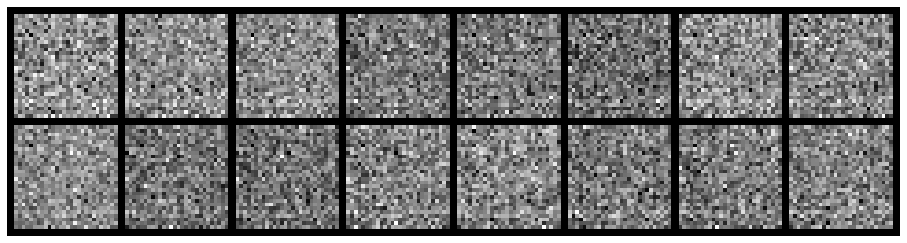

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.3932, Generator Loss: 0.7142
D(x): 0.4861, D(G(z)): 0.4889


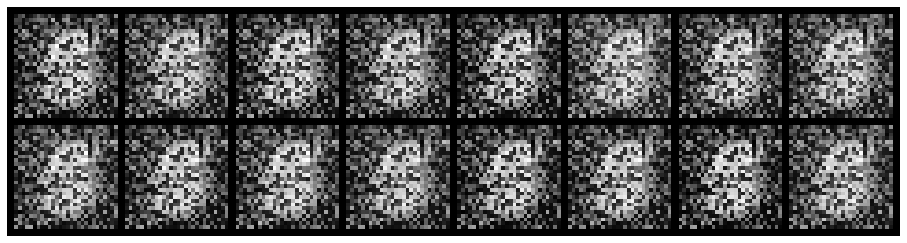

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 0.8300, Generator Loss: 1.0039
D(x): 0.7735, D(G(z)): 0.4316


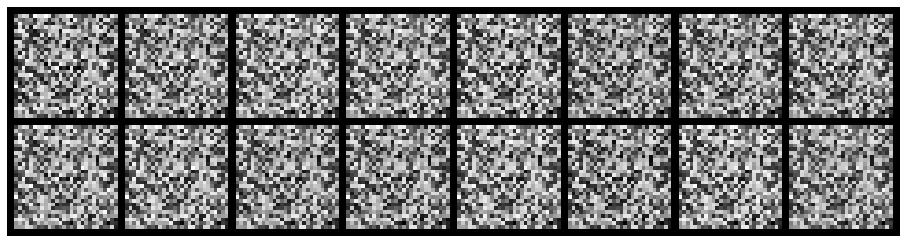

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 0.5300, Generator Loss: 1.2804
D(x): 0.9531, D(G(z)): 0.3744


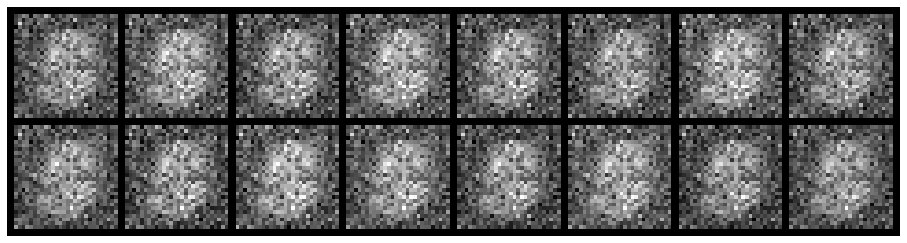

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 0.5740, Generator Loss: 1.2883
D(x): 0.9002, D(G(z)): 0.3550


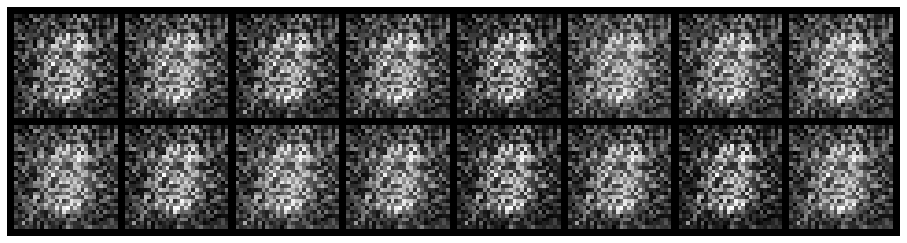

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 1.0341, Generator Loss: 1.8189
D(x): 0.7324, D(G(z)): 0.4134


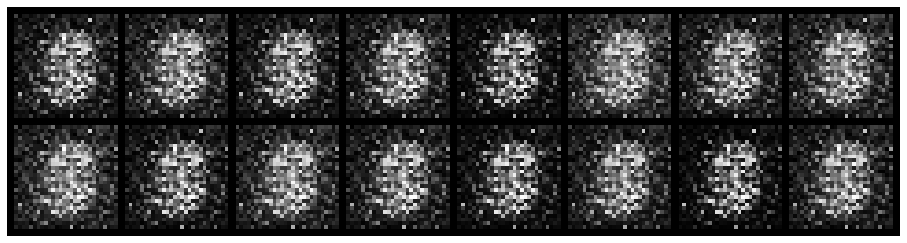

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 0.9045, Generator Loss: 1.8973
D(x): 0.7493, D(G(z)): 0.3544


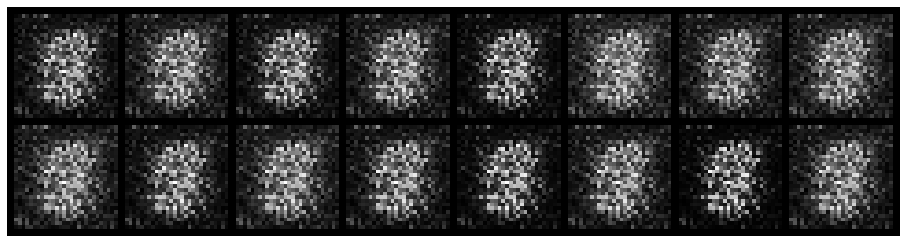

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 0.7097, Generator Loss: 2.1515
D(x): 0.7622, D(G(z)): 0.2748


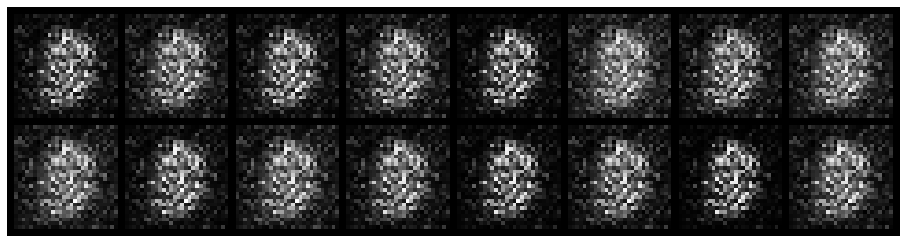

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 0.8227, Generator Loss: 1.8274
D(x): 0.7476, D(G(z)): 0.3419


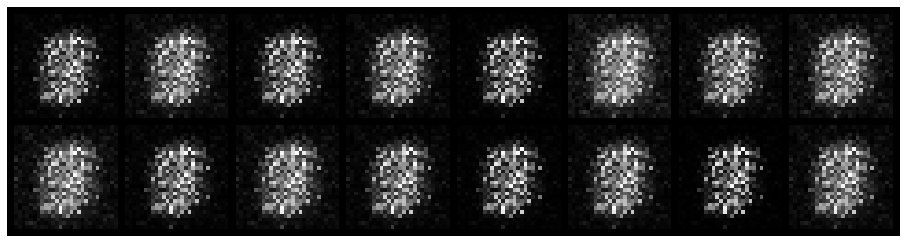

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 0.5695, Generator Loss: 2.0927
D(x): 0.8124, D(G(z)): 0.2303


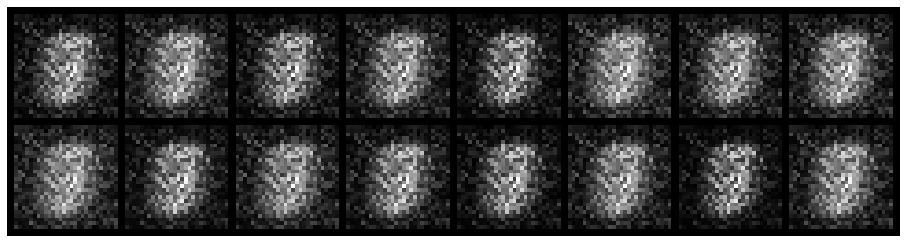

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 0.3761, Generator Loss: 2.1787
D(x): 0.8843, D(G(z)): 0.1967


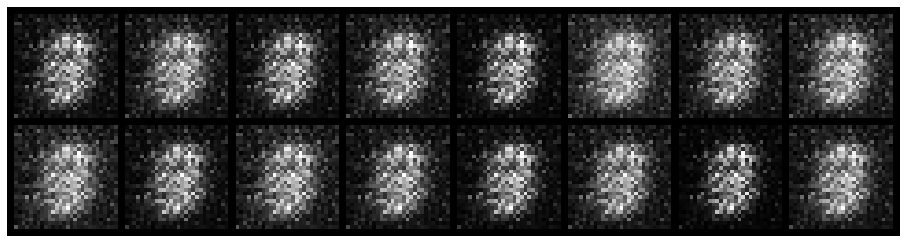

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 0.9007, Generator Loss: 1.4562
D(x): 0.7372, D(G(z)): 0.3644


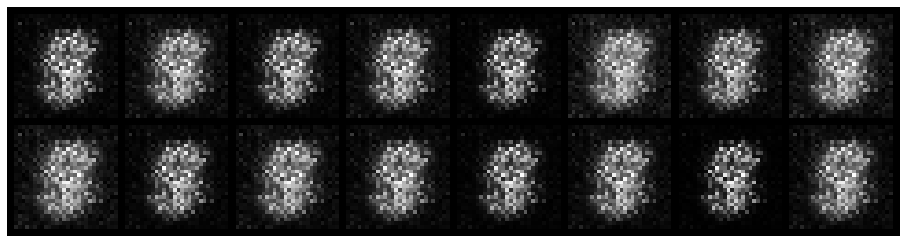

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 0.8415, Generator Loss: 1.8483
D(x): 0.7582, D(G(z)): 0.3243


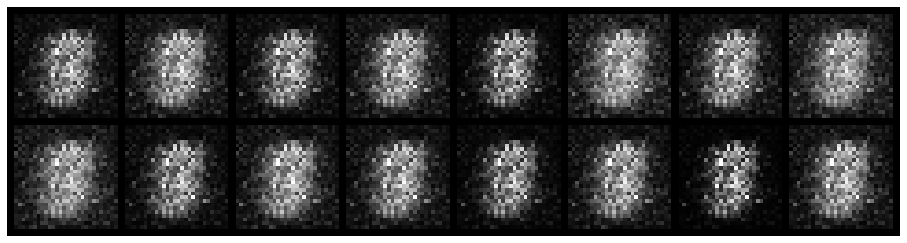

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 0.3882, Generator Loss: 2.0642
D(x): 0.8980, D(G(z)): 0.1932


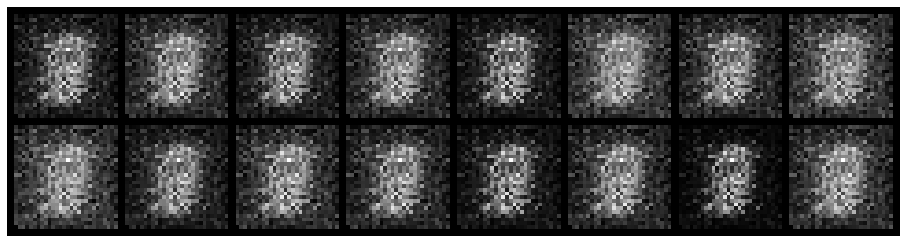

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 0.1688, Generator Loss: 2.5703
D(x): 0.9555, D(G(z)): 0.1048


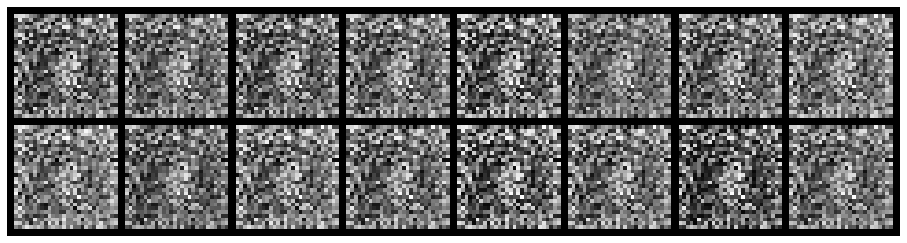

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 0.0684, Generator Loss: 3.7325
D(x): 0.9990, D(G(z)): 0.0628


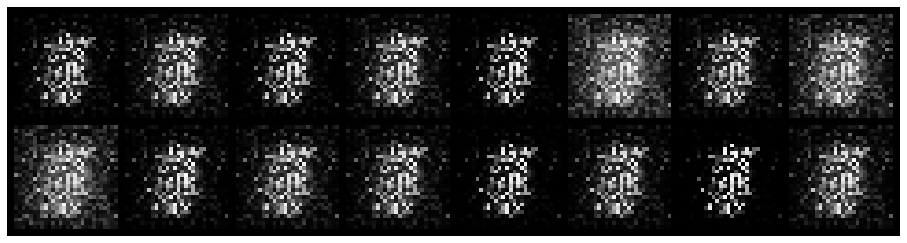

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 0.1043, Generator Loss: 3.3502
D(x): 0.9654, D(G(z)): 0.0508


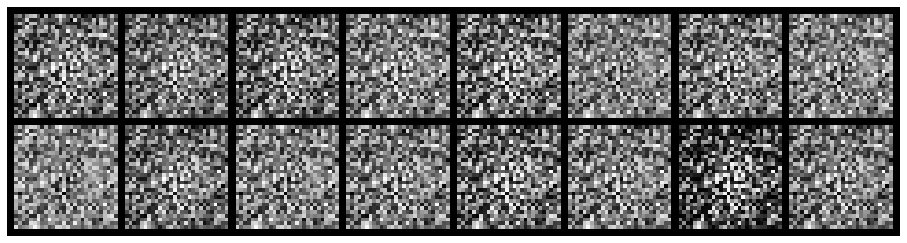

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 0.0247, Generator Loss: 4.6581
D(x): 0.9983, D(G(z)): 0.0226


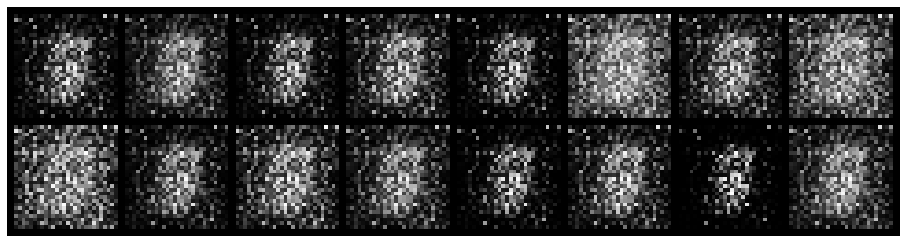

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 0.1810, Generator Loss: 3.8444
D(x): 0.9414, D(G(z)): 0.0838


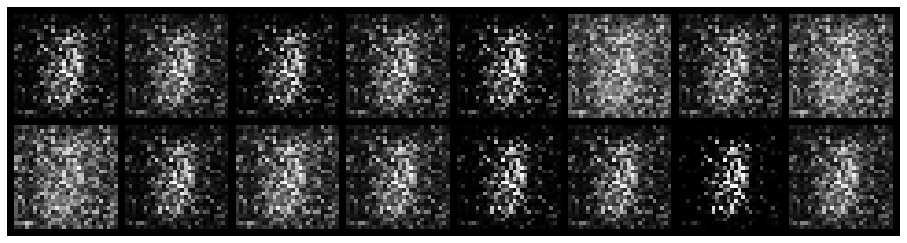

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 0.2604, Generator Loss: 4.0076
D(x): 0.9096, D(G(z)): 0.0705


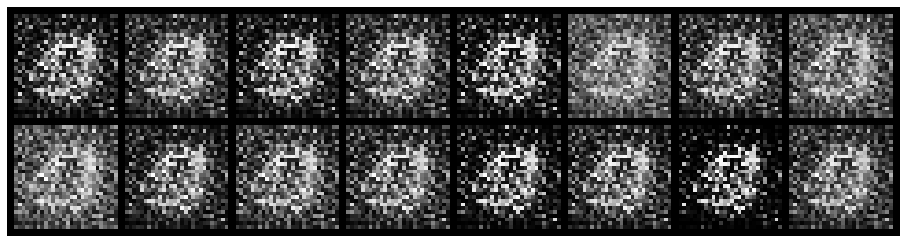

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 0.1012, Generator Loss: 5.7618
D(x): 0.9802, D(G(z)): 0.0441


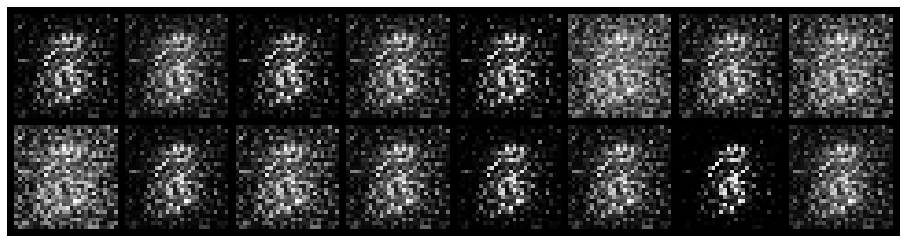

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 0.2115, Generator Loss: 3.9431
D(x): 0.9301, D(G(z)): 0.0551


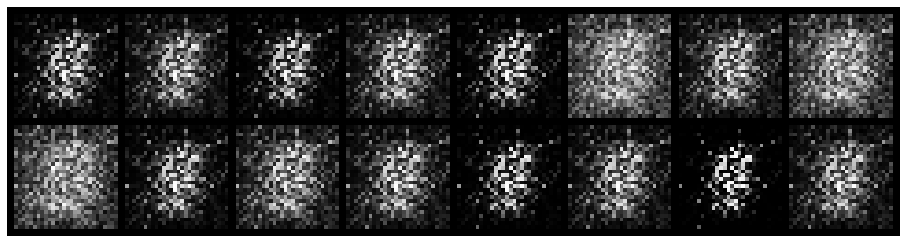

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 0.1433, Generator Loss: 4.6887
D(x): 0.9678, D(G(z)): 0.0607


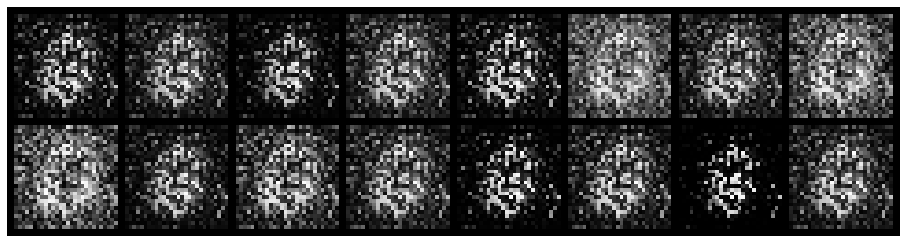

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 0.0826, Generator Loss: 5.0763
D(x): 0.9677, D(G(z)): 0.0329


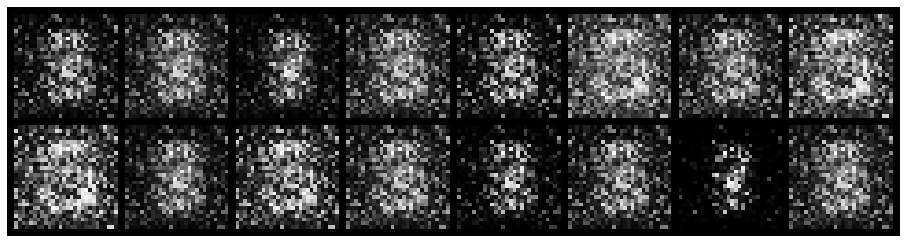

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 0.1021, Generator Loss: 4.7889
D(x): 0.9649, D(G(z)): 0.0422


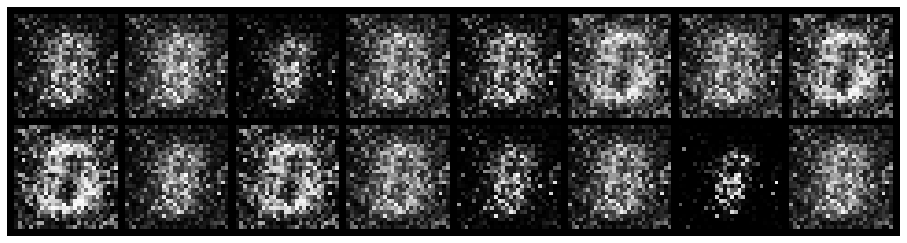

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 0.1367, Generator Loss: 4.6638
D(x): 0.9630, D(G(z)): 0.0658


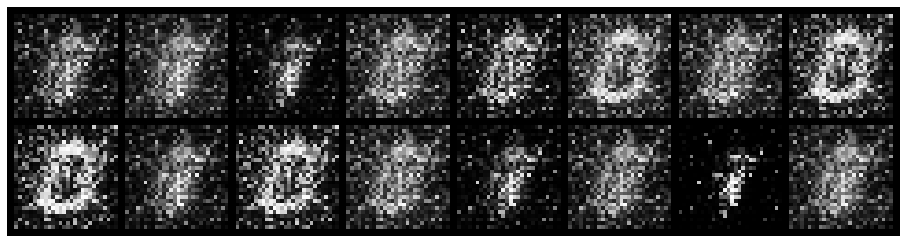

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 0.1003, Generator Loss: 4.6363
D(x): 0.9579, D(G(z)): 0.0332


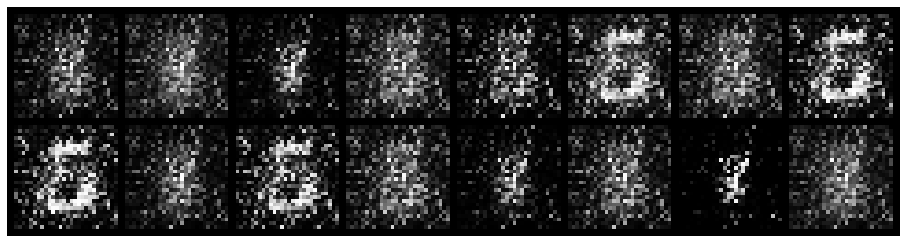

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 0.0698, Generator Loss: 4.9071
D(x): 0.9733, D(G(z)): 0.0311


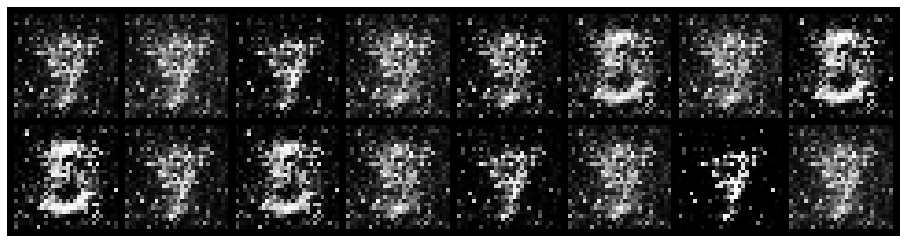

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.0643, Generator Loss: 5.8627
D(x): 0.9851, D(G(z)): 0.0235


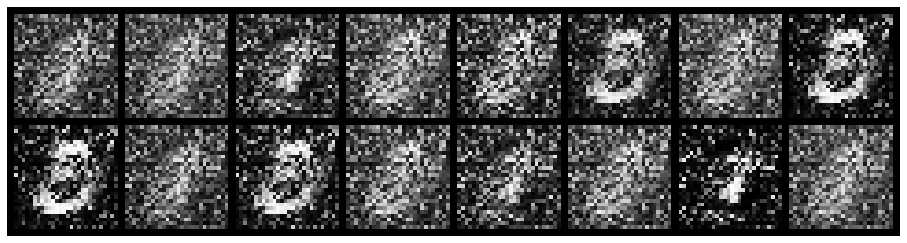

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.0604, Generator Loss: 5.4091
D(x): 0.9986, D(G(z)): 0.0447


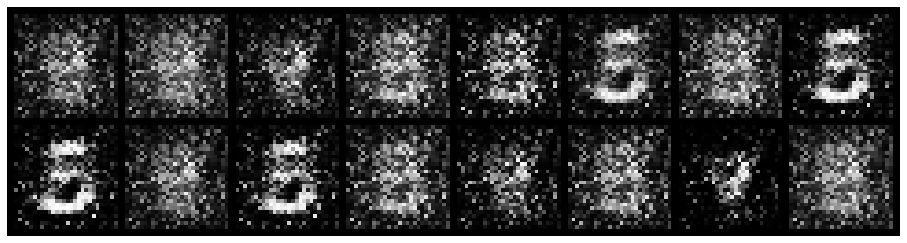

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.1991, Generator Loss: 5.6603
D(x): 0.9924, D(G(z)): 0.1186


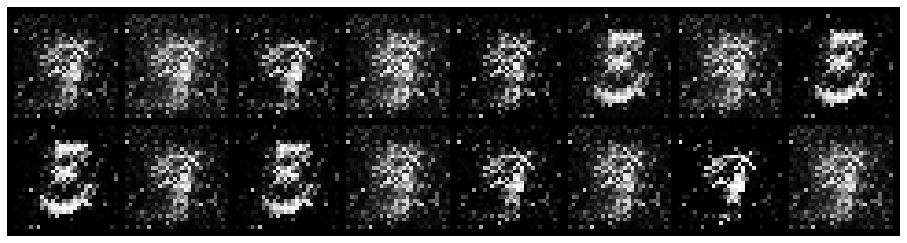

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.1849, Generator Loss: 4.4119
D(x): 0.9371, D(G(z)): 0.0293


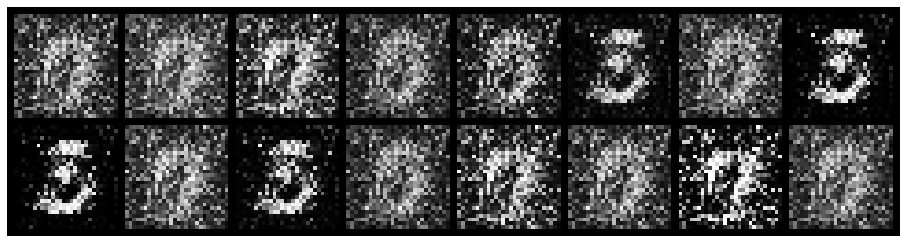

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 0.1552, Generator Loss: 5.1279
D(x): 0.9787, D(G(z)): 0.0791


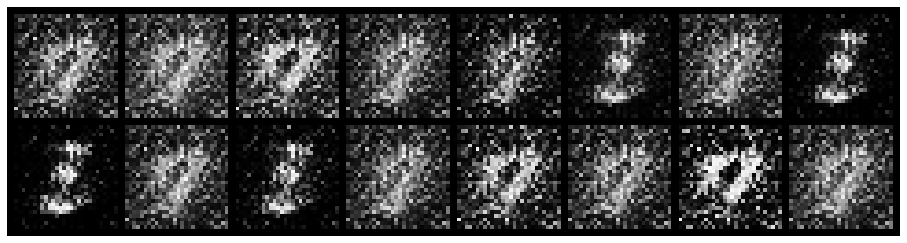

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.2171, Generator Loss: 5.0952
D(x): 0.9748, D(G(z)): 0.1222


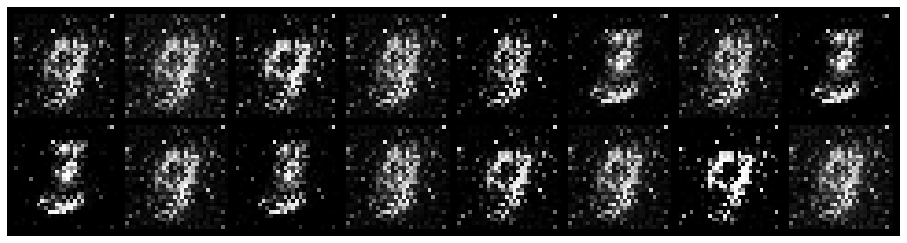

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 0.0792, Generator Loss: 6.4811
D(x): 0.9671, D(G(z)): 0.0117


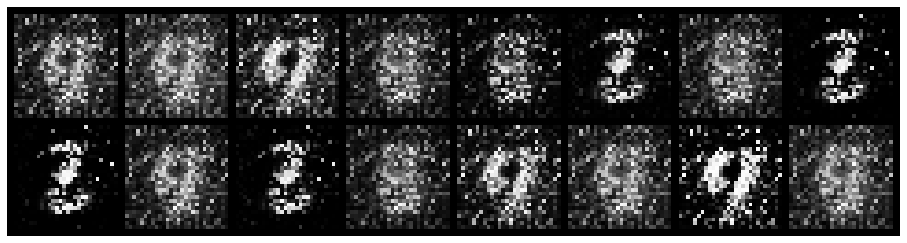

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.0873, Generator Loss: 5.3281
D(x): 0.9682, D(G(z)): 0.0264


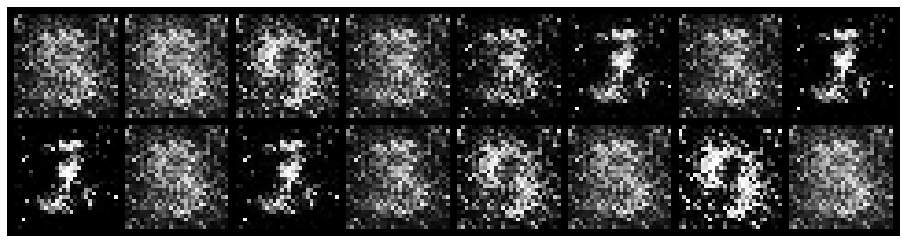

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 0.0607, Generator Loss: 6.1587
D(x): 0.9759, D(G(z)): 0.0243


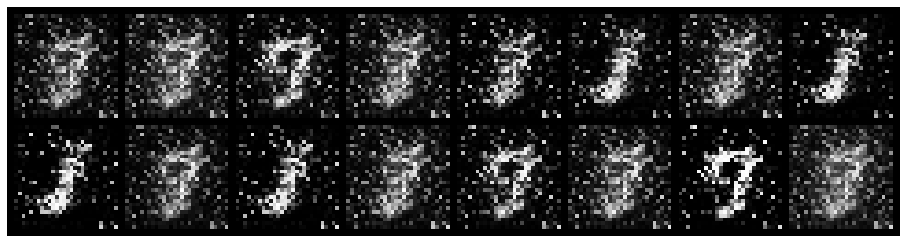

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.1020, Generator Loss: 5.4204
D(x): 0.9812, D(G(z)): 0.0603


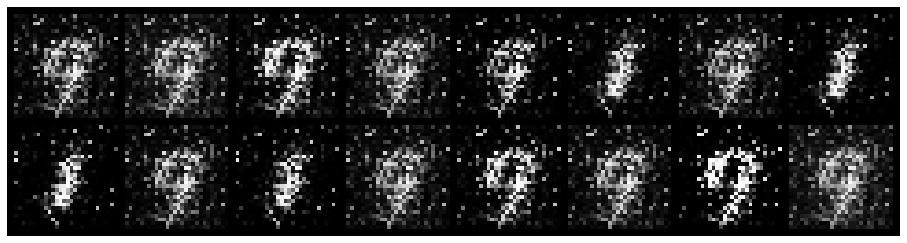

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.0580, Generator Loss: 5.5189
D(x): 0.9777, D(G(z)): 0.0251


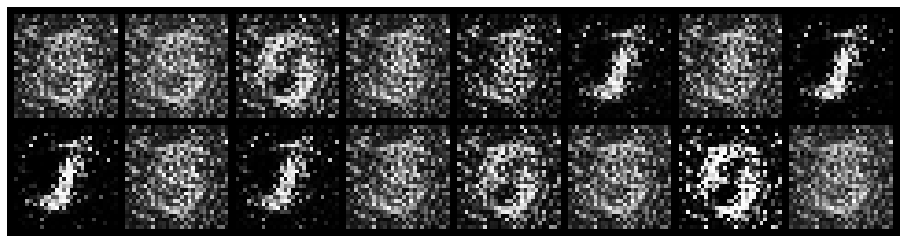

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 0.0236, Generator Loss: 6.8816
D(x): 0.9906, D(G(z)): 0.0127


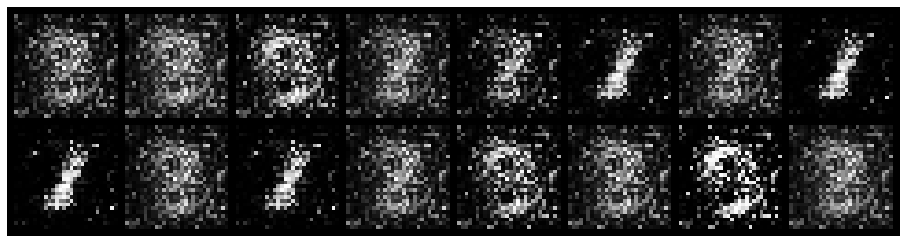

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 0.0501, Generator Loss: 6.2632
D(x): 0.9906, D(G(z)): 0.0350


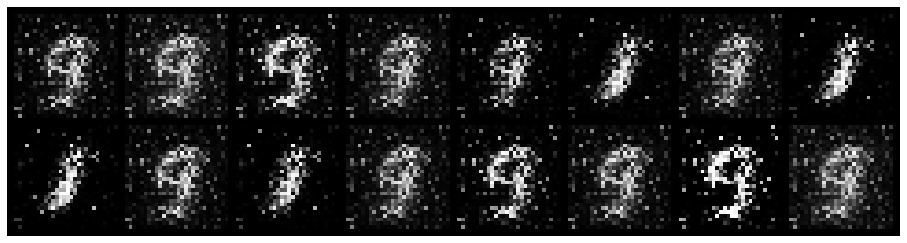

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 0.0210, Generator Loss: 4.8709
D(x): 0.9961, D(G(z)): 0.0162


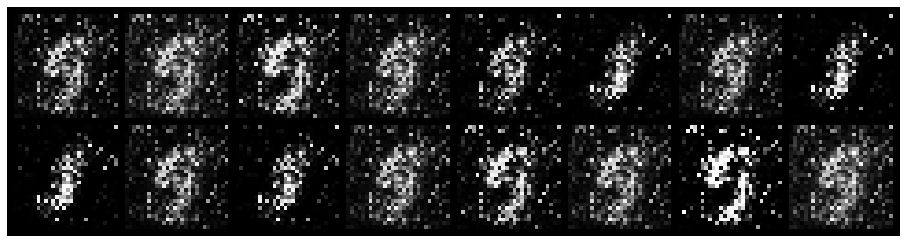

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.0561, Generator Loss: 5.9129
D(x): 0.9800, D(G(z)): 0.0132


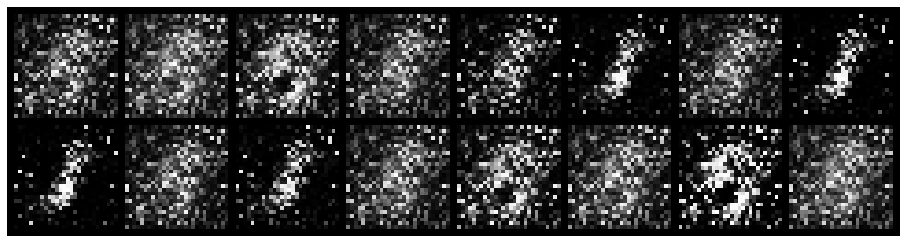

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.0436, Generator Loss: 6.1232
D(x): 0.9985, D(G(z)): 0.0348


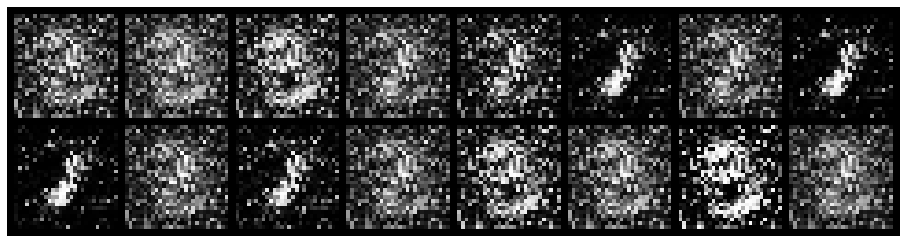

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.0421, Generator Loss: 7.2390
D(x): 0.9989, D(G(z)): 0.0299


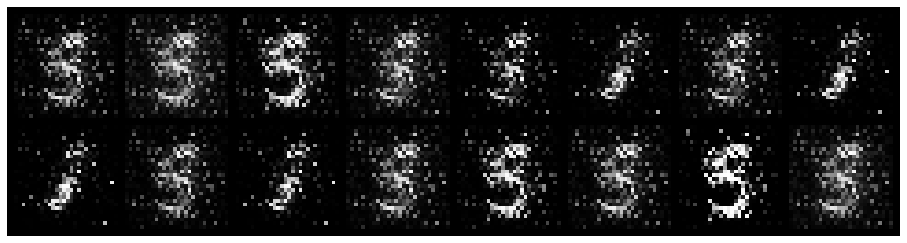

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 0.0442, Generator Loss: 7.2247
D(x): 0.9864, D(G(z)): 0.0029


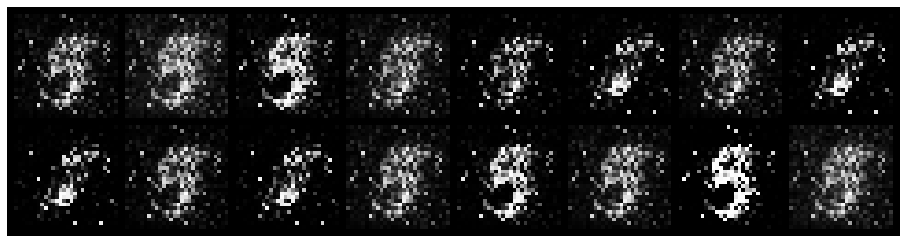

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 0.0173, Generator Loss: 5.7583
D(x): 0.9946, D(G(z)): 0.0109


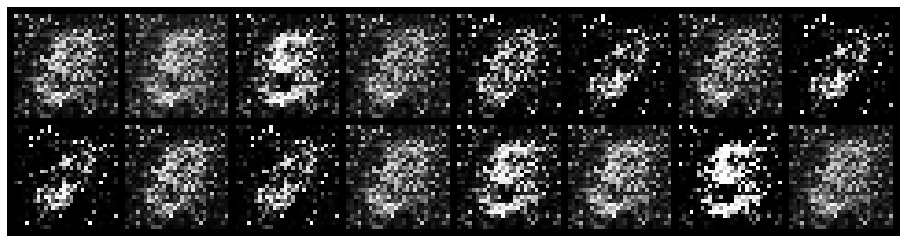

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.0215, Generator Loss: 6.4799
D(x): 0.9955, D(G(z)): 0.0149


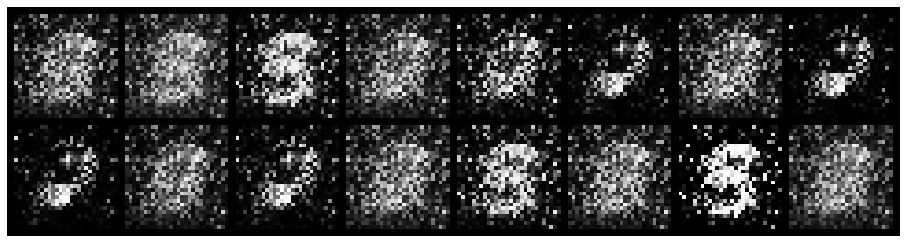

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 0.0976, Generator Loss: 7.4951
D(x): 0.9826, D(G(z)): 0.0115


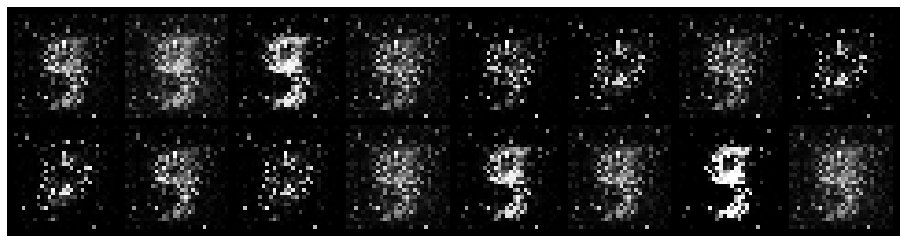

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.0888, Generator Loss: 5.5707
D(x): 0.9890, D(G(z)): 0.0538


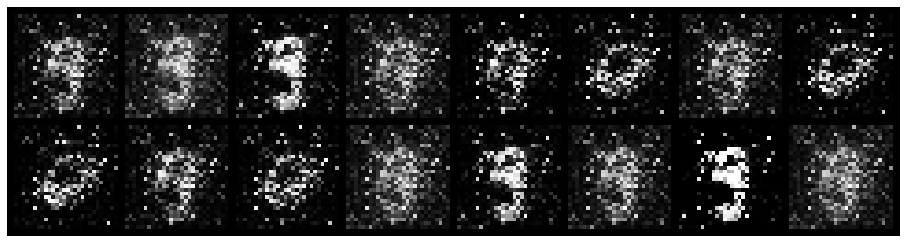

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.0274, Generator Loss: 7.0360
D(x): 0.9888, D(G(z)): 0.0066


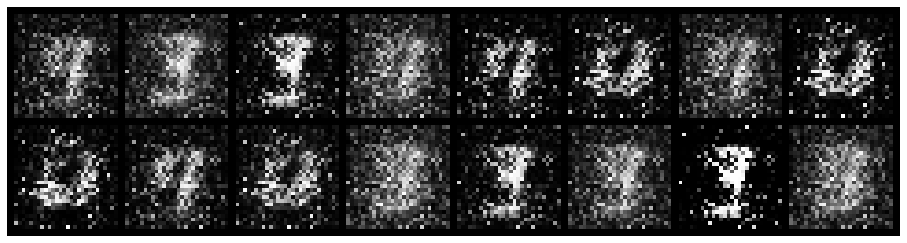

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 0.0425, Generator Loss: 6.4478
D(x): 0.9852, D(G(z)): 0.0094


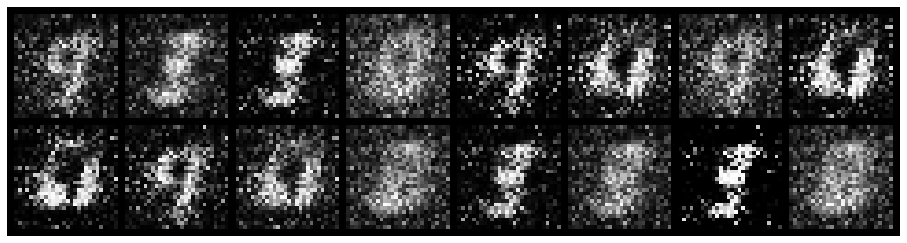

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 0.0408, Generator Loss: 6.3367
D(x): 0.9904, D(G(z)): 0.0227


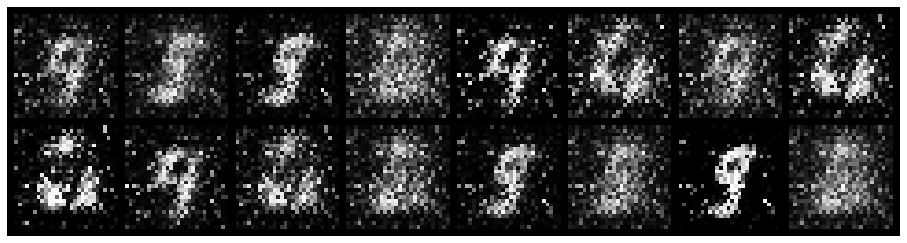

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 0.1003, Generator Loss: 5.4927
D(x): 0.9858, D(G(z)): 0.0408


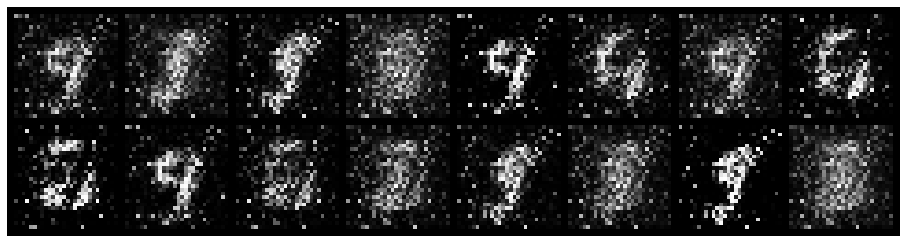

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.0876, Generator Loss: 5.5310
D(x): 0.9899, D(G(z)): 0.0523


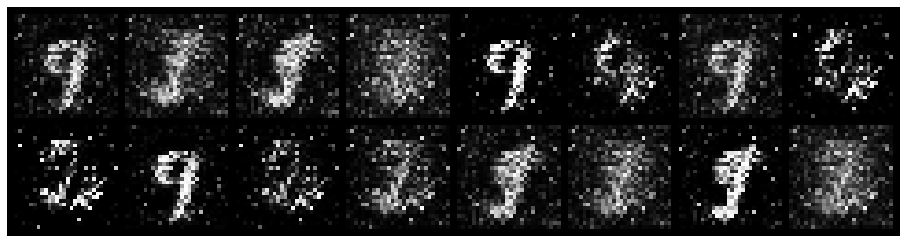

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.0784, Generator Loss: 5.8158
D(x): 0.9692, D(G(z)): 0.0146


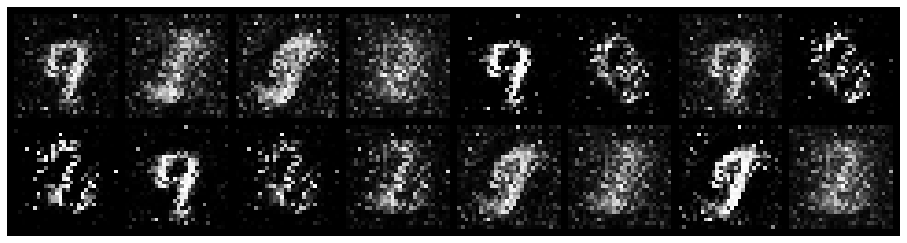

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 0.0252, Generator Loss: 6.4592
D(x): 0.9943, D(G(z)): 0.0165


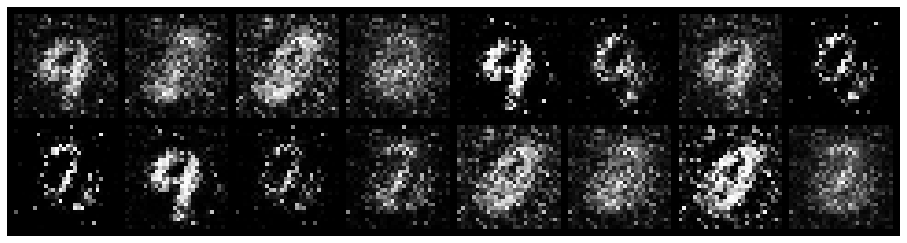

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.2011, Generator Loss: 6.5511
D(x): 0.9471, D(G(z)): 0.0394


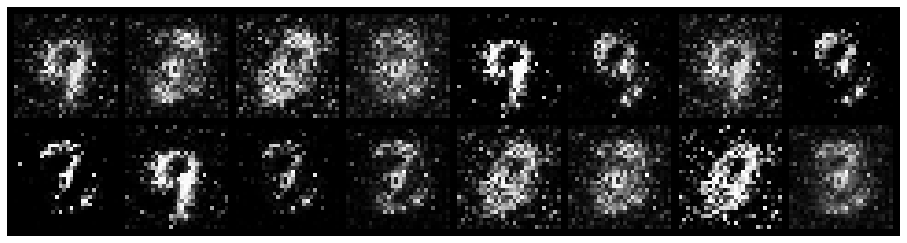

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.0811, Generator Loss: 6.7192
D(x): 0.9634, D(G(z)): 0.0201


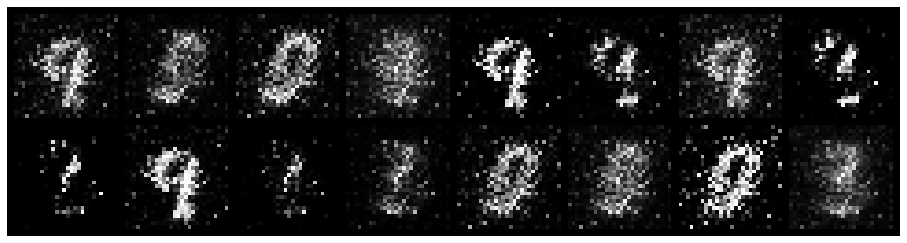

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 0.1747, Generator Loss: 5.4344
D(x): 0.9338, D(G(z)): 0.0129


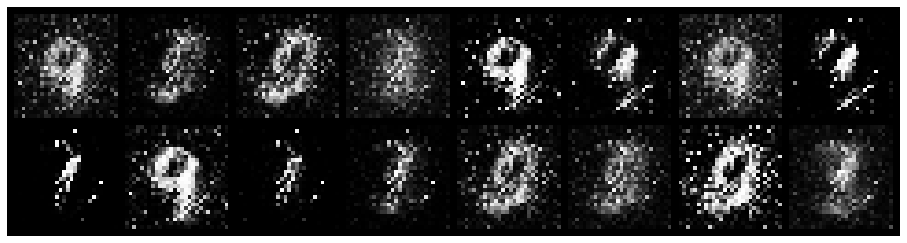

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.1363, Generator Loss: 5.1847
D(x): 0.9976, D(G(z)): 0.0866


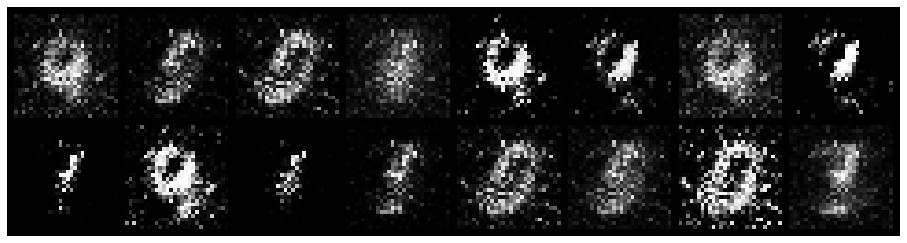

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.2364, Generator Loss: 5.4481
D(x): 0.9243, D(G(z)): 0.0319


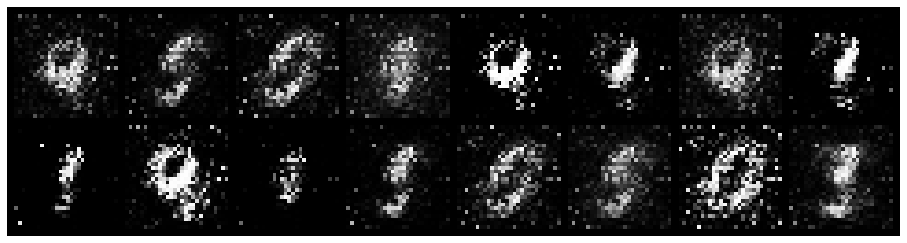

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 0.1525, Generator Loss: 5.3574
D(x): 0.9362, D(G(z)): 0.0288


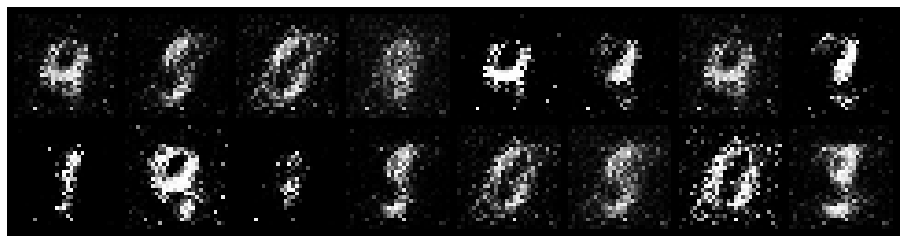

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 0.1610, Generator Loss: 5.0427
D(x): 0.9753, D(G(z)): 0.0643


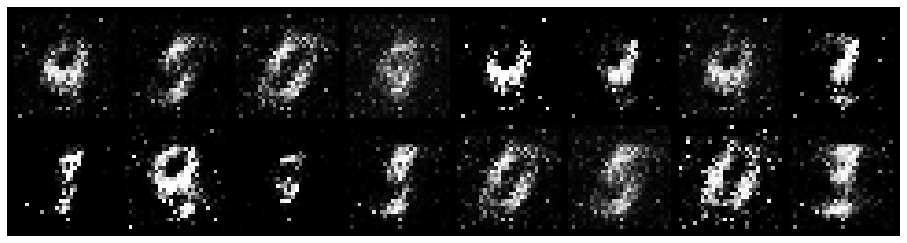

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.1604, Generator Loss: 5.1727
D(x): 0.9453, D(G(z)): 0.0125


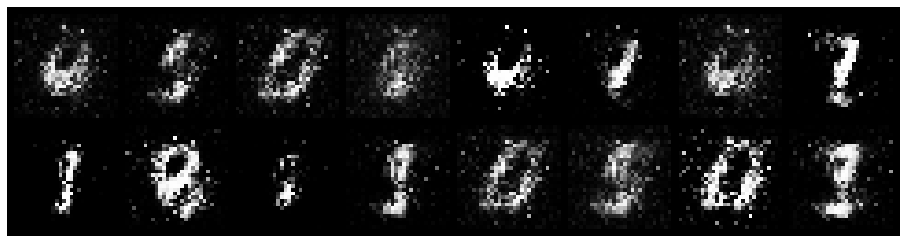

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 0.0729, Generator Loss: 7.0037
D(x): 0.9814, D(G(z)): 0.0163


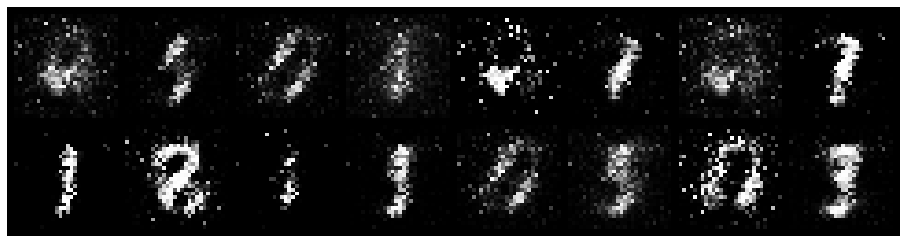

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 0.1166, Generator Loss: 5.2322
D(x): 0.9619, D(G(z)): 0.0339


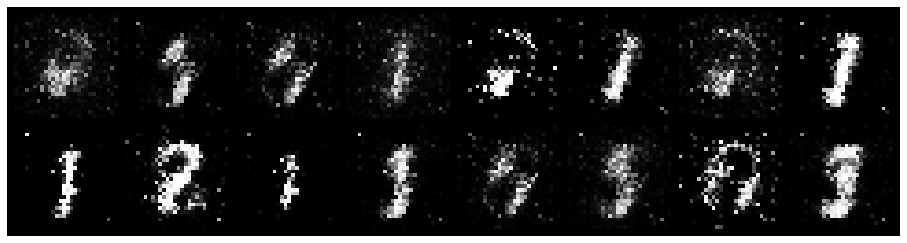

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.2249, Generator Loss: 4.5424
D(x): 0.9543, D(G(z)): 0.0765


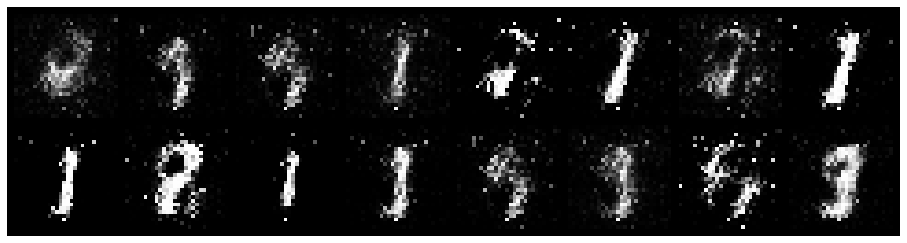

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.1781, Generator Loss: 3.8678
D(x): 0.9711, D(G(z)): 0.0755


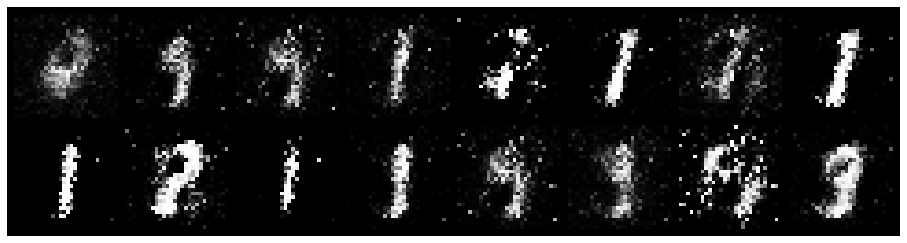

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.2220, Generator Loss: 6.0955
D(x): 0.9831, D(G(z)): 0.1245


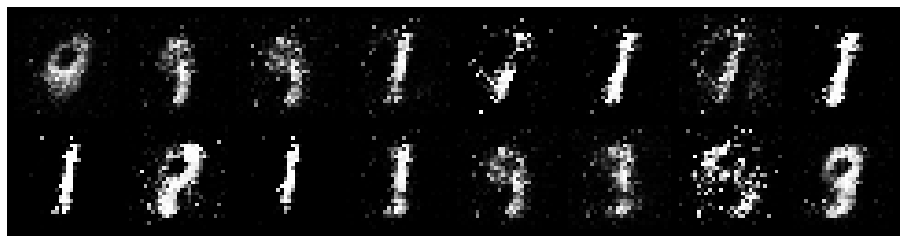

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 0.2081, Generator Loss: 5.9446
D(x): 0.9298, D(G(z)): 0.0199


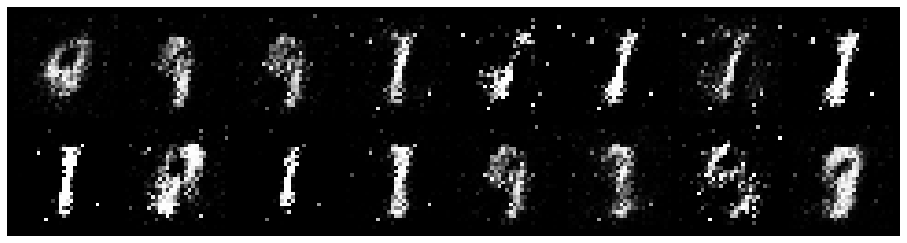

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 0.0852, Generator Loss: 5.1334
D(x): 0.9639, D(G(z)): 0.0186


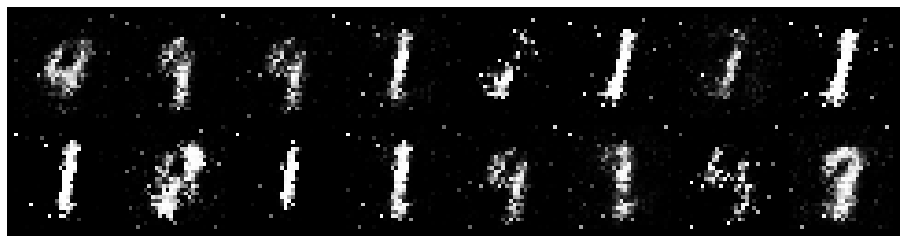

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 0.0774, Generator Loss: 5.7430
D(x): 0.9629, D(G(z)): 0.0111


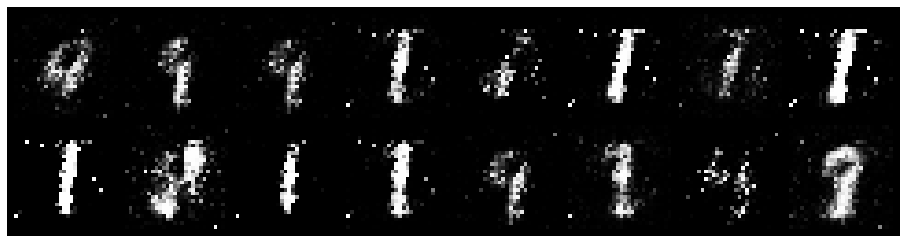

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 0.0512, Generator Loss: 6.7099
D(x): 0.9890, D(G(z)): 0.0310


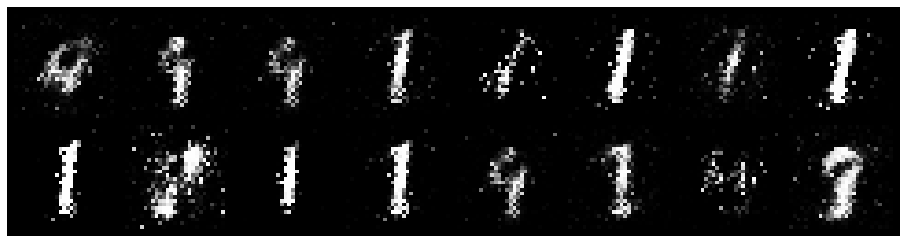

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.1121, Generator Loss: 5.4333
D(x): 0.9729, D(G(z)): 0.0471


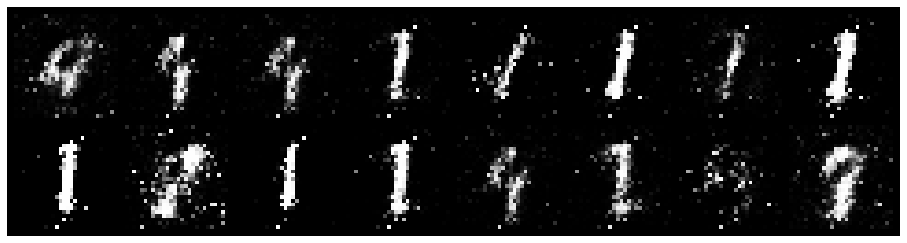

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.1853, Generator Loss: 5.2214
D(x): 0.9338, D(G(z)): 0.0305


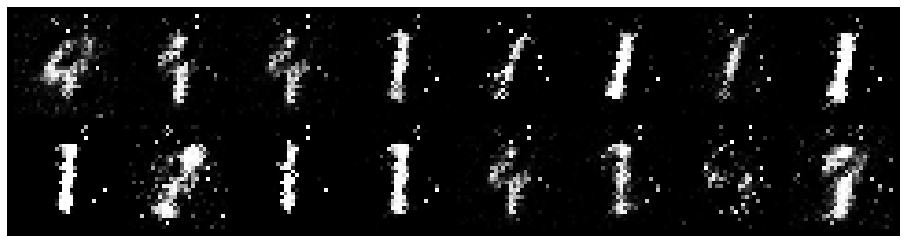

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 0.1041, Generator Loss: 4.7988
D(x): 0.9738, D(G(z)): 0.0270


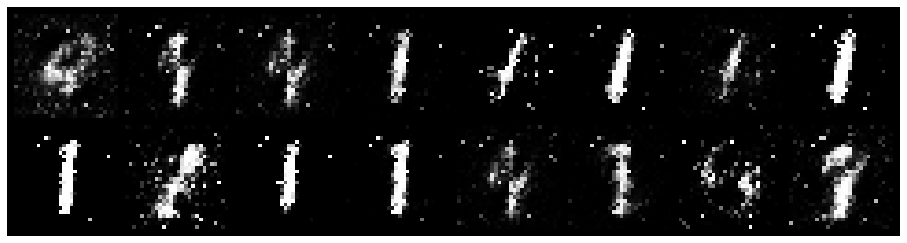

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 0.2607, Generator Loss: 5.2891
D(x): 0.9641, D(G(z)): 0.1091


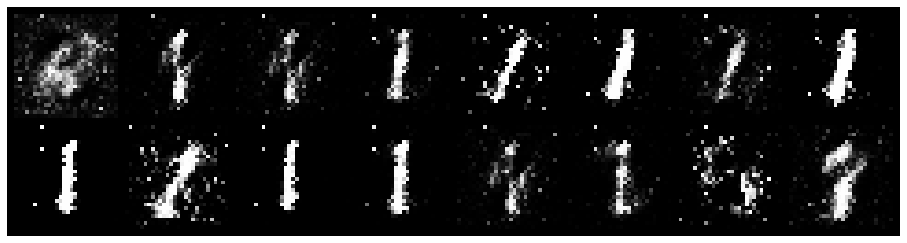

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 0.0646, Generator Loss: 4.4748
D(x): 0.9945, D(G(z)): 0.0501


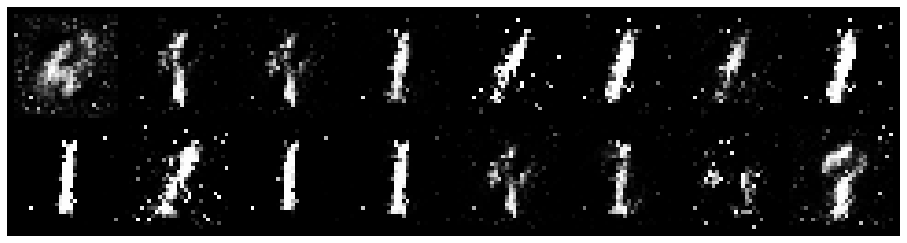

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 0.1869, Generator Loss: 4.9684
D(x): 0.9146, D(G(z)): 0.0105


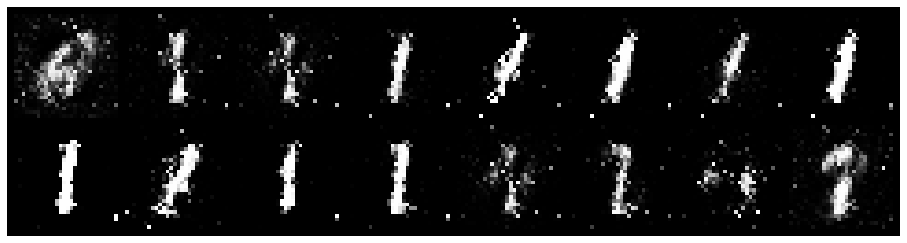

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 0.2150, Generator Loss: 4.6457
D(x): 0.9383, D(G(z)): 0.0446


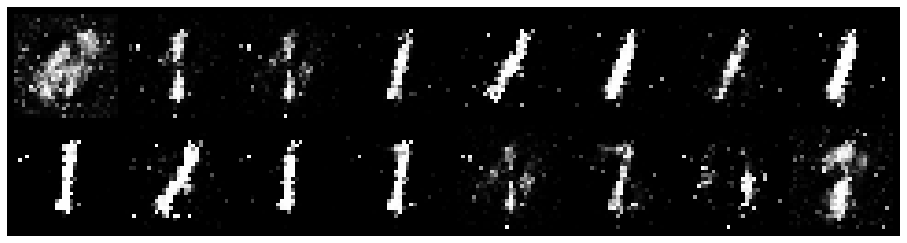

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.2773, Generator Loss: 4.1353
D(x): 0.9178, D(G(z)): 0.0387


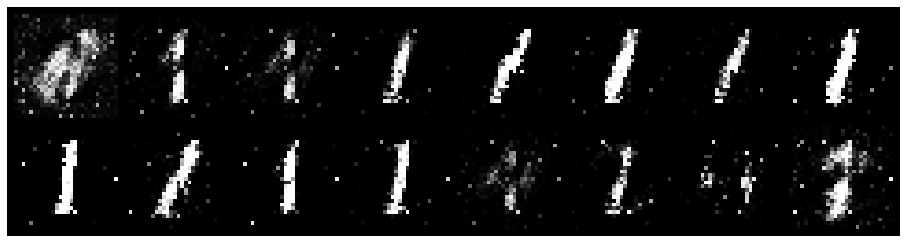

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 0.1836, Generator Loss: 3.8089
D(x): 0.9450, D(G(z)): 0.0652


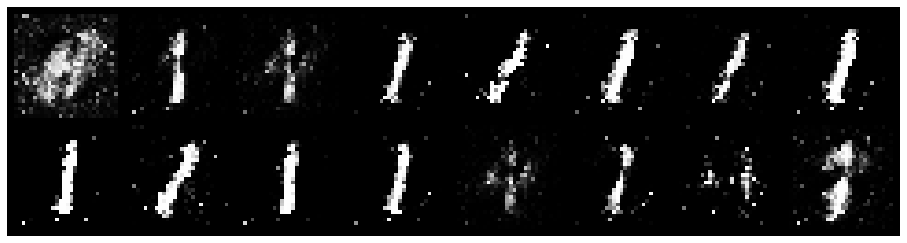

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 0.0829, Generator Loss: 3.7930
D(x): 0.9637, D(G(z)): 0.0273


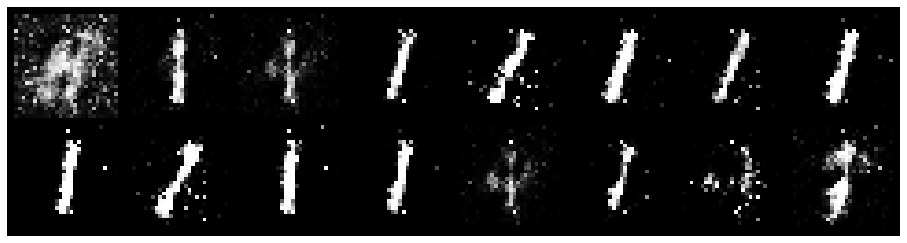

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 0.1539, Generator Loss: 4.7717
D(x): 0.9572, D(G(z)): 0.0342


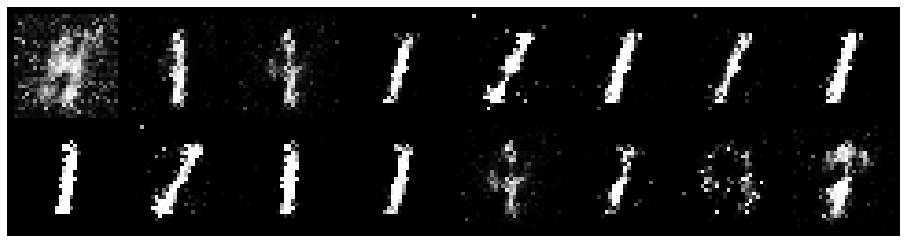

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 0.1166, Generator Loss: 4.3360
D(x): 0.9648, D(G(z)): 0.0432


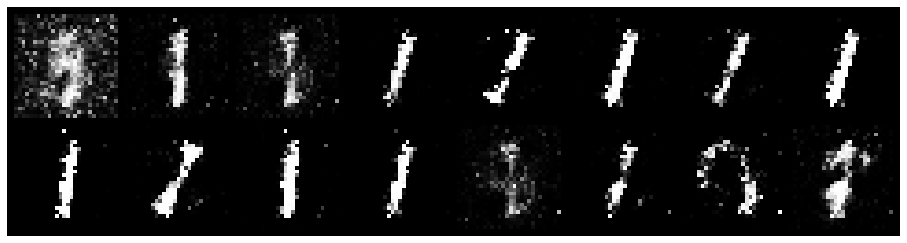

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 0.1662, Generator Loss: 4.2831
D(x): 0.9604, D(G(z)): 0.0689


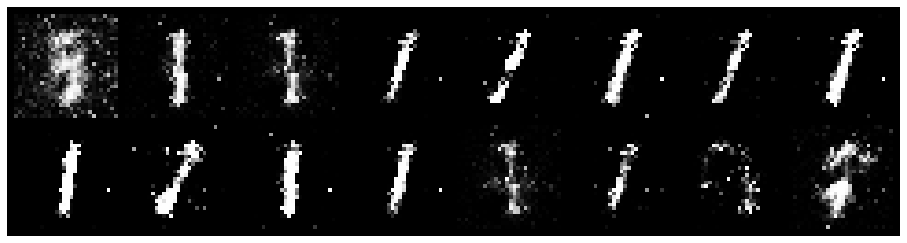

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 0.2980, Generator Loss: 4.9431
D(x): 0.9251, D(G(z)): 0.0674


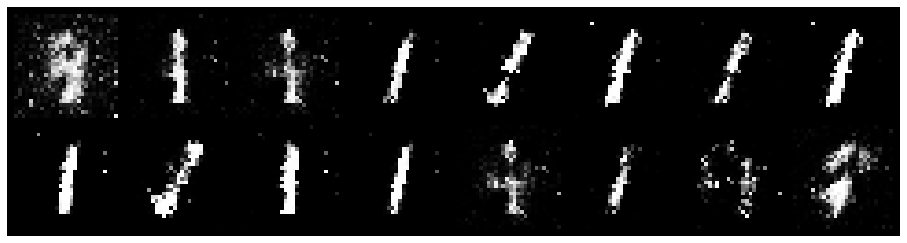

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 0.3314, Generator Loss: 5.3965
D(x): 0.8989, D(G(z)): 0.0325


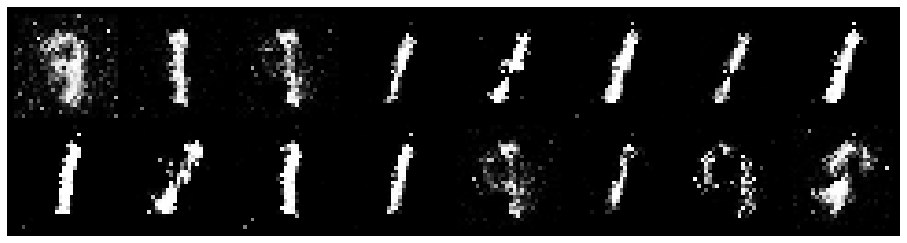

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 0.1756, Generator Loss: 4.8439
D(x): 0.9385, D(G(z)): 0.0357


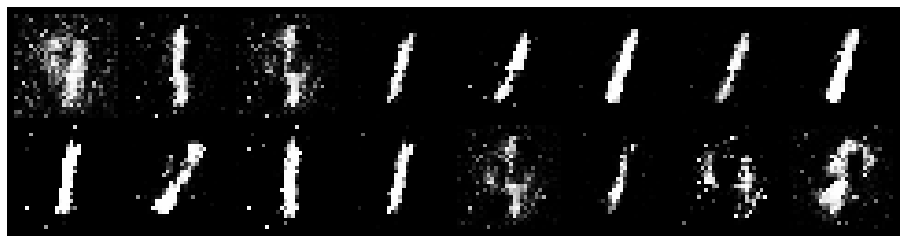

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 0.1459, Generator Loss: 4.3320
D(x): 0.9438, D(G(z)): 0.0385


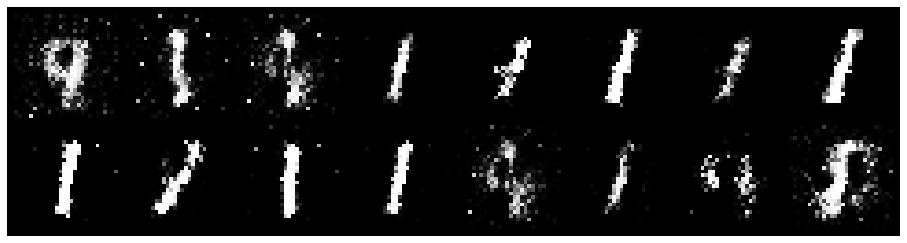

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 0.2047, Generator Loss: 3.6646
D(x): 0.9288, D(G(z)): 0.0419


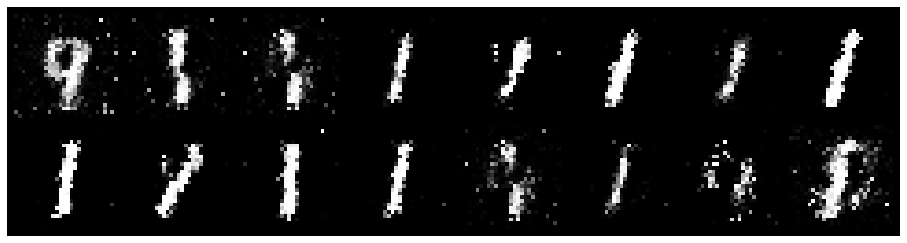

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 0.1777, Generator Loss: 4.5134
D(x): 0.9490, D(G(z)): 0.0674


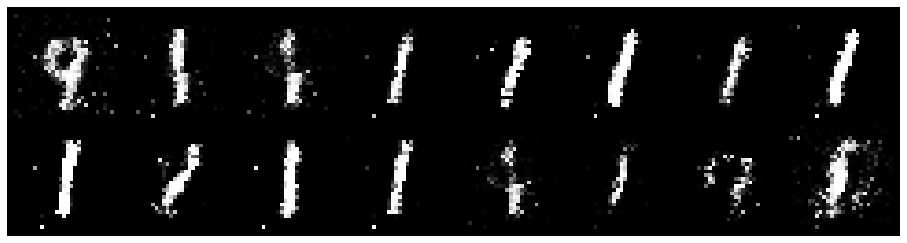

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 0.1678, Generator Loss: 3.1337
D(x): 0.9547, D(G(z)): 0.0415


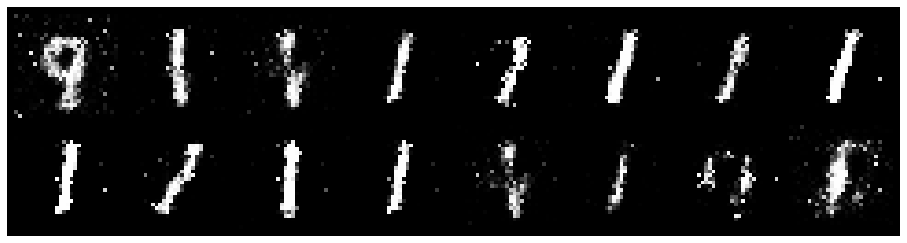

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 0.1944, Generator Loss: 3.5840
D(x): 0.9368, D(G(z)): 0.0546


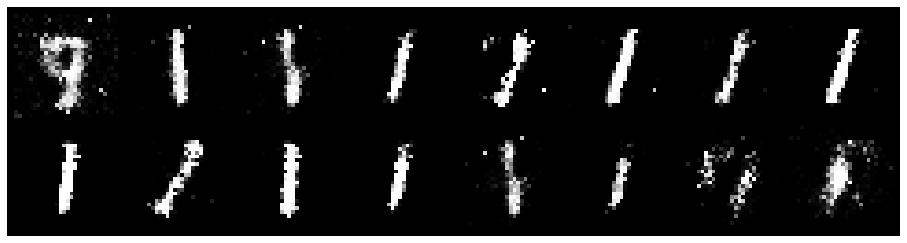

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 0.3103, Generator Loss: 2.8954
D(x): 0.8911, D(G(z)): 0.0625


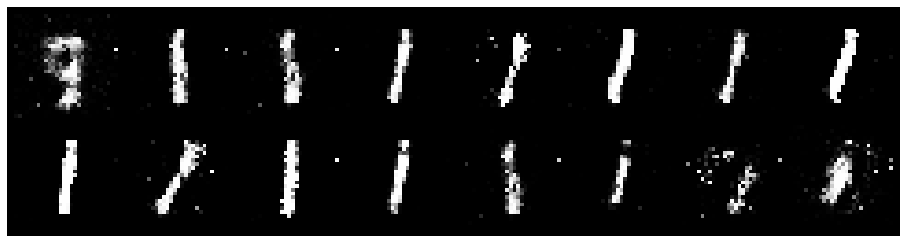

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 0.2469, Generator Loss: 4.1013
D(x): 0.9212, D(G(z)): 0.0487


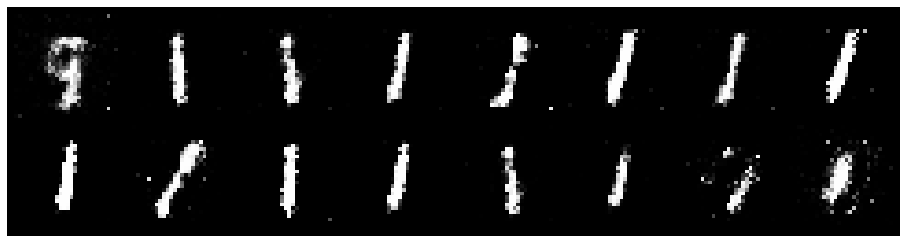

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 0.1971, Generator Loss: 2.7866
D(x): 0.9384, D(G(z)): 0.0761


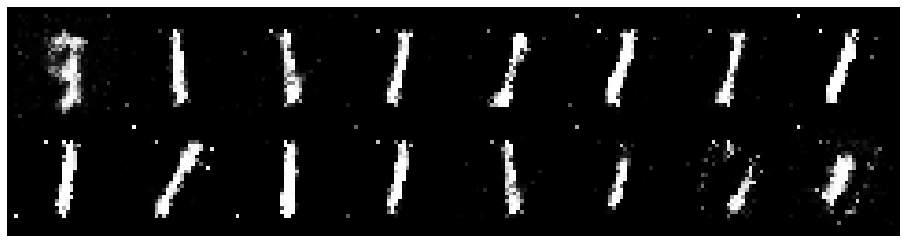

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 0.2985, Generator Loss: 3.9813
D(x): 0.9086, D(G(z)): 0.0633


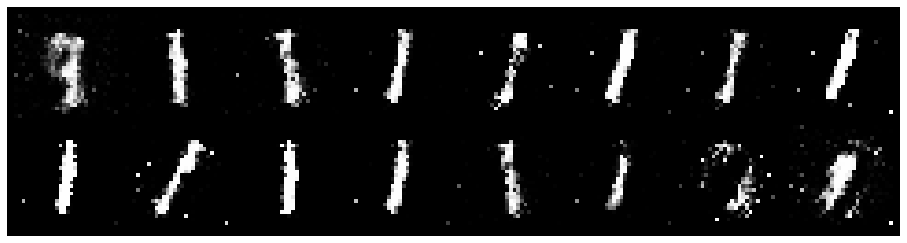

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 0.2376, Generator Loss: 4.5355
D(x): 0.9042, D(G(z)): 0.0499


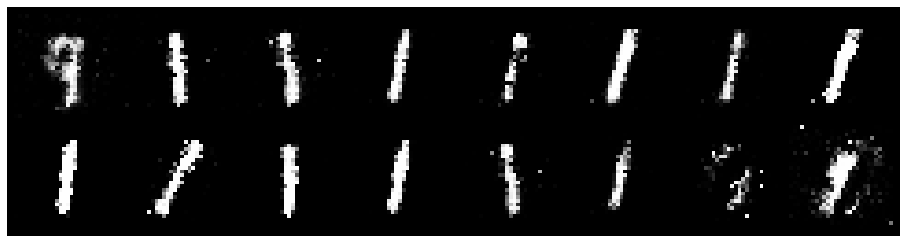

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 0.1806, Generator Loss: 3.7075
D(x): 0.9550, D(G(z)): 0.0474


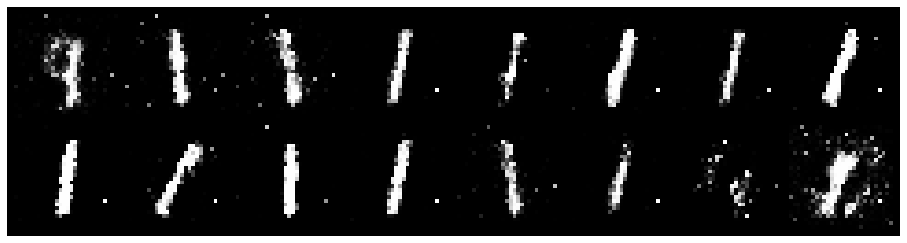

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 0.1323, Generator Loss: 4.5205
D(x): 0.9627, D(G(z)): 0.0463


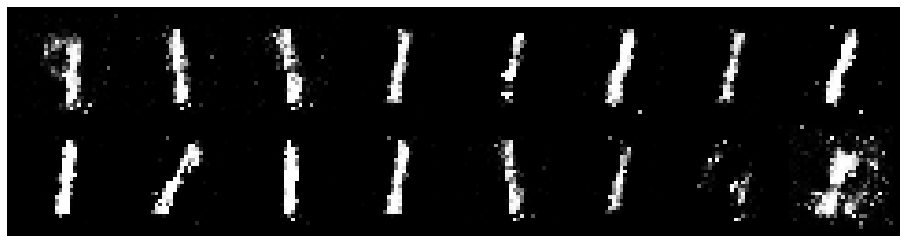

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 0.2899, Generator Loss: 3.2107
D(x): 0.9697, D(G(z)): 0.1546


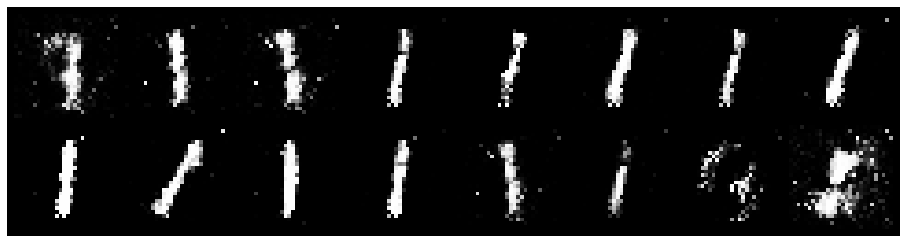

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 0.3594, Generator Loss: 3.9306
D(x): 0.9311, D(G(z)): 0.1192


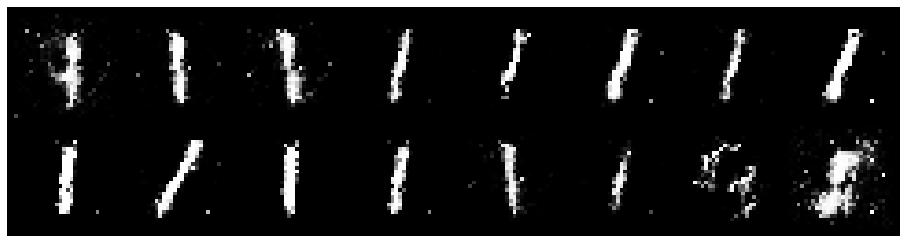

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 0.3566, Generator Loss: 2.4872
D(x): 0.8838, D(G(z)): 0.0832


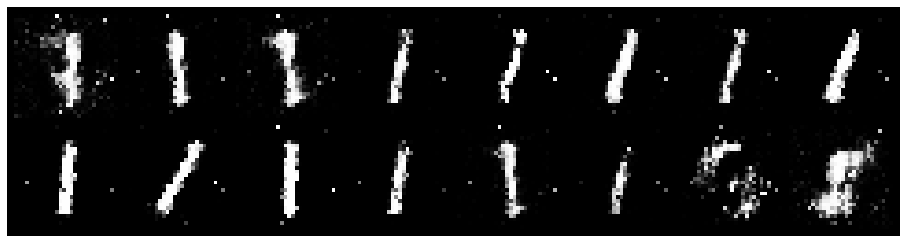

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 0.1672, Generator Loss: 3.9572
D(x): 0.9597, D(G(z)): 0.0461


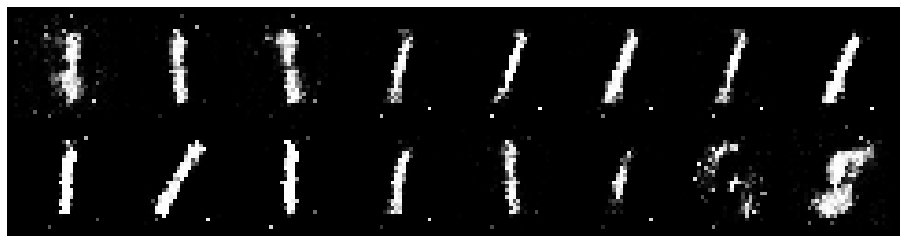

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 0.3051, Generator Loss: 3.6295
D(x): 0.9050, D(G(z)): 0.0892


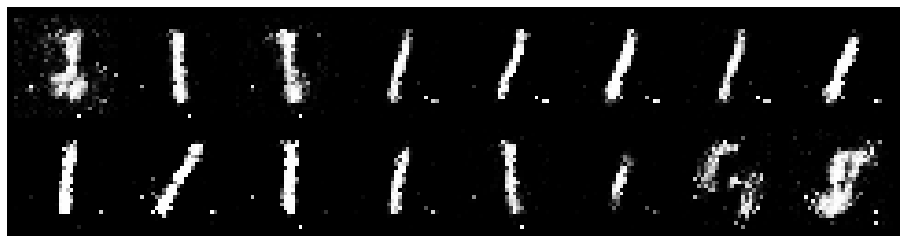

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 0.3001, Generator Loss: 3.1195
D(x): 0.9626, D(G(z)): 0.1656


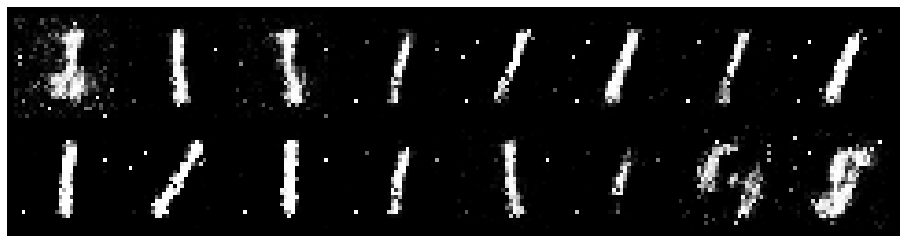

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 0.2516, Generator Loss: 2.8006
D(x): 0.9494, D(G(z)): 0.1199


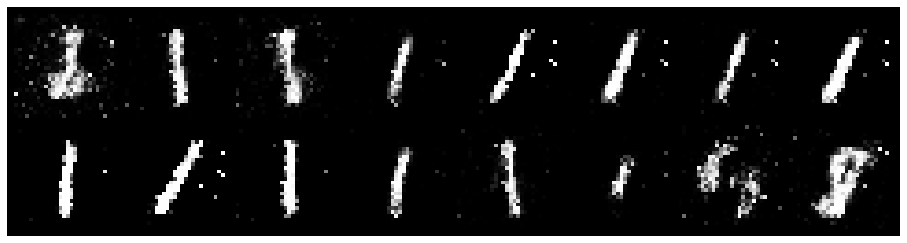

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 0.3508, Generator Loss: 4.4740
D(x): 0.8740, D(G(z)): 0.0329


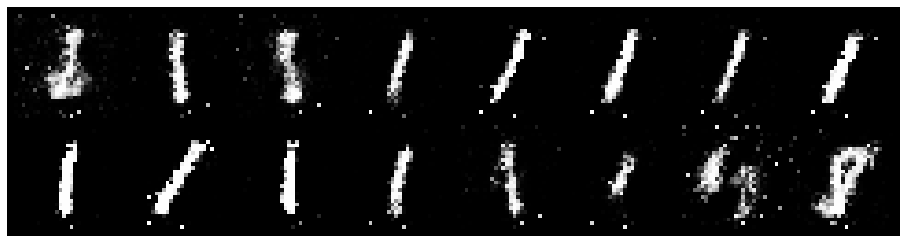

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 0.3500, Generator Loss: 4.3674
D(x): 0.8714, D(G(z)): 0.0378


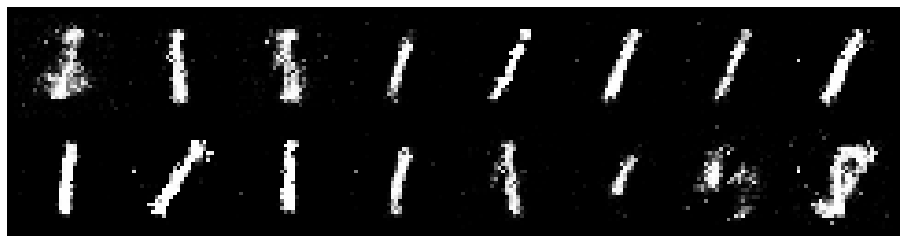

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 0.1872, Generator Loss: 3.9398
D(x): 0.9246, D(G(z)): 0.0385


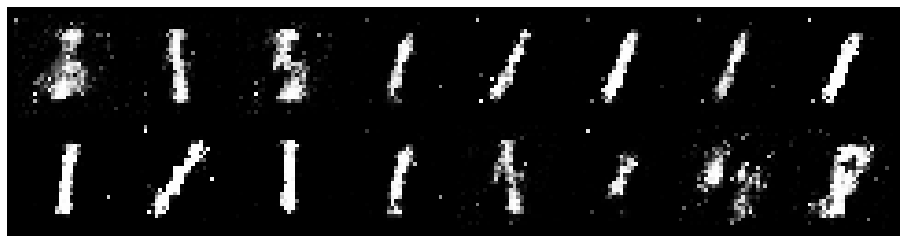

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 0.2620, Generator Loss: 3.4032
D(x): 0.9278, D(G(z)): 0.0909


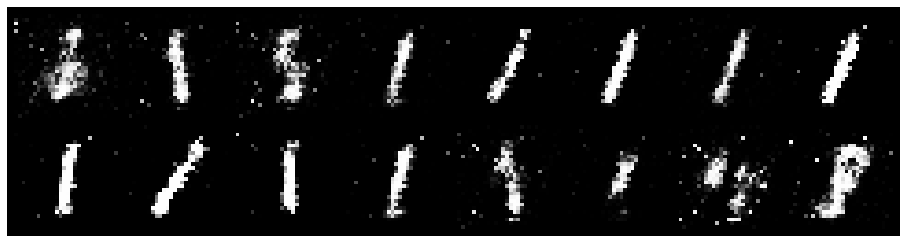

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 0.2623, Generator Loss: 3.5919
D(x): 0.8907, D(G(z)): 0.0333


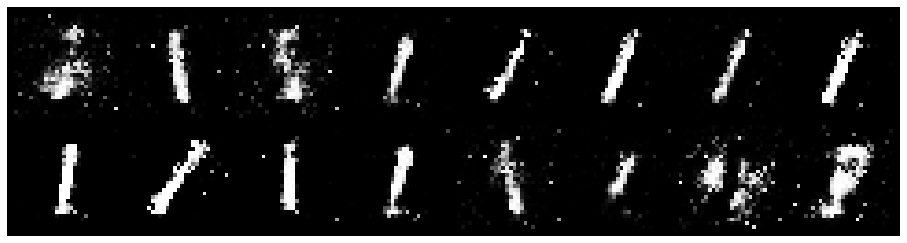

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 0.4977, Generator Loss: 4.1549
D(x): 0.8515, D(G(z)): 0.0509


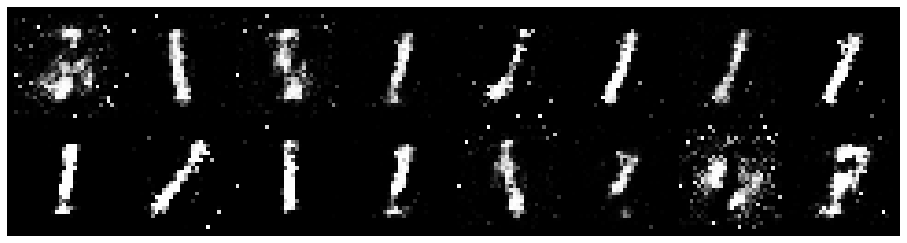

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 0.3282, Generator Loss: 3.7823
D(x): 0.8881, D(G(z)): 0.0599


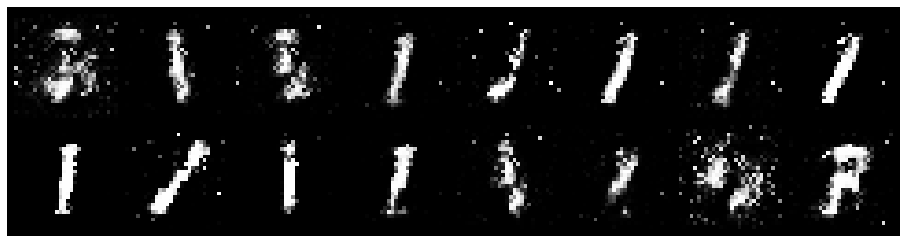

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 0.3193, Generator Loss: 3.8401
D(x): 0.8579, D(G(z)): 0.0432


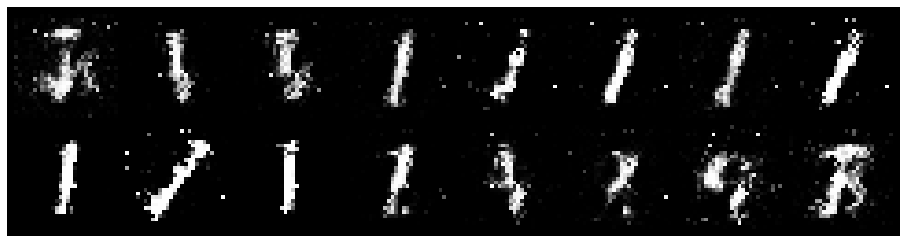

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 0.2895, Generator Loss: 3.8543
D(x): 0.8932, D(G(z)): 0.0521


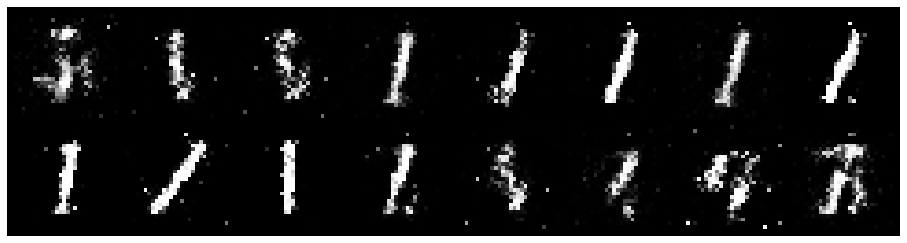

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 0.4613, Generator Loss: 4.0637
D(x): 0.8637, D(G(z)): 0.0692


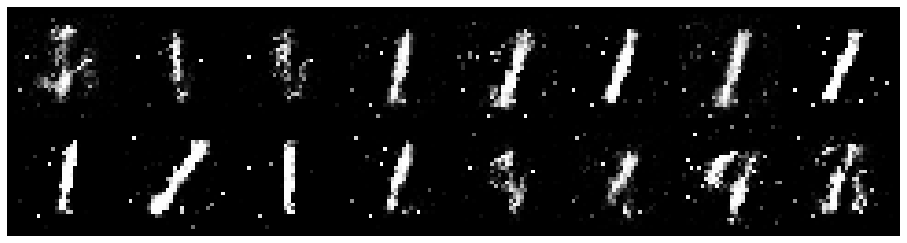

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 0.3375, Generator Loss: 2.9948
D(x): 0.8964, D(G(z)): 0.0922


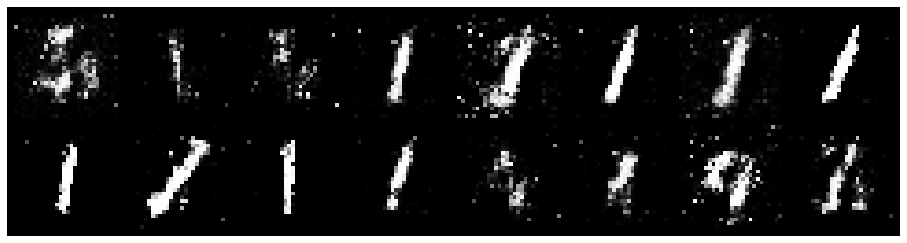

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 0.3421, Generator Loss: 2.8205
D(x): 0.9025, D(G(z)): 0.1017


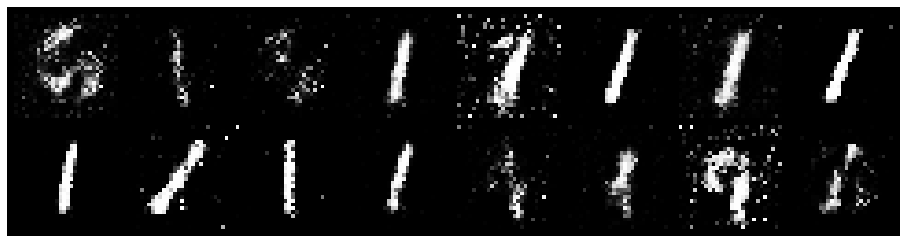

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 0.2634, Generator Loss: 3.4247
D(x): 0.9223, D(G(z)): 0.1068


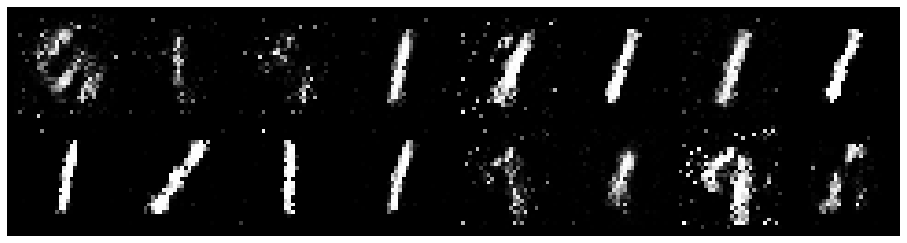

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 0.3489, Generator Loss: 3.3905
D(x): 0.9462, D(G(z)): 0.1796


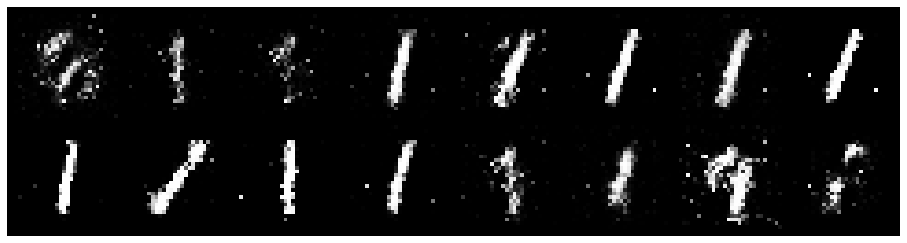

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 0.2967, Generator Loss: 2.5982
D(x): 0.8944, D(G(z)): 0.0698


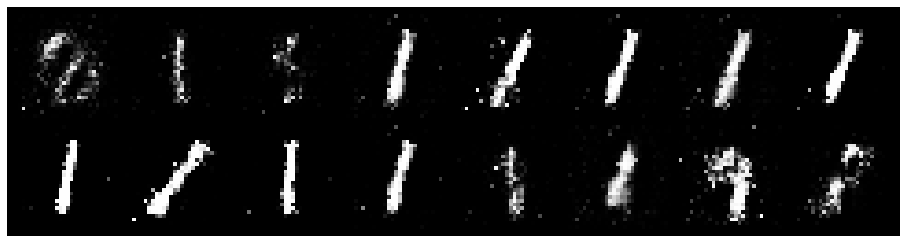

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 0.2993, Generator Loss: 3.9513
D(x): 0.9097, D(G(z)): 0.0474


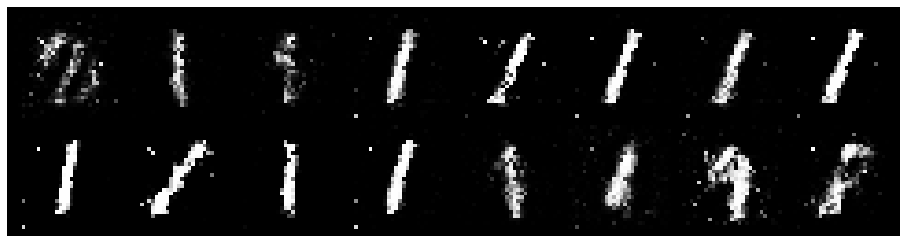

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 0.1882, Generator Loss: 3.3682
D(x): 0.9751, D(G(z)): 0.1053


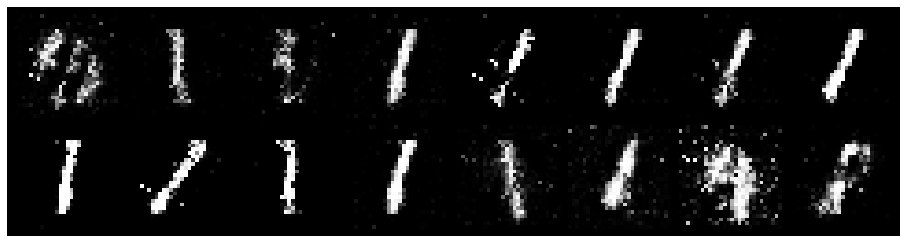

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 0.2823, Generator Loss: 2.3034
D(x): 0.9419, D(G(z)): 0.1421


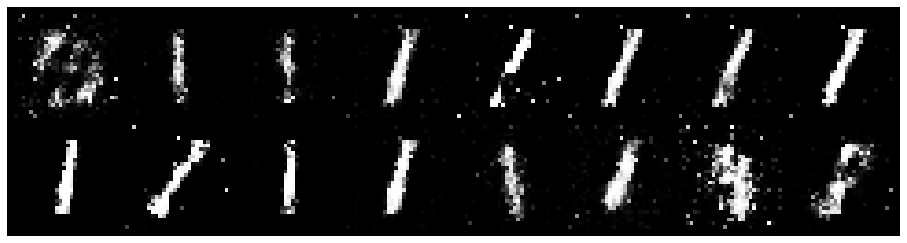

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 0.4284, Generator Loss: 2.5383
D(x): 0.8784, D(G(z)): 0.1391


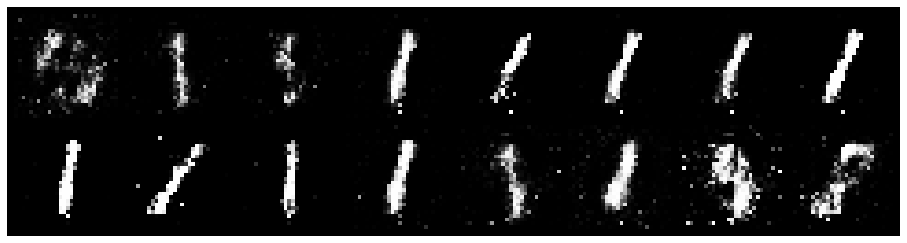

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 0.3705, Generator Loss: 2.8004
D(x): 0.8870, D(G(z)): 0.0805


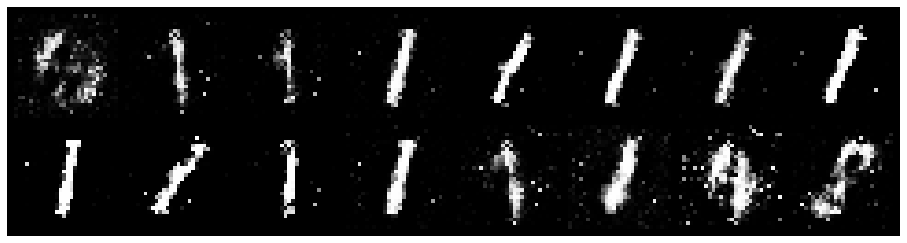

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 0.3076, Generator Loss: 2.9940
D(x): 0.9135, D(G(z)): 0.1004


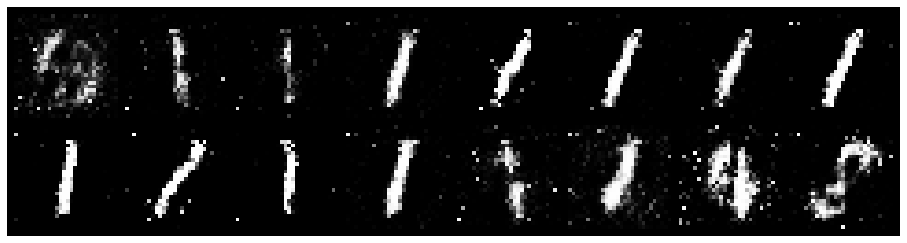

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 0.2803, Generator Loss: 3.2028
D(x): 0.8958, D(G(z)): 0.0512


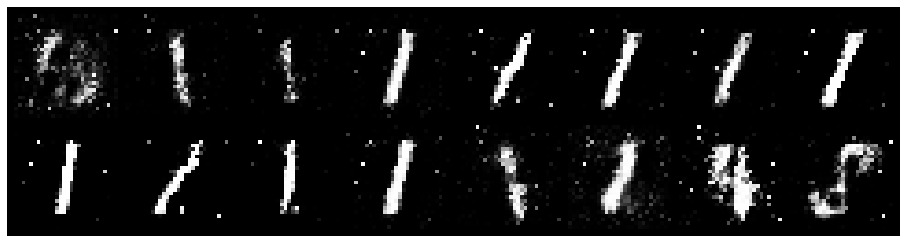

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 0.4530, Generator Loss: 3.8943
D(x): 0.8345, D(G(z)): 0.0551


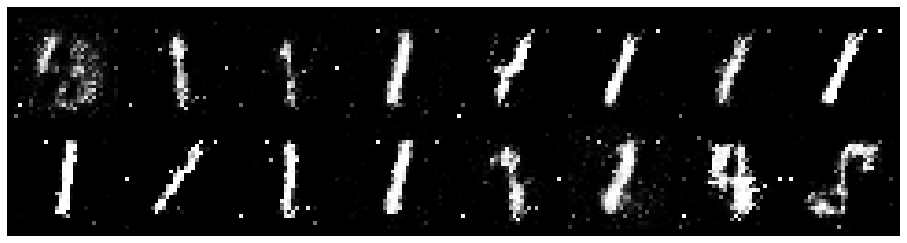

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 0.3275, Generator Loss: 3.7406
D(x): 0.8805, D(G(z)): 0.0446


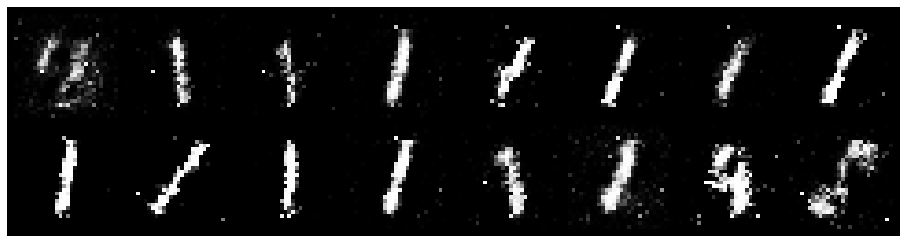

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 0.2487, Generator Loss: 3.6325
D(x): 0.9235, D(G(z)): 0.0509


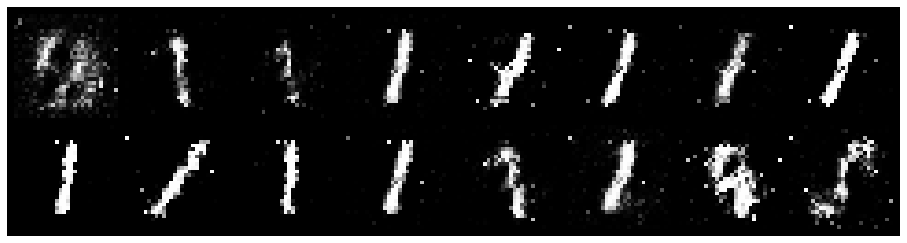

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 0.4856, Generator Loss: 3.4166
D(x): 0.8443, D(G(z)): 0.0831


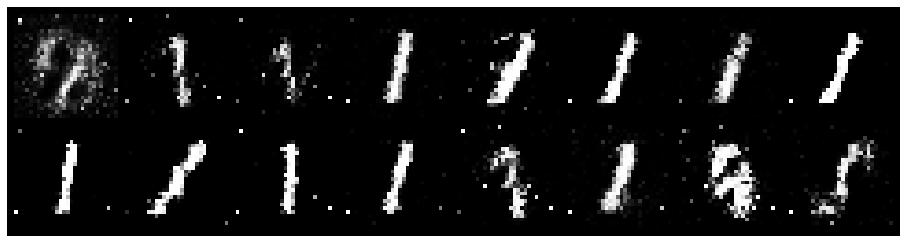

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 0.3286, Generator Loss: 3.2084
D(x): 0.9239, D(G(z)): 0.1436


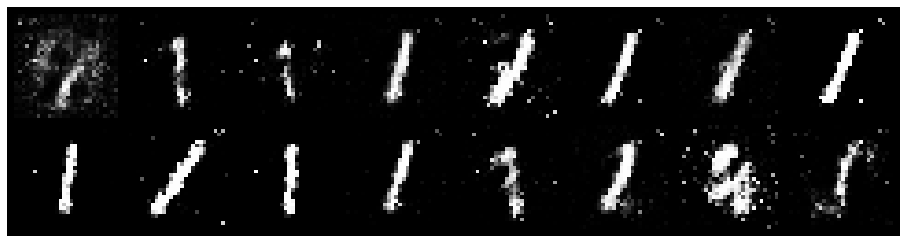

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 0.2229, Generator Loss: 3.0656
D(x): 0.9231, D(G(z)): 0.0625


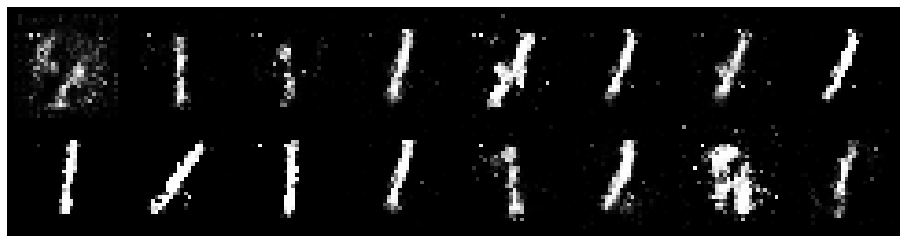

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 0.5368, Generator Loss: 2.6283
D(x): 0.8462, D(G(z)): 0.0984


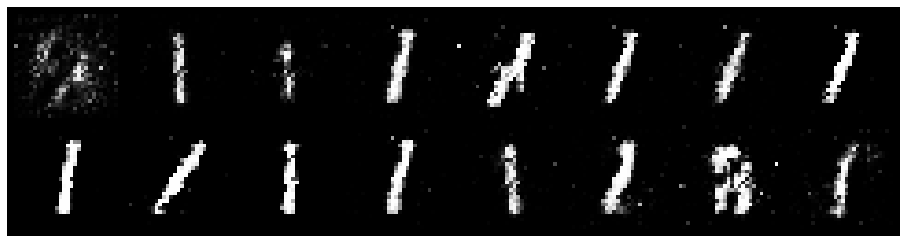

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 0.4683, Generator Loss: 3.2976
D(x): 0.9208, D(G(z)): 0.1690


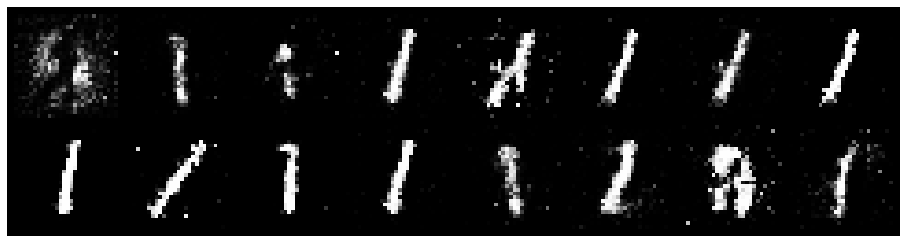

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 0.2843, Generator Loss: 2.8932
D(x): 0.8658, D(G(z)): 0.0536


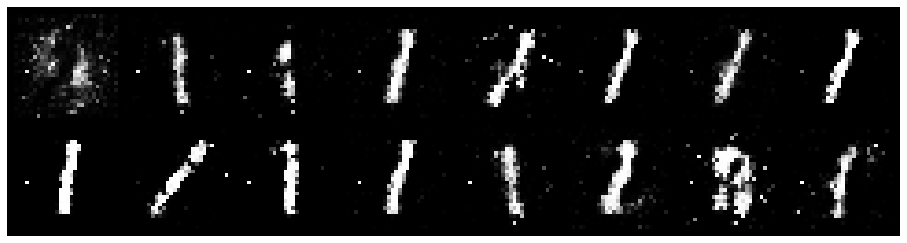

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 0.3908, Generator Loss: 3.3015
D(x): 0.9167, D(G(z)): 0.1376


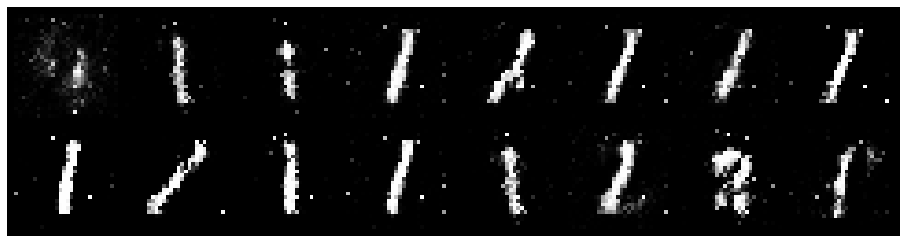

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 0.3584, Generator Loss: 3.0724
D(x): 0.8771, D(G(z)): 0.1016


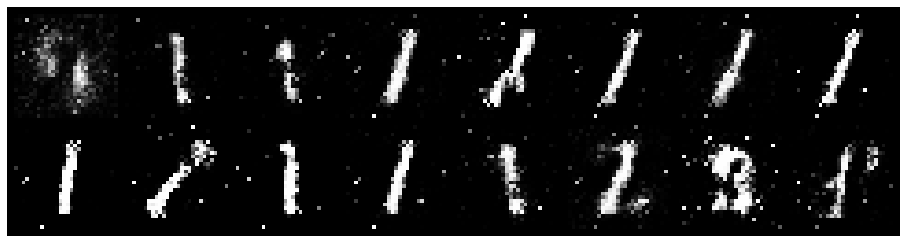

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 0.2488, Generator Loss: 3.2644
D(x): 0.9411, D(G(z)): 0.1069


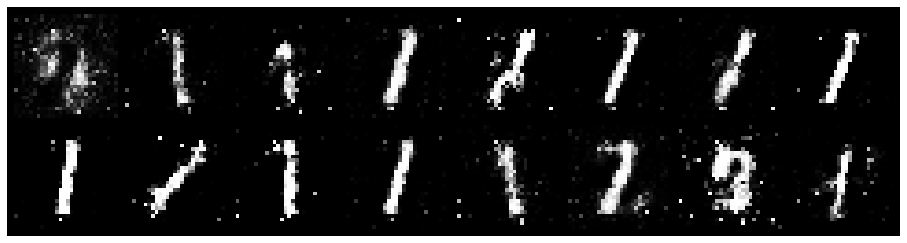

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 0.3213, Generator Loss: 2.9953
D(x): 0.9087, D(G(z)): 0.1012


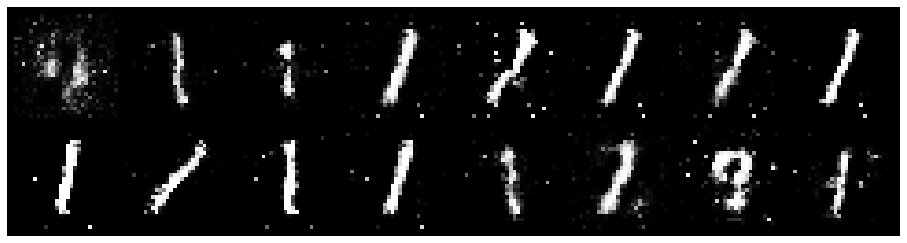

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 0.2764, Generator Loss: 2.7503
D(x): 0.9633, D(G(z)): 0.1567


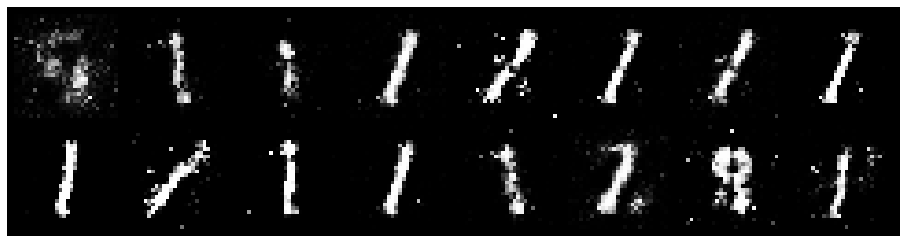

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 0.4939, Generator Loss: 2.8761
D(x): 0.9124, D(G(z)): 0.2187


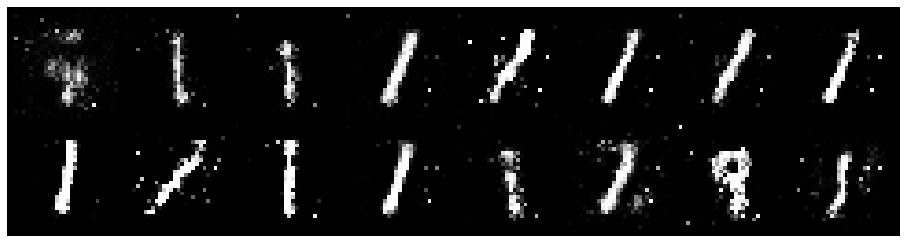

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 0.3581, Generator Loss: 3.4215
D(x): 0.9231, D(G(z)): 0.1234


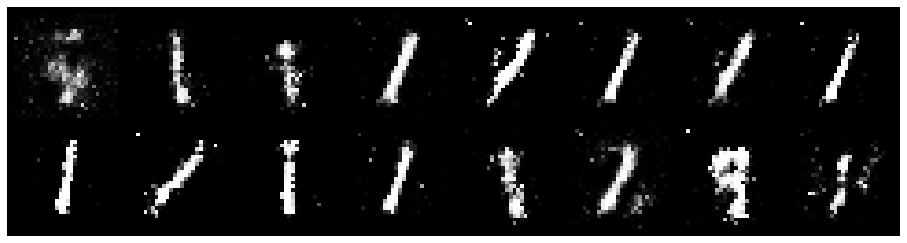

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 0.1794, Generator Loss: 3.3656
D(x): 0.9514, D(G(z)): 0.0886


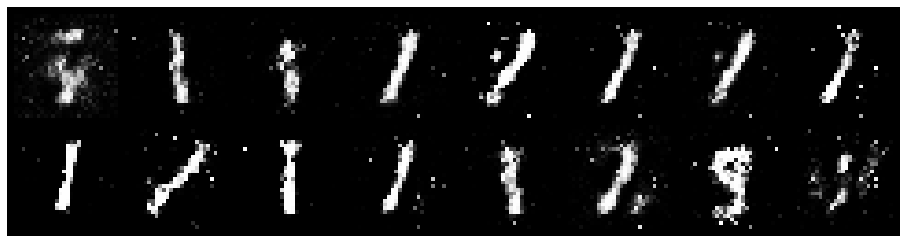

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 0.2430, Generator Loss: 2.9806
D(x): 0.9251, D(G(z)): 0.0913


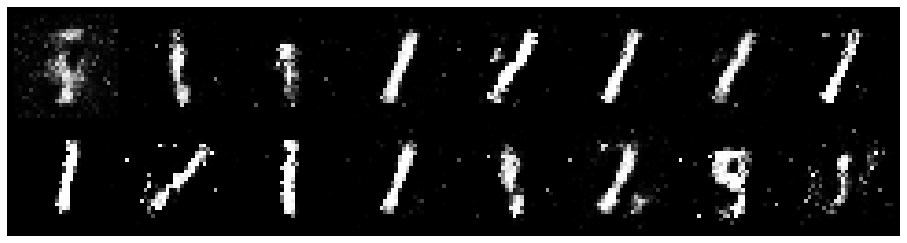

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 0.3673, Generator Loss: 2.5712
D(x): 0.8647, D(G(z)): 0.0913


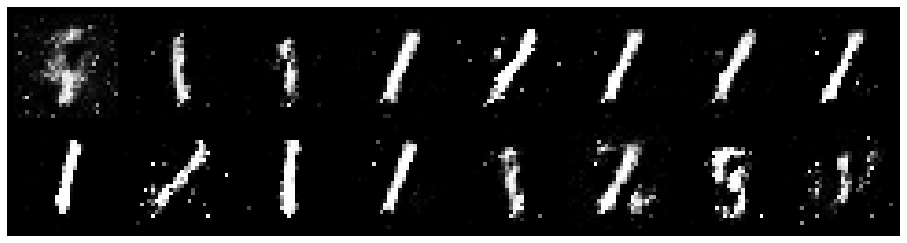

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 0.3497, Generator Loss: 3.0169
D(x): 0.8755, D(G(z)): 0.0877


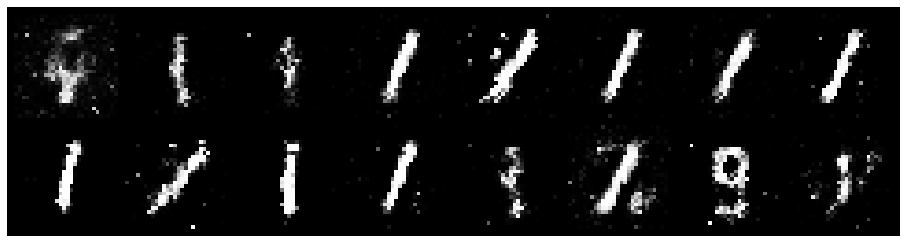

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 0.3002, Generator Loss: 2.7330
D(x): 0.9141, D(G(z)): 0.0992


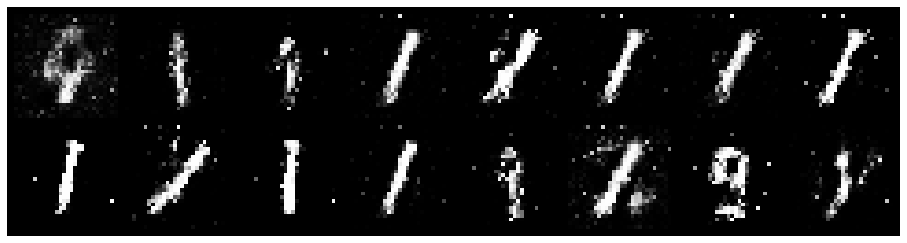

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 0.3658, Generator Loss: 3.4921
D(x): 0.8961, D(G(z)): 0.0944


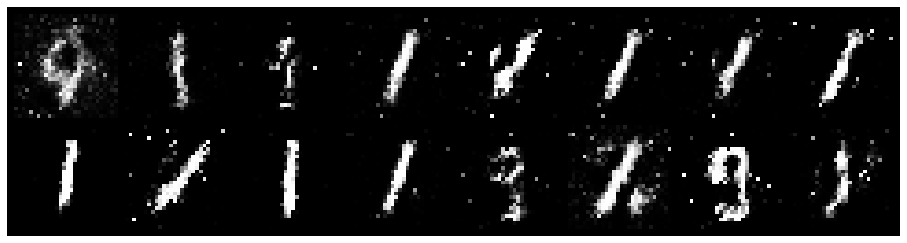

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 0.4164, Generator Loss: 2.8731
D(x): 0.9116, D(G(z)): 0.1616


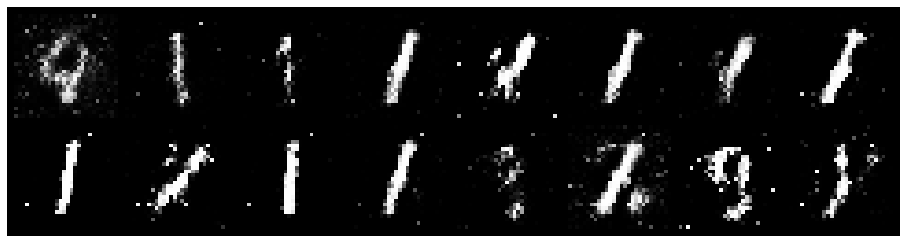

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 0.3723, Generator Loss: 3.1483
D(x): 0.8351, D(G(z)): 0.0393


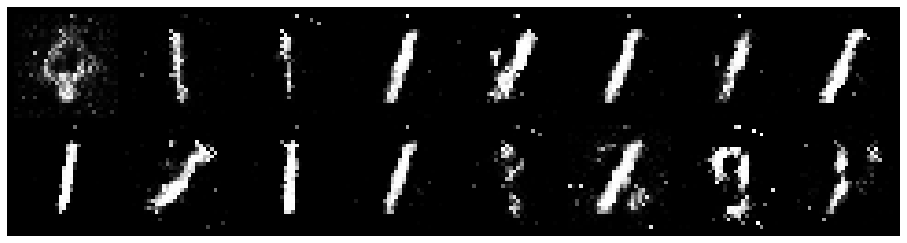

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 0.3037, Generator Loss: 3.0462
D(x): 0.9363, D(G(z)): 0.0959


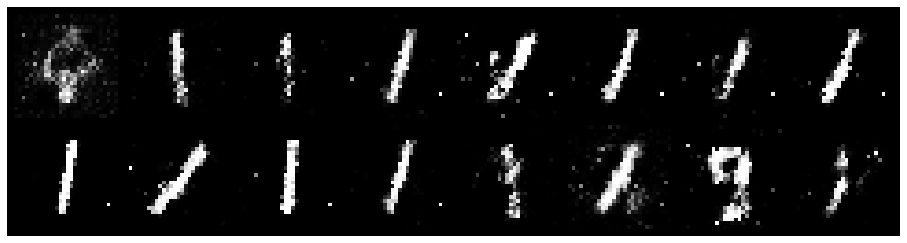

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 0.4880, Generator Loss: 4.0063
D(x): 0.8546, D(G(z)): 0.1153


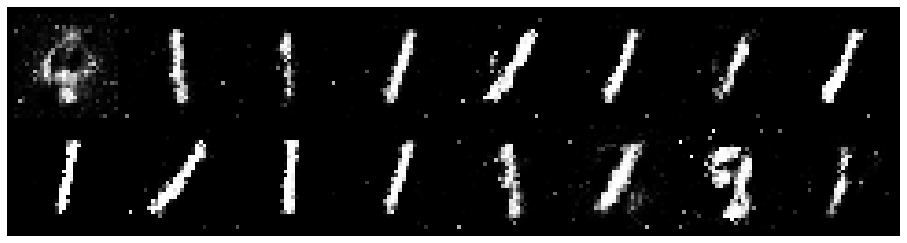

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 0.2622, Generator Loss: 2.6320
D(x): 0.9261, D(G(z)): 0.0854


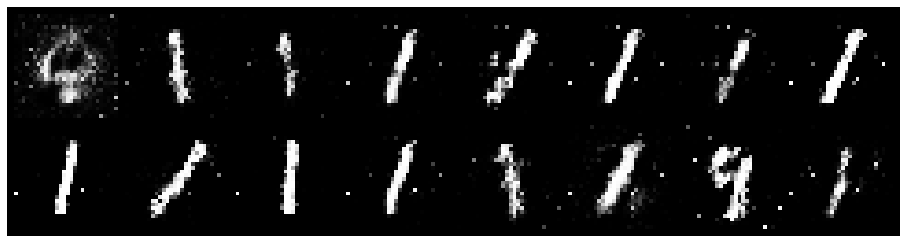

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 0.3895, Generator Loss: 3.0276
D(x): 0.8941, D(G(z)): 0.1306


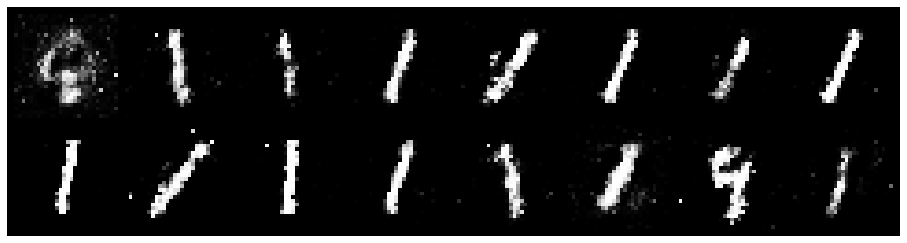

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 0.3464, Generator Loss: 2.9589
D(x): 0.8976, D(G(z)): 0.1392


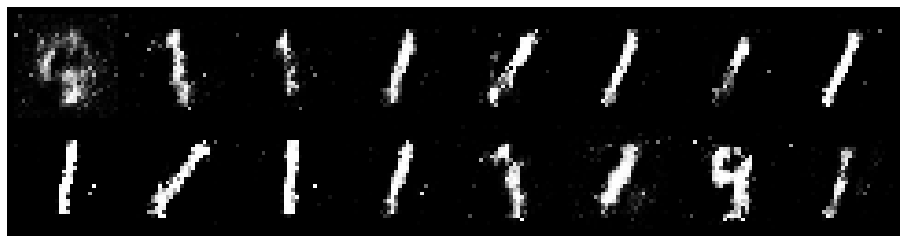

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 0.3688, Generator Loss: 2.8364
D(x): 0.9256, D(G(z)): 0.1481


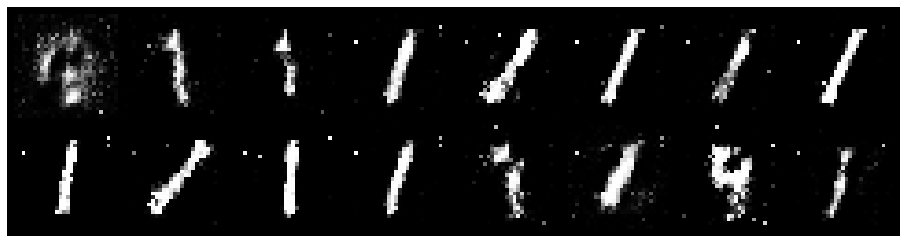

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 0.5285, Generator Loss: 2.0578
D(x): 0.8284, D(G(z)): 0.1055


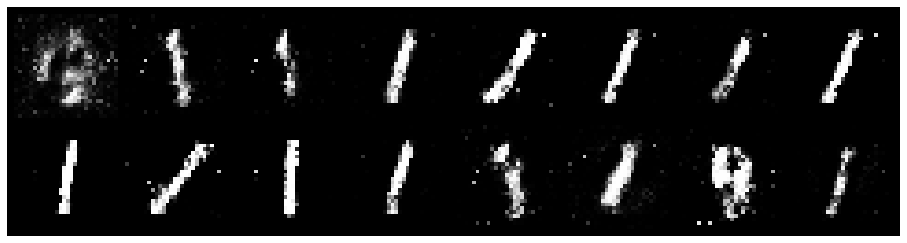

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 0.4828, Generator Loss: 2.1782
D(x): 0.9080, D(G(z)): 0.2126


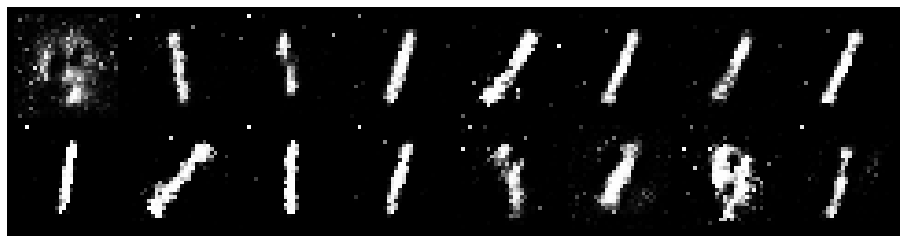

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 0.3720, Generator Loss: 2.4922
D(x): 0.8843, D(G(z)): 0.1334


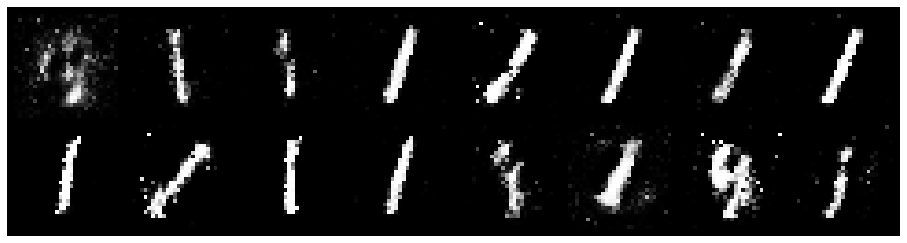

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 0.4237, Generator Loss: 2.9813
D(x): 0.8816, D(G(z)): 0.1154


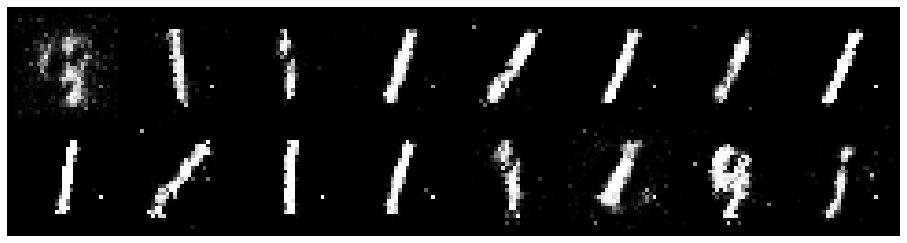

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 0.4677, Generator Loss: 2.3146
D(x): 0.8635, D(G(z)): 0.1449


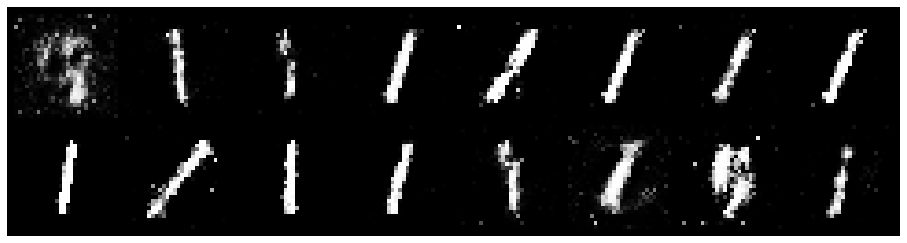

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 0.5007, Generator Loss: 3.0198
D(x): 0.8594, D(G(z)): 0.0896


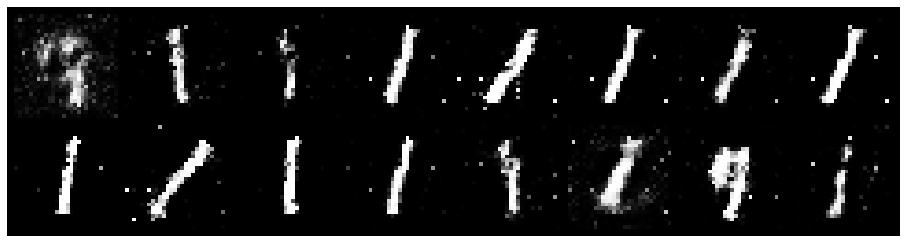

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 0.5359, Generator Loss: 2.9219
D(x): 0.8320, D(G(z)): 0.0749


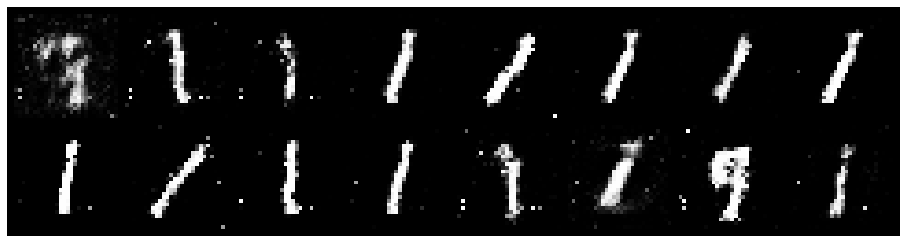

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 0.5144, Generator Loss: 2.9327
D(x): 0.8849, D(G(z)): 0.1326


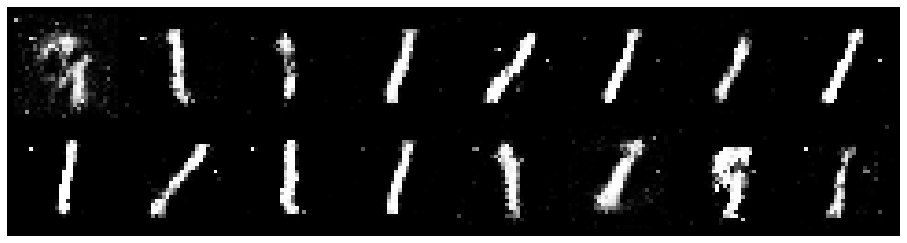

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 0.3795, Generator Loss: 2.9738
D(x): 0.8998, D(G(z)): 0.1058


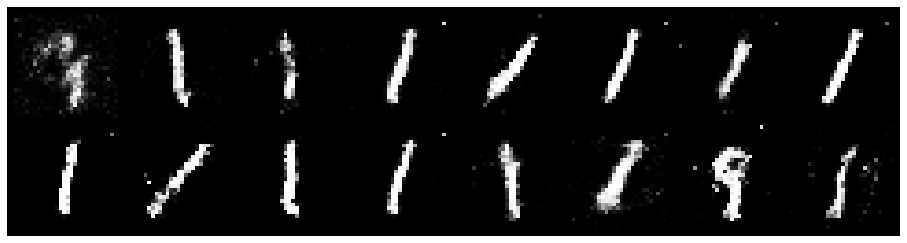

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 0.4345, Generator Loss: 3.0893
D(x): 0.8791, D(G(z)): 0.1268


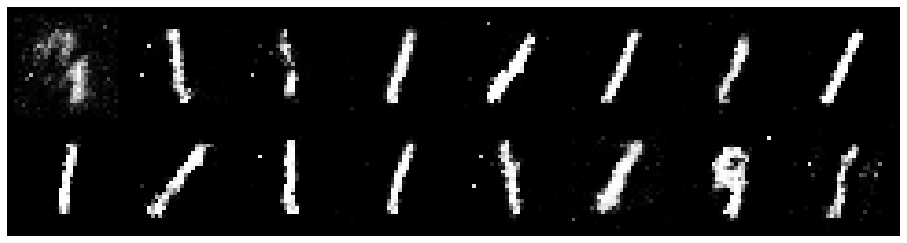

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 0.3468, Generator Loss: 2.6957
D(x): 0.9043, D(G(z)): 0.1065


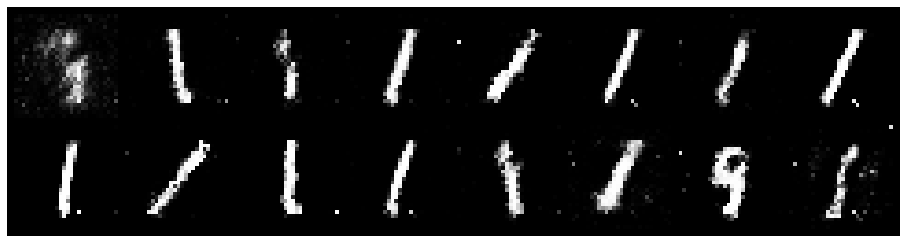

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 0.5224, Generator Loss: 2.6798
D(x): 0.8639, D(G(z)): 0.1474


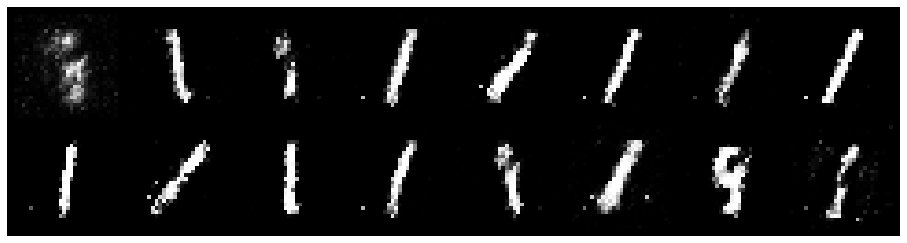

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 0.3777, Generator Loss: 3.1418
D(x): 0.8885, D(G(z)): 0.0864


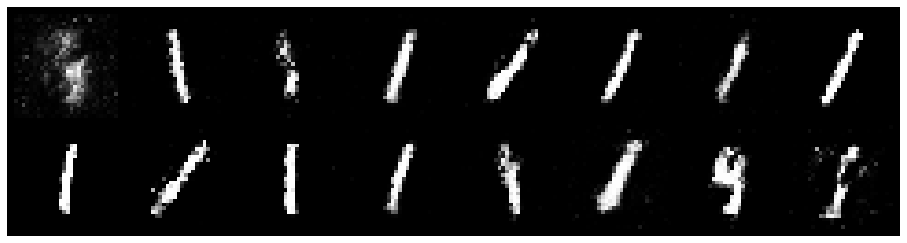

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 0.4227, Generator Loss: 2.4387
D(x): 0.9015, D(G(z)): 0.1806


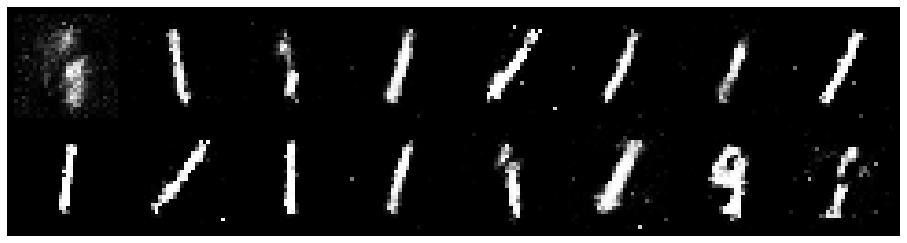

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 0.3965, Generator Loss: 2.5350
D(x): 0.9191, D(G(z)): 0.1653


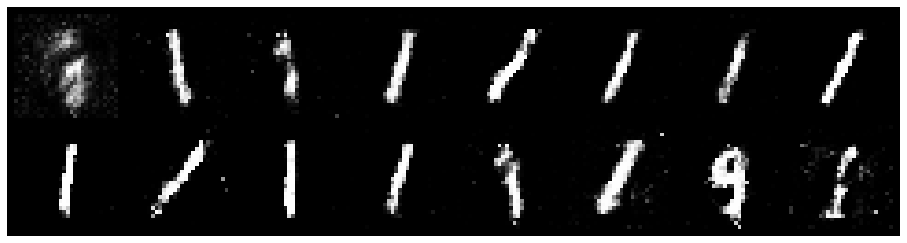

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 0.2795, Generator Loss: 2.6424
D(x): 0.9126, D(G(z)): 0.1141


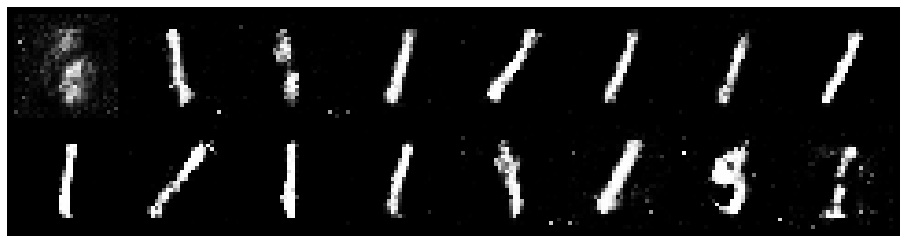

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 0.3184, Generator Loss: 2.6968
D(x): 0.9114, D(G(z)): 0.1266


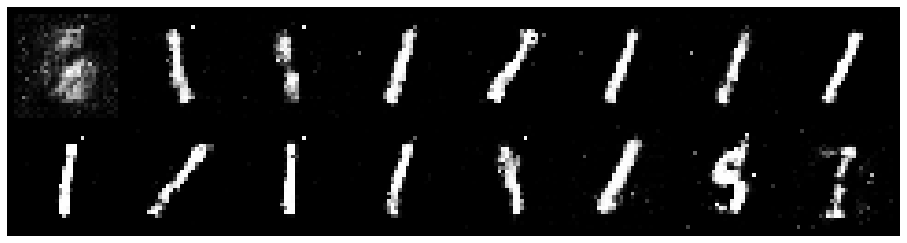

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 0.4114, Generator Loss: 2.3847
D(x): 0.8744, D(G(z)): 0.1215


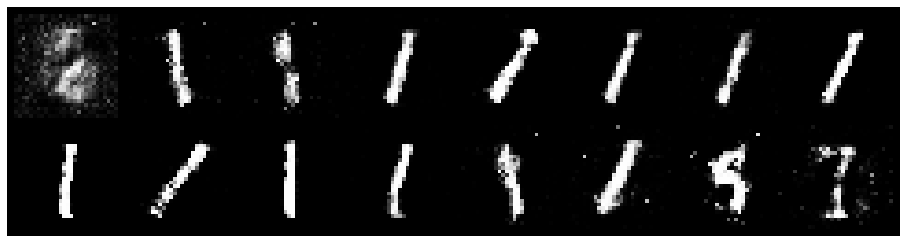

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 0.3891, Generator Loss: 2.4337
D(x): 0.8680, D(G(z)): 0.1102


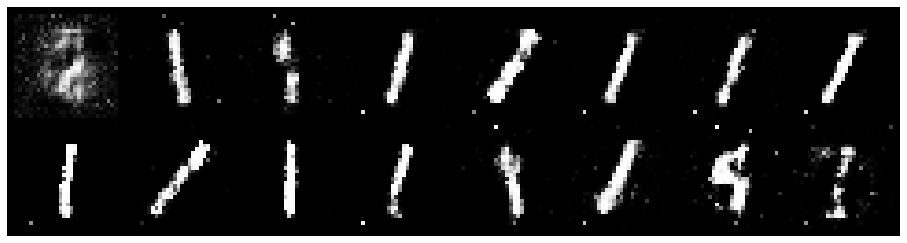

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 0.3502, Generator Loss: 2.6515
D(x): 0.8960, D(G(z)): 0.0801


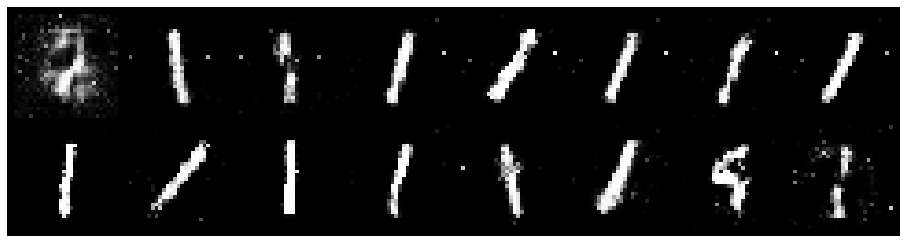

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 0.3933, Generator Loss: 2.6983
D(x): 0.8999, D(G(z)): 0.1352


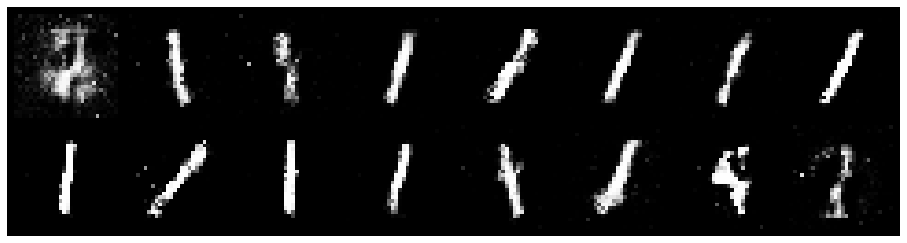

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 0.3206, Generator Loss: 3.0405
D(x): 0.9038, D(G(z)): 0.0958


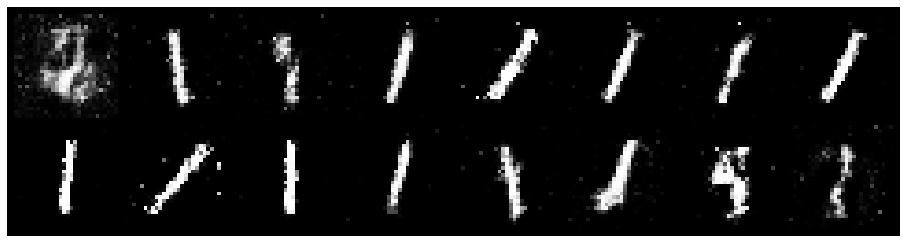

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 0.3931, Generator Loss: 2.6053
D(x): 0.9145, D(G(z)): 0.1566


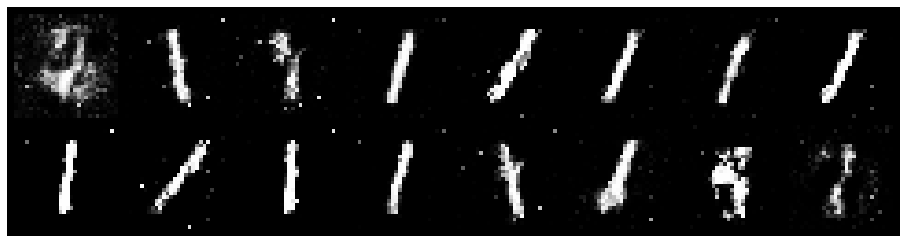

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 0.3304, Generator Loss: 2.3388
D(x): 0.8978, D(G(z)): 0.1201


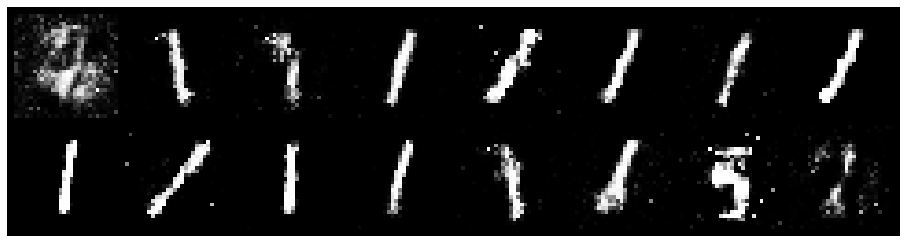

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 0.3675, Generator Loss: 2.9639
D(x): 0.8760, D(G(z)): 0.0918


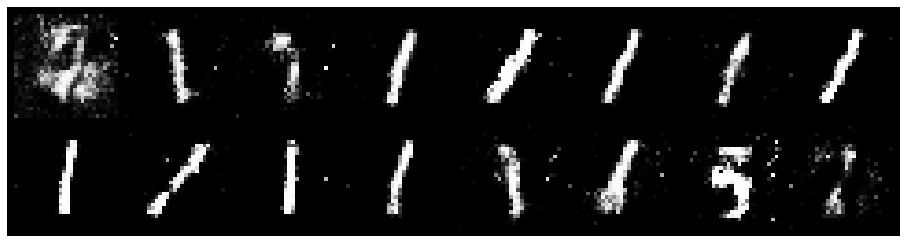

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 0.4700, Generator Loss: 2.7446
D(x): 0.8524, D(G(z)): 0.0866


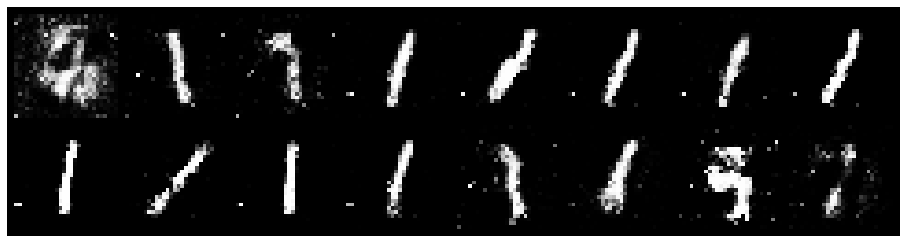

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 0.3572, Generator Loss: 2.7527
D(x): 0.8720, D(G(z)): 0.1153


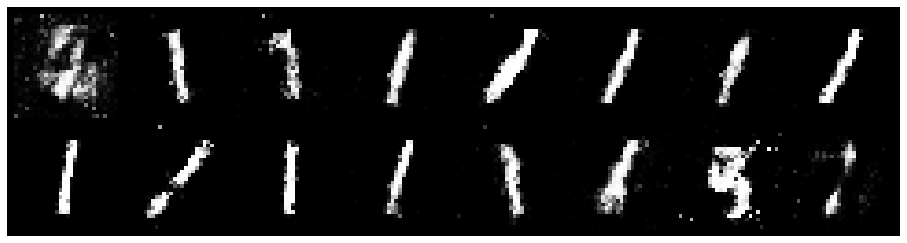

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 0.4245, Generator Loss: 2.5258
D(x): 0.8786, D(G(z)): 0.1443


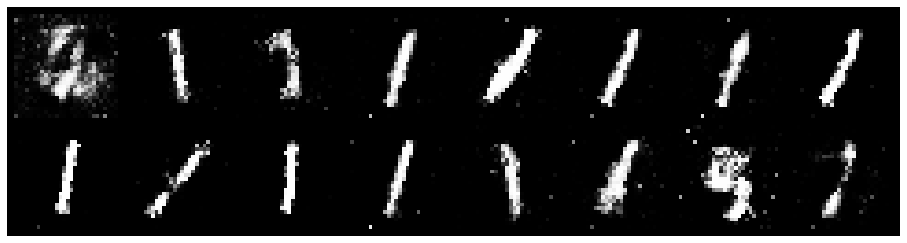

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 0.3862, Generator Loss: 3.2070
D(x): 0.8837, D(G(z)): 0.1124


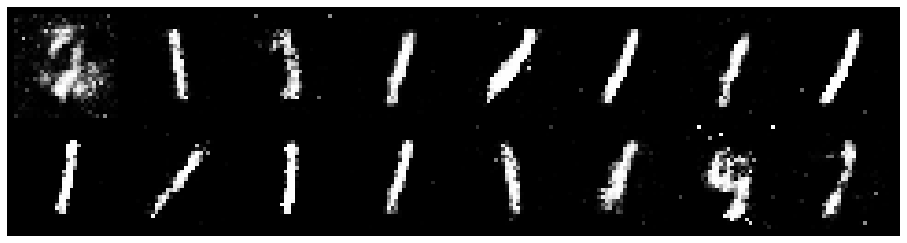

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 0.4463, Generator Loss: 2.9906
D(x): 0.8332, D(G(z)): 0.0600


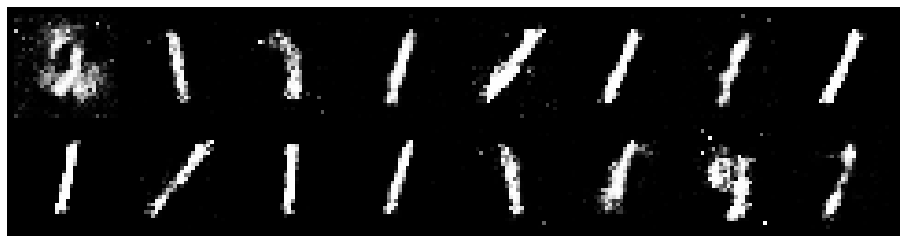

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 0.4462, Generator Loss: 2.6857
D(x): 0.8726, D(G(z)): 0.0982


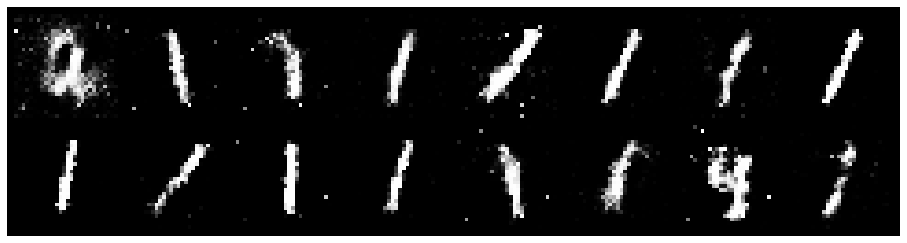

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 0.4016, Generator Loss: 2.1420
D(x): 0.8809, D(G(z)): 0.1593


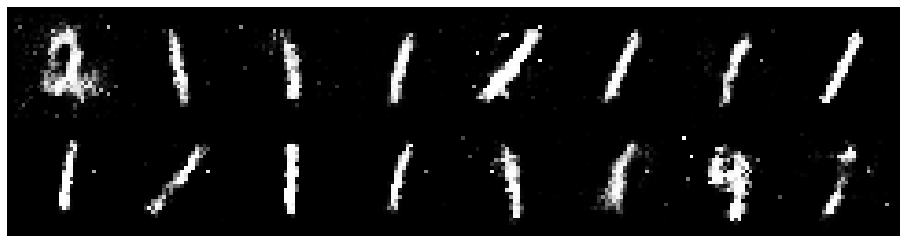

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 0.5561, Generator Loss: 2.5278
D(x): 0.8424, D(G(z)): 0.1253


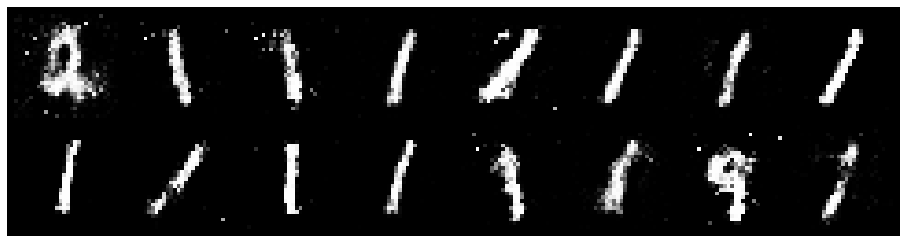

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 0.5031, Generator Loss: 2.2284
D(x): 0.8905, D(G(z)): 0.2029


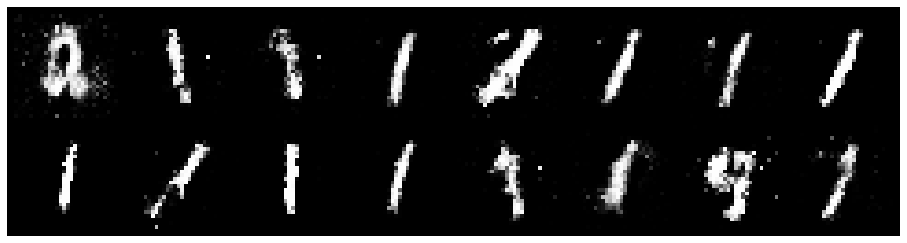

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 0.6283, Generator Loss: 2.6440
D(x): 0.7935, D(G(z)): 0.1228


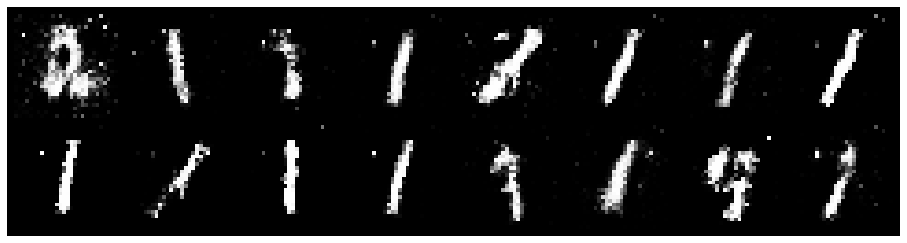

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 0.5199, Generator Loss: 2.9869
D(x): 0.8360, D(G(z)): 0.1122


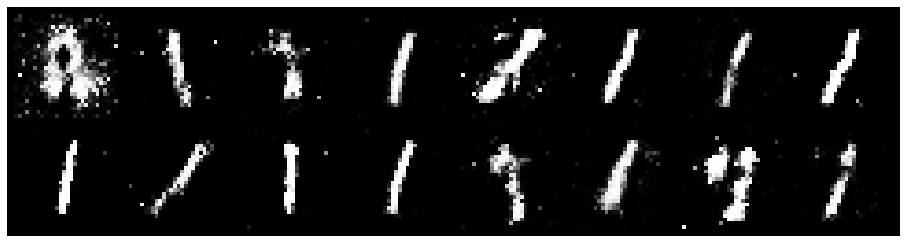

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 0.5277, Generator Loss: 2.8931
D(x): 0.7994, D(G(z)): 0.0980


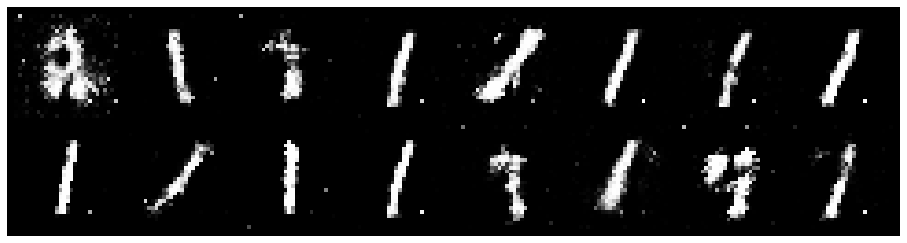

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 0.4549, Generator Loss: 2.7041
D(x): 0.8803, D(G(z)): 0.1602


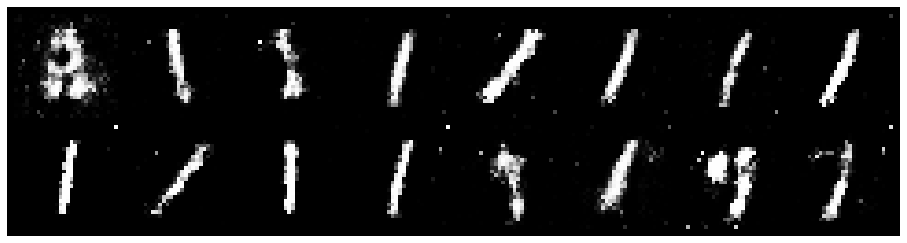

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 0.3666, Generator Loss: 2.5643
D(x): 0.9411, D(G(z)): 0.1681


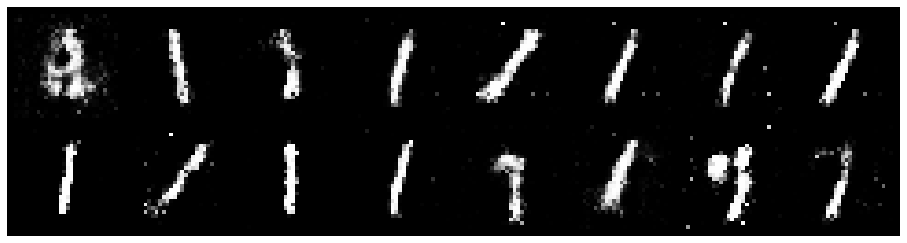

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 0.4819, Generator Loss: 2.8235
D(x): 0.9053, D(G(z)): 0.2109


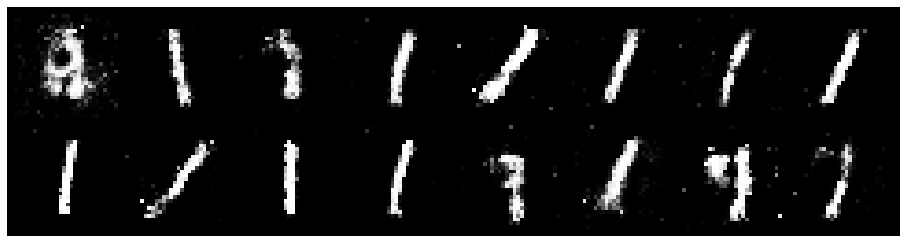

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 0.4353, Generator Loss: 2.8483
D(x): 0.8590, D(G(z)): 0.0937


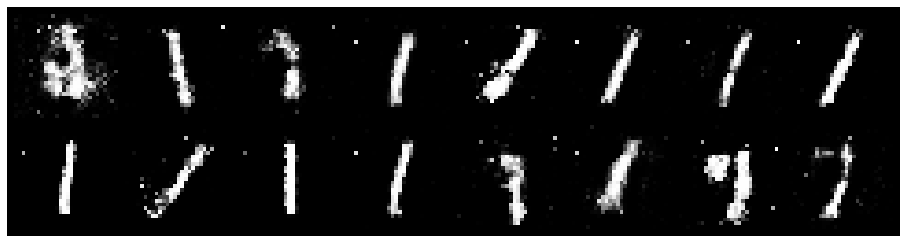

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 0.3926, Generator Loss: 3.0822
D(x): 0.8807, D(G(z)): 0.1120


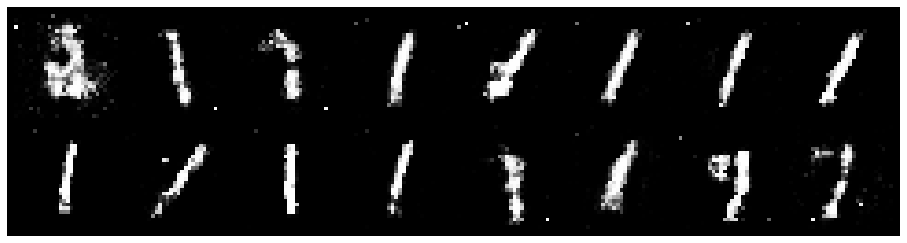

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 0.5326, Generator Loss: 2.3917
D(x): 0.8457, D(G(z)): 0.1183


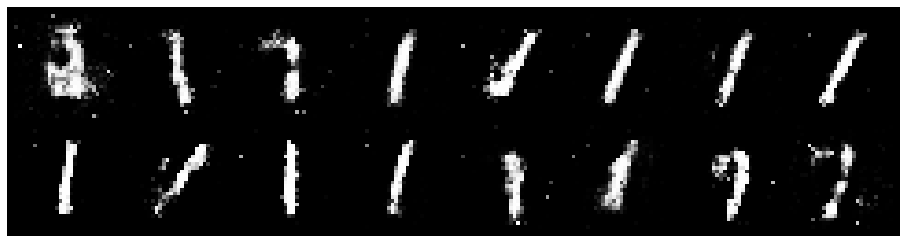

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 0.4426, Generator Loss: 2.4944
D(x): 0.8744, D(G(z)): 0.1414


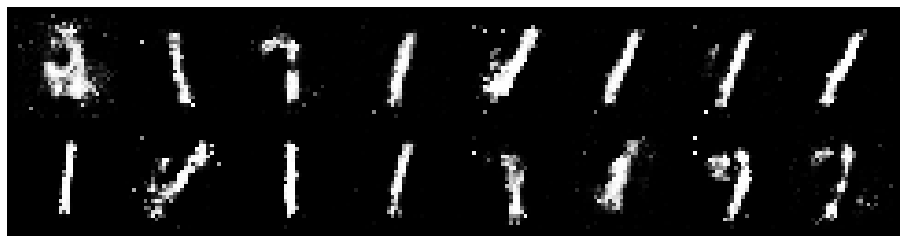

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 0.7076, Generator Loss: 2.5653
D(x): 0.7526, D(G(z)): 0.0953


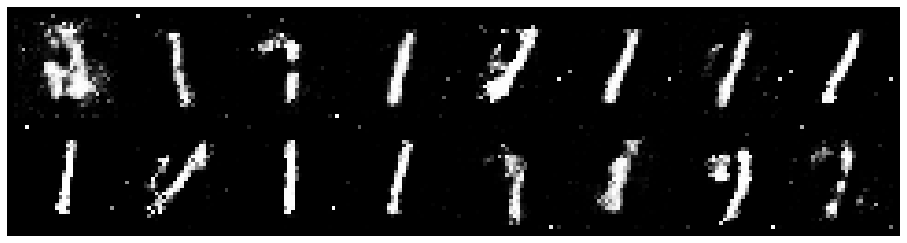

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 0.6212, Generator Loss: 2.2141
D(x): 0.8635, D(G(z)): 0.2471


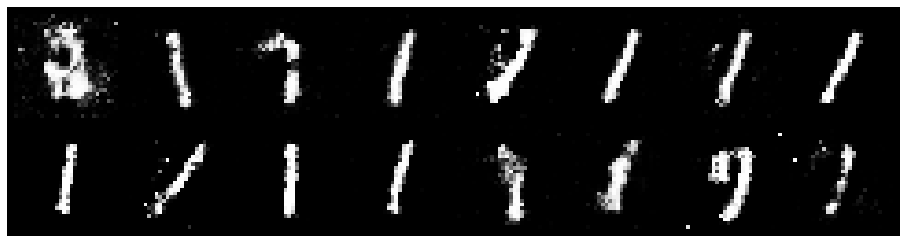

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 0.5750, Generator Loss: 2.7667
D(x): 0.8308, D(G(z)): 0.1456


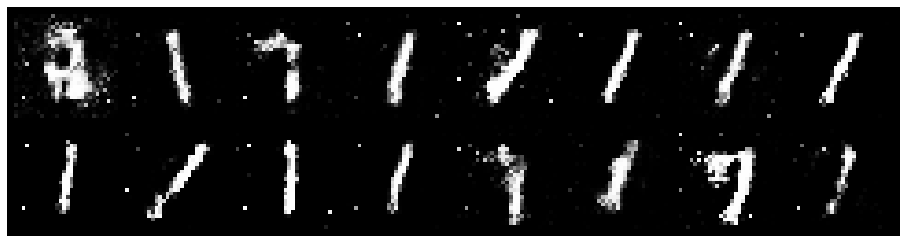

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 0.4769, Generator Loss: 2.7503
D(x): 0.8305, D(G(z)): 0.0827


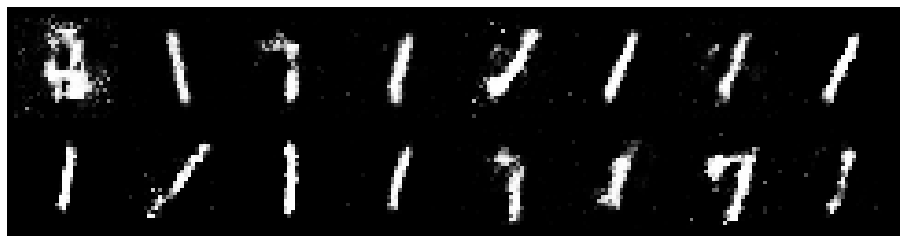

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 0.6514, Generator Loss: 2.1806
D(x): 0.8183, D(G(z)): 0.1670


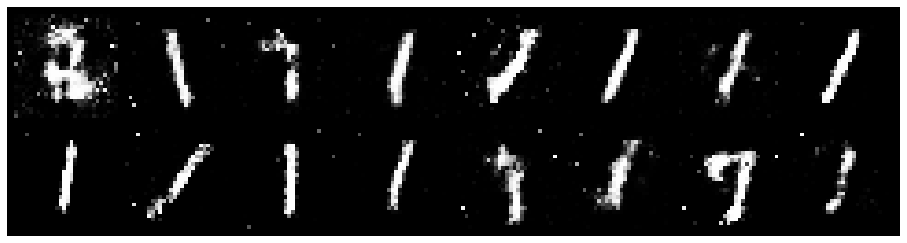

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 0.4398, Generator Loss: 2.2414
D(x): 0.8663, D(G(z)): 0.1362


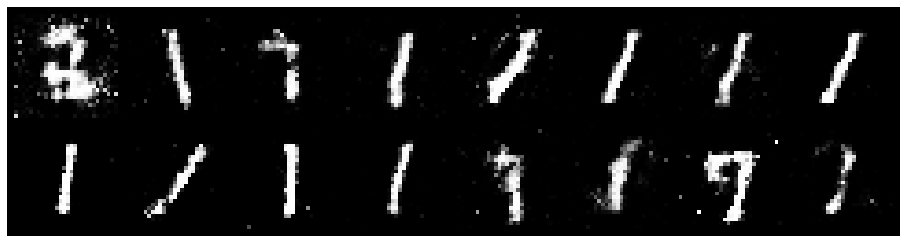

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 0.5460, Generator Loss: 2.2517
D(x): 0.8218, D(G(z)): 0.1470


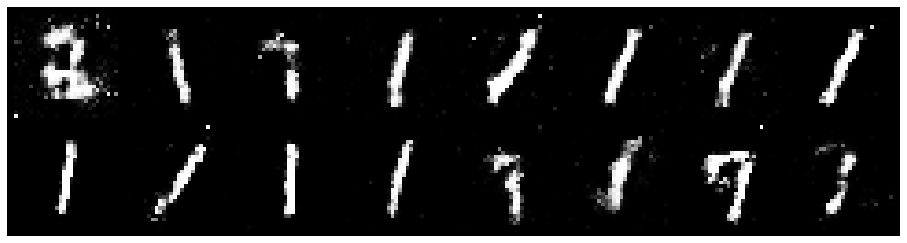

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 0.4972, Generator Loss: 1.9026
D(x): 0.8819, D(G(z)): 0.2015


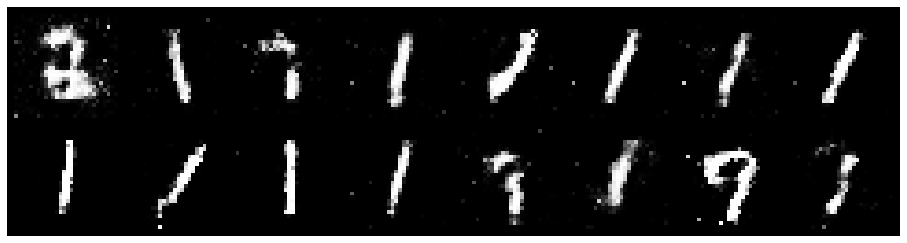

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 0.6241, Generator Loss: 2.3453
D(x): 0.8170, D(G(z)): 0.1654


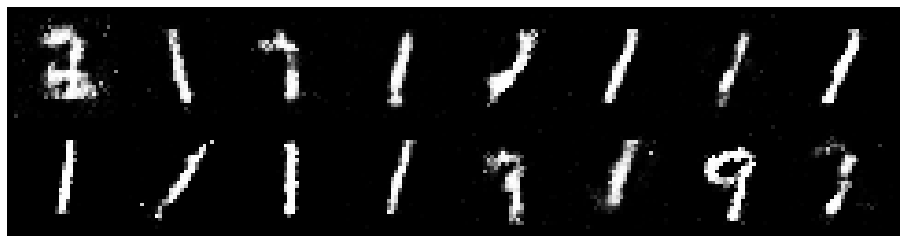

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 0.5012, Generator Loss: 2.5602
D(x): 0.8021, D(G(z)): 0.0810


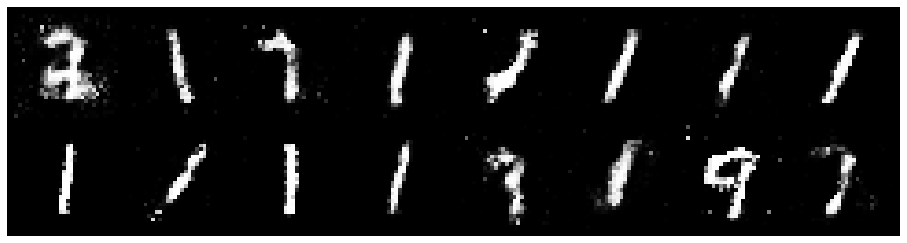

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 0.6862, Generator Loss: 1.7871
D(x): 0.8161, D(G(z)): 0.2073


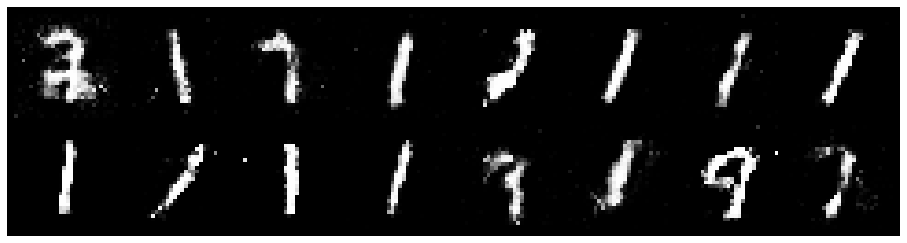

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 0.4612, Generator Loss: 2.2105
D(x): 0.8726, D(G(z)): 0.1530


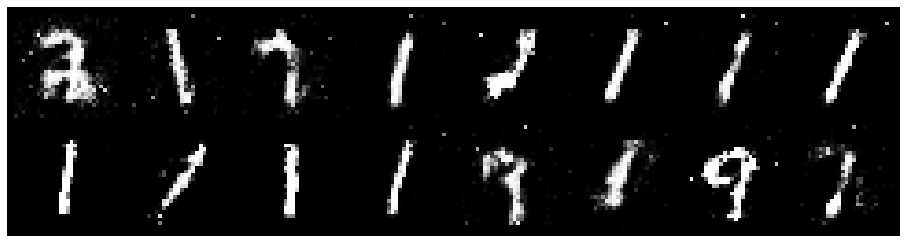

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 0.5924, Generator Loss: 2.0651
D(x): 0.8197, D(G(z)): 0.1760


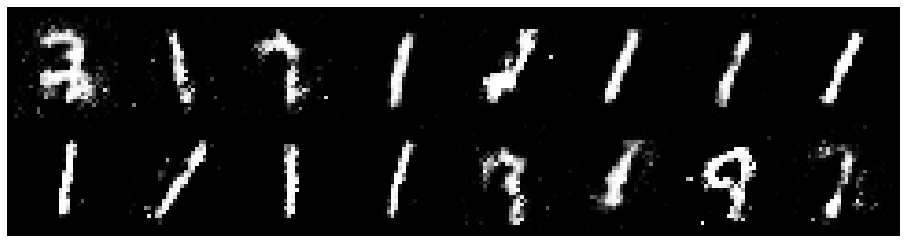

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 0.4804, Generator Loss: 2.6250
D(x): 0.8221, D(G(z)): 0.1046


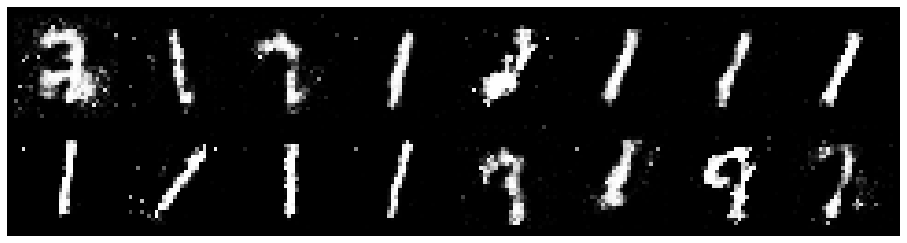

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 0.7183, Generator Loss: 1.8746
D(x): 0.8141, D(G(z)): 0.2205


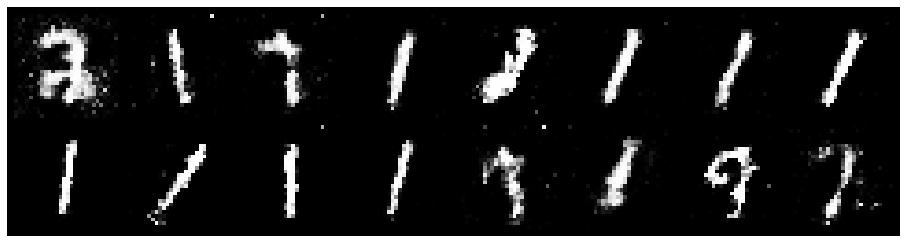

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 0.5112, Generator Loss: 2.5407
D(x): 0.8308, D(G(z)): 0.1354


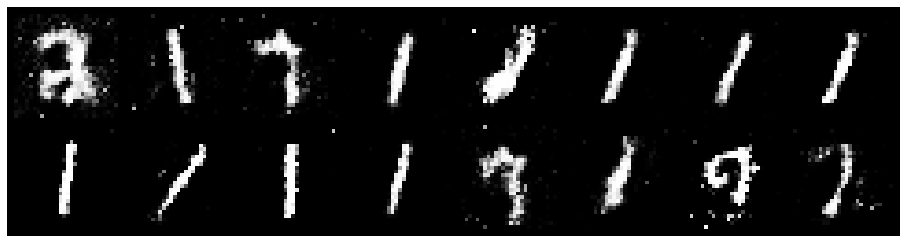

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 0.6132, Generator Loss: 2.1562
D(x): 0.8809, D(G(z)): 0.2189


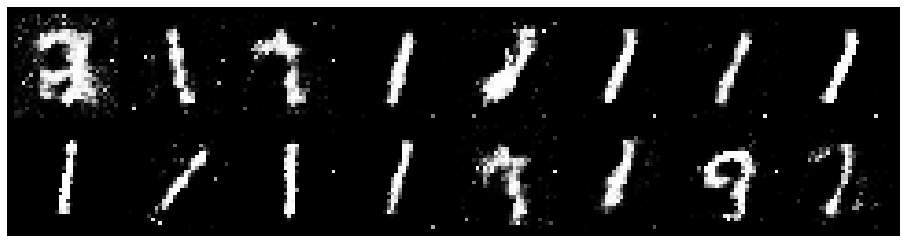

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 0.4852, Generator Loss: 2.5139
D(x): 0.8563, D(G(z)): 0.1623


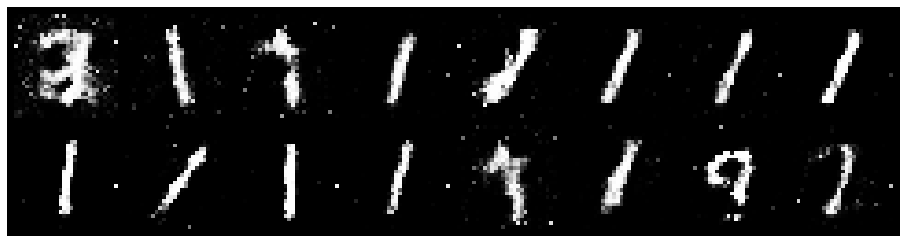

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 0.4444, Generator Loss: 2.4308
D(x): 0.9149, D(G(z)): 0.2199


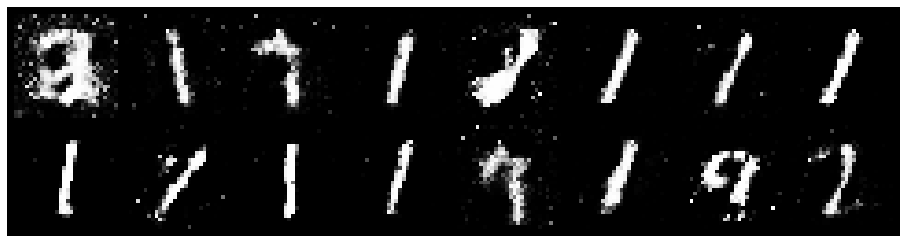

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 0.4769, Generator Loss: 2.1039
D(x): 0.8357, D(G(z)): 0.1597


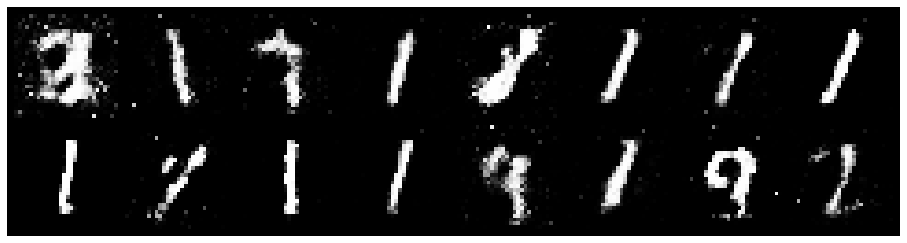

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 0.4853, Generator Loss: 2.8223
D(x): 0.8012, D(G(z)): 0.0964


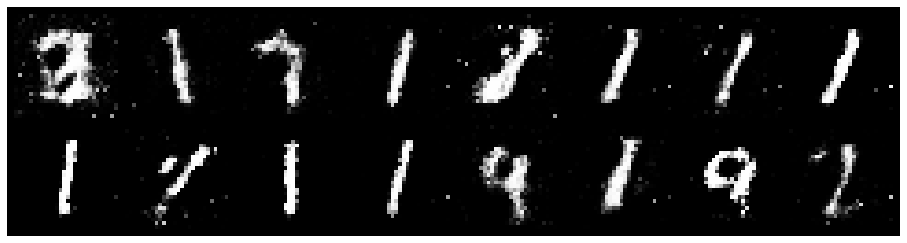

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 0.4194, Generator Loss: 2.5454
D(x): 0.8673, D(G(z)): 0.1380


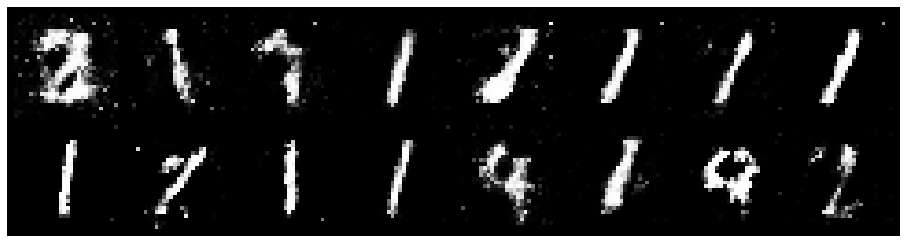

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 0.6272, Generator Loss: 2.0954
D(x): 0.7959, D(G(z)): 0.1526


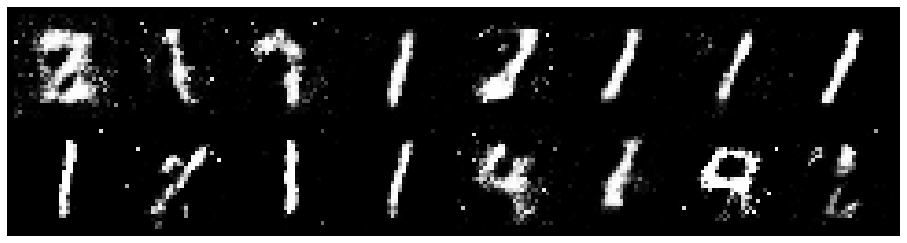

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 0.4648, Generator Loss: 2.3018
D(x): 0.8388, D(G(z)): 0.1533


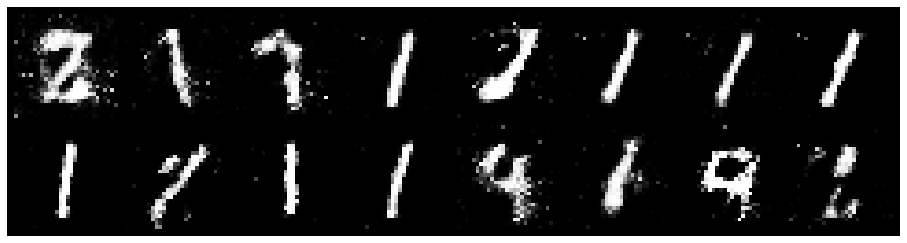

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 0.6329, Generator Loss: 2.6038
D(x): 0.7850, D(G(z)): 0.1501


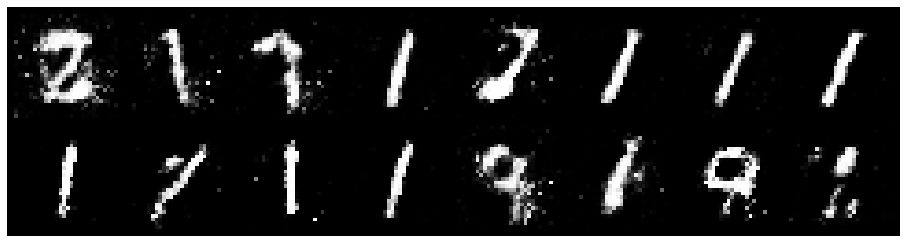

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 0.5709, Generator Loss: 2.5747
D(x): 0.8234, D(G(z)): 0.1311


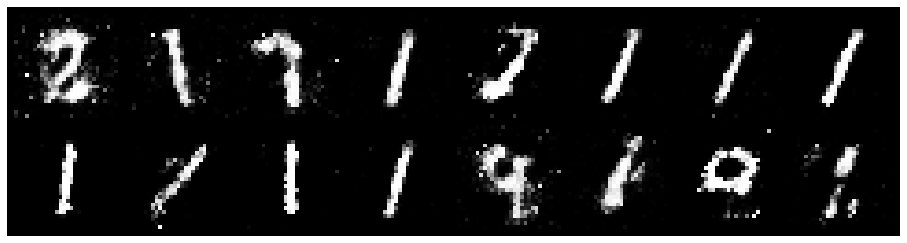

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 0.5202, Generator Loss: 1.7172
D(x): 0.8137, D(G(z)): 0.1813


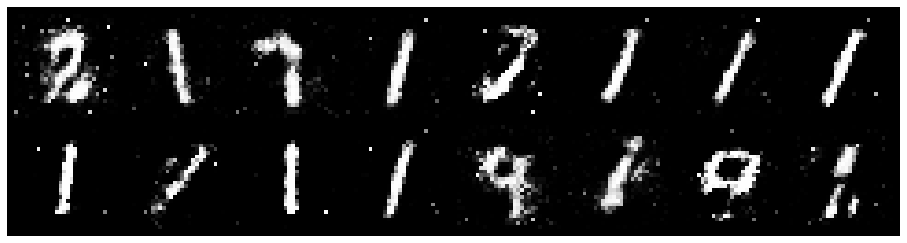

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 0.5209, Generator Loss: 1.9957
D(x): 0.8835, D(G(z)): 0.2150


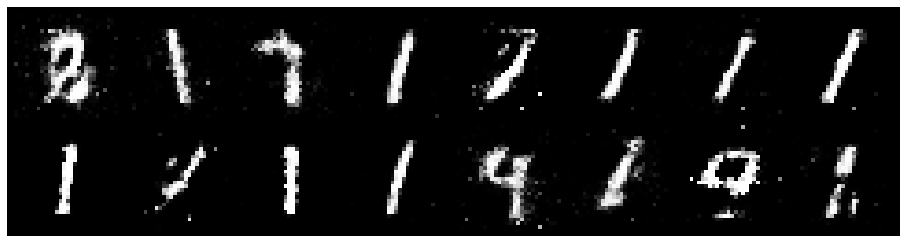

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 0.5866, Generator Loss: 2.2114
D(x): 0.8450, D(G(z)): 0.1979


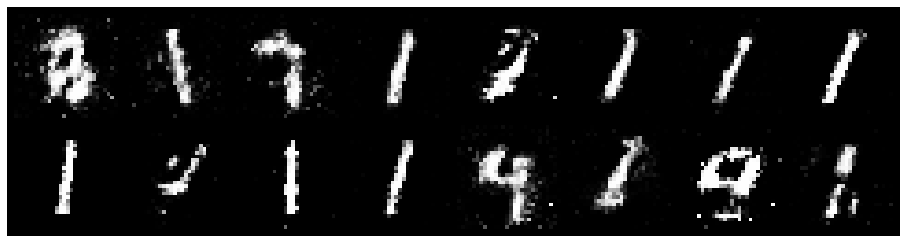

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 0.5306, Generator Loss: 2.7506
D(x): 0.8085, D(G(z)): 0.1028


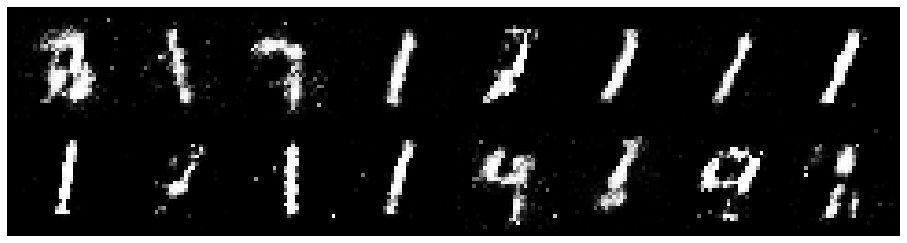

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 0.5556, Generator Loss: 2.5965
D(x): 0.7696, D(G(z)): 0.0817


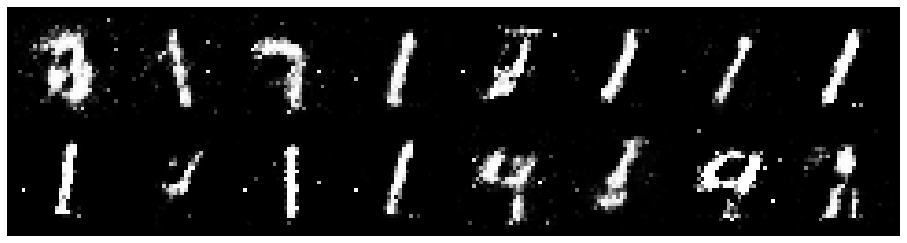

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 0.3949, Generator Loss: 2.3239
D(x): 0.8759, D(G(z)): 0.1454


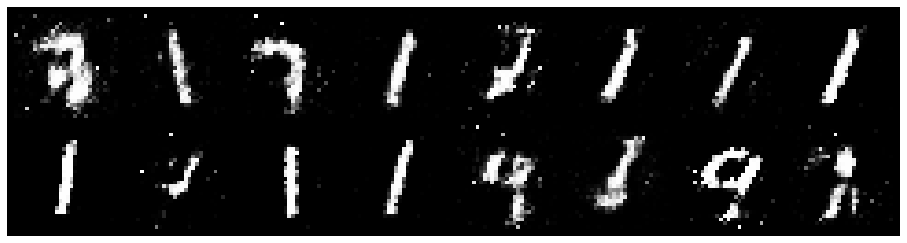

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 0.4411, Generator Loss: 2.3587
D(x): 0.8455, D(G(z)): 0.1348


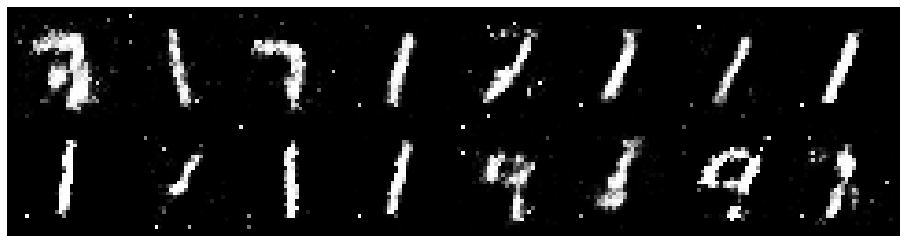

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 0.6177, Generator Loss: 2.1335
D(x): 0.8302, D(G(z)): 0.2198


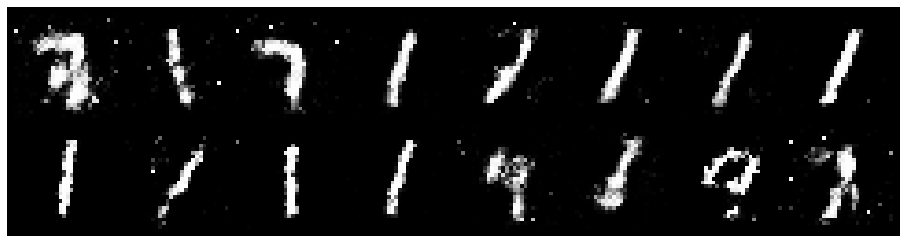

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 0.4403, Generator Loss: 2.5558
D(x): 0.8453, D(G(z)): 0.1261


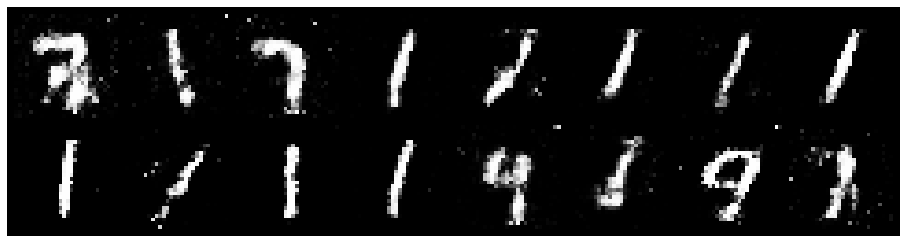

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 0.4691, Generator Loss: 2.0207
D(x): 0.9091, D(G(z)): 0.2339


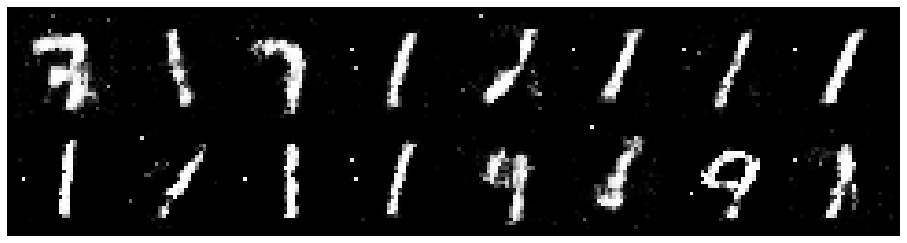

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 0.4640, Generator Loss: 2.3425
D(x): 0.8264, D(G(z)): 0.1341


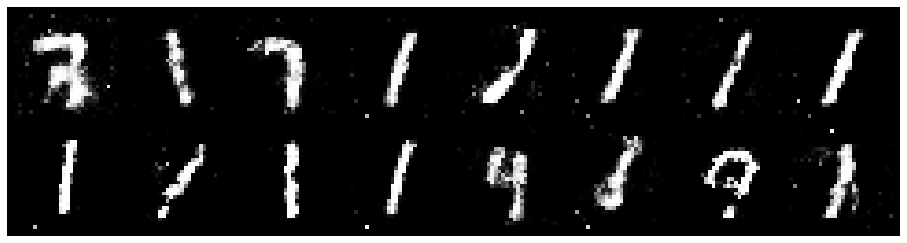

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 0.4776, Generator Loss: 2.2918
D(x): 0.8337, D(G(z)): 0.1203


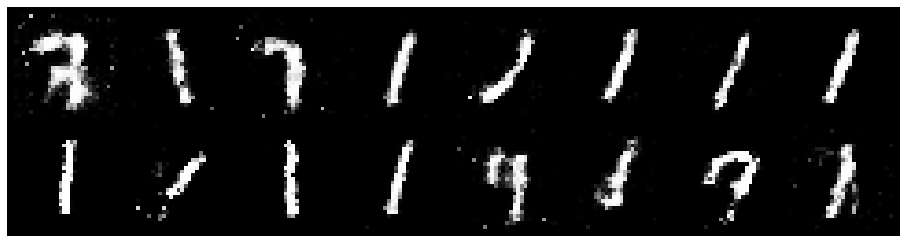

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 0.7010, Generator Loss: 1.7246
D(x): 0.7694, D(G(z)): 0.2025


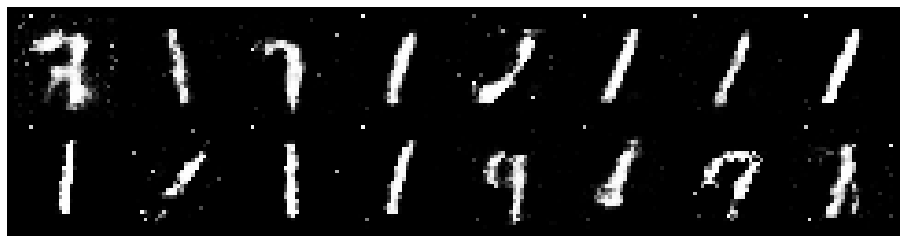

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 0.6282, Generator Loss: 2.3928
D(x): 0.7646, D(G(z)): 0.1013


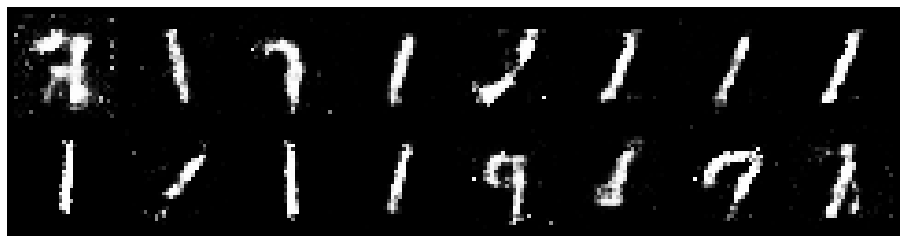

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 0.5589, Generator Loss: 2.1384
D(x): 0.8516, D(G(z)): 0.2075


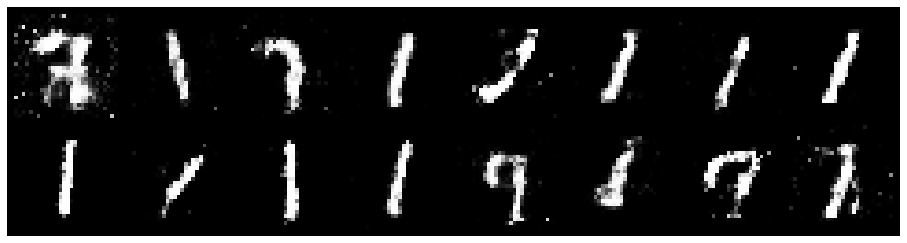

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 0.8114, Generator Loss: 2.4267
D(x): 0.7994, D(G(z)): 0.2331


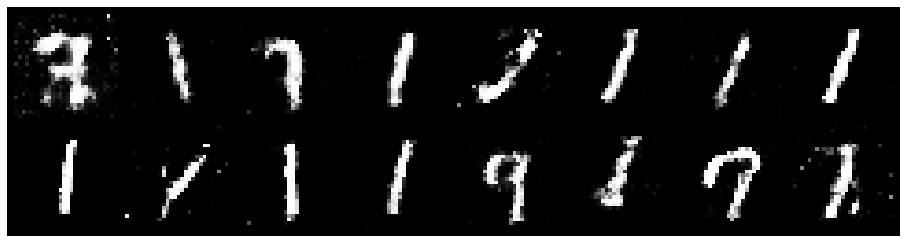

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 0.6330, Generator Loss: 2.0215
D(x): 0.7965, D(G(z)): 0.1732


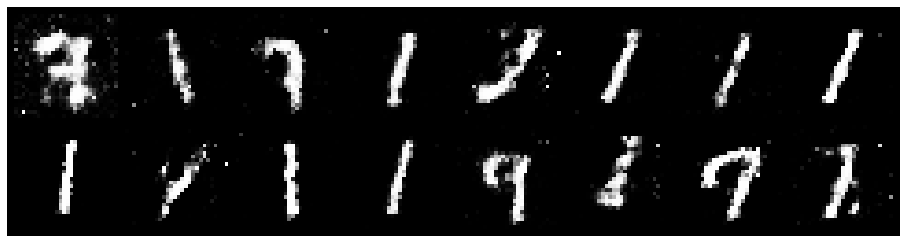

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 0.4534, Generator Loss: 2.6919
D(x): 0.8341, D(G(z)): 0.1066


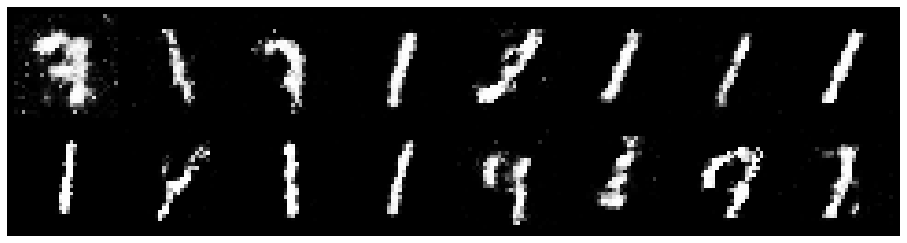

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 0.4240, Generator Loss: 2.8087
D(x): 0.8493, D(G(z)): 0.1328


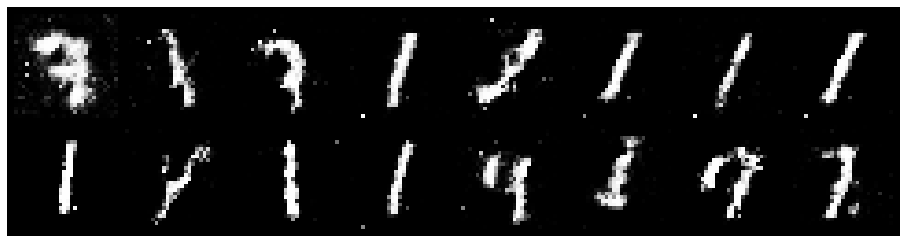

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 0.4746, Generator Loss: 2.2183
D(x): 0.8399, D(G(z)): 0.1535


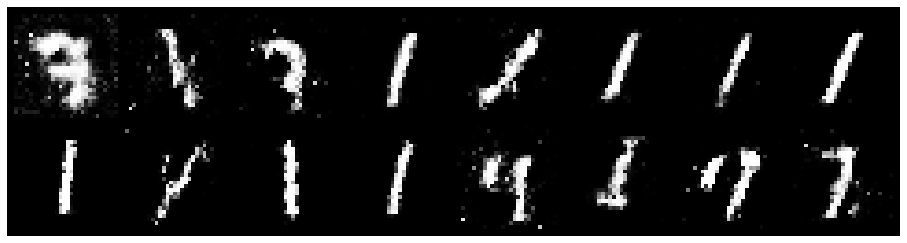

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 0.4357, Generator Loss: 2.1643
D(x): 0.8981, D(G(z)): 0.2044


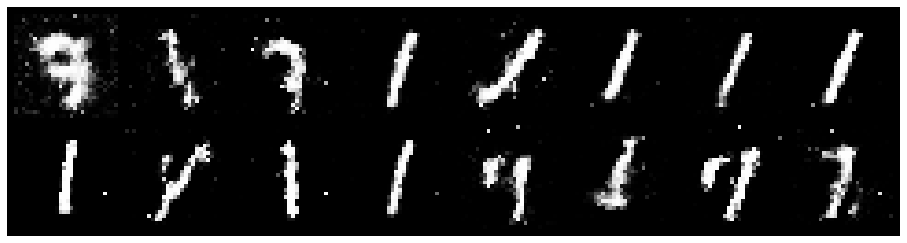

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 0.5557, Generator Loss: 2.0529
D(x): 0.8007, D(G(z)): 0.1382


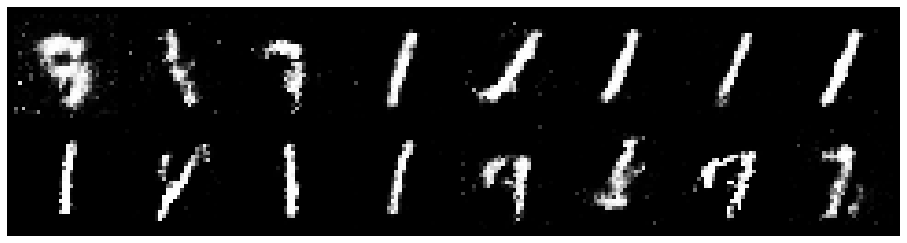

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 0.4400, Generator Loss: 2.0983
D(x): 0.8455, D(G(z)): 0.1183


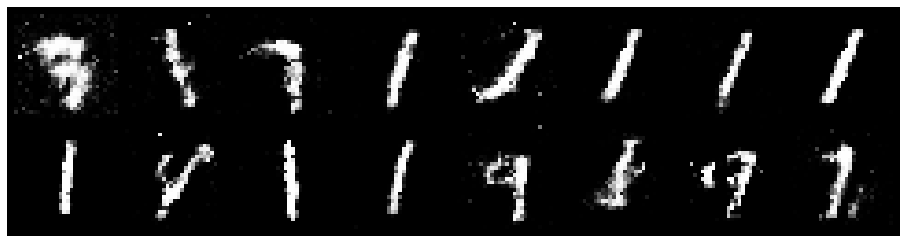

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 0.6016, Generator Loss: 2.4162
D(x): 0.7961, D(G(z)): 0.1384


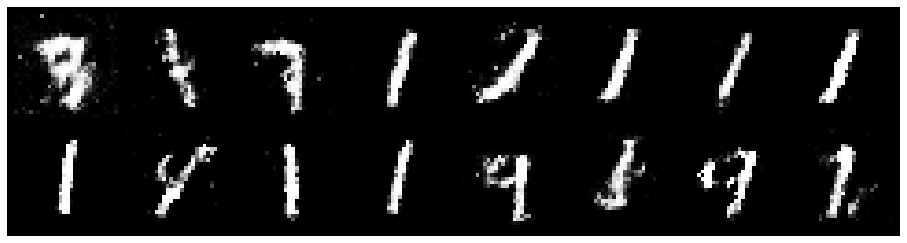

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 0.4773, Generator Loss: 2.0459
D(x): 0.8413, D(G(z)): 0.1547


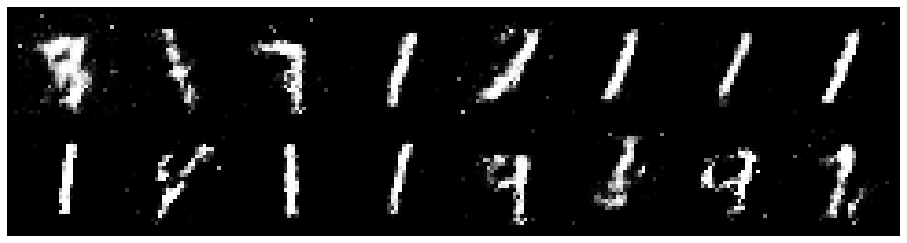

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 0.4748, Generator Loss: 2.0845
D(x): 0.8290, D(G(z)): 0.1572


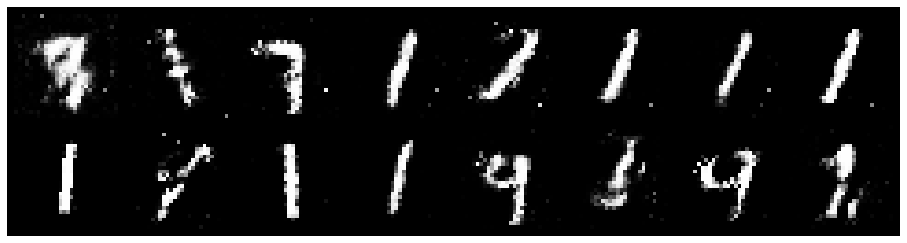

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 0.6516, Generator Loss: 2.3155
D(x): 0.7917, D(G(z)): 0.1332


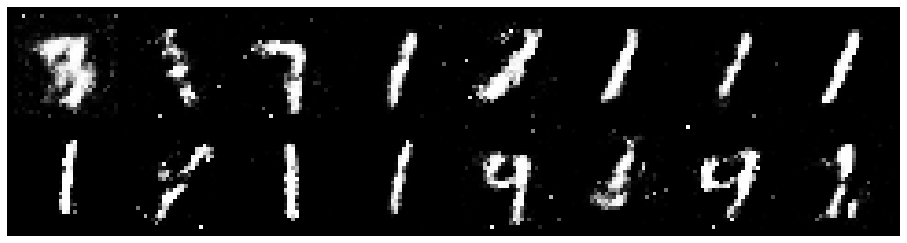

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 0.6605, Generator Loss: 2.3321
D(x): 0.8064, D(G(z)): 0.1720


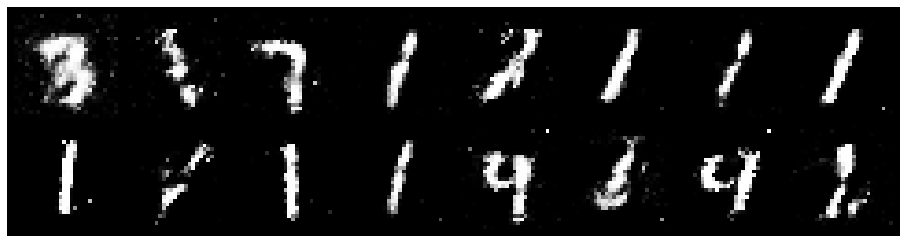

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 0.6477, Generator Loss: 2.2029
D(x): 0.7908, D(G(z)): 0.1888


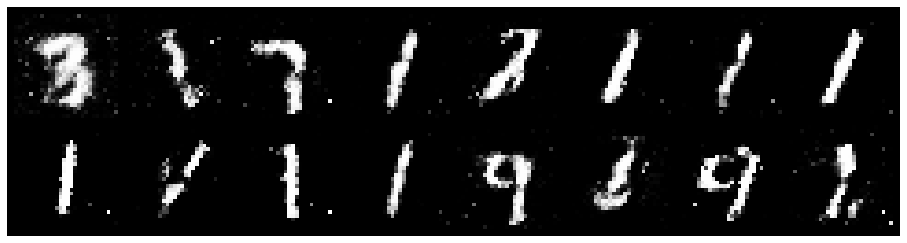

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 0.6524, Generator Loss: 2.0272
D(x): 0.7853, D(G(z)): 0.1873


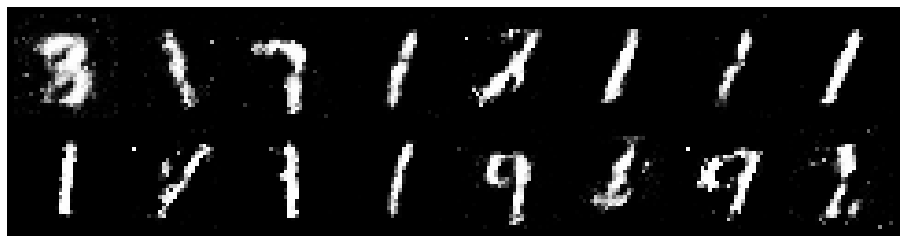

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 0.4599, Generator Loss: 2.3293
D(x): 0.8946, D(G(z)): 0.2024


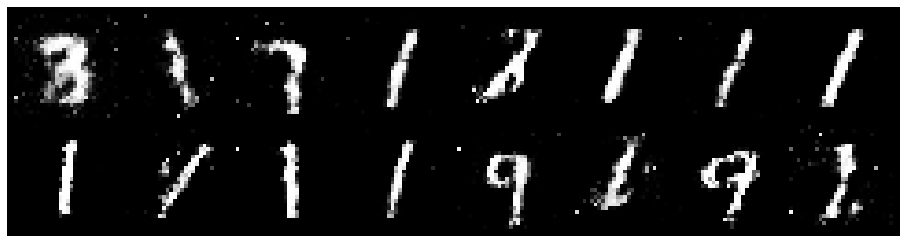

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 0.6570, Generator Loss: 1.6797
D(x): 0.8376, D(G(z)): 0.2612


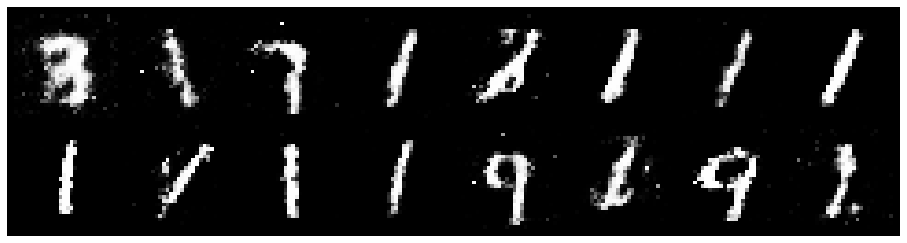

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 0.6423, Generator Loss: 1.7956
D(x): 0.8207, D(G(z)): 0.1894


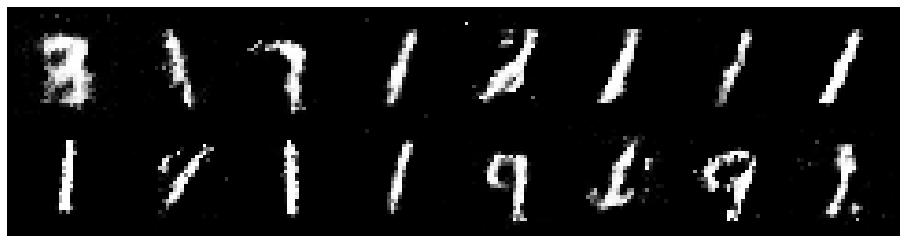

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 0.6345, Generator Loss: 2.1875
D(x): 0.8105, D(G(z)): 0.1823


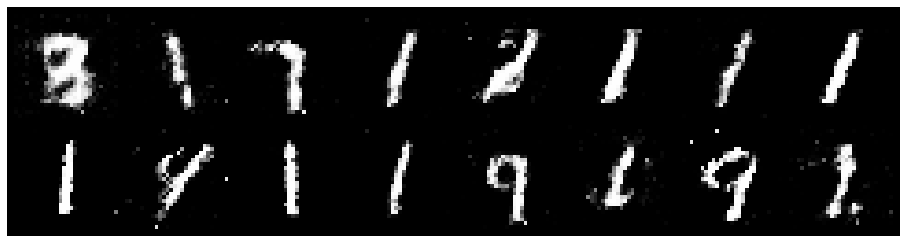

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 0.5298, Generator Loss: 2.2834
D(x): 0.8311, D(G(z)): 0.1613


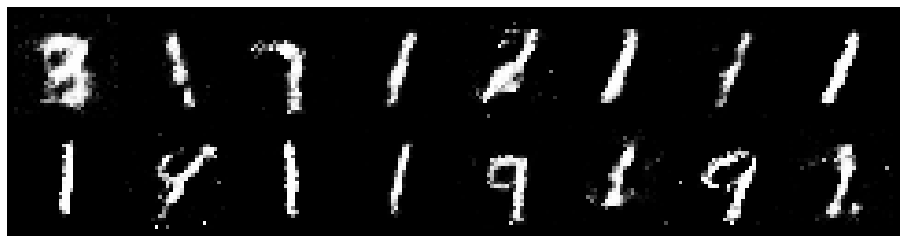

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 0.6135, Generator Loss: 2.3623
D(x): 0.7980, D(G(z)): 0.1759


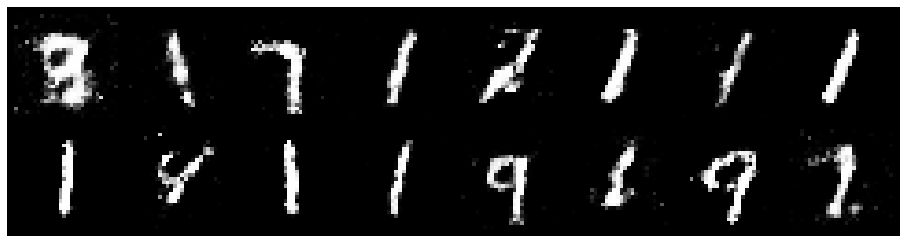

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 0.4721, Generator Loss: 2.1762
D(x): 0.8602, D(G(z)): 0.1457


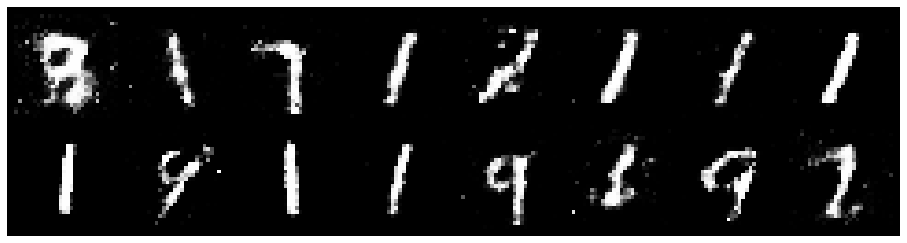

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 0.5365, Generator Loss: 2.1271
D(x): 0.8043, D(G(z)): 0.1488


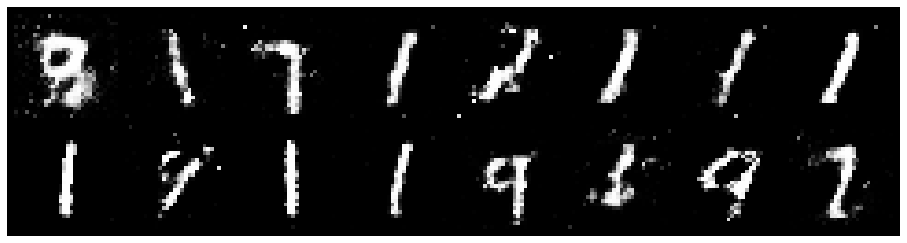

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 0.5531, Generator Loss: 2.2446
D(x): 0.8080, D(G(z)): 0.1553


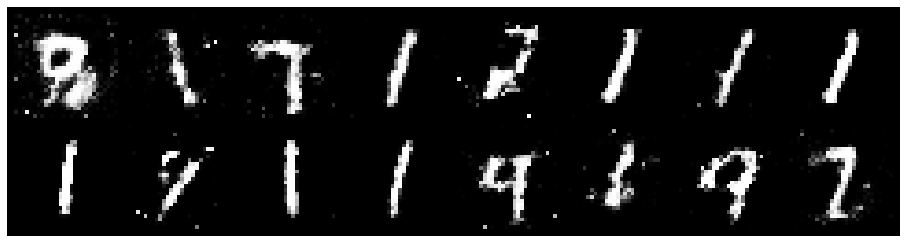

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 0.5859, Generator Loss: 2.1438
D(x): 0.8178, D(G(z)): 0.1768


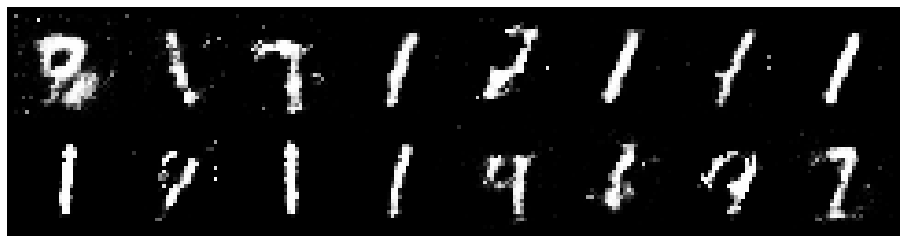

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 0.6241, Generator Loss: 1.3867
D(x): 0.8924, D(G(z)): 0.2999


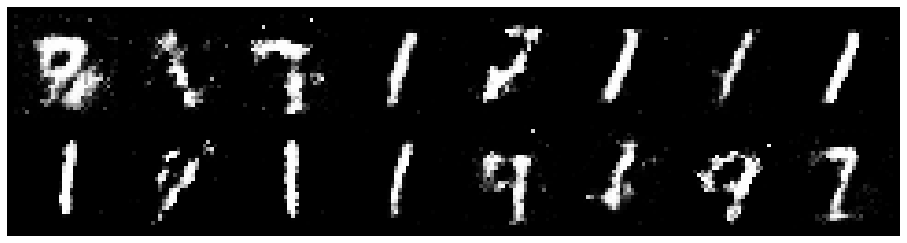

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 0.4255, Generator Loss: 2.1888
D(x): 0.8502, D(G(z)): 0.1428


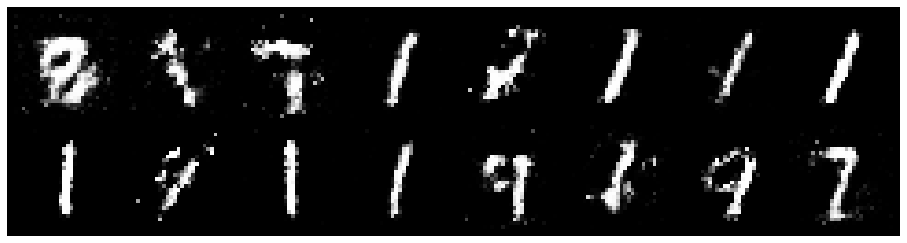

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 0.5353, Generator Loss: 2.2020
D(x): 0.8358, D(G(z)): 0.1811


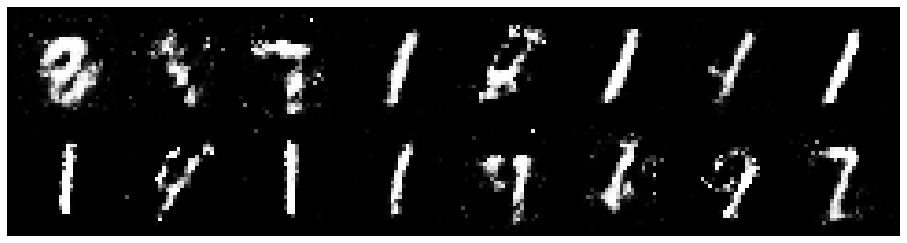

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 0.5044, Generator Loss: 2.4000
D(x): 0.8369, D(G(z)): 0.1745


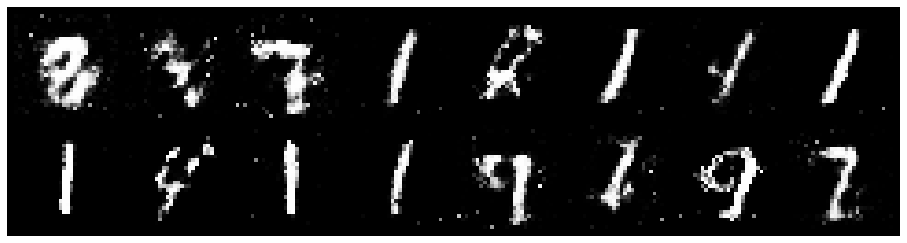

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 0.6225, Generator Loss: 1.9379
D(x): 0.8376, D(G(z)): 0.2774


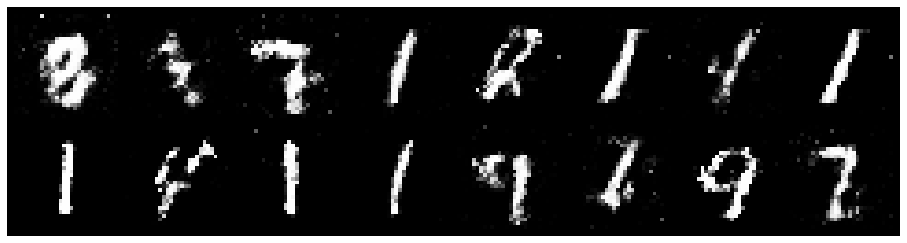

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 0.5331, Generator Loss: 2.3832
D(x): 0.8324, D(G(z)): 0.1582


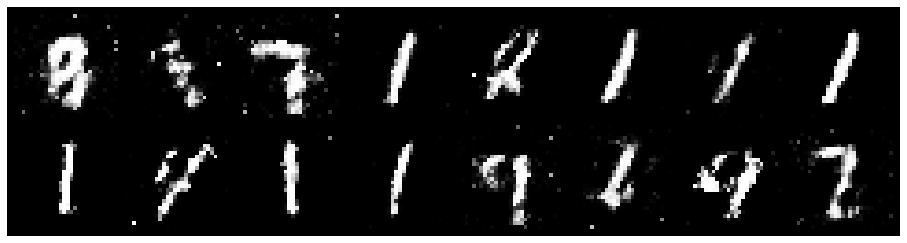

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 0.5538, Generator Loss: 1.9120
D(x): 0.8092, D(G(z)): 0.1771


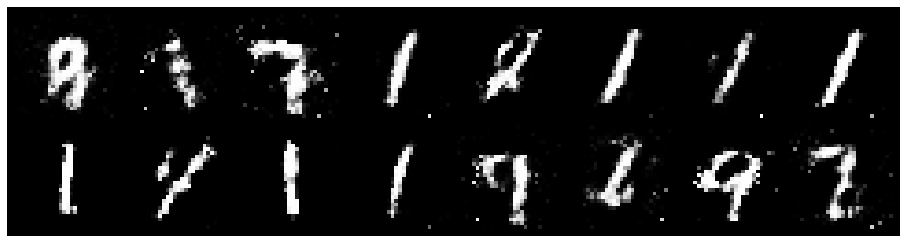

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 0.6249, Generator Loss: 2.0476
D(x): 0.7899, D(G(z)): 0.1783


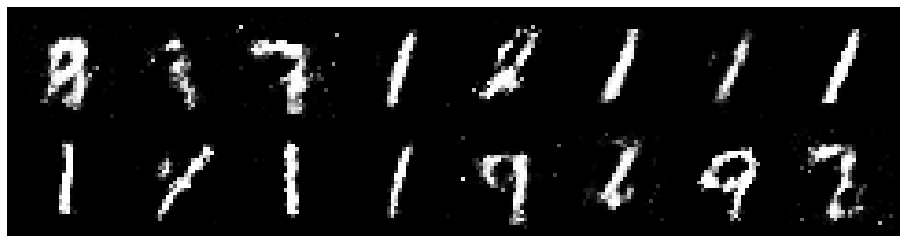

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 0.6911, Generator Loss: 2.2218
D(x): 0.8398, D(G(z)): 0.2402


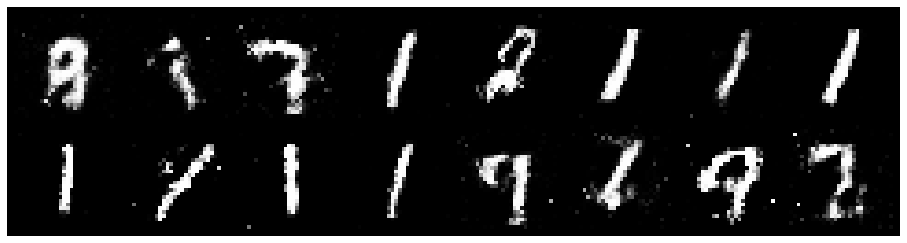

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 0.6207, Generator Loss: 2.1444
D(x): 0.7420, D(G(z)): 0.1280


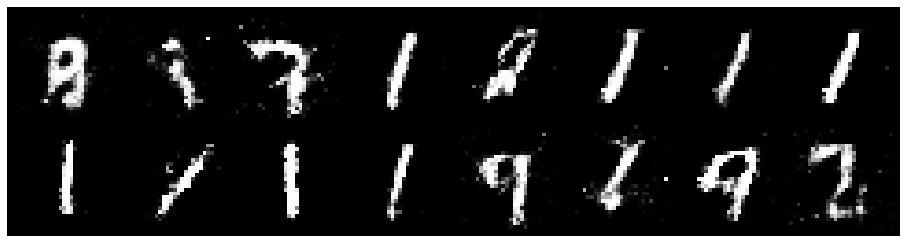

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 0.5747, Generator Loss: 2.4311
D(x): 0.8122, D(G(z)): 0.1644


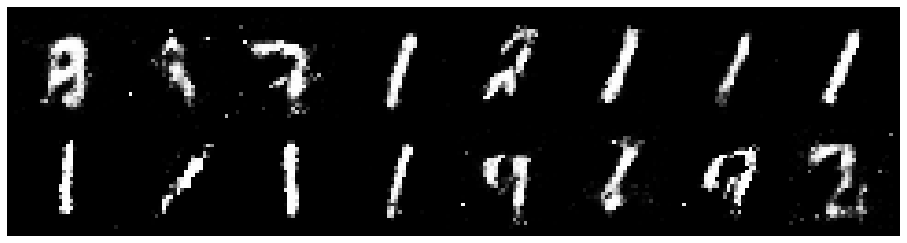

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 0.5929, Generator Loss: 2.2477
D(x): 0.8466, D(G(z)): 0.2265


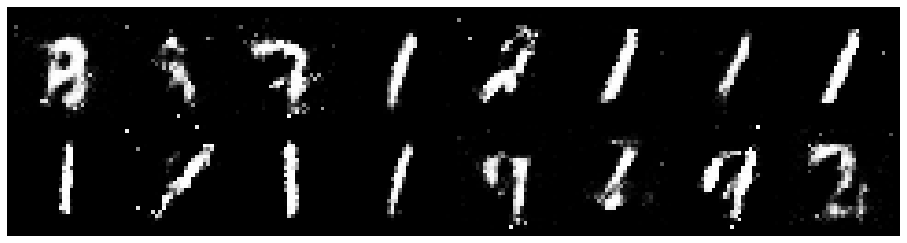

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 0.6315, Generator Loss: 2.0470
D(x): 0.8308, D(G(z)): 0.2114


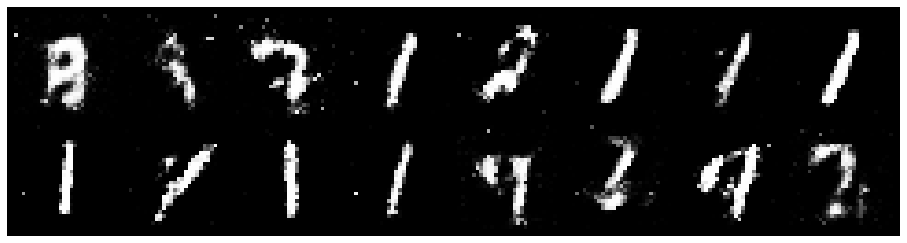

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 0.6664, Generator Loss: 1.8710
D(x): 0.8635, D(G(z)): 0.2629


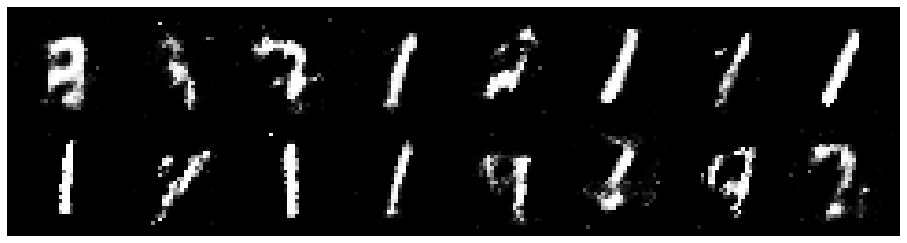

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 0.6418, Generator Loss: 2.1939
D(x): 0.8179, D(G(z)): 0.2059


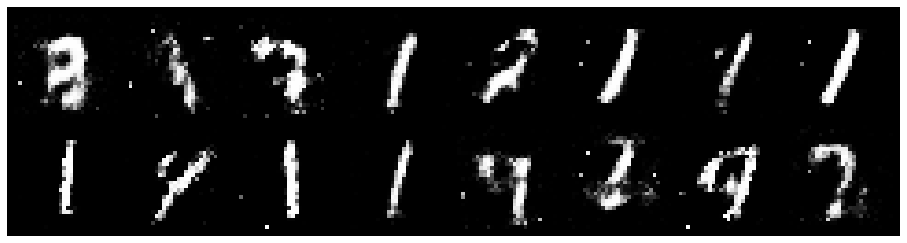

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 0.5112, Generator Loss: 2.2451
D(x): 0.8214, D(G(z)): 0.1269


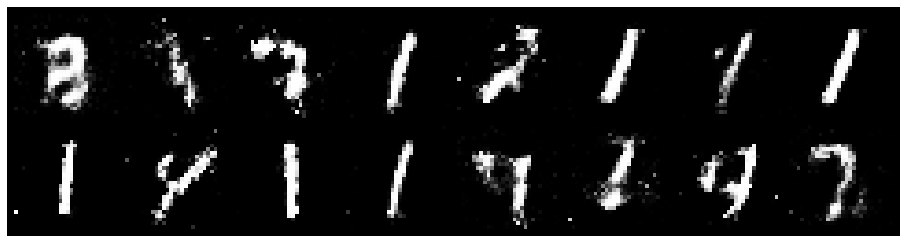

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 0.5236, Generator Loss: 2.0581
D(x): 0.8521, D(G(z)): 0.1912


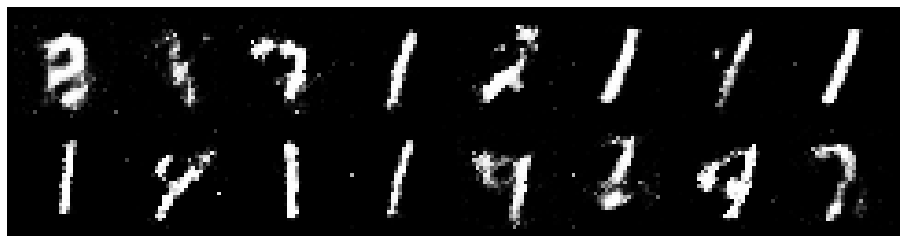

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 0.5140, Generator Loss: 1.8361
D(x): 0.8425, D(G(z)): 0.1962


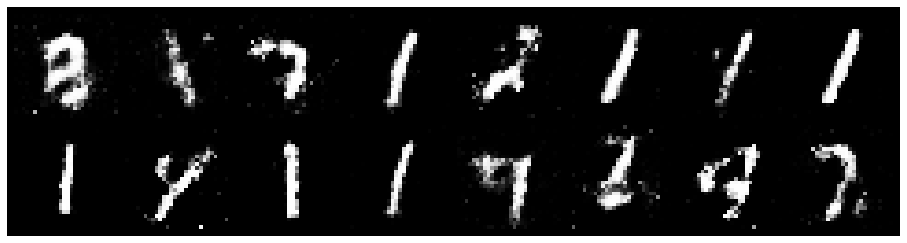

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 0.5808, Generator Loss: 1.6541
D(x): 0.8181, D(G(z)): 0.1860


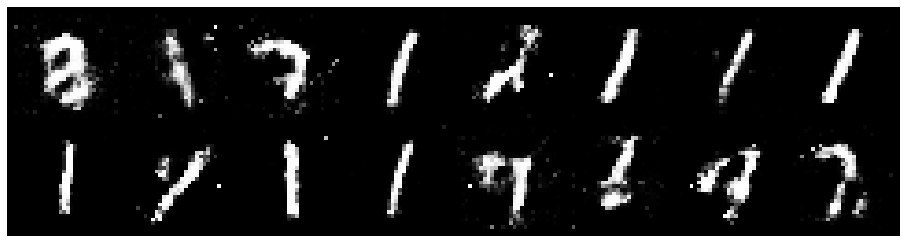

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 0.6334, Generator Loss: 1.6354
D(x): 0.8269, D(G(z)): 0.2397


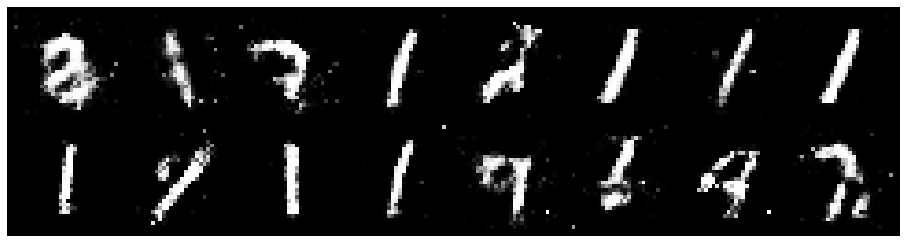

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 0.7144, Generator Loss: 1.9048
D(x): 0.8123, D(G(z)): 0.2369


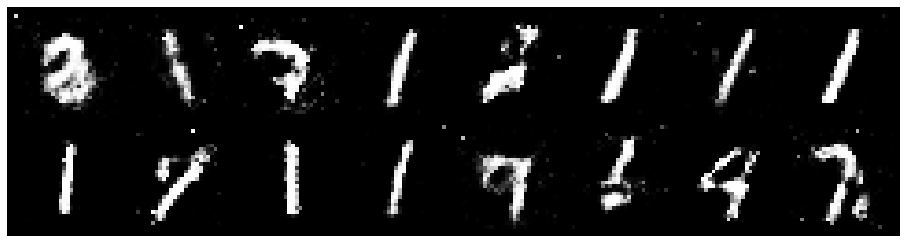

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 0.7586, Generator Loss: 1.7709
D(x): 0.8480, D(G(z)): 0.2983


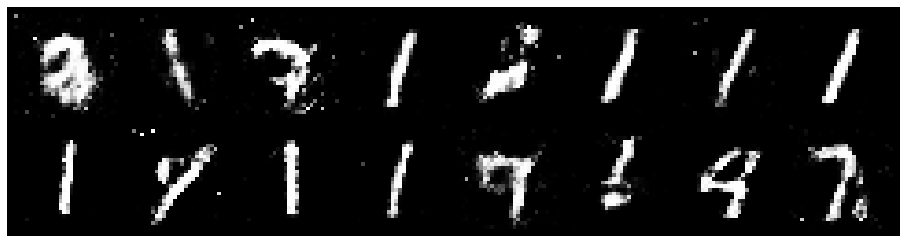

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 0.5093, Generator Loss: 2.1713
D(x): 0.8427, D(G(z)): 0.1760


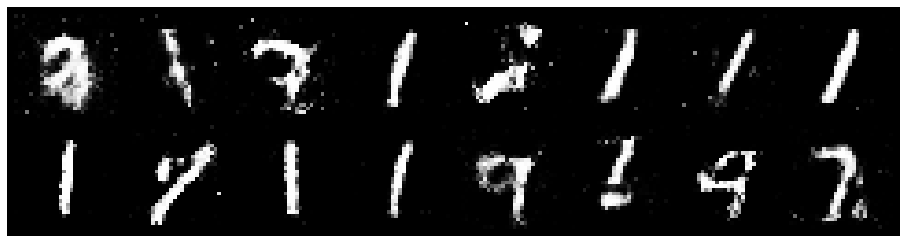

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 0.6050, Generator Loss: 1.7203
D(x): 0.7838, D(G(z)): 0.1926


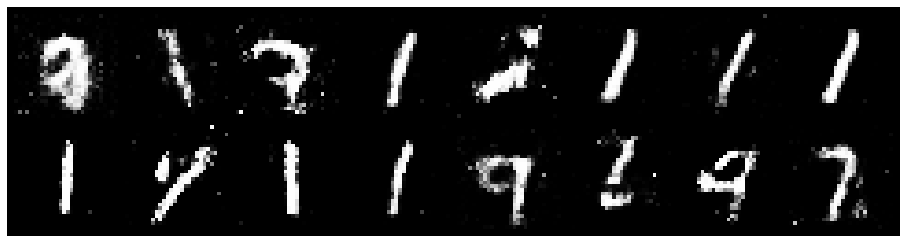

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 0.5496, Generator Loss: 1.9656
D(x): 0.8072, D(G(z)): 0.1739


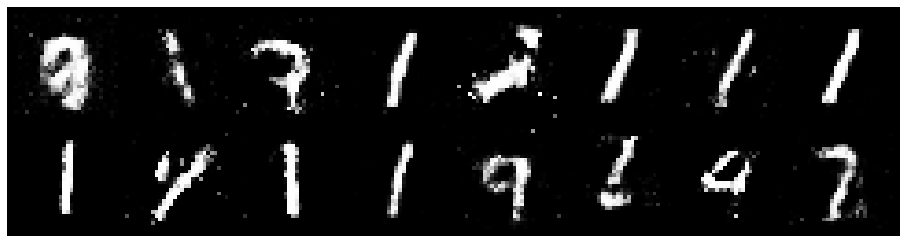

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 0.7957, Generator Loss: 1.5679
D(x): 0.8065, D(G(z)): 0.3234


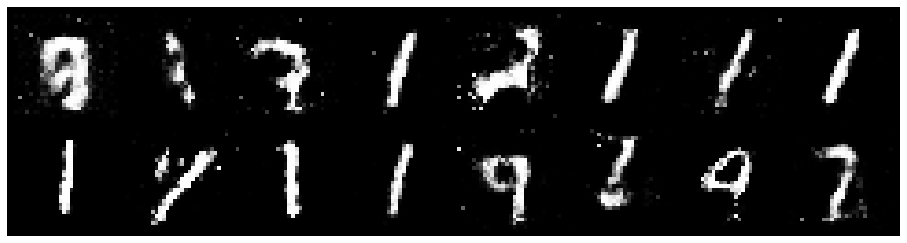

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 0.7135, Generator Loss: 1.6064
D(x): 0.8015, D(G(z)): 0.2568


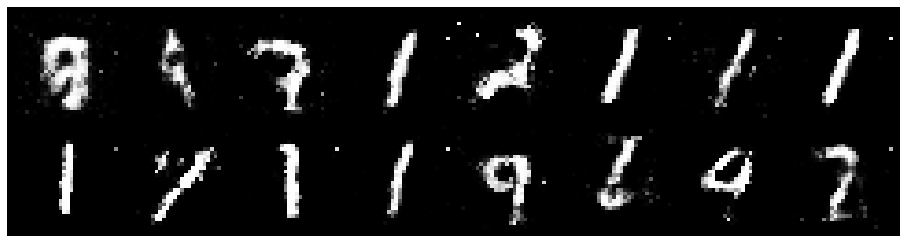

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 0.7758, Generator Loss: 1.5925
D(x): 0.8191, D(G(z)): 0.2795


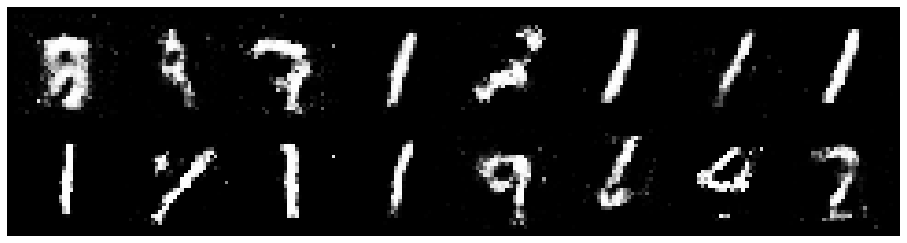

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 0.9707, Generator Loss: 2.0702
D(x): 0.7157, D(G(z)): 0.2693


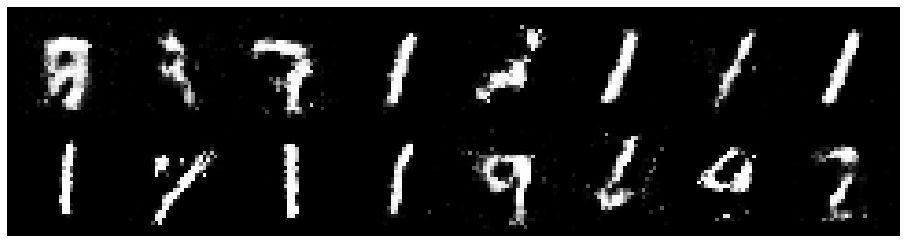

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 0.5854, Generator Loss: 2.2593
D(x): 0.7784, D(G(z)): 0.1353


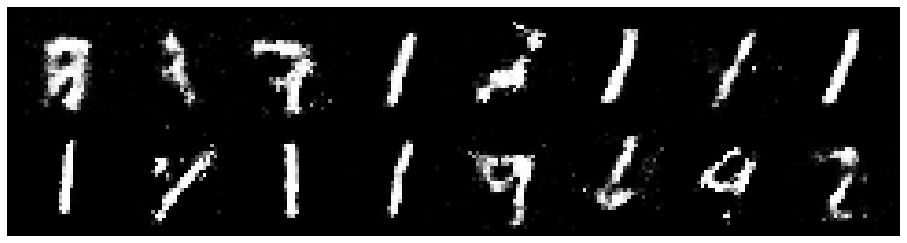

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 0.5299, Generator Loss: 2.4229
D(x): 0.8311, D(G(z)): 0.1552


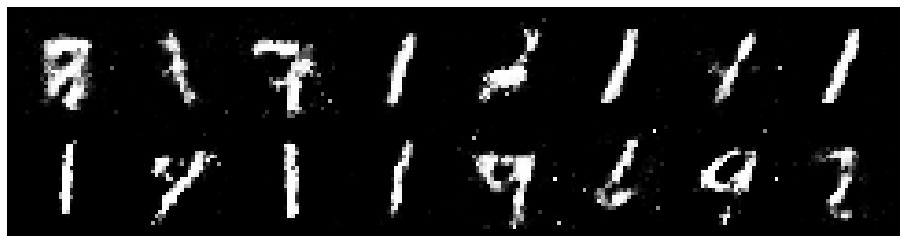

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 0.5877, Generator Loss: 2.0189
D(x): 0.8306, D(G(z)): 0.1734


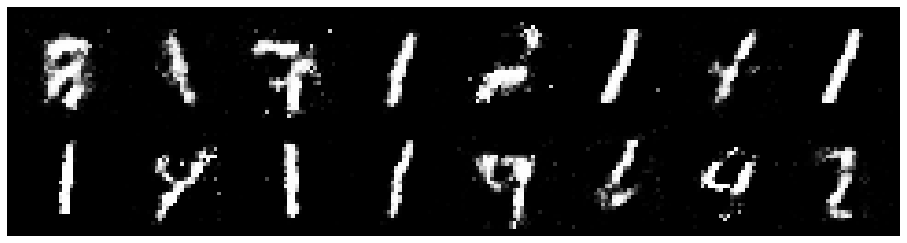

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 0.6240, Generator Loss: 1.9489
D(x): 0.8057, D(G(z)): 0.1788


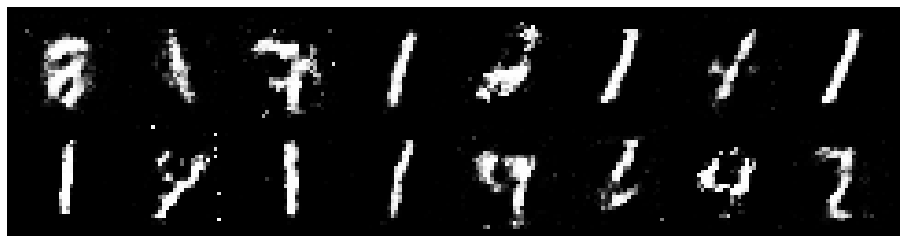

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 0.6170, Generator Loss: 1.7515
D(x): 0.8558, D(G(z)): 0.2356


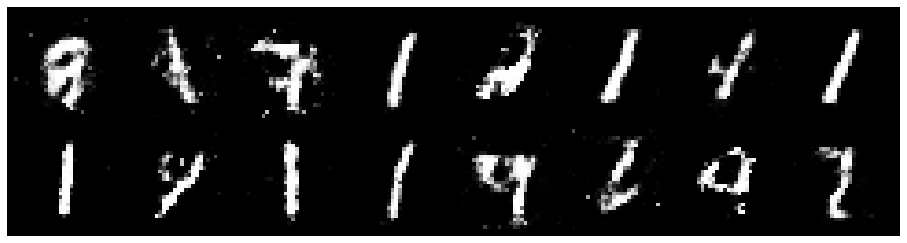

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 0.7395, Generator Loss: 1.5354
D(x): 0.7805, D(G(z)): 0.2467


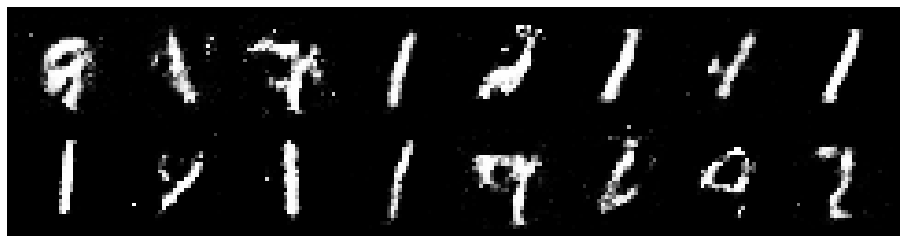

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 0.8061, Generator Loss: 1.8206
D(x): 0.7153, D(G(z)): 0.1873


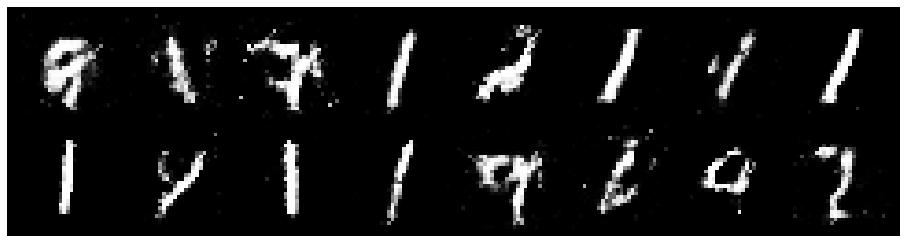

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 0.8177, Generator Loss: 1.7171
D(x): 0.7755, D(G(z)): 0.2511


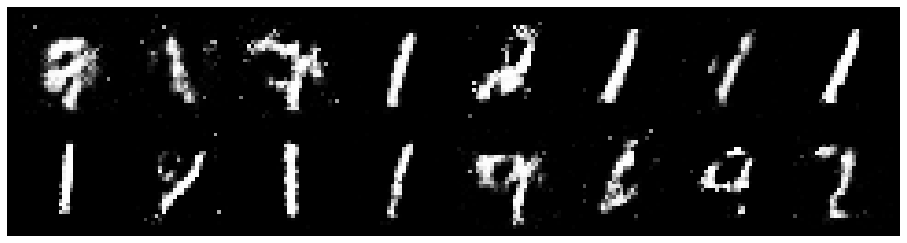

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 0.6253, Generator Loss: 1.9954
D(x): 0.7753, D(G(z)): 0.1947


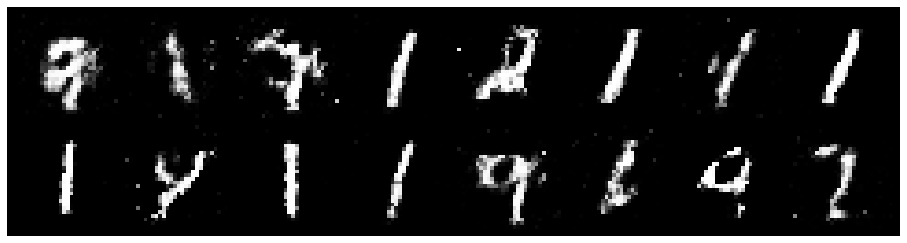

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 0.7283, Generator Loss: 2.0087
D(x): 0.7936, D(G(z)): 0.2364


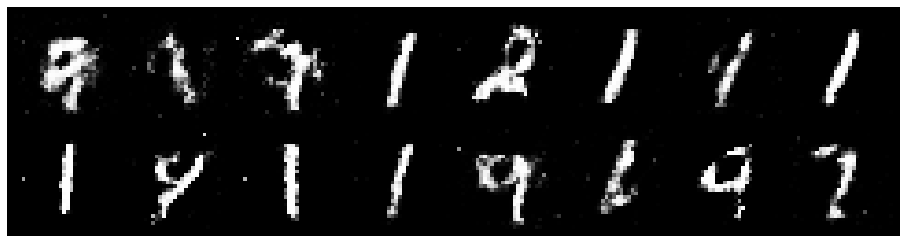

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 0.5611, Generator Loss: 2.3822
D(x): 0.8408, D(G(z)): 0.2058


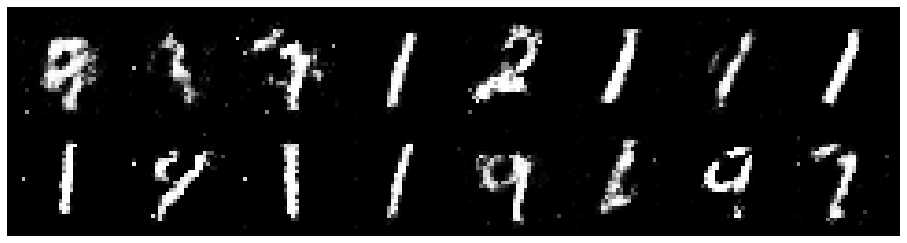

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 0.5927, Generator Loss: 2.2890
D(x): 0.8107, D(G(z)): 0.1905


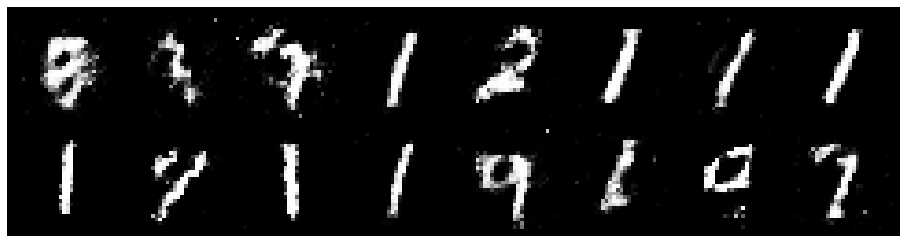

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 0.5958, Generator Loss: 2.2706
D(x): 0.8253, D(G(z)): 0.1764


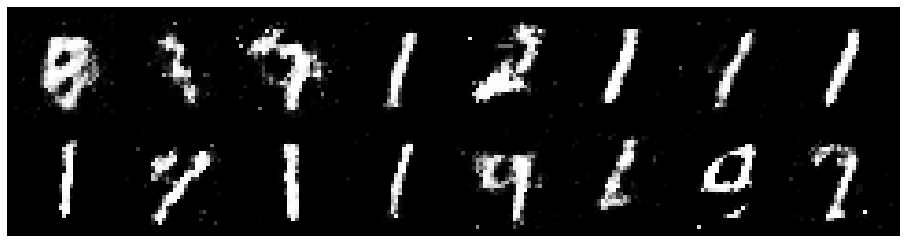

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 0.5659, Generator Loss: 1.6243
D(x): 0.8591, D(G(z)): 0.2323


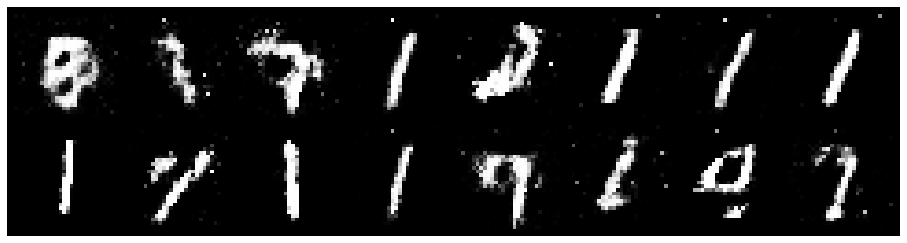

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 0.5939, Generator Loss: 2.2378
D(x): 0.8185, D(G(z)): 0.1856


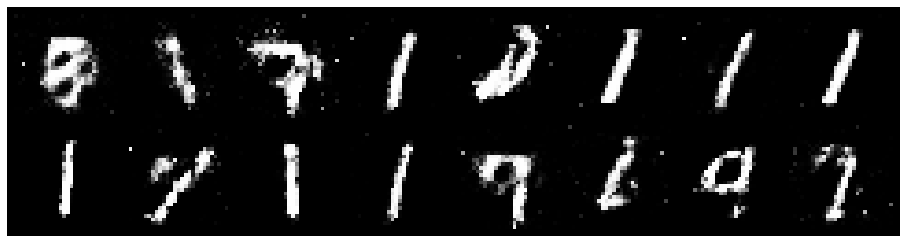

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 0.5772, Generator Loss: 2.0162
D(x): 0.8404, D(G(z)): 0.1886


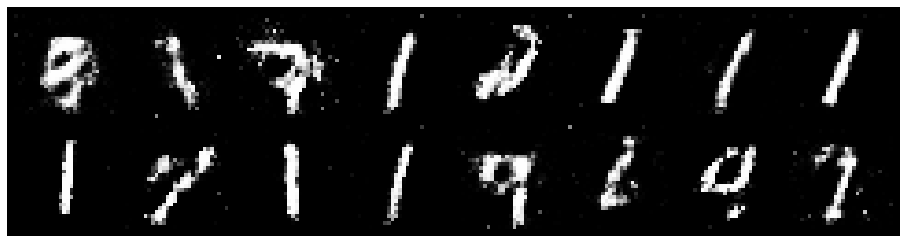

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 0.5741, Generator Loss: 2.0037
D(x): 0.8475, D(G(z)): 0.2241


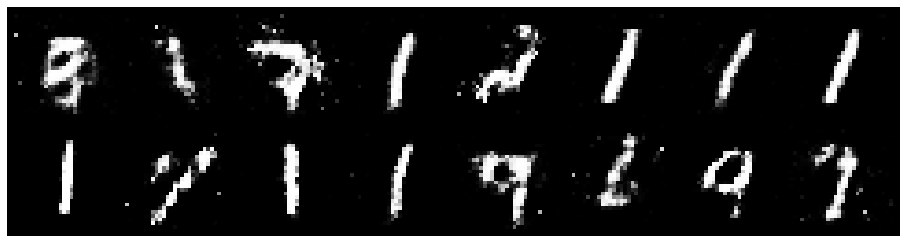

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 0.5795, Generator Loss: 1.6415
D(x): 0.8504, D(G(z)): 0.2250


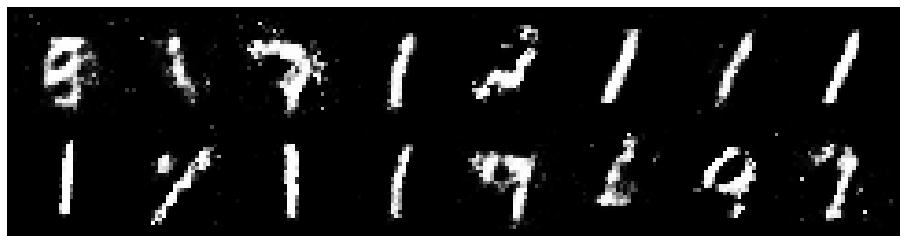

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 0.8830, Generator Loss: 1.8874
D(x): 0.7723, D(G(z)): 0.2443


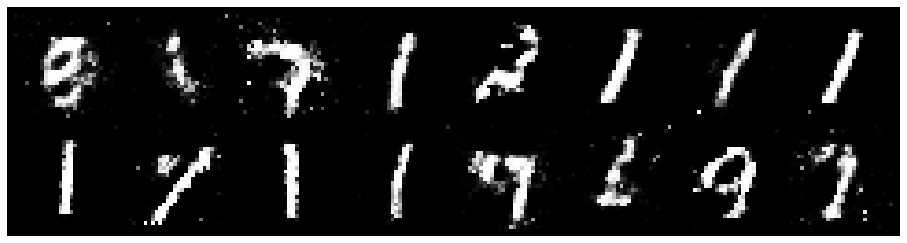

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 0.6768, Generator Loss: 2.2046
D(x): 0.7577, D(G(z)): 0.1628


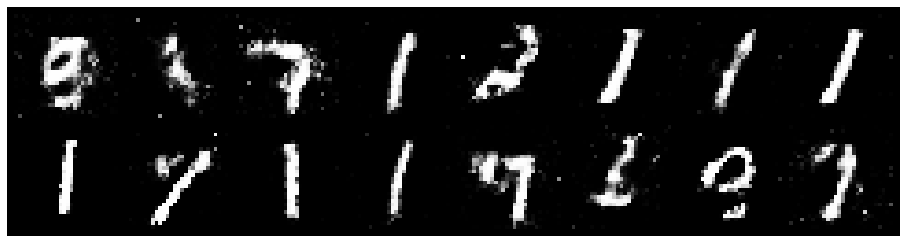

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 0.6878, Generator Loss: 1.9210
D(x): 0.7837, D(G(z)): 0.2094


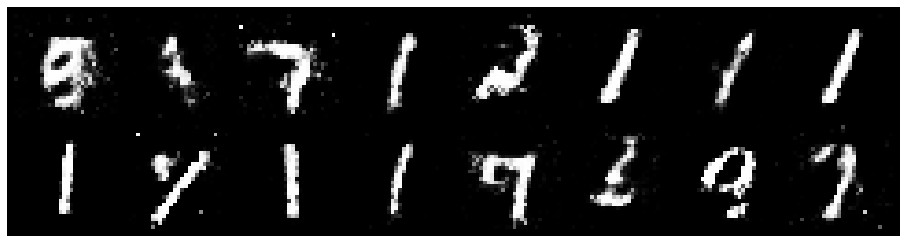

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 0.7245, Generator Loss: 2.0495
D(x): 0.8012, D(G(z)): 0.2541


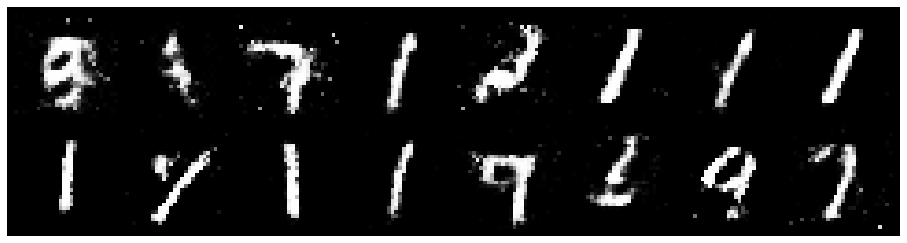

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 0.6858, Generator Loss: 1.9582
D(x): 0.7733, D(G(z)): 0.2121


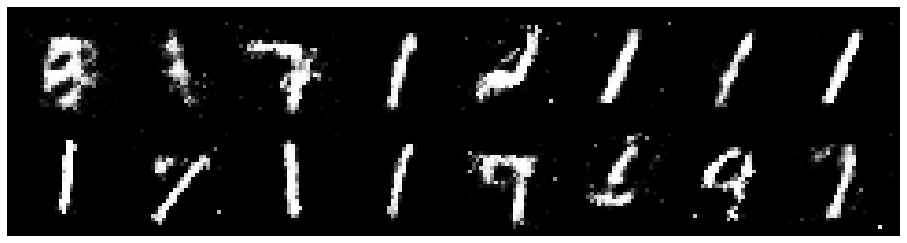

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 0.7561, Generator Loss: 2.4063
D(x): 0.7412, D(G(z)): 0.1858


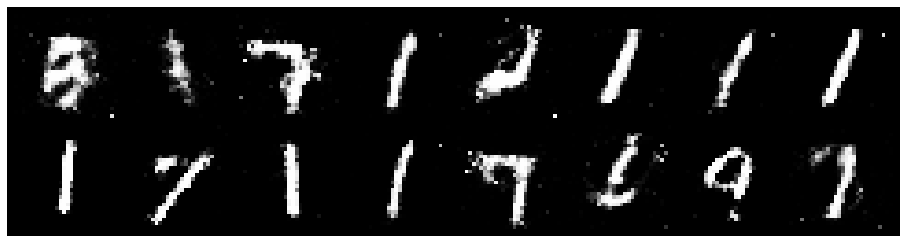

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 0.5925, Generator Loss: 1.9720
D(x): 0.8205, D(G(z)): 0.1994


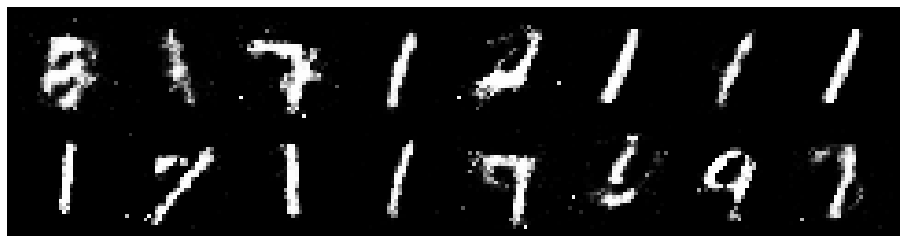

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 0.8970, Generator Loss: 1.9144
D(x): 0.7117, D(G(z)): 0.2131


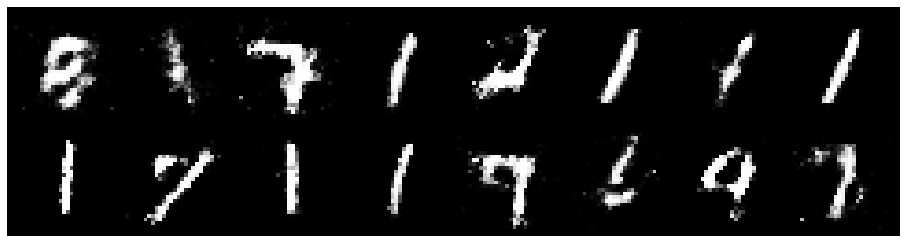

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 0.7252, Generator Loss: 1.7527
D(x): 0.7733, D(G(z)): 0.2418


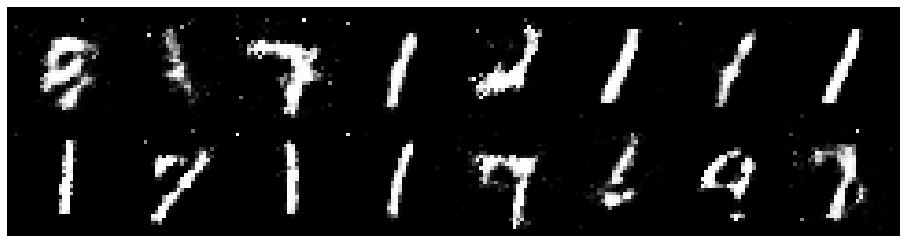

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 0.6437, Generator Loss: 1.9329
D(x): 0.7765, D(G(z)): 0.2036


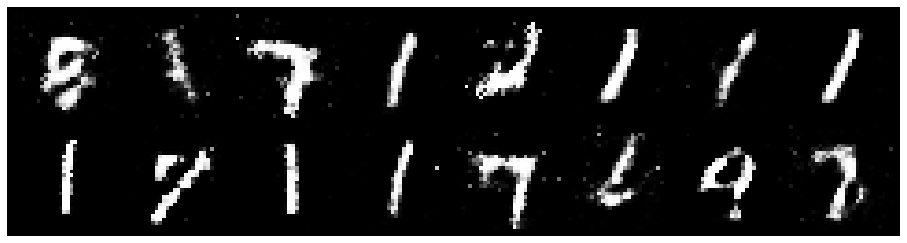

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 0.6408, Generator Loss: 1.8349
D(x): 0.7810, D(G(z)): 0.1882


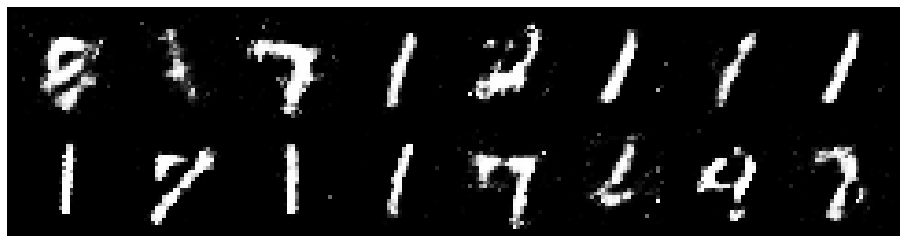

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 0.5872, Generator Loss: 1.5909
D(x): 0.8146, D(G(z)): 0.2119


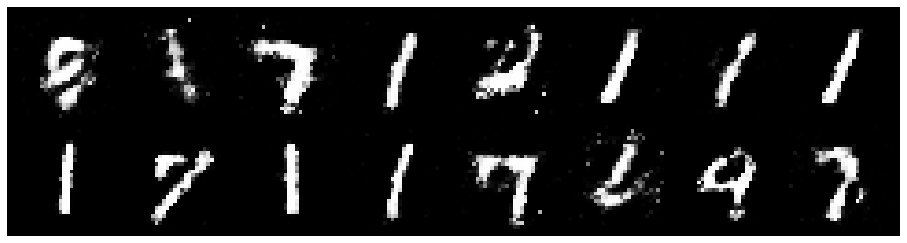

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 0.7080, Generator Loss: 1.5544
D(x): 0.8050, D(G(z)): 0.2821


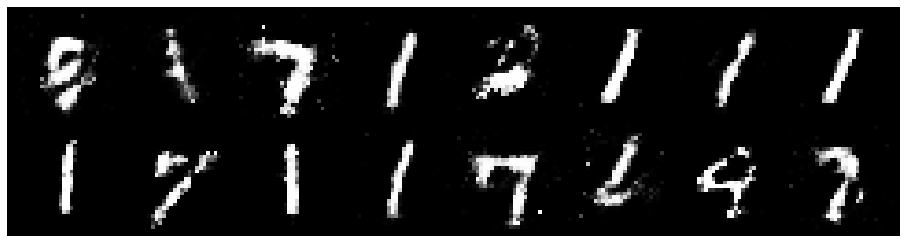

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 0.7686, Generator Loss: 1.5984
D(x): 0.7292, D(G(z)): 0.2254


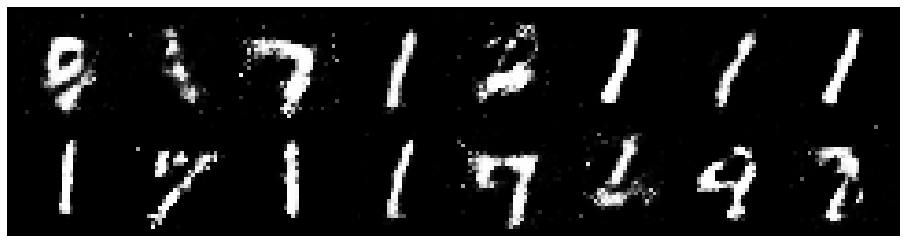

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 0.7637, Generator Loss: 1.6463
D(x): 0.8201, D(G(z)): 0.2938


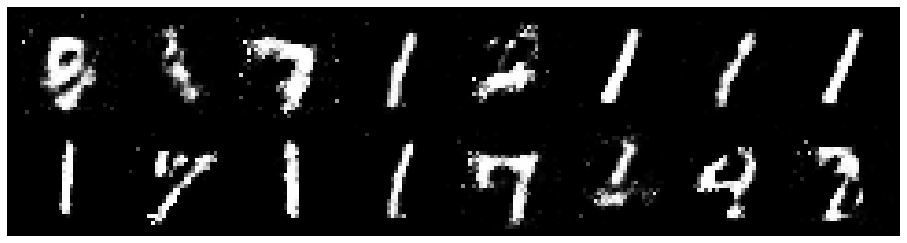

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 0.7308, Generator Loss: 1.7906
D(x): 0.7594, D(G(z)): 0.2141


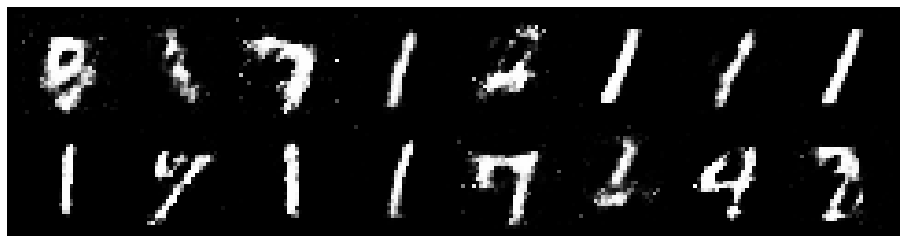

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 0.7675, Generator Loss: 1.9591
D(x): 0.6851, D(G(z)): 0.1592


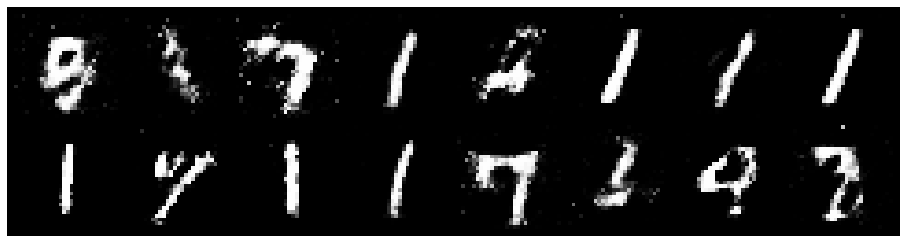

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 0.6777, Generator Loss: 1.9928
D(x): 0.7538, D(G(z)): 0.2232


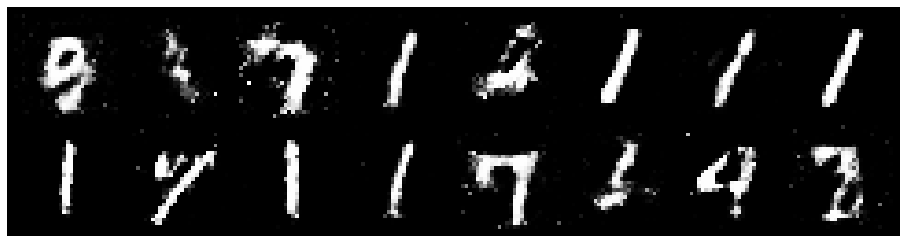

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 0.6154, Generator Loss: 2.1847
D(x): 0.7858, D(G(z)): 0.1749


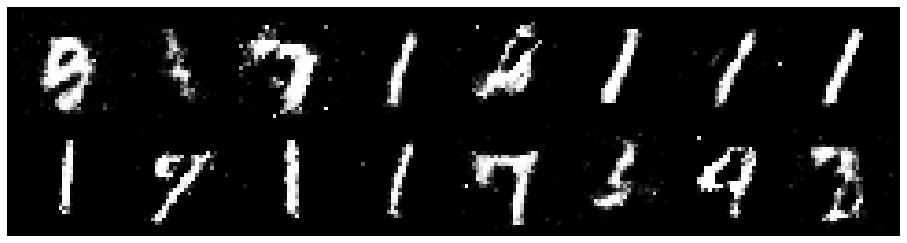

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 0.6649, Generator Loss: 2.3317
D(x): 0.7586, D(G(z)): 0.1711


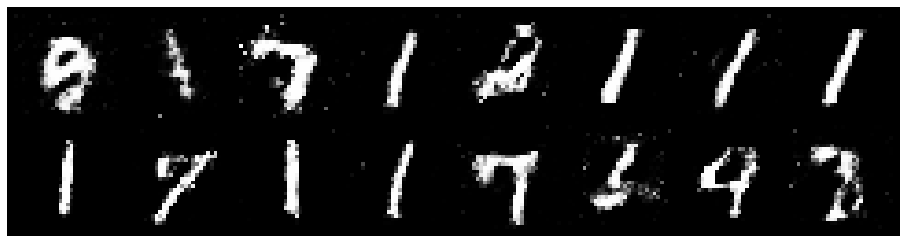

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 0.4748, Generator Loss: 2.5671
D(x): 0.8426, D(G(z)): 0.1456


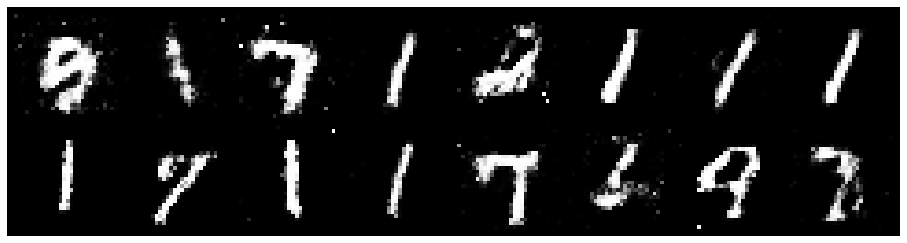

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 0.4716, Generator Loss: 2.2418
D(x): 0.8389, D(G(z)): 0.1583


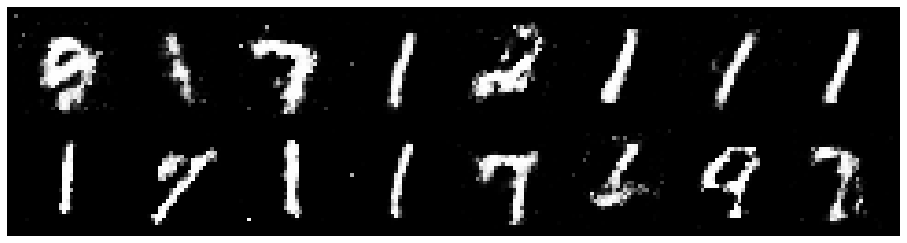

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 0.5529, Generator Loss: 2.0563
D(x): 0.8769, D(G(z)): 0.2431


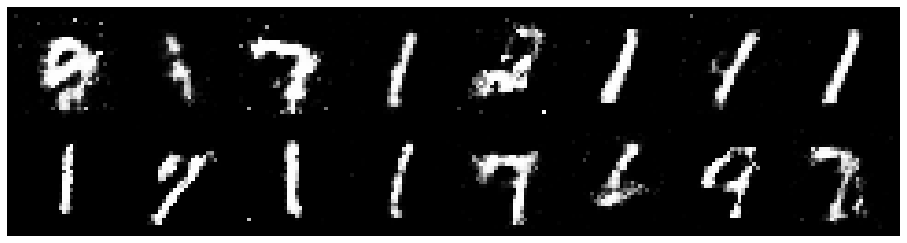

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 0.6384, Generator Loss: 1.7469
D(x): 0.7797, D(G(z)): 0.1931


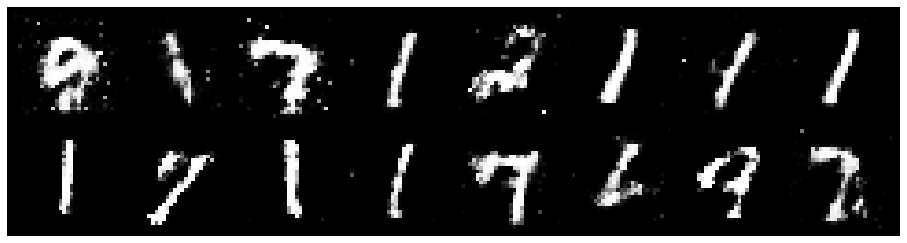

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 0.7410, Generator Loss: 1.7899
D(x): 0.7617, D(G(z)): 0.2393


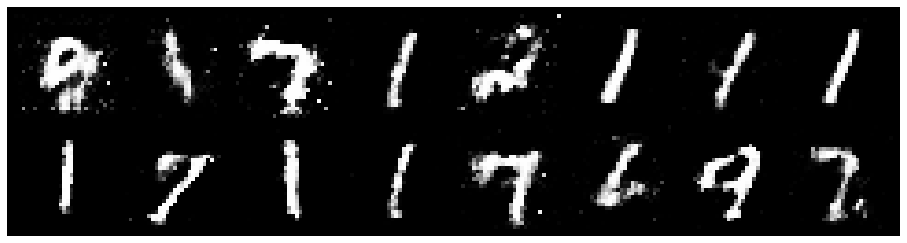

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 0.8081, Generator Loss: 1.3949
D(x): 0.8041, D(G(z)): 0.3014


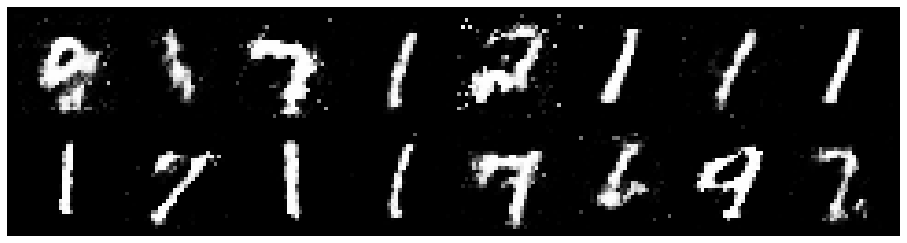

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 0.8149, Generator Loss: 1.7687
D(x): 0.7361, D(G(z)): 0.2494


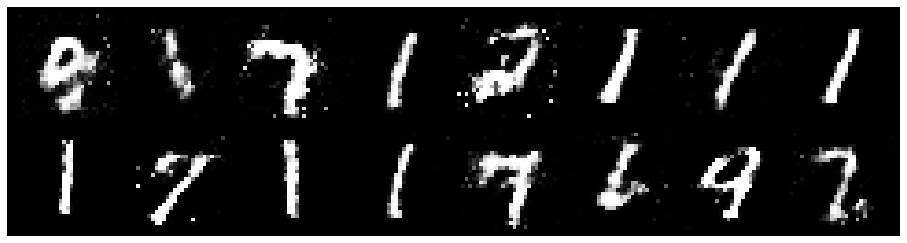

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 0.7755, Generator Loss: 1.8013
D(x): 0.7903, D(G(z)): 0.2551


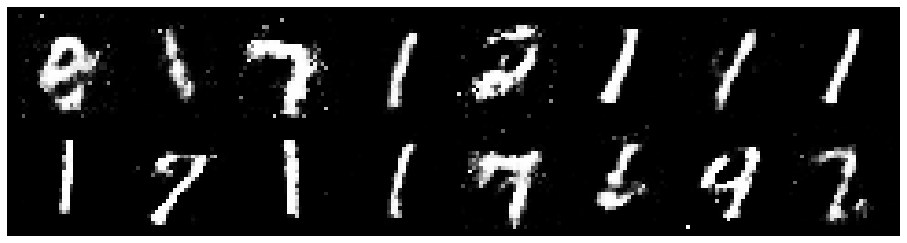

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 0.7127, Generator Loss: 1.6940
D(x): 0.7855, D(G(z)): 0.2494


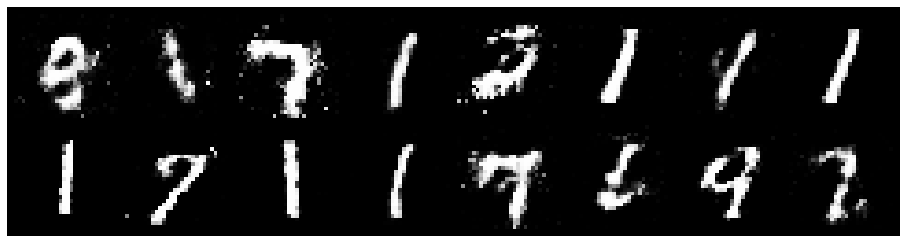

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 0.8097, Generator Loss: 2.0465
D(x): 0.6668, D(G(z)): 0.1762


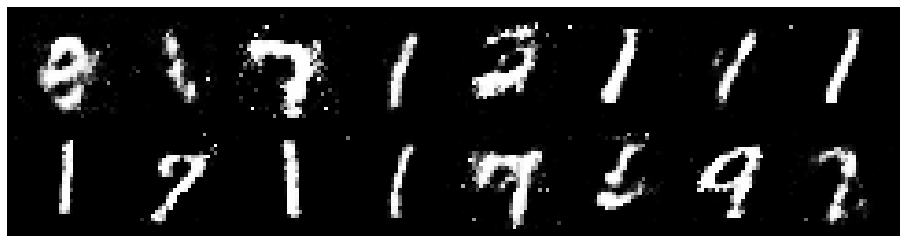

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 0.9359, Generator Loss: 1.7534
D(x): 0.7198, D(G(z)): 0.2874


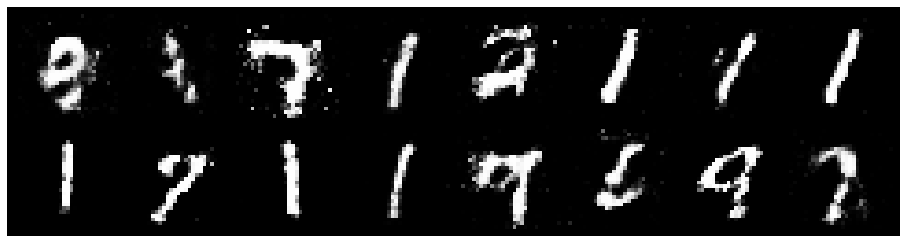

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 0.9408, Generator Loss: 1.7518
D(x): 0.7173, D(G(z)): 0.2942


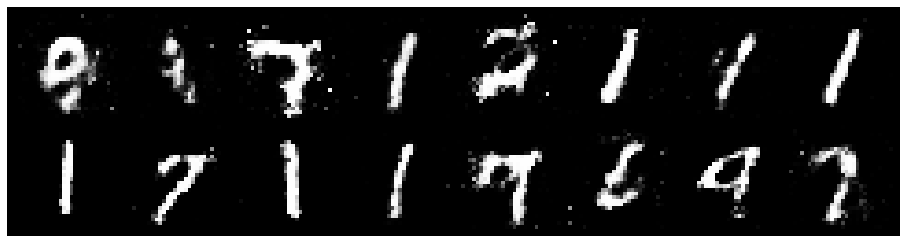

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 0.7601, Generator Loss: 1.8957
D(x): 0.7448, D(G(z)): 0.1843


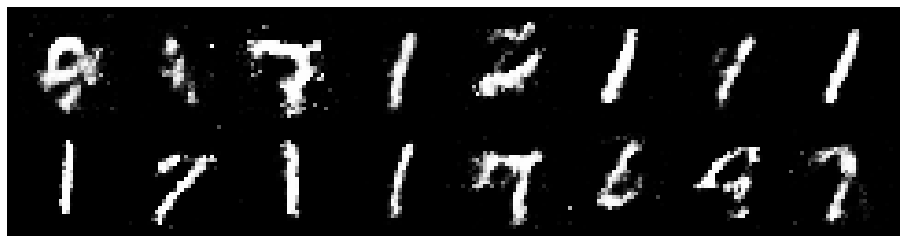

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 0.5792, Generator Loss: 1.7892
D(x): 0.7916, D(G(z)): 0.1656


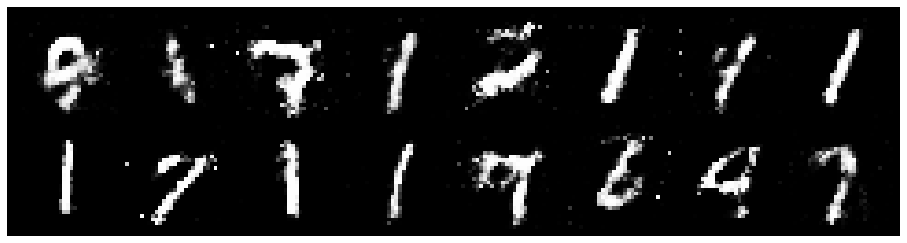

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 0.5585, Generator Loss: 1.8345
D(x): 0.7874, D(G(z)): 0.1795


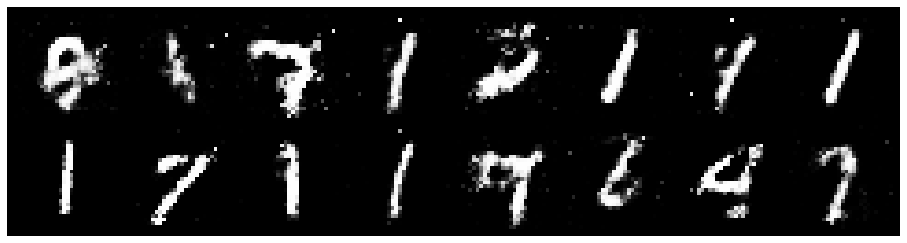

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 0.6339, Generator Loss: 2.1702
D(x): 0.7952, D(G(z)): 0.2045


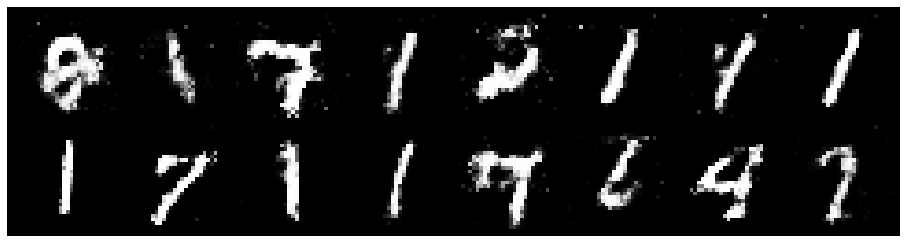

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 0.8225, Generator Loss: 1.8400
D(x): 0.7131, D(G(z)): 0.2125


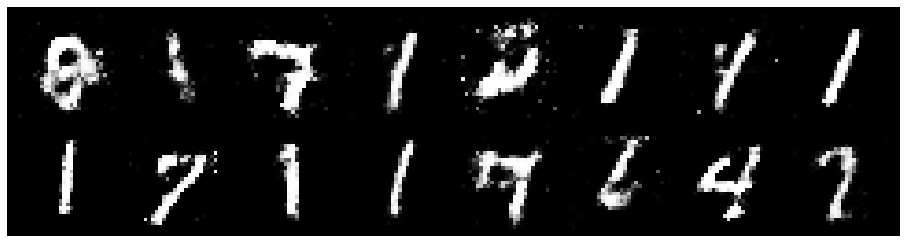

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 0.7689, Generator Loss: 1.4900
D(x): 0.8216, D(G(z)): 0.3054


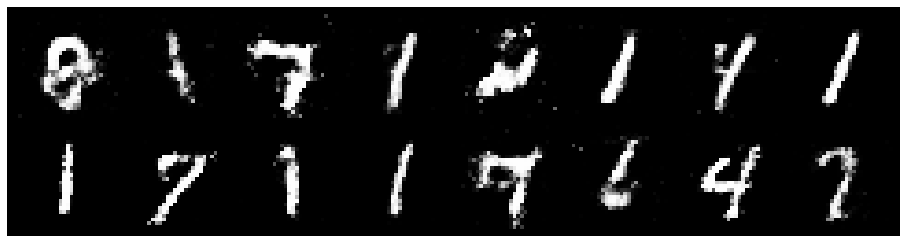

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 0.7442, Generator Loss: 1.6581
D(x): 0.7656, D(G(z)): 0.2535


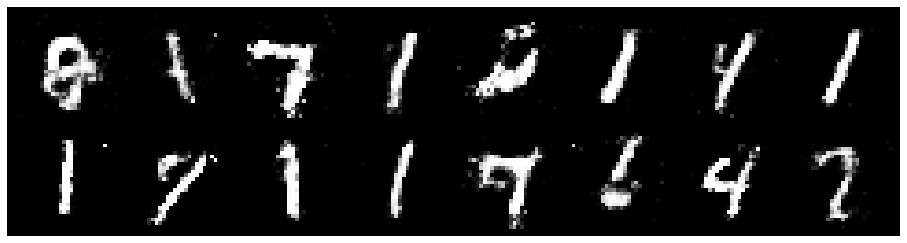

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 0.8162, Generator Loss: 1.5222
D(x): 0.7120, D(G(z)): 0.2307


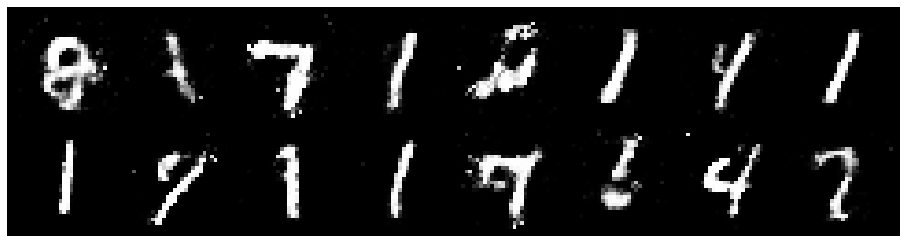

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 0.7653, Generator Loss: 1.3925
D(x): 0.7468, D(G(z)): 0.2298


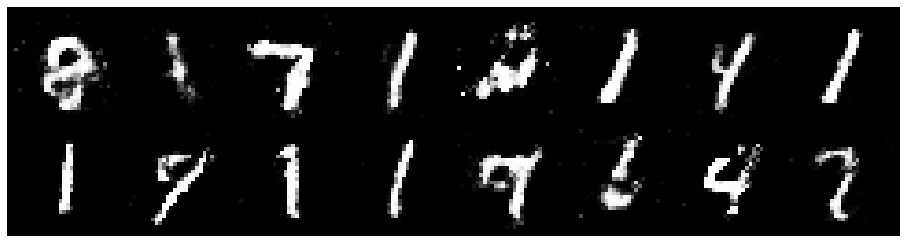

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 0.7674, Generator Loss: 1.8065
D(x): 0.7752, D(G(z)): 0.2637


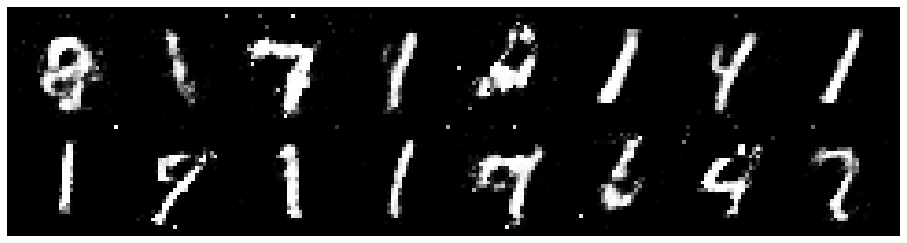

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 0.7271, Generator Loss: 1.4561
D(x): 0.7671, D(G(z)): 0.2524


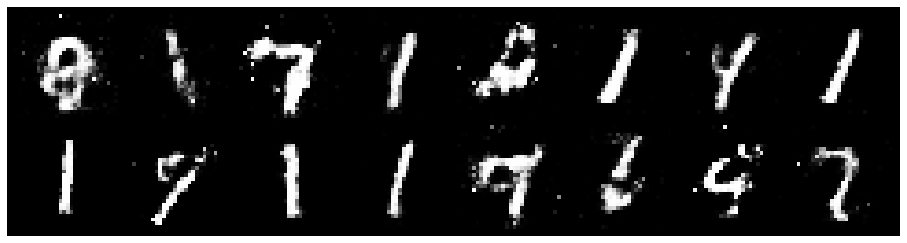

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 0.5995, Generator Loss: 2.0207
D(x): 0.7938, D(G(z)): 0.1999


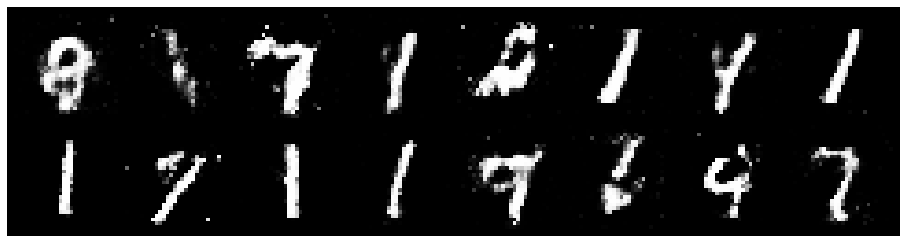

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 0.7430, Generator Loss: 2.0649
D(x): 0.7394, D(G(z)): 0.1828


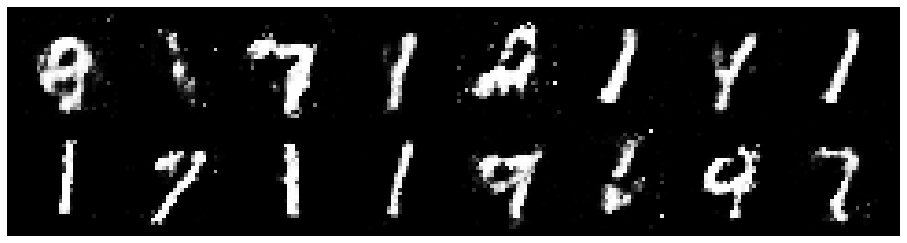

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 0.6491, Generator Loss: 2.4504
D(x): 0.7743, D(G(z)): 0.1857


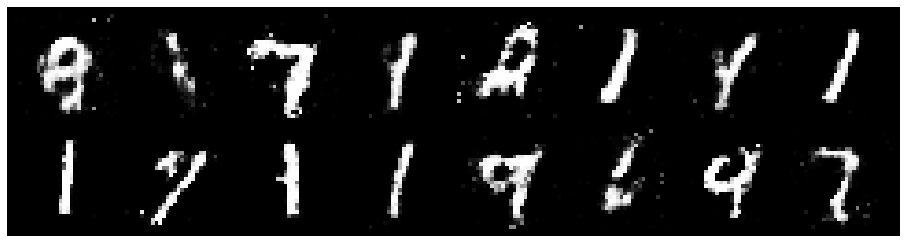

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 0.6253, Generator Loss: 2.1597
D(x): 0.8019, D(G(z)): 0.2054


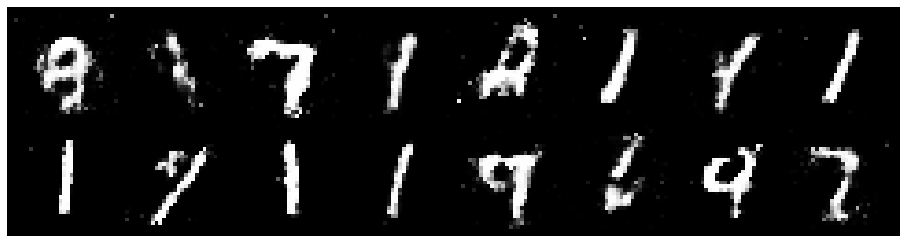

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 0.5964, Generator Loss: 2.0052
D(x): 0.8050, D(G(z)): 0.2067


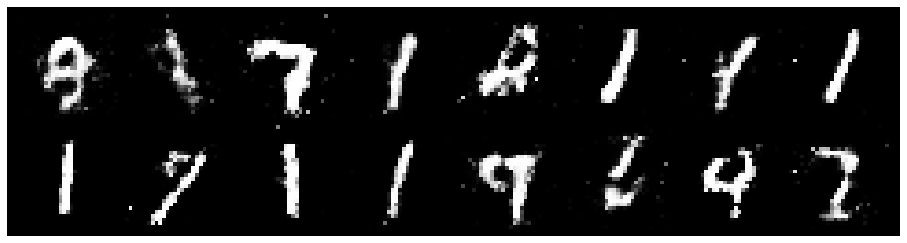

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 0.6019, Generator Loss: 2.1010
D(x): 0.8009, D(G(z)): 0.1963


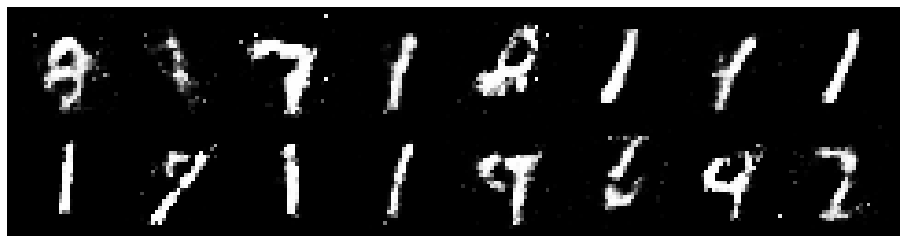

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 0.6517, Generator Loss: 1.5518
D(x): 0.7908, D(G(z)): 0.2204


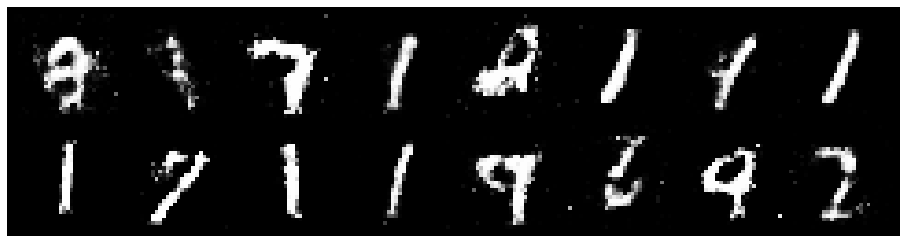

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 0.7086, Generator Loss: 1.6359
D(x): 0.7724, D(G(z)): 0.2426


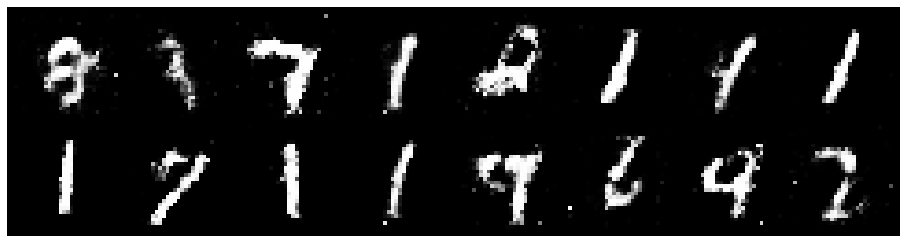

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 0.8772, Generator Loss: 1.9381
D(x): 0.7278, D(G(z)): 0.2535


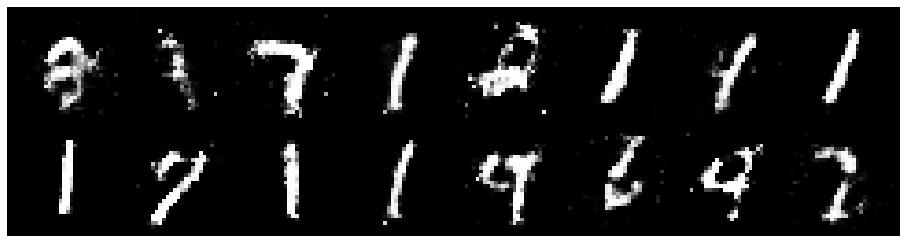

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 0.8902, Generator Loss: 1.9290
D(x): 0.6875, D(G(z)): 0.2342


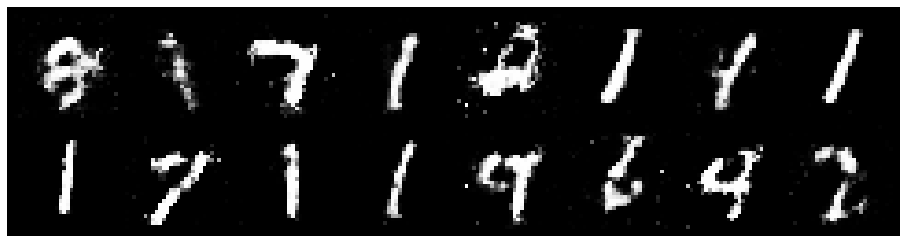

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 0.5856, Generator Loss: 1.9941
D(x): 0.7826, D(G(z)): 0.1854


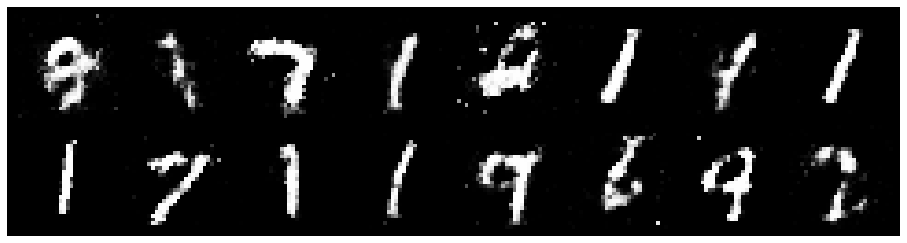

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 0.6657, Generator Loss: 1.4625
D(x): 0.8196, D(G(z)): 0.2745


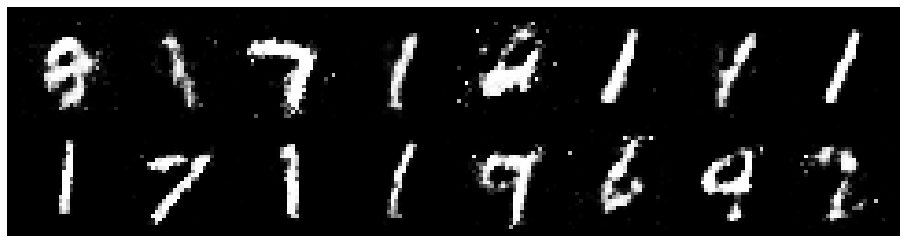

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 0.7343, Generator Loss: 1.7091
D(x): 0.7486, D(G(z)): 0.2312


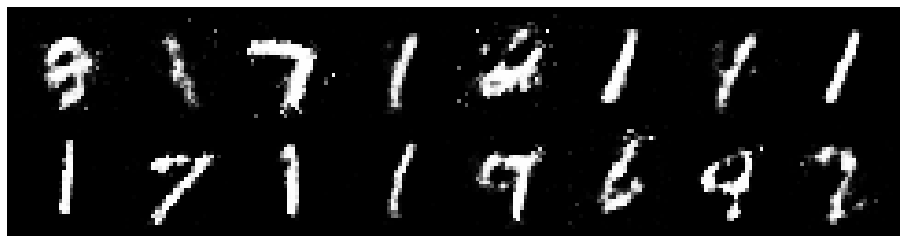

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 0.8690, Generator Loss: 1.9839
D(x): 0.7507, D(G(z)): 0.2808


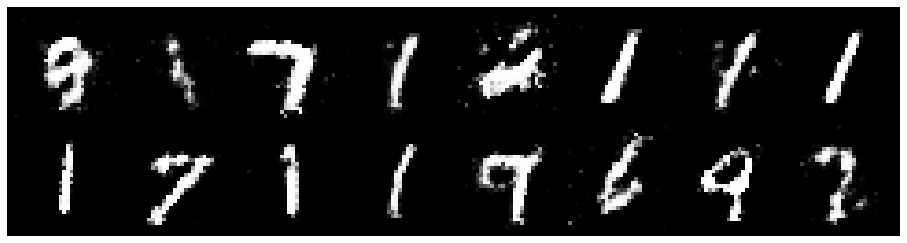

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 0.7889, Generator Loss: 1.6167
D(x): 0.7892, D(G(z)): 0.2857


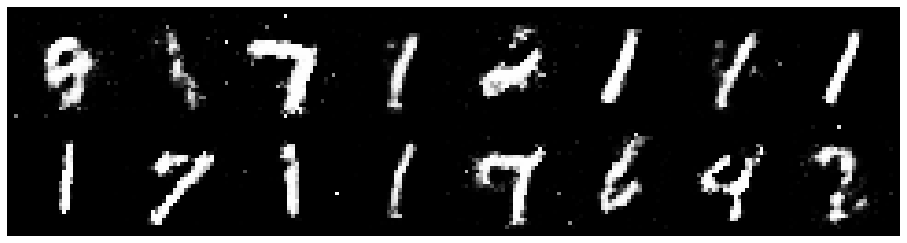

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 0.5994, Generator Loss: 1.3948
D(x): 0.8470, D(G(z)): 0.2687


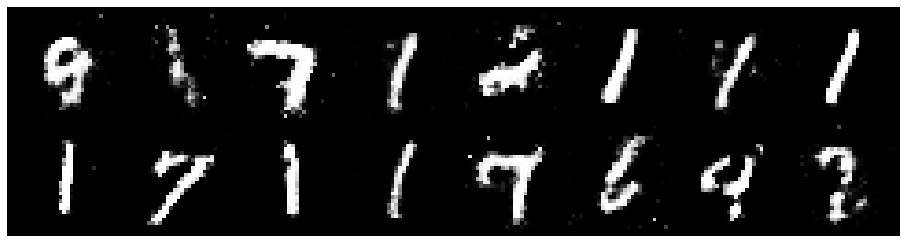

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 0.8876, Generator Loss: 1.4796
D(x): 0.7092, D(G(z)): 0.2569


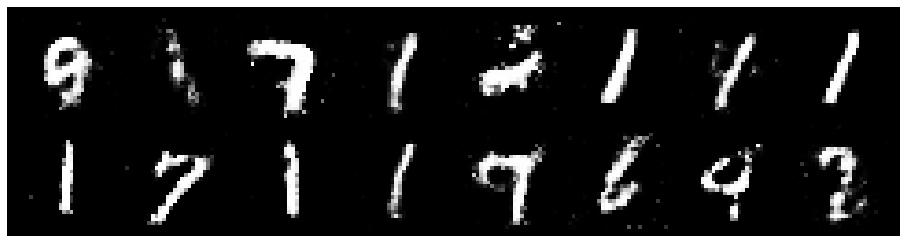

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 0.7997, Generator Loss: 1.7587
D(x): 0.7615, D(G(z)): 0.2485


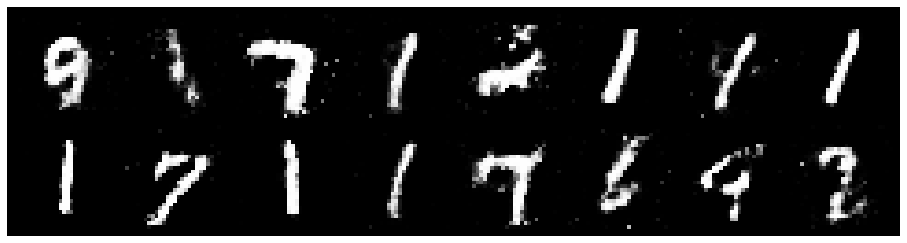

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 0.6865, Generator Loss: 2.0587
D(x): 0.7761, D(G(z)): 0.2154


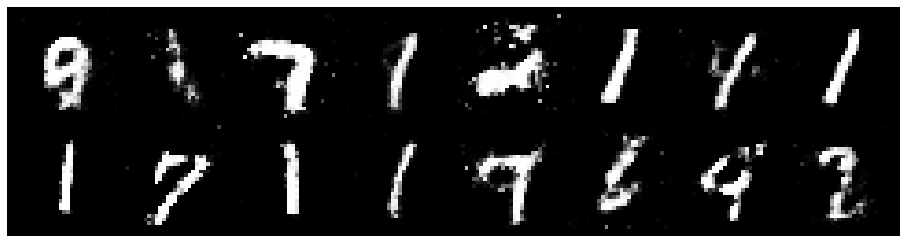

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 0.7932, Generator Loss: 1.6024
D(x): 0.7582, D(G(z)): 0.2644


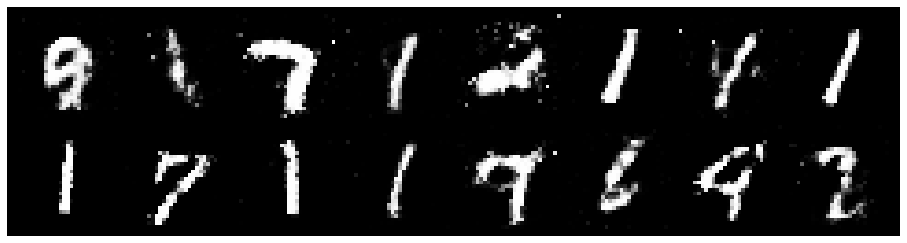

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 0.7280, Generator Loss: 1.7066
D(x): 0.7769, D(G(z)): 0.2498


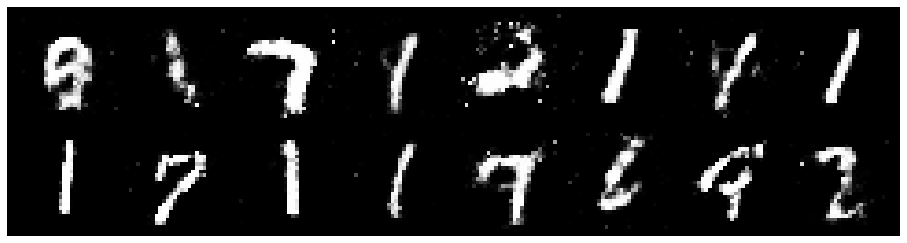

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 0.6635, Generator Loss: 2.0251
D(x): 0.7601, D(G(z)): 0.1994


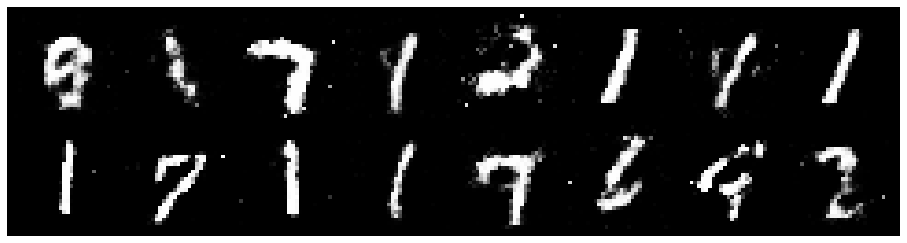

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 0.7763, Generator Loss: 1.9869
D(x): 0.7221, D(G(z)): 0.2083


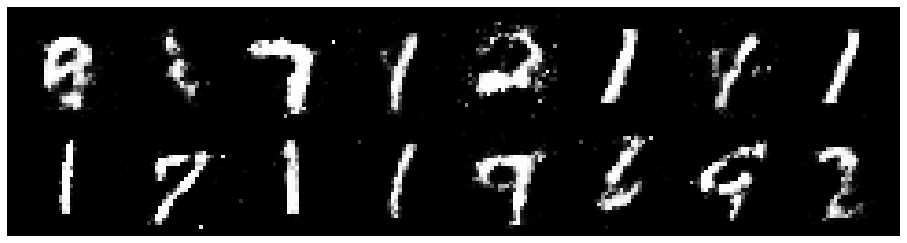

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 0.8816, Generator Loss: 1.6989
D(x): 0.6856, D(G(z)): 0.2588


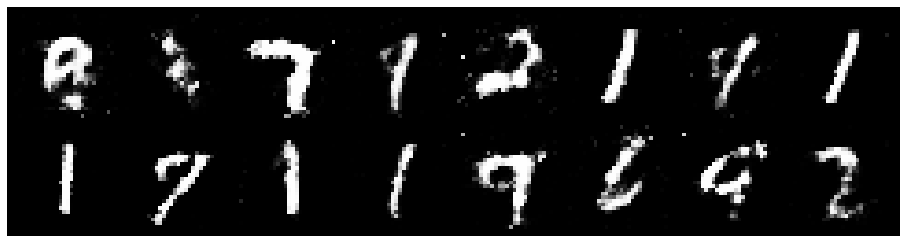

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 0.6913, Generator Loss: 1.8171
D(x): 0.7770, D(G(z)): 0.2463


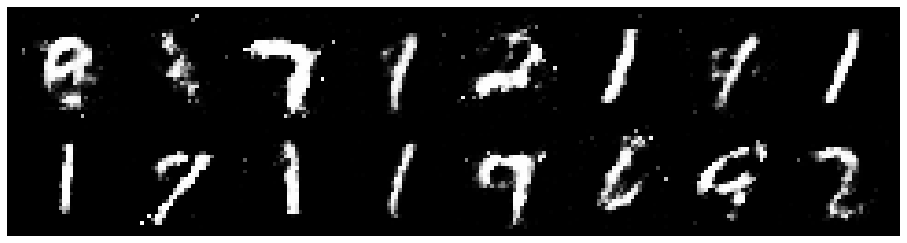

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 0.6810, Generator Loss: 1.7180
D(x): 0.8000, D(G(z)): 0.2586


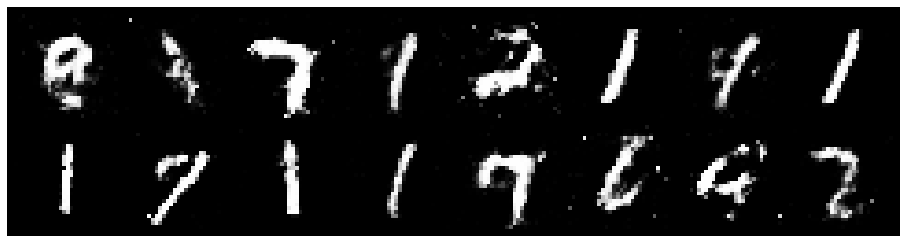

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 0.6886, Generator Loss: 1.6296
D(x): 0.7760, D(G(z)): 0.2262


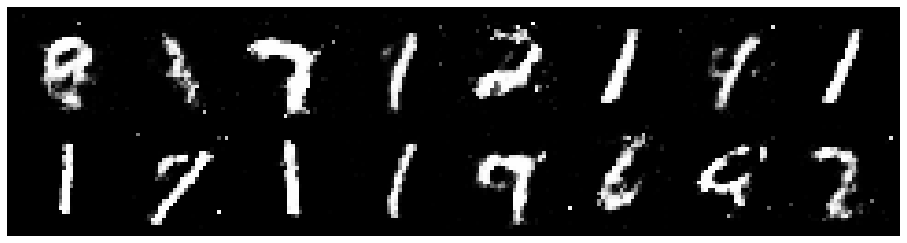

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 0.7244, Generator Loss: 2.0954
D(x): 0.7954, D(G(z)): 0.2407


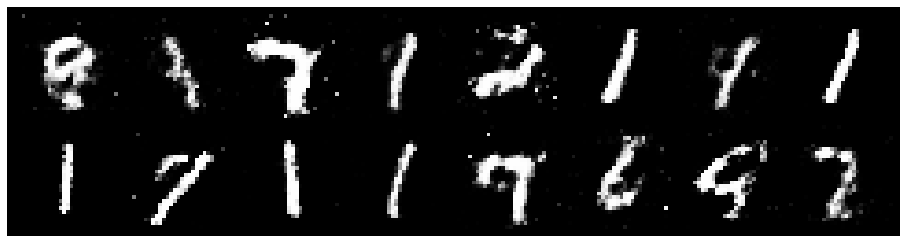

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 0.8126, Generator Loss: 1.6618
D(x): 0.7266, D(G(z)): 0.2347


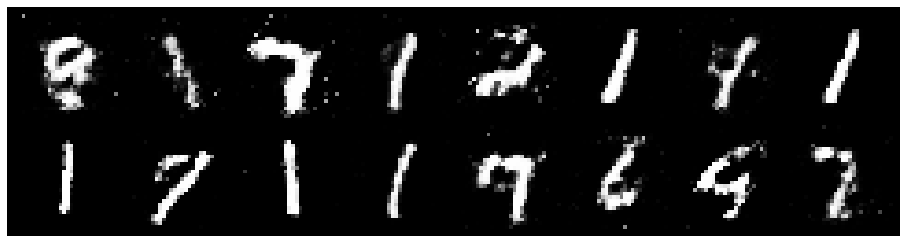

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 0.6459, Generator Loss: 2.1076
D(x): 0.7470, D(G(z)): 0.1490


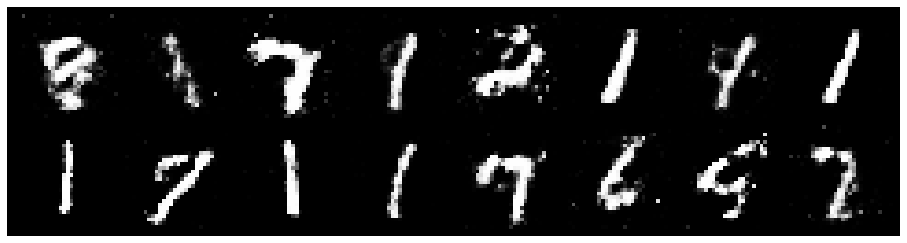

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 0.6159, Generator Loss: 2.3697
D(x): 0.7700, D(G(z)): 0.1510


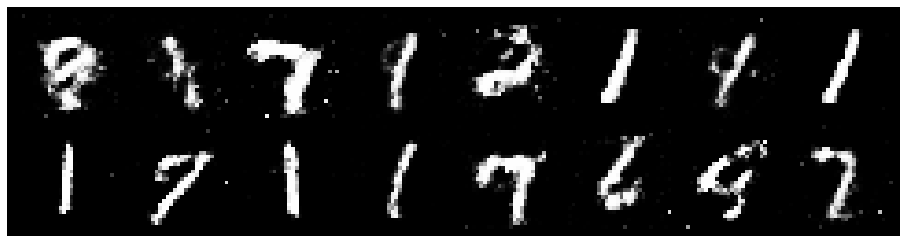

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 0.7167, Generator Loss: 1.7492
D(x): 0.7421, D(G(z)): 0.1964


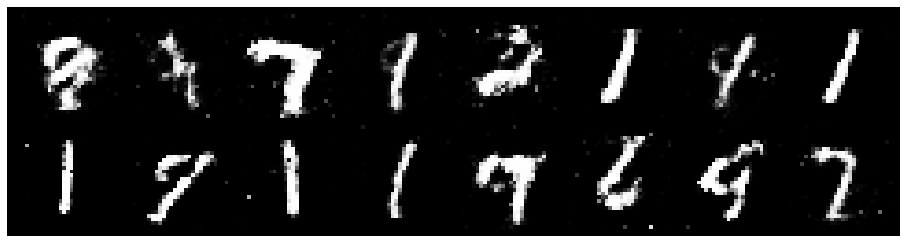

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 0.8200, Generator Loss: 1.5853
D(x): 0.8112, D(G(z)): 0.3168


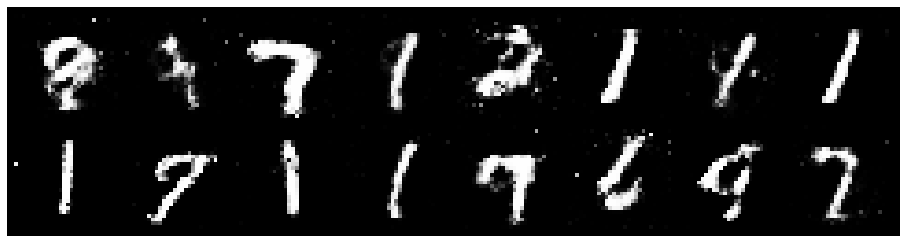

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 0.6622, Generator Loss: 1.7373
D(x): 0.8300, D(G(z)): 0.2727


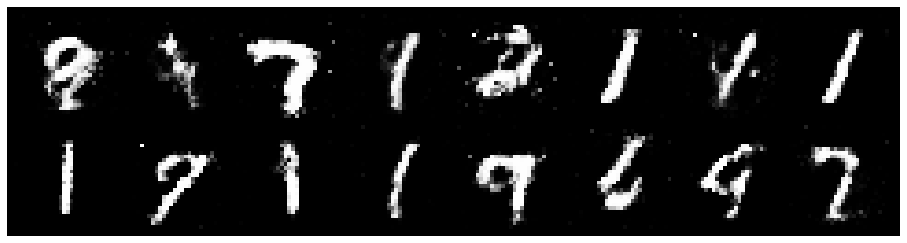

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 0.6969, Generator Loss: 1.9183
D(x): 0.7315, D(G(z)): 0.1850


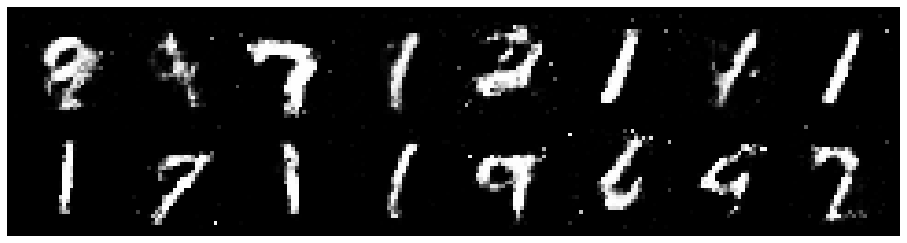

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 0.6635, Generator Loss: 2.0117
D(x): 0.7435, D(G(z)): 0.1749


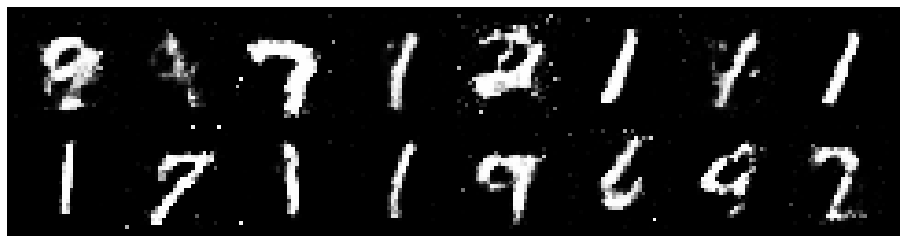

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 0.7967, Generator Loss: 1.7562
D(x): 0.7067, D(G(z)): 0.1937


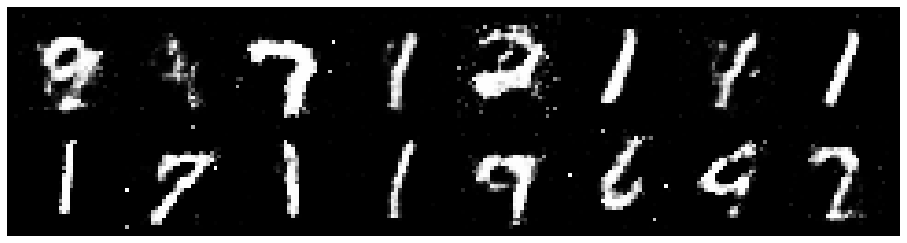

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 0.7073, Generator Loss: 1.6278
D(x): 0.7740, D(G(z)): 0.2466


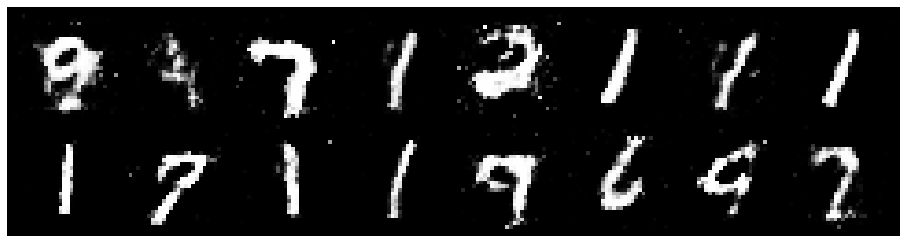

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 0.7708, Generator Loss: 1.9023
D(x): 0.7812, D(G(z)): 0.2453


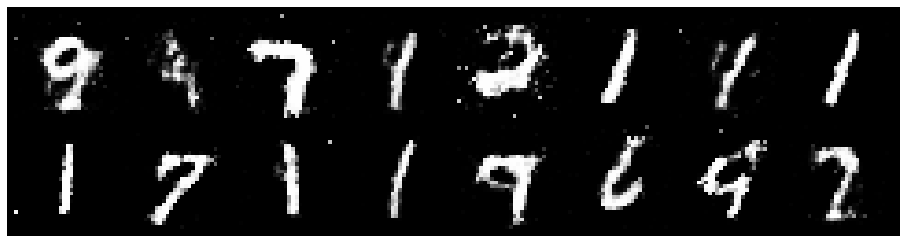

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 0.7255, Generator Loss: 1.4066
D(x): 0.7956, D(G(z)): 0.2683


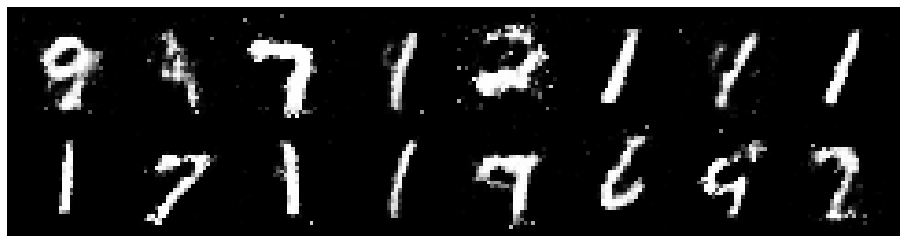

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 0.8292, Generator Loss: 1.5995
D(x): 0.7798, D(G(z)): 0.3002


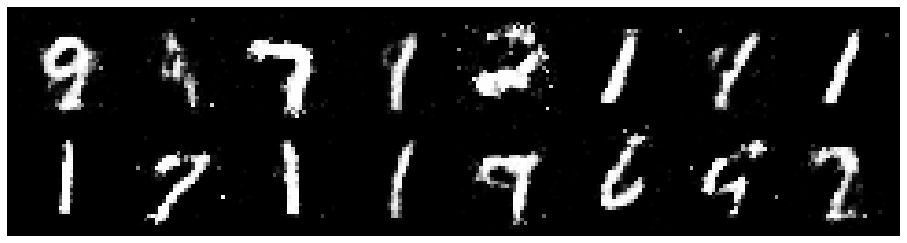

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 0.8297, Generator Loss: 1.6494
D(x): 0.7126, D(G(z)): 0.2641


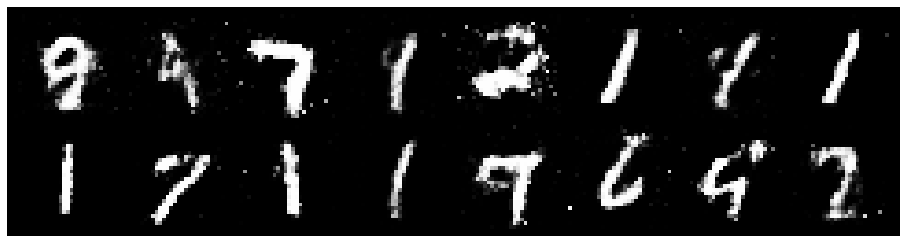

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 0.8236, Generator Loss: 1.4749
D(x): 0.7536, D(G(z)): 0.2951


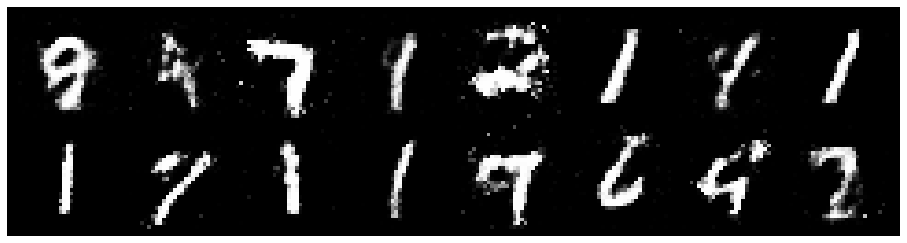

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 0.6953, Generator Loss: 1.6909
D(x): 0.7685, D(G(z)): 0.2558


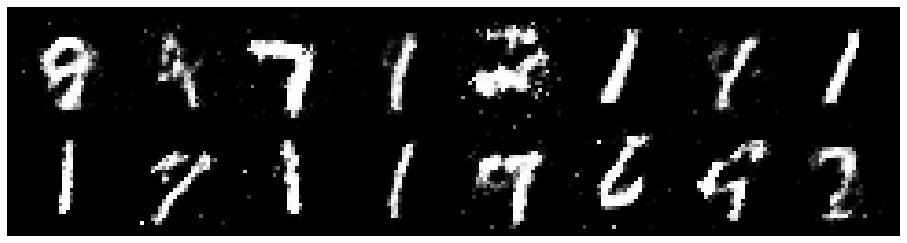

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 0.7122, Generator Loss: 1.7317
D(x): 0.7221, D(G(z)): 0.1874


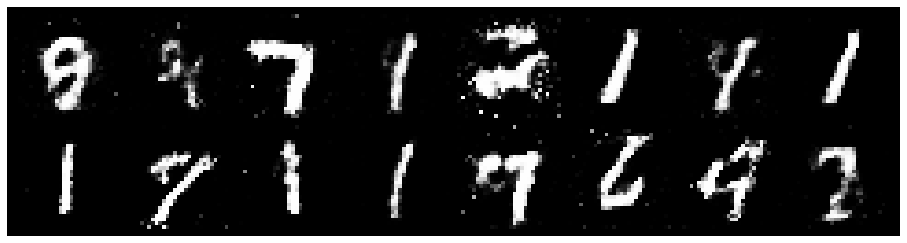

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 0.6572, Generator Loss: 1.8218
D(x): 0.8118, D(G(z)): 0.2321


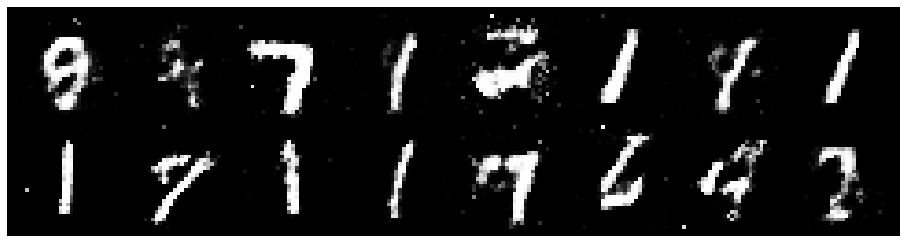

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 0.8129, Generator Loss: 1.4860
D(x): 0.7369, D(G(z)): 0.2720


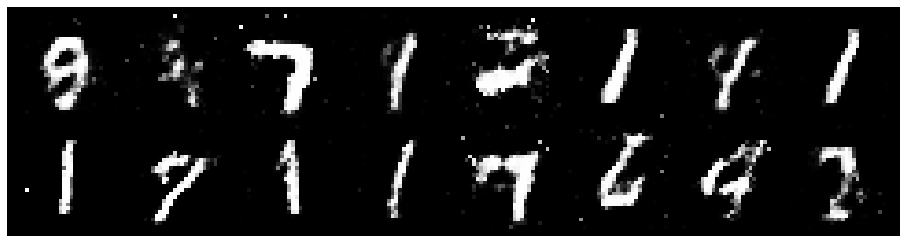

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 0.8221, Generator Loss: 1.6407
D(x): 0.7274, D(G(z)): 0.2562


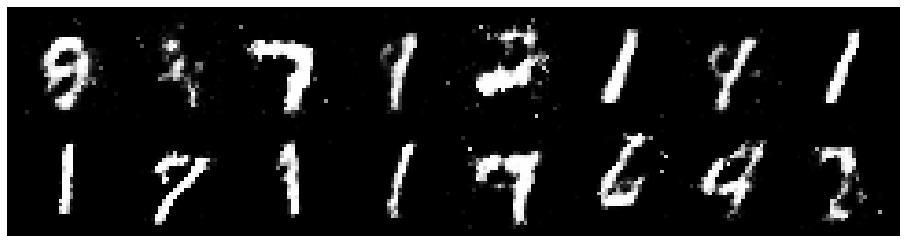

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 0.8179, Generator Loss: 1.4009
D(x): 0.7684, D(G(z)): 0.3071


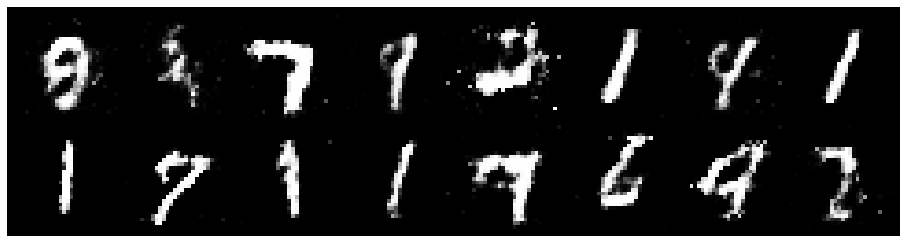

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 0.8823, Generator Loss: 1.6014
D(x): 0.7207, D(G(z)): 0.2828


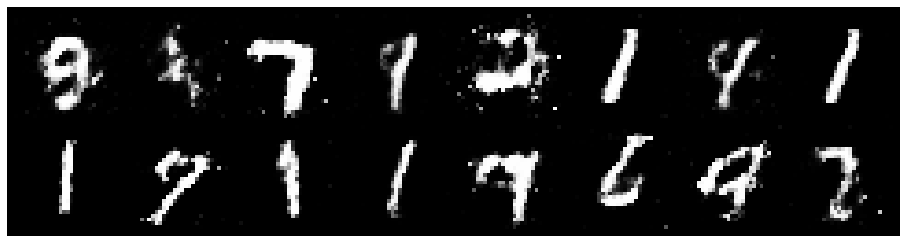

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 0.8495, Generator Loss: 1.2404
D(x): 0.7858, D(G(z)): 0.3465


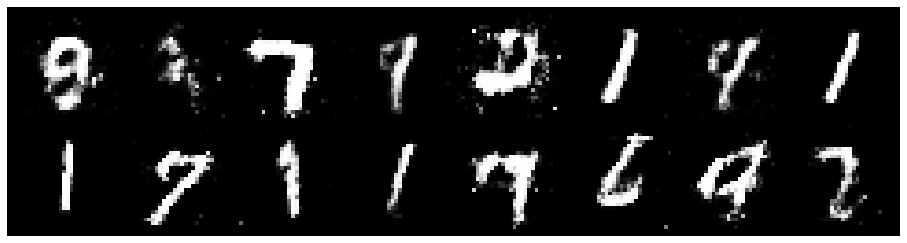

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 0.8812, Generator Loss: 1.8948
D(x): 0.6797, D(G(z)): 0.2211


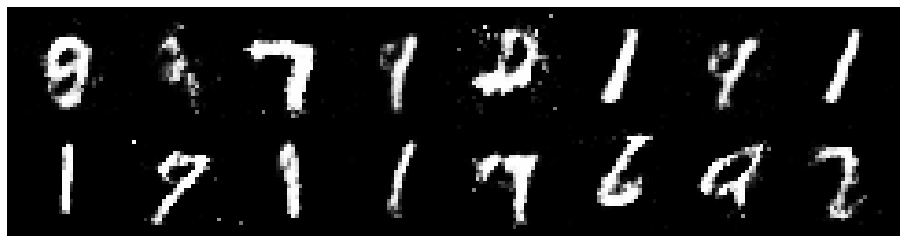

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 0.8356, Generator Loss: 1.7309
D(x): 0.8042, D(G(z)): 0.3301


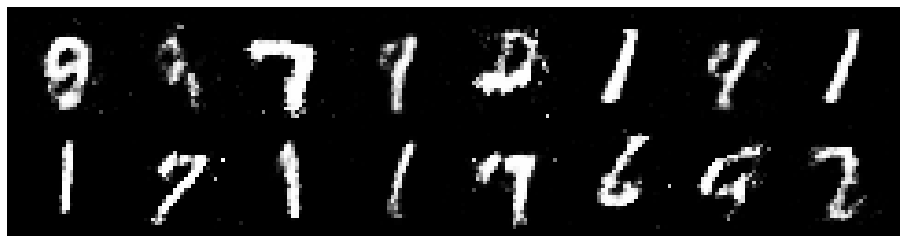

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 0.9612, Generator Loss: 1.6077
D(x): 0.6660, D(G(z)): 0.2803


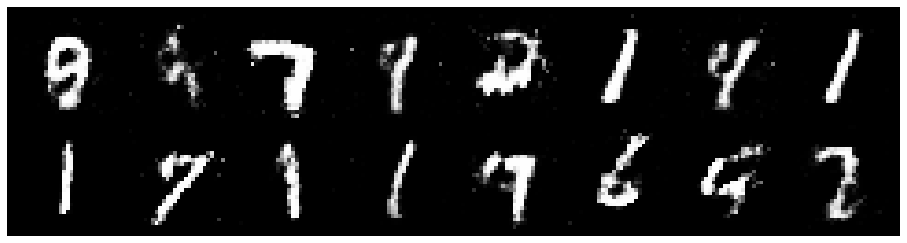

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 0.8619, Generator Loss: 1.8568
D(x): 0.7381, D(G(z)): 0.2695


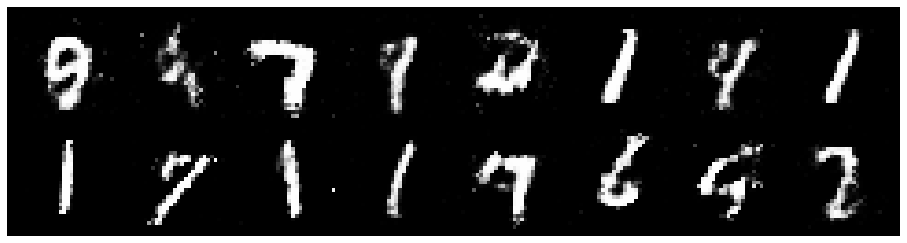

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 0.9031, Generator Loss: 1.6988
D(x): 0.7229, D(G(z)): 0.2846


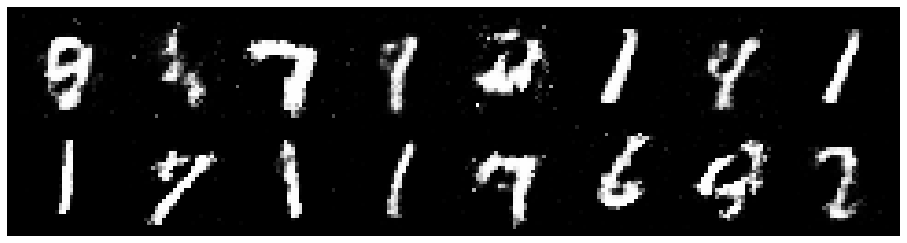

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 0.8463, Generator Loss: 1.9055
D(x): 0.7510, D(G(z)): 0.2722


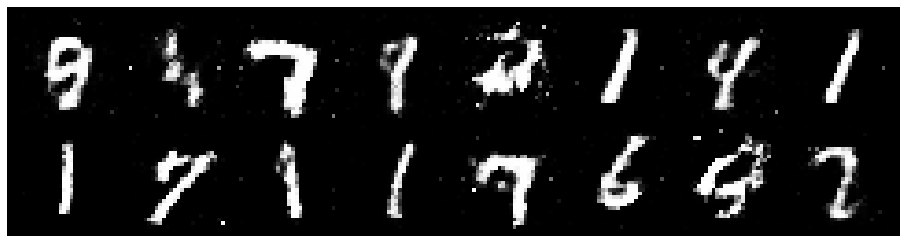

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 0.8047, Generator Loss: 1.5526
D(x): 0.7611, D(G(z)): 0.2767


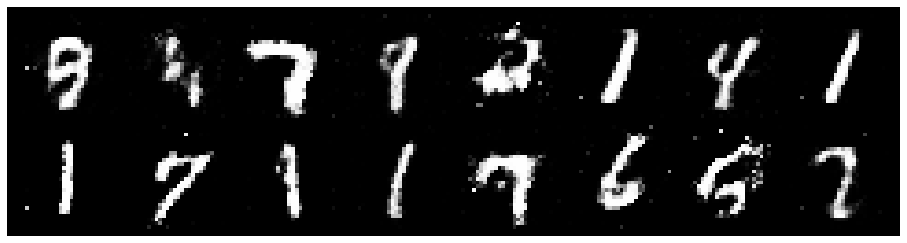

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 0.7776, Generator Loss: 1.6230
D(x): 0.7301, D(G(z)): 0.2464


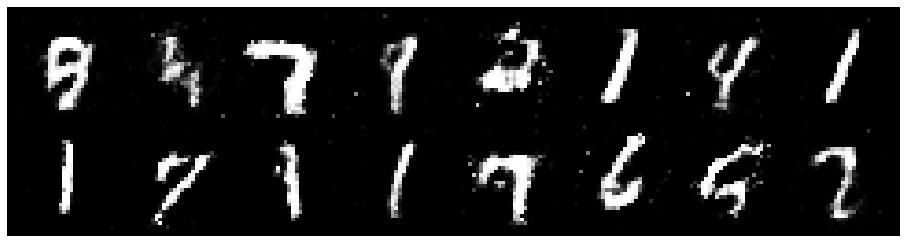

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 0.8027, Generator Loss: 1.7409
D(x): 0.7738, D(G(z)): 0.2699


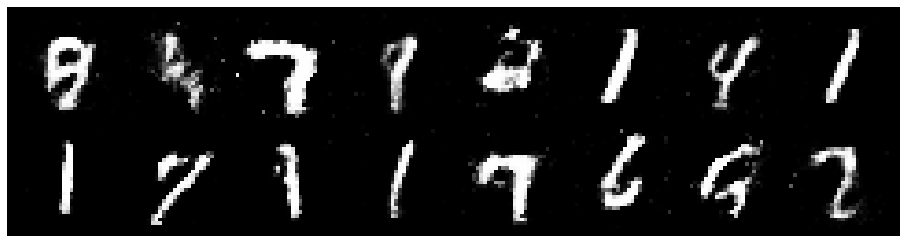

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 0.8827, Generator Loss: 1.5263
D(x): 0.7307, D(G(z)): 0.2923


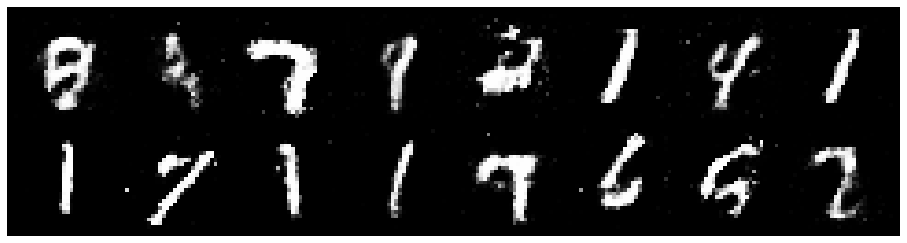

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 0.8146, Generator Loss: 1.2976
D(x): 0.8045, D(G(z)): 0.3411


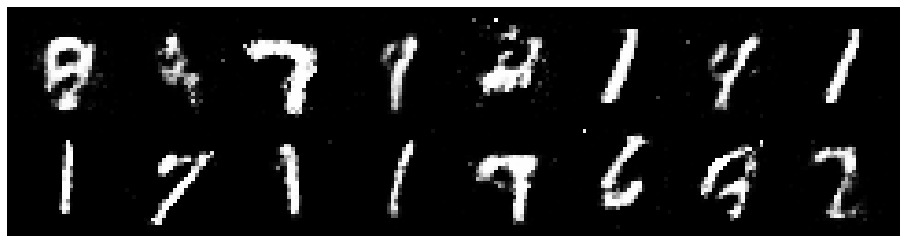

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 0.8209, Generator Loss: 1.9003
D(x): 0.7488, D(G(z)): 0.2744


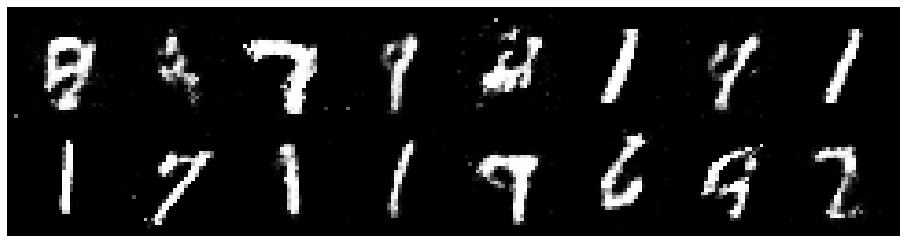

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 0.8904, Generator Loss: 1.7574
D(x): 0.6564, D(G(z)): 0.1750


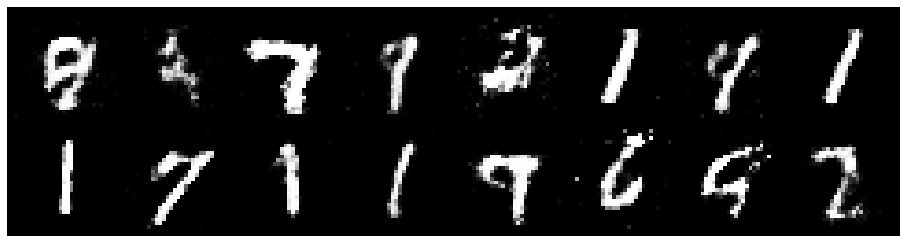

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 0.9608, Generator Loss: 1.3359
D(x): 0.7184, D(G(z)): 0.3259


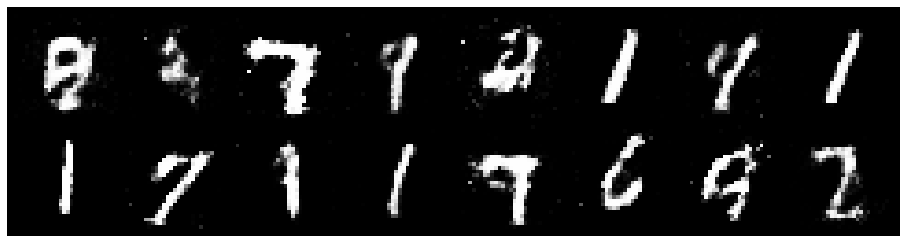

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 0.8981, Generator Loss: 1.4364
D(x): 0.7055, D(G(z)): 0.2826


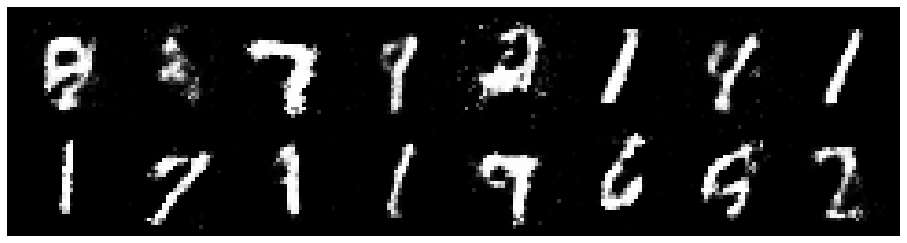

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 0.7057, Generator Loss: 1.6891
D(x): 0.7639, D(G(z)): 0.2255


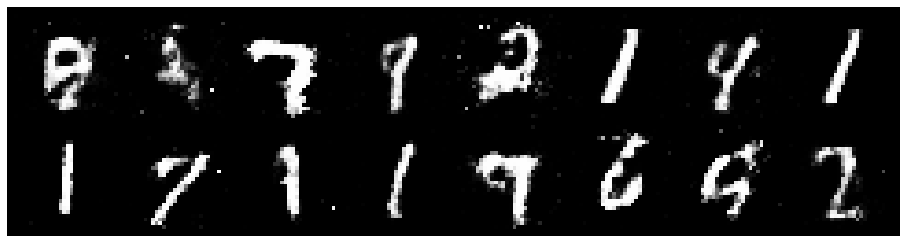

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 0.9836, Generator Loss: 1.8935
D(x): 0.6821, D(G(z)): 0.2548


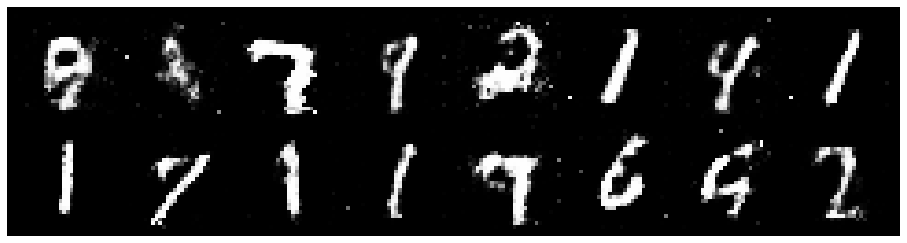

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 0.9403, Generator Loss: 1.7591
D(x): 0.6629, D(G(z)): 0.2516


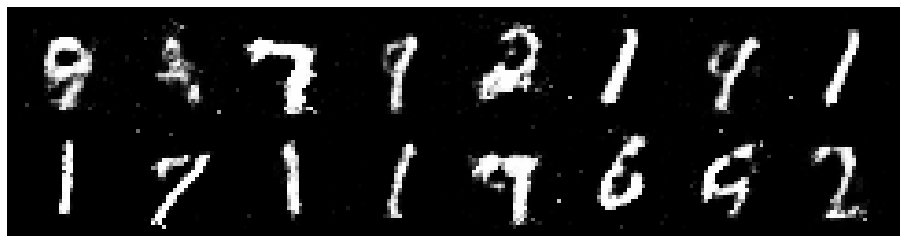

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 0.8461, Generator Loss: 1.6268
D(x): 0.7667, D(G(z)): 0.3066


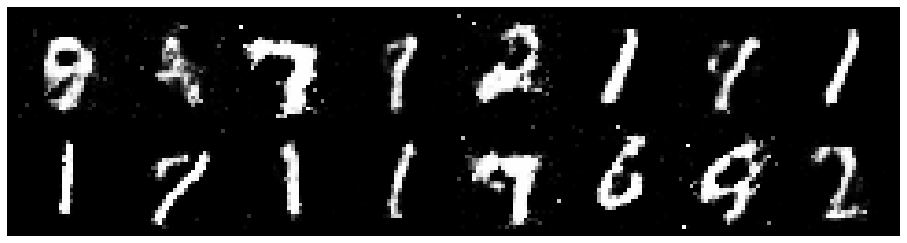

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 0.8327, Generator Loss: 1.5575
D(x): 0.7261, D(G(z)): 0.2888


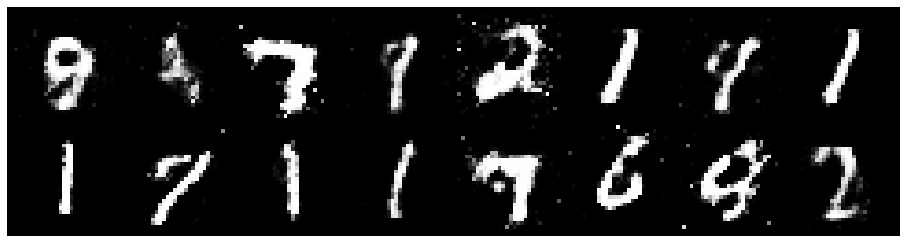

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 0.8398, Generator Loss: 1.1475
D(x): 0.8000, D(G(z)): 0.3633


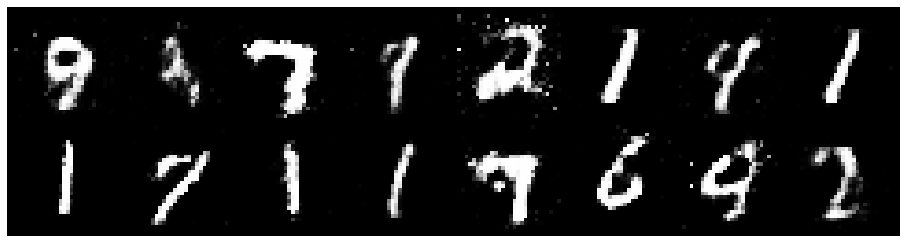

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 0.8242, Generator Loss: 1.6245
D(x): 0.7082, D(G(z)): 0.2622


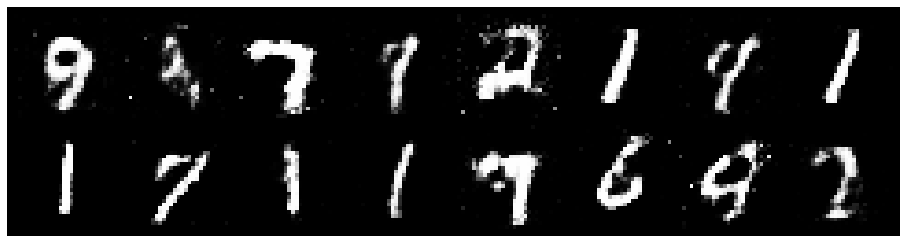

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 0.7424, Generator Loss: 1.8229
D(x): 0.7212, D(G(z)): 0.2238


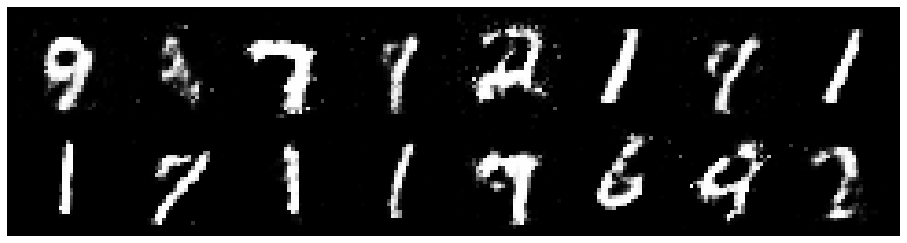

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 0.7729, Generator Loss: 1.7199
D(x): 0.6974, D(G(z)): 0.2085


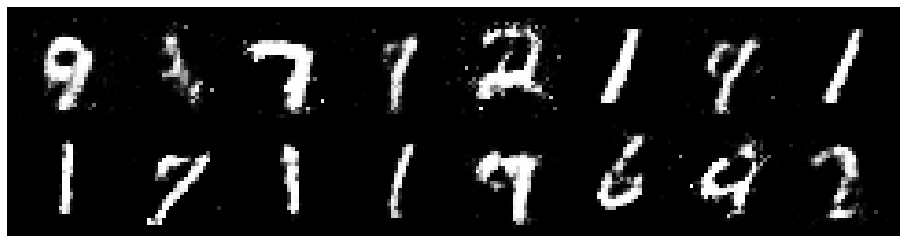

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 0.9163, Generator Loss: 1.8077
D(x): 0.6969, D(G(z)): 0.2644


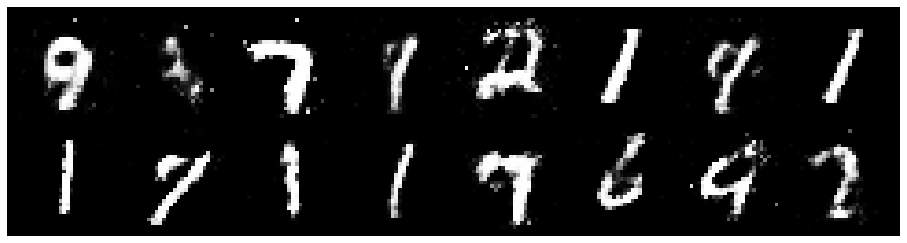

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 0.8435, Generator Loss: 1.6481
D(x): 0.6940, D(G(z)): 0.2099


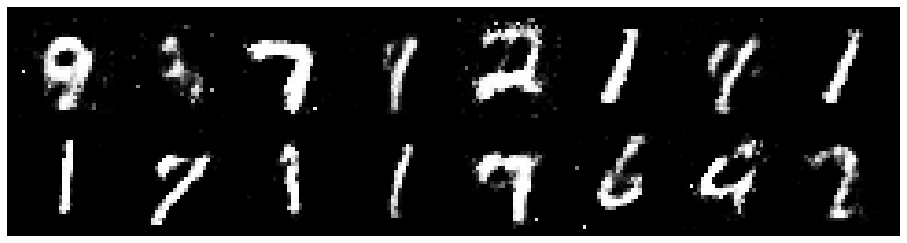

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 0.7397, Generator Loss: 1.8281
D(x): 0.7432, D(G(z)): 0.2247


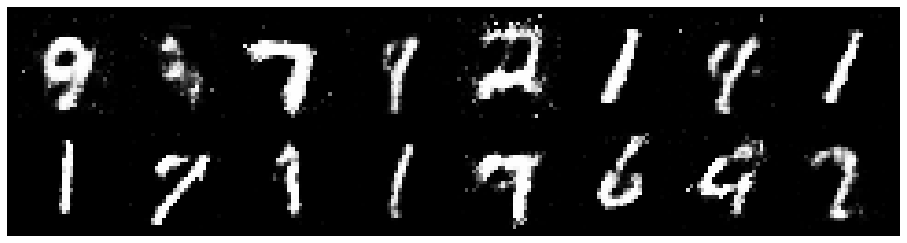

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.0078, Generator Loss: 1.6538
D(x): 0.6542, D(G(z)): 0.2778


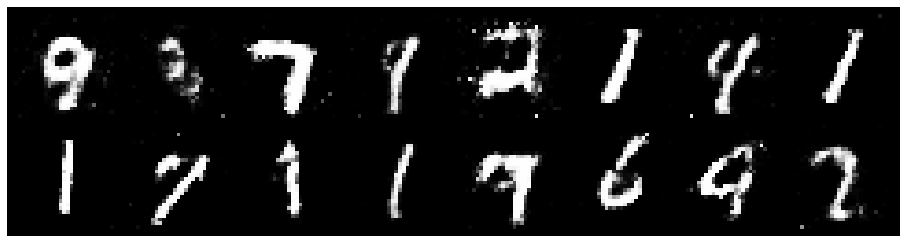

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 0.8386, Generator Loss: 1.4780
D(x): 0.7746, D(G(z)): 0.2993


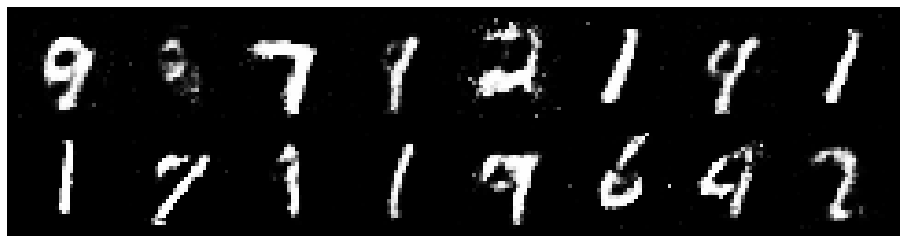

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 0.6771, Generator Loss: 1.6918
D(x): 0.7856, D(G(z)): 0.2236


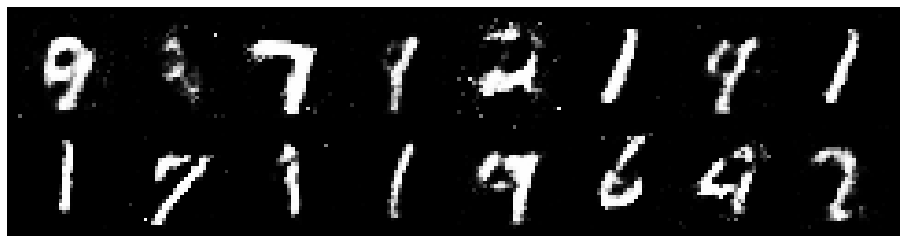

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 0.8116, Generator Loss: 1.8952
D(x): 0.6836, D(G(z)): 0.1808


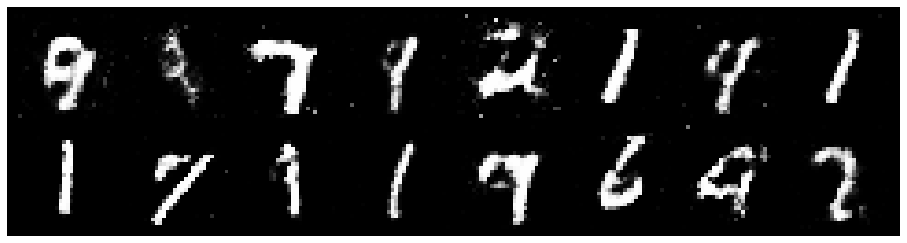

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 0.8104, Generator Loss: 1.4874
D(x): 0.7302, D(G(z)): 0.2297


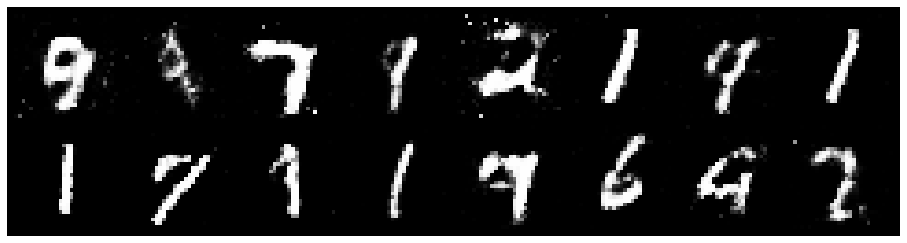

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 0.8227, Generator Loss: 1.3134
D(x): 0.7413, D(G(z)): 0.2802


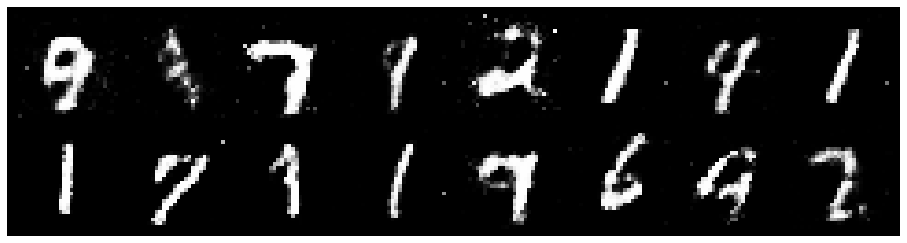

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 0.7951, Generator Loss: 1.4968
D(x): 0.7653, D(G(z)): 0.2964


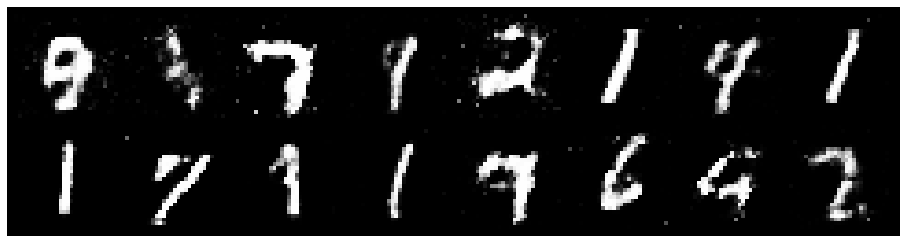

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 0.9541, Generator Loss: 1.9342
D(x): 0.6446, D(G(z)): 0.1944


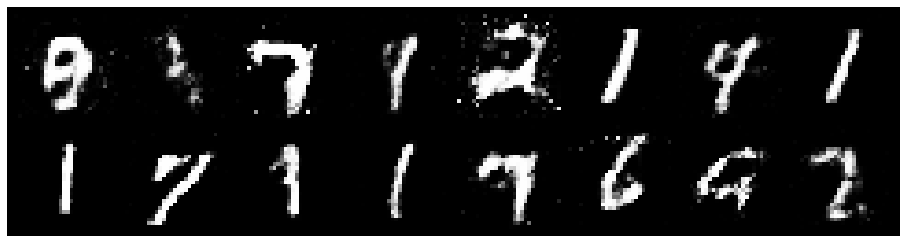

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 0.8458, Generator Loss: 1.5959
D(x): 0.7031, D(G(z)): 0.2744


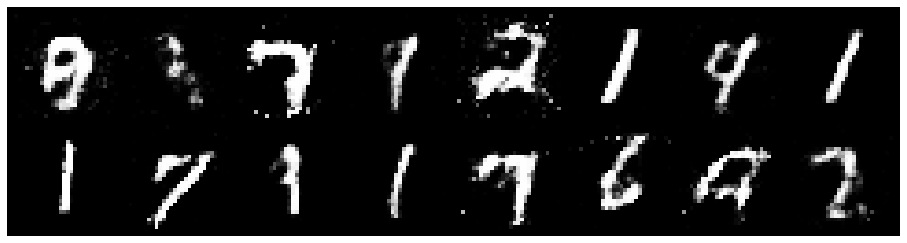

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 0.9527, Generator Loss: 1.5191
D(x): 0.6814, D(G(z)): 0.2710


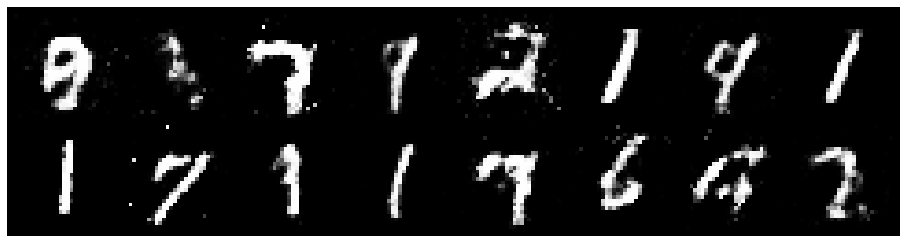

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 0.8532, Generator Loss: 1.6335
D(x): 0.7597, D(G(z)): 0.2791


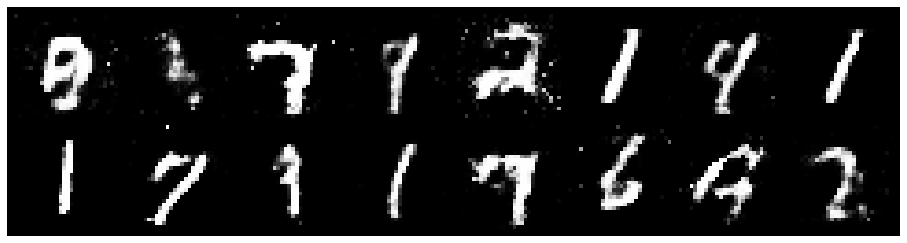

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 0.7632, Generator Loss: 1.5045
D(x): 0.8011, D(G(z)): 0.3078


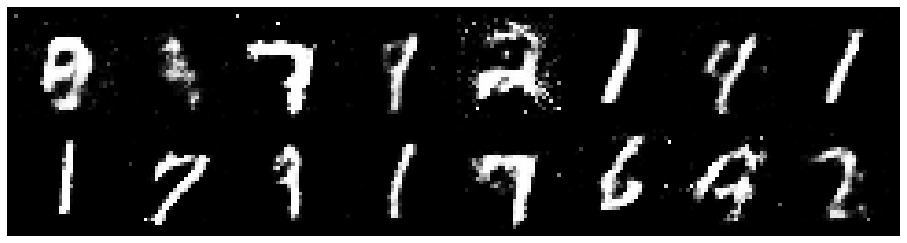

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 0.9005, Generator Loss: 1.5245
D(x): 0.7523, D(G(z)): 0.3458


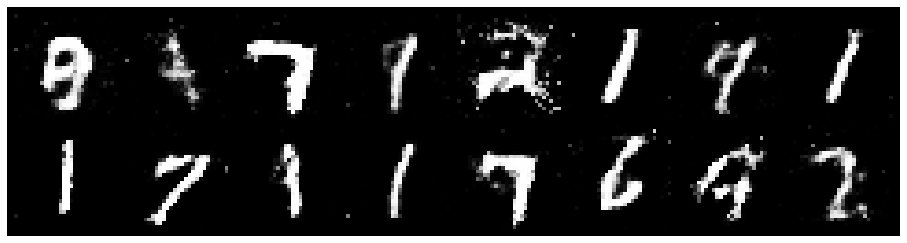

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 0.9774, Generator Loss: 1.6459
D(x): 0.7157, D(G(z)): 0.3074


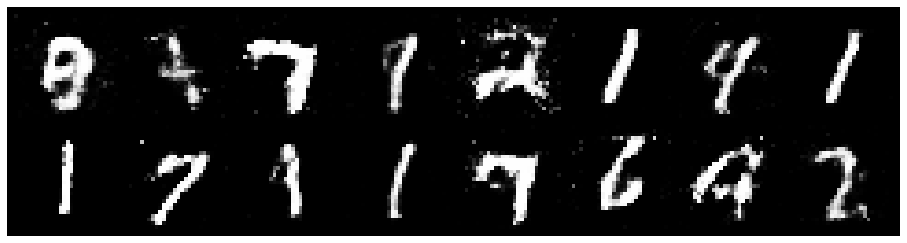

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 0.9839, Generator Loss: 1.4320
D(x): 0.7365, D(G(z)): 0.3489


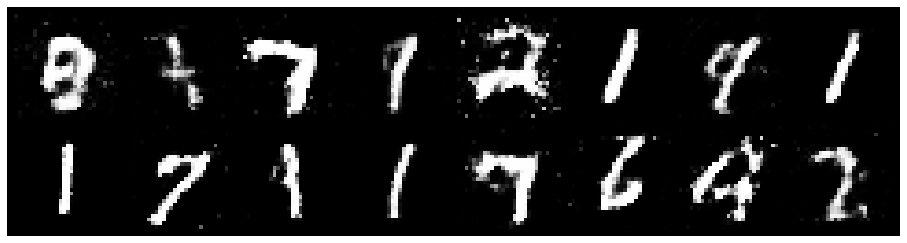

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 0.9021, Generator Loss: 1.7783
D(x): 0.6398, D(G(z)): 0.2022


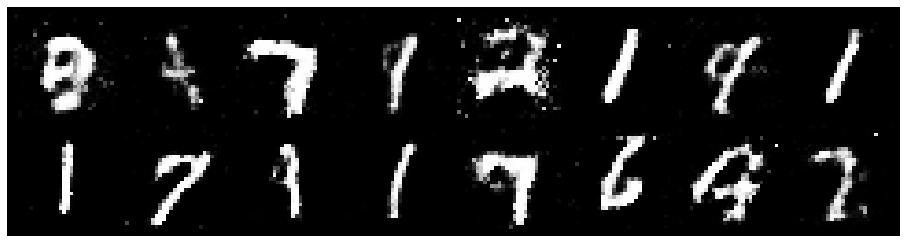

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 0.8769, Generator Loss: 1.6921
D(x): 0.6427, D(G(z)): 0.2063


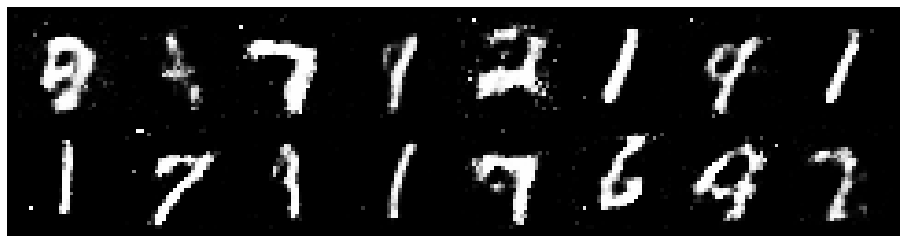

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.0540, Generator Loss: 1.6103
D(x): 0.6615, D(G(z)): 0.3035


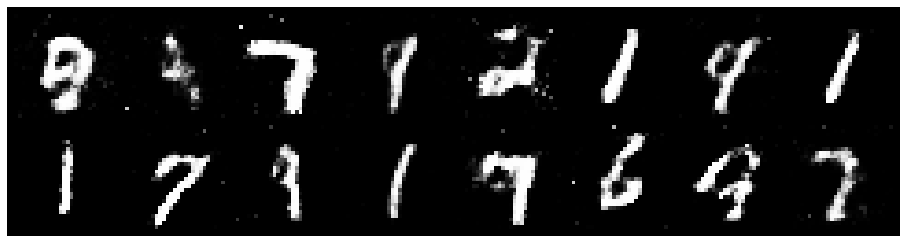

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 0.8300, Generator Loss: 1.4213
D(x): 0.7603, D(G(z)): 0.3264


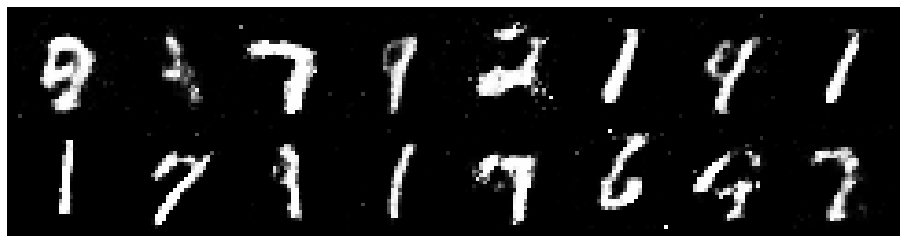

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 0.8971, Generator Loss: 1.3756
D(x): 0.6761, D(G(z)): 0.2844


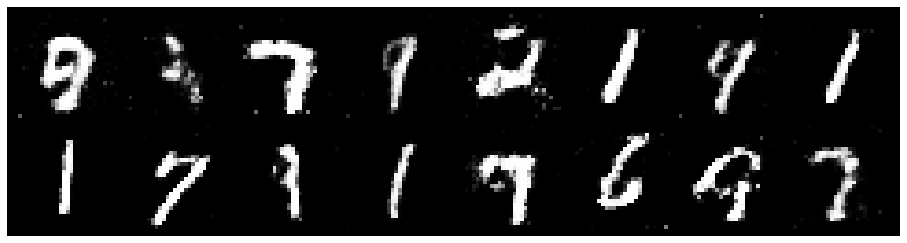

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 0.9556, Generator Loss: 1.3965
D(x): 0.7216, D(G(z)): 0.3423


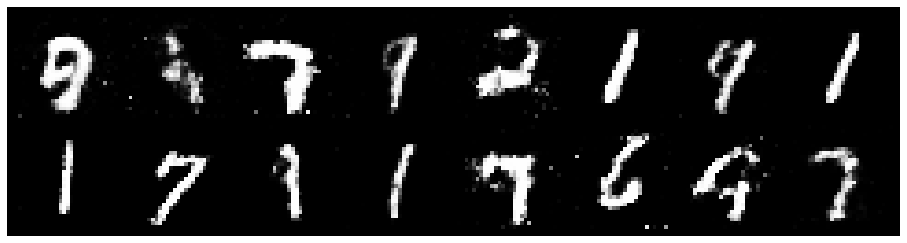

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 0.8353, Generator Loss: 1.6014
D(x): 0.7548, D(G(z)): 0.3191


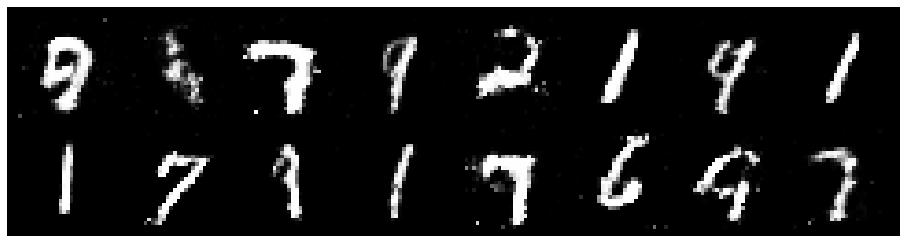

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 0.7360, Generator Loss: 1.6079
D(x): 0.7829, D(G(z)): 0.2627


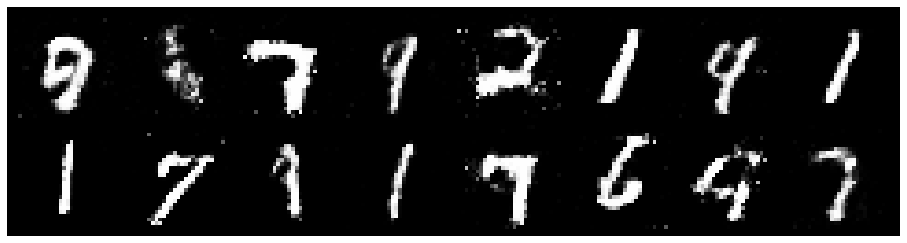

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 0.7229, Generator Loss: 1.5868
D(x): 0.7254, D(G(z)): 0.2198


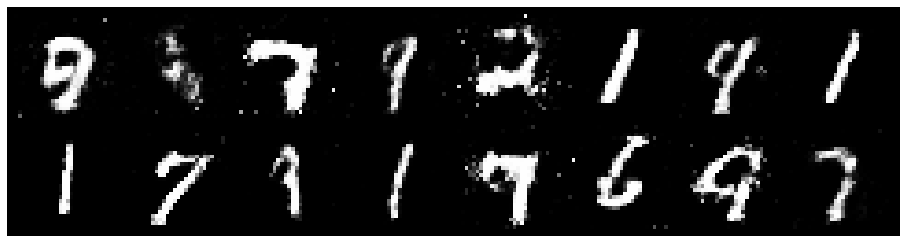

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 0.6281, Generator Loss: 1.6896
D(x): 0.7907, D(G(z)): 0.2314


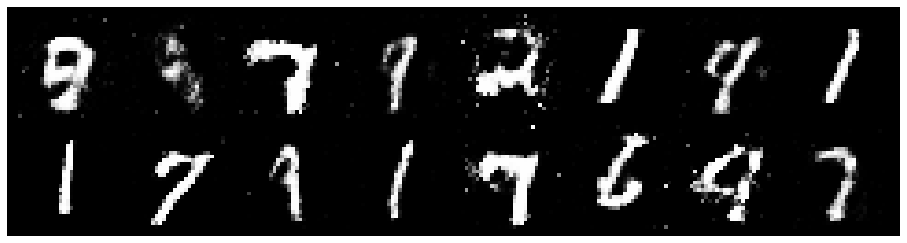

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 0.8502, Generator Loss: 1.5961
D(x): 0.6924, D(G(z)): 0.2598


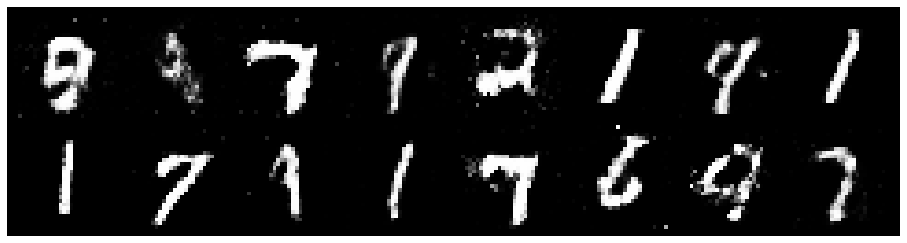

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 0.8284, Generator Loss: 1.3571
D(x): 0.7460, D(G(z)): 0.3012


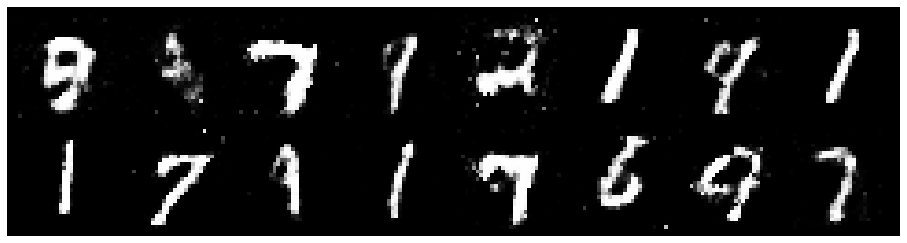

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 0.8409, Generator Loss: 1.4296
D(x): 0.7188, D(G(z)): 0.2884


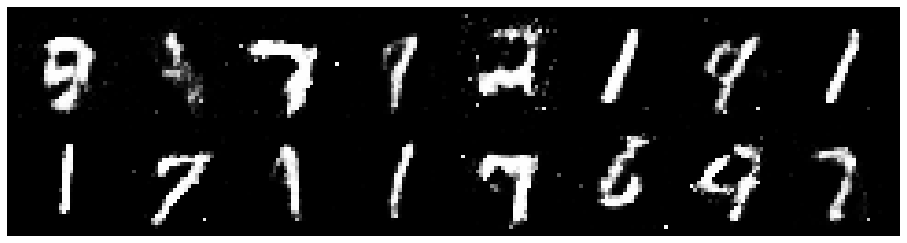

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 0.7888, Generator Loss: 1.7602
D(x): 0.7044, D(G(z)): 0.2302


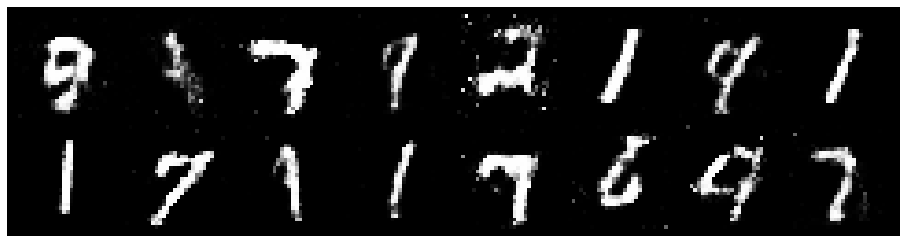

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 0.8889, Generator Loss: 1.4161
D(x): 0.7537, D(G(z)): 0.3259


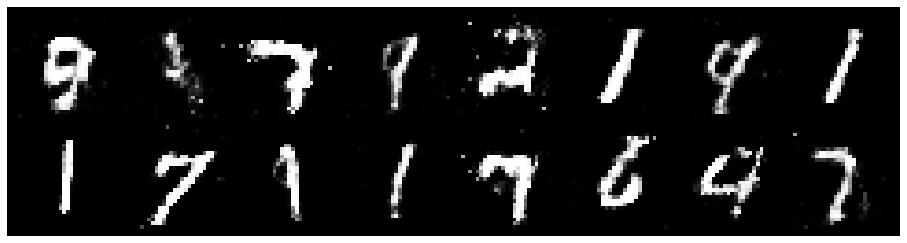

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 0.9411, Generator Loss: 1.3889
D(x): 0.7086, D(G(z)): 0.2944


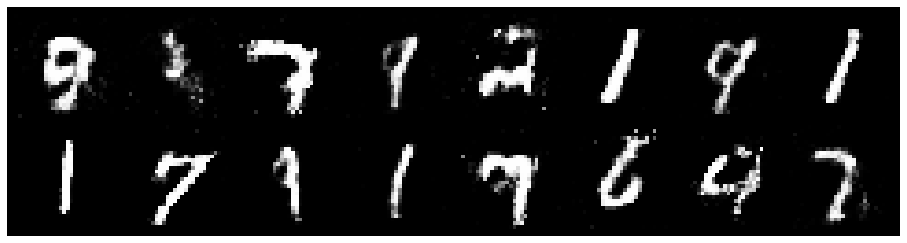

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 0.9056, Generator Loss: 1.4304
D(x): 0.6766, D(G(z)): 0.2676


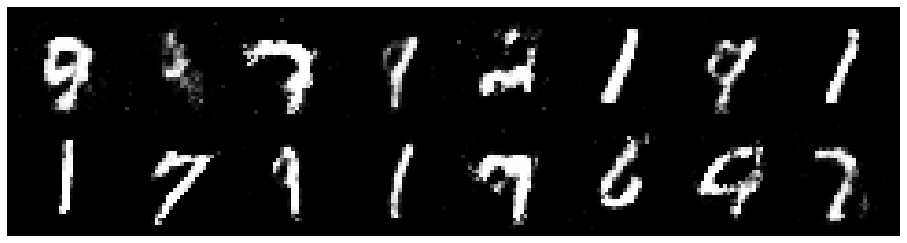

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 0.8094, Generator Loss: 1.2577
D(x): 0.7187, D(G(z)): 0.2752


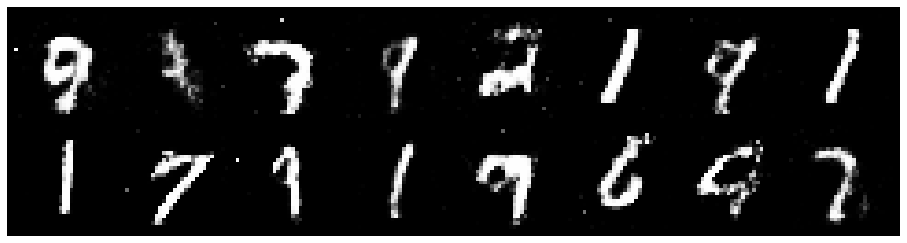

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 0.8539, Generator Loss: 1.6592
D(x): 0.7178, D(G(z)): 0.2837


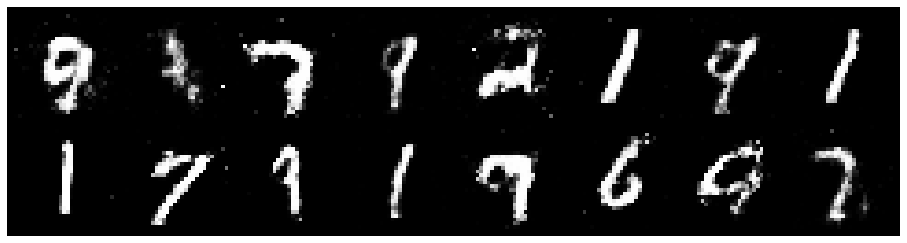

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 0.7794, Generator Loss: 1.4771
D(x): 0.7128, D(G(z)): 0.2626


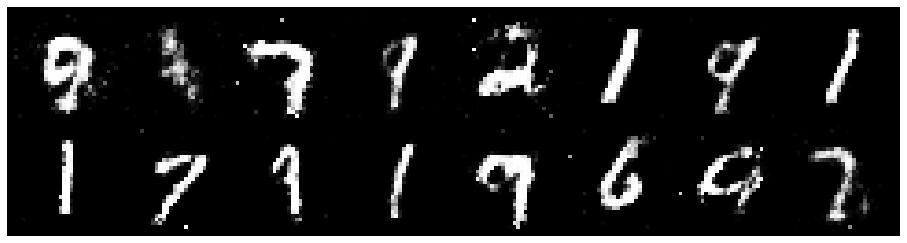

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 0.8148, Generator Loss: 1.8894
D(x): 0.7289, D(G(z)): 0.2787


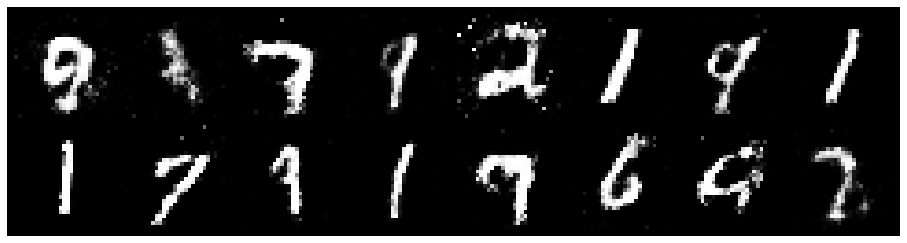

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 0.8702, Generator Loss: 1.5662
D(x): 0.7237, D(G(z)): 0.2820


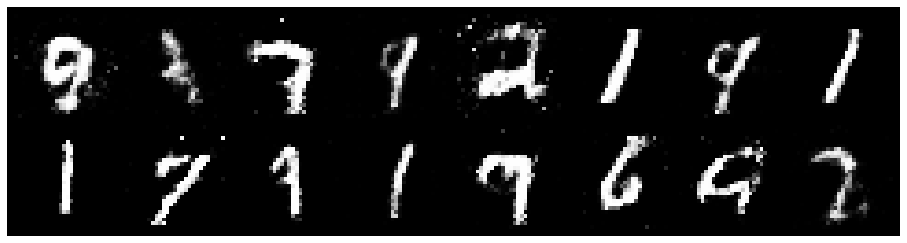

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 0.8813, Generator Loss: 1.5229
D(x): 0.6946, D(G(z)): 0.2729


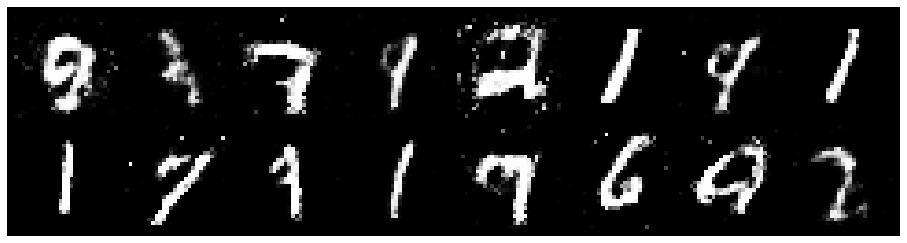

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.1126, Generator Loss: 1.5377
D(x): 0.6190, D(G(z)): 0.2935


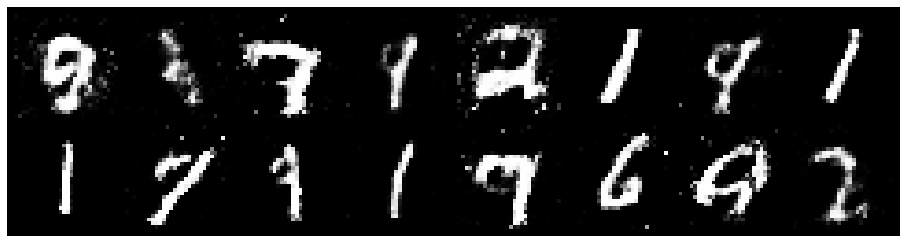

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 0.9000, Generator Loss: 1.6657
D(x): 0.7097, D(G(z)): 0.2914


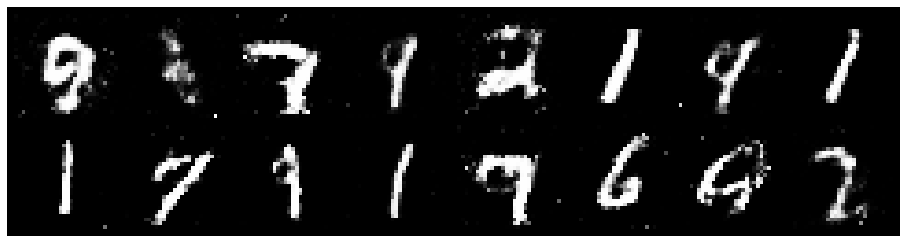

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.1323, Generator Loss: 1.5894
D(x): 0.7112, D(G(z)): 0.3792


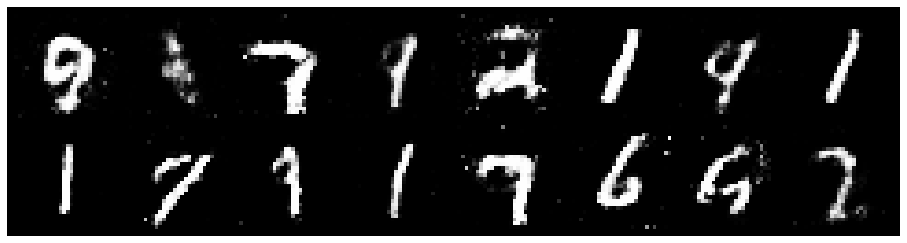

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 0.8213, Generator Loss: 1.3883
D(x): 0.7410, D(G(z)): 0.2925


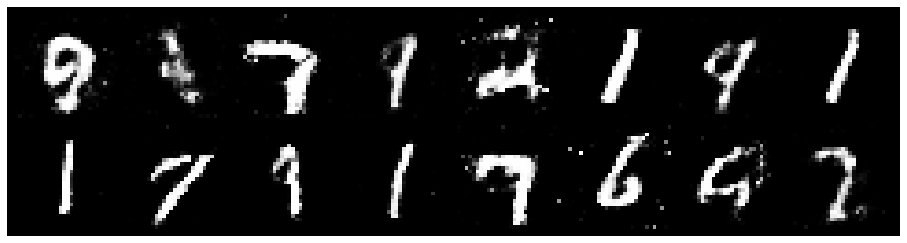

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 0.7569, Generator Loss: 1.8168
D(x): 0.7363, D(G(z)): 0.2377


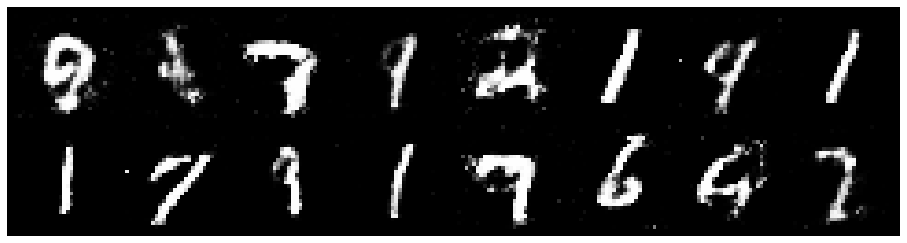

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 0.7056, Generator Loss: 1.8008
D(x): 0.7523, D(G(z)): 0.2360


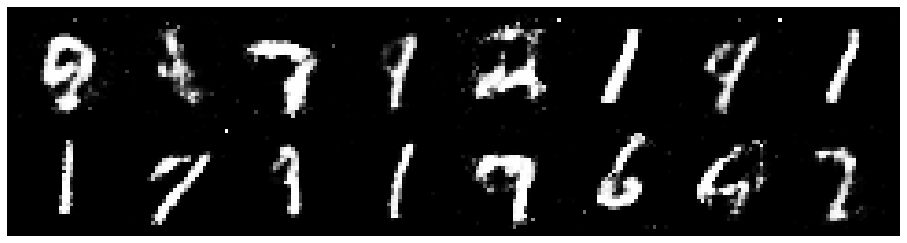

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 0.8362, Generator Loss: 1.7735
D(x): 0.7303, D(G(z)): 0.2794


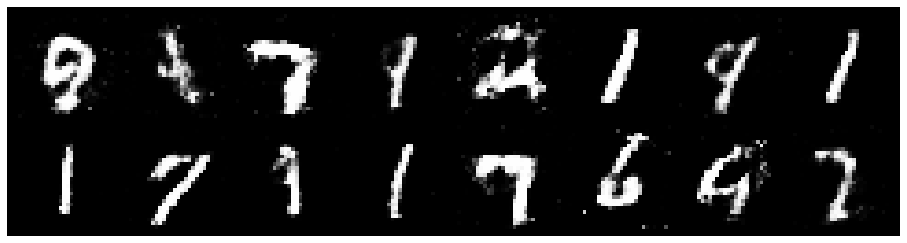

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.0039, Generator Loss: 1.6634
D(x): 0.7026, D(G(z)): 0.3013


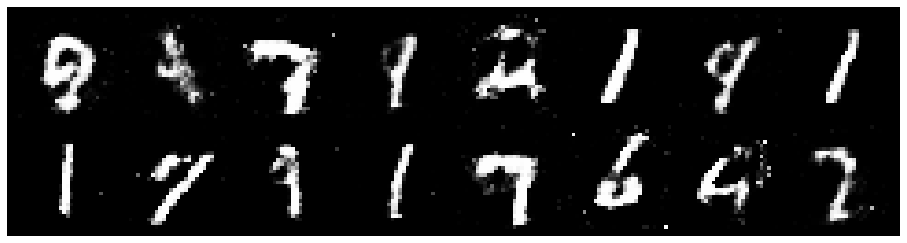

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 0.8013, Generator Loss: 1.3894
D(x): 0.7208, D(G(z)): 0.2742


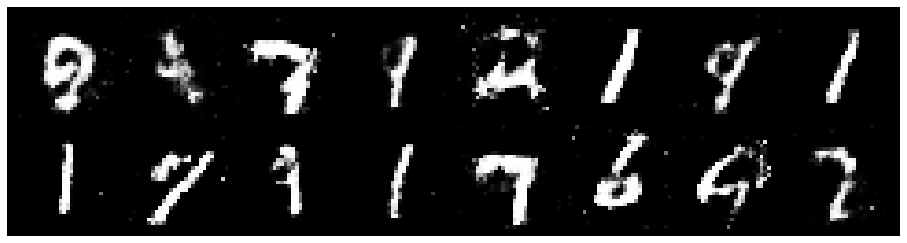

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 0.7975, Generator Loss: 1.6027
D(x): 0.7017, D(G(z)): 0.2482


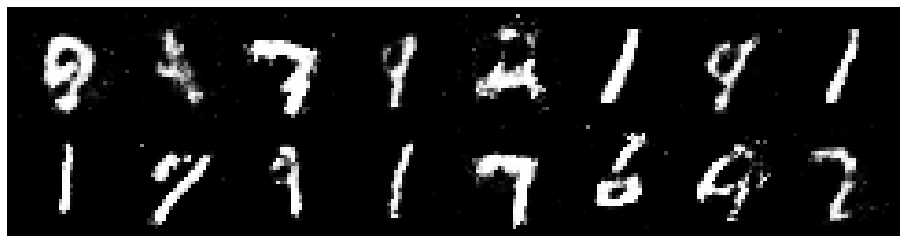

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.0171, Generator Loss: 1.4650
D(x): 0.6911, D(G(z)): 0.3398


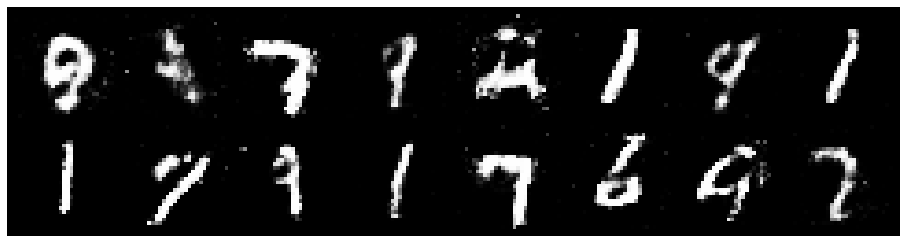

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 0.9574, Generator Loss: 1.5346
D(x): 0.6886, D(G(z)): 0.3067


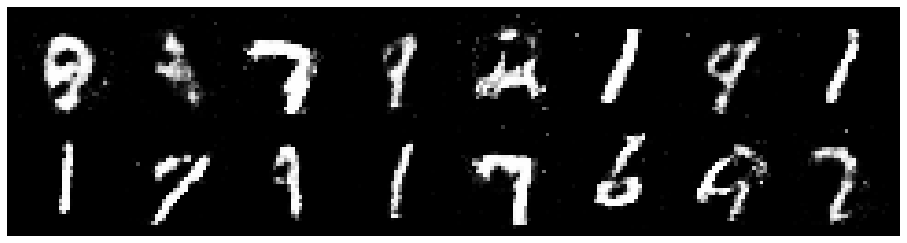

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 0.8297, Generator Loss: 1.4520
D(x): 0.6749, D(G(z)): 0.2439


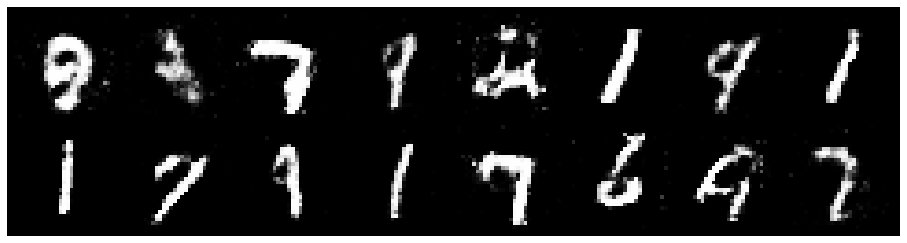

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 0.6975, Generator Loss: 1.4616
D(x): 0.7989, D(G(z)): 0.2902


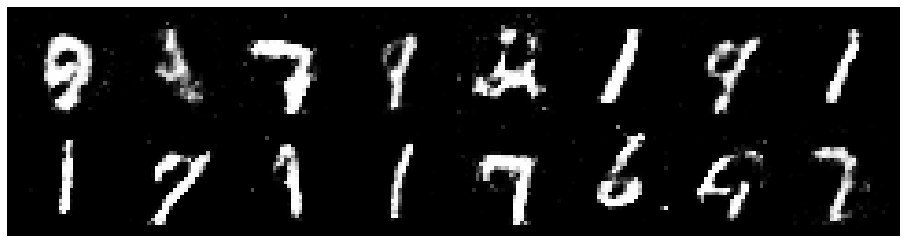

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 0.8272, Generator Loss: 1.4954
D(x): 0.7303, D(G(z)): 0.2829


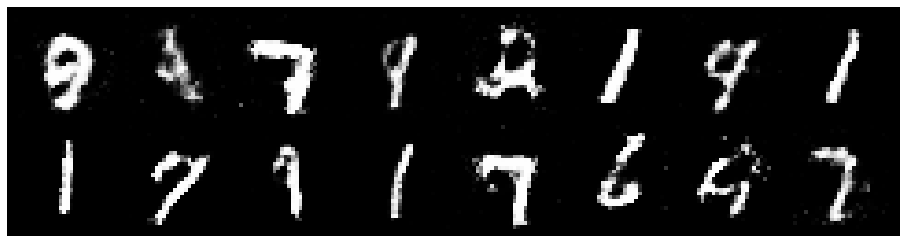

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 0.9103, Generator Loss: 1.5385
D(x): 0.7145, D(G(z)): 0.3187


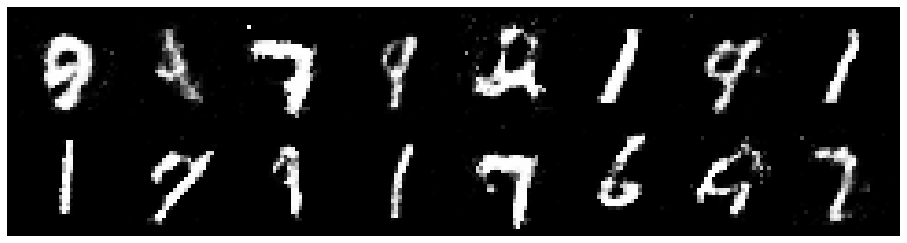

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 0.8808, Generator Loss: 1.4642
D(x): 0.7485, D(G(z)): 0.3249


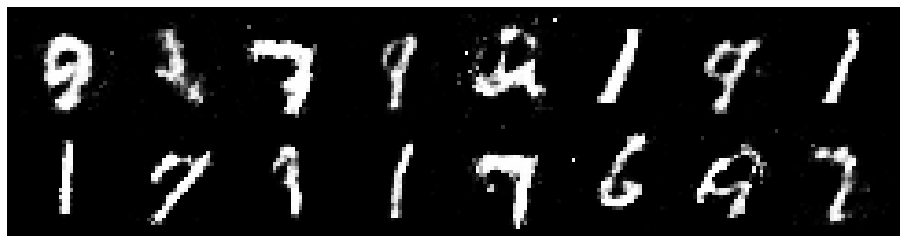

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 0.7617, Generator Loss: 1.6687
D(x): 0.7433, D(G(z)): 0.2718


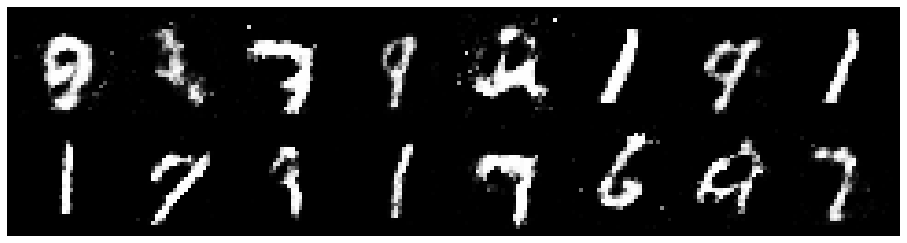

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 0.6573, Generator Loss: 1.3587
D(x): 0.8007, D(G(z)): 0.2772


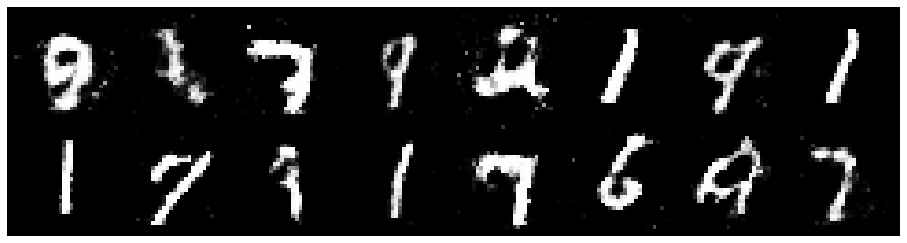

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 0.9307, Generator Loss: 1.8423
D(x): 0.6694, D(G(z)): 0.2140


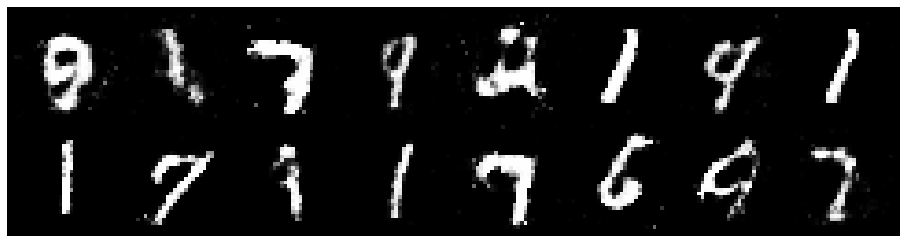

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 0.8445, Generator Loss: 1.5860
D(x): 0.7097, D(G(z)): 0.2582


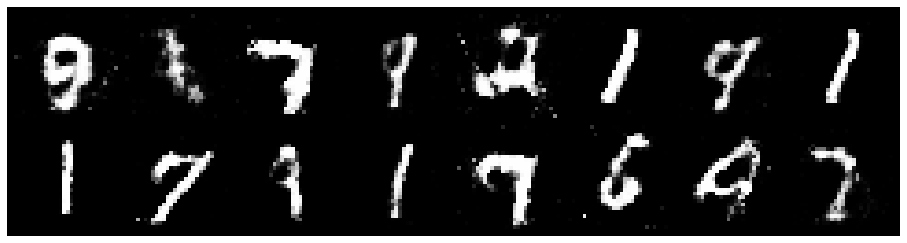

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.0417, Generator Loss: 1.6562
D(x): 0.7285, D(G(z)): 0.3364


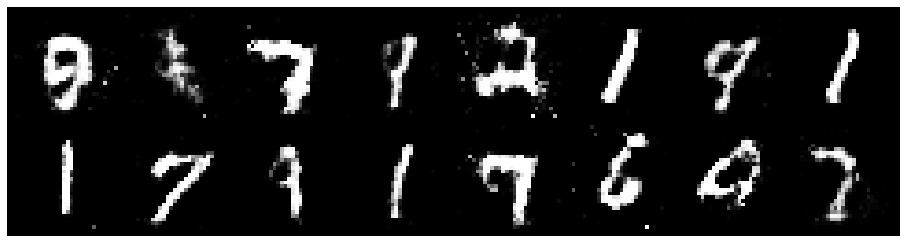

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 0.8347, Generator Loss: 1.5062
D(x): 0.7277, D(G(z)): 0.3011


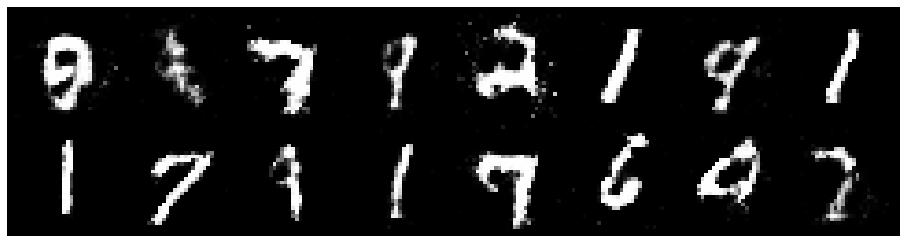

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 0.8787, Generator Loss: 1.4485
D(x): 0.7595, D(G(z)): 0.2979


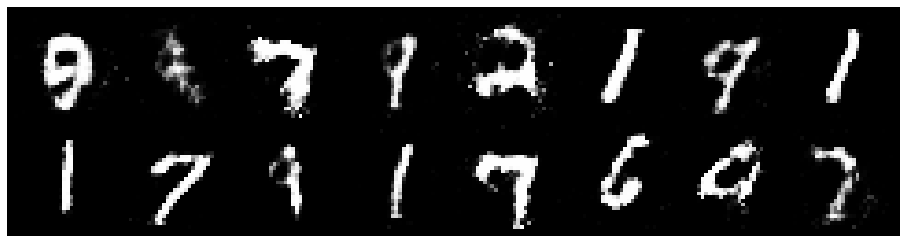

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.0456, Generator Loss: 1.6430
D(x): 0.6376, D(G(z)): 0.2836


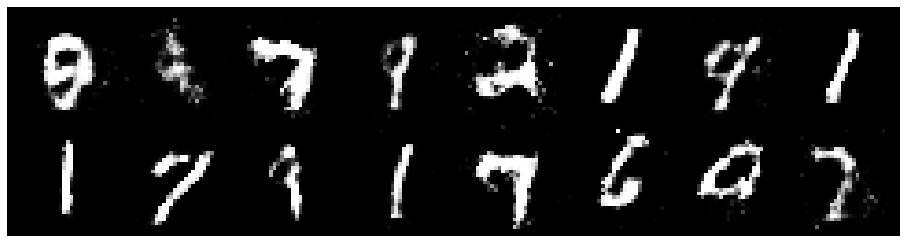

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 0.9935, Generator Loss: 1.4216
D(x): 0.6431, D(G(z)): 0.2775


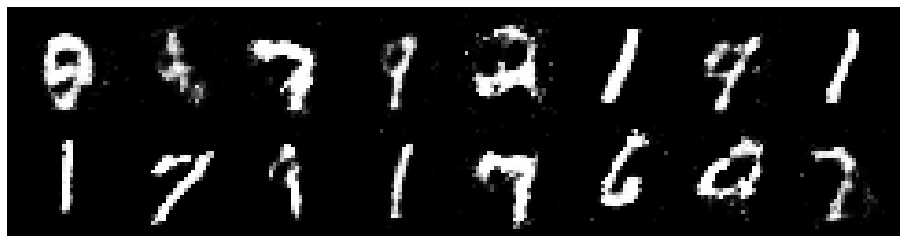

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 0.9156, Generator Loss: 1.4733
D(x): 0.7054, D(G(z)): 0.2862


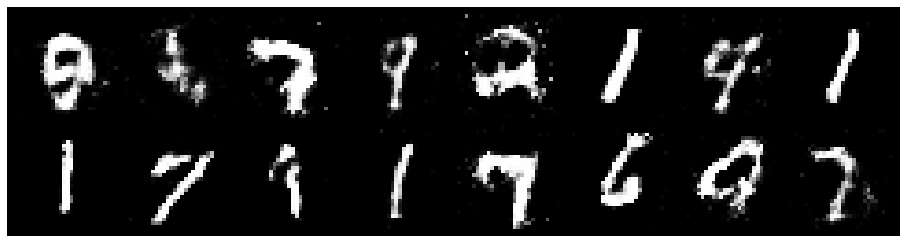

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.0371, Generator Loss: 1.5132
D(x): 0.6388, D(G(z)): 0.2955


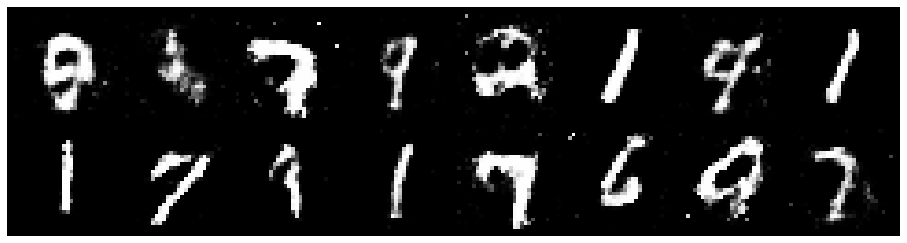

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 0.8859, Generator Loss: 1.5258
D(x): 0.7012, D(G(z)): 0.2595


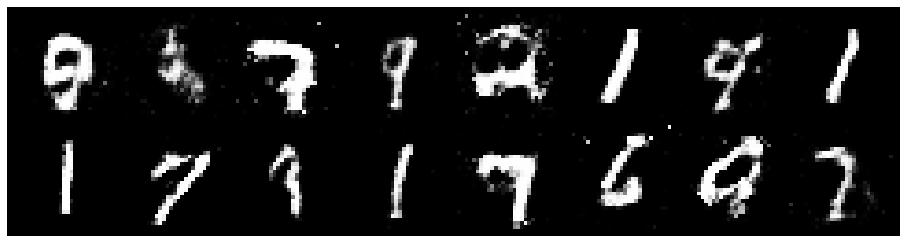

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 0.7707, Generator Loss: 1.6393
D(x): 0.7236, D(G(z)): 0.2408


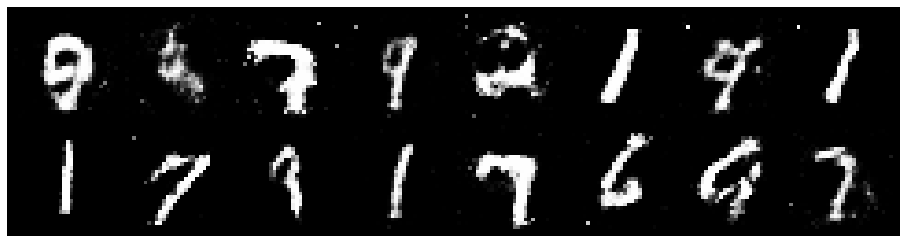

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 0.9268, Generator Loss: 1.5942
D(x): 0.6909, D(G(z)): 0.2892


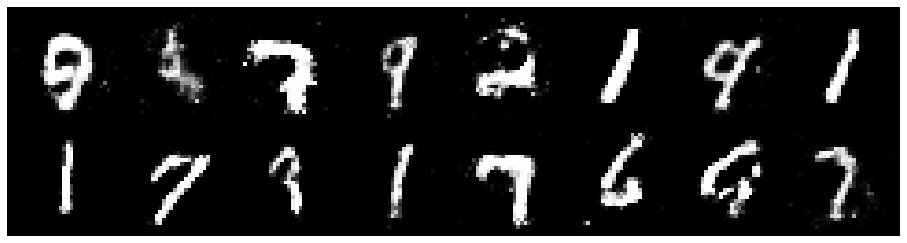

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 0.9702, Generator Loss: 1.4971
D(x): 0.6850, D(G(z)): 0.3312


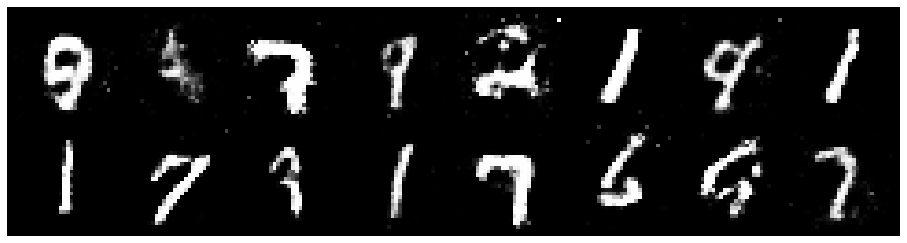

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 0.9048, Generator Loss: 1.2177
D(x): 0.7255, D(G(z)): 0.3262


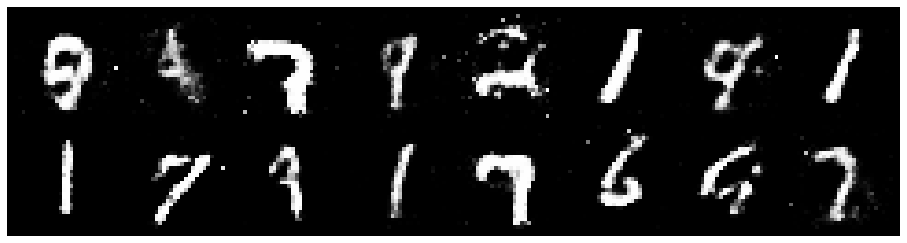

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 0.7933, Generator Loss: 1.6016
D(x): 0.7406, D(G(z)): 0.2820


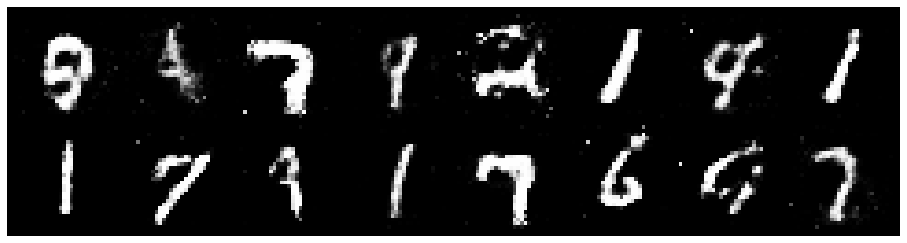

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 0.8098, Generator Loss: 1.4999
D(x): 0.7387, D(G(z)): 0.2799


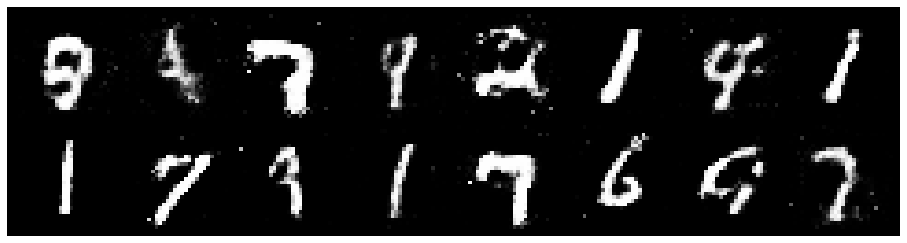

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 0.9529, Generator Loss: 1.2381
D(x): 0.6880, D(G(z)): 0.2994


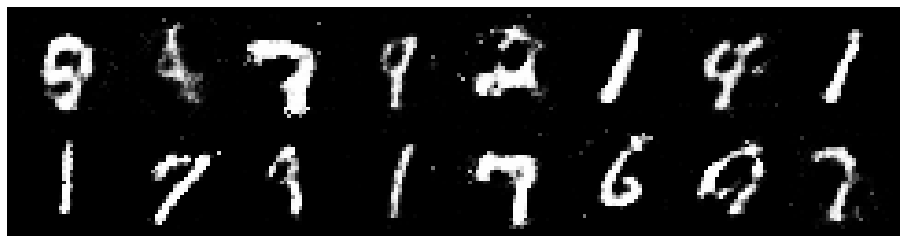

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 0.8617, Generator Loss: 1.4921
D(x): 0.6976, D(G(z)): 0.2765


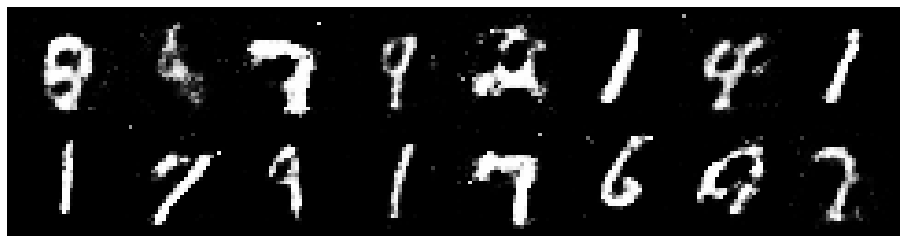

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 0.8967, Generator Loss: 1.5533
D(x): 0.7661, D(G(z)): 0.3207


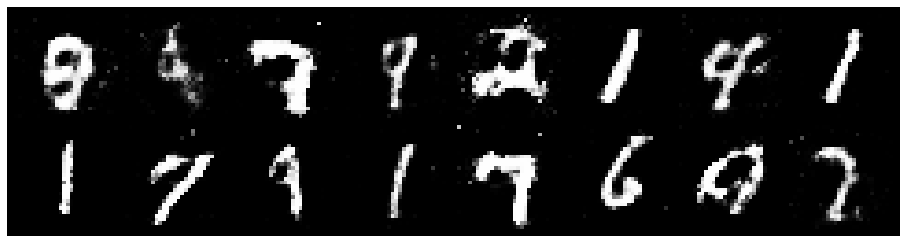

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 0.9039, Generator Loss: 1.5258
D(x): 0.7115, D(G(z)): 0.2939


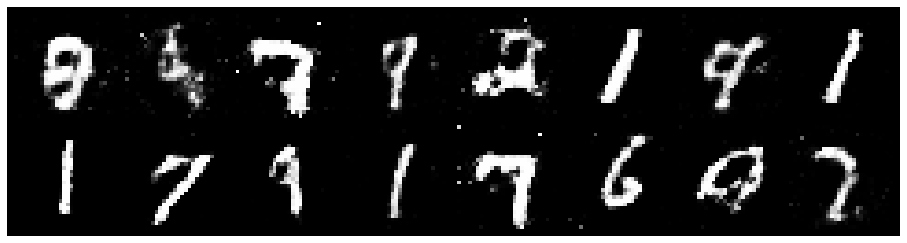

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 0.9100, Generator Loss: 1.6043
D(x): 0.7037, D(G(z)): 0.2826


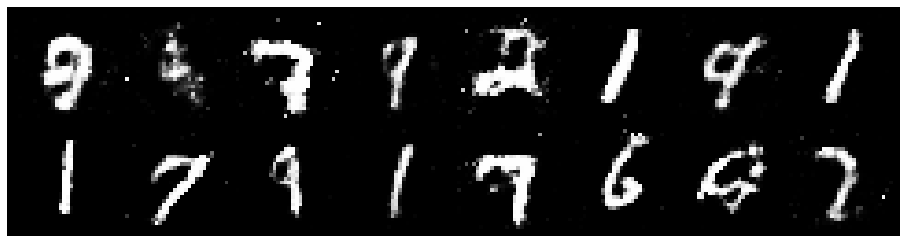

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 0.7932, Generator Loss: 1.6509
D(x): 0.7291, D(G(z)): 0.2588


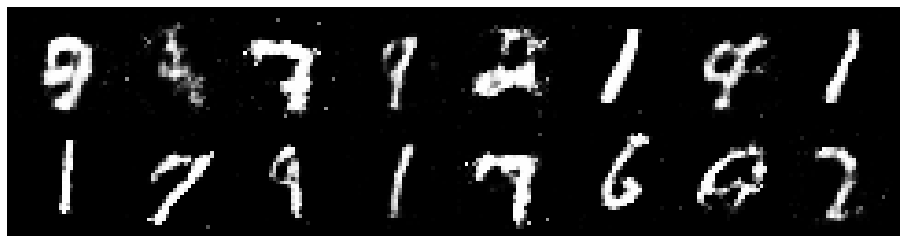

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 0.7896, Generator Loss: 1.6713
D(x): 0.7117, D(G(z)): 0.2519


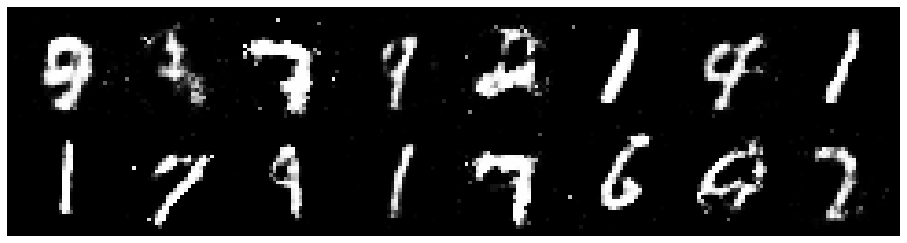

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 0.9262, Generator Loss: 1.5621
D(x): 0.6892, D(G(z)): 0.2933


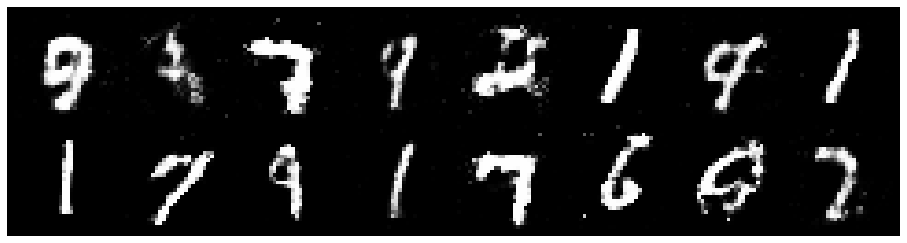

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.0404, Generator Loss: 1.4201
D(x): 0.7286, D(G(z)): 0.3691


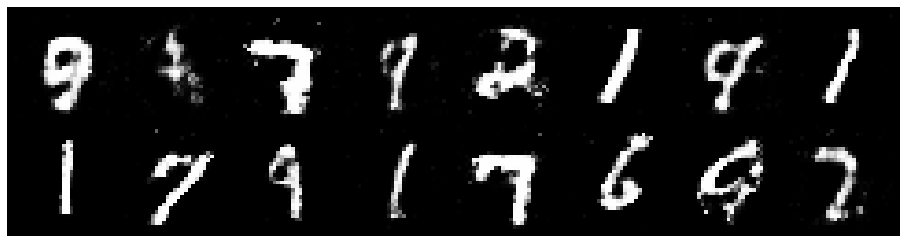

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 0.8059, Generator Loss: 1.6209
D(x): 0.7423, D(G(z)): 0.2766


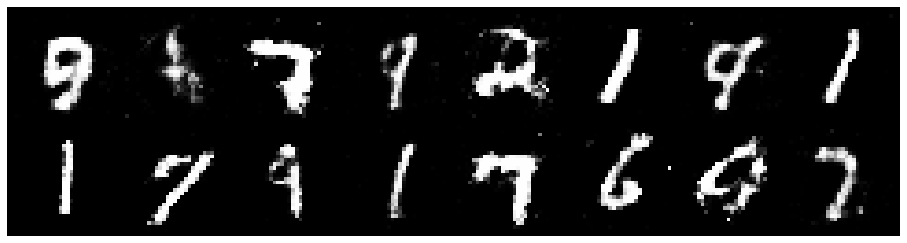

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 0.8306, Generator Loss: 1.4305
D(x): 0.7452, D(G(z)): 0.2832


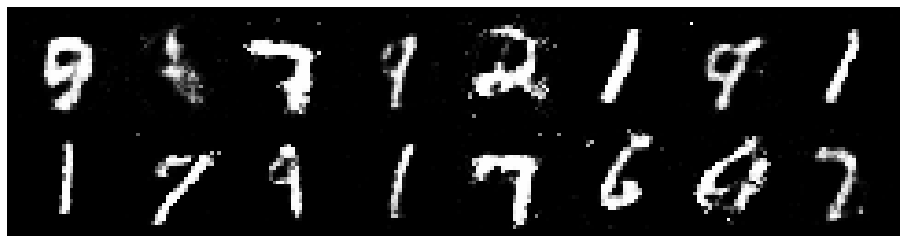

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 0.7639, Generator Loss: 1.3985
D(x): 0.7825, D(G(z)): 0.3059


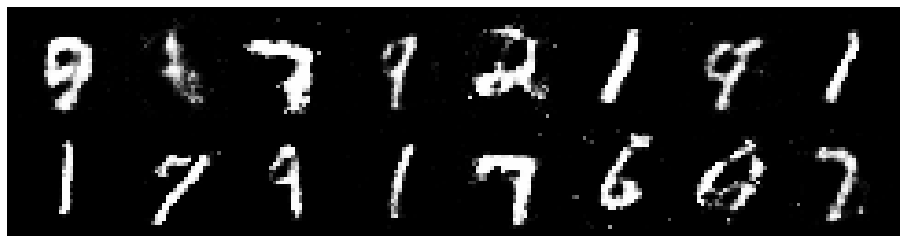

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 0.8268, Generator Loss: 1.5752
D(x): 0.7406, D(G(z)): 0.3031


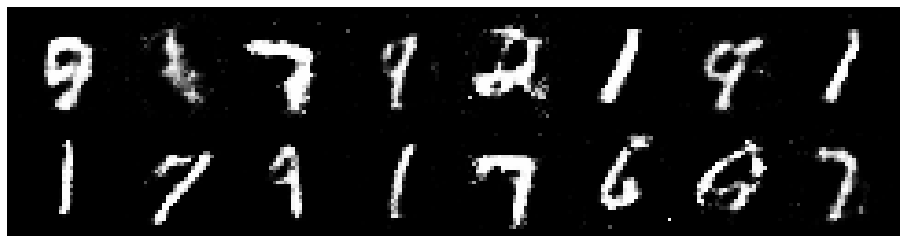

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 0.9159, Generator Loss: 1.7257
D(x): 0.6868, D(G(z)): 0.2725


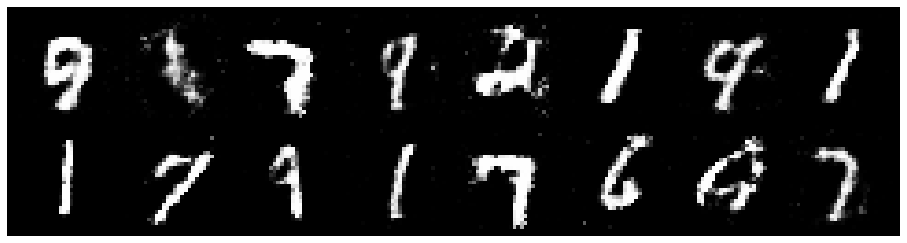

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 0.8811, Generator Loss: 1.4880
D(x): 0.6953, D(G(z)): 0.2666


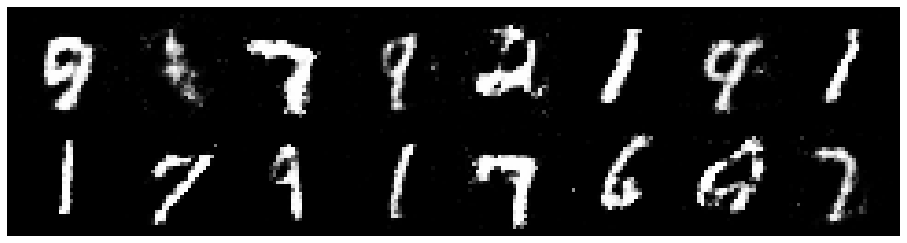

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 0.9681, Generator Loss: 1.7151
D(x): 0.7116, D(G(z)): 0.3496


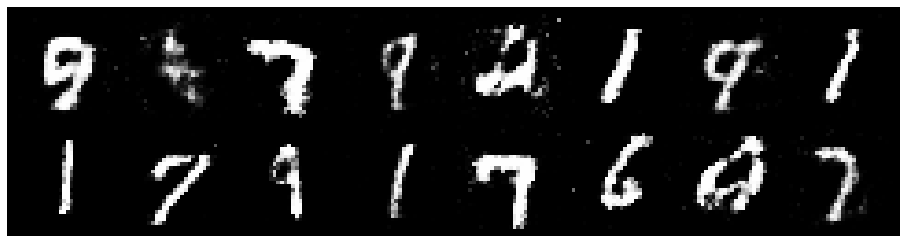

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 0.8122, Generator Loss: 1.8146
D(x): 0.7127, D(G(z)): 0.2514


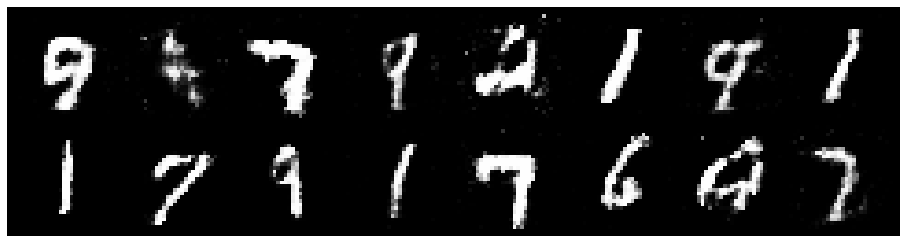

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 0.9254, Generator Loss: 1.5468
D(x): 0.7327, D(G(z)): 0.3430


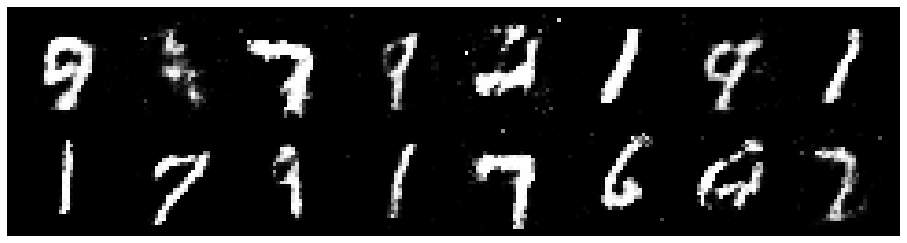

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 0.8316, Generator Loss: 1.5541
D(x): 0.7445, D(G(z)): 0.2879


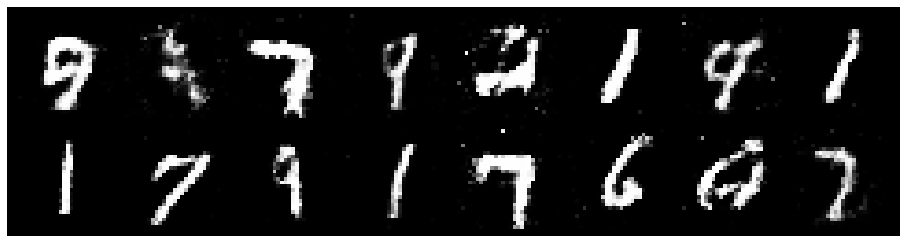

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 0.9195, Generator Loss: 1.5725
D(x): 0.6792, D(G(z)): 0.2534


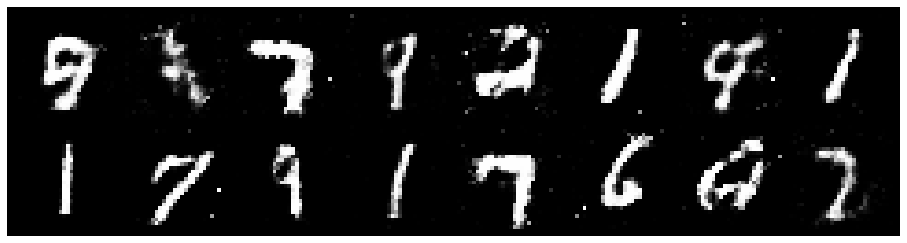

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 0.8462, Generator Loss: 1.5238
D(x): 0.7126, D(G(z)): 0.2798


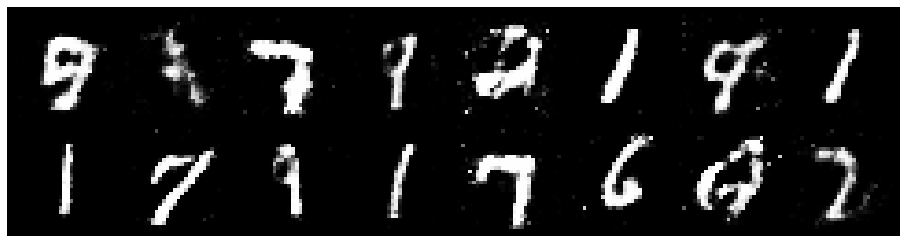

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 0.9088, Generator Loss: 1.6862
D(x): 0.6545, D(G(z)): 0.2694


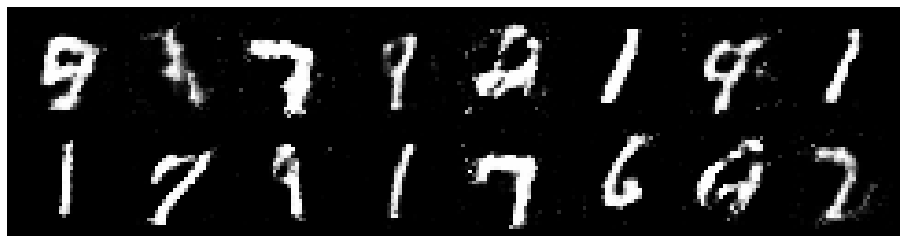

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 0.8798, Generator Loss: 1.4337
D(x): 0.7397, D(G(z)): 0.3353


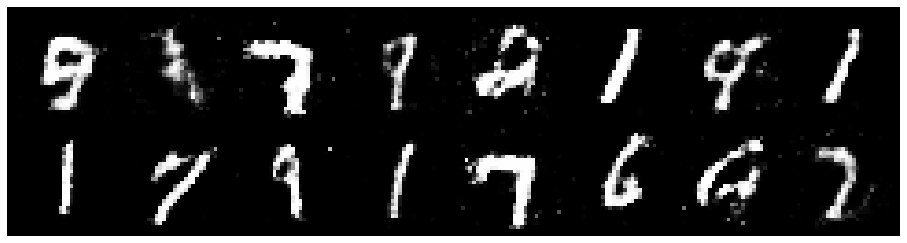

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 0.7870, Generator Loss: 1.5059
D(x): 0.7429, D(G(z)): 0.2856


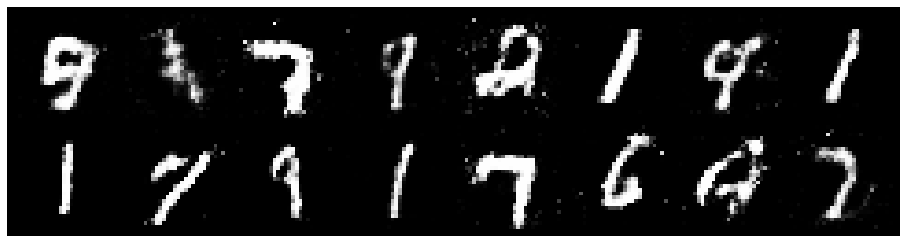

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 0.9267, Generator Loss: 1.6234
D(x): 0.6184, D(G(z)): 0.2122


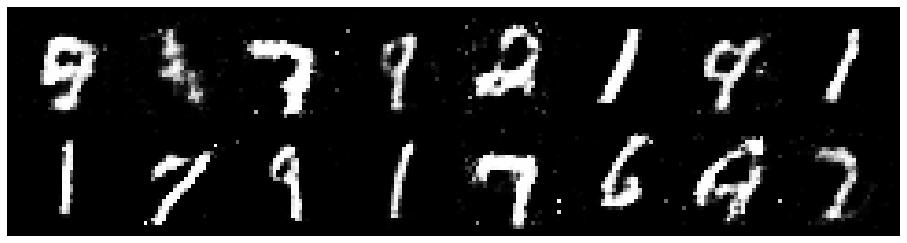

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 0.9585, Generator Loss: 1.2013
D(x): 0.7160, D(G(z)): 0.3306


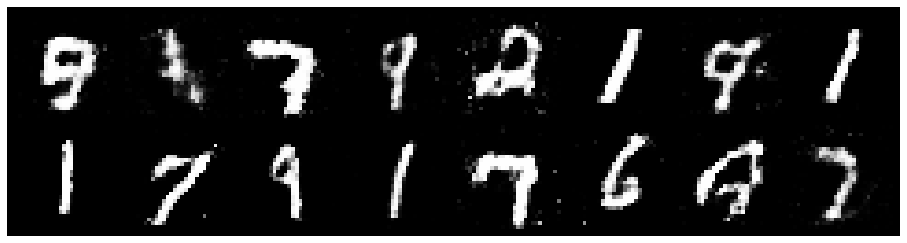

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 0.9085, Generator Loss: 1.5964
D(x): 0.6548, D(G(z)): 0.2577


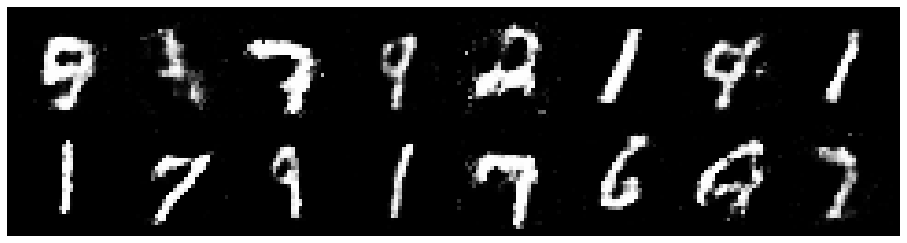

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 0.9884, Generator Loss: 1.4073
D(x): 0.6788, D(G(z)): 0.3263


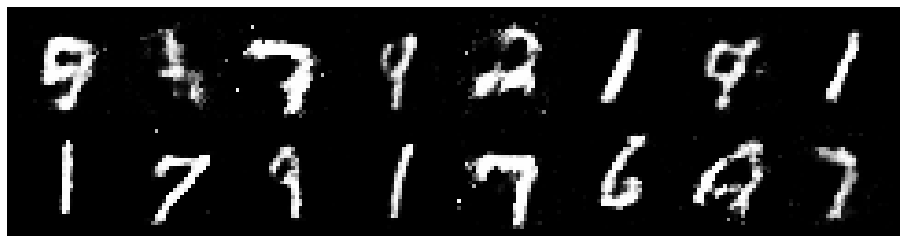

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 0.8675, Generator Loss: 1.4118
D(x): 0.7568, D(G(z)): 0.3455


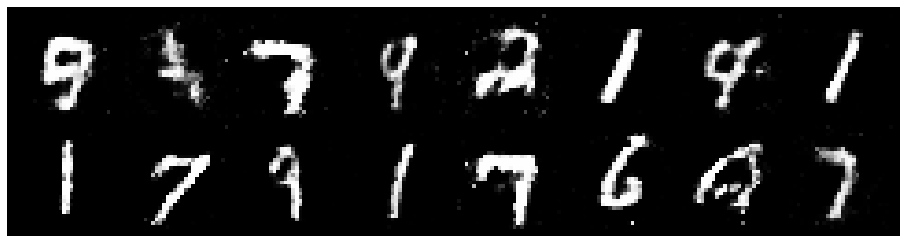

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 0.9702, Generator Loss: 1.4940
D(x): 0.6568, D(G(z)): 0.2975


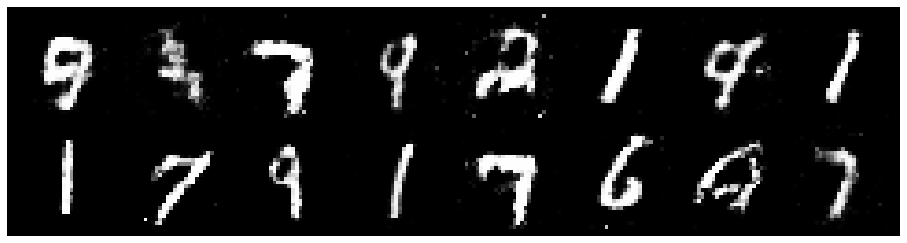

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 0.9806, Generator Loss: 1.1664
D(x): 0.7238, D(G(z)): 0.3776


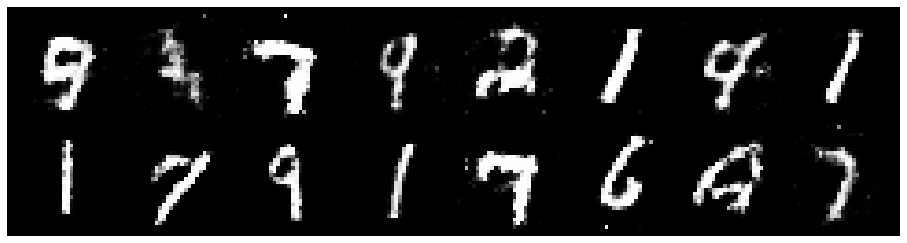

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.0110, Generator Loss: 1.3806
D(x): 0.7000, D(G(z)): 0.3656


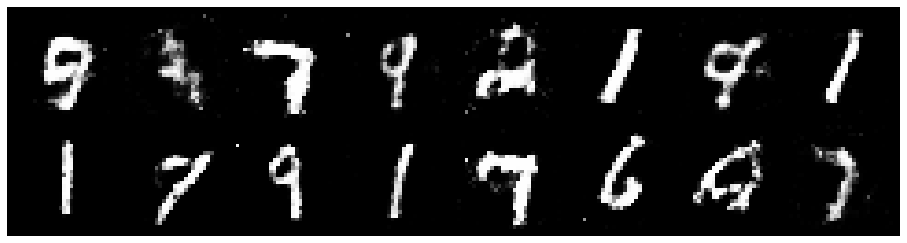

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 0.8142, Generator Loss: 1.5032
D(x): 0.6843, D(G(z)): 0.2553


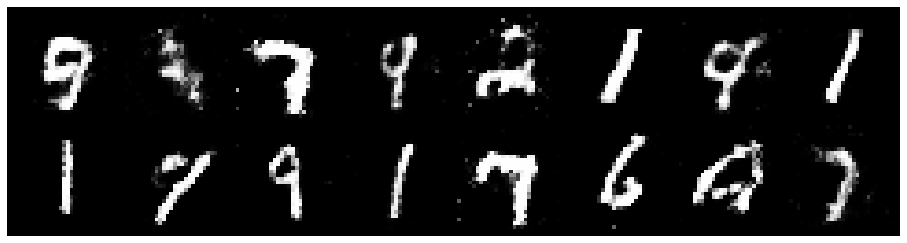

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 0.8817, Generator Loss: 1.1933
D(x): 0.7375, D(G(z)): 0.3302


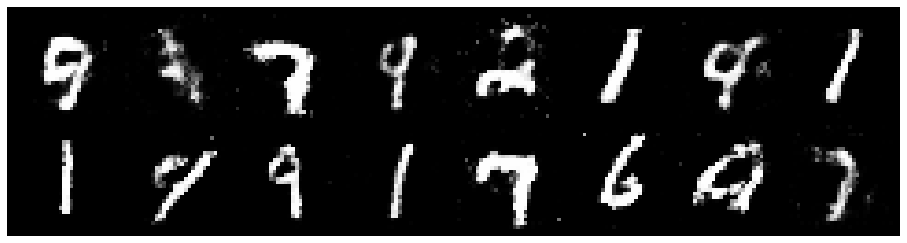

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 0.9868, Generator Loss: 1.4044
D(x): 0.6309, D(G(z)): 0.2564


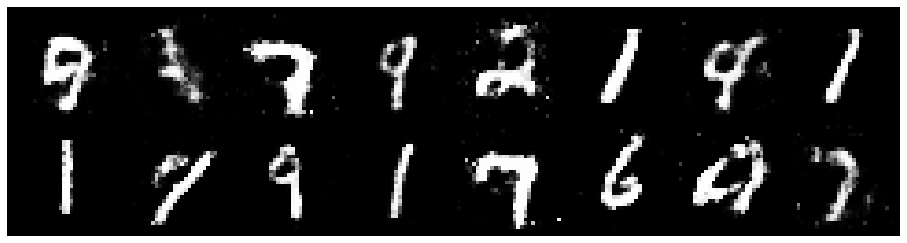

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 0.7814, Generator Loss: 1.5369
D(x): 0.7151, D(G(z)): 0.2572


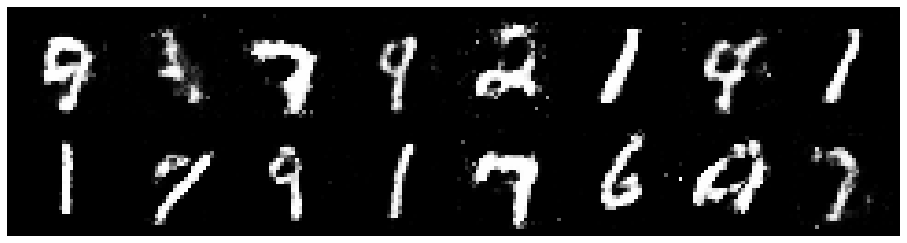

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 0.9303, Generator Loss: 1.4257
D(x): 0.6889, D(G(z)): 0.3095


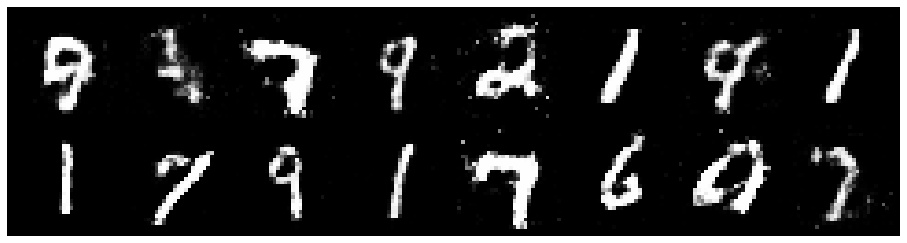

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 0.8936, Generator Loss: 1.4316
D(x): 0.6891, D(G(z)): 0.3066


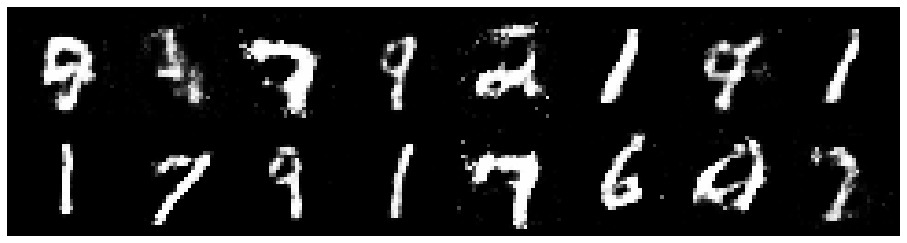

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.0192, Generator Loss: 1.6215
D(x): 0.6497, D(G(z)): 0.2771


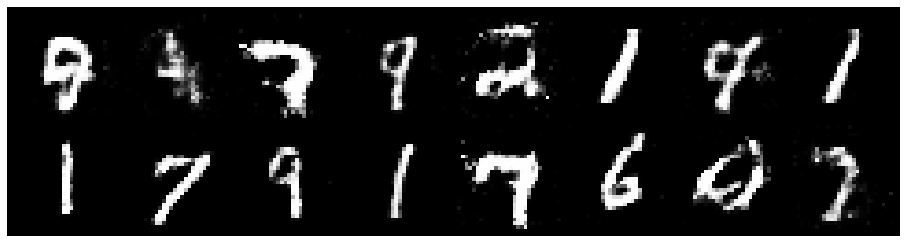

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 0.9670, Generator Loss: 1.1631
D(x): 0.7240, D(G(z)): 0.3835


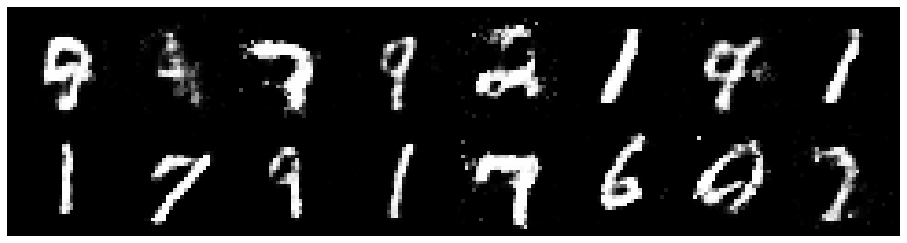

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 0.8621, Generator Loss: 1.7247
D(x): 0.7465, D(G(z)): 0.3055


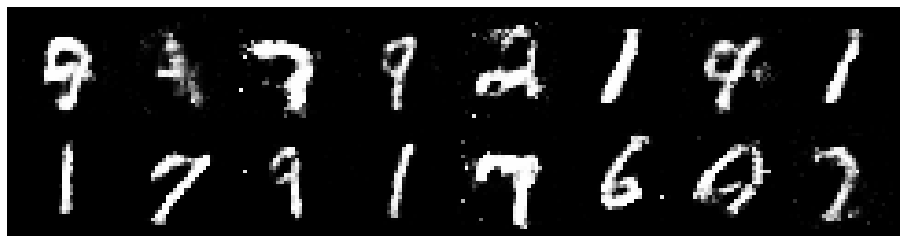

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 0.7777, Generator Loss: 1.3854
D(x): 0.7477, D(G(z)): 0.3061


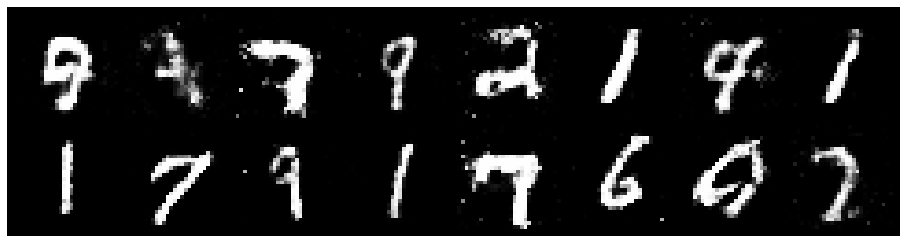

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 0.8639, Generator Loss: 1.3991
D(x): 0.7158, D(G(z)): 0.2804


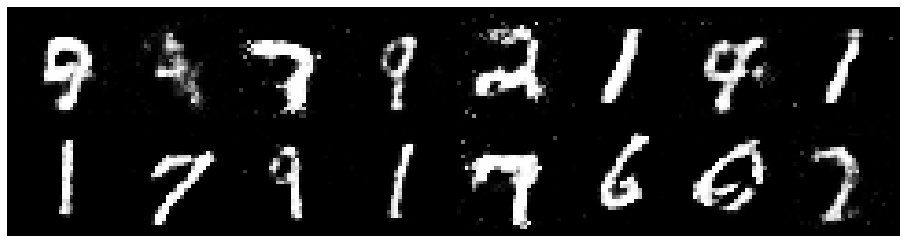

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.0401, Generator Loss: 1.5033
D(x): 0.6742, D(G(z)): 0.3450


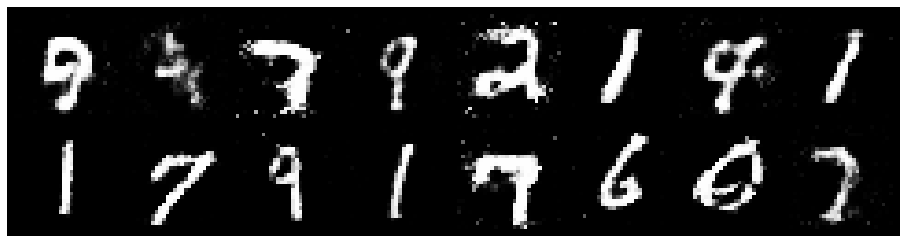

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 0.9931, Generator Loss: 1.3299
D(x): 0.6343, D(G(z)): 0.2691


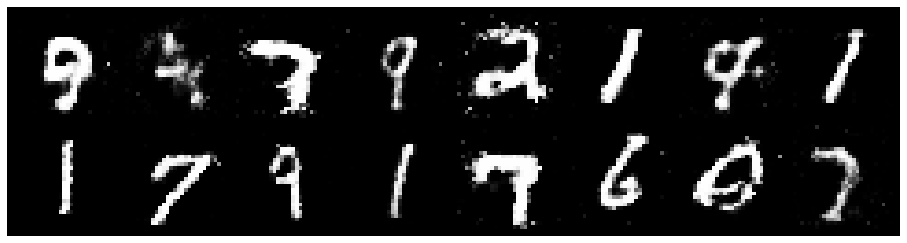

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.0168, Generator Loss: 1.1522
D(x): 0.7094, D(G(z)): 0.3580


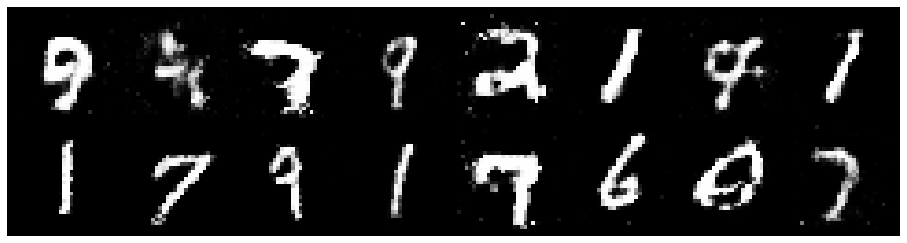

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.0262, Generator Loss: 1.2739
D(x): 0.6947, D(G(z)): 0.3618


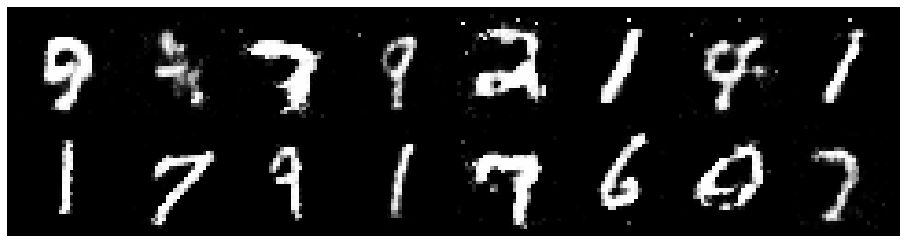

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 0.9728, Generator Loss: 1.4727
D(x): 0.6851, D(G(z)): 0.3174


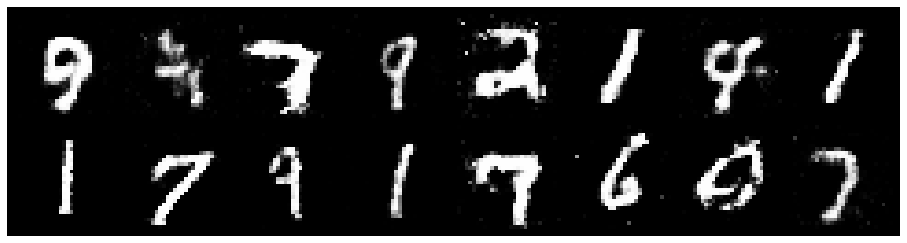

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 0.9519, Generator Loss: 1.5590
D(x): 0.6738, D(G(z)): 0.3031


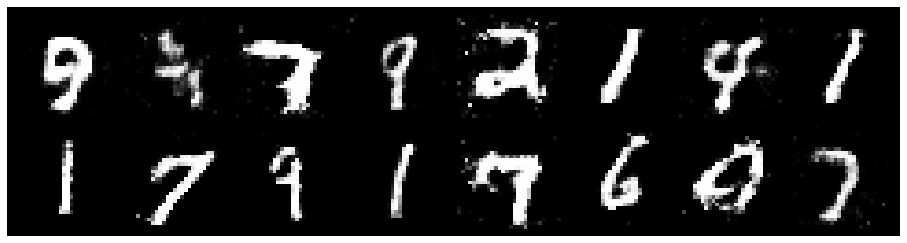

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 0.9293, Generator Loss: 1.5194
D(x): 0.7415, D(G(z)): 0.3633


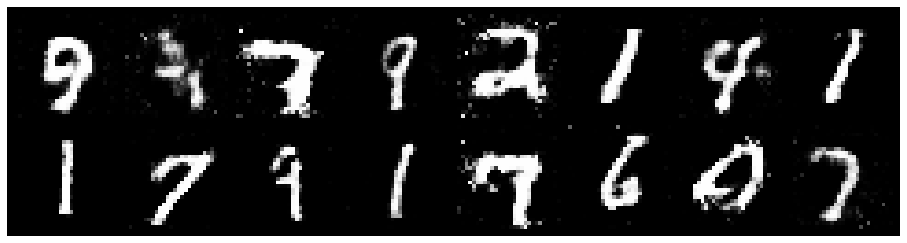

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.1079, Generator Loss: 1.7077
D(x): 0.6152, D(G(z)): 0.2827


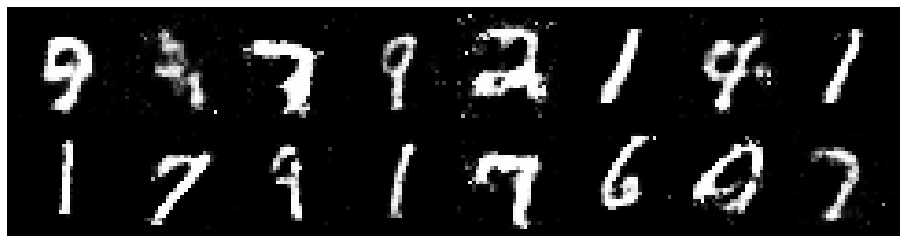

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 0.8473, Generator Loss: 1.2482
D(x): 0.6791, D(G(z)): 0.2736


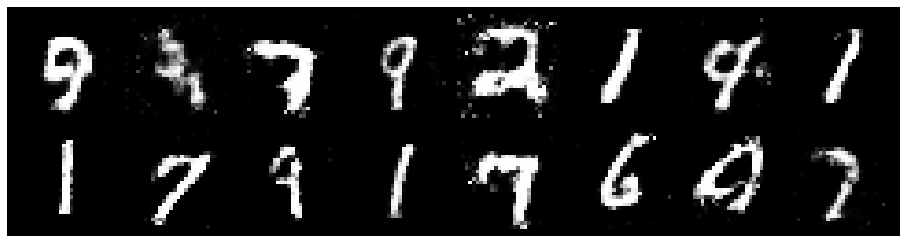

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 0.8215, Generator Loss: 1.3079
D(x): 0.7151, D(G(z)): 0.2836


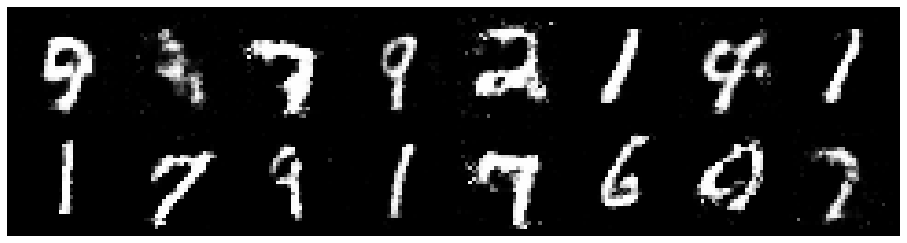

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 0.8459, Generator Loss: 1.5579
D(x): 0.6845, D(G(z)): 0.2497


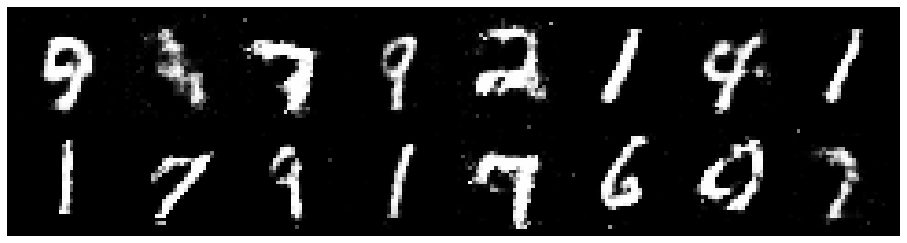

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 0.9571, Generator Loss: 1.4693
D(x): 0.7235, D(G(z)): 0.3133


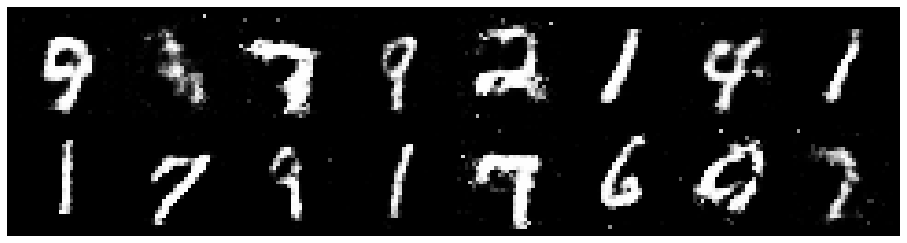

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 0.9349, Generator Loss: 1.5987
D(x): 0.6425, D(G(z)): 0.2533


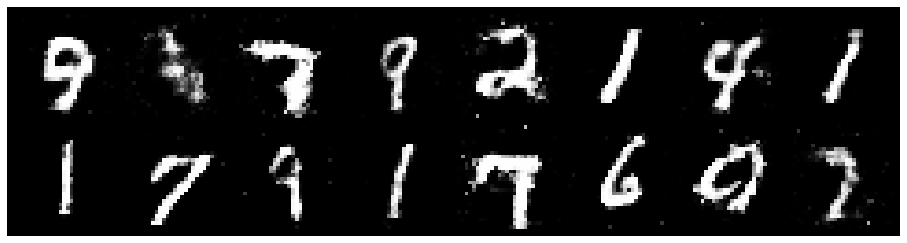

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 0.8961, Generator Loss: 1.7518
D(x): 0.7193, D(G(z)): 0.2989


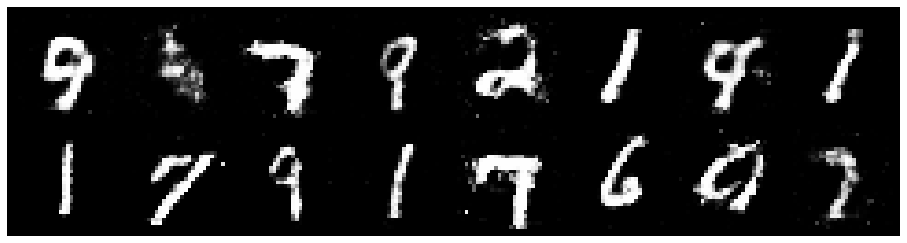

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 0.9453, Generator Loss: 1.3831
D(x): 0.7216, D(G(z)): 0.3460


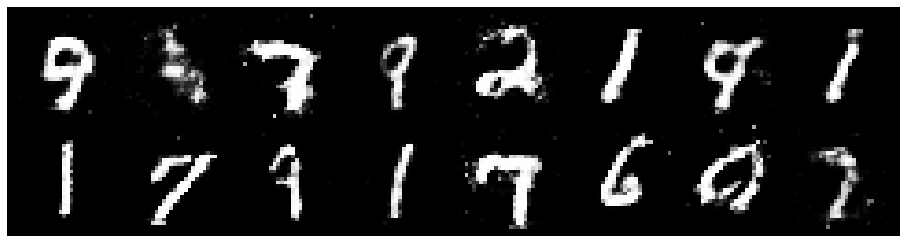

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 0.9033, Generator Loss: 1.5284
D(x): 0.7044, D(G(z)): 0.3167


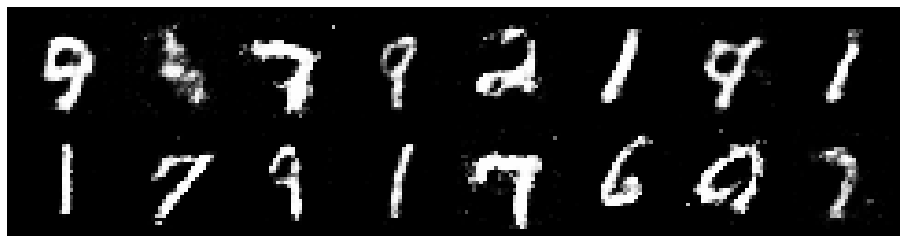

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 0.7902, Generator Loss: 1.5086
D(x): 0.7091, D(G(z)): 0.2508


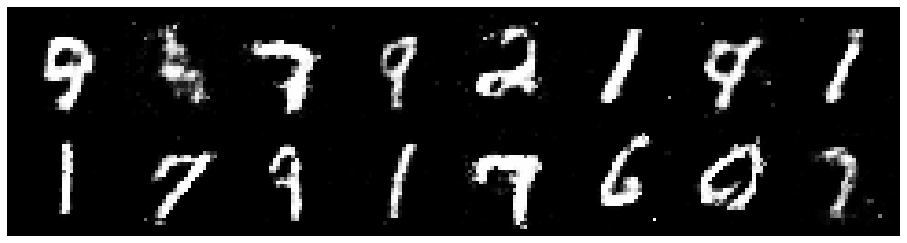

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 0.8617, Generator Loss: 1.1100
D(x): 0.7481, D(G(z)): 0.3290


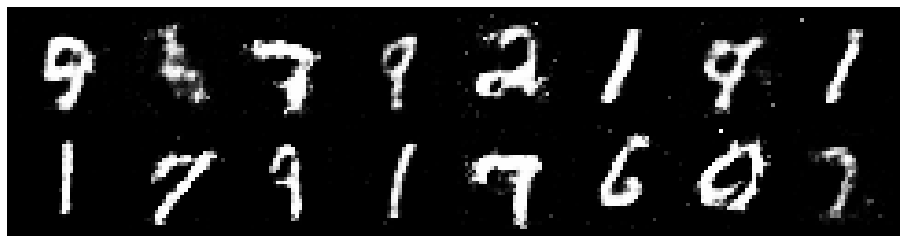

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.0434, Generator Loss: 1.2675
D(x): 0.7229, D(G(z)): 0.4206


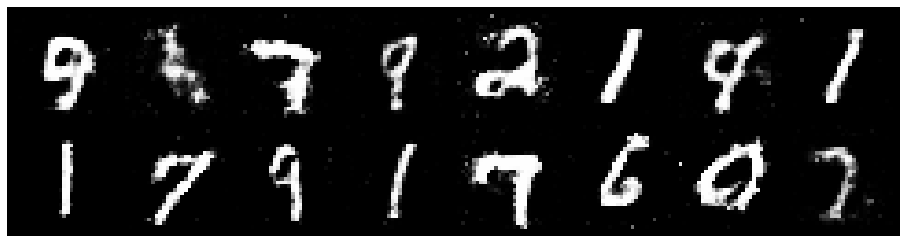

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 0.9512, Generator Loss: 1.2645
D(x): 0.7551, D(G(z)): 0.3825


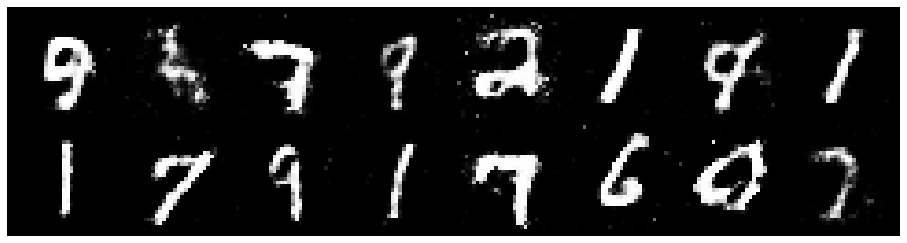

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.1010, Generator Loss: 1.4151
D(x): 0.5877, D(G(z)): 0.2868


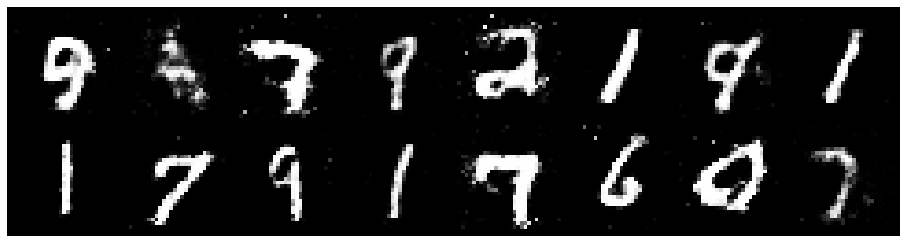

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.0105, Generator Loss: 1.2989
D(x): 0.6729, D(G(z)): 0.3407


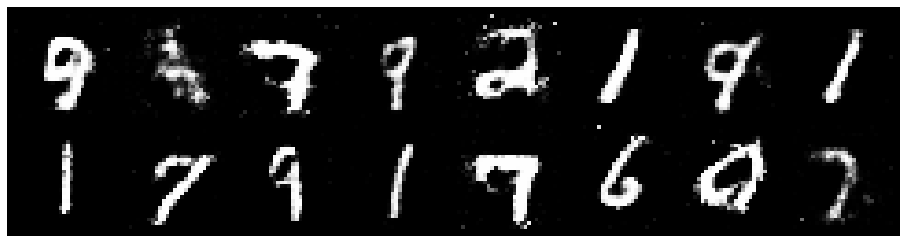

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 0.9982, Generator Loss: 1.4214
D(x): 0.6485, D(G(z)): 0.2958


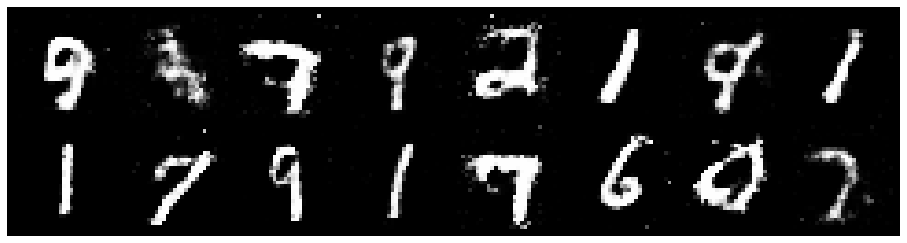

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 0.8800, Generator Loss: 1.6543
D(x): 0.7235, D(G(z)): 0.3336


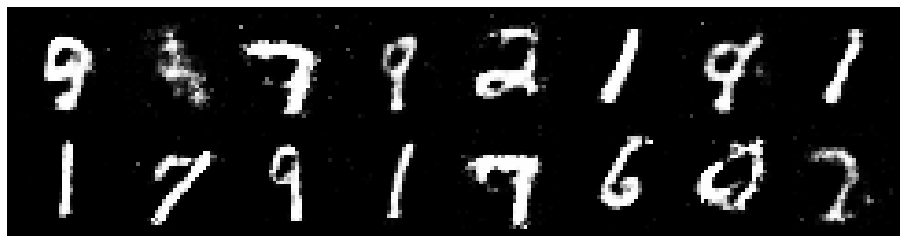

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.0180, Generator Loss: 1.2932
D(x): 0.7470, D(G(z)): 0.3858


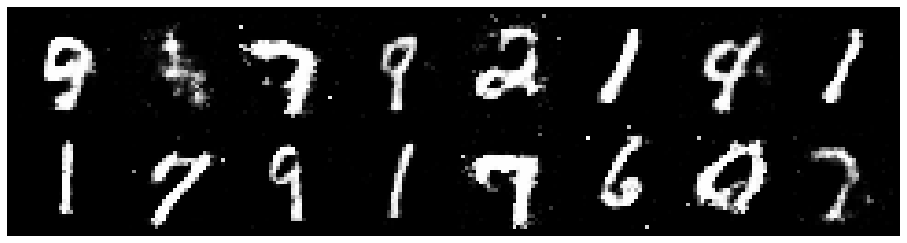

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 0.9558, Generator Loss: 1.5698
D(x): 0.6741, D(G(z)): 0.2850


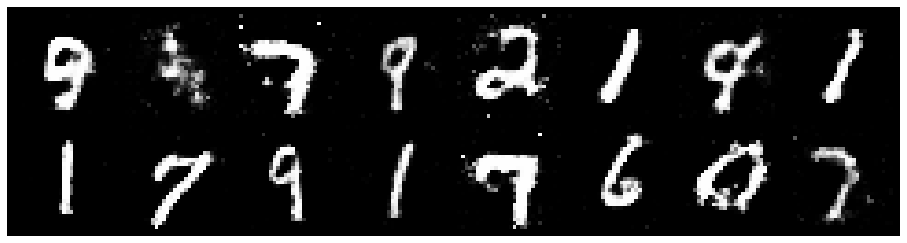

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.0960, Generator Loss: 1.1879
D(x): 0.6591, D(G(z)): 0.3768


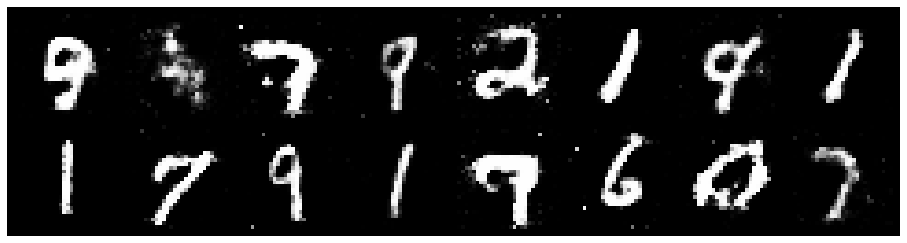

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 0.9249, Generator Loss: 1.3947
D(x): 0.6994, D(G(z)): 0.3344


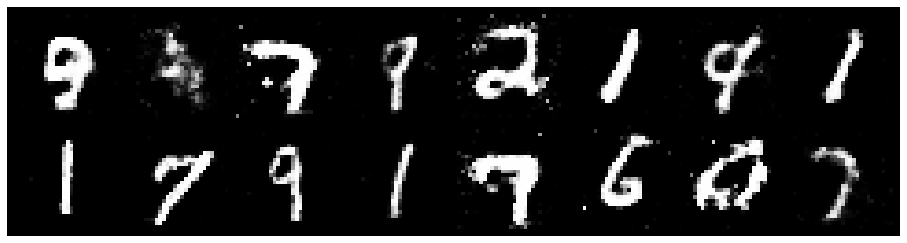

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 0.8968, Generator Loss: 1.2125
D(x): 0.7479, D(G(z)): 0.3553


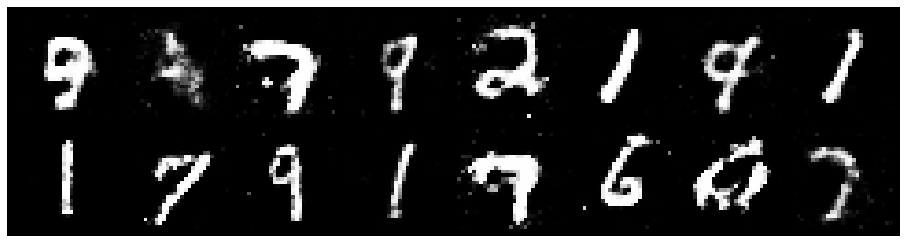

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 0.8864, Generator Loss: 1.3826
D(x): 0.7216, D(G(z)): 0.3266


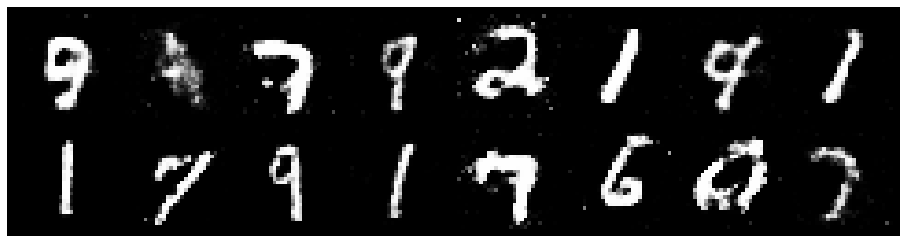

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.1212, Generator Loss: 1.4856
D(x): 0.6346, D(G(z)): 0.3319


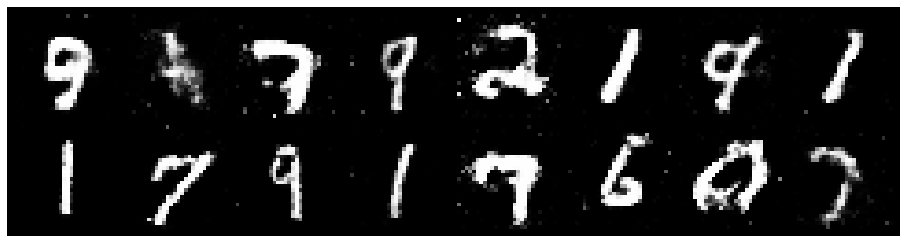

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 0.8656, Generator Loss: 1.5248
D(x): 0.7525, D(G(z)): 0.3213


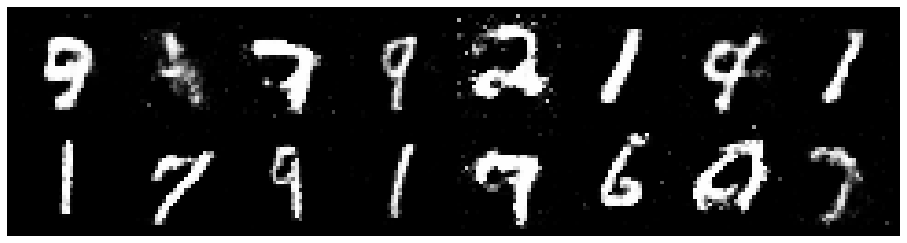

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 0.9190, Generator Loss: 1.2961
D(x): 0.6610, D(G(z)): 0.2973


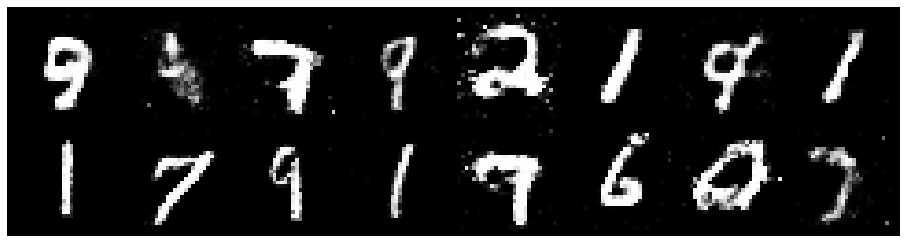

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 0.9062, Generator Loss: 1.6360
D(x): 0.6759, D(G(z)): 0.2790


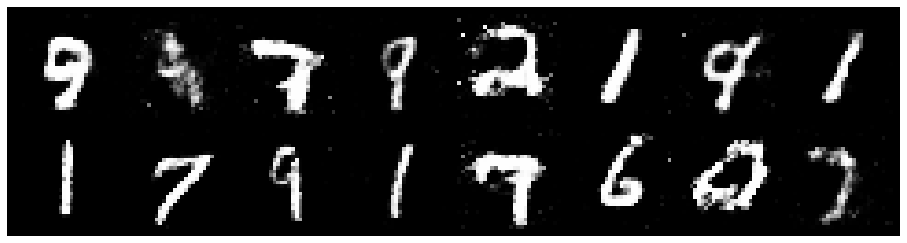

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.0163, Generator Loss: 1.4420
D(x): 0.6920, D(G(z)): 0.3586


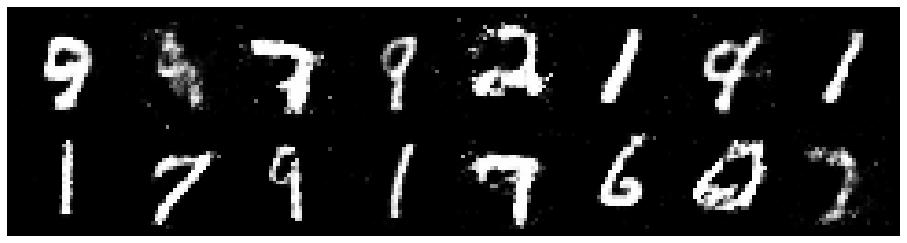

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 0.9254, Generator Loss: 1.3619
D(x): 0.7011, D(G(z)): 0.3241


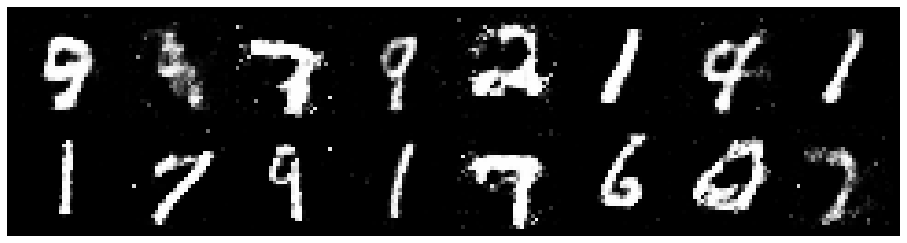

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 0.8597, Generator Loss: 1.4686
D(x): 0.6818, D(G(z)): 0.2723


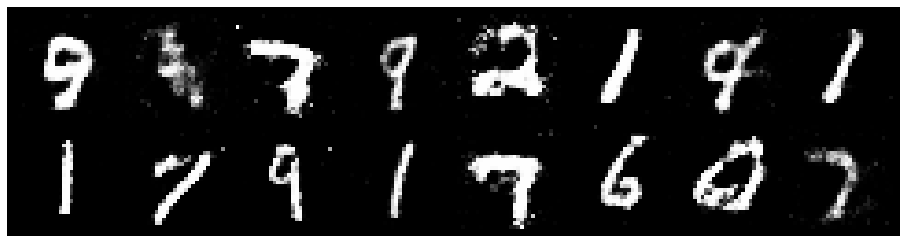

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 0.9768, Generator Loss: 1.4876
D(x): 0.6295, D(G(z)): 0.2624


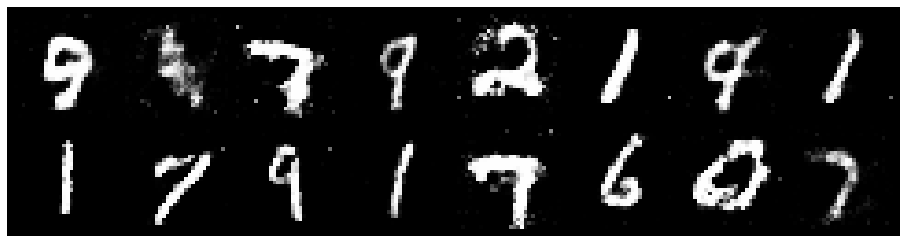

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 0.9056, Generator Loss: 1.3067
D(x): 0.7231, D(G(z)): 0.3392


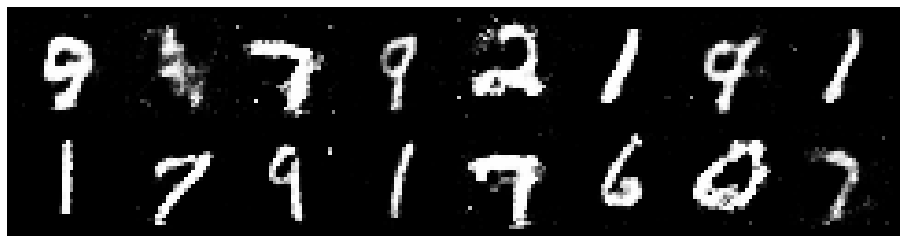

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.0352, Generator Loss: 1.6055
D(x): 0.6672, D(G(z)): 0.2983


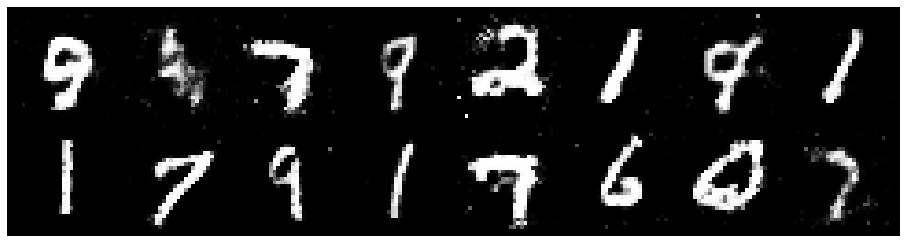

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 0.9718, Generator Loss: 1.4638
D(x): 0.7116, D(G(z)): 0.3403


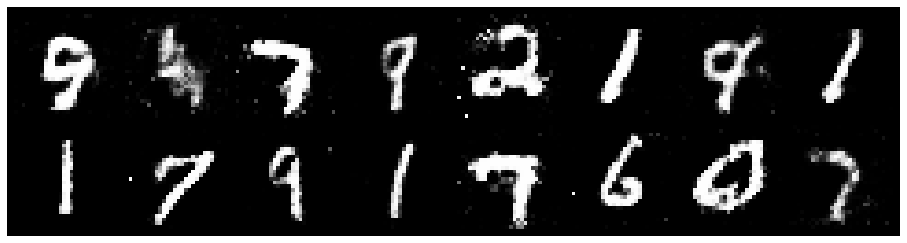

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.0263, Generator Loss: 1.2711
D(x): 0.6629, D(G(z)): 0.3070


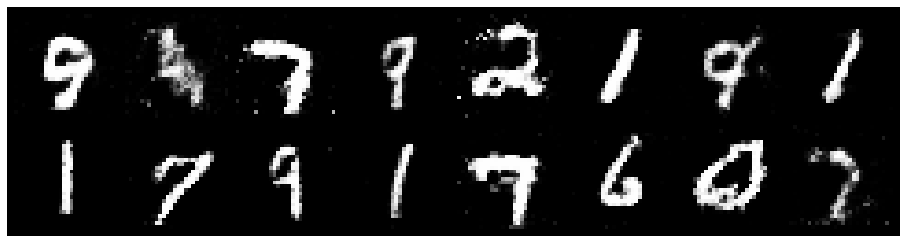

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 0.8659, Generator Loss: 1.5201
D(x): 0.6970, D(G(z)): 0.2771


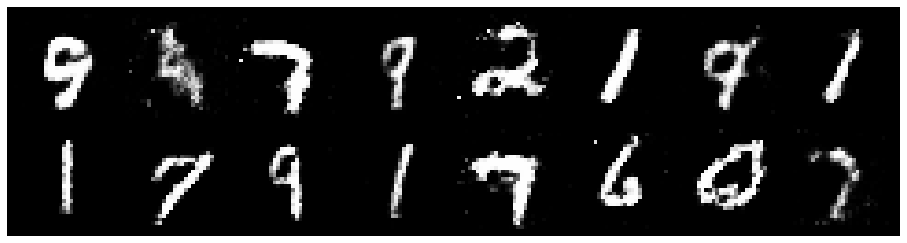

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 0.8587, Generator Loss: 1.1997
D(x): 0.7526, D(G(z)): 0.3579


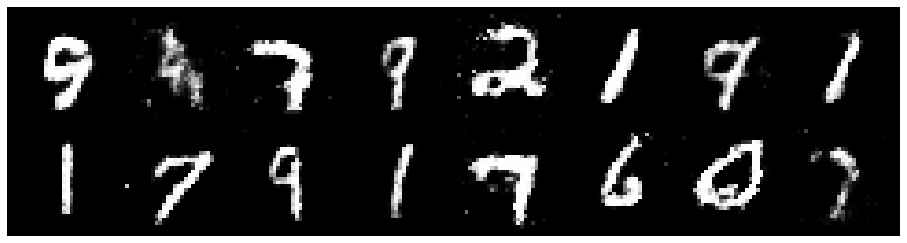

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 0.9016, Generator Loss: 1.5210
D(x): 0.6867, D(G(z)): 0.3038


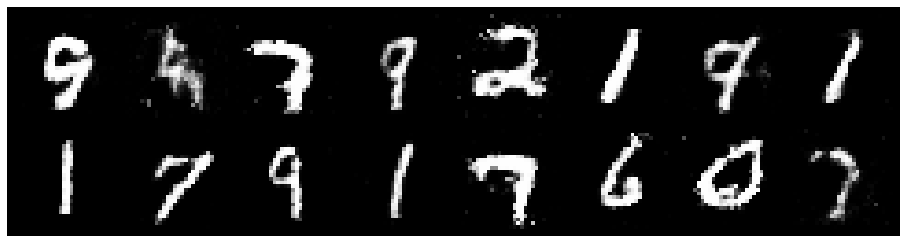

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 0.8845, Generator Loss: 1.2008
D(x): 0.7176, D(G(z)): 0.3172


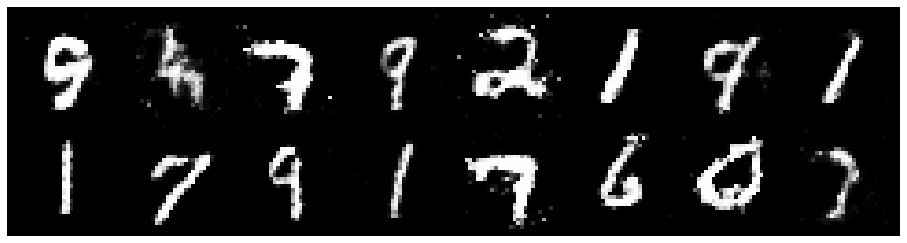

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.0905, Generator Loss: 1.1389
D(x): 0.6952, D(G(z)): 0.3659


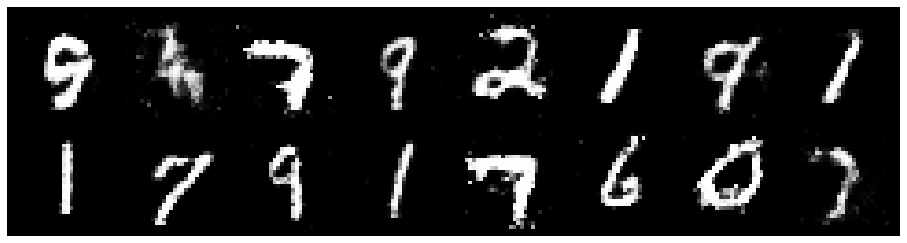

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.0666, Generator Loss: 1.1960
D(x): 0.6922, D(G(z)): 0.4021


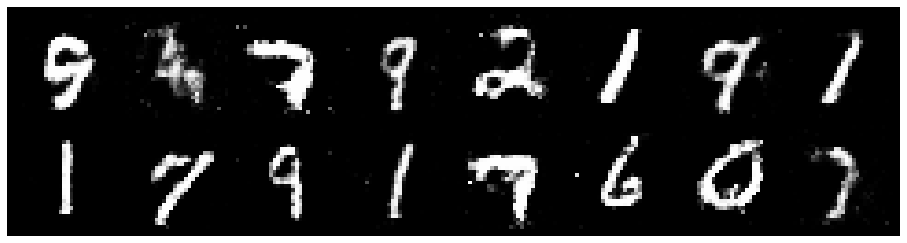

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.0386, Generator Loss: 1.2314
D(x): 0.6684, D(G(z)): 0.3546


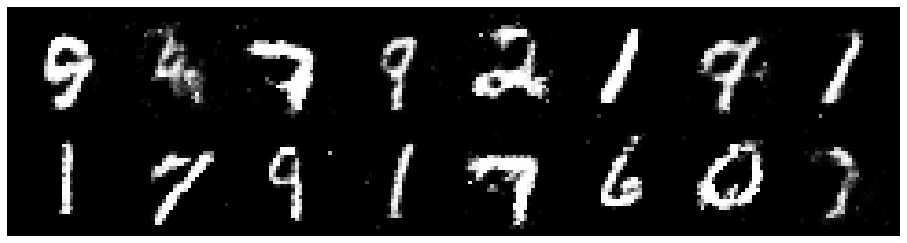

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.0447, Generator Loss: 1.2338
D(x): 0.6839, D(G(z)): 0.3531


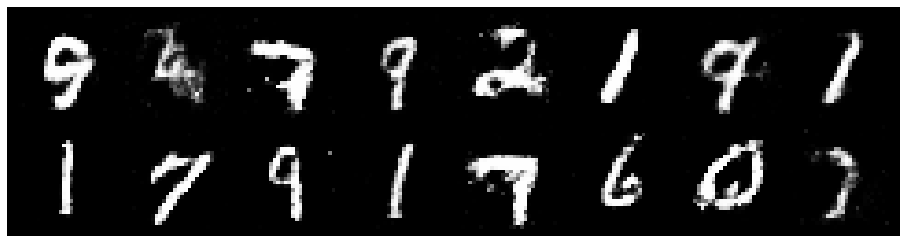

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.0819, Generator Loss: 1.3588
D(x): 0.6188, D(G(z)): 0.3505


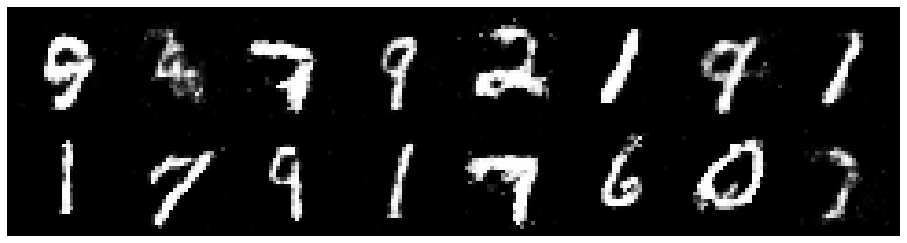

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 0.9770, Generator Loss: 1.2038
D(x): 0.7202, D(G(z)): 0.3816


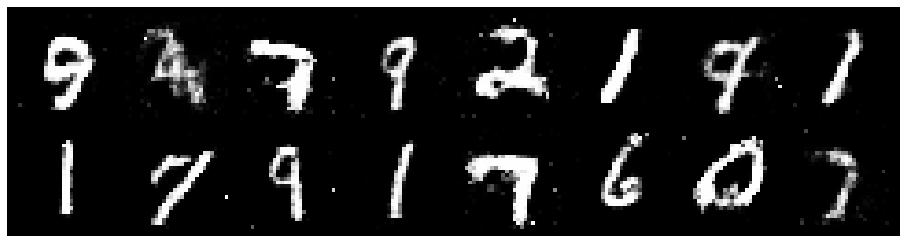

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 0.9016, Generator Loss: 1.2728
D(x): 0.7085, D(G(z)): 0.3091


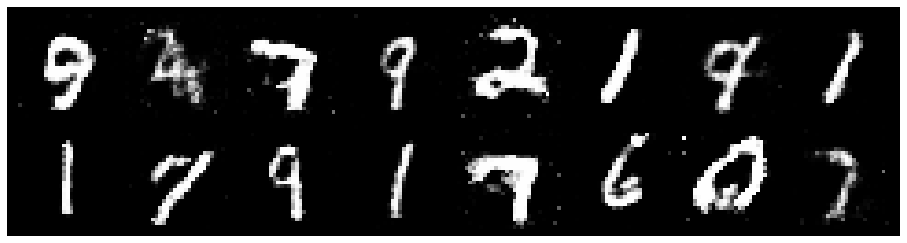

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.1281, Generator Loss: 1.3974
D(x): 0.6160, D(G(z)): 0.3216


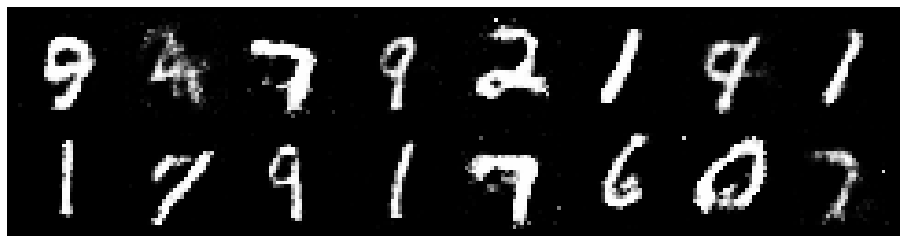

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 0.9601, Generator Loss: 1.5279
D(x): 0.6942, D(G(z)): 0.3037


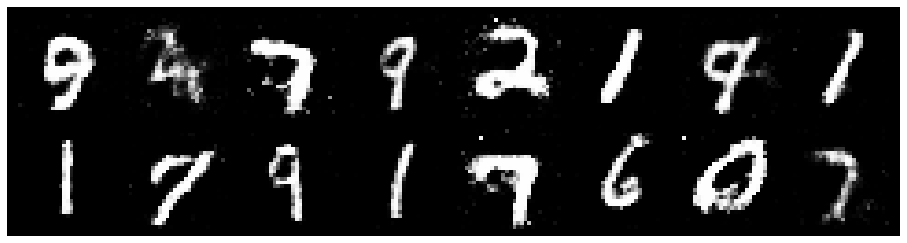

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 0.9626, Generator Loss: 1.3206
D(x): 0.6586, D(G(z)): 0.3148


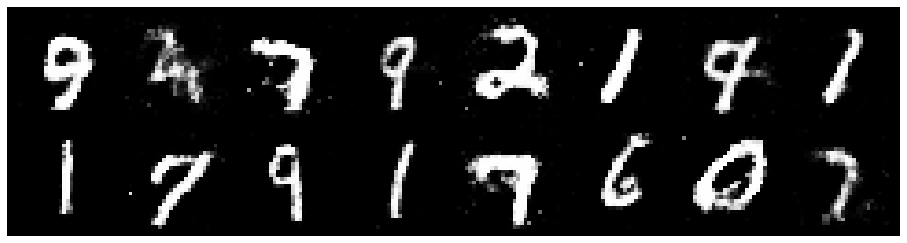

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.0666, Generator Loss: 1.3425
D(x): 0.6893, D(G(z)): 0.3414


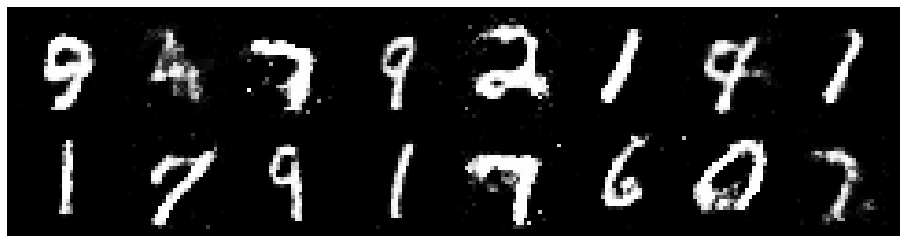

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 0.9899, Generator Loss: 1.0242
D(x): 0.7185, D(G(z)): 0.3897


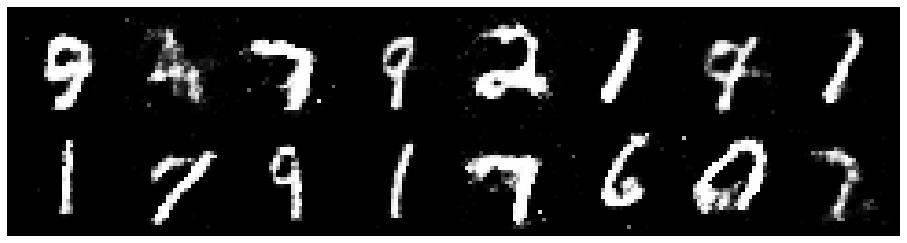

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 0.9816, Generator Loss: 1.3033
D(x): 0.7005, D(G(z)): 0.3560


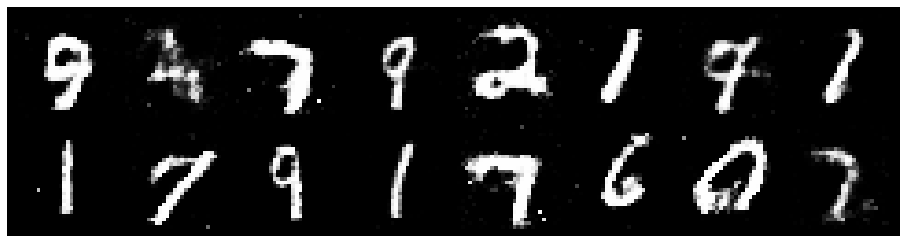

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 0.8924, Generator Loss: 1.2738
D(x): 0.7736, D(G(z)): 0.3694


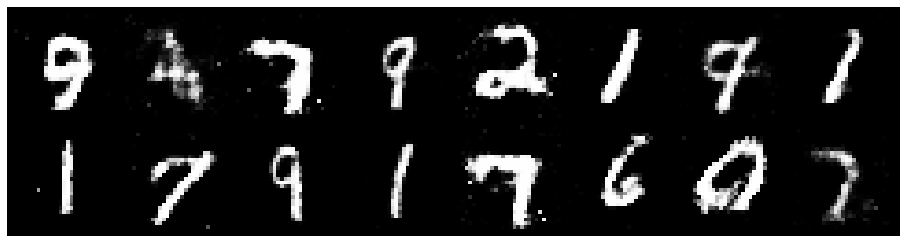

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 0.9515, Generator Loss: 1.5288
D(x): 0.6588, D(G(z)): 0.2924


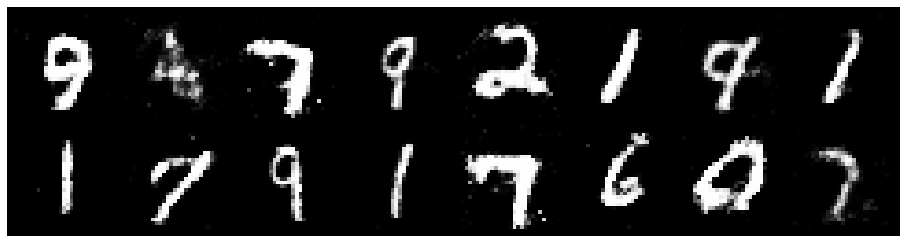

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 0.9582, Generator Loss: 1.2496
D(x): 0.6891, D(G(z)): 0.3443


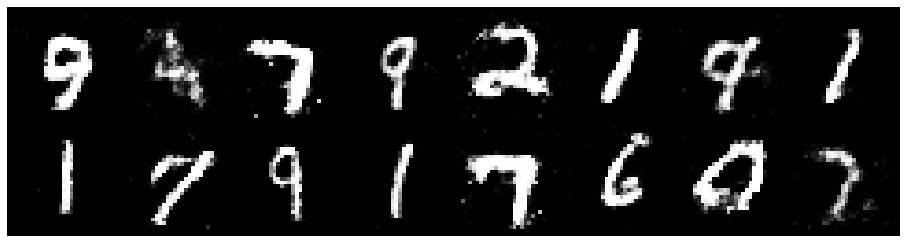

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 0.9202, Generator Loss: 1.2690
D(x): 0.7097, D(G(z)): 0.3499


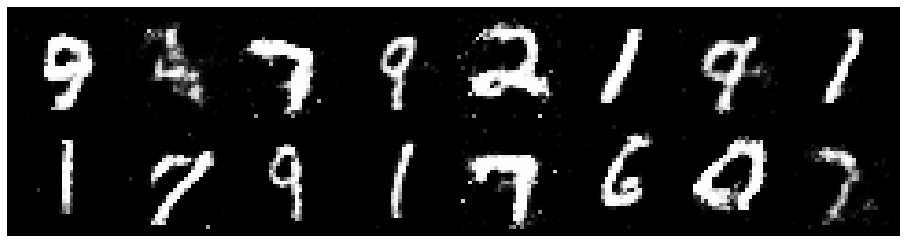

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 0.9522, Generator Loss: 1.4221
D(x): 0.6819, D(G(z)): 0.3267


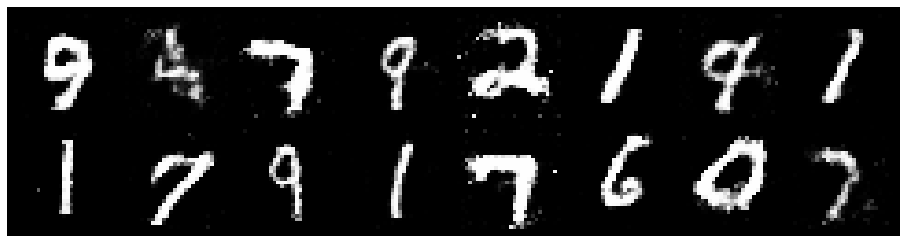

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.0629, Generator Loss: 1.3978
D(x): 0.6620, D(G(z)): 0.3387


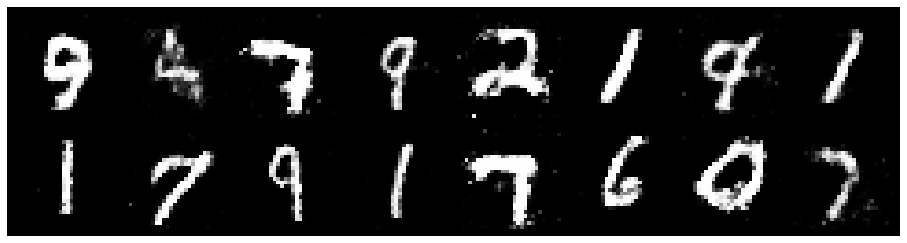

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 0.9922, Generator Loss: 1.5257
D(x): 0.6585, D(G(z)): 0.3039


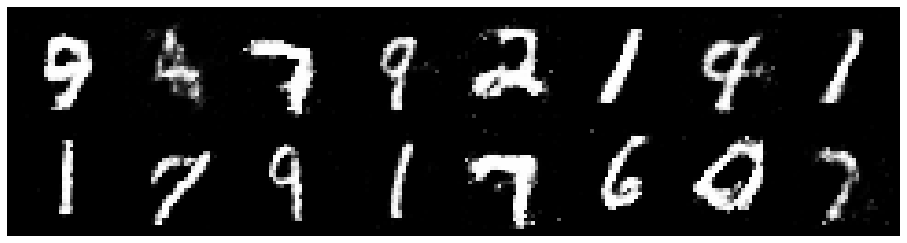

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 0.8935, Generator Loss: 1.5686
D(x): 0.6636, D(G(z)): 0.2769


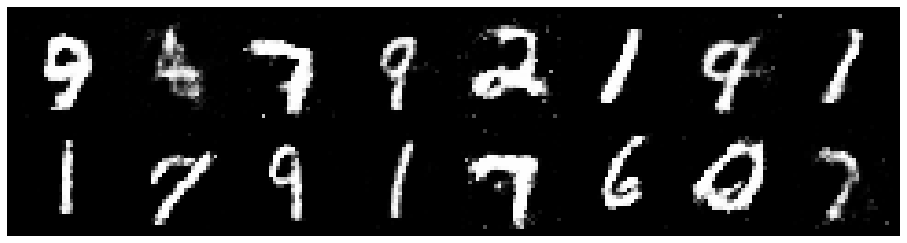

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.0061, Generator Loss: 1.6004
D(x): 0.6395, D(G(z)): 0.2753


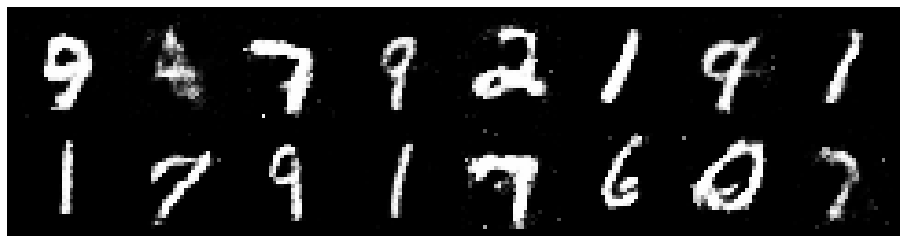

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 0.9321, Generator Loss: 1.8334
D(x): 0.6469, D(G(z)): 0.2703


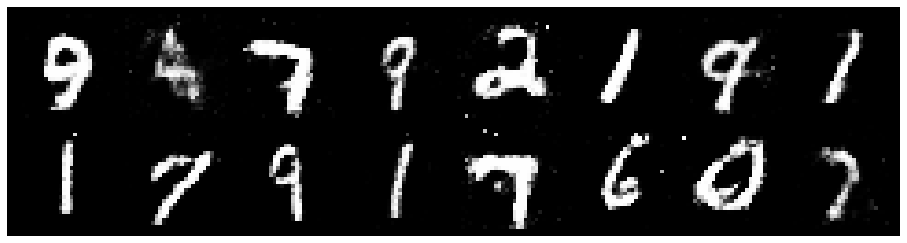

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.0673, Generator Loss: 1.4240
D(x): 0.6418, D(G(z)): 0.3203


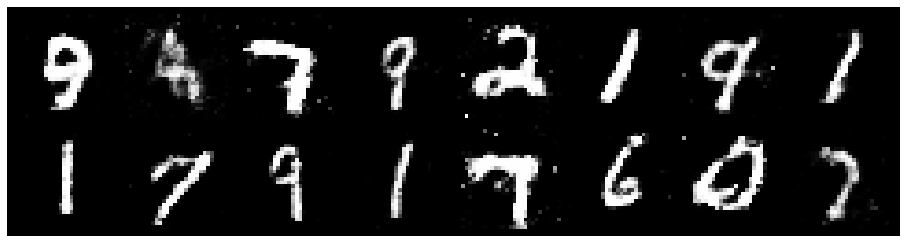

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.0742, Generator Loss: 1.4530
D(x): 0.6423, D(G(z)): 0.3067


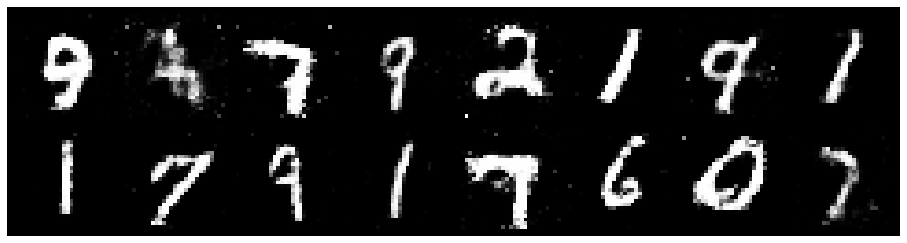

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 0.8063, Generator Loss: 1.4661
D(x): 0.7115, D(G(z)): 0.2794


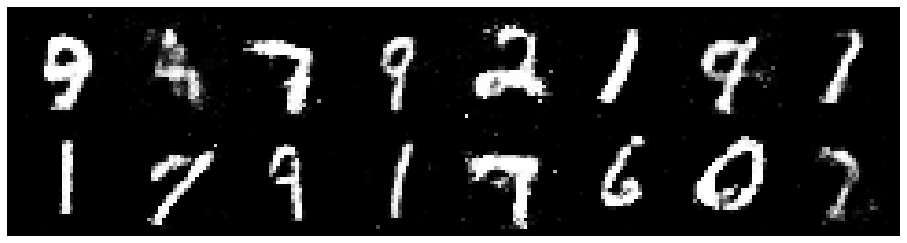

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 0.9231, Generator Loss: 1.3074
D(x): 0.7235, D(G(z)): 0.3481


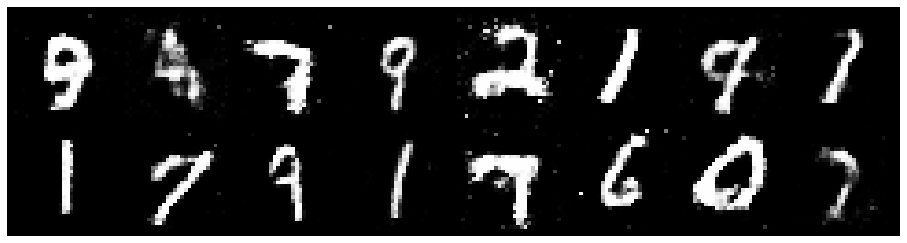

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 0.9005, Generator Loss: 1.2441
D(x): 0.7042, D(G(z)): 0.3391


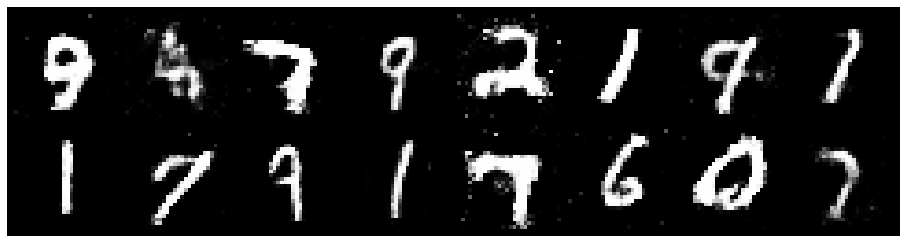

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.0093, Generator Loss: 1.3997
D(x): 0.6586, D(G(z)): 0.3004


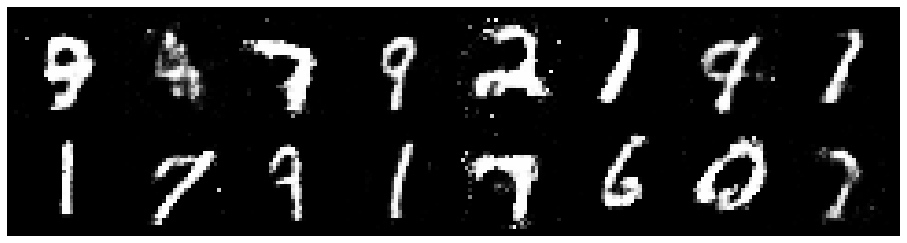

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.0255, Generator Loss: 1.3265
D(x): 0.6467, D(G(z)): 0.3388


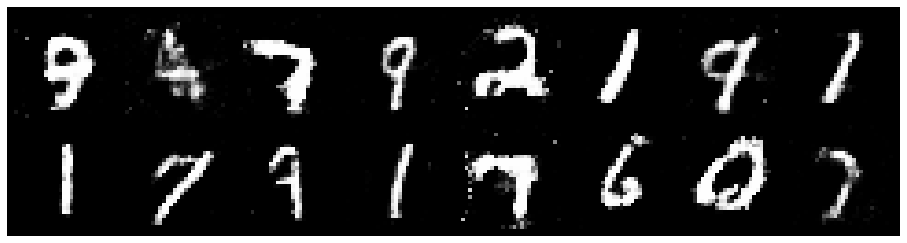

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.0310, Generator Loss: 1.2734
D(x): 0.6925, D(G(z)): 0.3477


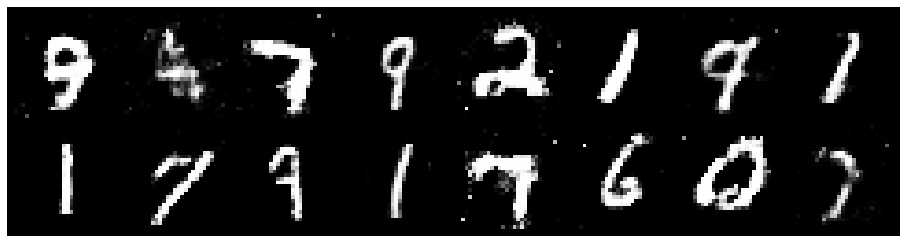

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 0.9119, Generator Loss: 1.4700
D(x): 0.6657, D(G(z)): 0.3112


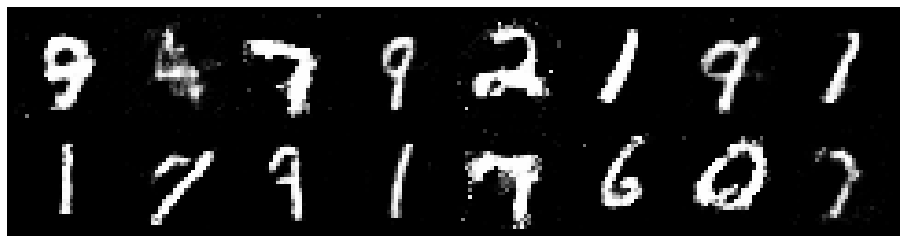

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 0.9571, Generator Loss: 1.1636
D(x): 0.7209, D(G(z)): 0.3666


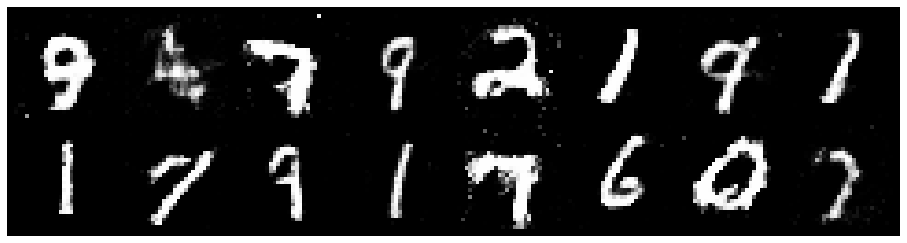

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 0.8232, Generator Loss: 1.4394
D(x): 0.6881, D(G(z)): 0.2607


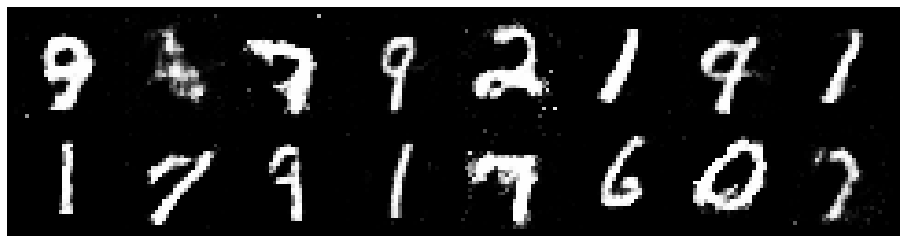

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 0.9206, Generator Loss: 1.1307
D(x): 0.6985, D(G(z)): 0.3342


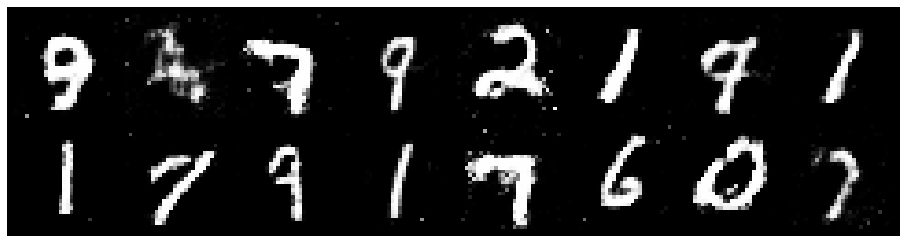

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.0905, Generator Loss: 1.2386
D(x): 0.6361, D(G(z)): 0.3441


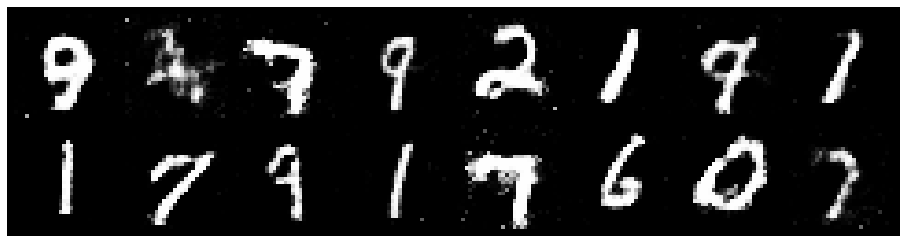

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.0284, Generator Loss: 1.1178
D(x): 0.7208, D(G(z)): 0.3941


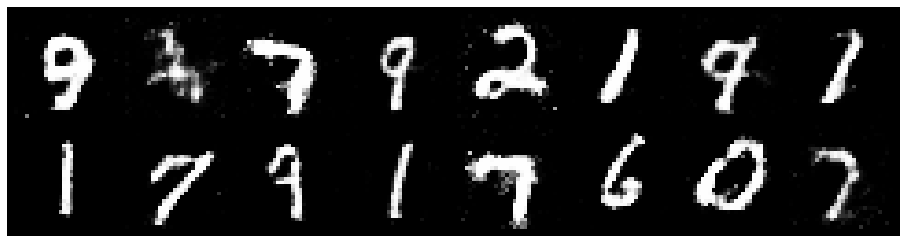

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.0278, Generator Loss: 1.0518
D(x): 0.6422, D(G(z)): 0.3318


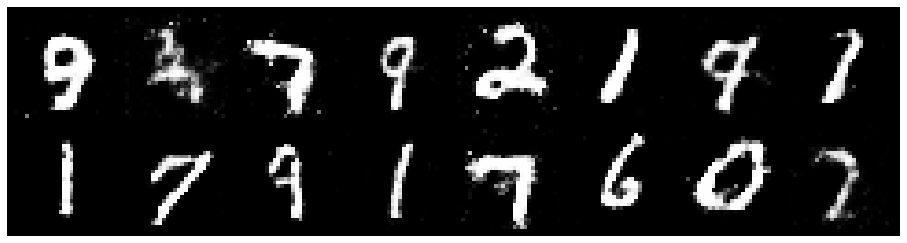

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.0825, Generator Loss: 1.2185
D(x): 0.6543, D(G(z)): 0.3910


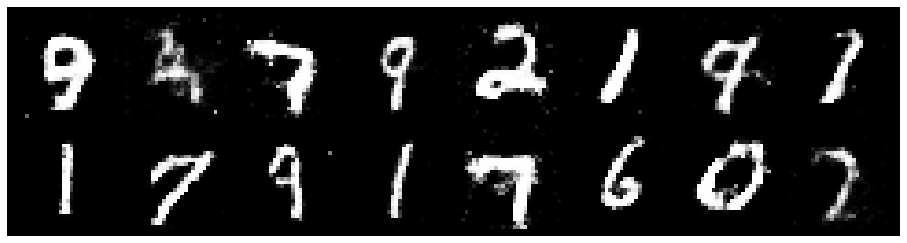

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 0.8795, Generator Loss: 1.3366
D(x): 0.6797, D(G(z)): 0.3010


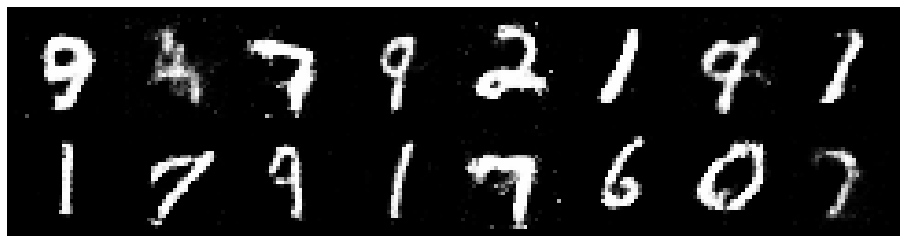

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 0.9642, Generator Loss: 1.3522
D(x): 0.6820, D(G(z)): 0.3334


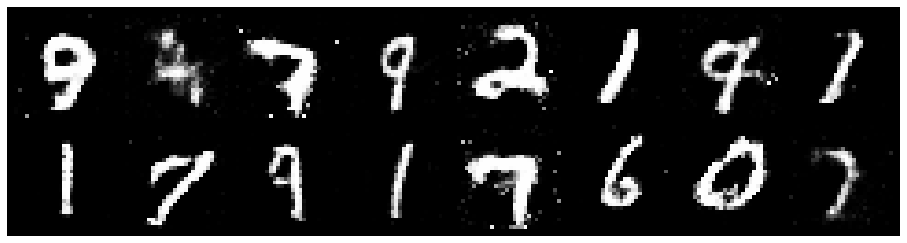

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 0.9511, Generator Loss: 1.2985
D(x): 0.7577, D(G(z)): 0.3910


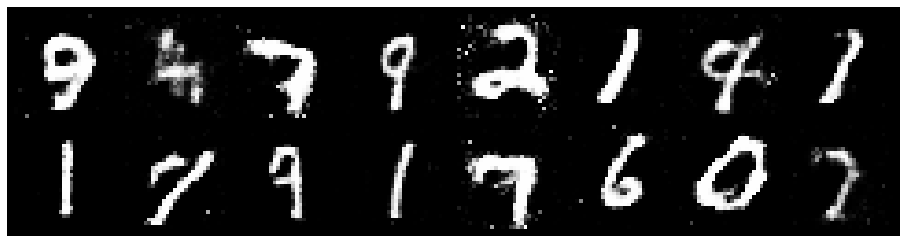

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 0.9569, Generator Loss: 1.3845
D(x): 0.6988, D(G(z)): 0.3583


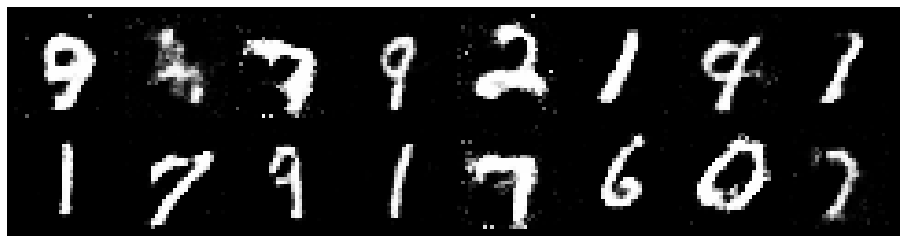

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.0193, Generator Loss: 1.2702
D(x): 0.6665, D(G(z)): 0.3466


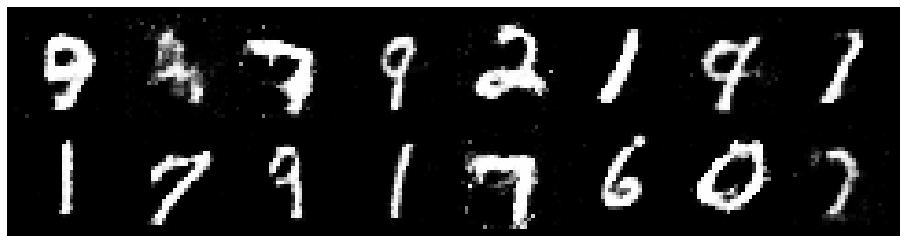

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 0.9882, Generator Loss: 1.5321
D(x): 0.6829, D(G(z)): 0.3173


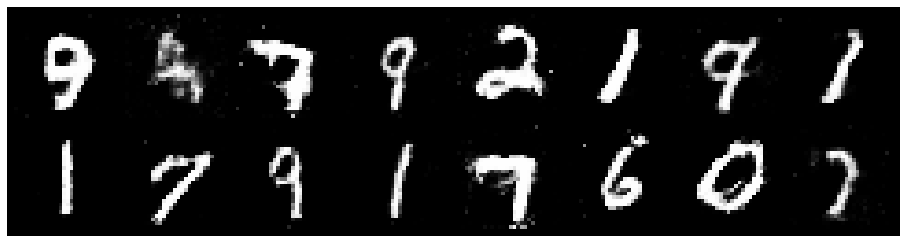

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 0.9305, Generator Loss: 1.1849
D(x): 0.6935, D(G(z)): 0.3274


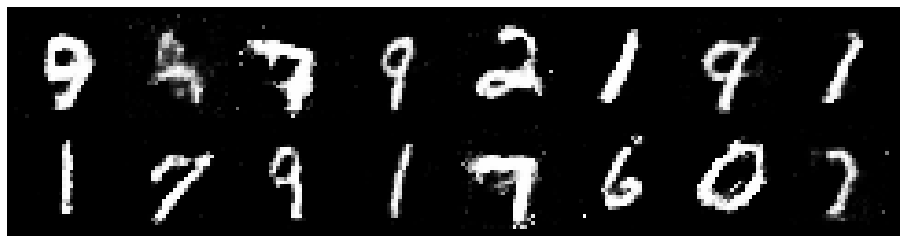

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 0.7932, Generator Loss: 1.3251
D(x): 0.7750, D(G(z)): 0.3577


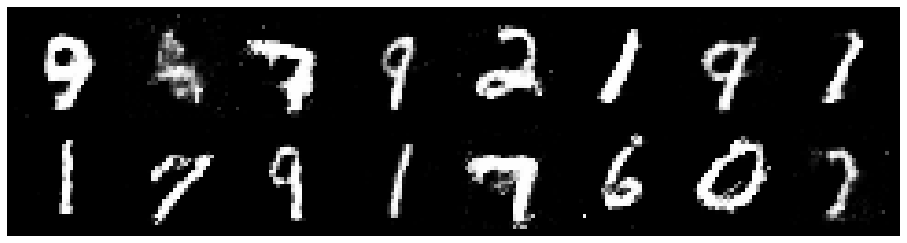

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 0.9875, Generator Loss: 1.1803
D(x): 0.7032, D(G(z)): 0.3725


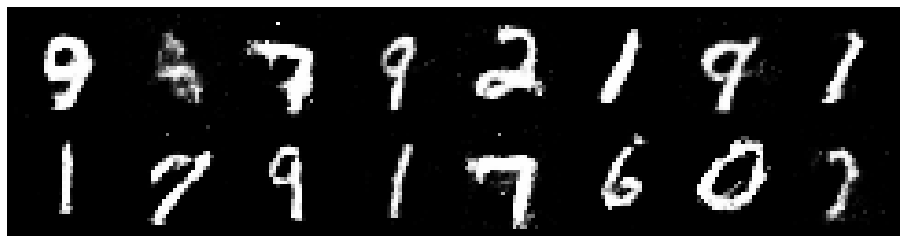

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.1951, Generator Loss: 1.0552
D(x): 0.6051, D(G(z)): 0.3864


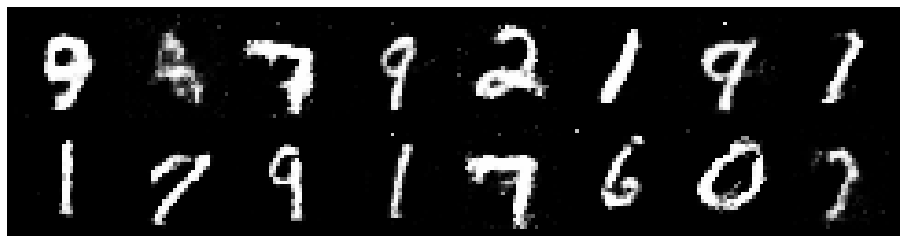

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.0340, Generator Loss: 1.3560
D(x): 0.6788, D(G(z)): 0.3529


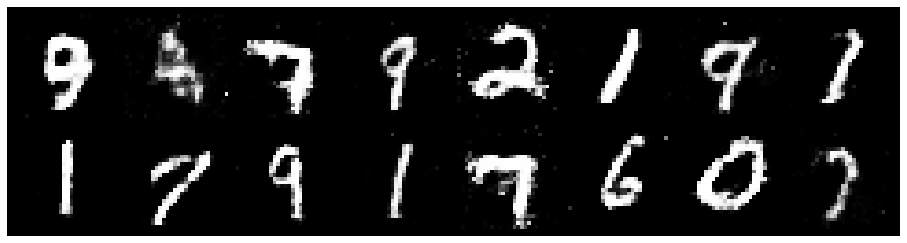

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.0403, Generator Loss: 1.2301
D(x): 0.6285, D(G(z)): 0.3092


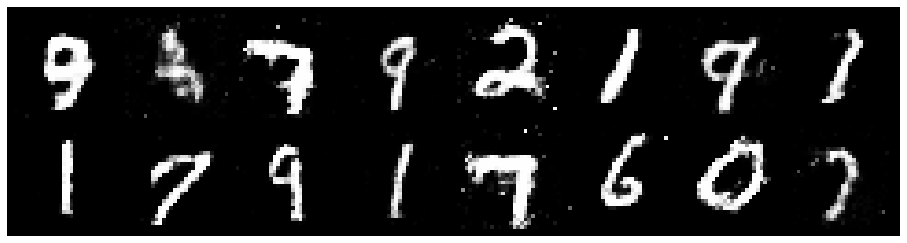

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 0.9548, Generator Loss: 1.1852
D(x): 0.6922, D(G(z)): 0.3510


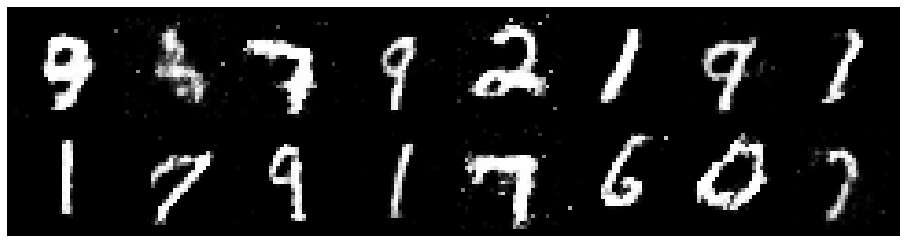

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.0974, Generator Loss: 1.2028
D(x): 0.6443, D(G(z)): 0.3738


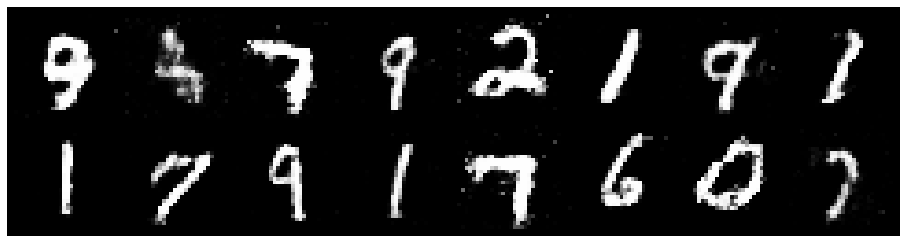

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 0.9846, Generator Loss: 1.2743
D(x): 0.6585, D(G(z)): 0.3298


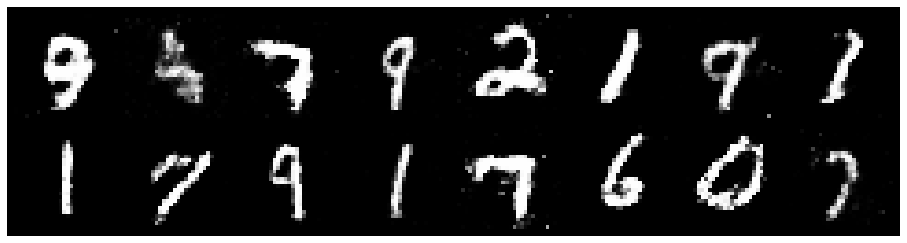

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 0.9427, Generator Loss: 1.1182
D(x): 0.7099, D(G(z)): 0.3695


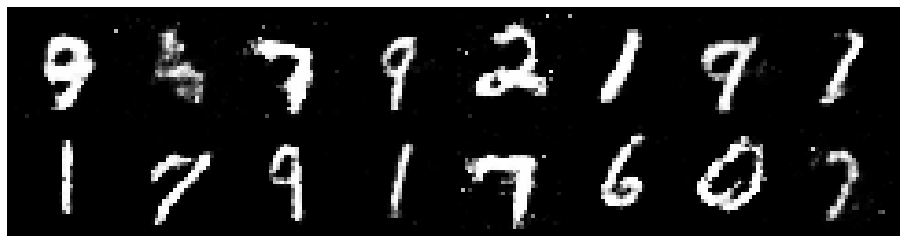

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.0145, Generator Loss: 1.3253
D(x): 0.6522, D(G(z)): 0.3379


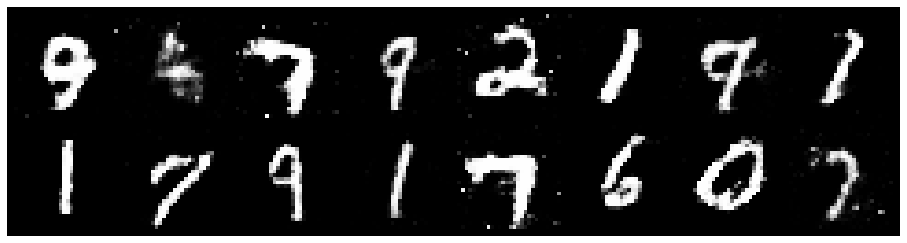

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 0.9265, Generator Loss: 1.2485
D(x): 0.7111, D(G(z)): 0.3599


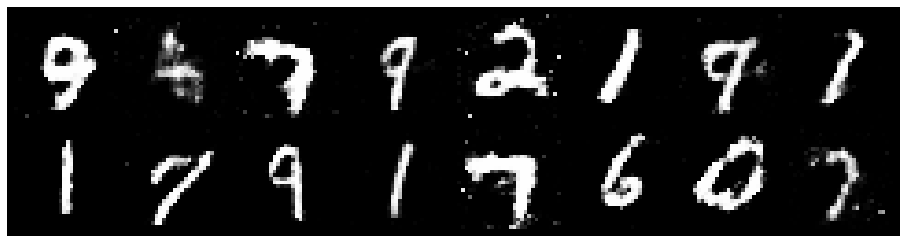

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 0.9538, Generator Loss: 1.2296
D(x): 0.6710, D(G(z)): 0.3206


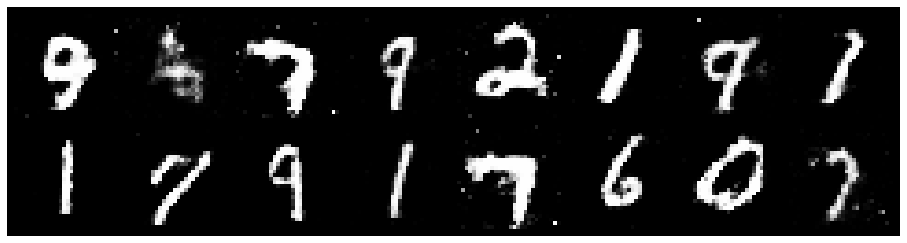

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.0740, Generator Loss: 1.2179
D(x): 0.5946, D(G(z)): 0.3153


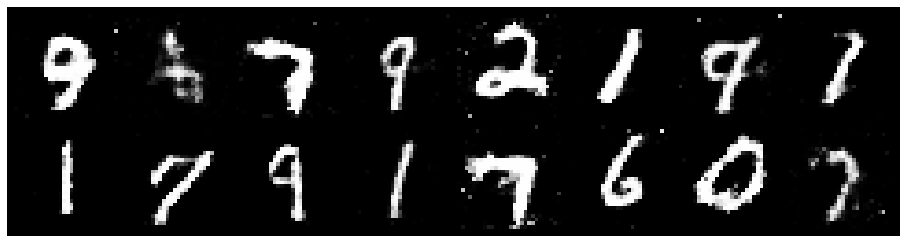

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.1048, Generator Loss: 1.3016
D(x): 0.7094, D(G(z)): 0.4069


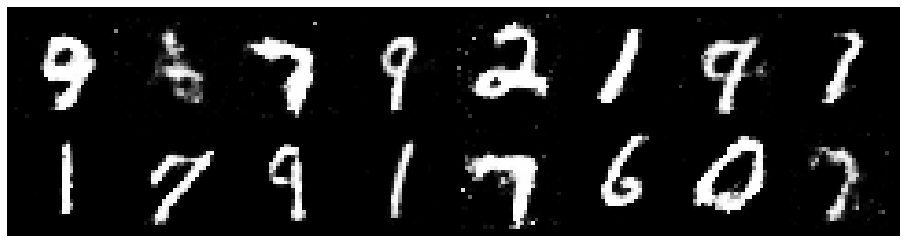

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.0915, Generator Loss: 1.1113
D(x): 0.6663, D(G(z)): 0.3607


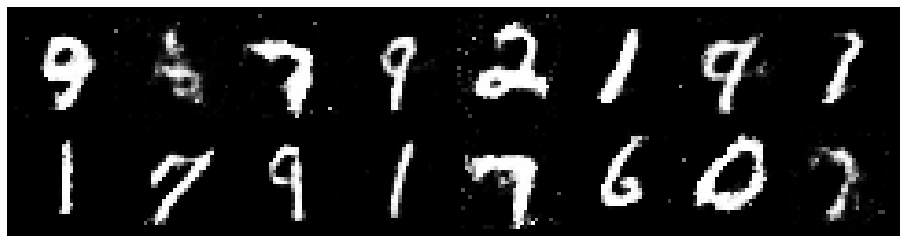

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 0.9719, Generator Loss: 1.3448
D(x): 0.7172, D(G(z)): 0.3628


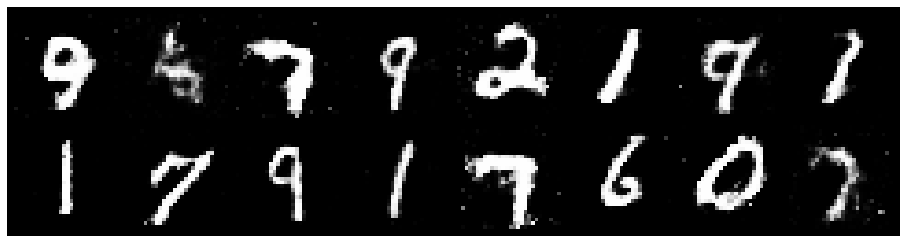

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 0.9765, Generator Loss: 1.4716
D(x): 0.6385, D(G(z)): 0.3024


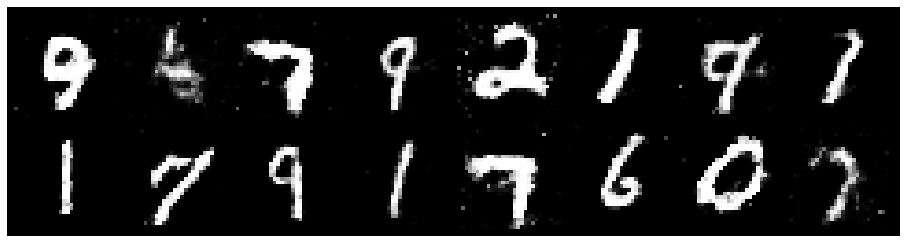

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.1150, Generator Loss: 1.1985
D(x): 0.6070, D(G(z)): 0.3176


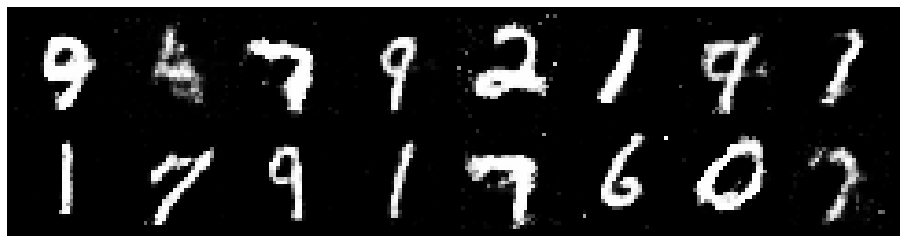

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.0371, Generator Loss: 1.3879
D(x): 0.6296, D(G(z)): 0.3076


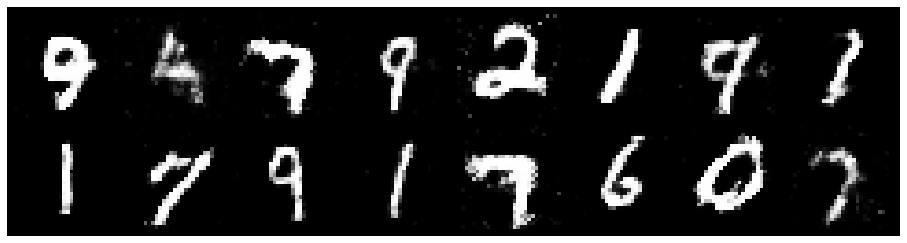

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.0571, Generator Loss: 1.1100
D(x): 0.6473, D(G(z)): 0.3577


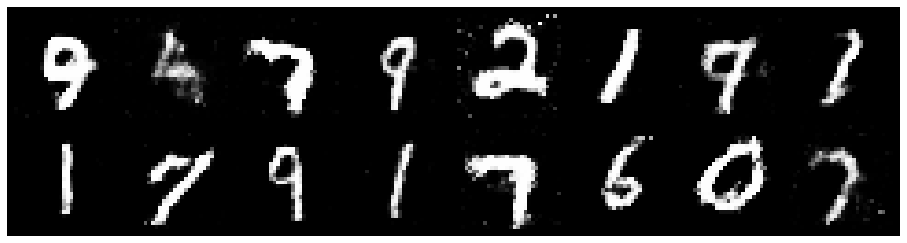

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 0.9254, Generator Loss: 1.2596
D(x): 0.6774, D(G(z)): 0.3083


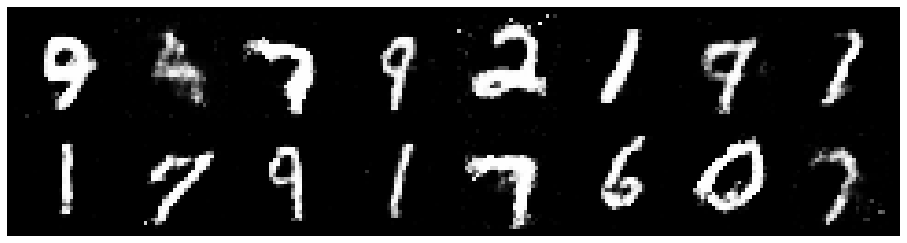

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.0679, Generator Loss: 1.3402
D(x): 0.6097, D(G(z)): 0.3226


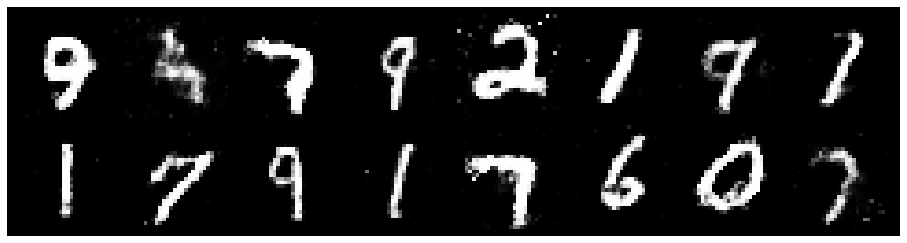

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 0.9863, Generator Loss: 1.1969
D(x): 0.6348, D(G(z)): 0.2998


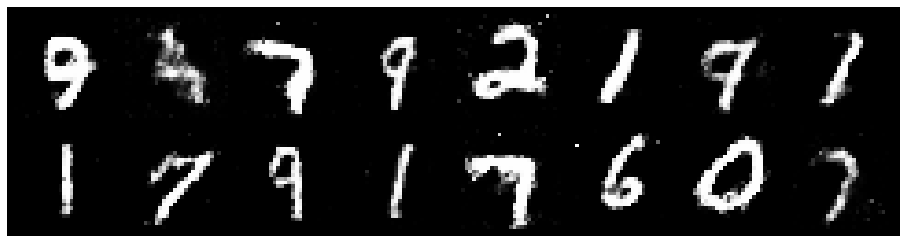

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 0.9115, Generator Loss: 1.3829
D(x): 0.6472, D(G(z)): 0.2965


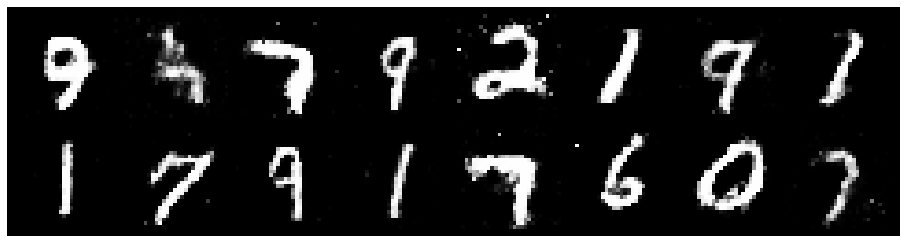

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 0.9304, Generator Loss: 1.4162
D(x): 0.6992, D(G(z)): 0.3264


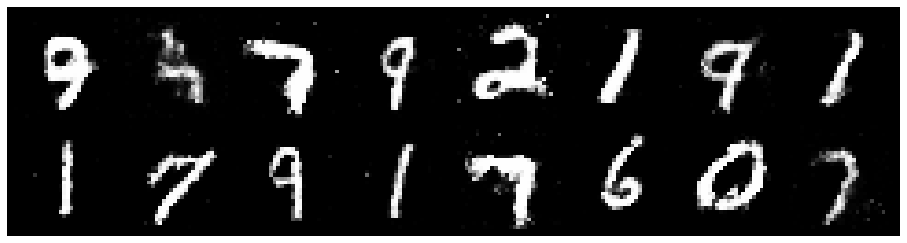

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.0277, Generator Loss: 1.1401
D(x): 0.6778, D(G(z)): 0.3733


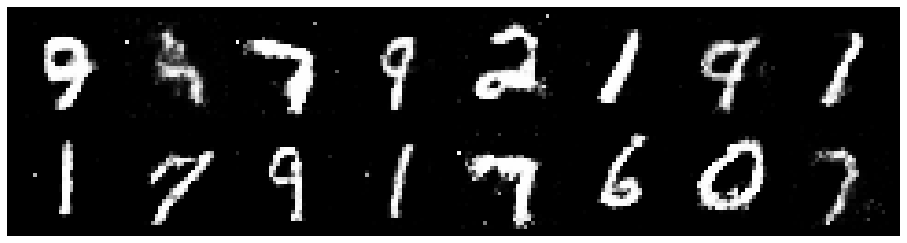

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.0018, Generator Loss: 1.3556
D(x): 0.6185, D(G(z)): 0.2985


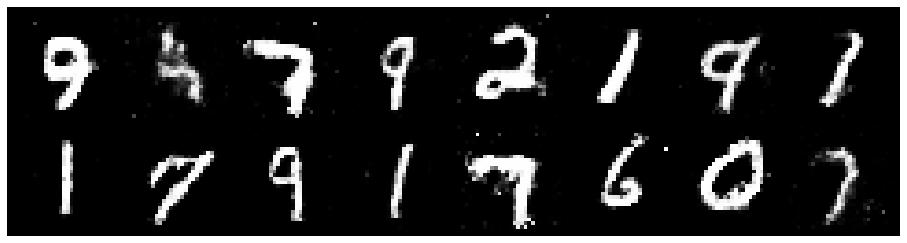

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 0.9561, Generator Loss: 1.1197
D(x): 0.6519, D(G(z)): 0.3041


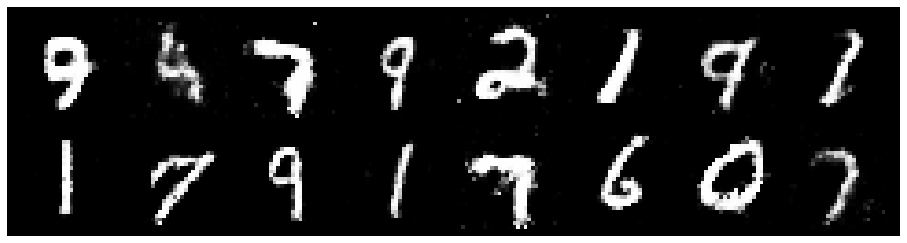

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.0065, Generator Loss: 1.4714
D(x): 0.6874, D(G(z)): 0.3481


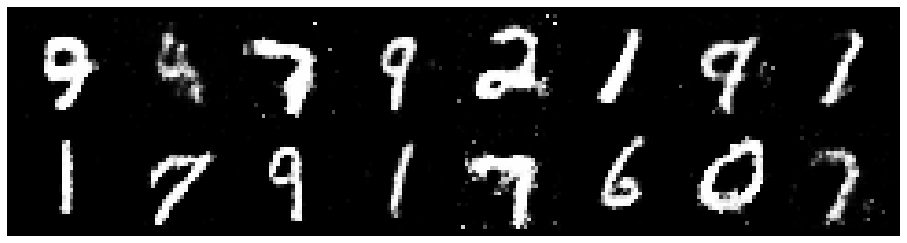

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.0865, Generator Loss: 1.1009
D(x): 0.6874, D(G(z)): 0.4120


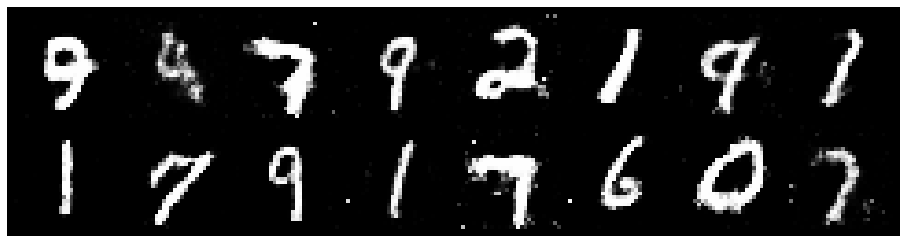

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.0471, Generator Loss: 1.4693
D(x): 0.6379, D(G(z)): 0.3219


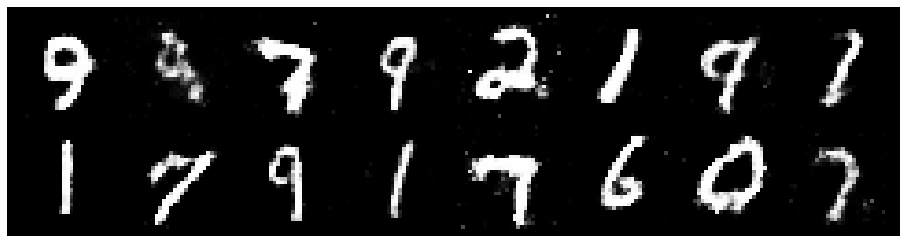

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.0747, Generator Loss: 1.2387
D(x): 0.6419, D(G(z)): 0.3583


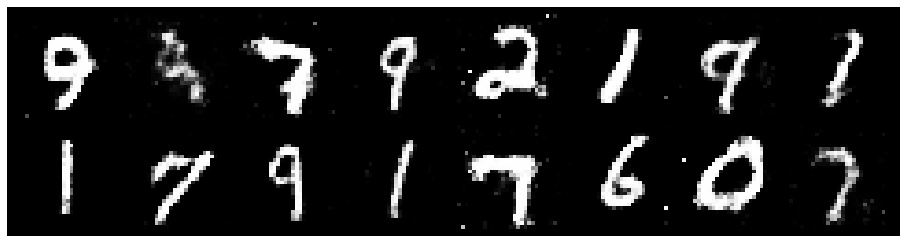

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 0.9606, Generator Loss: 1.3957
D(x): 0.6737, D(G(z)): 0.3284


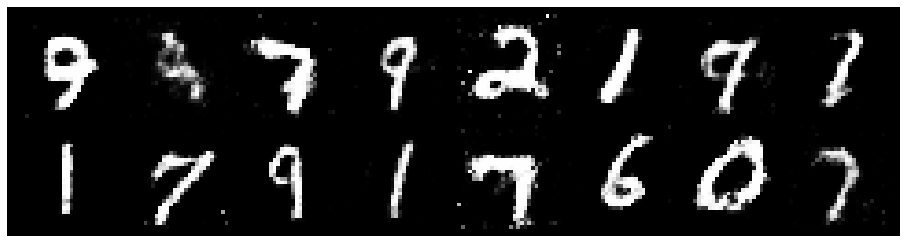

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 0.9378, Generator Loss: 1.4479
D(x): 0.6830, D(G(z)): 0.3184


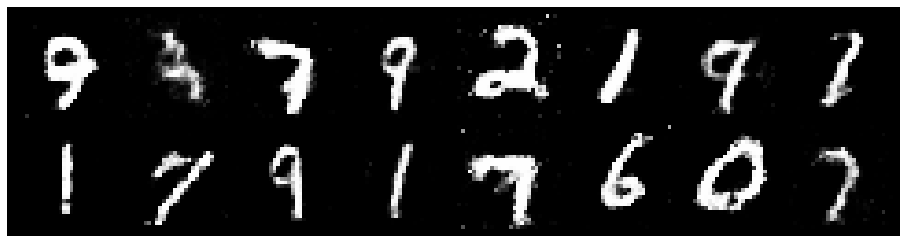

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.0883, Generator Loss: 1.3773
D(x): 0.6036, D(G(z)): 0.3065


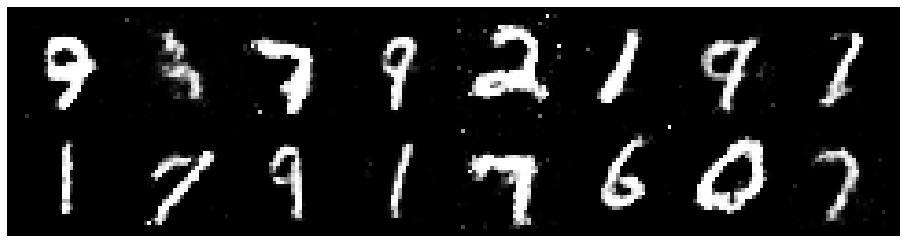

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 0.9470, Generator Loss: 1.3760
D(x): 0.6533, D(G(z)): 0.2789


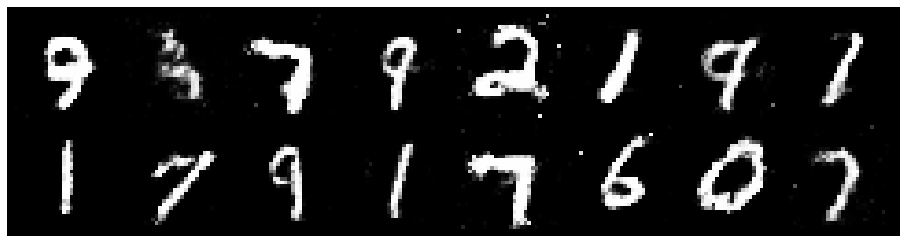

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.1440, Generator Loss: 1.2913
D(x): 0.5923, D(G(z)): 0.3150


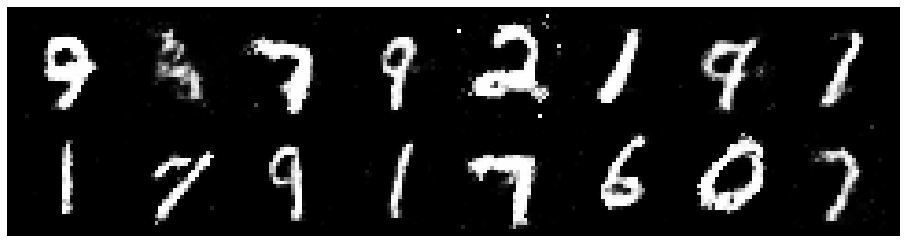

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 0.9490, Generator Loss: 1.2163
D(x): 0.6919, D(G(z)): 0.3461


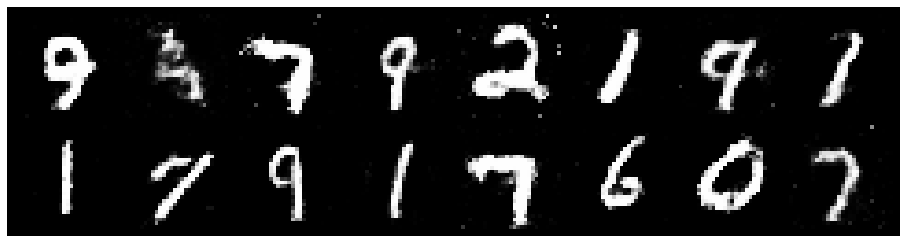

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.0210, Generator Loss: 1.1715
D(x): 0.6981, D(G(z)): 0.3914


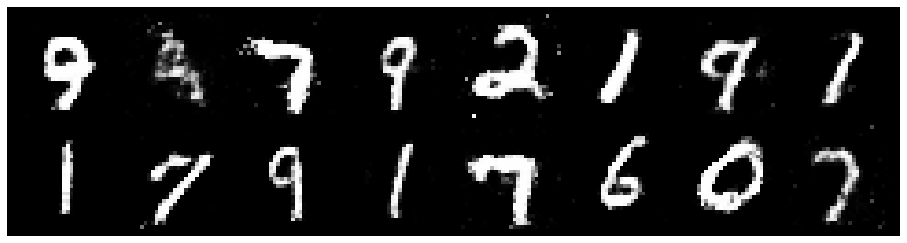

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.0328, Generator Loss: 1.1367
D(x): 0.6296, D(G(z)): 0.3312


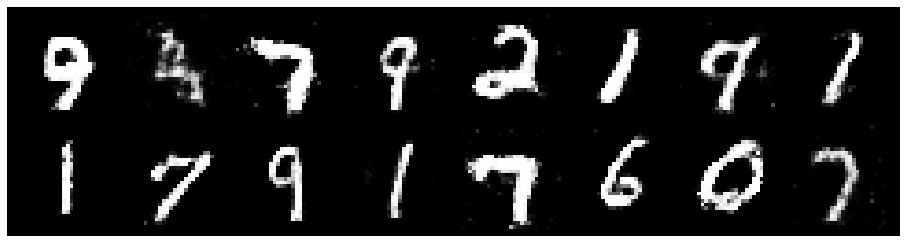

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 0.8609, Generator Loss: 1.4221
D(x): 0.6786, D(G(z)): 0.2839


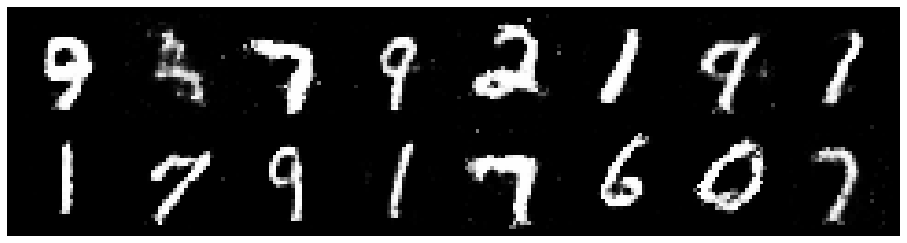

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 0.9258, Generator Loss: 1.3215
D(x): 0.6500, D(G(z)): 0.2792


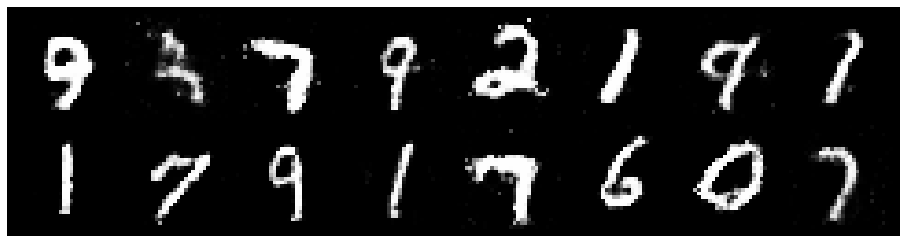

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 0.8098, Generator Loss: 1.3995
D(x): 0.7484, D(G(z)): 0.3021


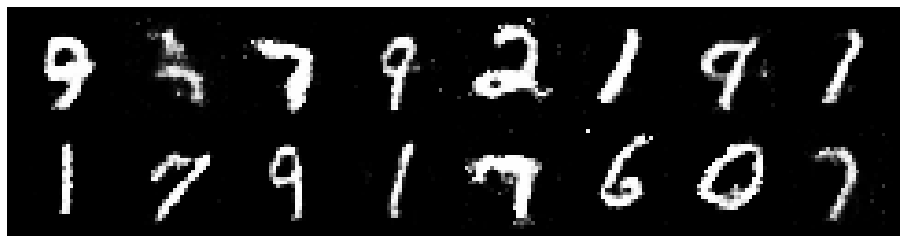

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 0.9722, Generator Loss: 1.3290
D(x): 0.6402, D(G(z)): 0.2968


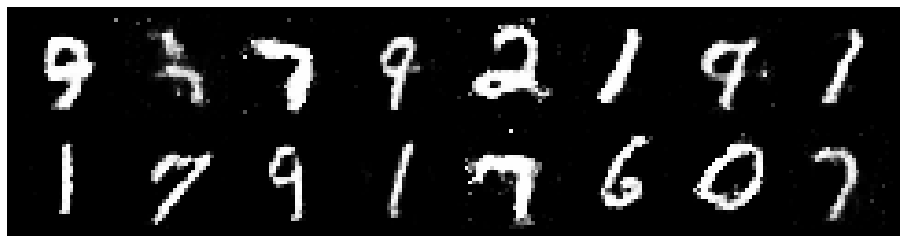

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 0.9724, Generator Loss: 1.4011
D(x): 0.6430, D(G(z)): 0.2996


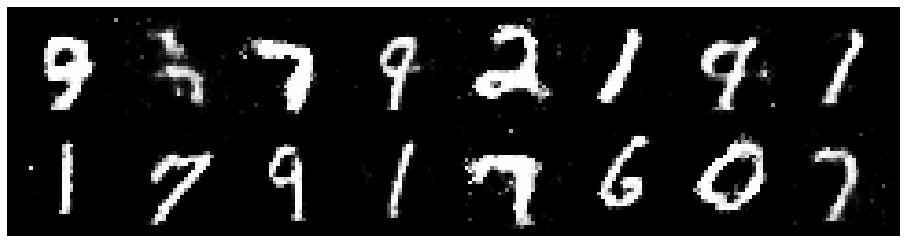

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.0393, Generator Loss: 1.3647
D(x): 0.6453, D(G(z)): 0.3447


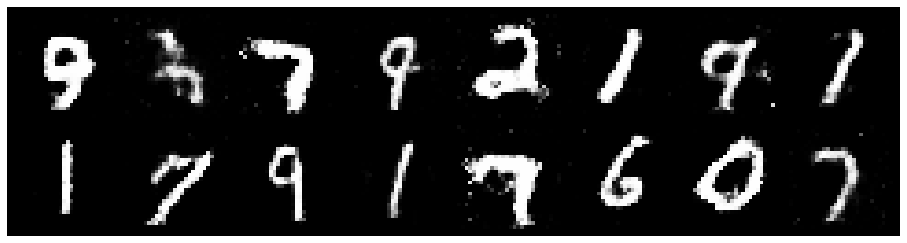

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.0120, Generator Loss: 1.3618
D(x): 0.6365, D(G(z)): 0.3112


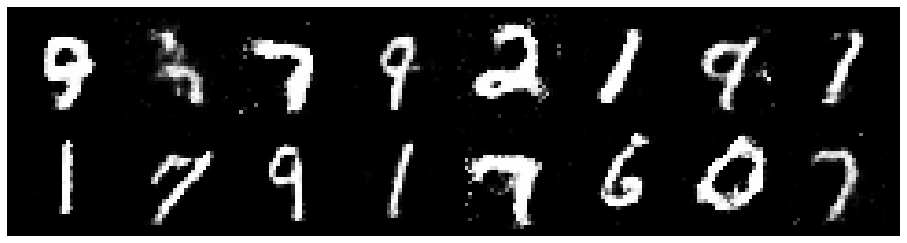

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.0664, Generator Loss: 1.3198
D(x): 0.6884, D(G(z)): 0.3868


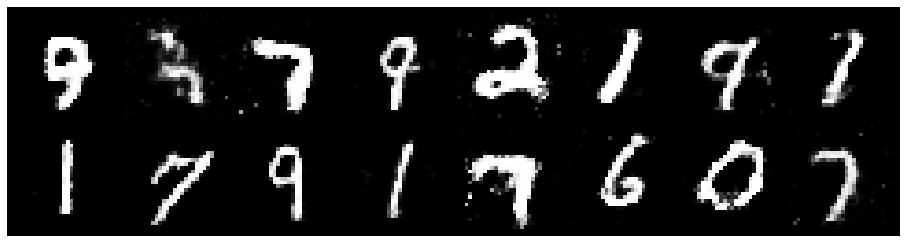

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.1322, Generator Loss: 1.2266
D(x): 0.6865, D(G(z)): 0.4224


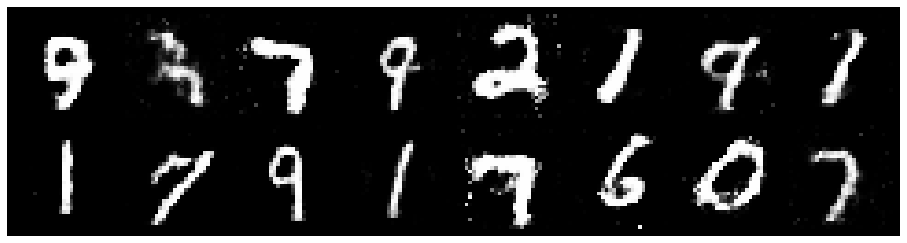

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.0063, Generator Loss: 1.2136
D(x): 0.6805, D(G(z)): 0.3527


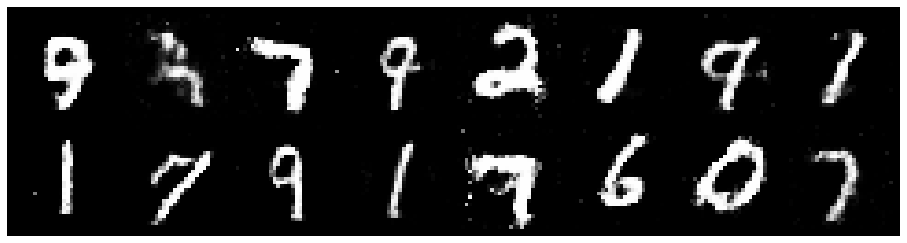

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.0634, Generator Loss: 1.1474
D(x): 0.6486, D(G(z)): 0.3574


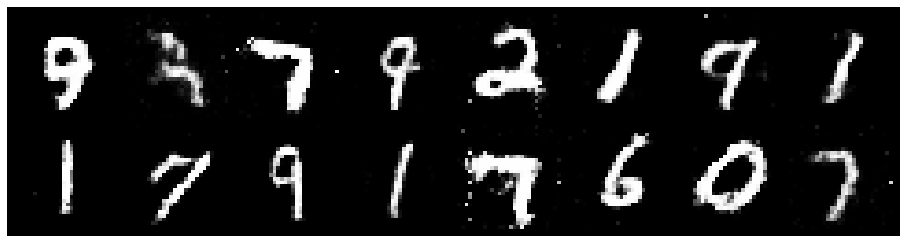

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 0.9858, Generator Loss: 1.2278
D(x): 0.6571, D(G(z)): 0.3318


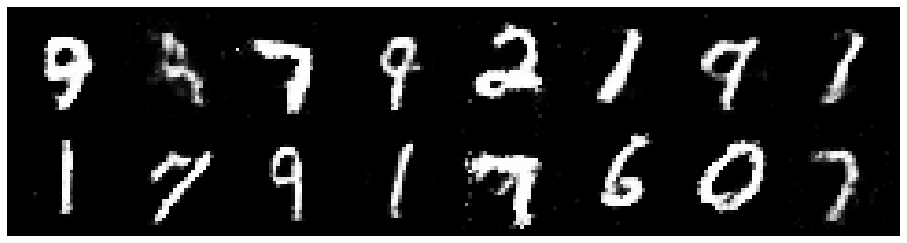

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.0240, Generator Loss: 1.3722
D(x): 0.6464, D(G(z)): 0.3133


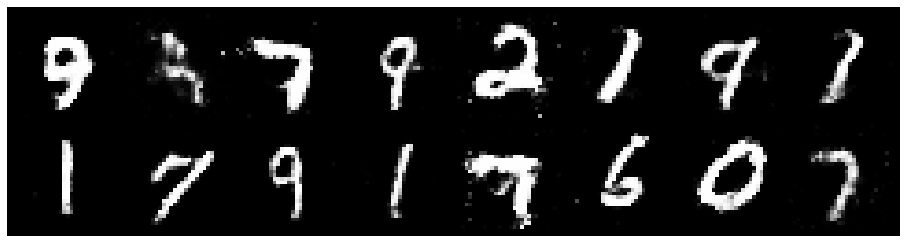

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.0101, Generator Loss: 1.2641
D(x): 0.6287, D(G(z)): 0.3247


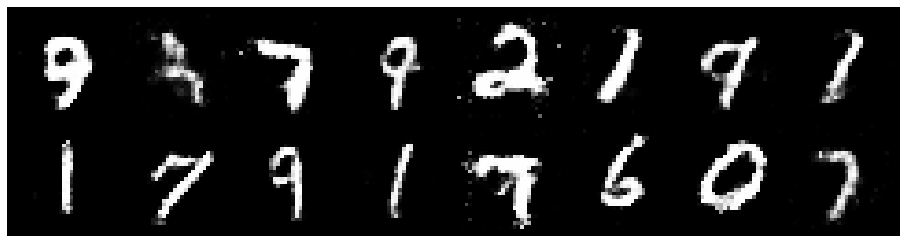

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.1193, Generator Loss: 1.2532
D(x): 0.6480, D(G(z)): 0.3543


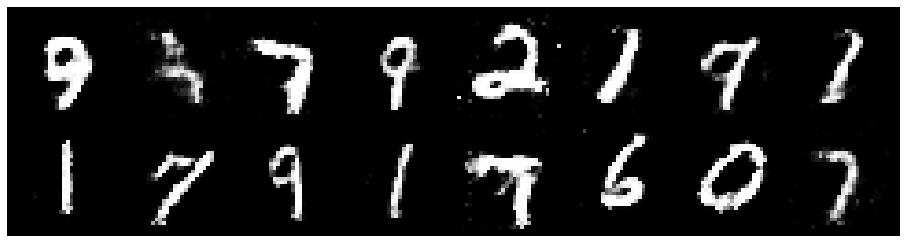

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 0.9339, Generator Loss: 1.2854
D(x): 0.6883, D(G(z)): 0.3200


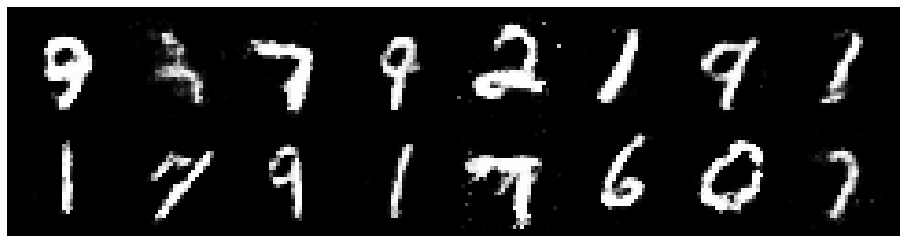

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.0340, Generator Loss: 1.3412
D(x): 0.5904, D(G(z)): 0.2829


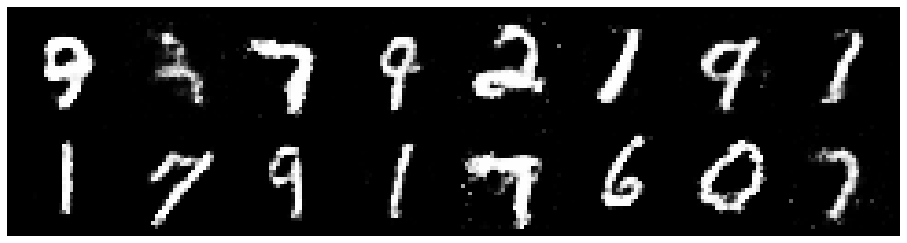

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.0635, Generator Loss: 1.2474
D(x): 0.6000, D(G(z)): 0.3078


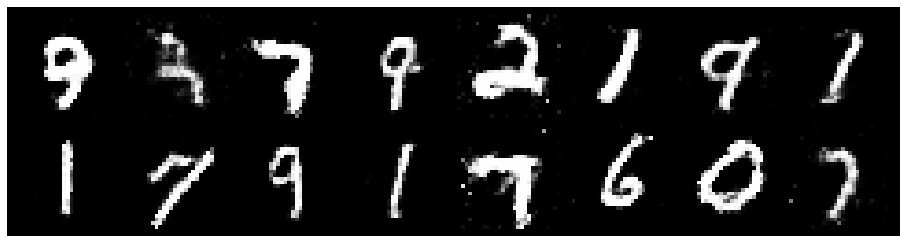

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 0.9829, Generator Loss: 1.1574
D(x): 0.6336, D(G(z)): 0.2901


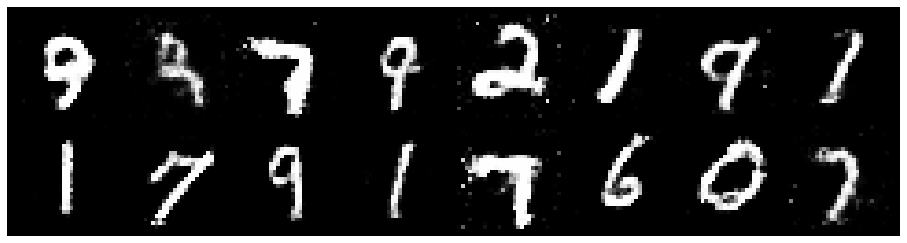

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 0.9499, Generator Loss: 1.3477
D(x): 0.6910, D(G(z)): 0.3402


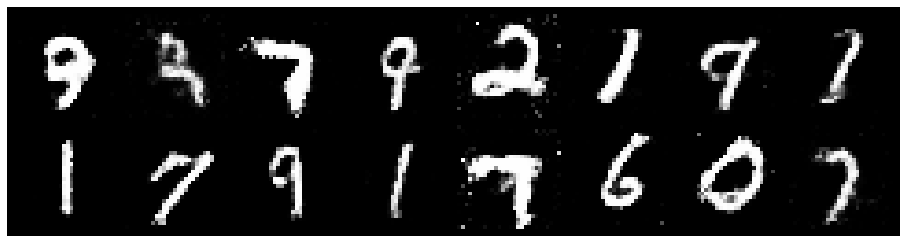

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.0259, Generator Loss: 1.1713
D(x): 0.6348, D(G(z)): 0.3102


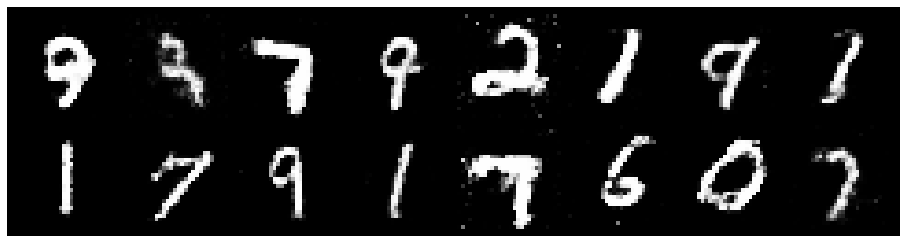

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 0.9454, Generator Loss: 1.4013
D(x): 0.6488, D(G(z)): 0.2928


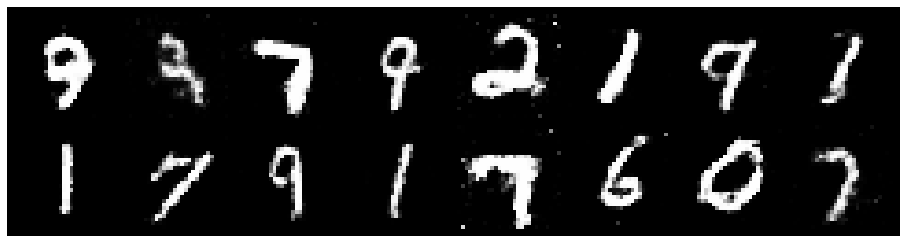

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.0876, Generator Loss: 1.2380
D(x): 0.6673, D(G(z)): 0.4080


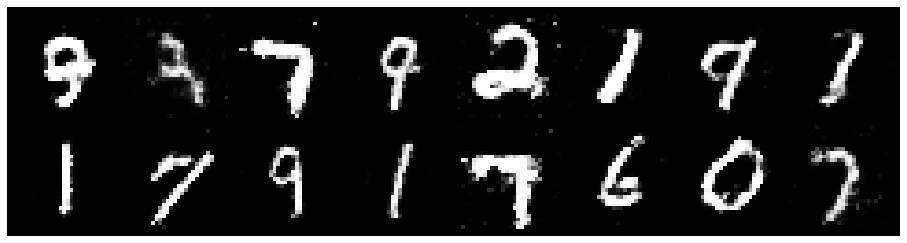

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.0450, Generator Loss: 1.2108
D(x): 0.6583, D(G(z)): 0.3838


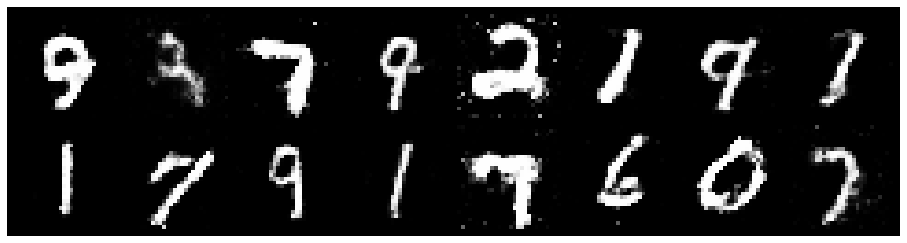

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 0.9978, Generator Loss: 1.2418
D(x): 0.7154, D(G(z)): 0.3885


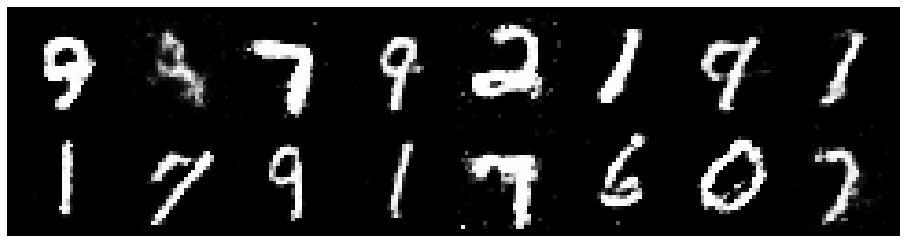

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.1056, Generator Loss: 1.4508
D(x): 0.6220, D(G(z)): 0.3477


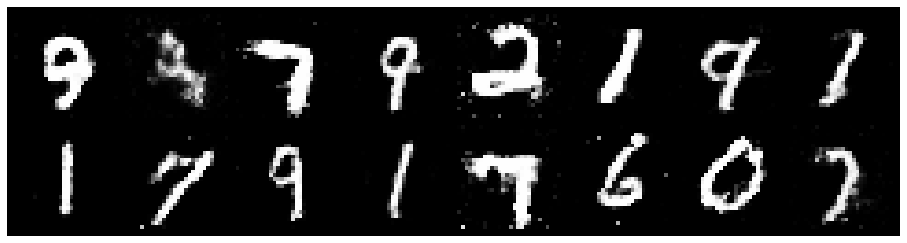

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 0.9937, Generator Loss: 1.3447
D(x): 0.6660, D(G(z)): 0.3362


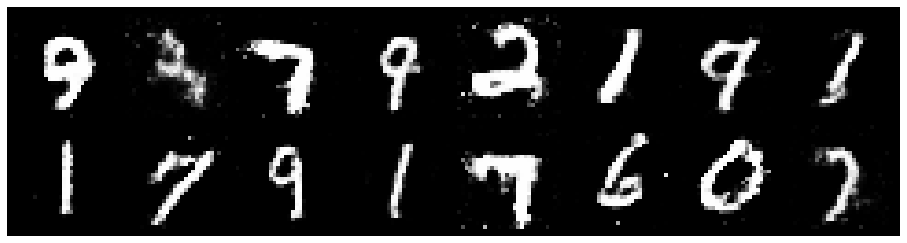

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 0.9952, Generator Loss: 1.4770
D(x): 0.6316, D(G(z)): 0.2830


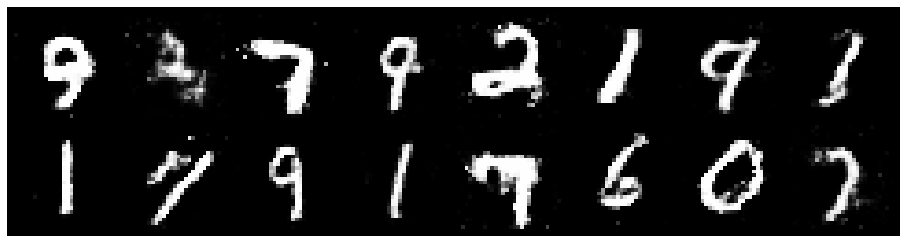

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.0475, Generator Loss: 1.2201
D(x): 0.6662, D(G(z)): 0.3732


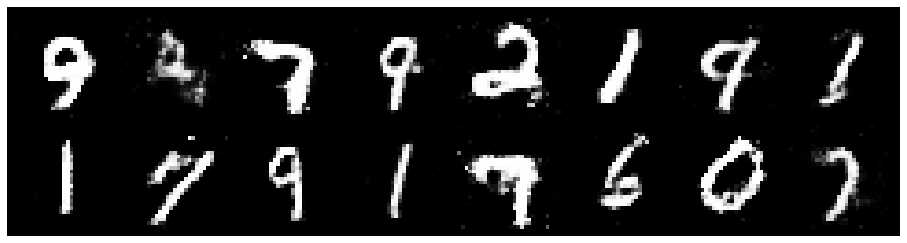

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.0232, Generator Loss: 1.3865
D(x): 0.6269, D(G(z)): 0.3299


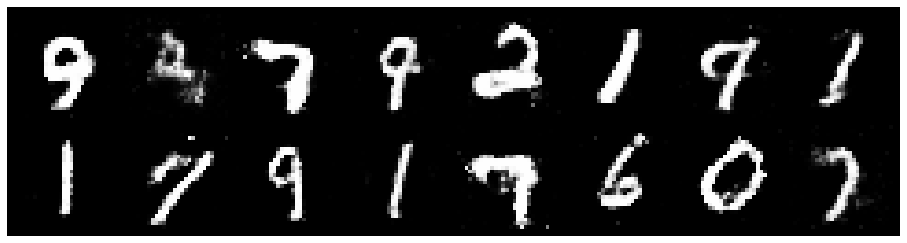

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 0.9852, Generator Loss: 1.2629
D(x): 0.6506, D(G(z)): 0.3234


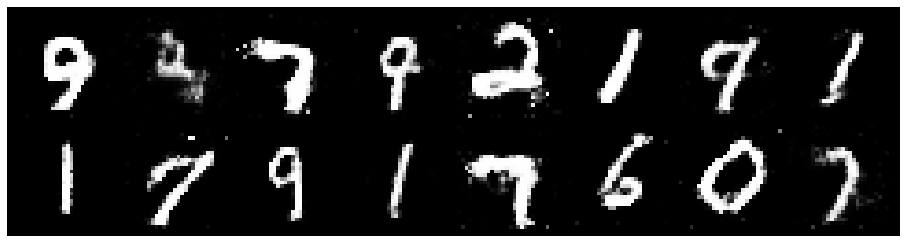

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.0548, Generator Loss: 1.2000
D(x): 0.6689, D(G(z)): 0.3791


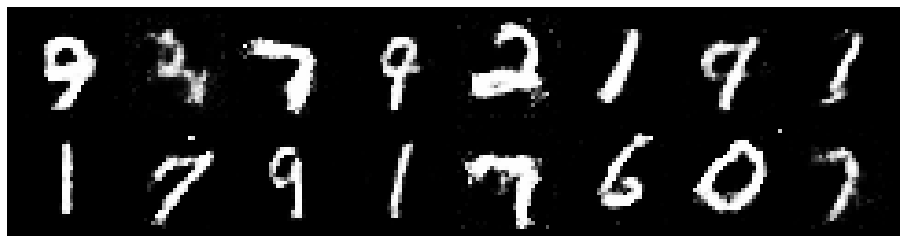

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 0.9106, Generator Loss: 1.0660
D(x): 0.7297, D(G(z)): 0.3588


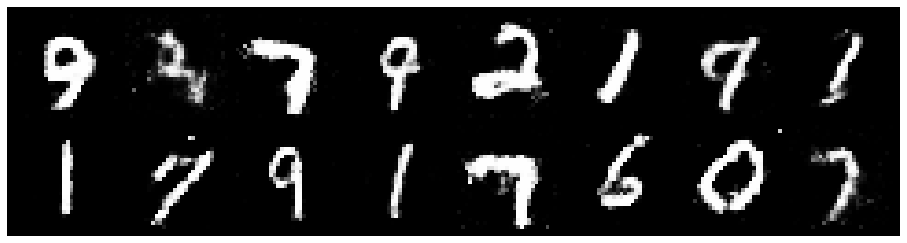

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.0469, Generator Loss: 1.2436
D(x): 0.6065, D(G(z)): 0.3277


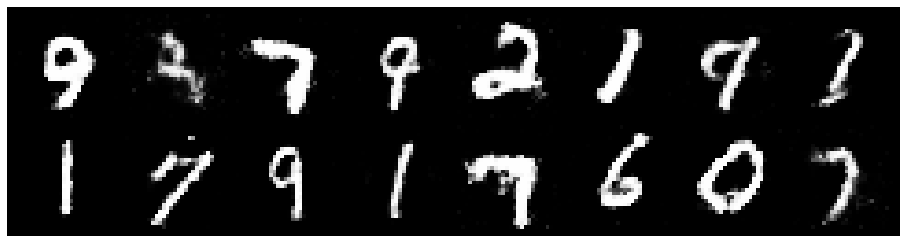

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.0381, Generator Loss: 1.3471
D(x): 0.6927, D(G(z)): 0.3857


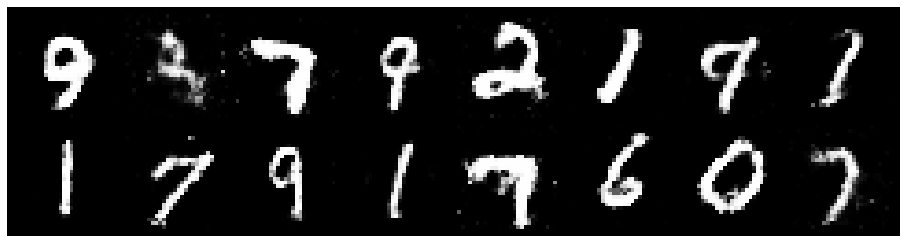

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.0287, Generator Loss: 1.2505
D(x): 0.6774, D(G(z)): 0.3647


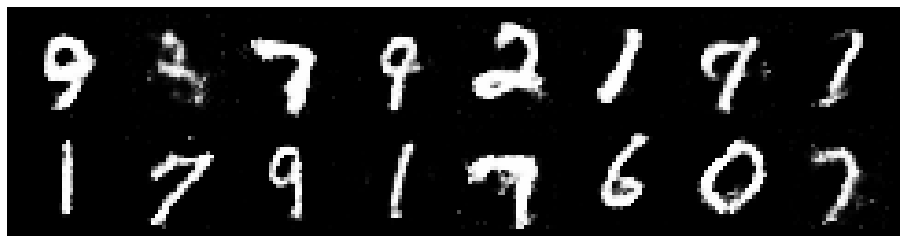

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 0.9794, Generator Loss: 1.3910
D(x): 0.6964, D(G(z)): 0.3476


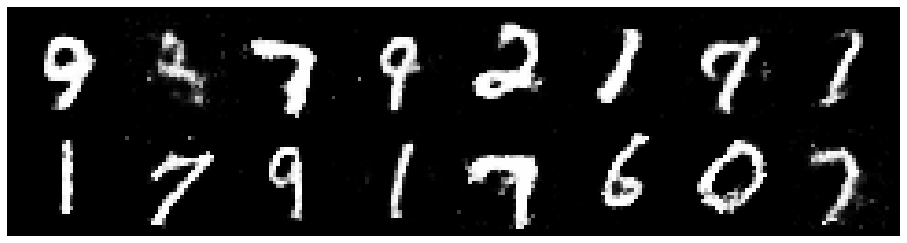

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 0.9092, Generator Loss: 1.2985
D(x): 0.6948, D(G(z)): 0.3240


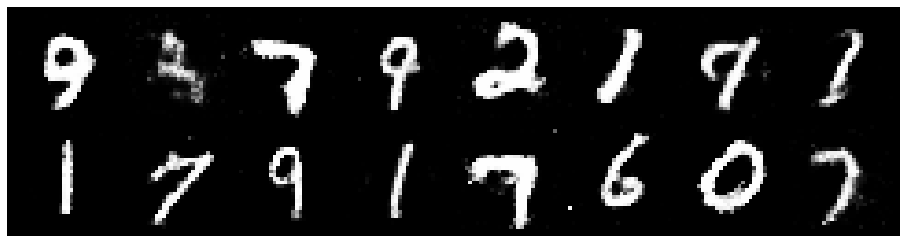

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.0089, Generator Loss: 1.3002
D(x): 0.6306, D(G(z)): 0.3309


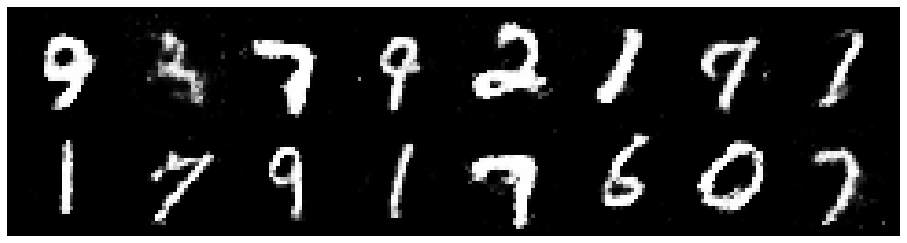

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.0610, Generator Loss: 1.3682
D(x): 0.6070, D(G(z)): 0.3124


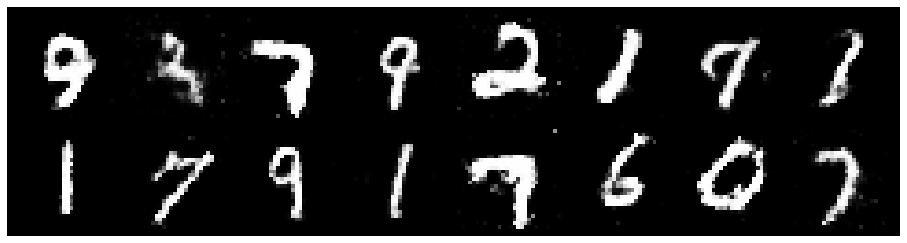

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.1203, Generator Loss: 1.2846
D(x): 0.6641, D(G(z)): 0.3905


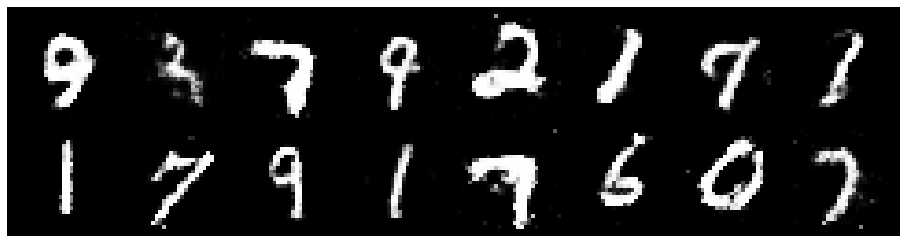

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 0.9517, Generator Loss: 1.3756
D(x): 0.6363, D(G(z)): 0.2952


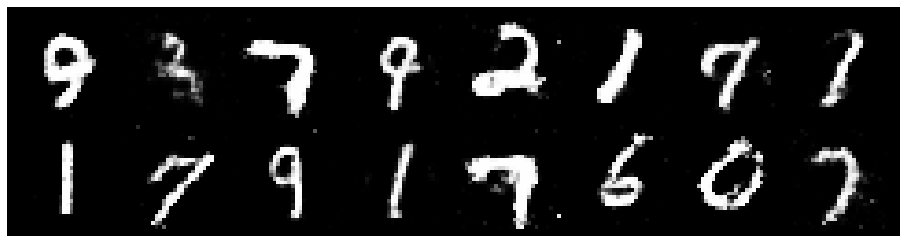

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.1683, Generator Loss: 1.3083
D(x): 0.5684, D(G(z)): 0.3060


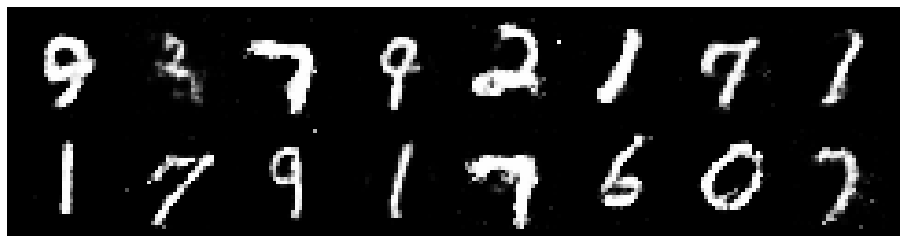

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 0.9272, Generator Loss: 1.3601
D(x): 0.6900, D(G(z)): 0.3303


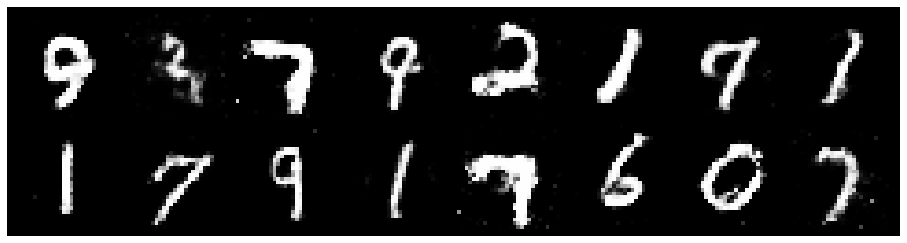

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 0.9426, Generator Loss: 1.1978
D(x): 0.6929, D(G(z)): 0.3572


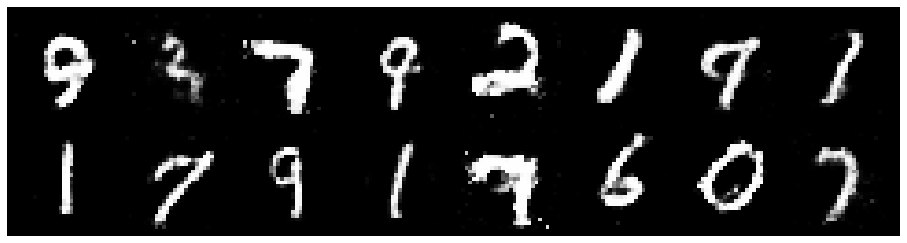

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.0587, Generator Loss: 1.2870
D(x): 0.5777, D(G(z)): 0.2993


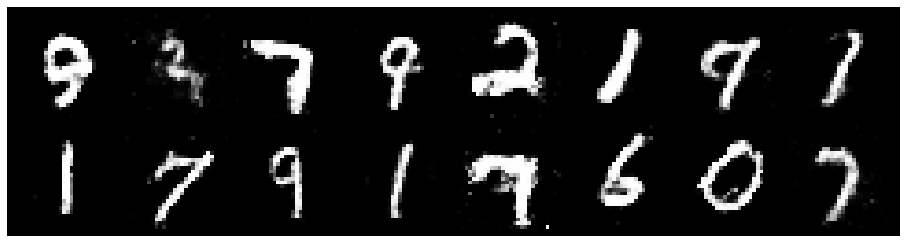

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.0315, Generator Loss: 1.3465
D(x): 0.6295, D(G(z)): 0.3094


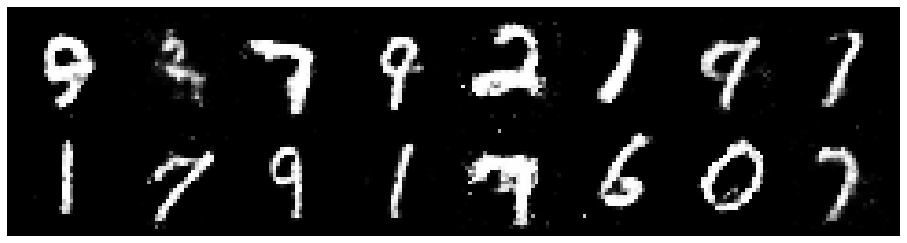

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.0932, Generator Loss: 1.1682
D(x): 0.6377, D(G(z)): 0.3777


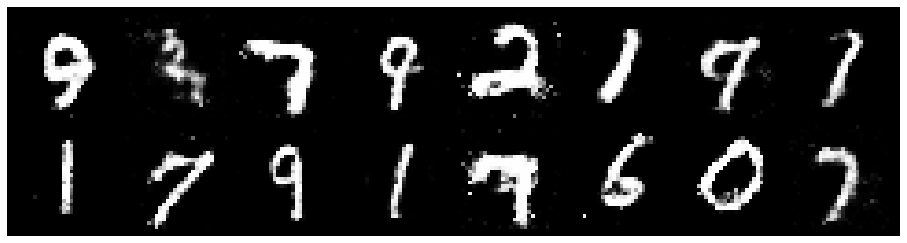

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.1012, Generator Loss: 1.2083
D(x): 0.6257, D(G(z)): 0.3796


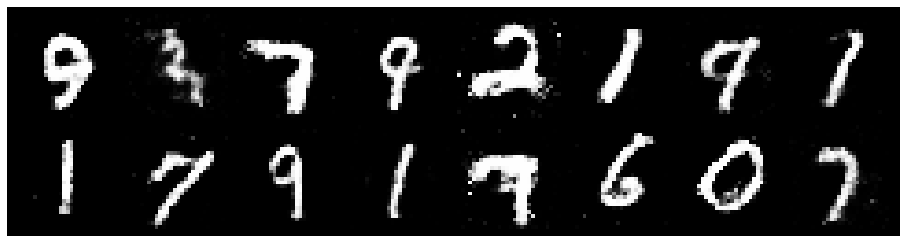

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 0.9450, Generator Loss: 1.3692
D(x): 0.6744, D(G(z)): 0.3206


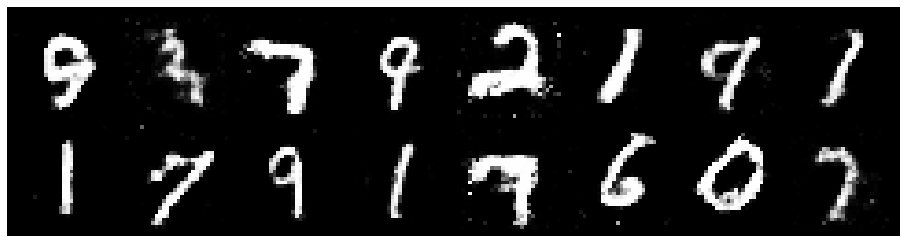

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 0.9144, Generator Loss: 1.2225
D(x): 0.7137, D(G(z)): 0.3608


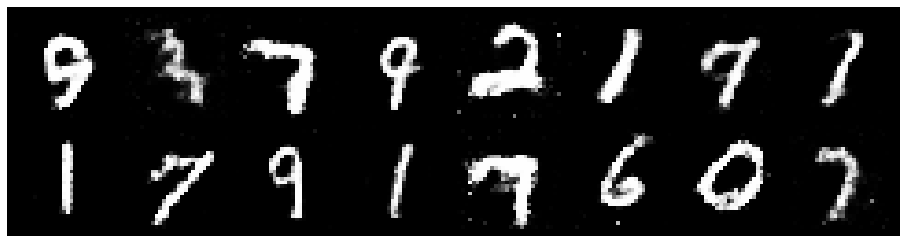

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.0709, Generator Loss: 1.2034
D(x): 0.6647, D(G(z)): 0.3762


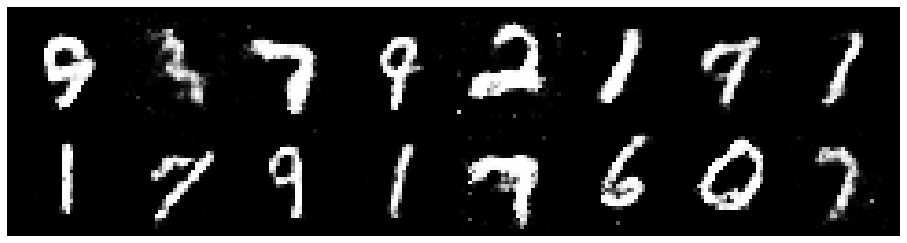

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 0.8695, Generator Loss: 1.3651
D(x): 0.6626, D(G(z)): 0.2991


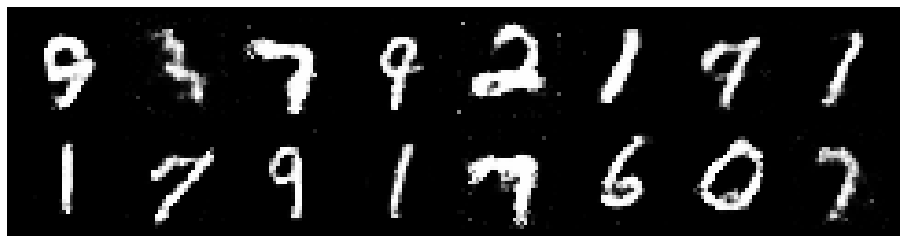

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 0.9793, Generator Loss: 1.3942
D(x): 0.6802, D(G(z)): 0.3351


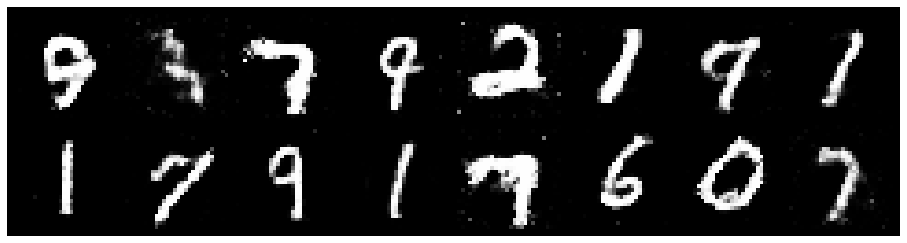

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 0.8664, Generator Loss: 1.2766
D(x): 0.6914, D(G(z)): 0.3012


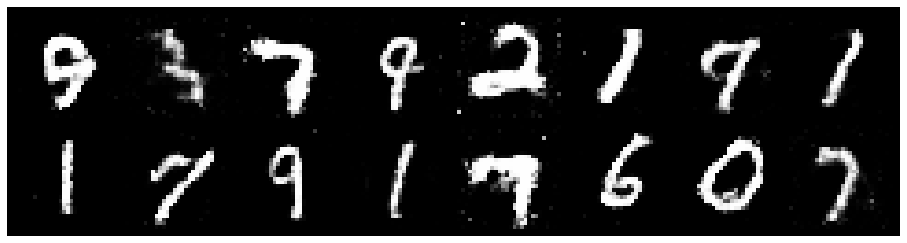

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 0.9688, Generator Loss: 1.2962
D(x): 0.6828, D(G(z)): 0.3467


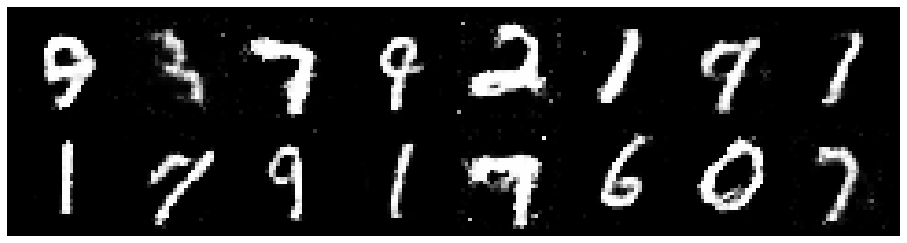

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 0.9794, Generator Loss: 1.3490
D(x): 0.6427, D(G(z)): 0.3126


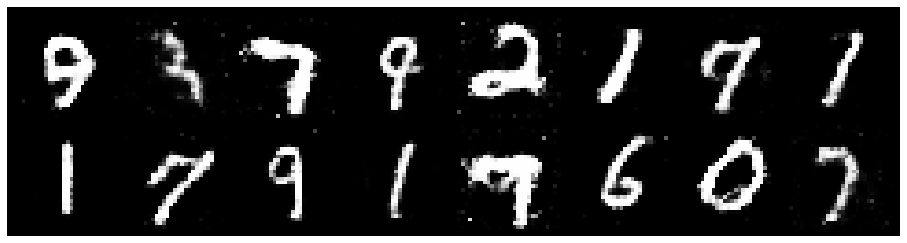

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.1286, Generator Loss: 1.3604
D(x): 0.5776, D(G(z)): 0.3160


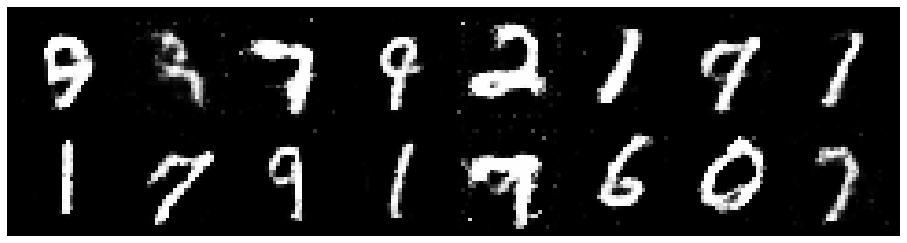

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.2076, Generator Loss: 1.2425
D(x): 0.6326, D(G(z)): 0.4078


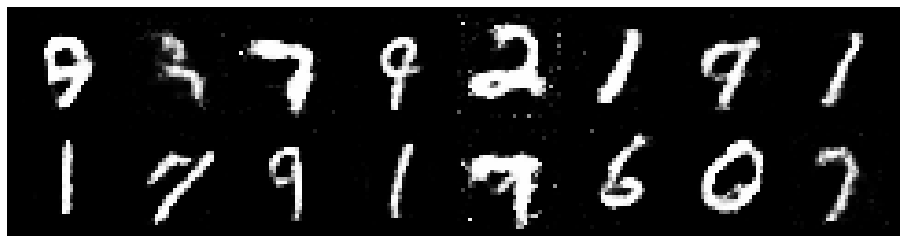

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 0.9299, Generator Loss: 1.3194
D(x): 0.6921, D(G(z)): 0.3446


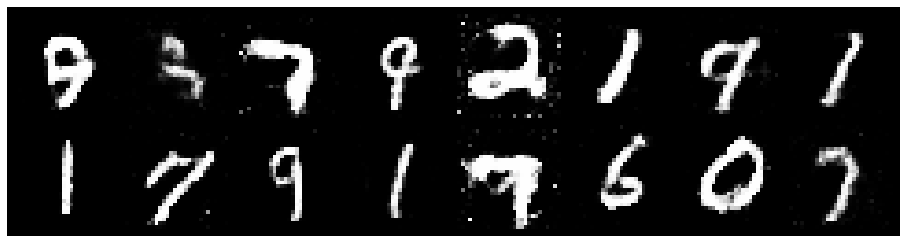

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 0.9789, Generator Loss: 1.5218
D(x): 0.6039, D(G(z)): 0.2705


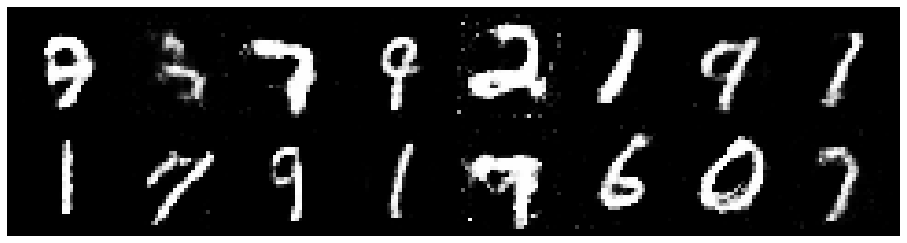

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 0.9419, Generator Loss: 1.3706
D(x): 0.6919, D(G(z)): 0.3431


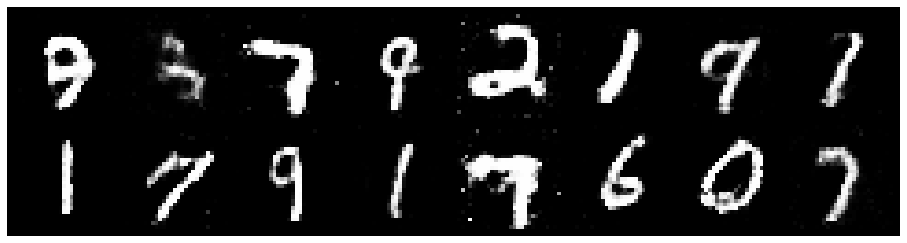

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 0.9716, Generator Loss: 1.1961
D(x): 0.6242, D(G(z)): 0.3040


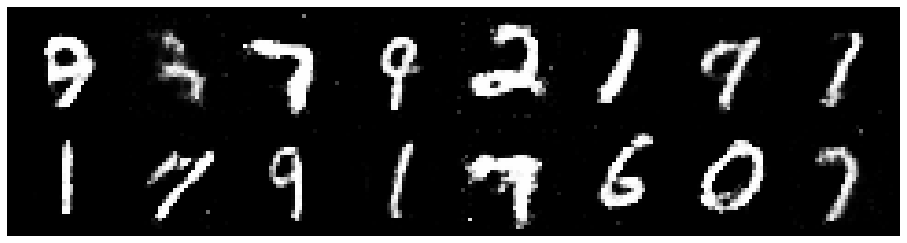

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.0031, Generator Loss: 1.2173
D(x): 0.6884, D(G(z)): 0.3813


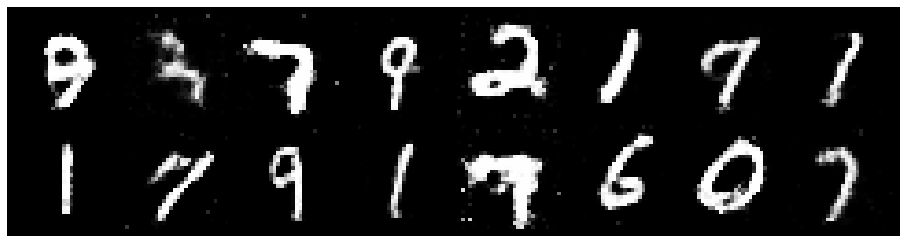

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 0.9326, Generator Loss: 1.3145
D(x): 0.6594, D(G(z)): 0.3081


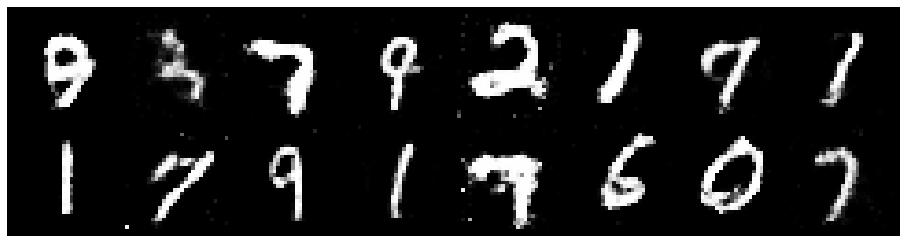

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.0262, Generator Loss: 1.2859
D(x): 0.6642, D(G(z)): 0.3483


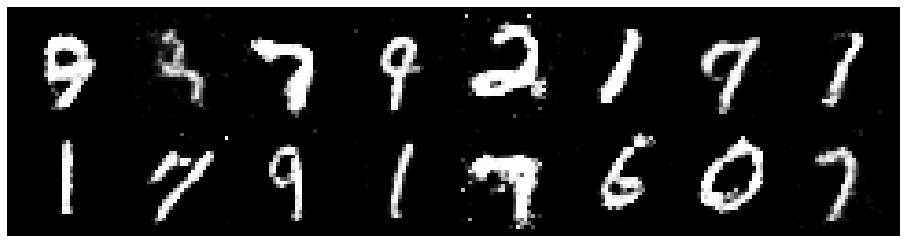

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.0554, Generator Loss: 1.7166
D(x): 0.6223, D(G(z)): 0.3040


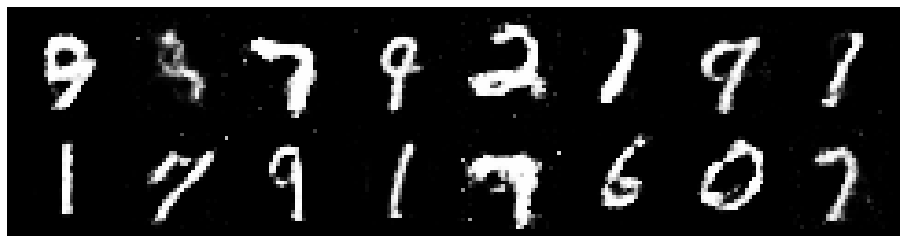

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.1626, Generator Loss: 1.1051
D(x): 0.6348, D(G(z)): 0.3875


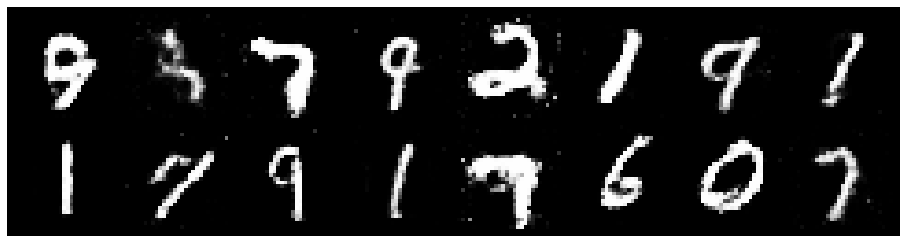

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.1203, Generator Loss: 1.0946
D(x): 0.6266, D(G(z)): 0.3801


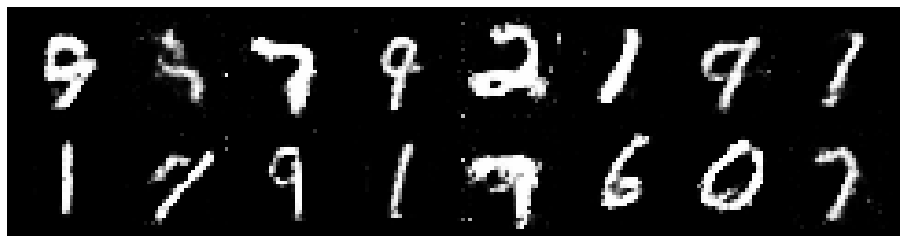

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.1245, Generator Loss: 1.4220
D(x): 0.6094, D(G(z)): 0.3550


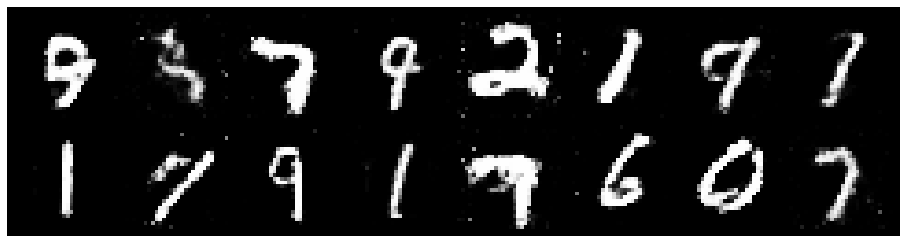

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.0860, Generator Loss: 1.3607
D(x): 0.6105, D(G(z)): 0.3332


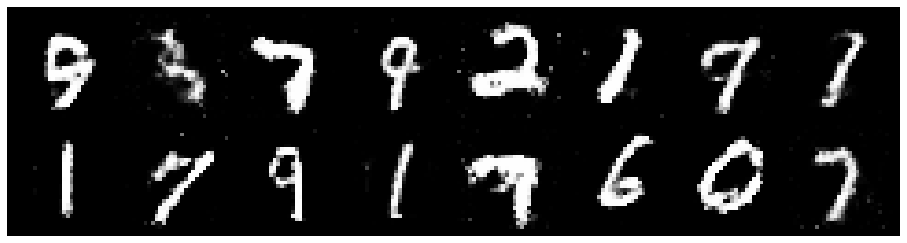

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 0.9669, Generator Loss: 1.1974
D(x): 0.6973, D(G(z)): 0.3605


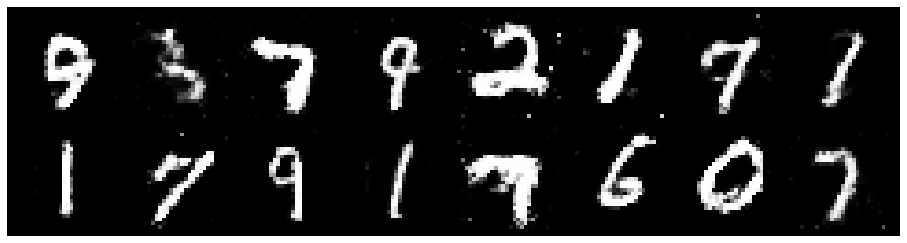

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 0.9270, Generator Loss: 1.2490
D(x): 0.6794, D(G(z)): 0.3248


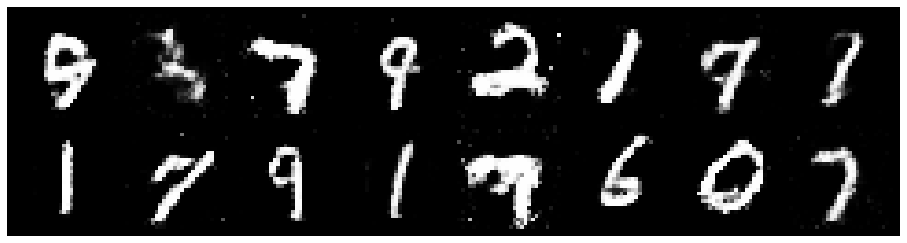

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.0264, Generator Loss: 1.3280
D(x): 0.6712, D(G(z)): 0.3586


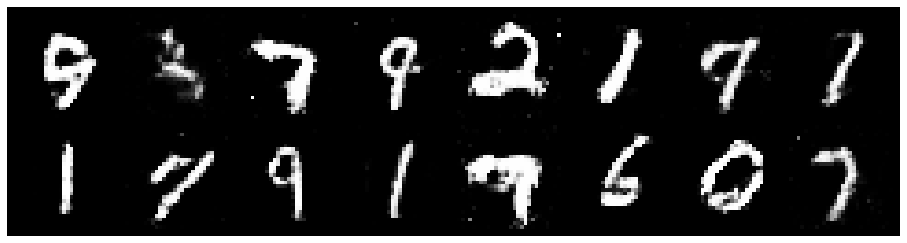

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 0.9996, Generator Loss: 1.2533
D(x): 0.6931, D(G(z)): 0.3826


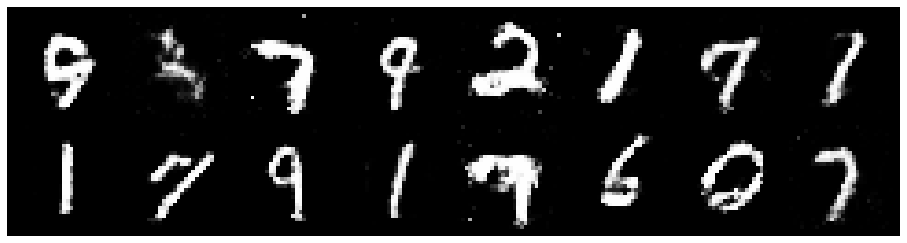

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.1586, Generator Loss: 1.2368
D(x): 0.6113, D(G(z)): 0.3722


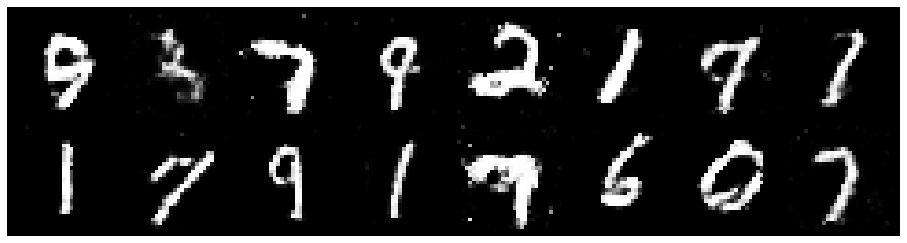

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.1533, Generator Loss: 1.2684
D(x): 0.5917, D(G(z)): 0.3612


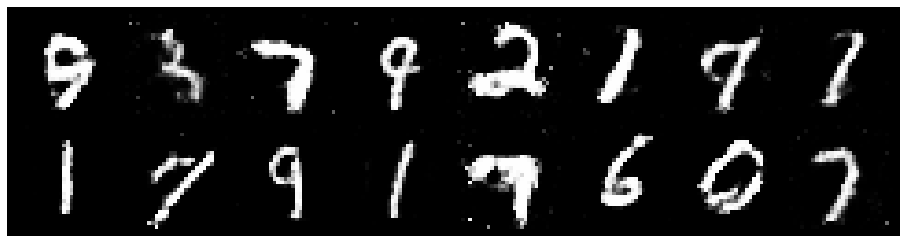

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.0817, Generator Loss: 1.3154
D(x): 0.6849, D(G(z)): 0.4035


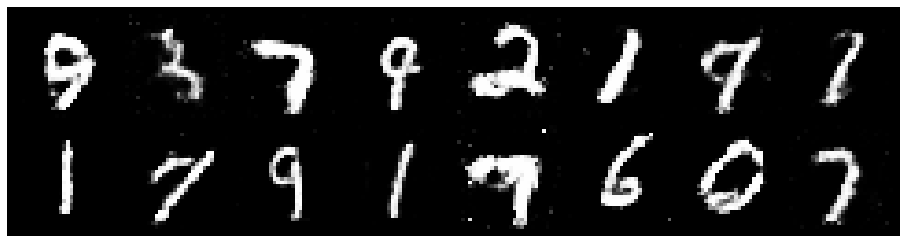

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.1065, Generator Loss: 1.2712
D(x): 0.6221, D(G(z)): 0.3637


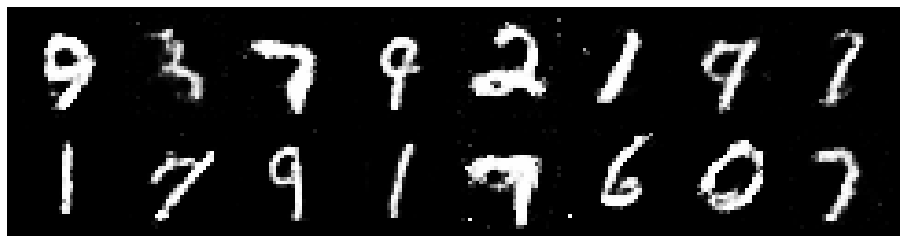

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 0.9017, Generator Loss: 1.5130
D(x): 0.6711, D(G(z)): 0.2991


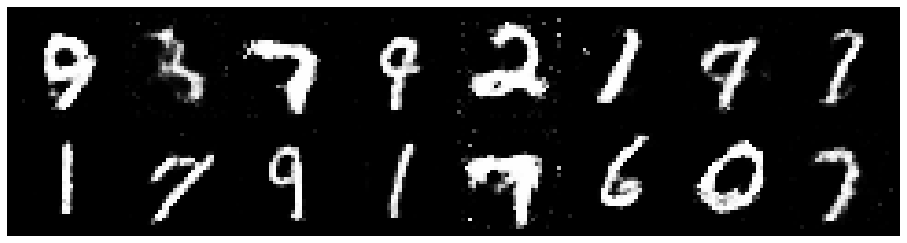

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 0.9772, Generator Loss: 1.2319
D(x): 0.6487, D(G(z)): 0.3194


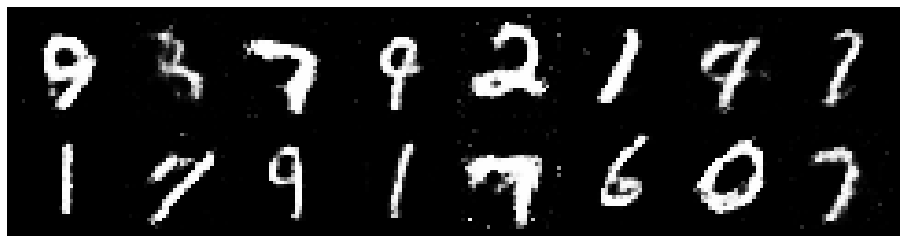

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.0093, Generator Loss: 1.3090
D(x): 0.6503, D(G(z)): 0.3333


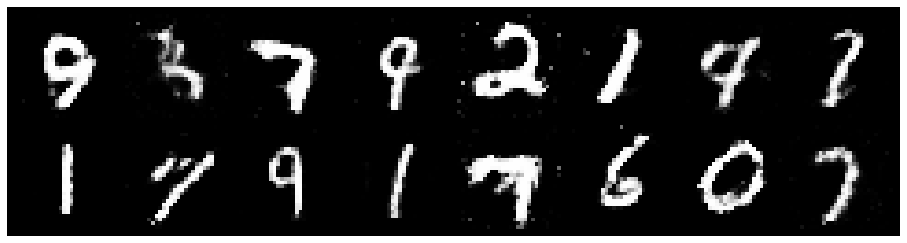

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.0164, Generator Loss: 1.2259
D(x): 0.7045, D(G(z)): 0.3933


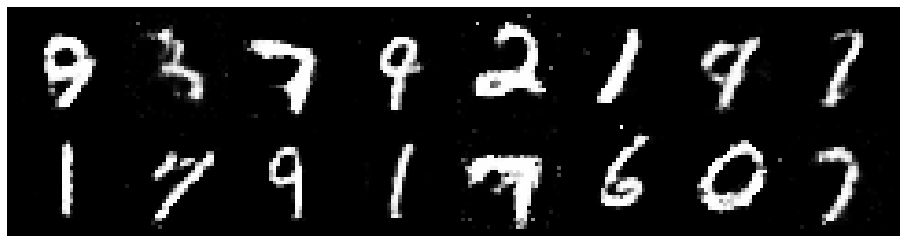

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 0.9479, Generator Loss: 1.2062
D(x): 0.6706, D(G(z)): 0.3307


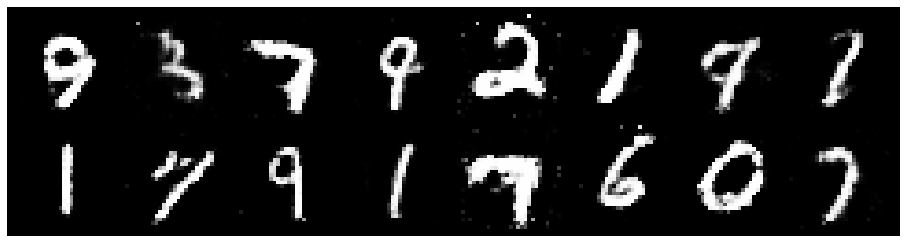

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.1037, Generator Loss: 1.2215
D(x): 0.6471, D(G(z)): 0.3856


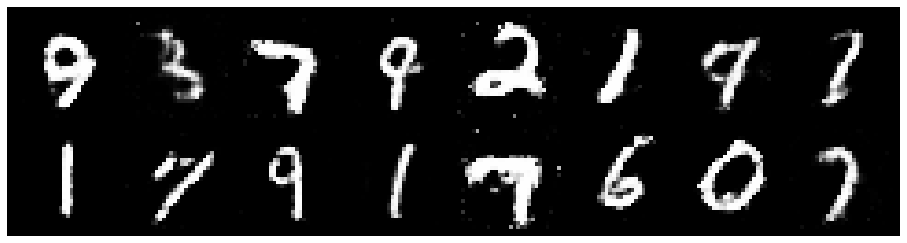

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.0752, Generator Loss: 1.2023
D(x): 0.6342, D(G(z)): 0.3624


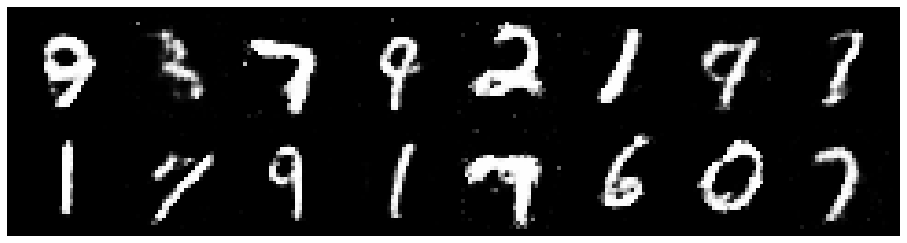

Epoch: [128/200], Batch Num: [400/600]
Discriminator Loss: 1.1227, Generator Loss: 0.9959
D(x): 0.6031, D(G(z)): 0.3793


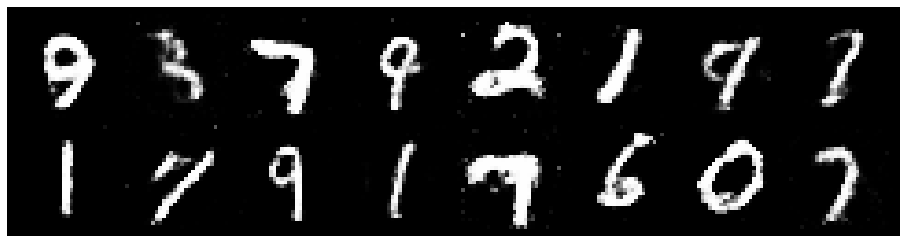

Epoch: [128/200], Batch Num: [500/600]
Discriminator Loss: 0.9304, Generator Loss: 1.4074
D(x): 0.6731, D(G(z)): 0.3287


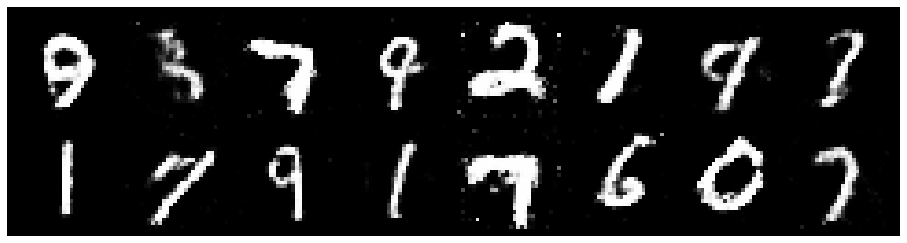

Epoch: [129/200], Batch Num: [0/600]
Discriminator Loss: 1.0345, Generator Loss: 1.4726
D(x): 0.6333, D(G(z)): 0.3192


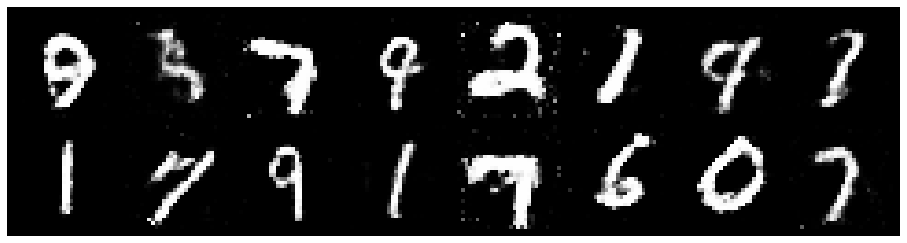

Epoch: [129/200], Batch Num: [100/600]
Discriminator Loss: 1.0953, Generator Loss: 1.2751
D(x): 0.6506, D(G(z)): 0.3822


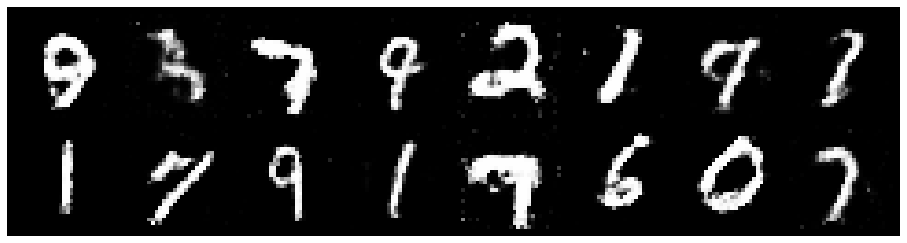

Epoch: [129/200], Batch Num: [200/600]
Discriminator Loss: 0.9432, Generator Loss: 1.3275
D(x): 0.6517, D(G(z)): 0.3161


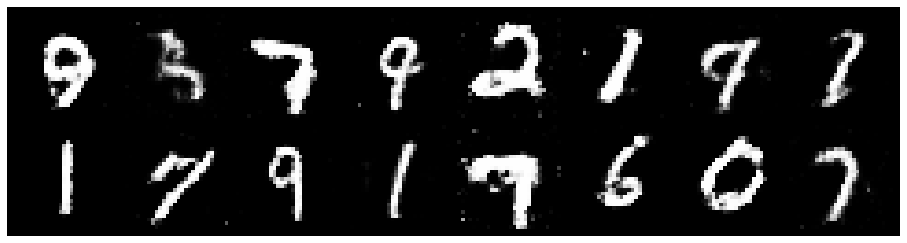

Epoch: [129/200], Batch Num: [300/600]
Discriminator Loss: 0.9519, Generator Loss: 1.2042
D(x): 0.7249, D(G(z)): 0.4046


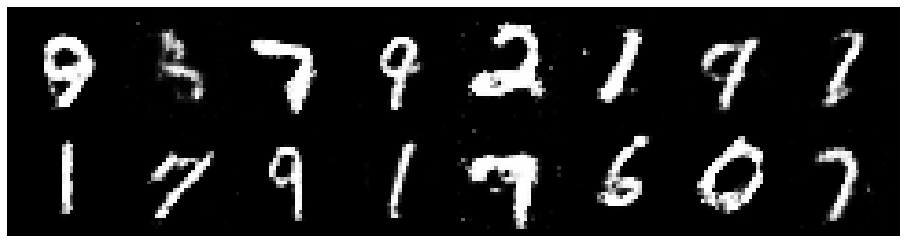

Epoch: [129/200], Batch Num: [400/600]
Discriminator Loss: 0.9826, Generator Loss: 1.1490
D(x): 0.6314, D(G(z)): 0.3163


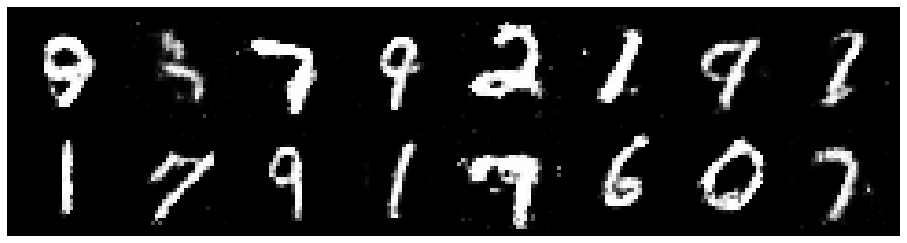

Epoch: [129/200], Batch Num: [500/600]
Discriminator Loss: 1.0965, Generator Loss: 1.1453
D(x): 0.6507, D(G(z)): 0.4054


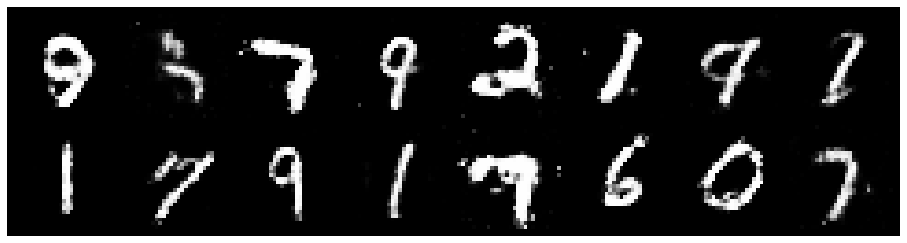

Epoch: [130/200], Batch Num: [0/600]
Discriminator Loss: 0.9460, Generator Loss: 1.2399
D(x): 0.7009, D(G(z)): 0.3567


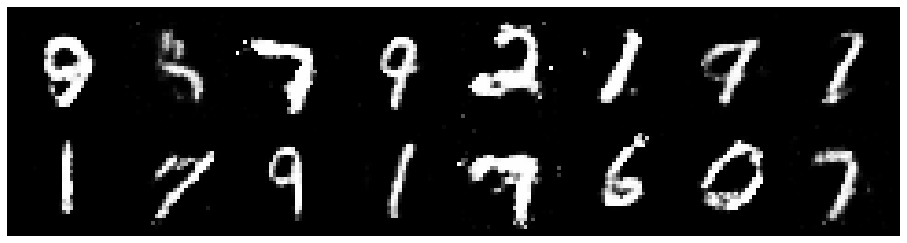

Epoch: [130/200], Batch Num: [100/600]
Discriminator Loss: 1.0241, Generator Loss: 1.2202
D(x): 0.6579, D(G(z)): 0.3600


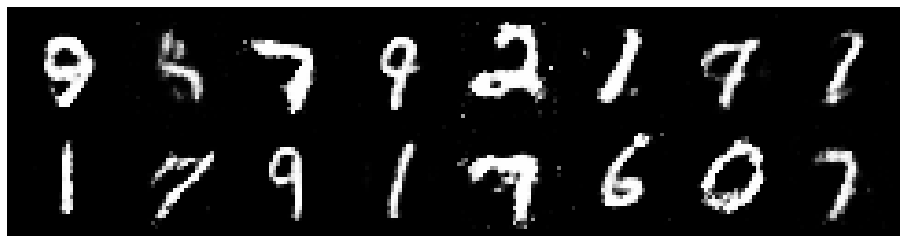

Epoch: [130/200], Batch Num: [200/600]
Discriminator Loss: 1.0692, Generator Loss: 1.0988
D(x): 0.6492, D(G(z)): 0.3854


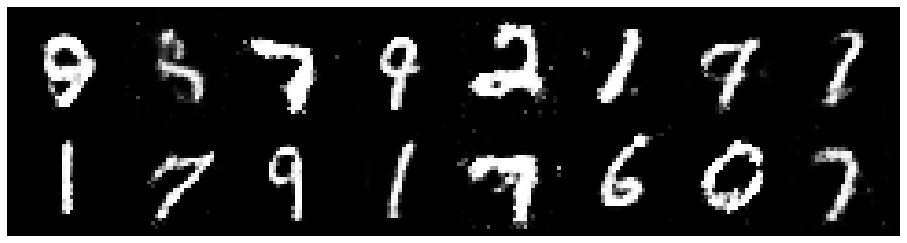

Epoch: [130/200], Batch Num: [300/600]
Discriminator Loss: 1.0169, Generator Loss: 1.3554
D(x): 0.6516, D(G(z)): 0.3492


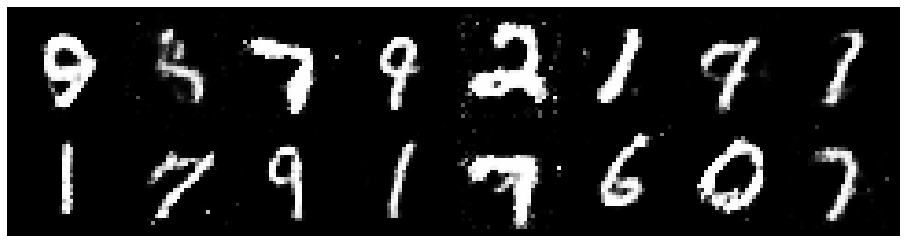

Epoch: [130/200], Batch Num: [400/600]
Discriminator Loss: 1.0230, Generator Loss: 1.2684
D(x): 0.6589, D(G(z)): 0.3502


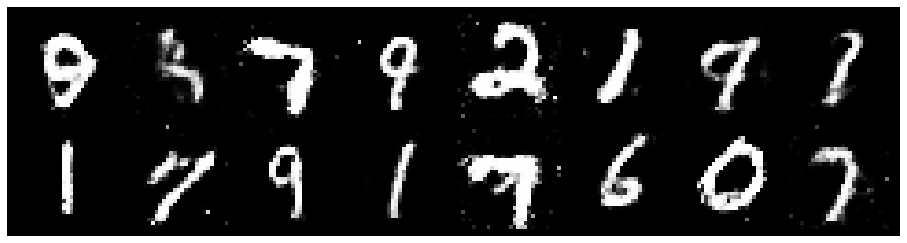

Epoch: [130/200], Batch Num: [500/600]
Discriminator Loss: 0.9825, Generator Loss: 1.3004
D(x): 0.6606, D(G(z)): 0.3253


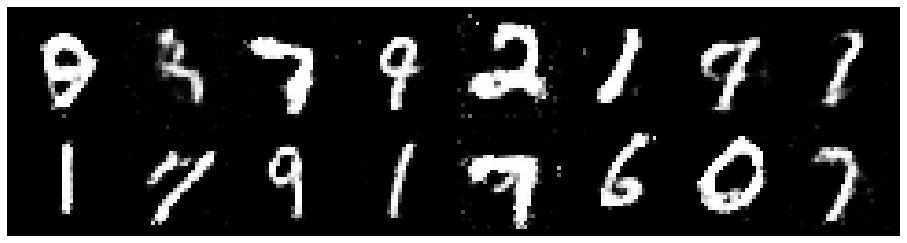

Epoch: [131/200], Batch Num: [0/600]
Discriminator Loss: 1.1378, Generator Loss: 1.1063
D(x): 0.6158, D(G(z)): 0.3777


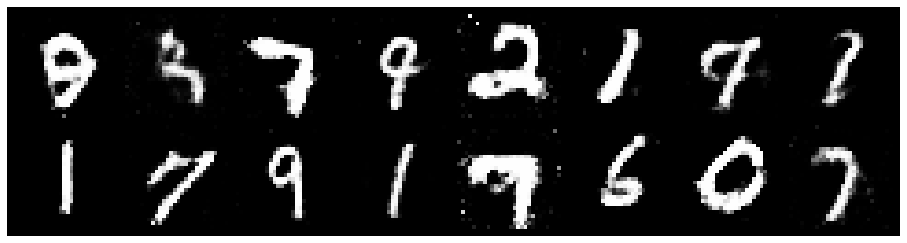

Epoch: [131/200], Batch Num: [100/600]
Discriminator Loss: 1.0161, Generator Loss: 1.1696
D(x): 0.6724, D(G(z)): 0.3672


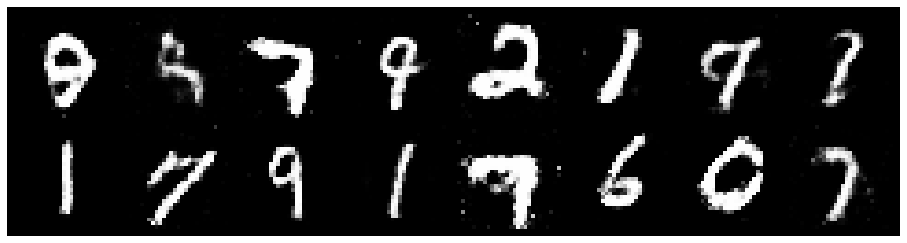

Epoch: [131/200], Batch Num: [200/600]
Discriminator Loss: 1.0593, Generator Loss: 1.0387
D(x): 0.6530, D(G(z)): 0.3796


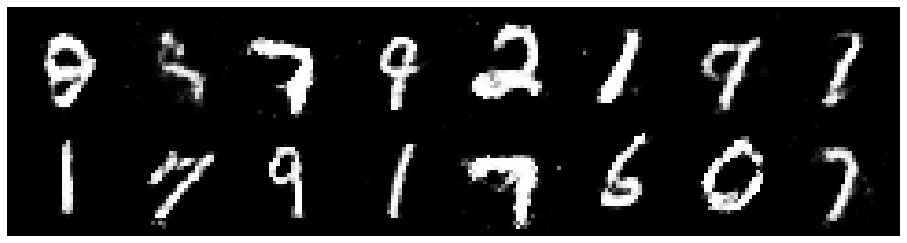

Epoch: [131/200], Batch Num: [300/600]
Discriminator Loss: 1.2049, Generator Loss: 1.2513
D(x): 0.5999, D(G(z)): 0.3781


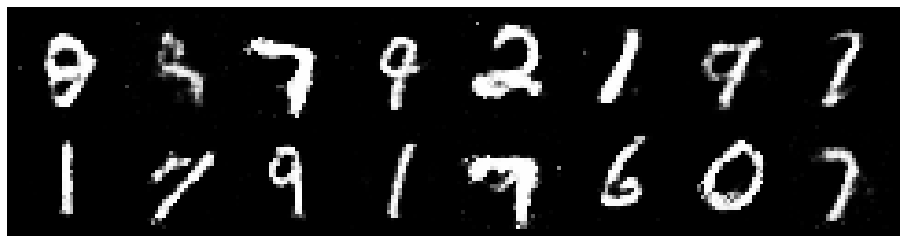

Epoch: [131/200], Batch Num: [400/600]
Discriminator Loss: 1.1521, Generator Loss: 1.1916
D(x): 0.6230, D(G(z)): 0.3789


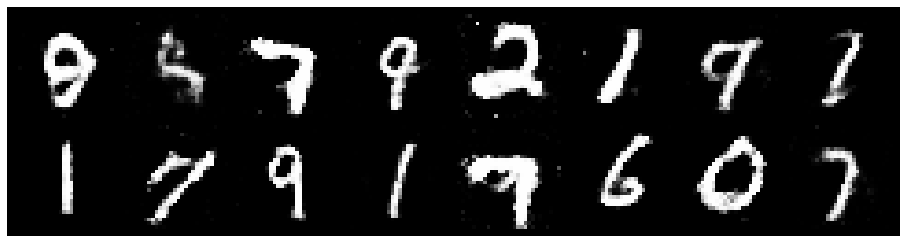

Epoch: [131/200], Batch Num: [500/600]
Discriminator Loss: 1.0598, Generator Loss: 1.0705
D(x): 0.6663, D(G(z)): 0.3970


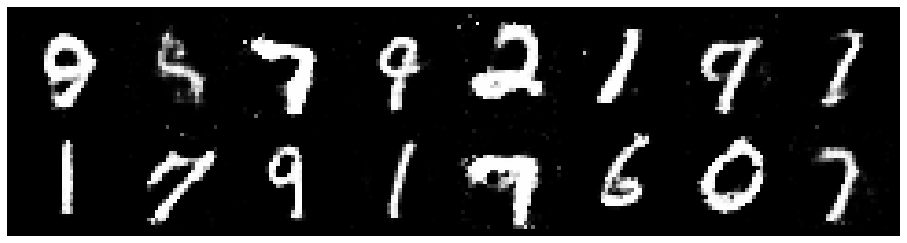

Epoch: [132/200], Batch Num: [0/600]
Discriminator Loss: 1.1113, Generator Loss: 1.2322
D(x): 0.6185, D(G(z)): 0.3779


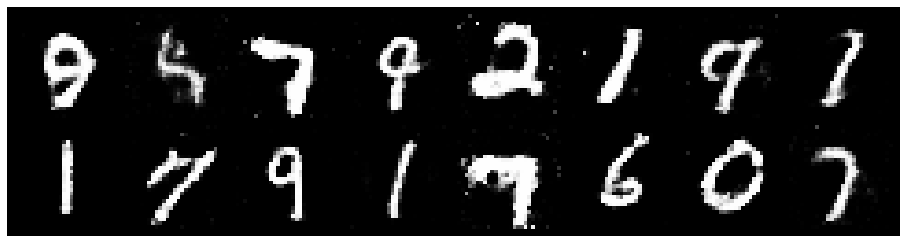

Epoch: [132/200], Batch Num: [100/600]
Discriminator Loss: 1.1447, Generator Loss: 1.2710
D(x): 0.5824, D(G(z)): 0.3425


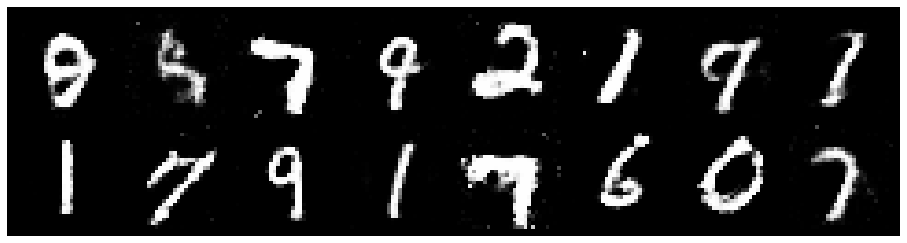

Epoch: [132/200], Batch Num: [200/600]
Discriminator Loss: 1.1469, Generator Loss: 1.1202
D(x): 0.6433, D(G(z)): 0.3816


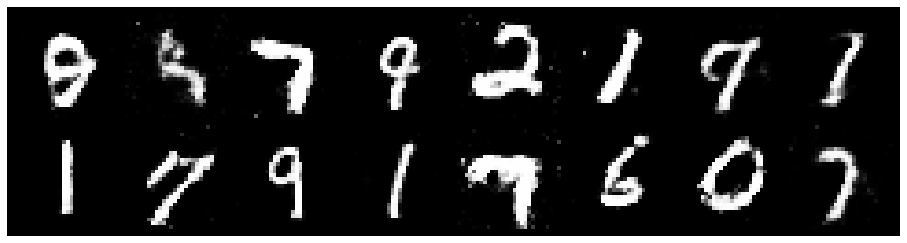

Epoch: [132/200], Batch Num: [300/600]
Discriminator Loss: 1.0279, Generator Loss: 1.3608
D(x): 0.6196, D(G(z)): 0.3271


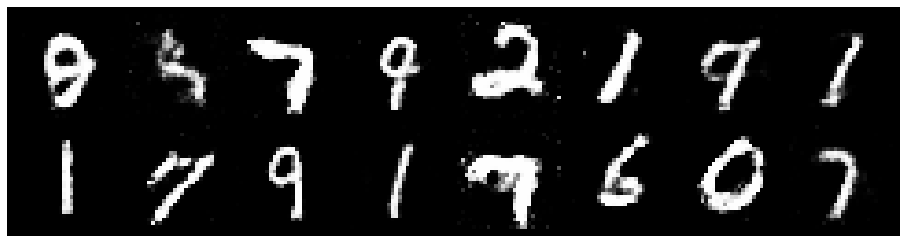

Epoch: [132/200], Batch Num: [400/600]
Discriminator Loss: 1.0827, Generator Loss: 1.2442
D(x): 0.6072, D(G(z)): 0.3261


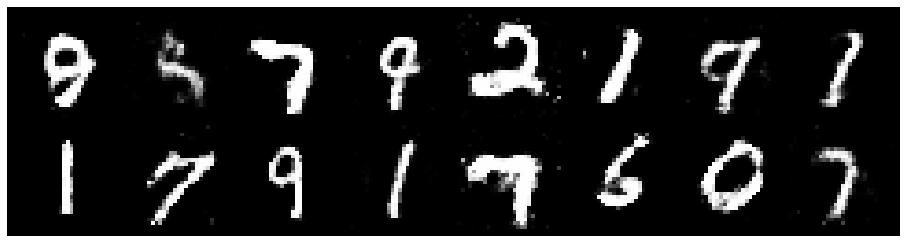

Epoch: [132/200], Batch Num: [500/600]
Discriminator Loss: 1.0344, Generator Loss: 1.3631
D(x): 0.6091, D(G(z)): 0.2945


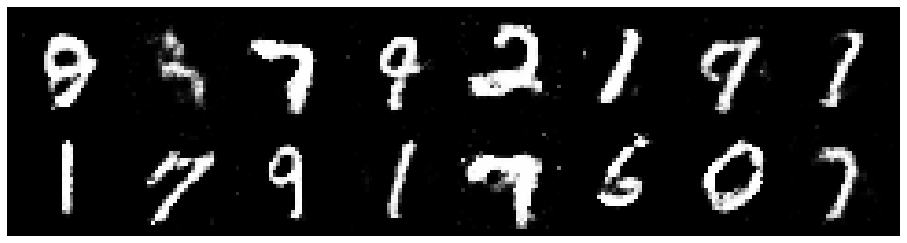

Epoch: [133/200], Batch Num: [0/600]
Discriminator Loss: 0.9961, Generator Loss: 1.1715
D(x): 0.6873, D(G(z)): 0.3744


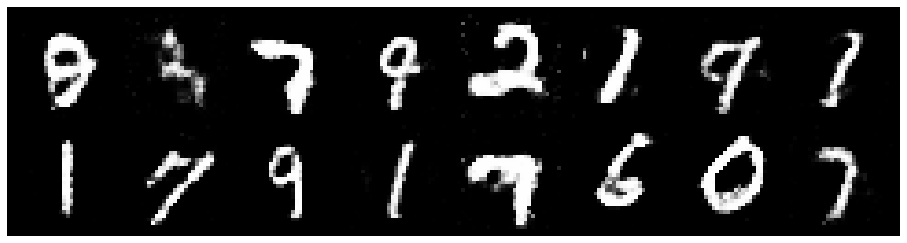

Epoch: [133/200], Batch Num: [100/600]
Discriminator Loss: 1.1457, Generator Loss: 1.2337
D(x): 0.6569, D(G(z)): 0.4210


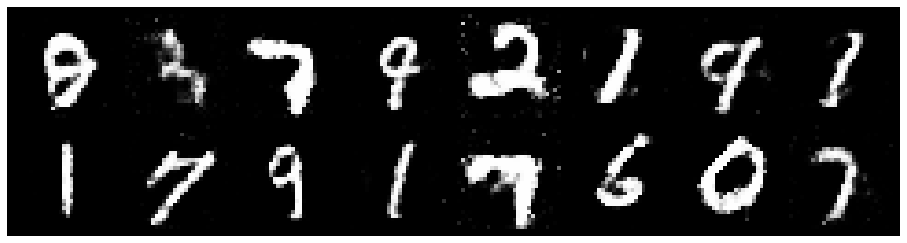

Epoch: [133/200], Batch Num: [200/600]
Discriminator Loss: 1.0784, Generator Loss: 1.1599
D(x): 0.6681, D(G(z)): 0.3928


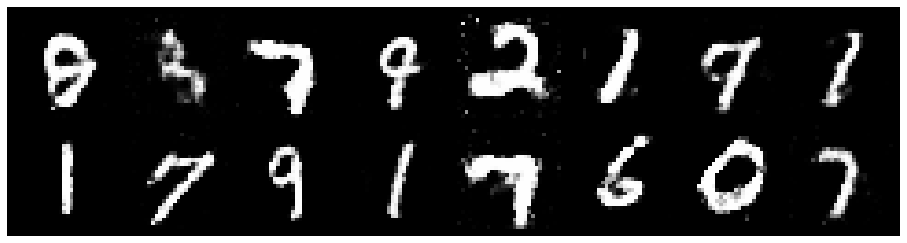

Epoch: [133/200], Batch Num: [300/600]
Discriminator Loss: 1.1763, Generator Loss: 1.2264
D(x): 0.6009, D(G(z)): 0.3709


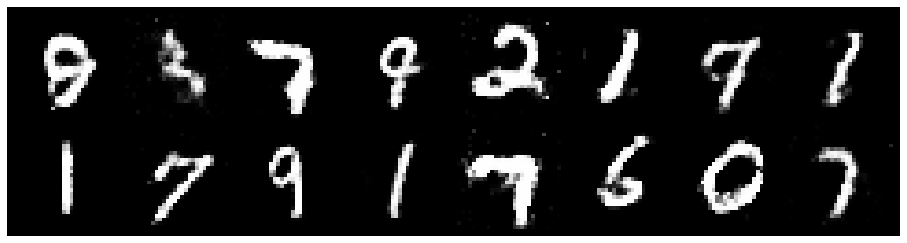

Epoch: [133/200], Batch Num: [400/600]
Discriminator Loss: 0.9914, Generator Loss: 1.1829
D(x): 0.6721, D(G(z)): 0.3630


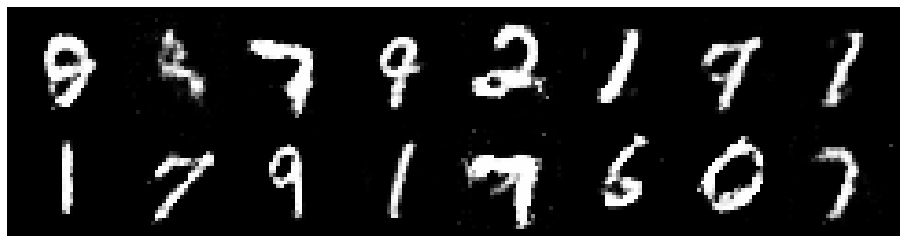

Epoch: [133/200], Batch Num: [500/600]
Discriminator Loss: 0.9985, Generator Loss: 1.1862
D(x): 0.6495, D(G(z)): 0.3625


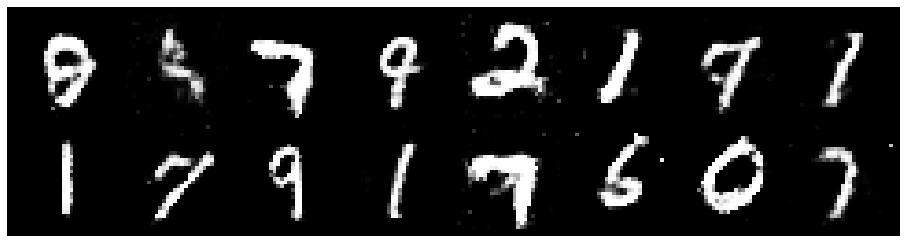

Epoch: [134/200], Batch Num: [0/600]
Discriminator Loss: 1.0328, Generator Loss: 0.9973
D(x): 0.6654, D(G(z)): 0.3947


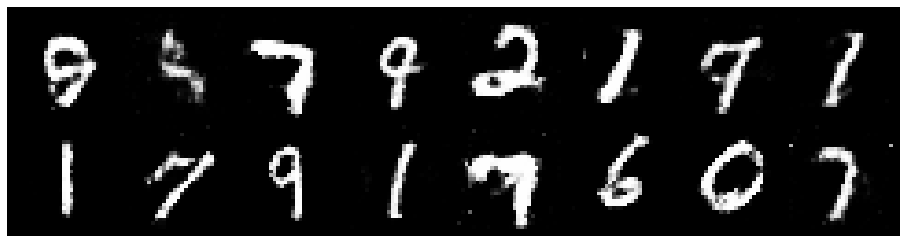

Epoch: [134/200], Batch Num: [100/600]
Discriminator Loss: 0.9908, Generator Loss: 1.2300
D(x): 0.6347, D(G(z)): 0.3370


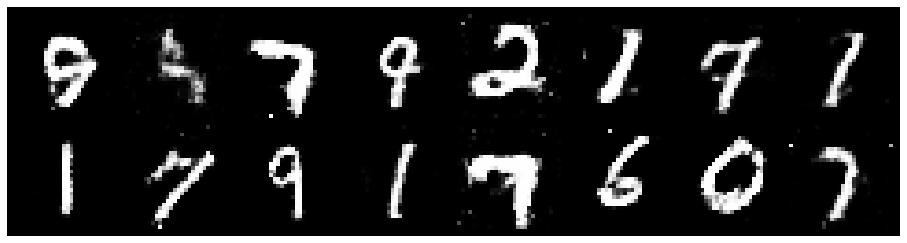

Epoch: [134/200], Batch Num: [200/600]
Discriminator Loss: 1.0689, Generator Loss: 1.2171
D(x): 0.6358, D(G(z)): 0.3558


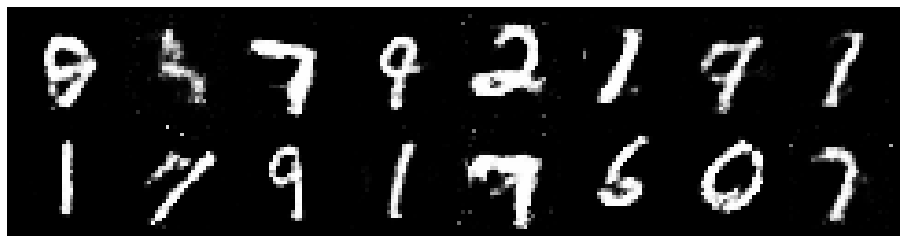

Epoch: [134/200], Batch Num: [300/600]
Discriminator Loss: 1.1675, Generator Loss: 1.2461
D(x): 0.6006, D(G(z)): 0.3757


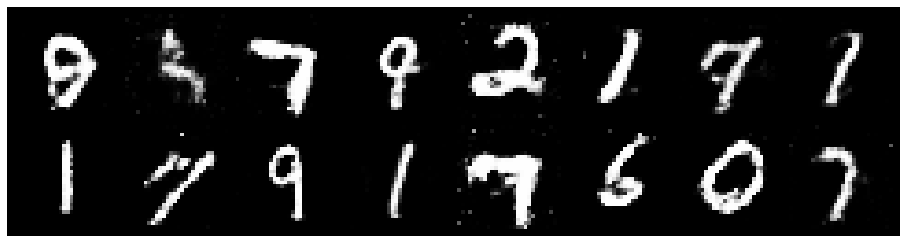

Epoch: [134/200], Batch Num: [400/600]
Discriminator Loss: 1.1438, Generator Loss: 1.1735
D(x): 0.6106, D(G(z)): 0.3630


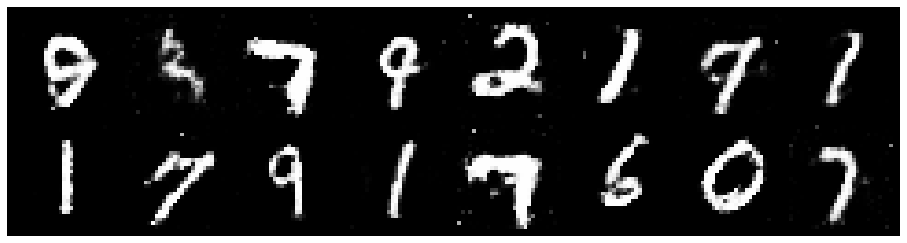

Epoch: [134/200], Batch Num: [500/600]
Discriminator Loss: 0.9426, Generator Loss: 1.3905
D(x): 0.6993, D(G(z)): 0.3443


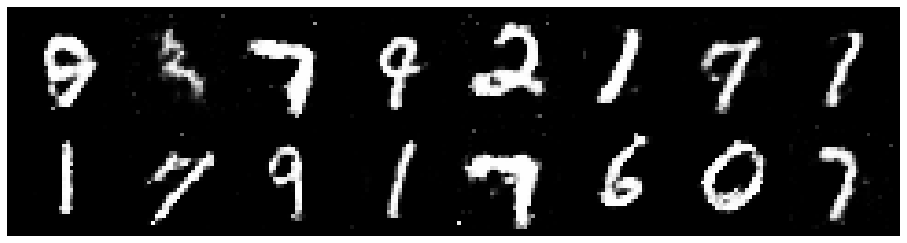

Epoch: [135/200], Batch Num: [0/600]
Discriminator Loss: 1.0529, Generator Loss: 1.4739
D(x): 0.6617, D(G(z)): 0.3692


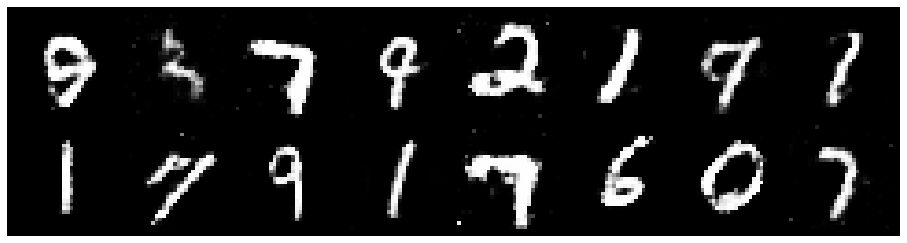

Epoch: [135/200], Batch Num: [100/600]
Discriminator Loss: 1.0377, Generator Loss: 1.1159
D(x): 0.6558, D(G(z)): 0.3659


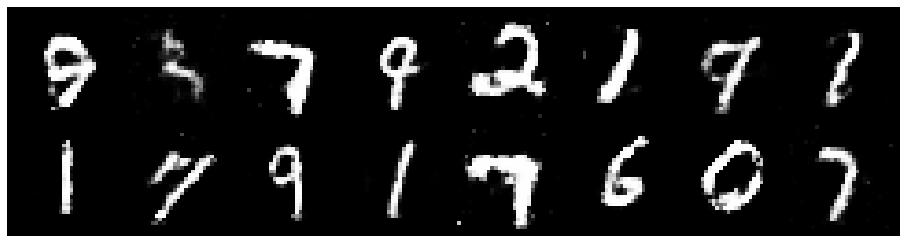

Epoch: [135/200], Batch Num: [200/600]
Discriminator Loss: 1.0723, Generator Loss: 1.2119
D(x): 0.6319, D(G(z)): 0.3520


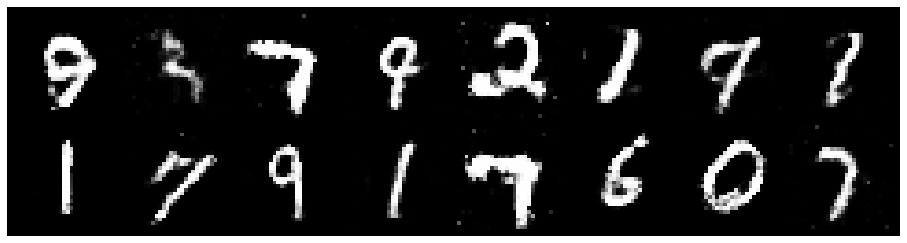

Epoch: [135/200], Batch Num: [300/600]
Discriminator Loss: 1.1457, Generator Loss: 1.1559
D(x): 0.5804, D(G(z)): 0.3553


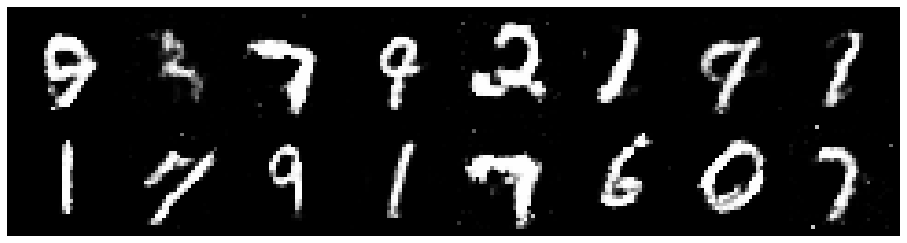

Epoch: [135/200], Batch Num: [400/600]
Discriminator Loss: 1.1034, Generator Loss: 1.5352
D(x): 0.6255, D(G(z)): 0.3280


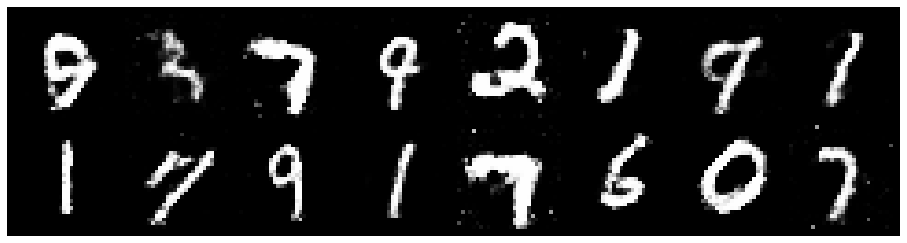

Epoch: [135/200], Batch Num: [500/600]
Discriminator Loss: 0.8587, Generator Loss: 1.3552
D(x): 0.7115, D(G(z)): 0.3143


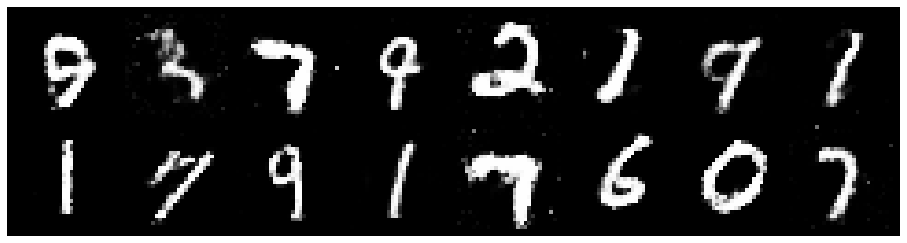

Epoch: [136/200], Batch Num: [0/600]
Discriminator Loss: 1.1735, Generator Loss: 1.0614
D(x): 0.6034, D(G(z)): 0.3805


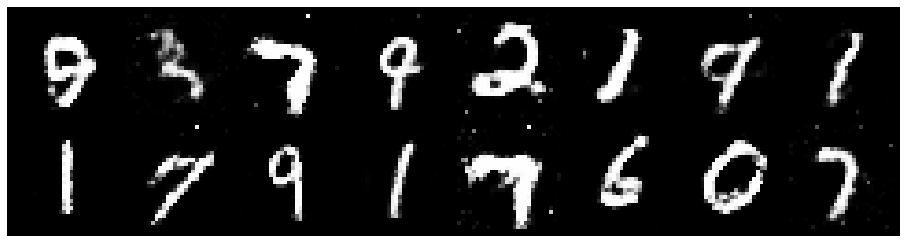

Epoch: [136/200], Batch Num: [100/600]
Discriminator Loss: 1.0694, Generator Loss: 1.3571
D(x): 0.6129, D(G(z)): 0.3221


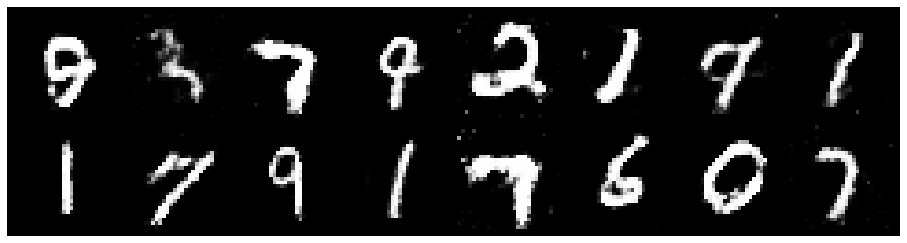

Epoch: [136/200], Batch Num: [200/600]
Discriminator Loss: 1.1272, Generator Loss: 1.1874
D(x): 0.6188, D(G(z)): 0.3829


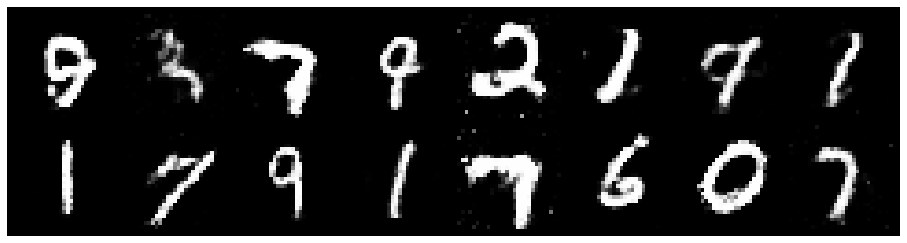

Epoch: [136/200], Batch Num: [300/600]
Discriminator Loss: 0.9655, Generator Loss: 1.1199
D(x): 0.6854, D(G(z)): 0.3807


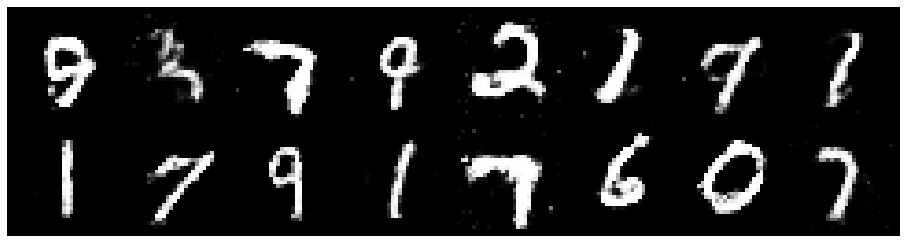

Epoch: [136/200], Batch Num: [400/600]
Discriminator Loss: 1.0702, Generator Loss: 1.1453
D(x): 0.6506, D(G(z)): 0.3759


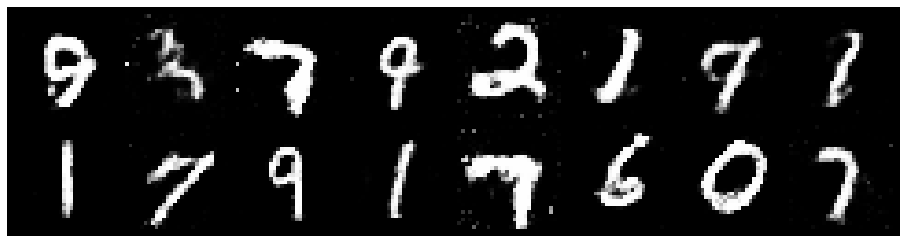

Epoch: [136/200], Batch Num: [500/600]
Discriminator Loss: 1.0327, Generator Loss: 1.3316
D(x): 0.6745, D(G(z)): 0.3670


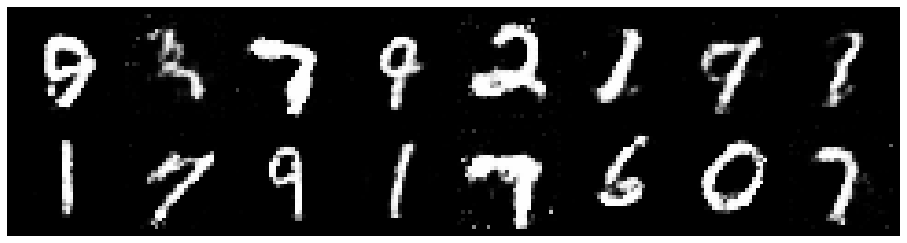

Epoch: [137/200], Batch Num: [0/600]
Discriminator Loss: 1.0096, Generator Loss: 1.0127
D(x): 0.6667, D(G(z)): 0.3716


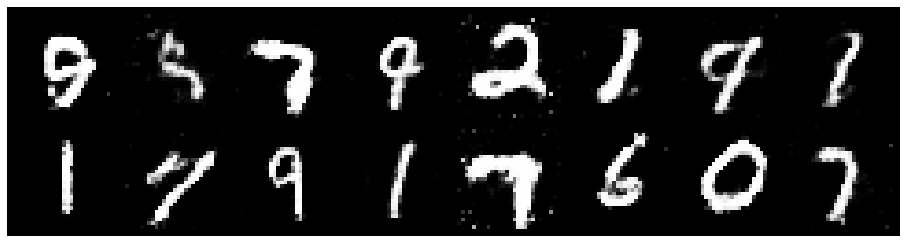

Epoch: [137/200], Batch Num: [100/600]
Discriminator Loss: 1.1294, Generator Loss: 1.1518
D(x): 0.6338, D(G(z)): 0.4036


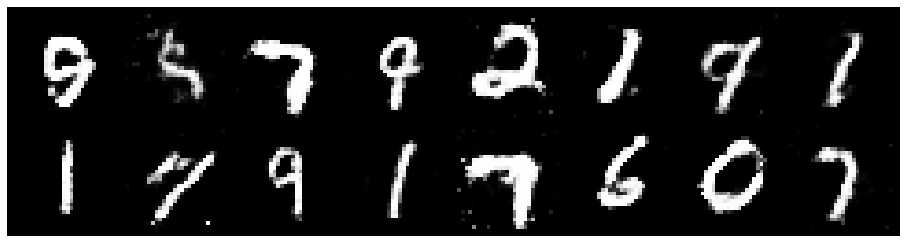

Epoch: [137/200], Batch Num: [200/600]
Discriminator Loss: 0.9664, Generator Loss: 1.0344
D(x): 0.6826, D(G(z)): 0.3571


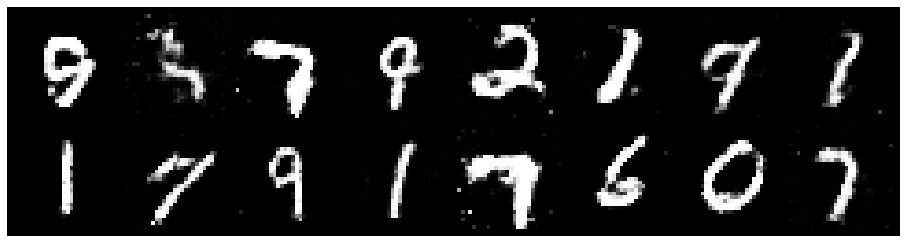

Epoch: [137/200], Batch Num: [300/600]
Discriminator Loss: 1.1130, Generator Loss: 1.1462
D(x): 0.6349, D(G(z)): 0.3915


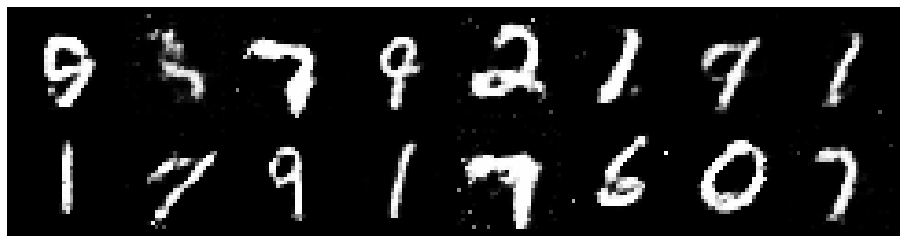

Epoch: [137/200], Batch Num: [400/600]
Discriminator Loss: 0.8906, Generator Loss: 1.2514
D(x): 0.6388, D(G(z)): 0.2835


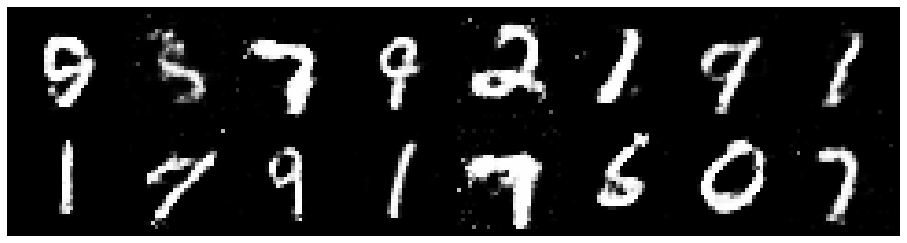

Epoch: [137/200], Batch Num: [500/600]
Discriminator Loss: 1.0099, Generator Loss: 1.2591
D(x): 0.6080, D(G(z)): 0.3246


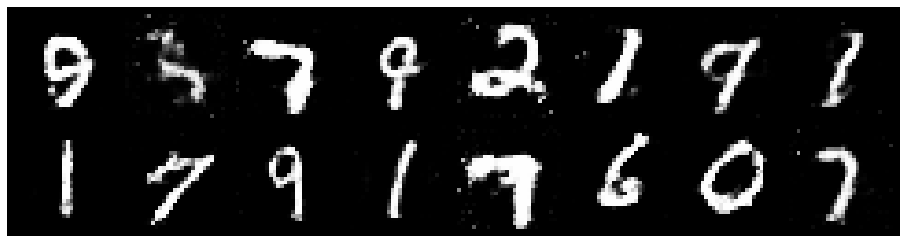

Epoch: [138/200], Batch Num: [0/600]
Discriminator Loss: 1.1623, Generator Loss: 1.0887
D(x): 0.6271, D(G(z)): 0.4092


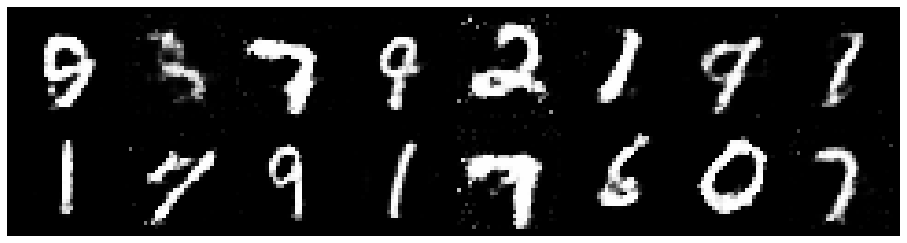

Epoch: [138/200], Batch Num: [100/600]
Discriminator Loss: 1.1935, Generator Loss: 1.1912
D(x): 0.5852, D(G(z)): 0.3587


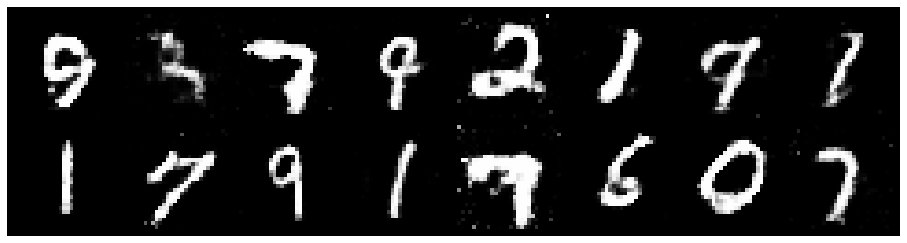

Epoch: [138/200], Batch Num: [200/600]
Discriminator Loss: 1.0330, Generator Loss: 1.3227
D(x): 0.6339, D(G(z)): 0.3188


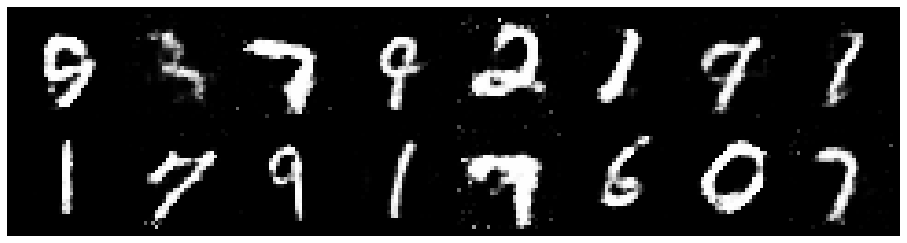

Epoch: [138/200], Batch Num: [300/600]
Discriminator Loss: 1.0461, Generator Loss: 1.0944
D(x): 0.6387, D(G(z)): 0.3583


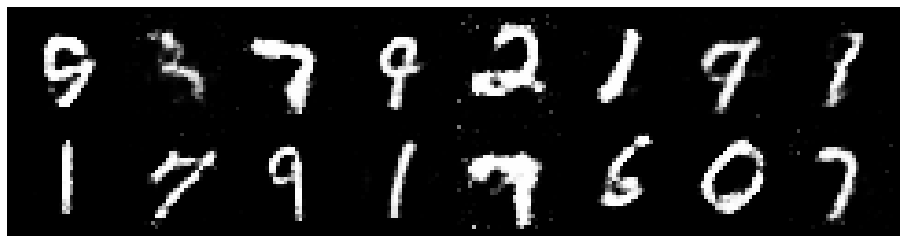

Epoch: [138/200], Batch Num: [400/600]
Discriminator Loss: 1.1743, Generator Loss: 1.1501
D(x): 0.6393, D(G(z)): 0.3939


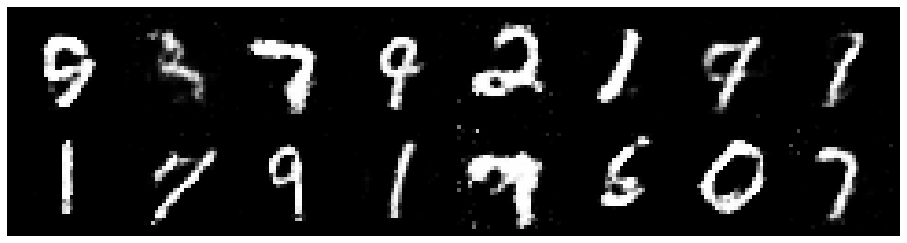

Epoch: [138/200], Batch Num: [500/600]
Discriminator Loss: 1.0384, Generator Loss: 1.2234
D(x): 0.6189, D(G(z)): 0.3451


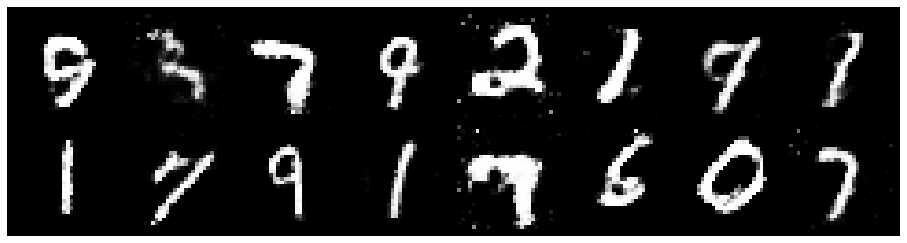

Epoch: [139/200], Batch Num: [0/600]
Discriminator Loss: 0.9682, Generator Loss: 1.1862
D(x): 0.6456, D(G(z)): 0.3238


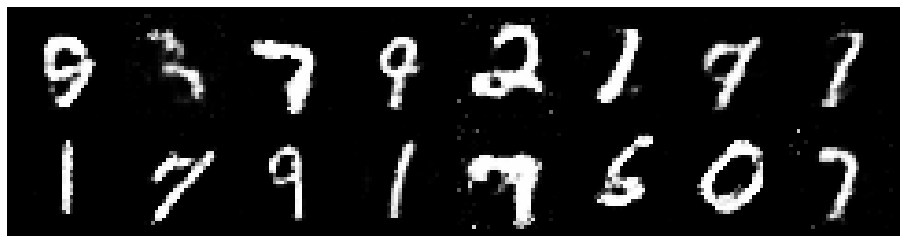

Epoch: [139/200], Batch Num: [100/600]
Discriminator Loss: 0.9823, Generator Loss: 1.1523
D(x): 0.6890, D(G(z)): 0.3525


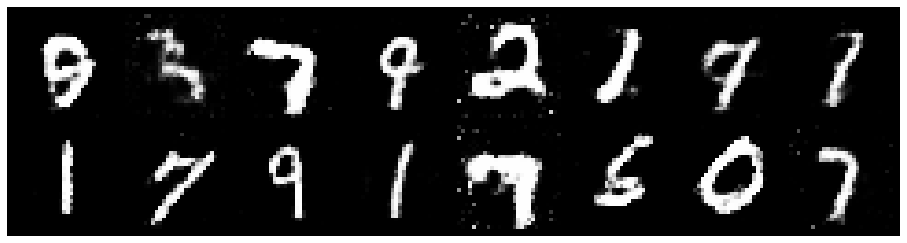

Epoch: [139/200], Batch Num: [200/600]
Discriminator Loss: 1.0197, Generator Loss: 1.2451
D(x): 0.6293, D(G(z)): 0.3167


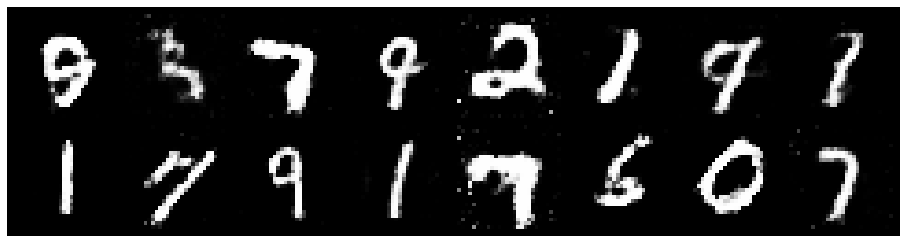

Epoch: [139/200], Batch Num: [300/600]
Discriminator Loss: 1.1021, Generator Loss: 1.1418
D(x): 0.6673, D(G(z)): 0.4063


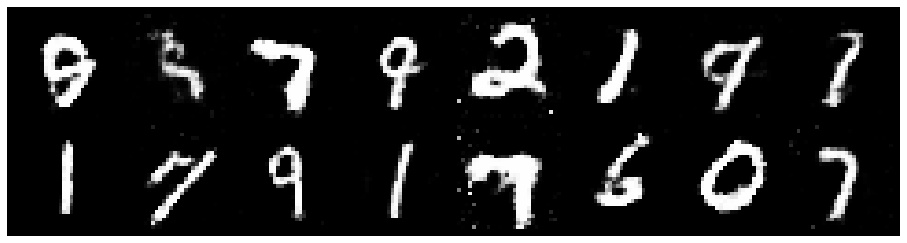

Epoch: [139/200], Batch Num: [400/600]
Discriminator Loss: 1.2397, Generator Loss: 1.1839
D(x): 0.5601, D(G(z)): 0.3745


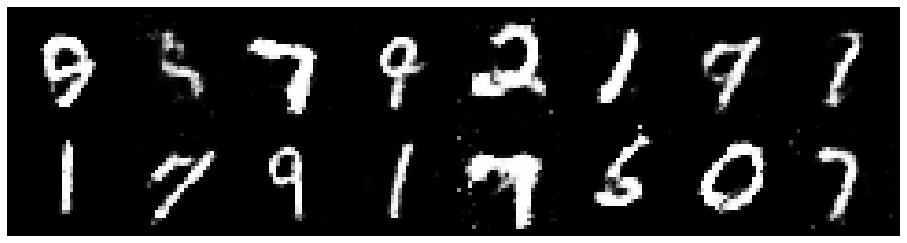

Epoch: [139/200], Batch Num: [500/600]
Discriminator Loss: 1.1252, Generator Loss: 0.9382
D(x): 0.6451, D(G(z)): 0.4247


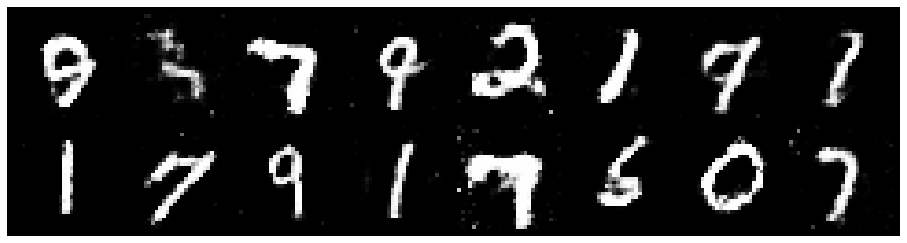

Epoch: [140/200], Batch Num: [0/600]
Discriminator Loss: 1.3003, Generator Loss: 1.1912
D(x): 0.5690, D(G(z)): 0.4011


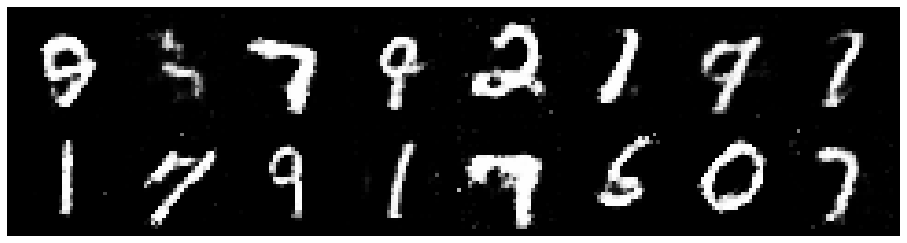

Epoch: [140/200], Batch Num: [100/600]
Discriminator Loss: 1.2772, Generator Loss: 1.1270
D(x): 0.5942, D(G(z)): 0.3977


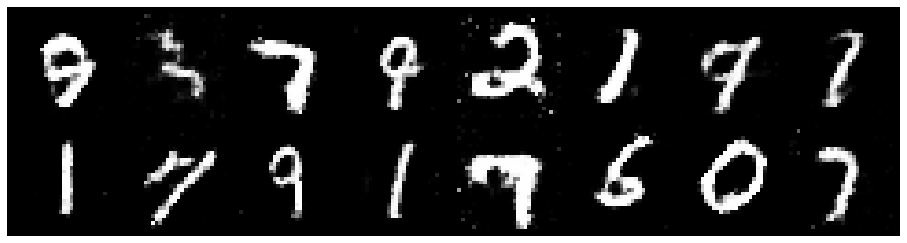

Epoch: [140/200], Batch Num: [200/600]
Discriminator Loss: 1.1649, Generator Loss: 1.1726
D(x): 0.5818, D(G(z)): 0.3623


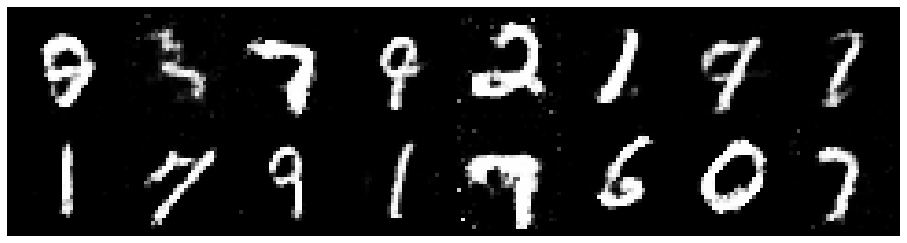

Epoch: [140/200], Batch Num: [300/600]
Discriminator Loss: 1.0445, Generator Loss: 1.0803
D(x): 0.6504, D(G(z)): 0.3744


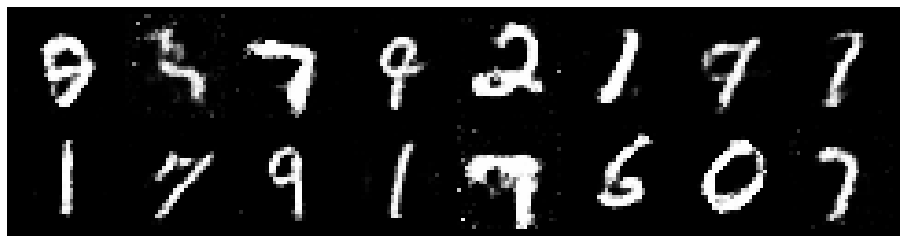

Epoch: [140/200], Batch Num: [400/600]
Discriminator Loss: 0.9897, Generator Loss: 1.1484
D(x): 0.6459, D(G(z)): 0.3549


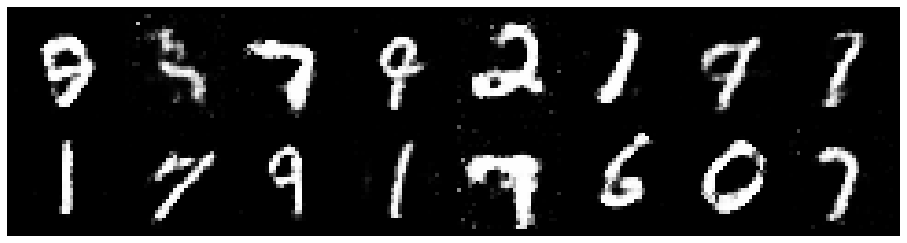

Epoch: [140/200], Batch Num: [500/600]
Discriminator Loss: 1.0547, Generator Loss: 1.2071
D(x): 0.6723, D(G(z)): 0.3671


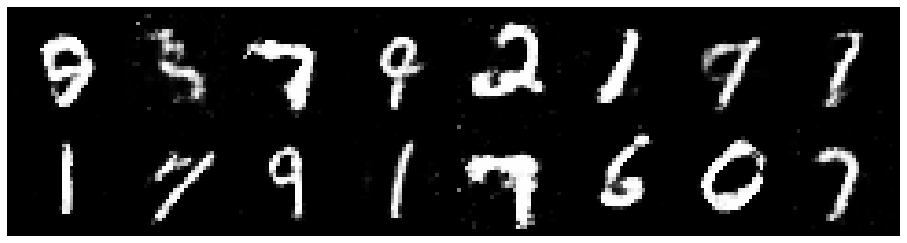

Epoch: [141/200], Batch Num: [0/600]
Discriminator Loss: 1.1177, Generator Loss: 1.3102
D(x): 0.6235, D(G(z)): 0.3559


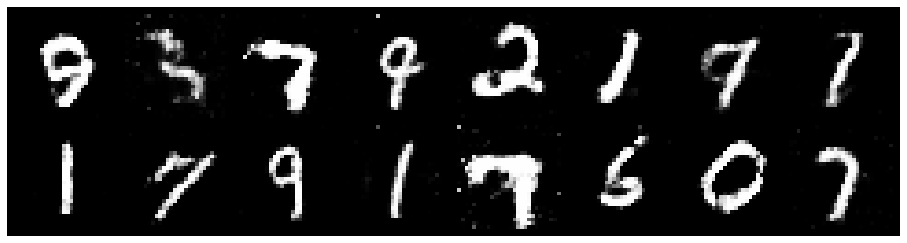

Epoch: [141/200], Batch Num: [100/600]
Discriminator Loss: 1.0845, Generator Loss: 1.1689
D(x): 0.5896, D(G(z)): 0.3225


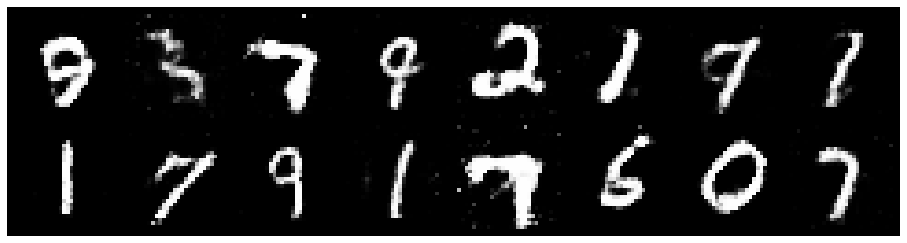

Epoch: [141/200], Batch Num: [200/600]
Discriminator Loss: 0.9429, Generator Loss: 1.3631
D(x): 0.7027, D(G(z)): 0.3562


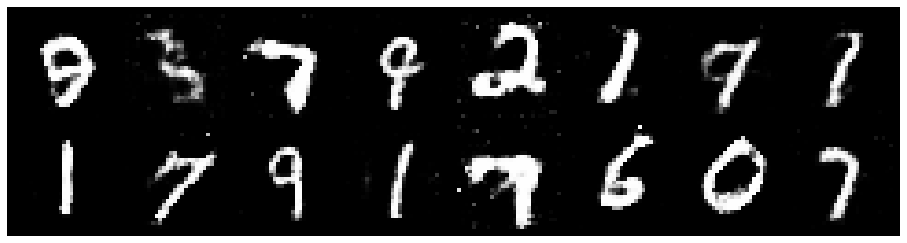

Epoch: [141/200], Batch Num: [300/600]
Discriminator Loss: 1.0850, Generator Loss: 1.2171
D(x): 0.5935, D(G(z)): 0.3261


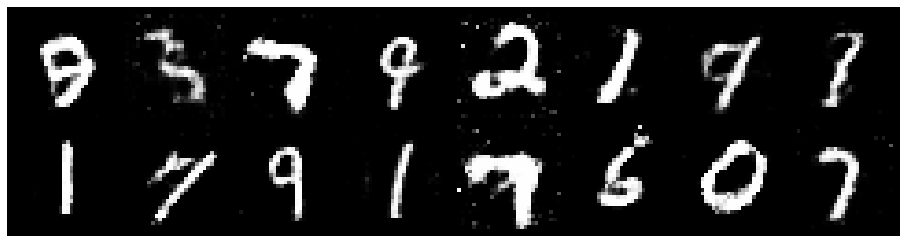

Epoch: [141/200], Batch Num: [400/600]
Discriminator Loss: 0.9678, Generator Loss: 1.4455
D(x): 0.6595, D(G(z)): 0.3278


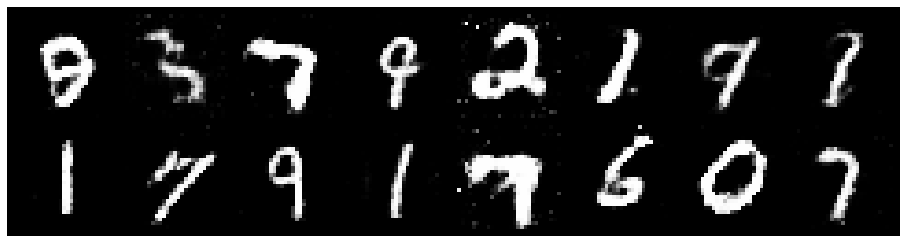

Epoch: [141/200], Batch Num: [500/600]
Discriminator Loss: 1.0763, Generator Loss: 1.3379
D(x): 0.6209, D(G(z)): 0.3506


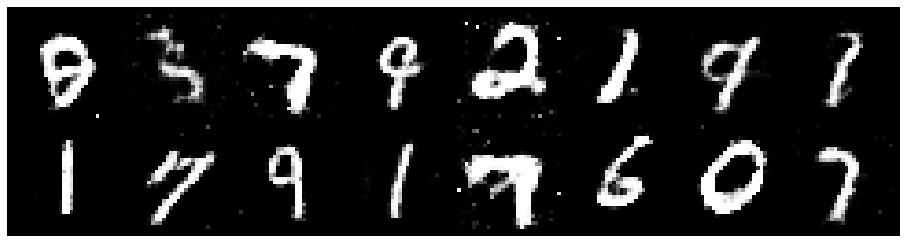

Epoch: [142/200], Batch Num: [0/600]
Discriminator Loss: 0.9785, Generator Loss: 1.1858
D(x): 0.6411, D(G(z)): 0.3453


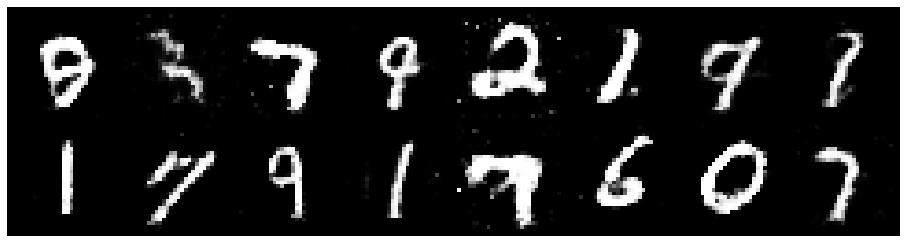

Epoch: [142/200], Batch Num: [100/600]
Discriminator Loss: 1.0733, Generator Loss: 1.3900
D(x): 0.6067, D(G(z)): 0.3461


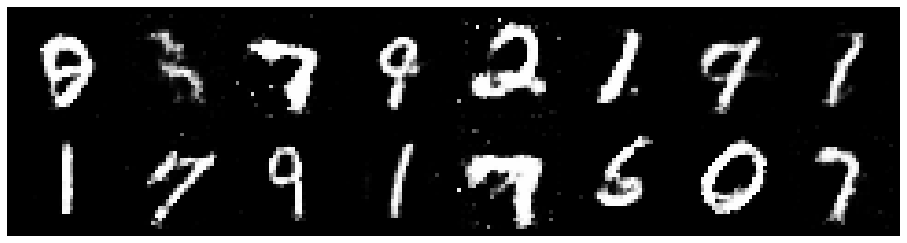

Epoch: [142/200], Batch Num: [200/600]
Discriminator Loss: 1.1037, Generator Loss: 1.1217
D(x): 0.6246, D(G(z)): 0.3741


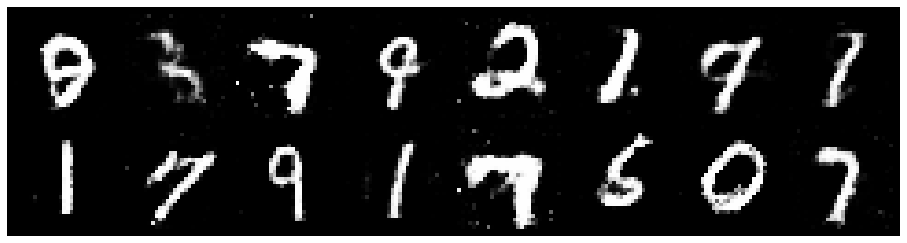

Epoch: [142/200], Batch Num: [300/600]
Discriminator Loss: 1.0730, Generator Loss: 1.1952
D(x): 0.5918, D(G(z)): 0.3365


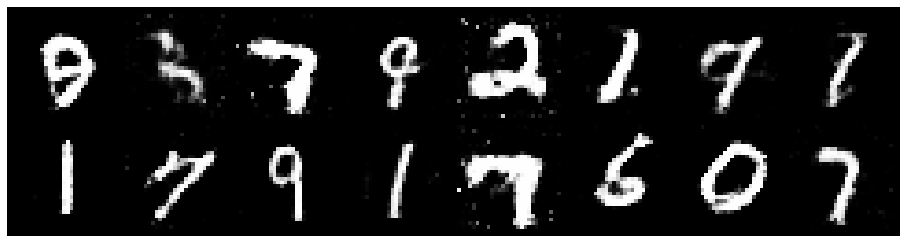

Epoch: [142/200], Batch Num: [400/600]
Discriminator Loss: 1.0610, Generator Loss: 1.0958
D(x): 0.6334, D(G(z)): 0.3831


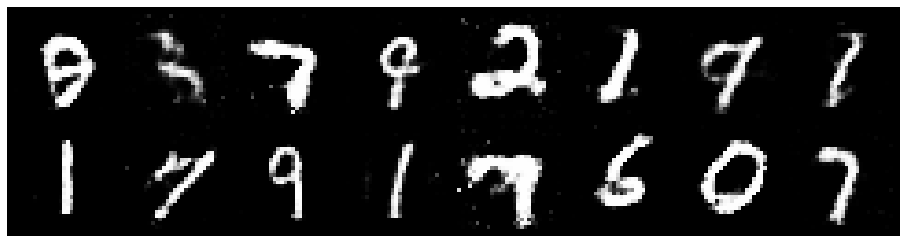

Epoch: [142/200], Batch Num: [500/600]
Discriminator Loss: 1.0794, Generator Loss: 1.3187
D(x): 0.5770, D(G(z)): 0.2996


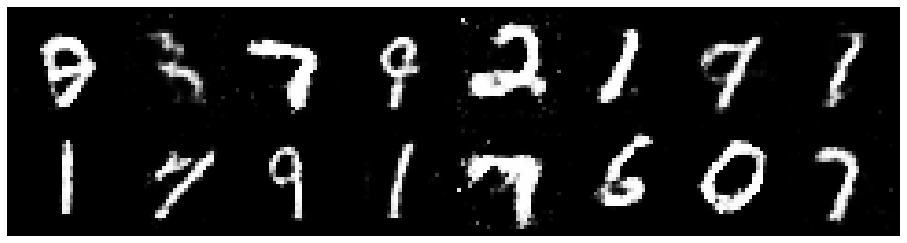

Epoch: [143/200], Batch Num: [0/600]
Discriminator Loss: 1.1027, Generator Loss: 1.2428
D(x): 0.6514, D(G(z)): 0.4017


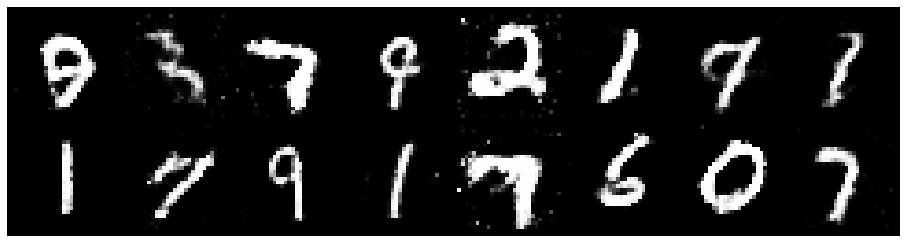

Epoch: [143/200], Batch Num: [100/600]
Discriminator Loss: 0.9914, Generator Loss: 1.2674
D(x): 0.6202, D(G(z)): 0.3006


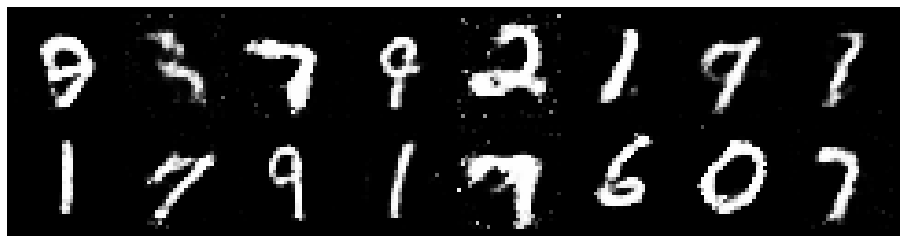

Epoch: [143/200], Batch Num: [200/600]
Discriminator Loss: 1.1162, Generator Loss: 1.0927
D(x): 0.6299, D(G(z)): 0.3849


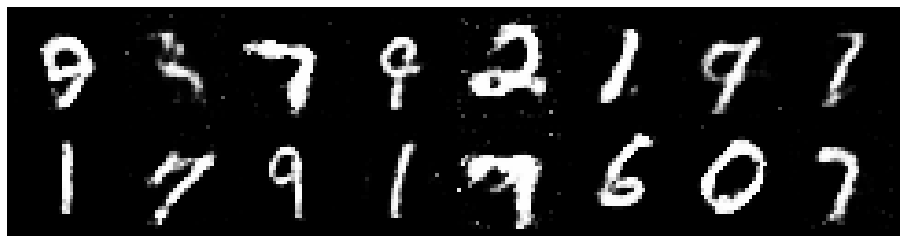

Epoch: [143/200], Batch Num: [300/600]
Discriminator Loss: 1.0538, Generator Loss: 1.1526
D(x): 0.6362, D(G(z)): 0.3571


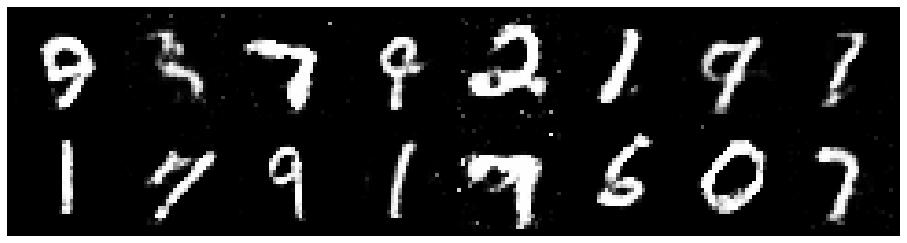

Epoch: [143/200], Batch Num: [400/600]
Discriminator Loss: 0.9811, Generator Loss: 1.1917
D(x): 0.6359, D(G(z)): 0.3393


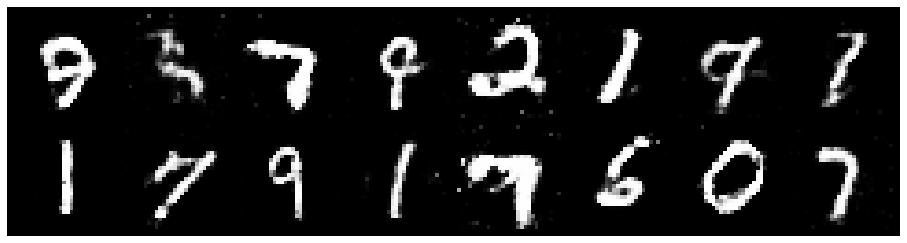

Epoch: [143/200], Batch Num: [500/600]
Discriminator Loss: 1.1009, Generator Loss: 1.2957
D(x): 0.5902, D(G(z)): 0.3199


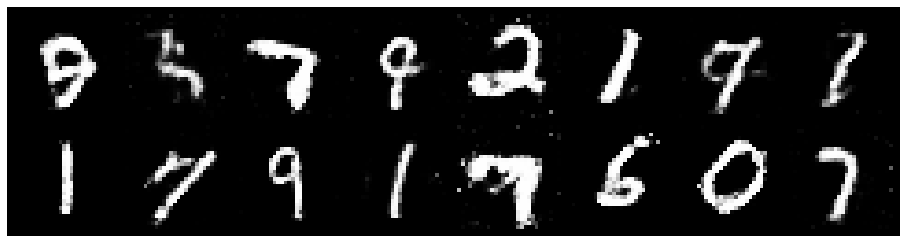

Epoch: [144/200], Batch Num: [0/600]
Discriminator Loss: 1.1798, Generator Loss: 1.0961
D(x): 0.6326, D(G(z)): 0.4122


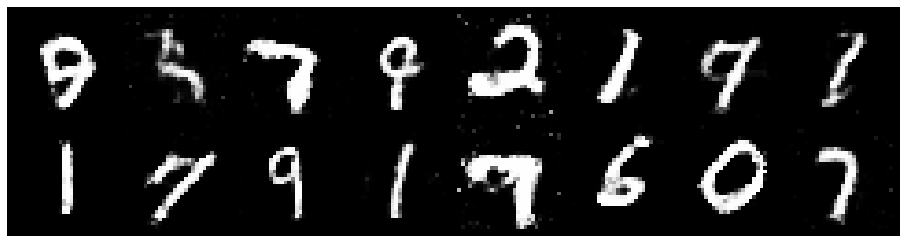

Epoch: [144/200], Batch Num: [100/600]
Discriminator Loss: 1.1918, Generator Loss: 1.2168
D(x): 0.6177, D(G(z)): 0.3936


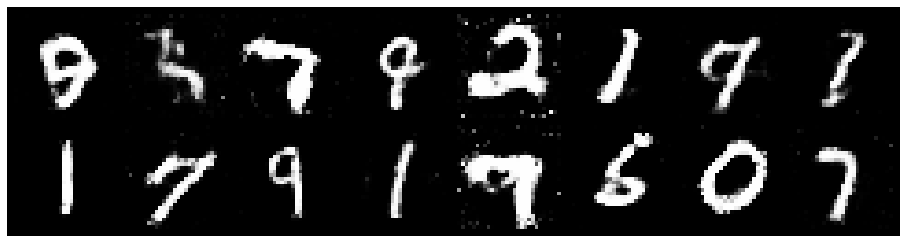

Epoch: [144/200], Batch Num: [200/600]
Discriminator Loss: 1.0717, Generator Loss: 1.2107
D(x): 0.6365, D(G(z)): 0.3550


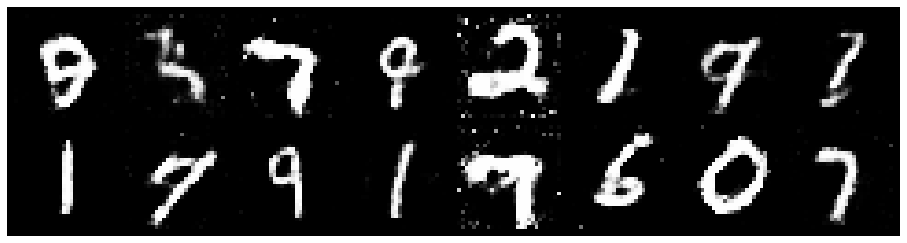

Epoch: [144/200], Batch Num: [300/600]
Discriminator Loss: 1.0792, Generator Loss: 1.0134
D(x): 0.6666, D(G(z)): 0.4023


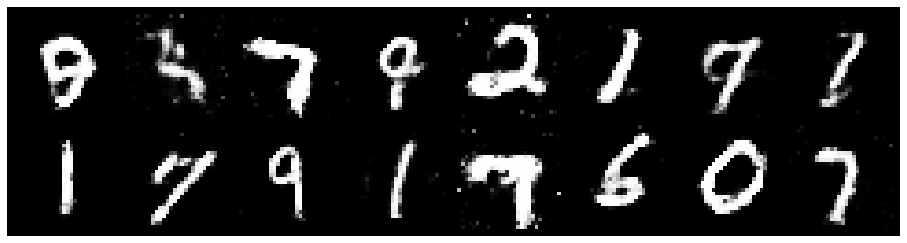

Epoch: [144/200], Batch Num: [400/600]
Discriminator Loss: 1.1296, Generator Loss: 1.0930
D(x): 0.6195, D(G(z)): 0.3889


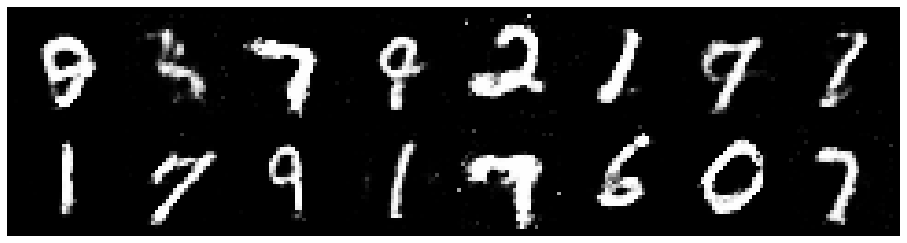

Epoch: [144/200], Batch Num: [500/600]
Discriminator Loss: 1.0041, Generator Loss: 1.2762
D(x): 0.6558, D(G(z)): 0.3320


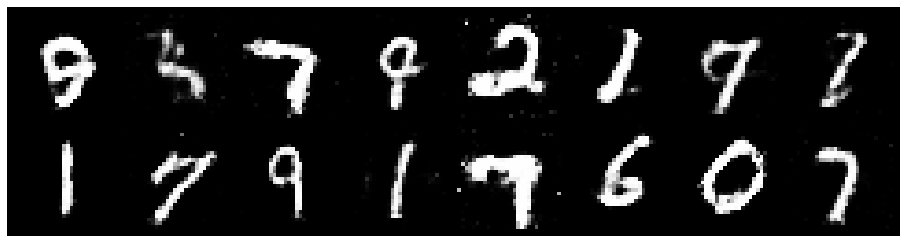

Epoch: [145/200], Batch Num: [0/600]
Discriminator Loss: 1.1387, Generator Loss: 1.3152
D(x): 0.5918, D(G(z)): 0.3492


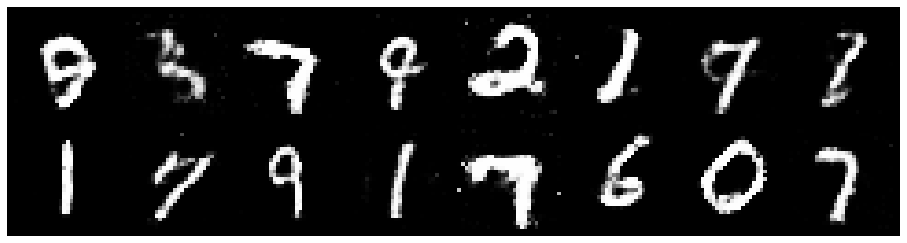

Epoch: [145/200], Batch Num: [100/600]
Discriminator Loss: 1.1872, Generator Loss: 1.0187
D(x): 0.6026, D(G(z)): 0.3895


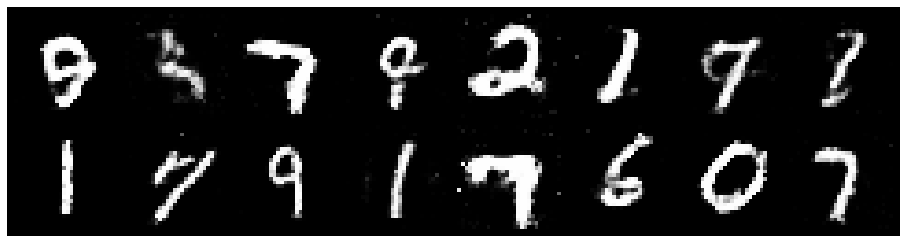

Epoch: [145/200], Batch Num: [200/600]
Discriminator Loss: 1.1106, Generator Loss: 1.0468
D(x): 0.6597, D(G(z)): 0.4054


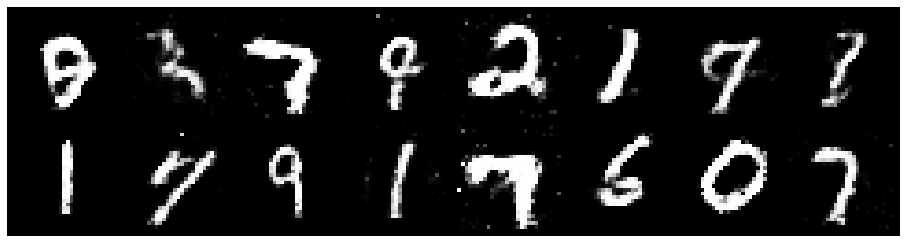

Epoch: [145/200], Batch Num: [300/600]
Discriminator Loss: 1.1228, Generator Loss: 1.2891
D(x): 0.6233, D(G(z)): 0.3790


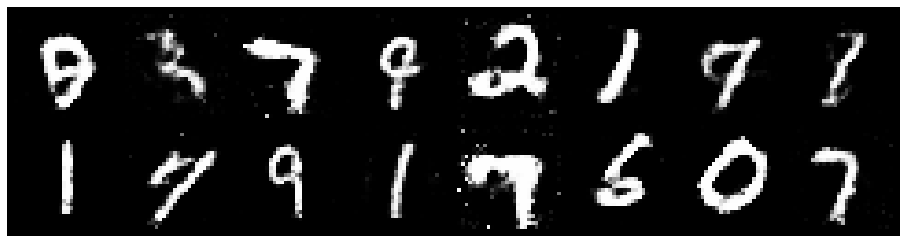

Epoch: [145/200], Batch Num: [400/600]
Discriminator Loss: 1.1558, Generator Loss: 1.1378
D(x): 0.5952, D(G(z)): 0.3521


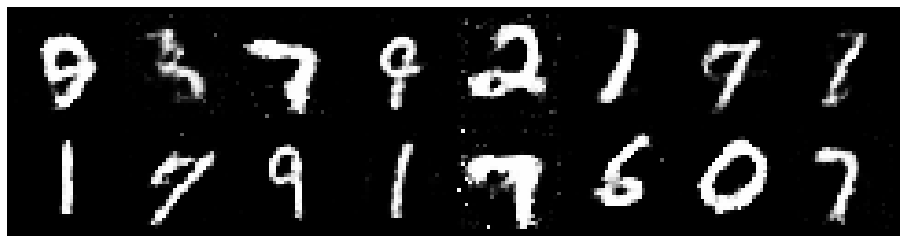

Epoch: [145/200], Batch Num: [500/600]
Discriminator Loss: 1.0830, Generator Loss: 1.1058
D(x): 0.6577, D(G(z)): 0.3960


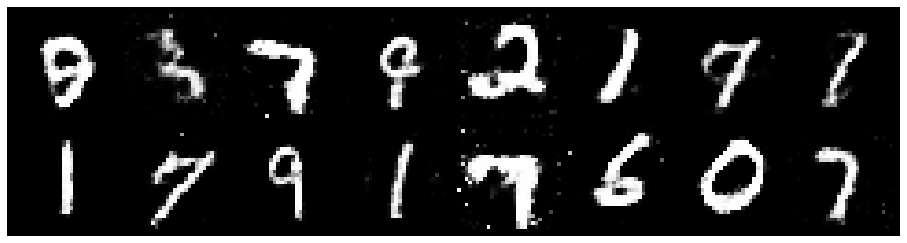

Epoch: [146/200], Batch Num: [0/600]
Discriminator Loss: 1.0148, Generator Loss: 1.2921
D(x): 0.6500, D(G(z)): 0.3731


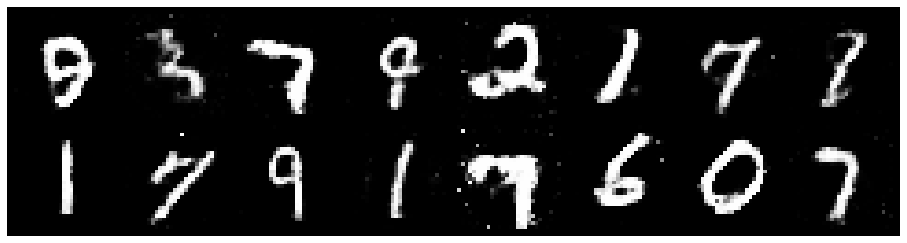

Epoch: [146/200], Batch Num: [100/600]
Discriminator Loss: 1.0996, Generator Loss: 1.1208
D(x): 0.6826, D(G(z)): 0.4156


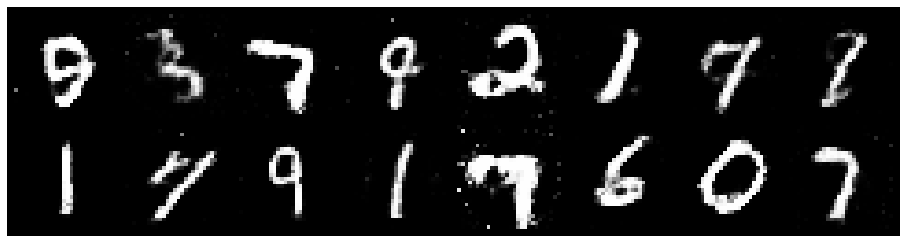

Epoch: [146/200], Batch Num: [200/600]
Discriminator Loss: 1.2030, Generator Loss: 1.1489
D(x): 0.5942, D(G(z)): 0.4000


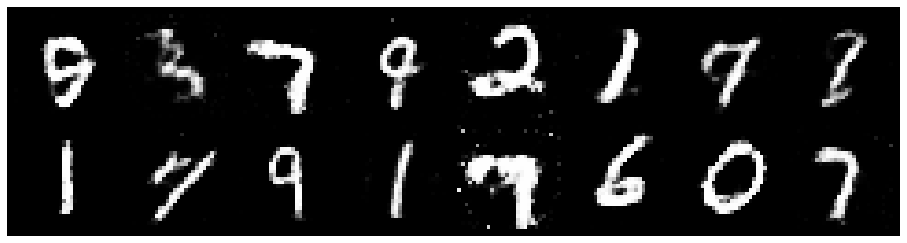

Epoch: [146/200], Batch Num: [300/600]
Discriminator Loss: 1.1669, Generator Loss: 1.2916
D(x): 0.5902, D(G(z)): 0.3647


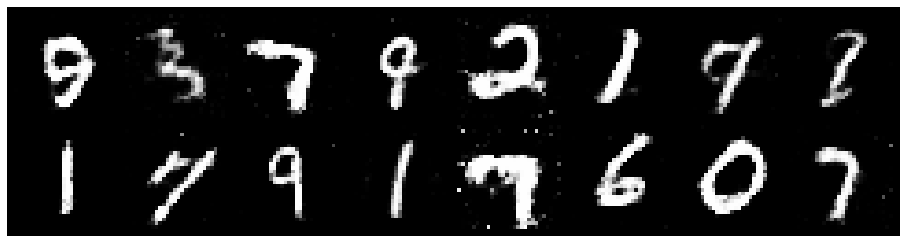

Epoch: [146/200], Batch Num: [400/600]
Discriminator Loss: 1.0815, Generator Loss: 1.2057
D(x): 0.6589, D(G(z)): 0.3750


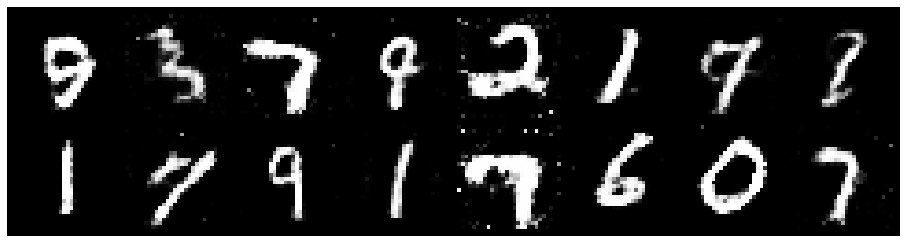

Epoch: [146/200], Batch Num: [500/600]
Discriminator Loss: 0.9978, Generator Loss: 1.1902
D(x): 0.6169, D(G(z)): 0.3035


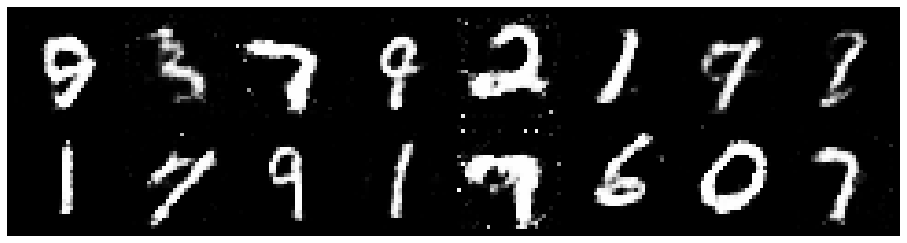

Epoch: [147/200], Batch Num: [0/600]
Discriminator Loss: 1.1275, Generator Loss: 1.4168
D(x): 0.5993, D(G(z)): 0.3666


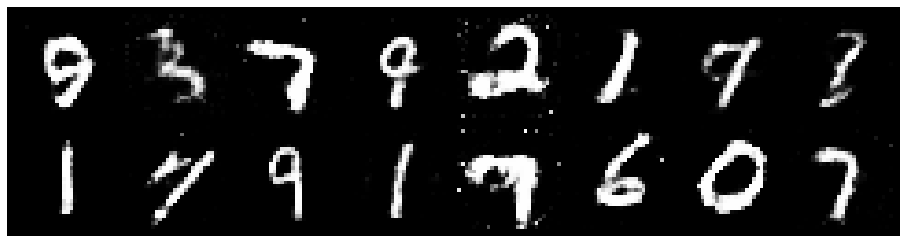

Epoch: [147/200], Batch Num: [100/600]
Discriminator Loss: 1.1450, Generator Loss: 1.2269
D(x): 0.6224, D(G(z)): 0.3548


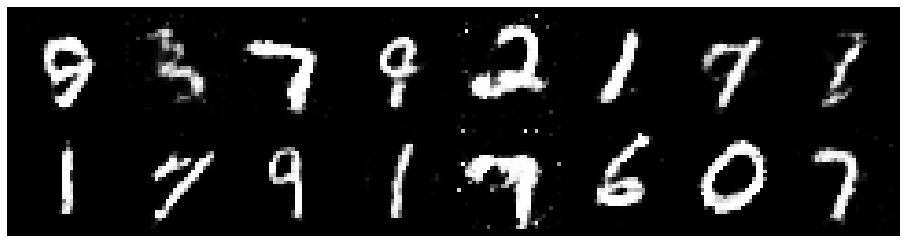

Epoch: [147/200], Batch Num: [200/600]
Discriminator Loss: 1.0955, Generator Loss: 1.0165
D(x): 0.6470, D(G(z)): 0.3934


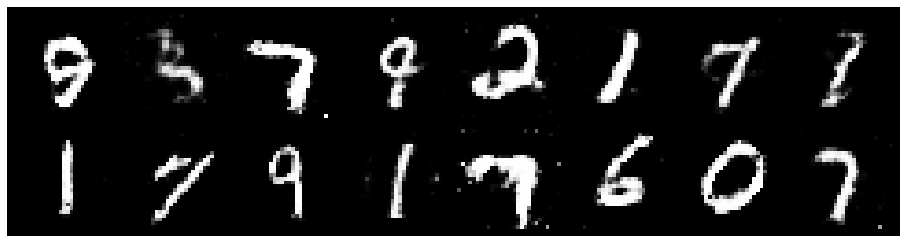

Epoch: [147/200], Batch Num: [300/600]
Discriminator Loss: 1.1623, Generator Loss: 1.1473
D(x): 0.5866, D(G(z)): 0.3766


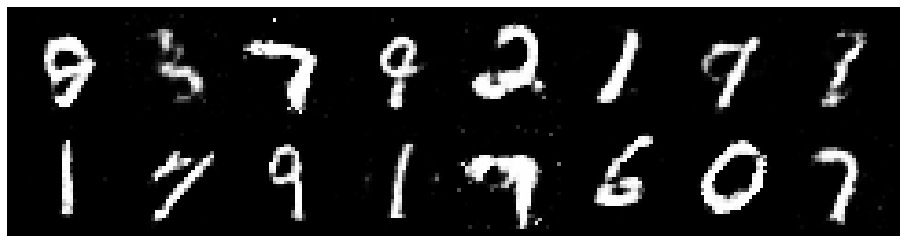

Epoch: [147/200], Batch Num: [400/600]
Discriminator Loss: 1.1107, Generator Loss: 1.0803
D(x): 0.6223, D(G(z)): 0.3704


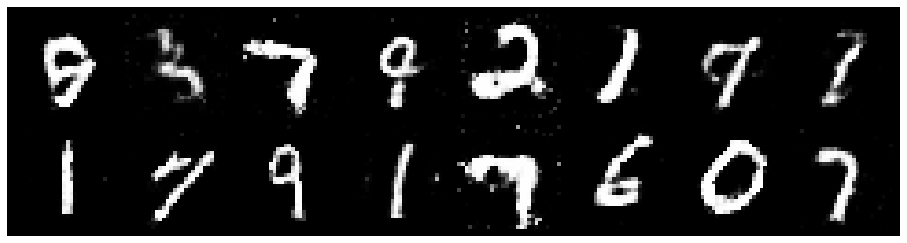

Epoch: [147/200], Batch Num: [500/600]
Discriminator Loss: 1.0938, Generator Loss: 1.0697
D(x): 0.6402, D(G(z)): 0.3863


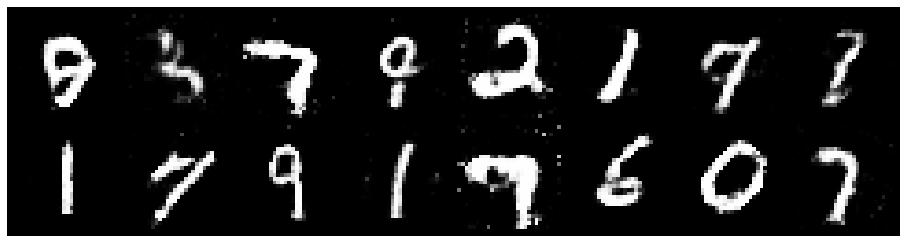

Epoch: [148/200], Batch Num: [0/600]
Discriminator Loss: 0.9650, Generator Loss: 1.2975
D(x): 0.6479, D(G(z)): 0.3174


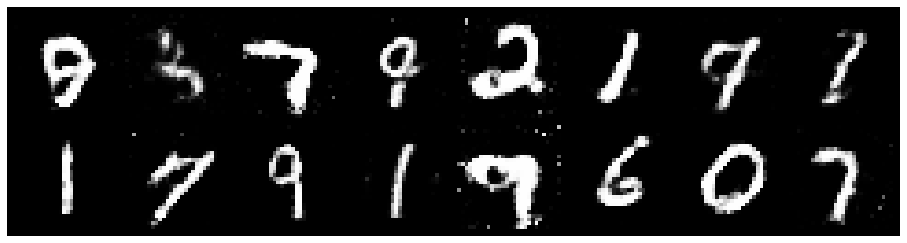

Epoch: [148/200], Batch Num: [100/600]
Discriminator Loss: 1.1387, Generator Loss: 1.0151
D(x): 0.6574, D(G(z)): 0.4142


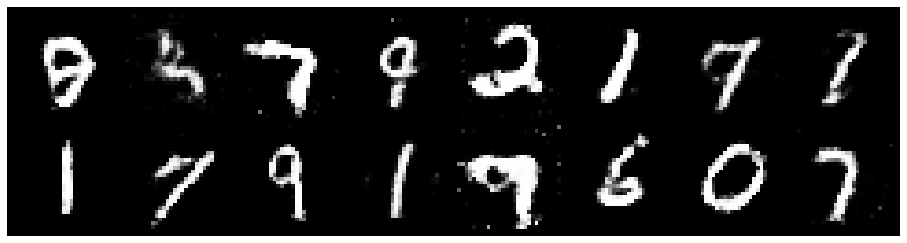

Epoch: [148/200], Batch Num: [200/600]
Discriminator Loss: 1.1546, Generator Loss: 1.1235
D(x): 0.5444, D(G(z)): 0.3254


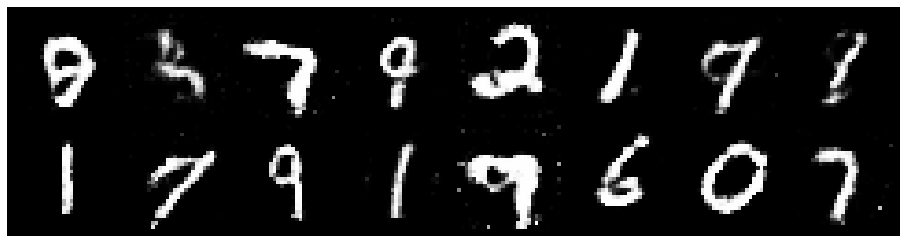

Epoch: [148/200], Batch Num: [300/600]
Discriminator Loss: 1.0350, Generator Loss: 1.0645
D(x): 0.6566, D(G(z)): 0.3980


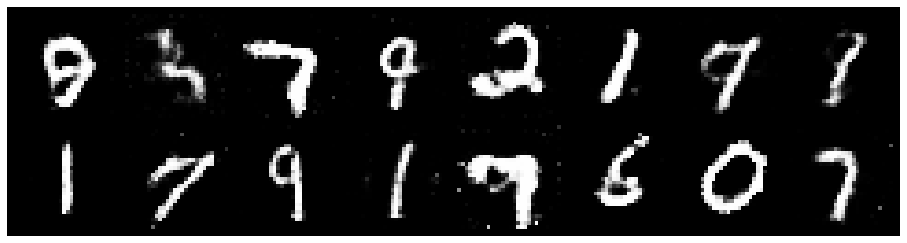

Epoch: [148/200], Batch Num: [400/600]
Discriminator Loss: 0.9760, Generator Loss: 1.0629
D(x): 0.6621, D(G(z)): 0.3631


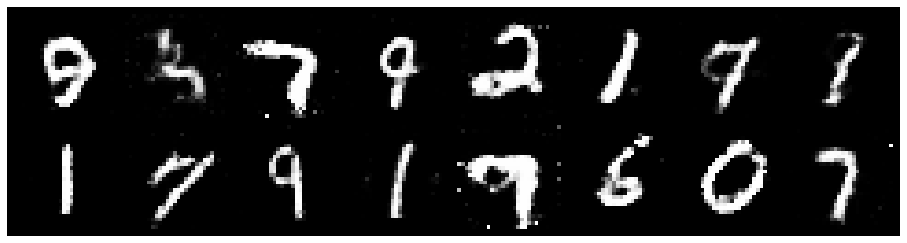

Epoch: [148/200], Batch Num: [500/600]
Discriminator Loss: 1.1198, Generator Loss: 1.0095
D(x): 0.6233, D(G(z)): 0.4105


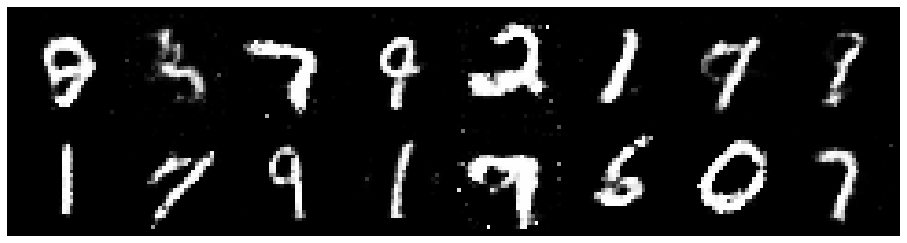

Epoch: [149/200], Batch Num: [0/600]
Discriminator Loss: 1.0610, Generator Loss: 1.0881
D(x): 0.6158, D(G(z)): 0.3671


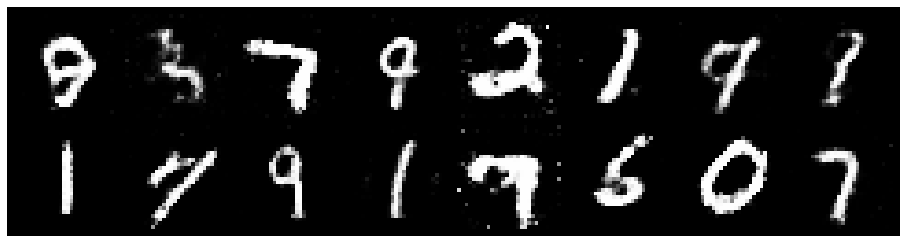

Epoch: [149/200], Batch Num: [100/600]
Discriminator Loss: 1.0942, Generator Loss: 1.2311
D(x): 0.5690, D(G(z)): 0.3023


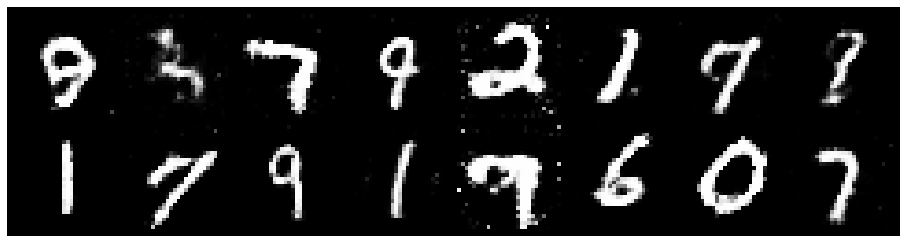

Epoch: [149/200], Batch Num: [200/600]
Discriminator Loss: 1.1552, Generator Loss: 1.3432
D(x): 0.5715, D(G(z)): 0.3214


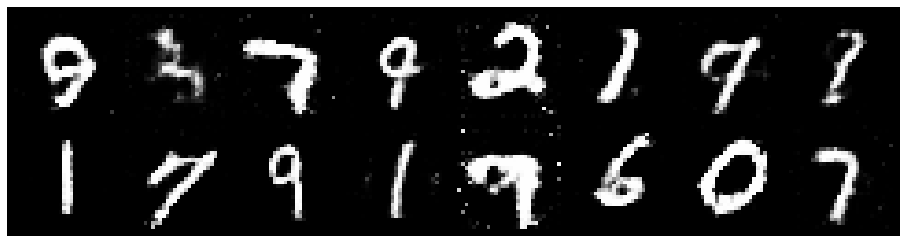

Epoch: [149/200], Batch Num: [300/600]
Discriminator Loss: 1.0916, Generator Loss: 1.0744
D(x): 0.6643, D(G(z)): 0.3949


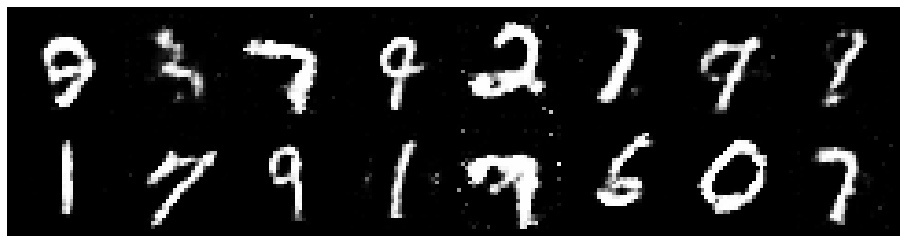

Epoch: [149/200], Batch Num: [400/600]
Discriminator Loss: 1.1281, Generator Loss: 1.3362
D(x): 0.6045, D(G(z)): 0.3480


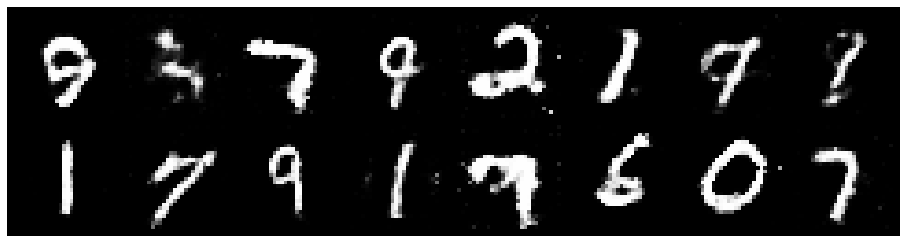

Epoch: [149/200], Batch Num: [500/600]
Discriminator Loss: 1.1734, Generator Loss: 1.0904
D(x): 0.6113, D(G(z)): 0.3942


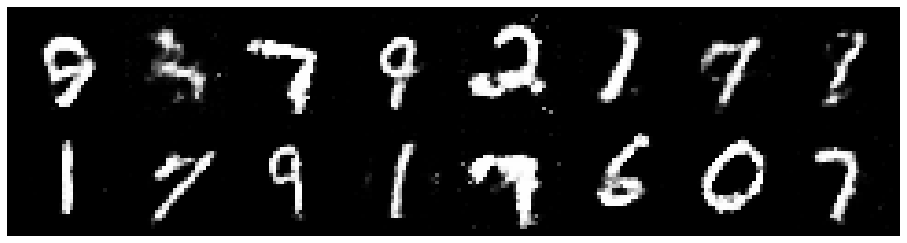

Epoch: [150/200], Batch Num: [0/600]
Discriminator Loss: 1.0437, Generator Loss: 1.1154
D(x): 0.6400, D(G(z)): 0.3647


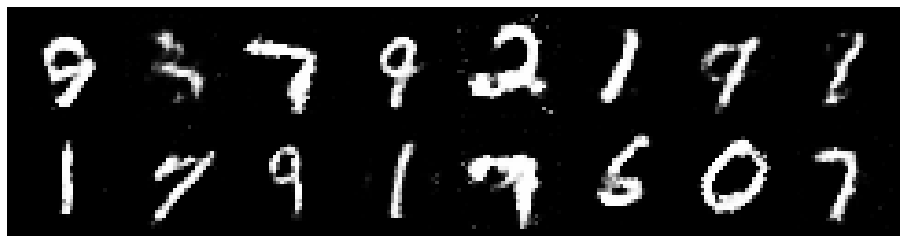

Epoch: [150/200], Batch Num: [100/600]
Discriminator Loss: 1.0957, Generator Loss: 1.2208
D(x): 0.6279, D(G(z)): 0.3609


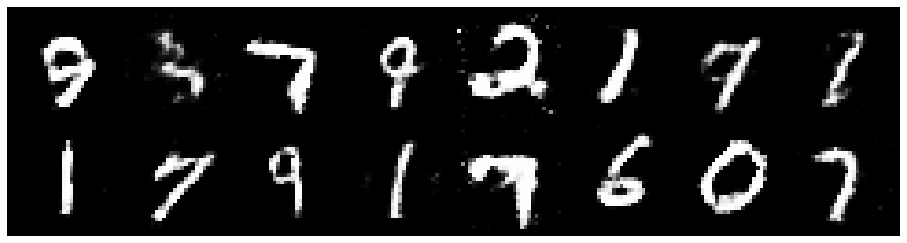

Epoch: [150/200], Batch Num: [200/600]
Discriminator Loss: 1.0491, Generator Loss: 1.1801
D(x): 0.6802, D(G(z)): 0.3883


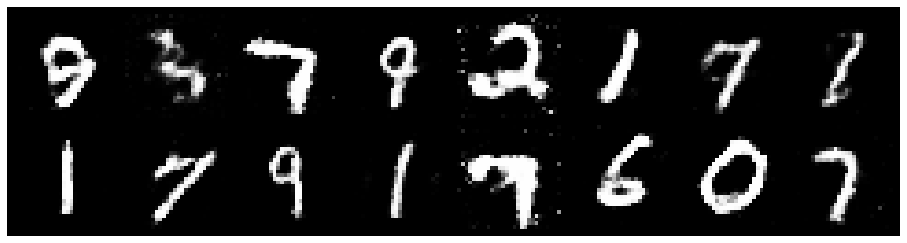

Epoch: [150/200], Batch Num: [300/600]
Discriminator Loss: 1.0288, Generator Loss: 1.2524
D(x): 0.6594, D(G(z)): 0.3732


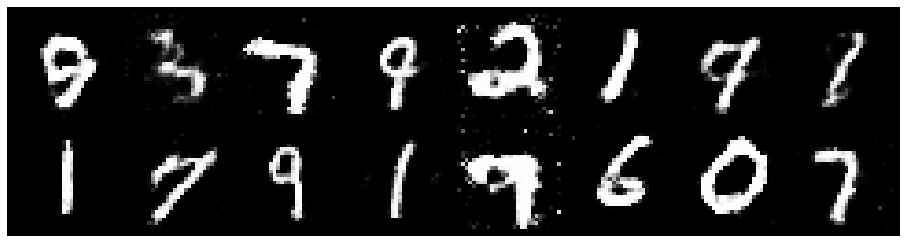

Epoch: [150/200], Batch Num: [400/600]
Discriminator Loss: 1.1805, Generator Loss: 1.2119
D(x): 0.5608, D(G(z)): 0.3326


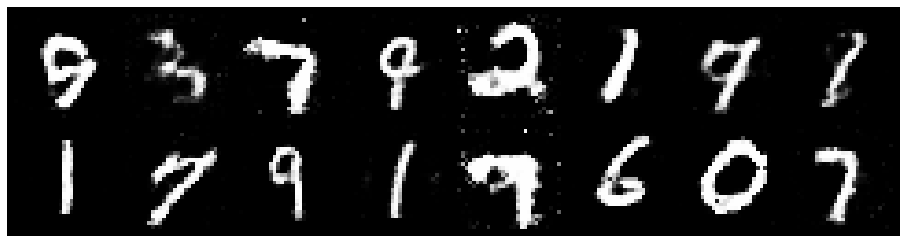

Epoch: [150/200], Batch Num: [500/600]
Discriminator Loss: 1.1553, Generator Loss: 1.4567
D(x): 0.6256, D(G(z)): 0.3659


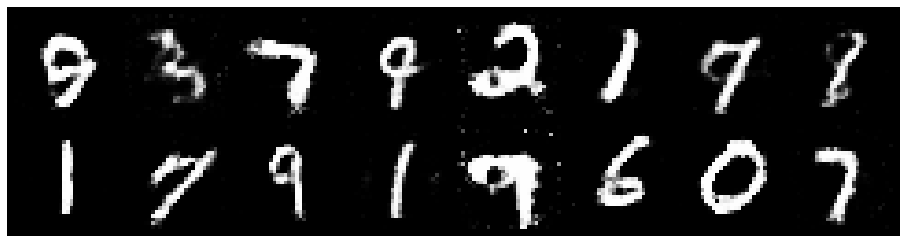

Epoch: [151/200], Batch Num: [0/600]
Discriminator Loss: 1.0147, Generator Loss: 1.3105
D(x): 0.6316, D(G(z)): 0.3419


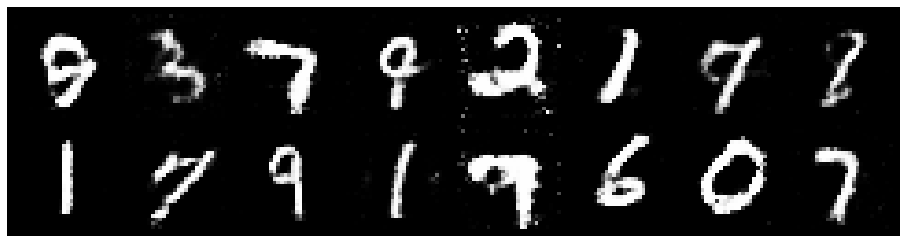

Epoch: [151/200], Batch Num: [100/600]
Discriminator Loss: 1.1498, Generator Loss: 1.1883
D(x): 0.6709, D(G(z)): 0.4304


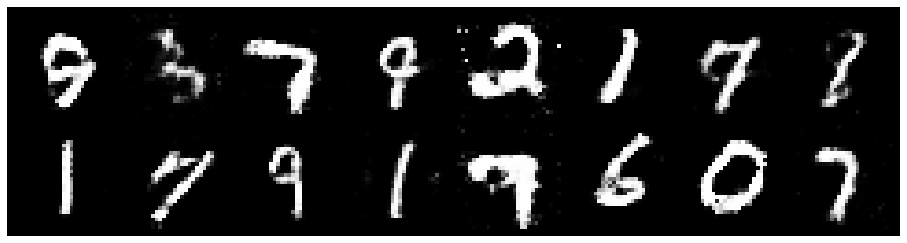

Epoch: [151/200], Batch Num: [200/600]
Discriminator Loss: 1.1639, Generator Loss: 1.1799
D(x): 0.5938, D(G(z)): 0.3797


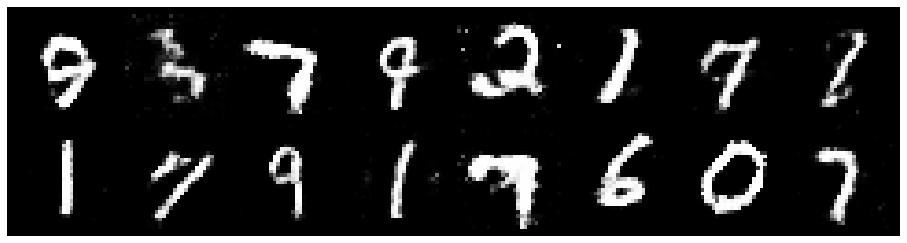

Epoch: [151/200], Batch Num: [300/600]
Discriminator Loss: 1.1473, Generator Loss: 1.0958
D(x): 0.6088, D(G(z)): 0.3804


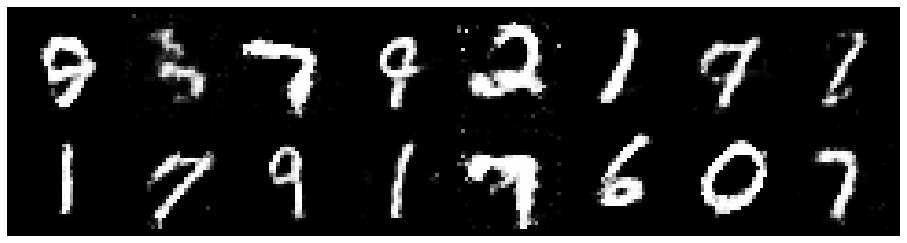

Epoch: [151/200], Batch Num: [400/600]
Discriminator Loss: 1.0789, Generator Loss: 1.1370
D(x): 0.6337, D(G(z)): 0.3618


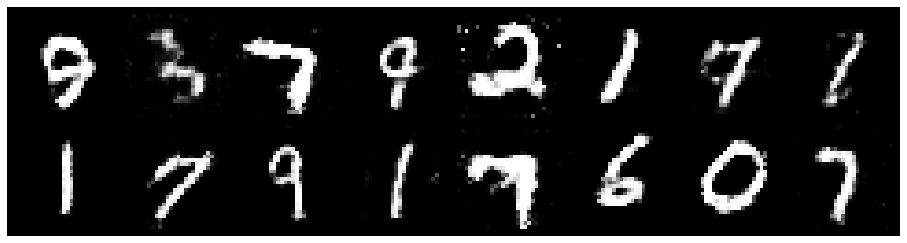

Epoch: [151/200], Batch Num: [500/600]
Discriminator Loss: 1.1480, Generator Loss: 1.1563
D(x): 0.6306, D(G(z)): 0.3954


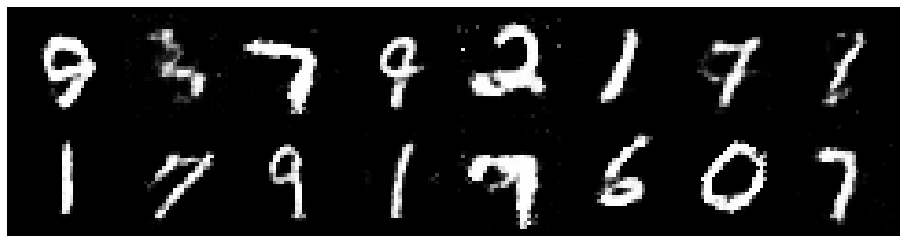

Epoch: [152/200], Batch Num: [0/600]
Discriminator Loss: 0.9815, Generator Loss: 1.1580
D(x): 0.6458, D(G(z)): 0.3540


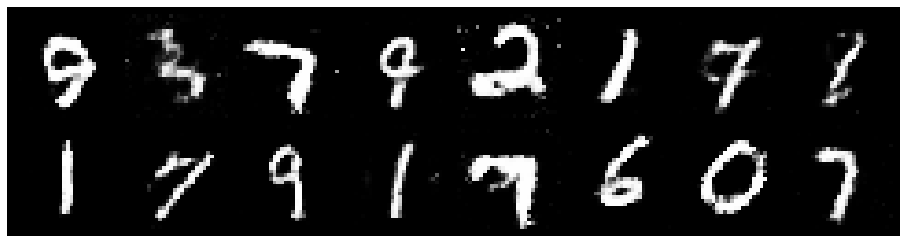

Epoch: [152/200], Batch Num: [100/600]
Discriminator Loss: 1.1065, Generator Loss: 0.9987
D(x): 0.6302, D(G(z)): 0.4125


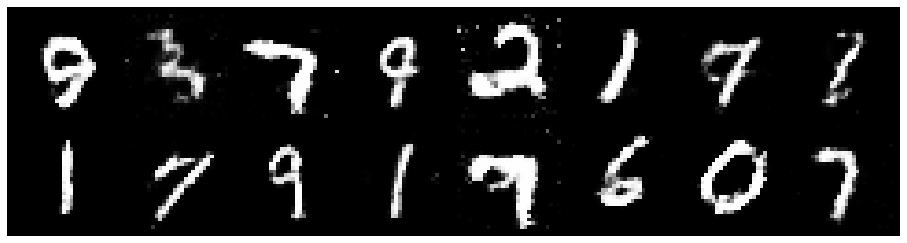

Epoch: [152/200], Batch Num: [200/600]
Discriminator Loss: 1.0342, Generator Loss: 1.1961
D(x): 0.6248, D(G(z)): 0.3414


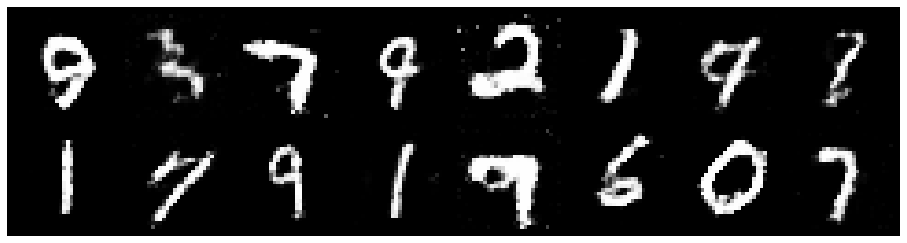

Epoch: [152/200], Batch Num: [300/600]
Discriminator Loss: 0.8517, Generator Loss: 1.1172
D(x): 0.6865, D(G(z)): 0.3187


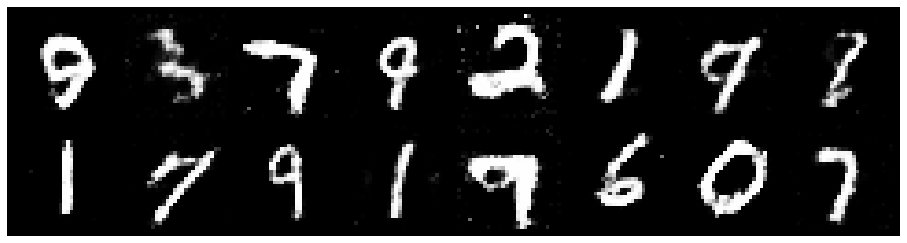

Epoch: [152/200], Batch Num: [400/600]
Discriminator Loss: 1.0750, Generator Loss: 1.2534
D(x): 0.6537, D(G(z)): 0.3786


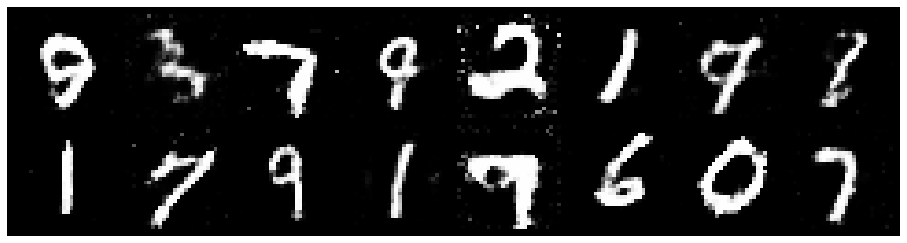

Epoch: [152/200], Batch Num: [500/600]
Discriminator Loss: 1.1110, Generator Loss: 1.1623
D(x): 0.6661, D(G(z)): 0.3898


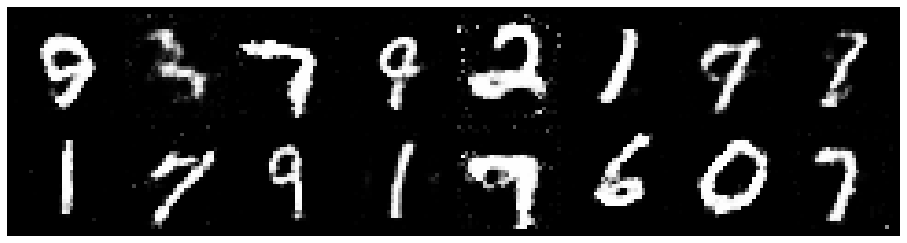

Epoch: [153/200], Batch Num: [0/600]
Discriminator Loss: 1.2513, Generator Loss: 1.2315
D(x): 0.5581, D(G(z)): 0.3229


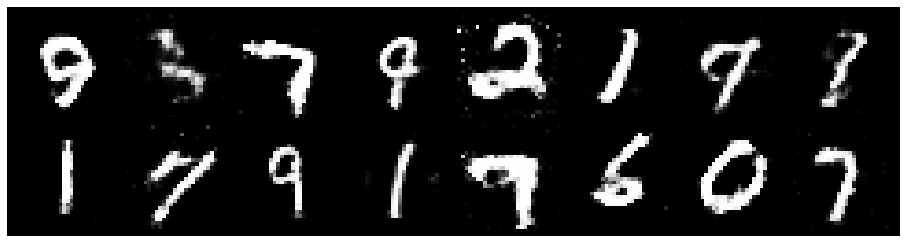

Epoch: [153/200], Batch Num: [100/600]
Discriminator Loss: 1.0727, Generator Loss: 1.2090
D(x): 0.6325, D(G(z)): 0.3444


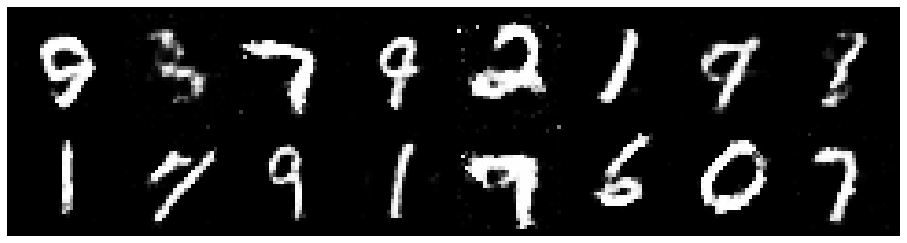

Epoch: [153/200], Batch Num: [200/600]
Discriminator Loss: 1.1998, Generator Loss: 1.0985
D(x): 0.5778, D(G(z)): 0.3794


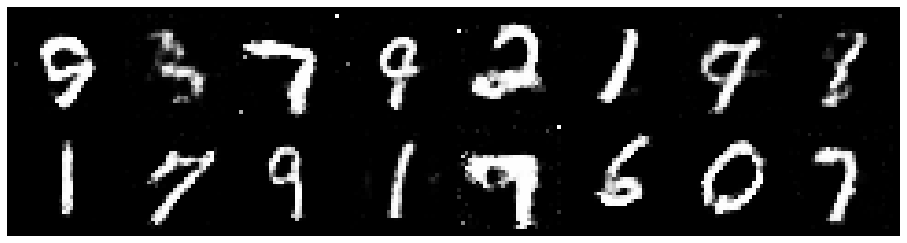

Epoch: [153/200], Batch Num: [300/600]
Discriminator Loss: 1.0710, Generator Loss: 1.0623
D(x): 0.6553, D(G(z)): 0.3841


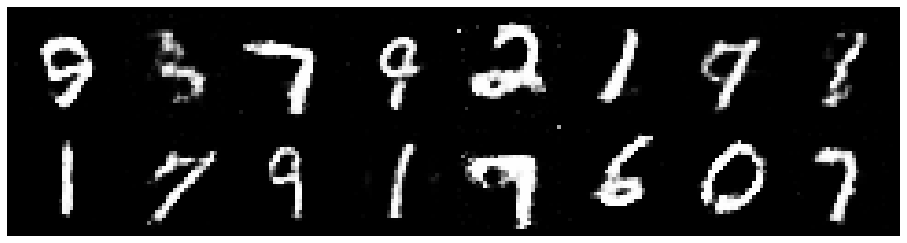

Epoch: [153/200], Batch Num: [400/600]
Discriminator Loss: 1.1453, Generator Loss: 1.0973
D(x): 0.6251, D(G(z)): 0.4065


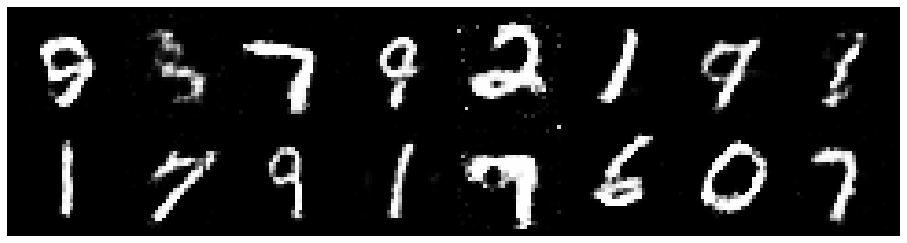

Epoch: [153/200], Batch Num: [500/600]
Discriminator Loss: 1.0299, Generator Loss: 1.1182
D(x): 0.6547, D(G(z)): 0.3731


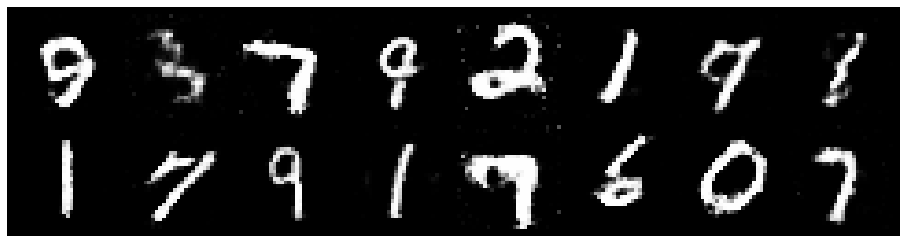

Epoch: [154/200], Batch Num: [0/600]
Discriminator Loss: 1.0049, Generator Loss: 1.4229
D(x): 0.6258, D(G(z)): 0.3091


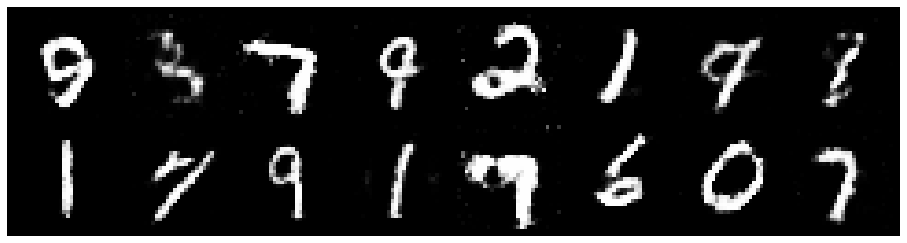

Epoch: [154/200], Batch Num: [100/600]
Discriminator Loss: 1.0689, Generator Loss: 1.1800
D(x): 0.6084, D(G(z)): 0.3480


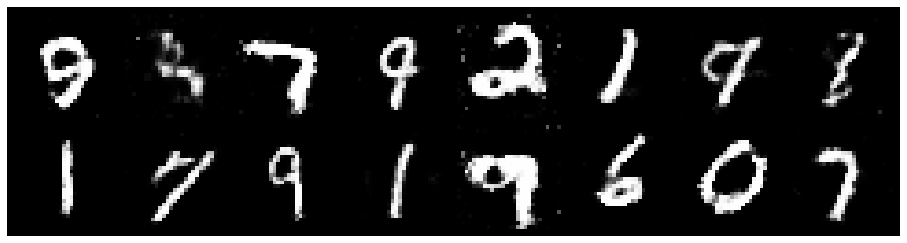

Epoch: [154/200], Batch Num: [200/600]
Discriminator Loss: 1.0590, Generator Loss: 1.2013
D(x): 0.6163, D(G(z)): 0.3454


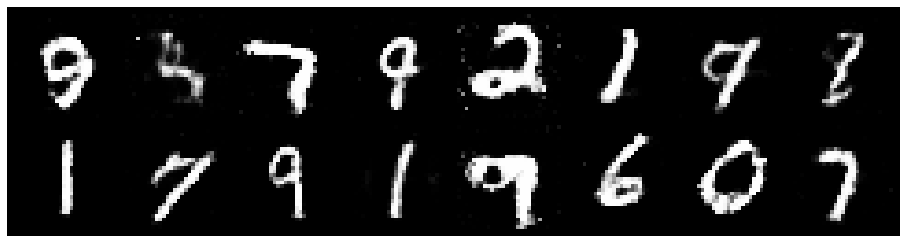

Epoch: [154/200], Batch Num: [300/600]
Discriminator Loss: 1.1326, Generator Loss: 1.0267
D(x): 0.6028, D(G(z)): 0.3791


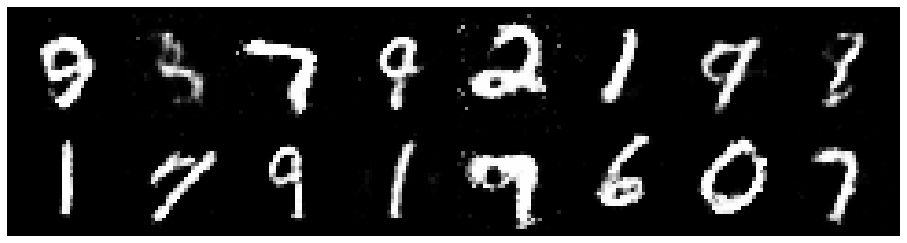

Epoch: [154/200], Batch Num: [400/600]
Discriminator Loss: 1.1422, Generator Loss: 1.2932
D(x): 0.5873, D(G(z)): 0.3696


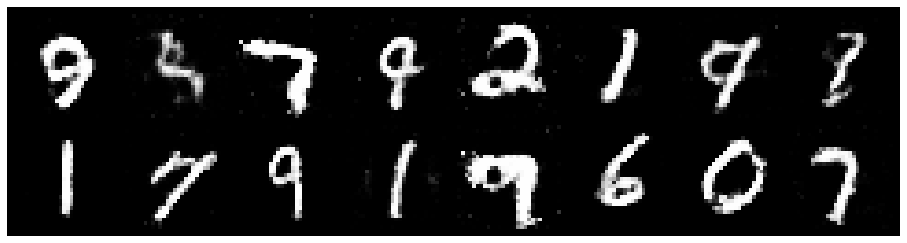

Epoch: [154/200], Batch Num: [500/600]
Discriminator Loss: 1.1302, Generator Loss: 1.1551
D(x): 0.6166, D(G(z)): 0.3836


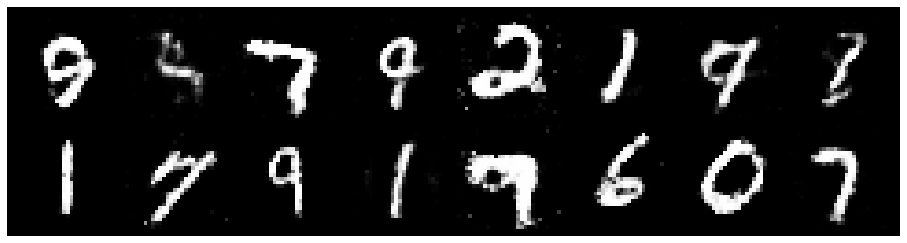

Epoch: [155/200], Batch Num: [0/600]
Discriminator Loss: 1.0682, Generator Loss: 1.1841
D(x): 0.6099, D(G(z)): 0.3417


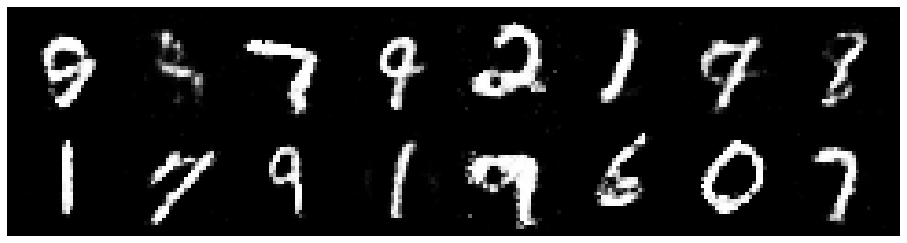

Epoch: [155/200], Batch Num: [100/600]
Discriminator Loss: 1.1464, Generator Loss: 1.1177
D(x): 0.6017, D(G(z)): 0.3721


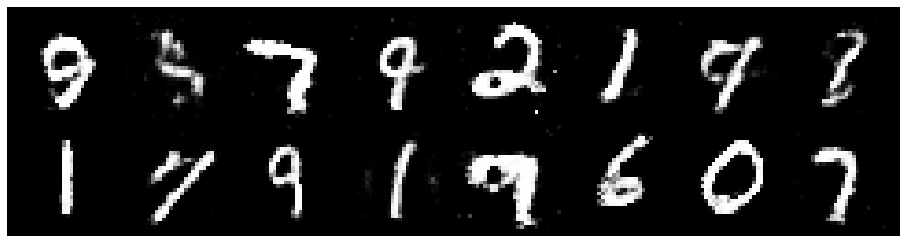

Epoch: [155/200], Batch Num: [200/600]
Discriminator Loss: 0.9710, Generator Loss: 1.2264
D(x): 0.6707, D(G(z)): 0.3470


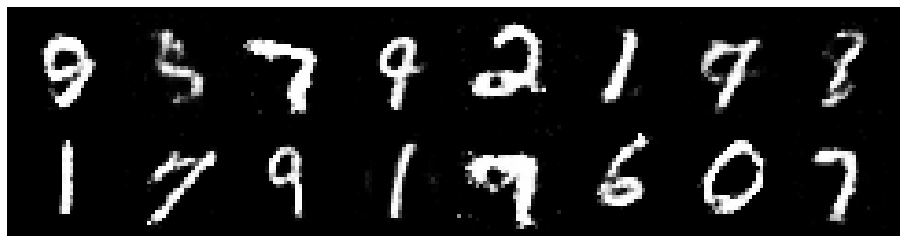

Epoch: [155/200], Batch Num: [300/600]
Discriminator Loss: 1.0204, Generator Loss: 1.1537
D(x): 0.6602, D(G(z)): 0.3684


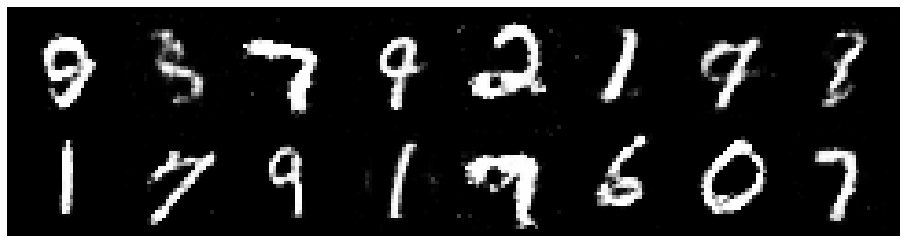

Epoch: [155/200], Batch Num: [400/600]
Discriminator Loss: 1.1638, Generator Loss: 1.0630
D(x): 0.6414, D(G(z)): 0.3969


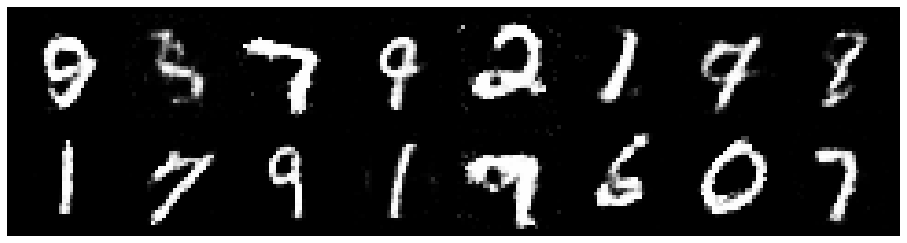

Epoch: [155/200], Batch Num: [500/600]
Discriminator Loss: 1.2213, Generator Loss: 1.1064
D(x): 0.5633, D(G(z)): 0.3590


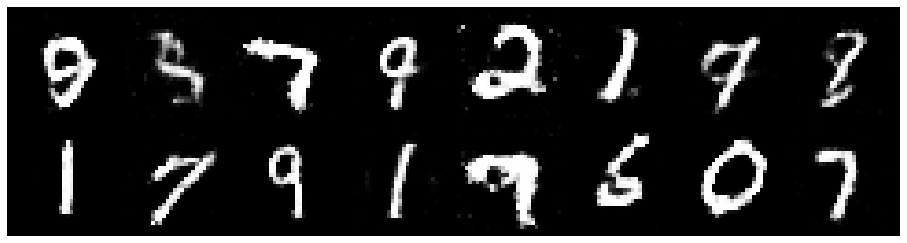

Epoch: [156/200], Batch Num: [0/600]
Discriminator Loss: 1.2559, Generator Loss: 0.9714
D(x): 0.5916, D(G(z)): 0.4216


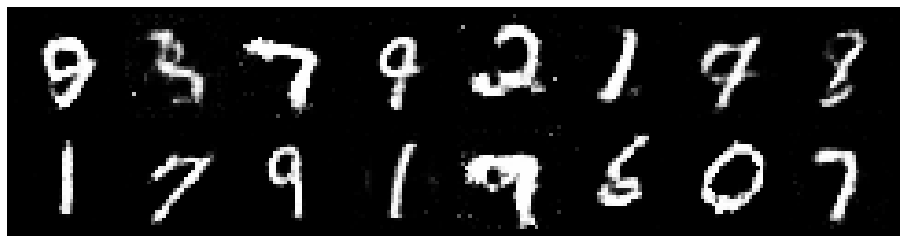

Epoch: [156/200], Batch Num: [100/600]
Discriminator Loss: 0.9727, Generator Loss: 1.3362
D(x): 0.6687, D(G(z)): 0.3420


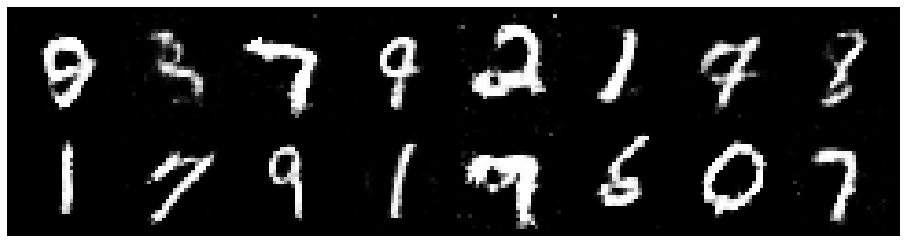

Epoch: [156/200], Batch Num: [200/600]
Discriminator Loss: 0.9927, Generator Loss: 1.2209
D(x): 0.5984, D(G(z)): 0.3094


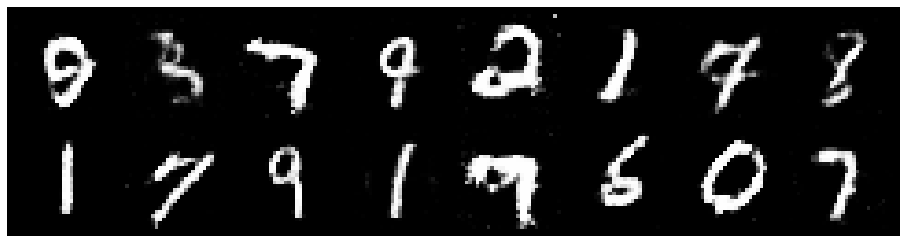

Epoch: [156/200], Batch Num: [300/600]
Discriminator Loss: 1.1521, Generator Loss: 1.1300
D(x): 0.6171, D(G(z)): 0.3959


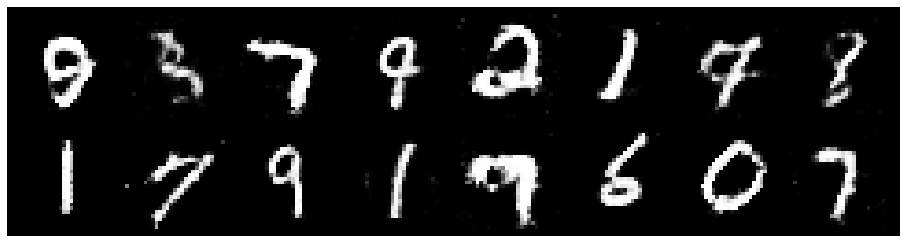

Epoch: [156/200], Batch Num: [400/600]
Discriminator Loss: 1.0307, Generator Loss: 0.9603
D(x): 0.6961, D(G(z)): 0.4266


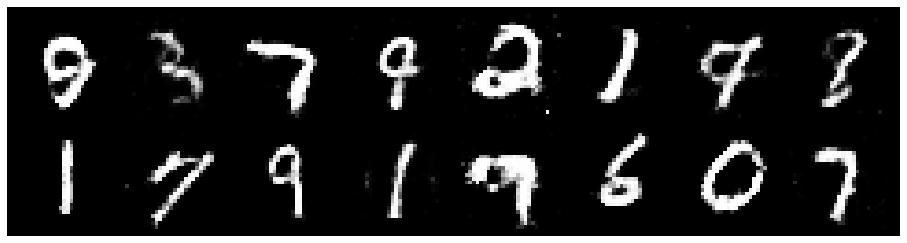

Epoch: [156/200], Batch Num: [500/600]
Discriminator Loss: 1.0403, Generator Loss: 1.1074
D(x): 0.6717, D(G(z)): 0.3948


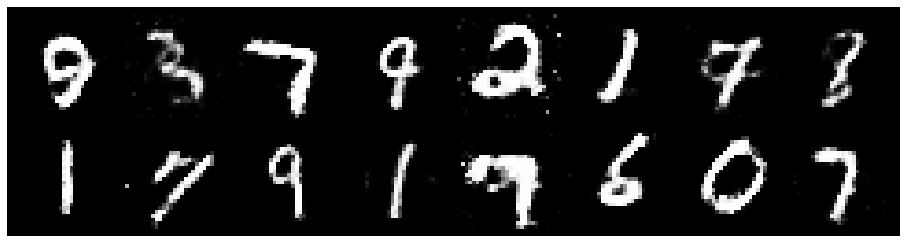

Epoch: [157/200], Batch Num: [0/600]
Discriminator Loss: 1.1403, Generator Loss: 1.0513
D(x): 0.6577, D(G(z)): 0.4044


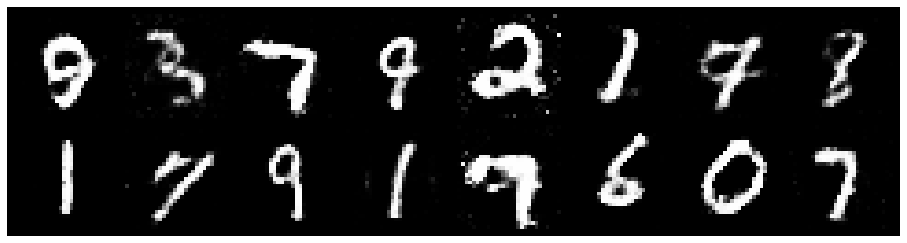

Epoch: [157/200], Batch Num: [100/600]
Discriminator Loss: 1.0338, Generator Loss: 1.2893
D(x): 0.6300, D(G(z)): 0.3551


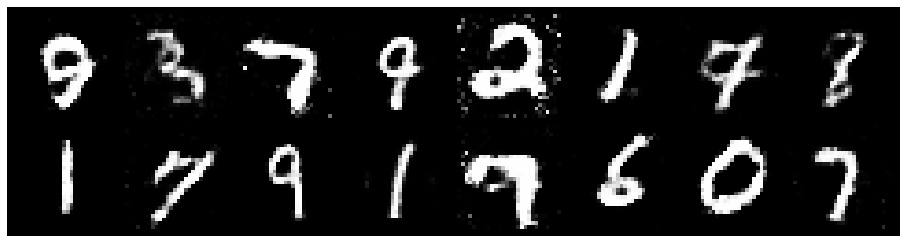

Epoch: [157/200], Batch Num: [200/600]
Discriminator Loss: 1.1436, Generator Loss: 1.1622
D(x): 0.6306, D(G(z)): 0.3918


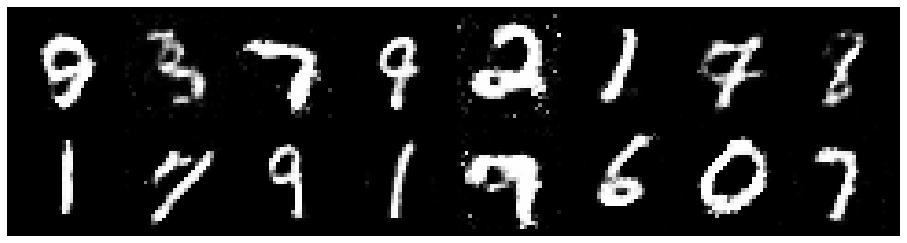

Epoch: [157/200], Batch Num: [300/600]
Discriminator Loss: 1.1234, Generator Loss: 1.1327
D(x): 0.6515, D(G(z)): 0.4052


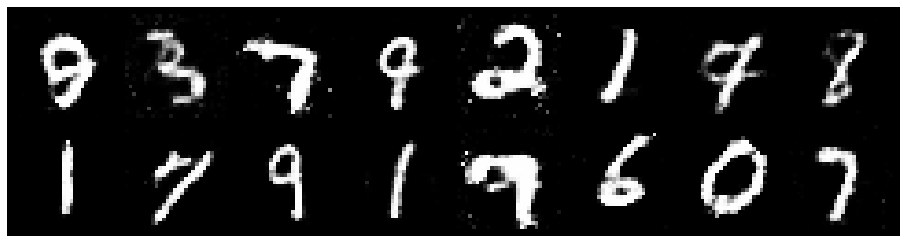

Epoch: [157/200], Batch Num: [400/600]
Discriminator Loss: 1.0890, Generator Loss: 1.1230
D(x): 0.6214, D(G(z)): 0.3676


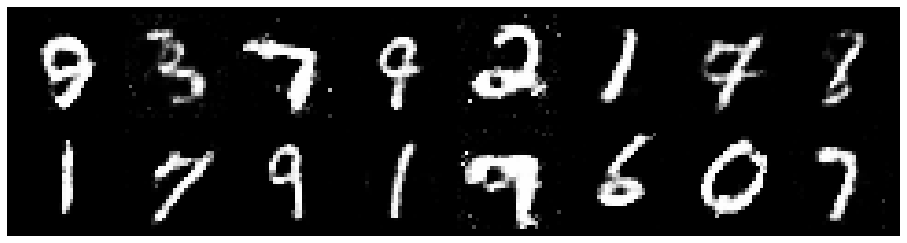

Epoch: [157/200], Batch Num: [500/600]
Discriminator Loss: 1.0764, Generator Loss: 1.1046
D(x): 0.6180, D(G(z)): 0.3624


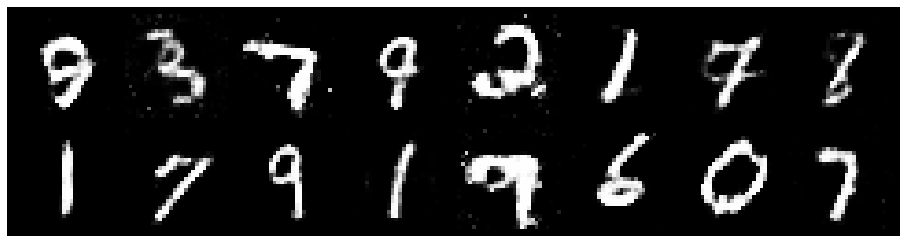

Epoch: [158/200], Batch Num: [0/600]
Discriminator Loss: 1.0243, Generator Loss: 1.1332
D(x): 0.6329, D(G(z)): 0.3482


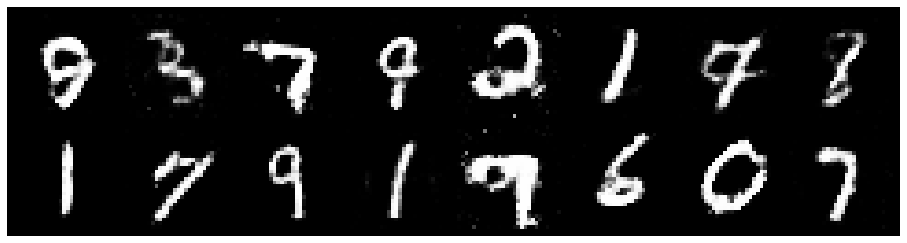

Epoch: [158/200], Batch Num: [100/600]
Discriminator Loss: 0.9678, Generator Loss: 1.2485
D(x): 0.6363, D(G(z)): 0.3271


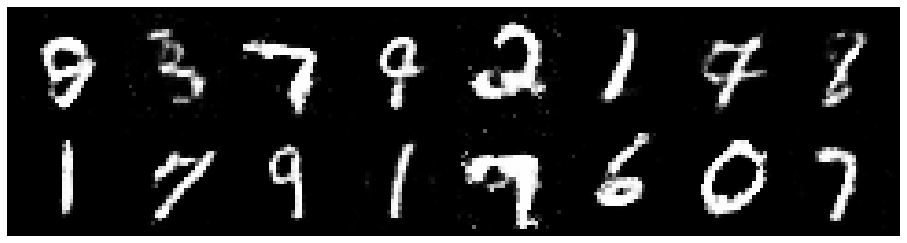

Epoch: [158/200], Batch Num: [200/600]
Discriminator Loss: 1.0517, Generator Loss: 1.1362
D(x): 0.6076, D(G(z)): 0.3368


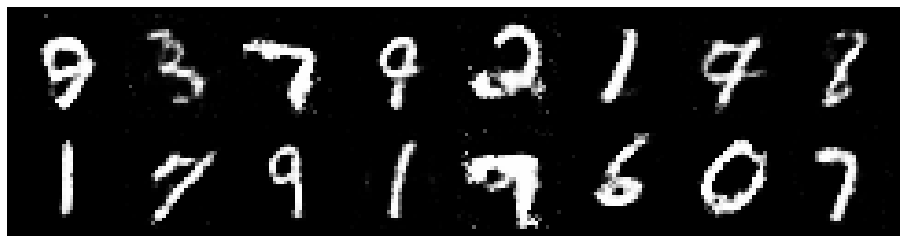

Epoch: [158/200], Batch Num: [300/600]
Discriminator Loss: 1.0353, Generator Loss: 1.0360
D(x): 0.6872, D(G(z)): 0.3823


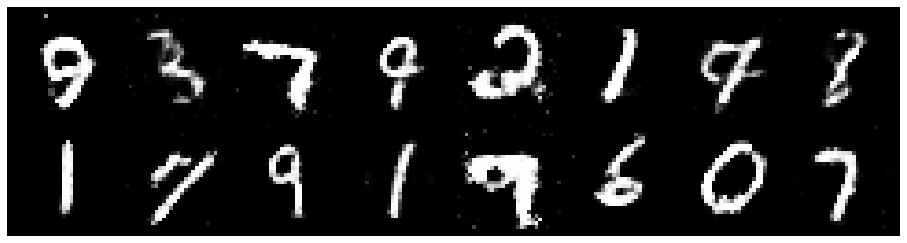

Epoch: [158/200], Batch Num: [400/600]
Discriminator Loss: 1.0489, Generator Loss: 1.3077
D(x): 0.6326, D(G(z)): 0.3541


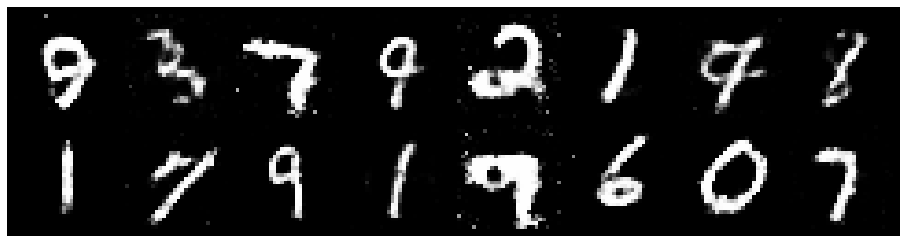

Epoch: [158/200], Batch Num: [500/600]
Discriminator Loss: 1.0159, Generator Loss: 1.2671
D(x): 0.5755, D(G(z)): 0.2810


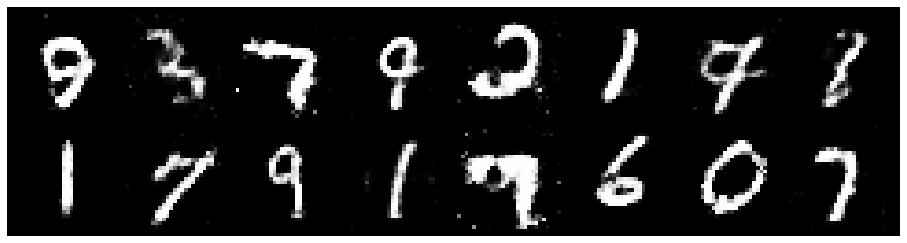

Epoch: [159/200], Batch Num: [0/600]
Discriminator Loss: 1.0483, Generator Loss: 1.3038
D(x): 0.6269, D(G(z)): 0.3370


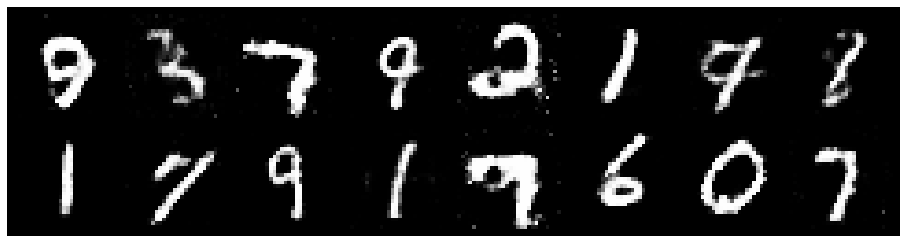

Epoch: [159/200], Batch Num: [100/600]
Discriminator Loss: 1.1932, Generator Loss: 1.0037
D(x): 0.6046, D(G(z)): 0.3934


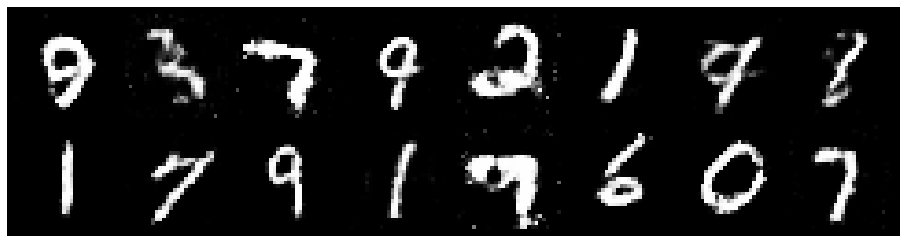

Epoch: [159/200], Batch Num: [200/600]
Discriminator Loss: 1.1171, Generator Loss: 1.2418
D(x): 0.5794, D(G(z)): 0.3506


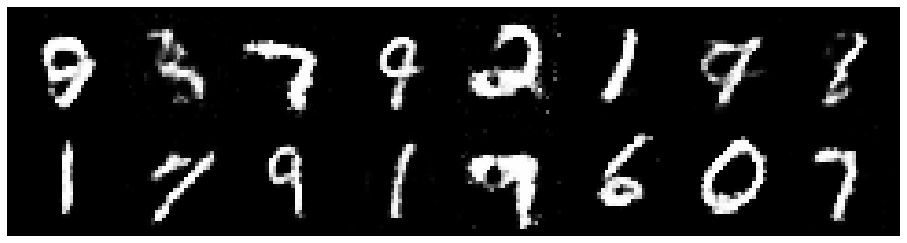

Epoch: [159/200], Batch Num: [300/600]
Discriminator Loss: 1.0979, Generator Loss: 1.3096
D(x): 0.5772, D(G(z)): 0.3315


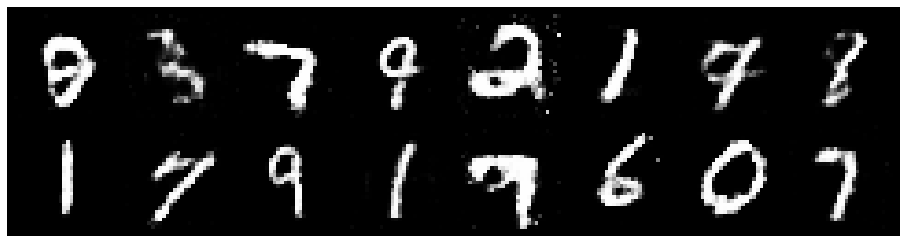

Epoch: [159/200], Batch Num: [400/600]
Discriminator Loss: 0.9733, Generator Loss: 1.2337
D(x): 0.6439, D(G(z)): 0.3316


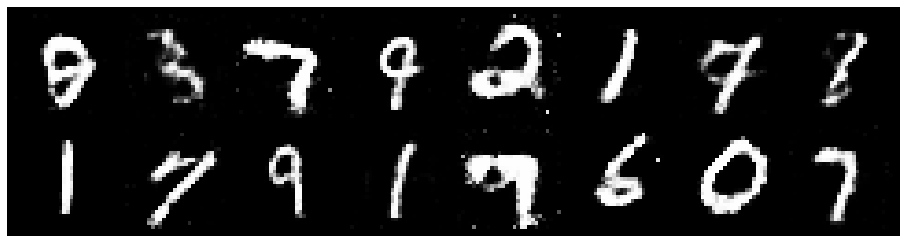

Epoch: [159/200], Batch Num: [500/600]
Discriminator Loss: 1.0293, Generator Loss: 1.1785
D(x): 0.6699, D(G(z)): 0.3413


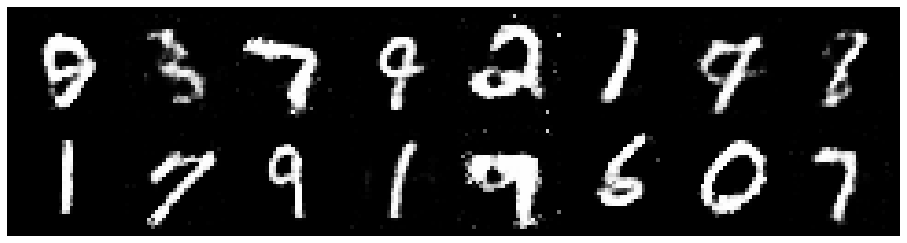

Epoch: [160/200], Batch Num: [0/600]
Discriminator Loss: 1.0564, Generator Loss: 1.1358
D(x): 0.6333, D(G(z)): 0.3520


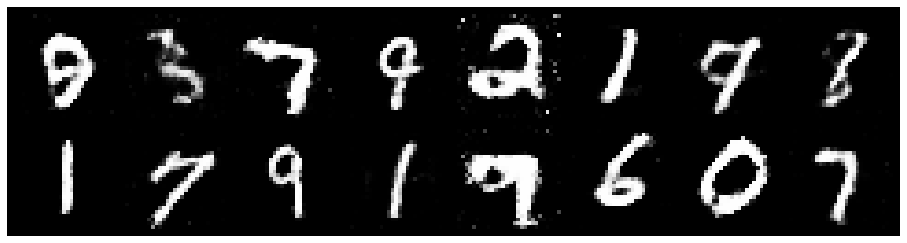

Epoch: [160/200], Batch Num: [100/600]
Discriminator Loss: 1.1802, Generator Loss: 1.0772
D(x): 0.6522, D(G(z)): 0.4400


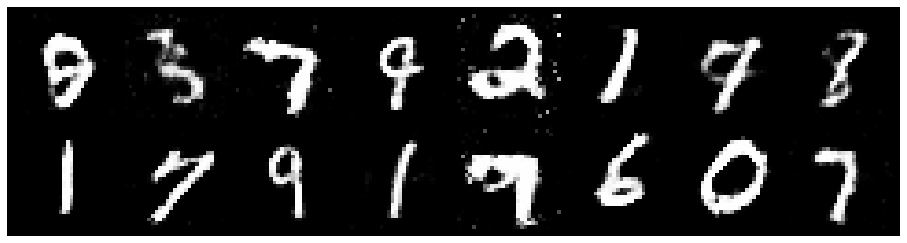

Epoch: [160/200], Batch Num: [200/600]
Discriminator Loss: 1.1317, Generator Loss: 1.1576
D(x): 0.6240, D(G(z)): 0.3929


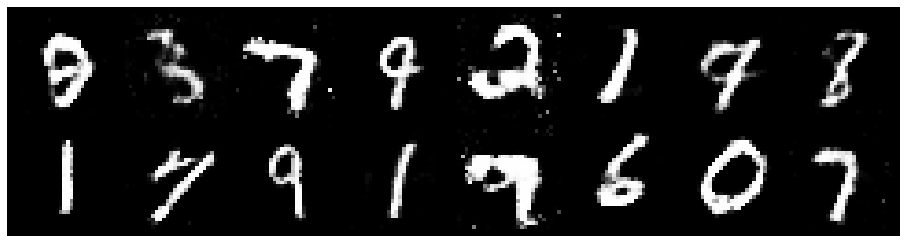

Epoch: [160/200], Batch Num: [300/600]
Discriminator Loss: 1.1926, Generator Loss: 1.2780
D(x): 0.6369, D(G(z)): 0.3984


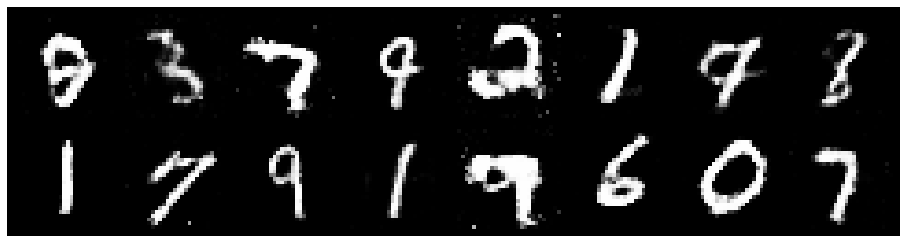

Epoch: [160/200], Batch Num: [400/600]
Discriminator Loss: 1.1416, Generator Loss: 1.1545
D(x): 0.5968, D(G(z)): 0.3669


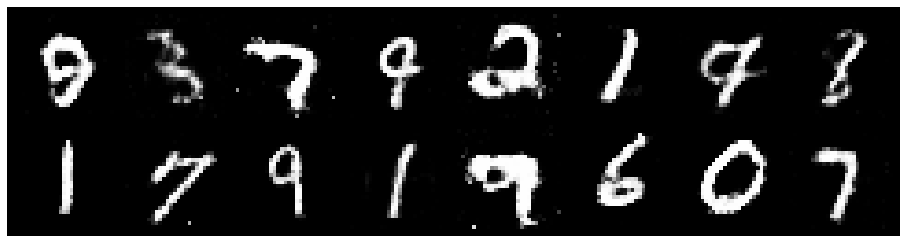

Epoch: [160/200], Batch Num: [500/600]
Discriminator Loss: 1.2290, Generator Loss: 1.2044
D(x): 0.5988, D(G(z)): 0.4047


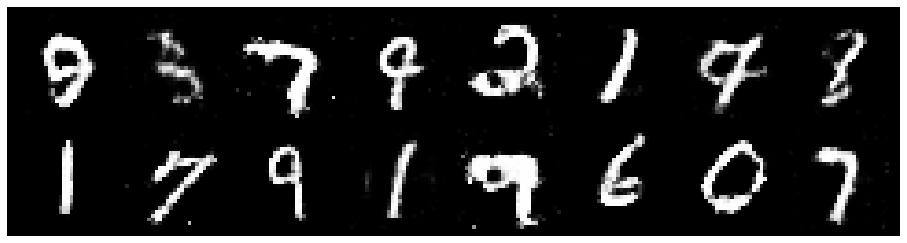

Epoch: [161/200], Batch Num: [0/600]
Discriminator Loss: 0.9555, Generator Loss: 1.1634
D(x): 0.6779, D(G(z)): 0.3647


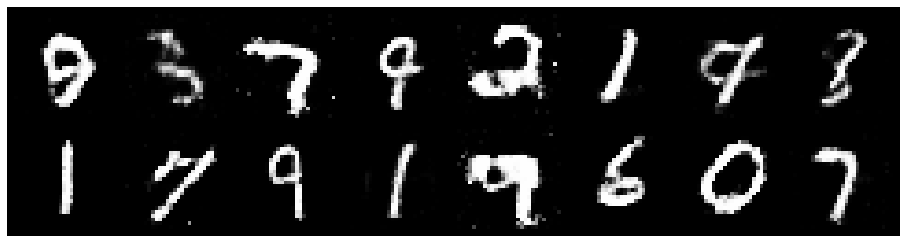

Epoch: [161/200], Batch Num: [100/600]
Discriminator Loss: 1.1271, Generator Loss: 0.9159
D(x): 0.6154, D(G(z)): 0.3928


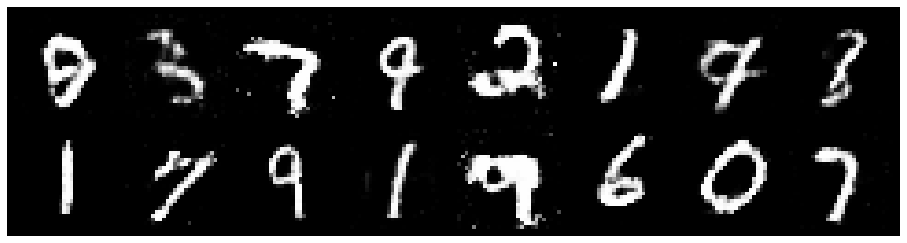

Epoch: [161/200], Batch Num: [200/600]
Discriminator Loss: 1.0247, Generator Loss: 1.0707
D(x): 0.6134, D(G(z)): 0.3374


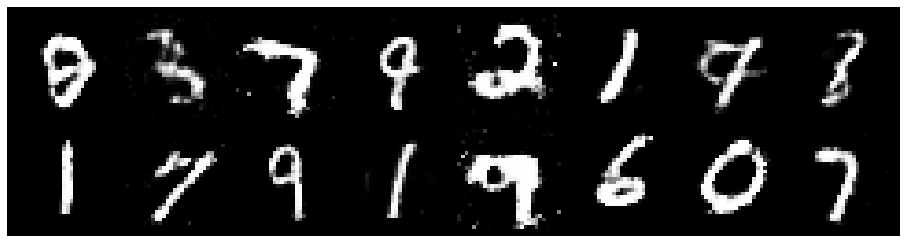

Epoch: [161/200], Batch Num: [300/600]
Discriminator Loss: 1.1013, Generator Loss: 1.2262
D(x): 0.6038, D(G(z)): 0.3564


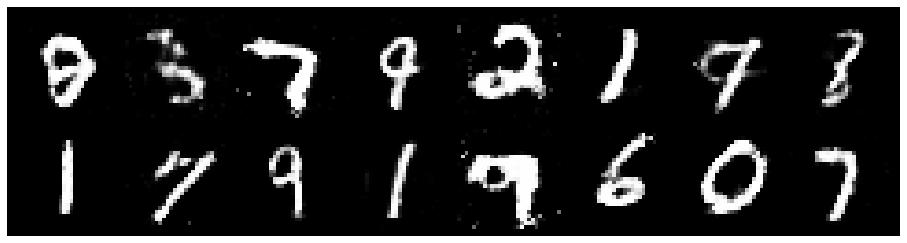

Epoch: [161/200], Batch Num: [400/600]
Discriminator Loss: 1.1493, Generator Loss: 1.1216
D(x): 0.5767, D(G(z)): 0.3620


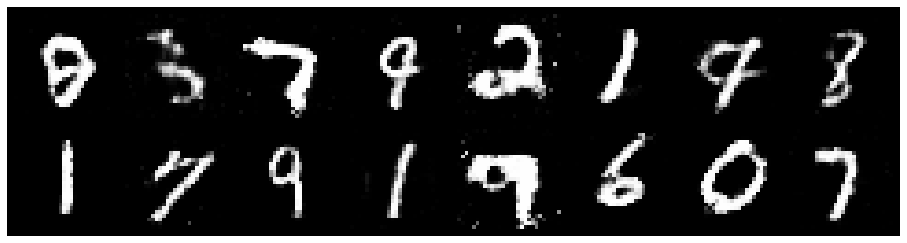

Epoch: [161/200], Batch Num: [500/600]
Discriminator Loss: 1.0286, Generator Loss: 1.0722
D(x): 0.6250, D(G(z)): 0.3518


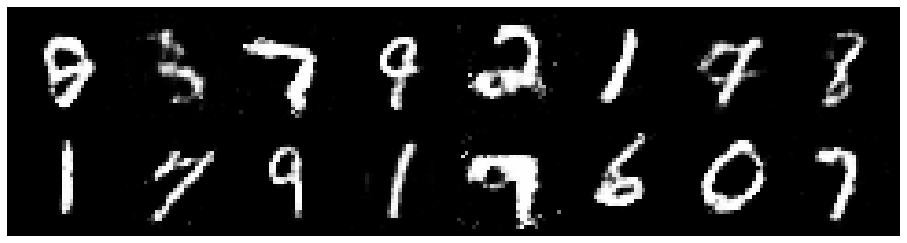

Epoch: [162/200], Batch Num: [0/600]
Discriminator Loss: 1.0845, Generator Loss: 1.0113
D(x): 0.6207, D(G(z)): 0.3719


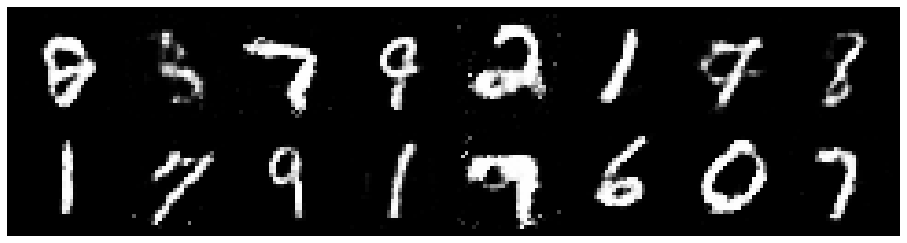

Epoch: [162/200], Batch Num: [100/600]
Discriminator Loss: 1.2092, Generator Loss: 1.1236
D(x): 0.6059, D(G(z)): 0.4240


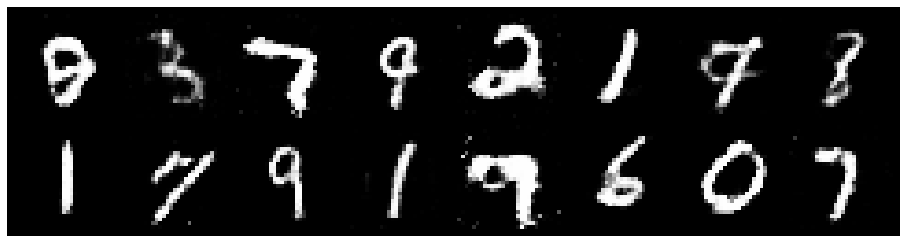

Epoch: [162/200], Batch Num: [200/600]
Discriminator Loss: 0.9306, Generator Loss: 1.2084
D(x): 0.6210, D(G(z)): 0.2882


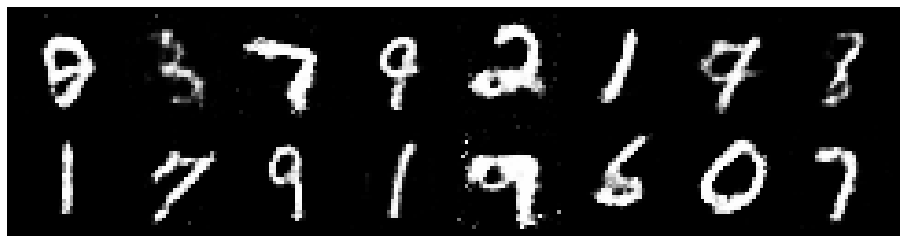

Epoch: [162/200], Batch Num: [300/600]
Discriminator Loss: 1.1705, Generator Loss: 1.0924
D(x): 0.6112, D(G(z)): 0.3626


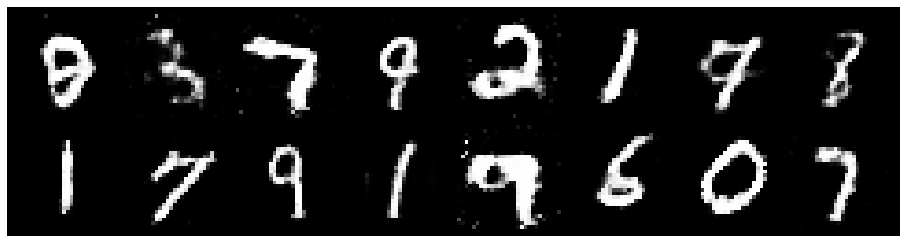

Epoch: [162/200], Batch Num: [400/600]
Discriminator Loss: 1.0885, Generator Loss: 1.1429
D(x): 0.6330, D(G(z)): 0.3688


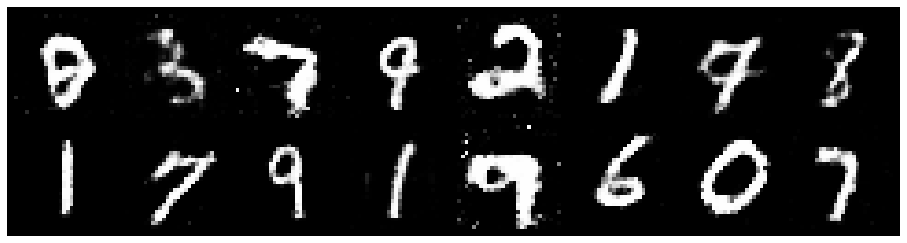

Epoch: [162/200], Batch Num: [500/600]
Discriminator Loss: 1.0952, Generator Loss: 1.1536
D(x): 0.6051, D(G(z)): 0.3514


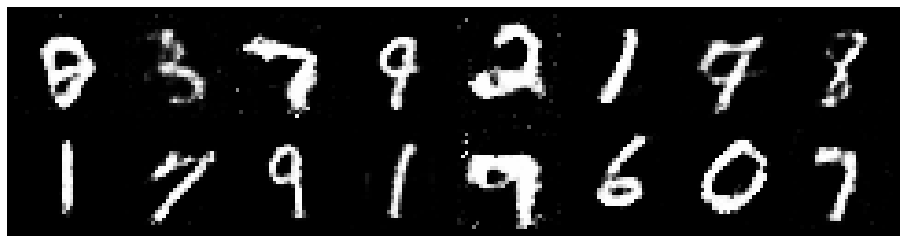

Epoch: [163/200], Batch Num: [0/600]
Discriminator Loss: 1.0241, Generator Loss: 1.4135
D(x): 0.6358, D(G(z)): 0.3361


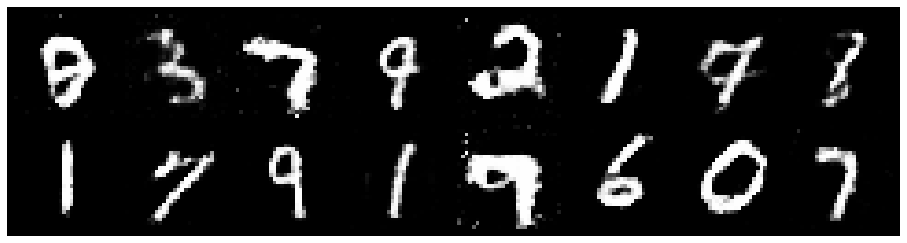

Epoch: [163/200], Batch Num: [100/600]
Discriminator Loss: 1.0871, Generator Loss: 1.2581
D(x): 0.6383, D(G(z)): 0.3636


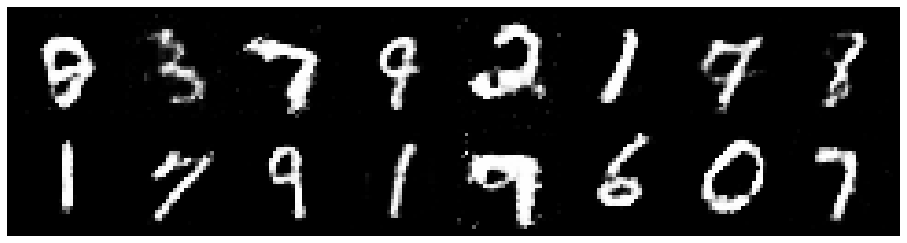

Epoch: [163/200], Batch Num: [200/600]
Discriminator Loss: 0.9750, Generator Loss: 1.0100
D(x): 0.7010, D(G(z)): 0.3904


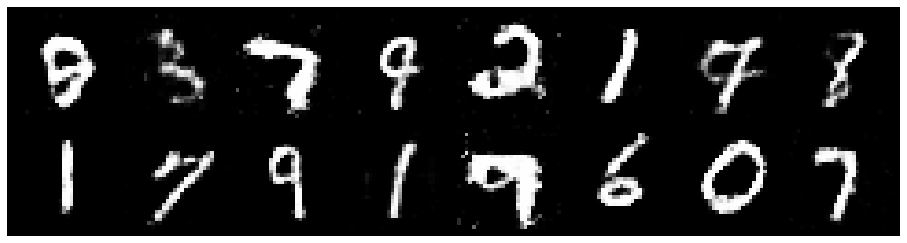

Epoch: [163/200], Batch Num: [300/600]
Discriminator Loss: 1.1024, Generator Loss: 1.0807
D(x): 0.6546, D(G(z)): 0.4021


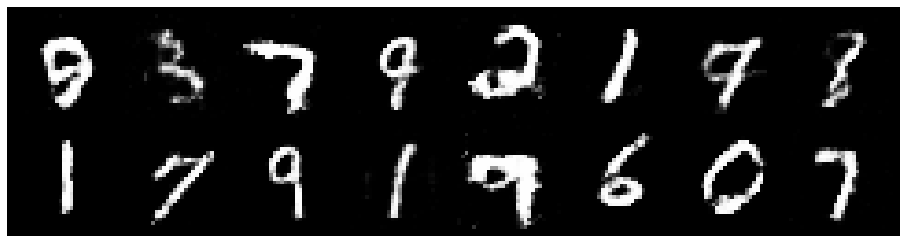

Epoch: [163/200], Batch Num: [400/600]
Discriminator Loss: 1.1646, Generator Loss: 1.2674
D(x): 0.6163, D(G(z)): 0.3988


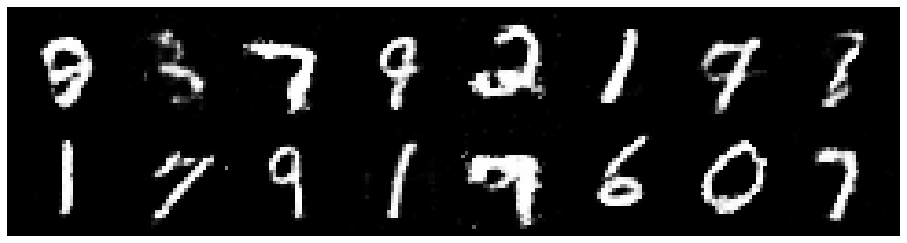

Epoch: [163/200], Batch Num: [500/600]
Discriminator Loss: 1.1886, Generator Loss: 1.0683
D(x): 0.5879, D(G(z)): 0.3894


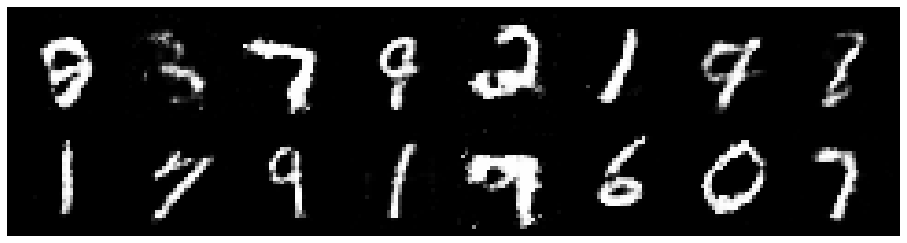

Epoch: [164/200], Batch Num: [0/600]
Discriminator Loss: 1.0365, Generator Loss: 1.1457
D(x): 0.6220, D(G(z)): 0.3552


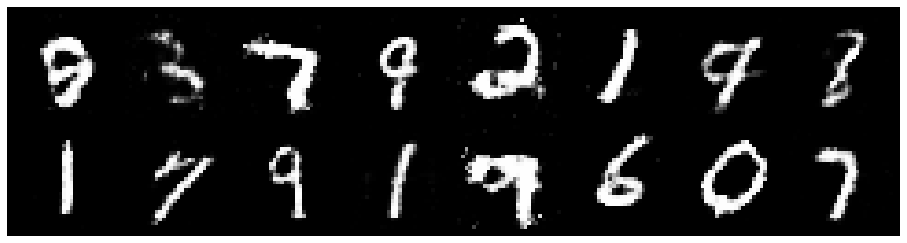

Epoch: [164/200], Batch Num: [100/600]
Discriminator Loss: 1.2184, Generator Loss: 1.1397
D(x): 0.6240, D(G(z)): 0.4451


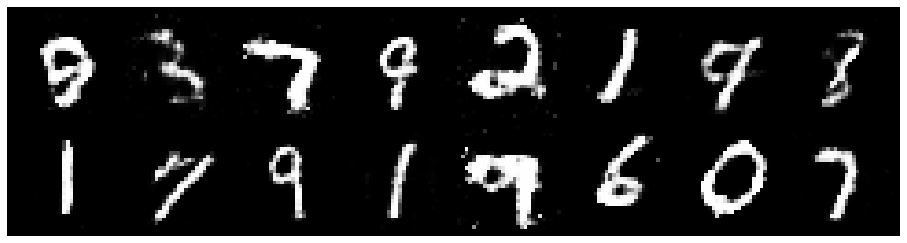

Epoch: [164/200], Batch Num: [200/600]
Discriminator Loss: 1.0514, Generator Loss: 1.1600
D(x): 0.6550, D(G(z)): 0.3647


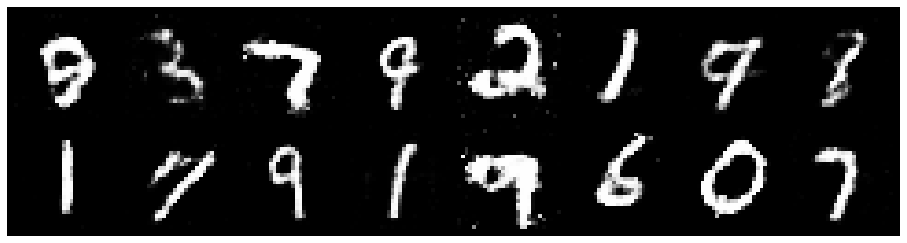

Epoch: [164/200], Batch Num: [300/600]
Discriminator Loss: 1.1282, Generator Loss: 0.9895
D(x): 0.6569, D(G(z)): 0.4264


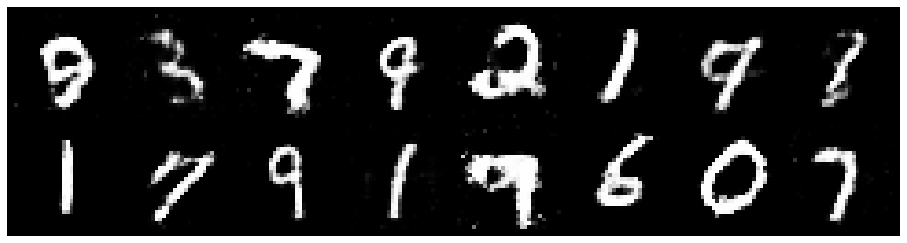

Epoch: [164/200], Batch Num: [400/600]
Discriminator Loss: 1.2048, Generator Loss: 1.1694
D(x): 0.6368, D(G(z)): 0.4237


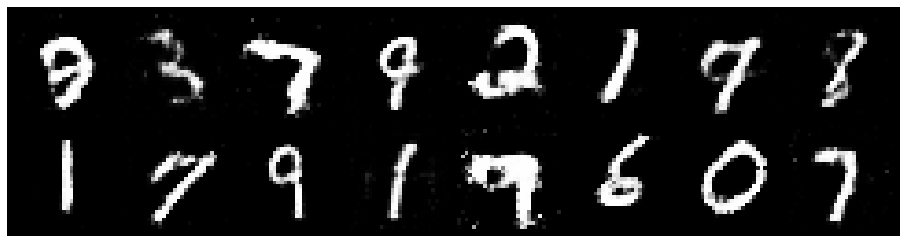

Epoch: [164/200], Batch Num: [500/600]
Discriminator Loss: 1.0187, Generator Loss: 1.2145
D(x): 0.6313, D(G(z)): 0.3455


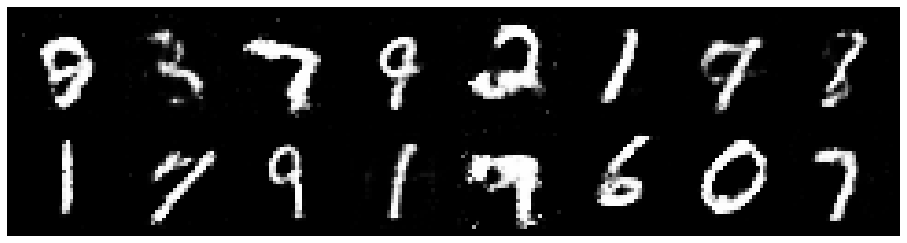

Epoch: [165/200], Batch Num: [0/600]
Discriminator Loss: 1.2034, Generator Loss: 1.2269
D(x): 0.5970, D(G(z)): 0.3907


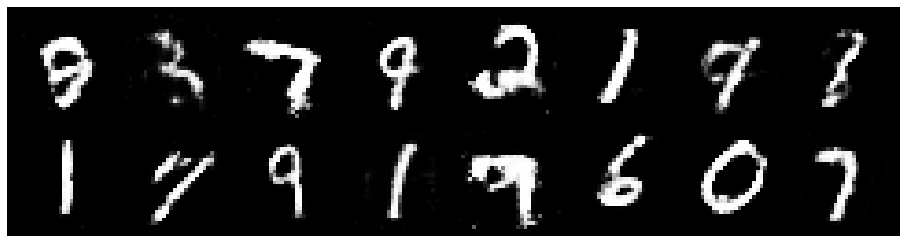

Epoch: [165/200], Batch Num: [100/600]
Discriminator Loss: 1.1543, Generator Loss: 1.1414
D(x): 0.6307, D(G(z)): 0.3990


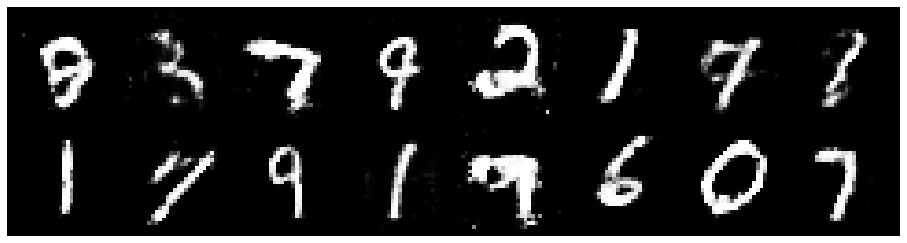

Epoch: [165/200], Batch Num: [200/600]
Discriminator Loss: 1.1969, Generator Loss: 0.9611
D(x): 0.6643, D(G(z)): 0.4512


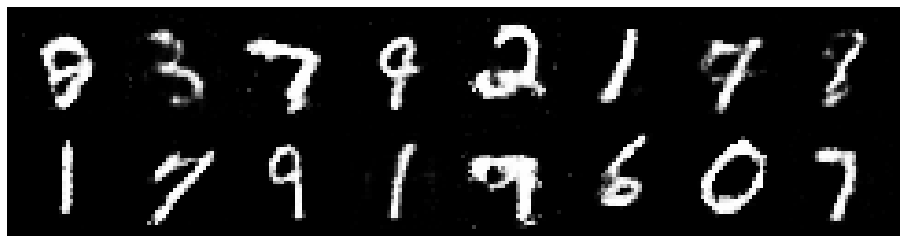

Epoch: [165/200], Batch Num: [300/600]
Discriminator Loss: 1.1199, Generator Loss: 1.0169
D(x): 0.6682, D(G(z)): 0.4512


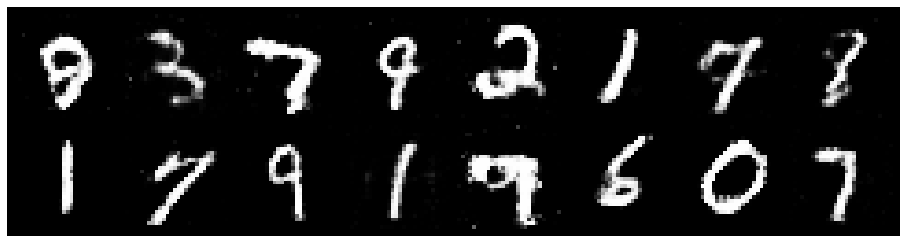

Epoch: [165/200], Batch Num: [400/600]
Discriminator Loss: 1.0455, Generator Loss: 1.1717
D(x): 0.6349, D(G(z)): 0.3667


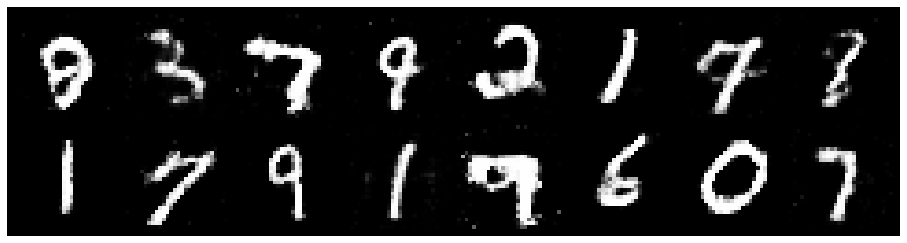

Epoch: [165/200], Batch Num: [500/600]
Discriminator Loss: 1.0460, Generator Loss: 1.2782
D(x): 0.6586, D(G(z)): 0.3642


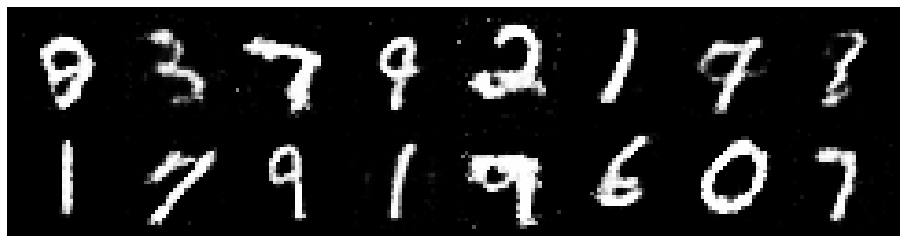

Epoch: [166/200], Batch Num: [0/600]
Discriminator Loss: 1.1598, Generator Loss: 1.2853
D(x): 0.5873, D(G(z)): 0.3661


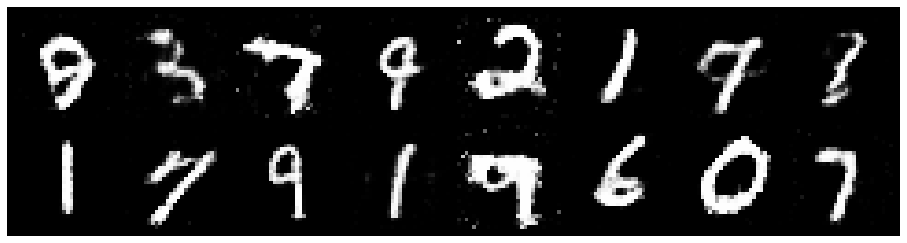

Epoch: [166/200], Batch Num: [100/600]
Discriminator Loss: 1.1439, Generator Loss: 0.9594
D(x): 0.6895, D(G(z)): 0.4503


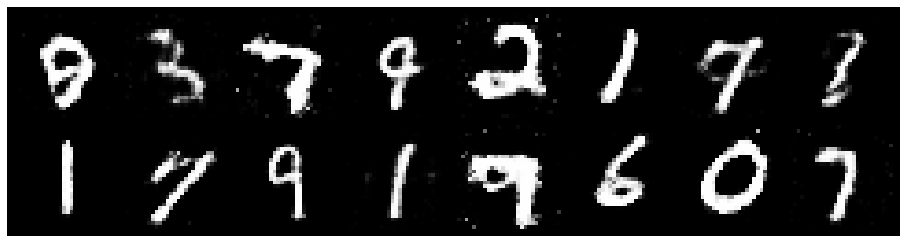

Epoch: [166/200], Batch Num: [200/600]
Discriminator Loss: 1.2059, Generator Loss: 1.0860
D(x): 0.6212, D(G(z)): 0.4228


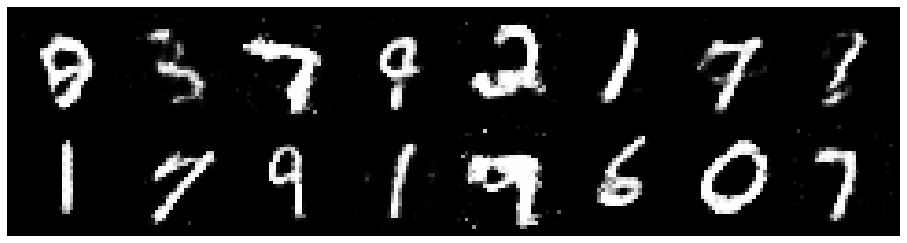

Epoch: [166/200], Batch Num: [300/600]
Discriminator Loss: 1.2106, Generator Loss: 1.3078
D(x): 0.5747, D(G(z)): 0.3616


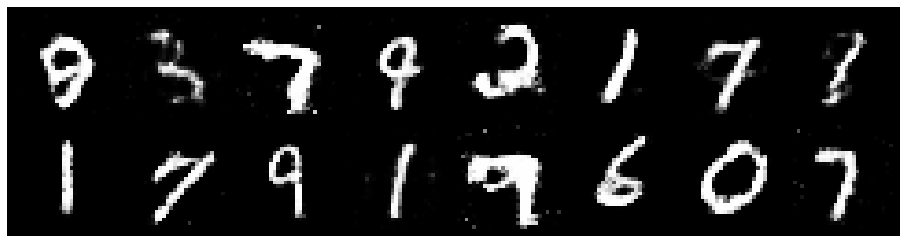

Epoch: [166/200], Batch Num: [400/600]
Discriminator Loss: 1.1473, Generator Loss: 1.1750
D(x): 0.6168, D(G(z)): 0.3776


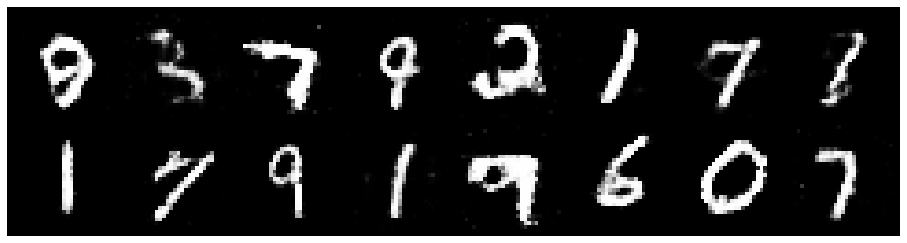

Epoch: [166/200], Batch Num: [500/600]
Discriminator Loss: 1.1938, Generator Loss: 1.2900
D(x): 0.5702, D(G(z)): 0.3644


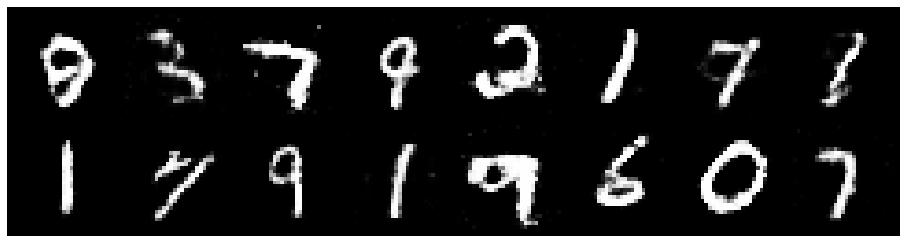

Epoch: [167/200], Batch Num: [0/600]
Discriminator Loss: 1.0960, Generator Loss: 0.9963
D(x): 0.5999, D(G(z)): 0.3610


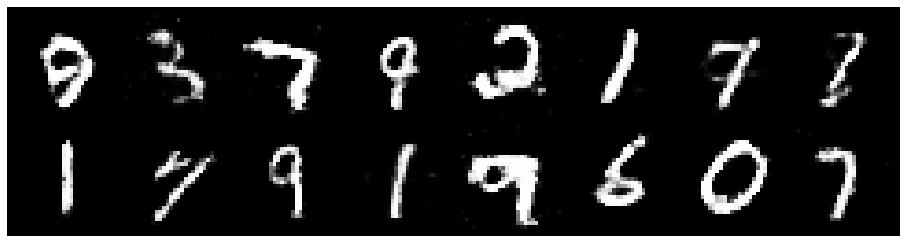

Epoch: [167/200], Batch Num: [100/600]
Discriminator Loss: 1.1992, Generator Loss: 1.1031
D(x): 0.5649, D(G(z)): 0.3748


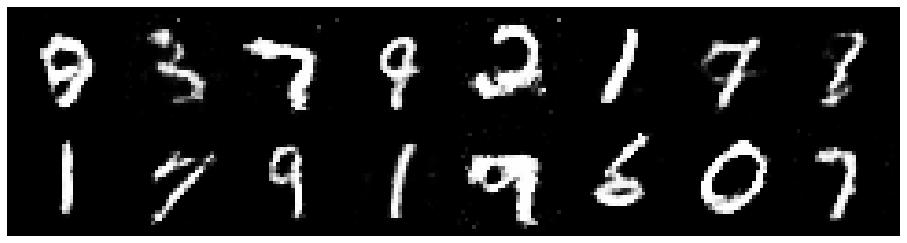

Epoch: [167/200], Batch Num: [200/600]
Discriminator Loss: 1.0716, Generator Loss: 1.2911
D(x): 0.5898, D(G(z)): 0.3301


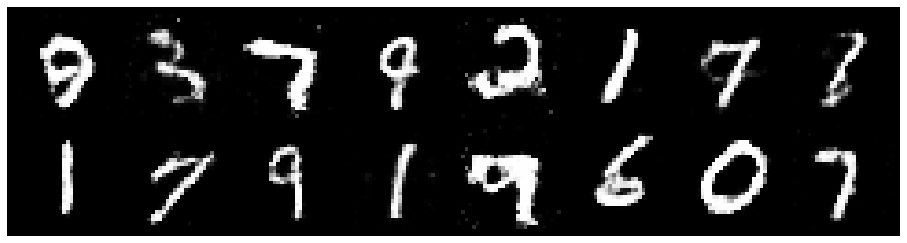

Epoch: [167/200], Batch Num: [300/600]
Discriminator Loss: 1.0604, Generator Loss: 1.2885
D(x): 0.6131, D(G(z)): 0.3436


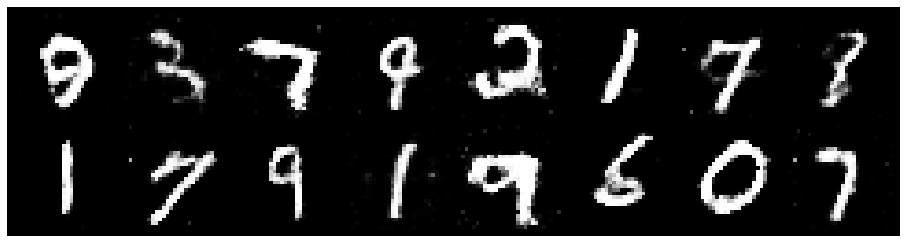

Epoch: [167/200], Batch Num: [400/600]
Discriminator Loss: 1.0086, Generator Loss: 1.3864
D(x): 0.6559, D(G(z)): 0.3478


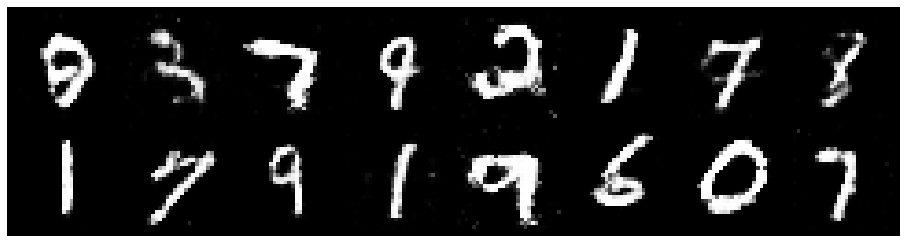

Epoch: [167/200], Batch Num: [500/600]
Discriminator Loss: 1.1980, Generator Loss: 1.1763
D(x): 0.5654, D(G(z)): 0.3728


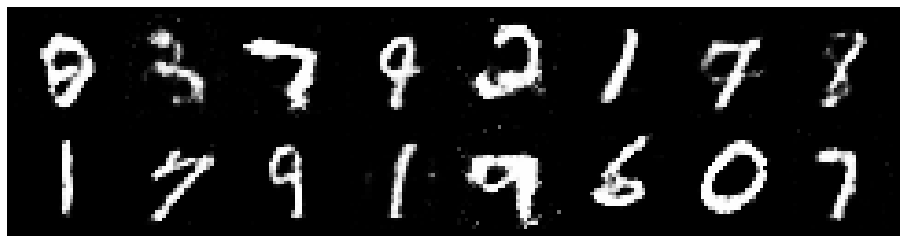

Epoch: [168/200], Batch Num: [0/600]
Discriminator Loss: 1.1044, Generator Loss: 1.1244
D(x): 0.6388, D(G(z)): 0.3909


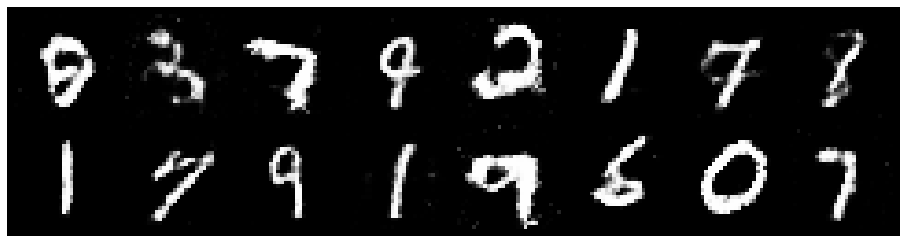

Epoch: [168/200], Batch Num: [100/600]
Discriminator Loss: 1.0602, Generator Loss: 1.1575
D(x): 0.6947, D(G(z)): 0.3956


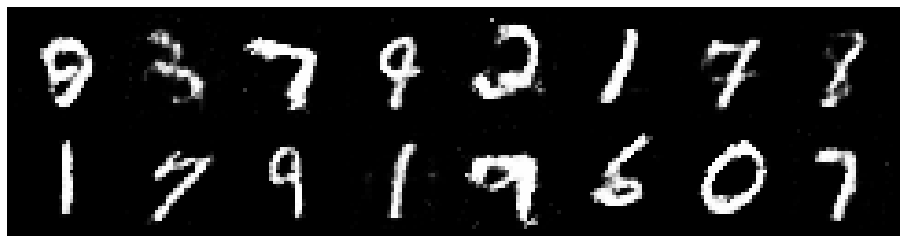

Epoch: [168/200], Batch Num: [200/600]
Discriminator Loss: 1.0388, Generator Loss: 0.9585
D(x): 0.6681, D(G(z)): 0.3953


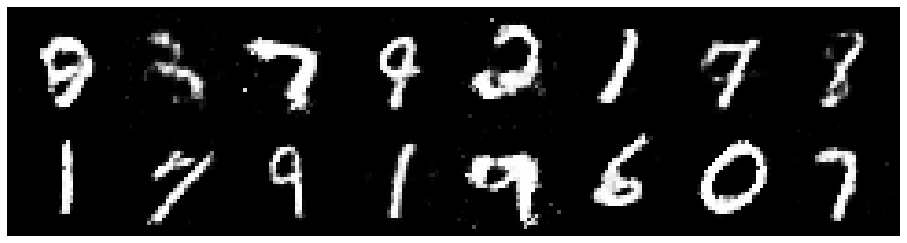

Epoch: [168/200], Batch Num: [300/600]
Discriminator Loss: 1.0699, Generator Loss: 0.9818
D(x): 0.6383, D(G(z)): 0.3798


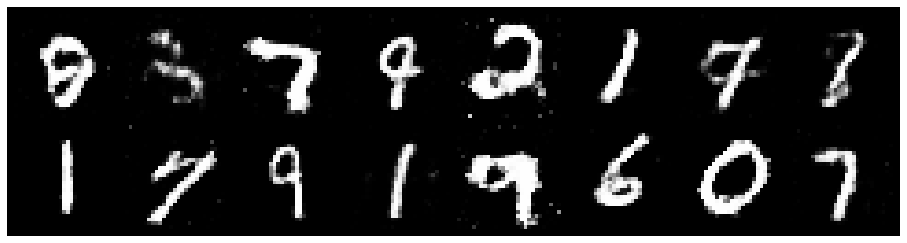

Epoch: [168/200], Batch Num: [400/600]
Discriminator Loss: 1.1429, Generator Loss: 0.8770
D(x): 0.6112, D(G(z)): 0.3984


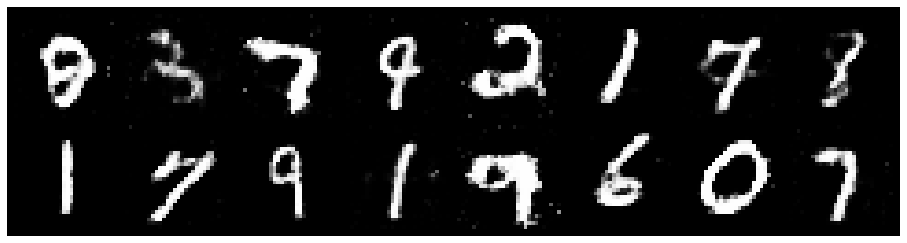

Epoch: [168/200], Batch Num: [500/600]
Discriminator Loss: 1.1569, Generator Loss: 1.0702
D(x): 0.6182, D(G(z)): 0.3967


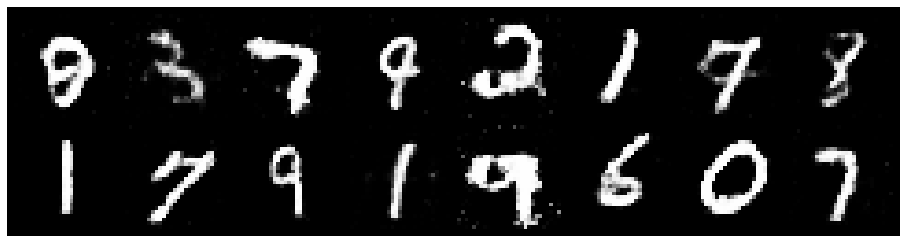

Epoch: [169/200], Batch Num: [0/600]
Discriminator Loss: 1.1571, Generator Loss: 1.0846
D(x): 0.5881, D(G(z)): 0.3789


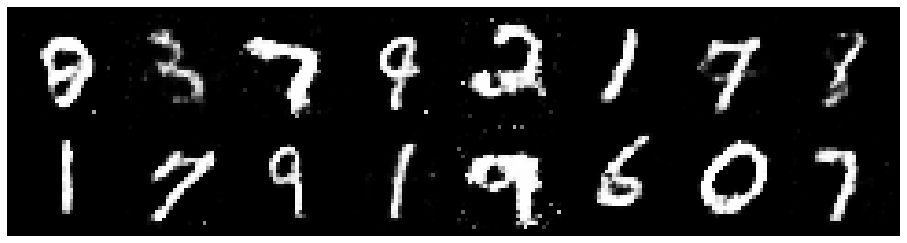

Epoch: [169/200], Batch Num: [100/600]
Discriminator Loss: 1.3015, Generator Loss: 1.1121
D(x): 0.5623, D(G(z)): 0.4151


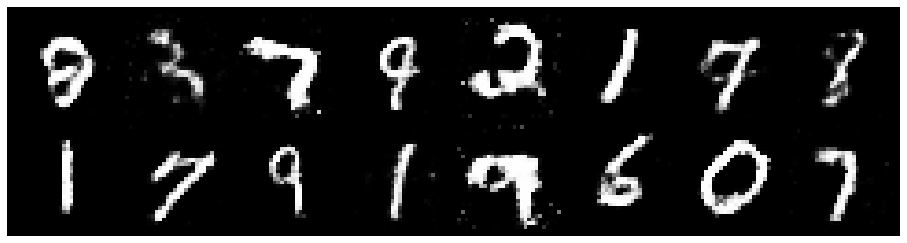

Epoch: [169/200], Batch Num: [200/600]
Discriminator Loss: 1.1084, Generator Loss: 1.1054
D(x): 0.5983, D(G(z)): 0.3626


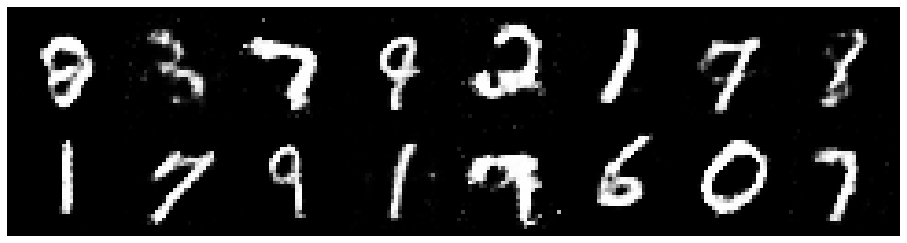

Epoch: [169/200], Batch Num: [300/600]
Discriminator Loss: 1.0241, Generator Loss: 1.1666
D(x): 0.6237, D(G(z)): 0.3510


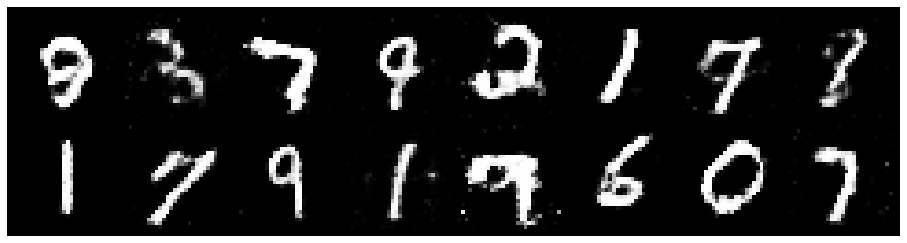

Epoch: [169/200], Batch Num: [400/600]
Discriminator Loss: 1.1336, Generator Loss: 1.0508
D(x): 0.5783, D(G(z)): 0.3624


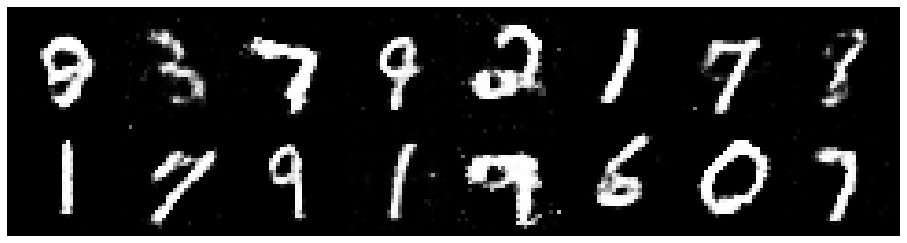

Epoch: [169/200], Batch Num: [500/600]
Discriminator Loss: 1.0126, Generator Loss: 1.0602
D(x): 0.6456, D(G(z)): 0.3635


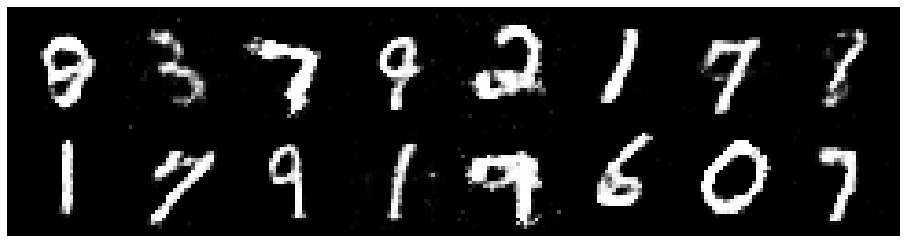

Epoch: [170/200], Batch Num: [0/600]
Discriminator Loss: 1.1051, Generator Loss: 1.0785
D(x): 0.6056, D(G(z)): 0.3676


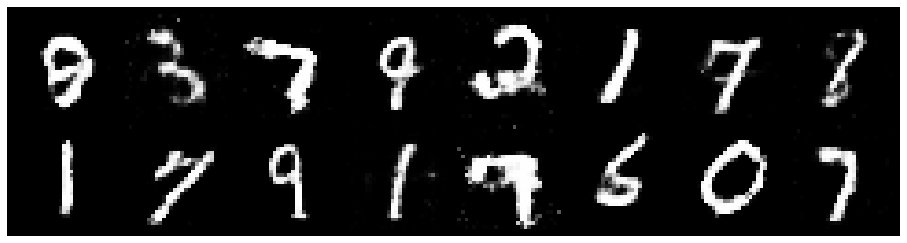

Epoch: [170/200], Batch Num: [100/600]
Discriminator Loss: 1.0783, Generator Loss: 1.2033
D(x): 0.6188, D(G(z)): 0.3466


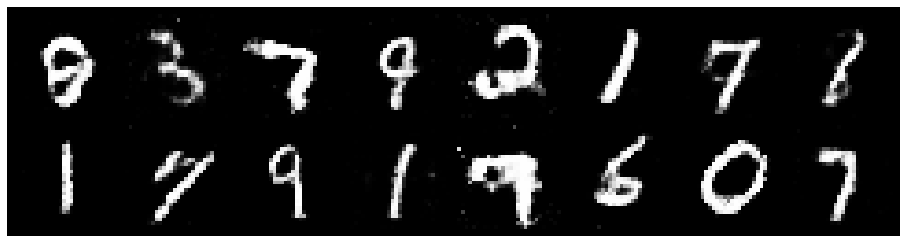

Epoch: [170/200], Batch Num: [200/600]
Discriminator Loss: 1.1293, Generator Loss: 1.1407
D(x): 0.5796, D(G(z)): 0.3539


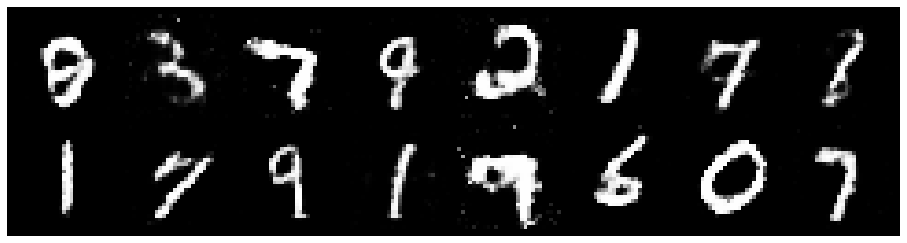

Epoch: [170/200], Batch Num: [300/600]
Discriminator Loss: 1.0616, Generator Loss: 1.0975
D(x): 0.6202, D(G(z)): 0.3541


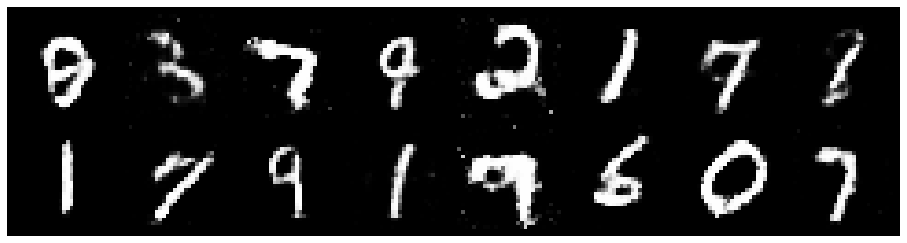

Epoch: [170/200], Batch Num: [400/600]
Discriminator Loss: 1.1837, Generator Loss: 1.0306
D(x): 0.6152, D(G(z)): 0.4193


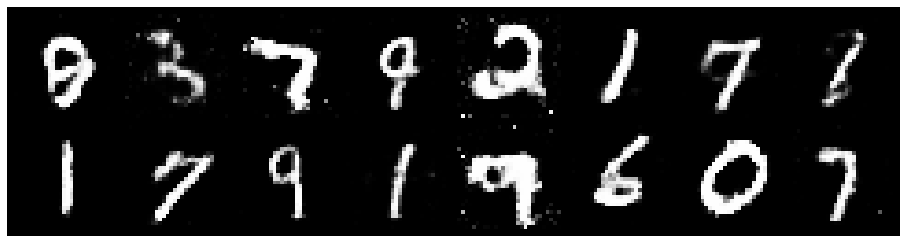

Epoch: [170/200], Batch Num: [500/600]
Discriminator Loss: 1.1870, Generator Loss: 1.2193
D(x): 0.6020, D(G(z)): 0.3835


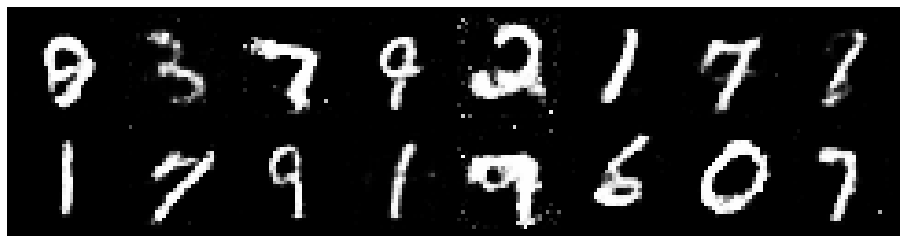

Epoch: [171/200], Batch Num: [0/600]
Discriminator Loss: 1.1546, Generator Loss: 1.0932
D(x): 0.5934, D(G(z)): 0.3718


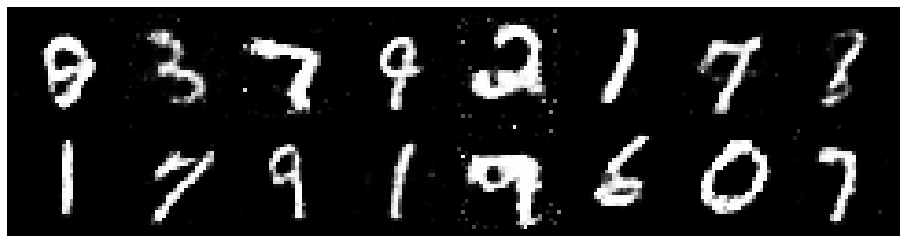

Epoch: [171/200], Batch Num: [100/600]
Discriminator Loss: 1.1256, Generator Loss: 1.2820
D(x): 0.6092, D(G(z)): 0.3391


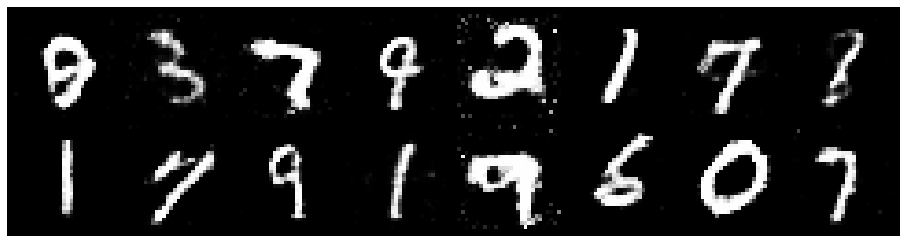

Epoch: [171/200], Batch Num: [200/600]
Discriminator Loss: 1.1482, Generator Loss: 1.1082
D(x): 0.5889, D(G(z)): 0.3589


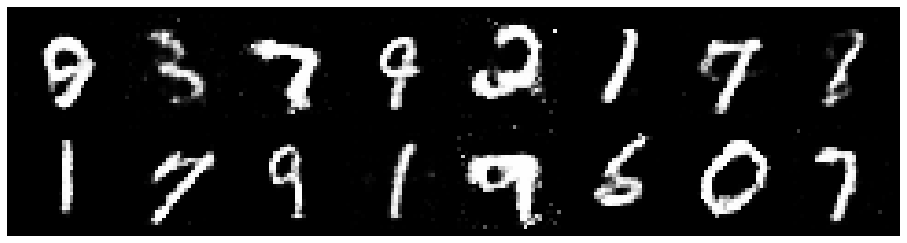

Epoch: [171/200], Batch Num: [300/600]
Discriminator Loss: 1.2328, Generator Loss: 1.0569
D(x): 0.6220, D(G(z)): 0.4439


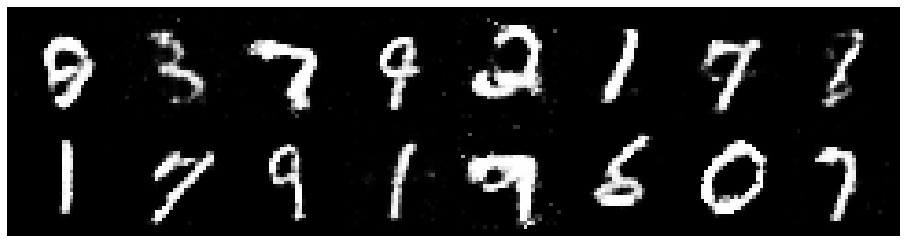

Epoch: [171/200], Batch Num: [400/600]
Discriminator Loss: 1.1247, Generator Loss: 0.9742
D(x): 0.6181, D(G(z)): 0.3998


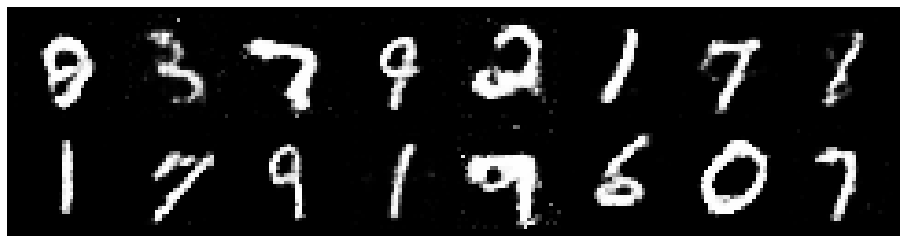

Epoch: [171/200], Batch Num: [500/600]
Discriminator Loss: 1.0635, Generator Loss: 1.0865
D(x): 0.6424, D(G(z)): 0.3693


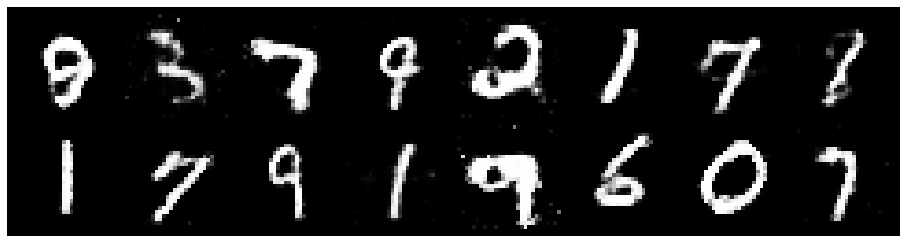

Epoch: [172/200], Batch Num: [0/600]
Discriminator Loss: 1.1403, Generator Loss: 1.0649
D(x): 0.6536, D(G(z)): 0.4333


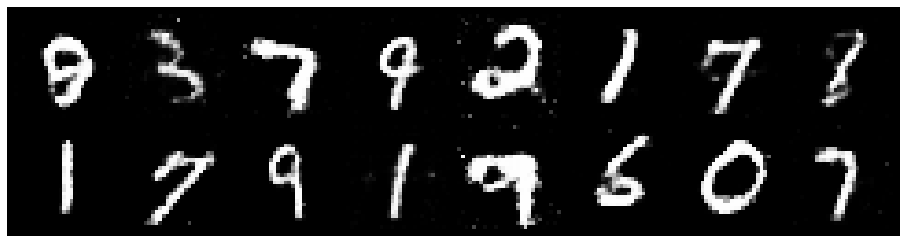

Epoch: [172/200], Batch Num: [100/600]
Discriminator Loss: 1.1779, Generator Loss: 1.0556
D(x): 0.5896, D(G(z)): 0.3977


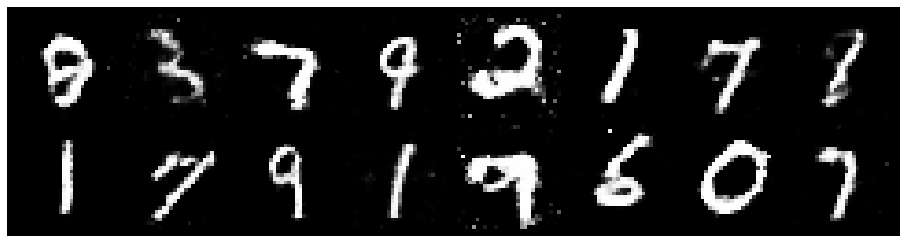

Epoch: [172/200], Batch Num: [200/600]
Discriminator Loss: 1.0550, Generator Loss: 1.2628
D(x): 0.6521, D(G(z)): 0.3787


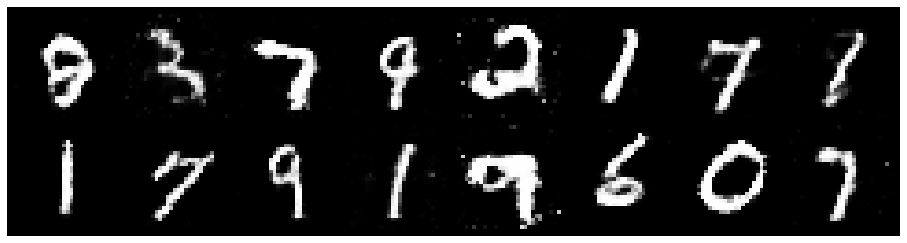

Epoch: [172/200], Batch Num: [300/600]
Discriminator Loss: 1.0611, Generator Loss: 0.9052
D(x): 0.6544, D(G(z)): 0.3858


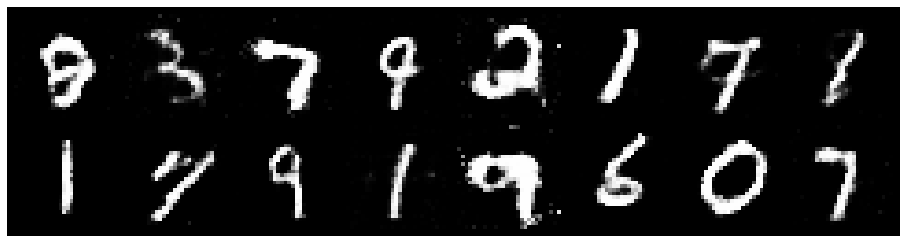

Epoch: [172/200], Batch Num: [400/600]
Discriminator Loss: 1.0751, Generator Loss: 1.1482
D(x): 0.6146, D(G(z)): 0.3633


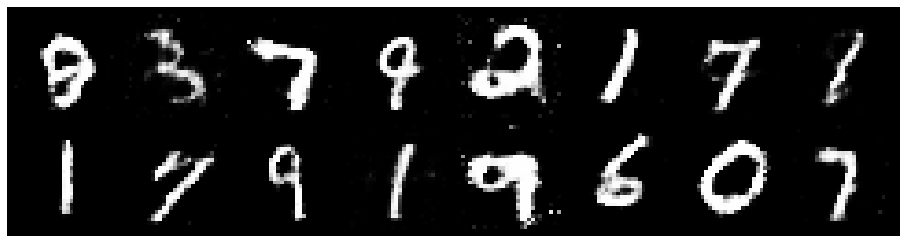

Epoch: [172/200], Batch Num: [500/600]
Discriminator Loss: 1.0001, Generator Loss: 1.3236
D(x): 0.6110, D(G(z)): 0.3128


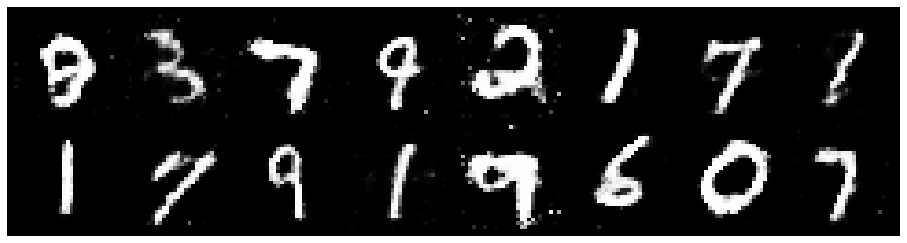

Epoch: [173/200], Batch Num: [0/600]
Discriminator Loss: 1.1408, Generator Loss: 1.2011
D(x): 0.6318, D(G(z)): 0.4057


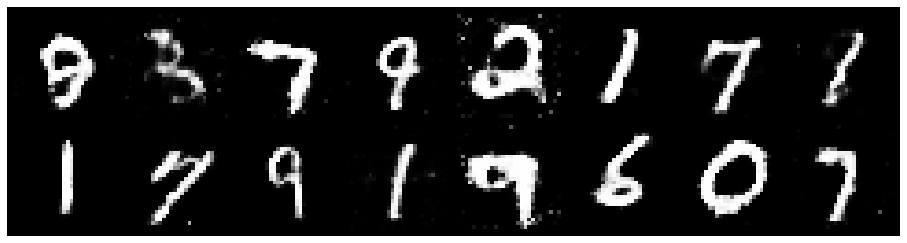

Epoch: [173/200], Batch Num: [100/600]
Discriminator Loss: 1.1426, Generator Loss: 1.1077
D(x): 0.6022, D(G(z)): 0.3660


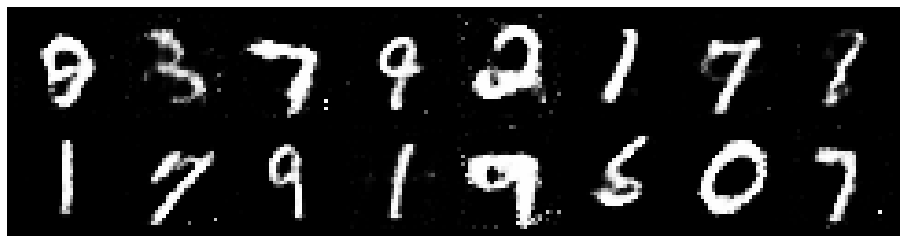

Epoch: [173/200], Batch Num: [200/600]
Discriminator Loss: 1.0853, Generator Loss: 1.1176
D(x): 0.6239, D(G(z)): 0.3742


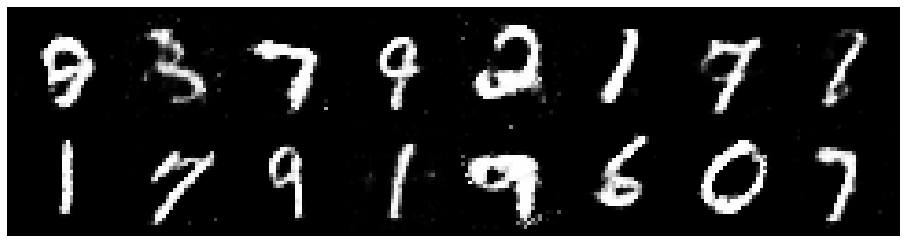

Epoch: [173/200], Batch Num: [300/600]
Discriminator Loss: 1.1998, Generator Loss: 1.1782
D(x): 0.6166, D(G(z)): 0.3977


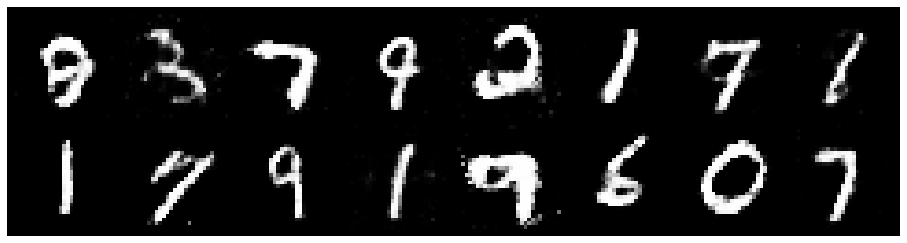

Epoch: [173/200], Batch Num: [400/600]
Discriminator Loss: 1.0410, Generator Loss: 1.1893
D(x): 0.6325, D(G(z)): 0.3669


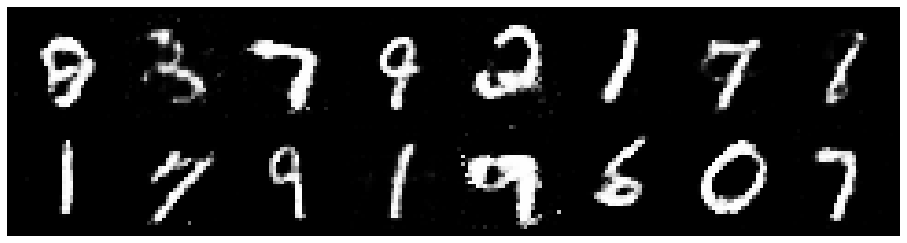

Epoch: [173/200], Batch Num: [500/600]
Discriminator Loss: 0.9918, Generator Loss: 1.0725
D(x): 0.6511, D(G(z)): 0.3500


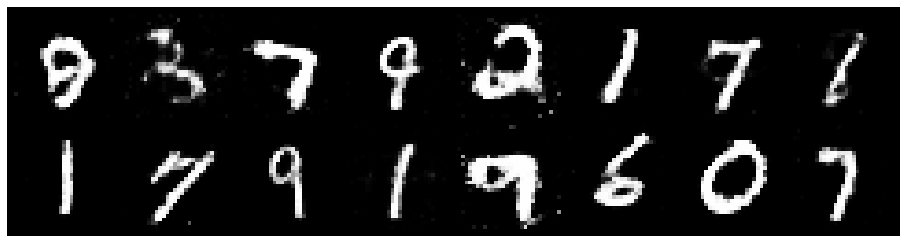

Epoch: [174/200], Batch Num: [0/600]
Discriminator Loss: 1.1844, Generator Loss: 1.1041
D(x): 0.5911, D(G(z)): 0.3893


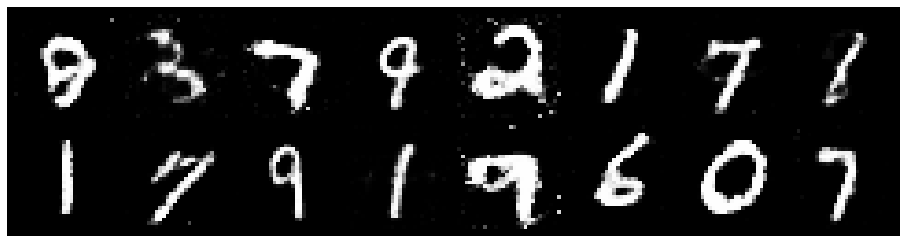

Epoch: [174/200], Batch Num: [100/600]
Discriminator Loss: 1.0807, Generator Loss: 1.2845
D(x): 0.6160, D(G(z)): 0.3686


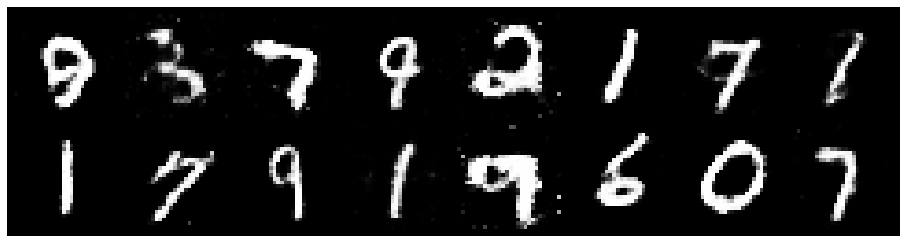

Epoch: [174/200], Batch Num: [200/600]
Discriminator Loss: 1.1413, Generator Loss: 1.1540
D(x): 0.6012, D(G(z)): 0.3626


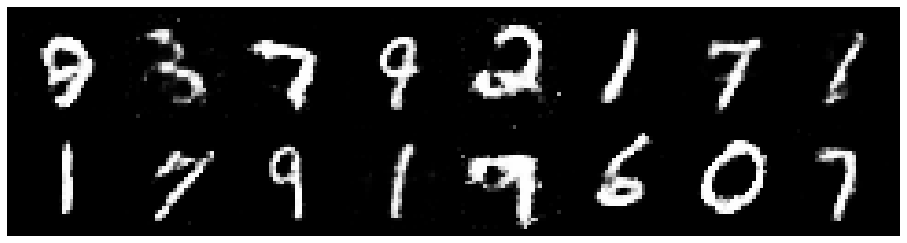

Epoch: [174/200], Batch Num: [300/600]
Discriminator Loss: 1.1312, Generator Loss: 1.2475
D(x): 0.5796, D(G(z)): 0.3584


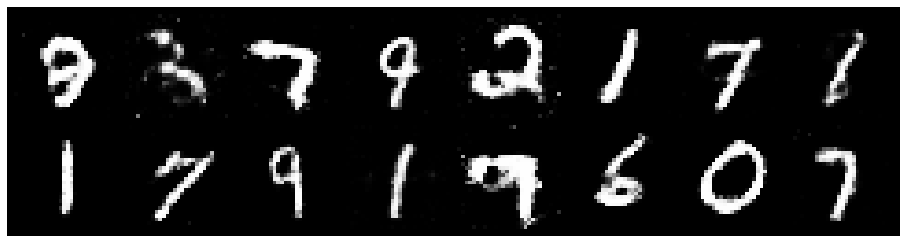

Epoch: [174/200], Batch Num: [400/600]
Discriminator Loss: 1.0793, Generator Loss: 1.1298
D(x): 0.5937, D(G(z)): 0.3395


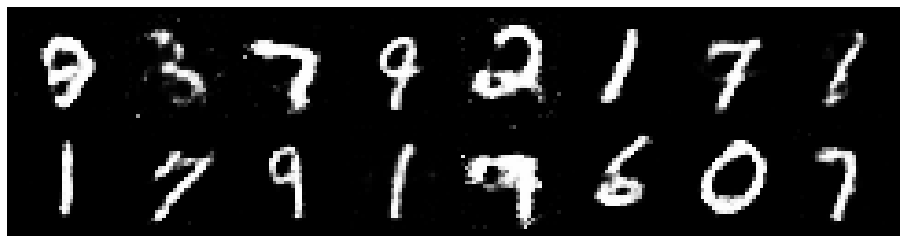

Epoch: [174/200], Batch Num: [500/600]
Discriminator Loss: 1.0399, Generator Loss: 1.2737
D(x): 0.6395, D(G(z)): 0.3568


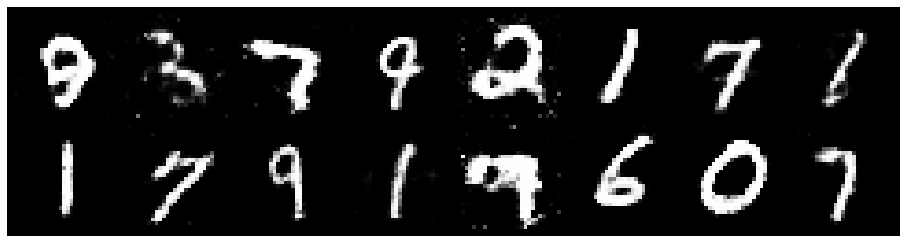

Epoch: [175/200], Batch Num: [0/600]
Discriminator Loss: 1.0733, Generator Loss: 1.1059
D(x): 0.6903, D(G(z)): 0.4098


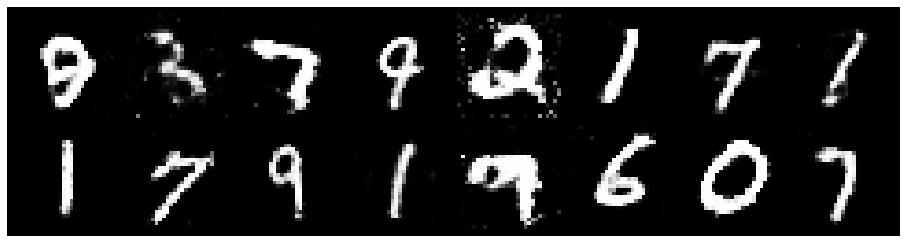

Epoch: [175/200], Batch Num: [100/600]
Discriminator Loss: 1.2029, Generator Loss: 0.9548
D(x): 0.6422, D(G(z)): 0.4147


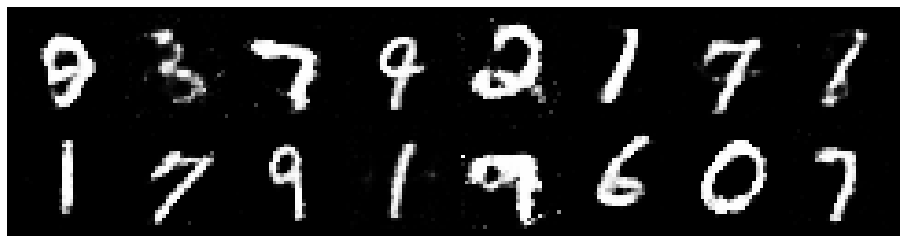

Epoch: [175/200], Batch Num: [200/600]
Discriminator Loss: 1.1051, Generator Loss: 1.3283
D(x): 0.5981, D(G(z)): 0.3302


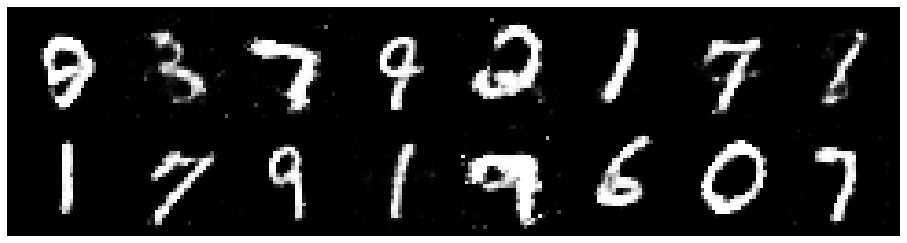

Epoch: [175/200], Batch Num: [300/600]
Discriminator Loss: 1.2227, Generator Loss: 1.2244
D(x): 0.5588, D(G(z)): 0.3685


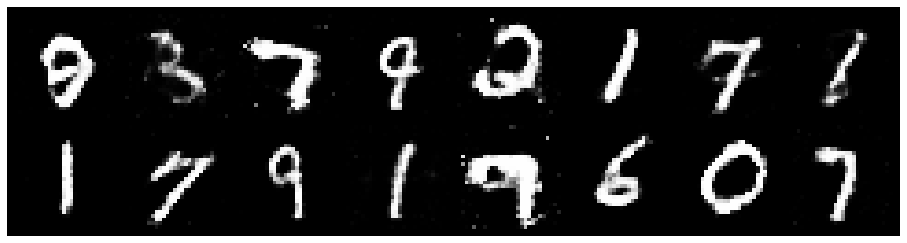

Epoch: [175/200], Batch Num: [400/600]
Discriminator Loss: 1.1716, Generator Loss: 1.1239
D(x): 0.6023, D(G(z)): 0.3902


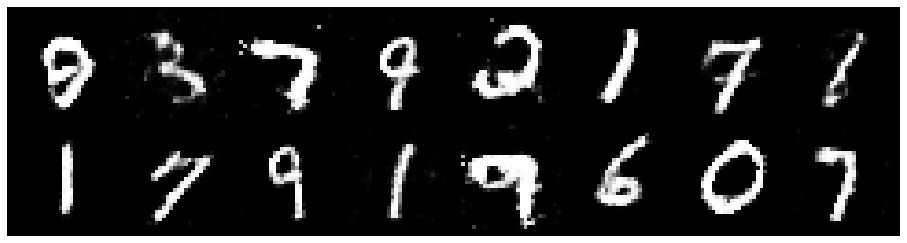

Epoch: [175/200], Batch Num: [500/600]
Discriminator Loss: 1.2543, Generator Loss: 1.1201
D(x): 0.5886, D(G(z)): 0.4237


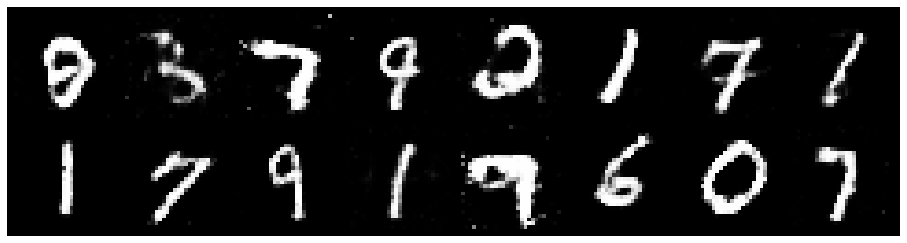

Epoch: [176/200], Batch Num: [0/600]
Discriminator Loss: 1.0167, Generator Loss: 1.1342
D(x): 0.6142, D(G(z)): 0.3398


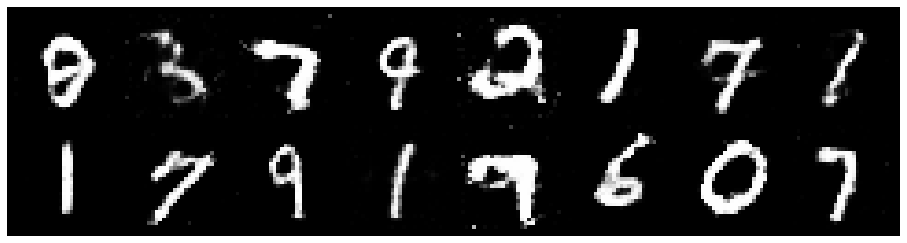

Epoch: [176/200], Batch Num: [100/600]
Discriminator Loss: 1.0323, Generator Loss: 1.0684
D(x): 0.6201, D(G(z)): 0.3444


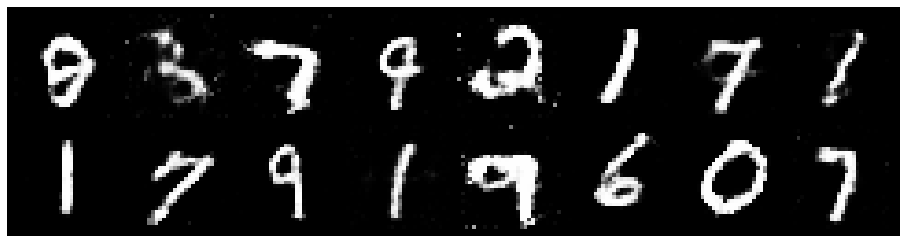

Epoch: [176/200], Batch Num: [200/600]
Discriminator Loss: 1.1235, Generator Loss: 1.1292
D(x): 0.6190, D(G(z)): 0.3845


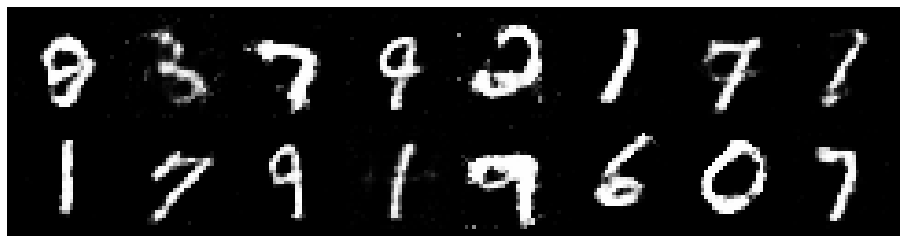

Epoch: [176/200], Batch Num: [300/600]
Discriminator Loss: 1.0866, Generator Loss: 1.2493
D(x): 0.6215, D(G(z)): 0.3511


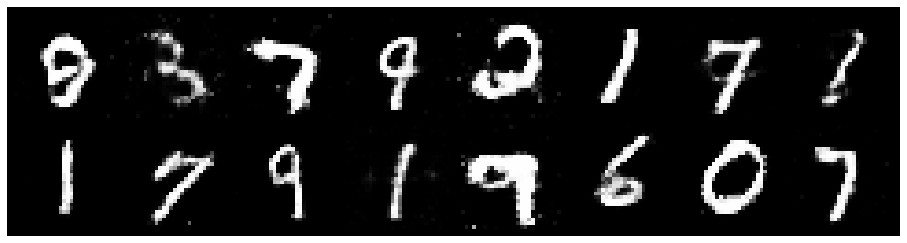

Epoch: [176/200], Batch Num: [400/600]
Discriminator Loss: 1.1585, Generator Loss: 1.0577
D(x): 0.6062, D(G(z)): 0.3999


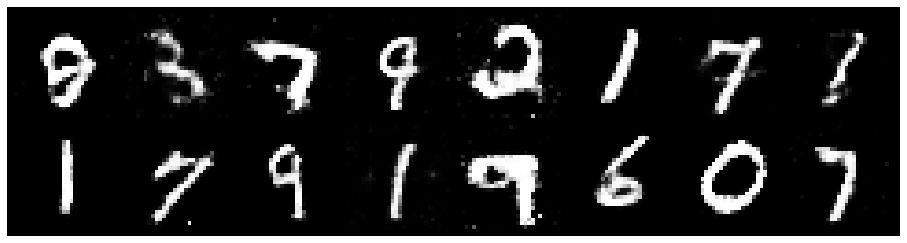

Epoch: [176/200], Batch Num: [500/600]
Discriminator Loss: 1.2389, Generator Loss: 1.0185
D(x): 0.5558, D(G(z)): 0.3678


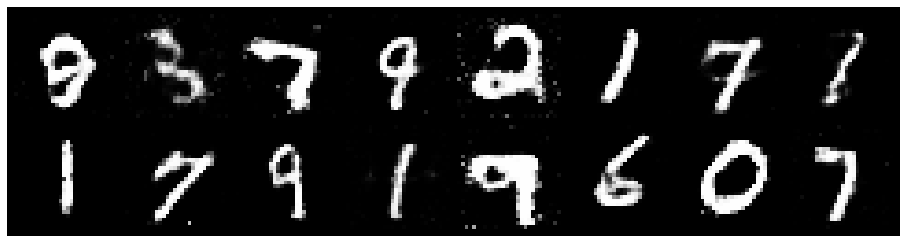

Epoch: [177/200], Batch Num: [0/600]
Discriminator Loss: 1.2145, Generator Loss: 1.1727
D(x): 0.6112, D(G(z)): 0.4333


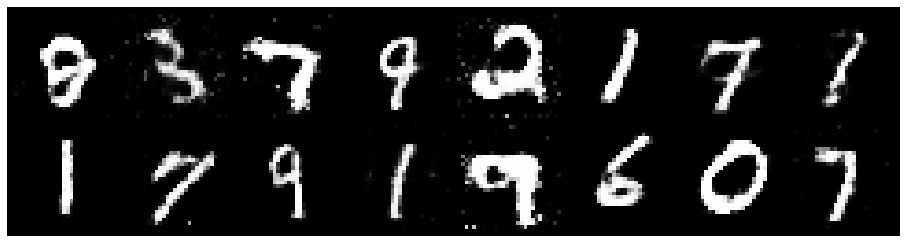

Epoch: [177/200], Batch Num: [100/600]
Discriminator Loss: 1.1545, Generator Loss: 1.0131
D(x): 0.6179, D(G(z)): 0.3966


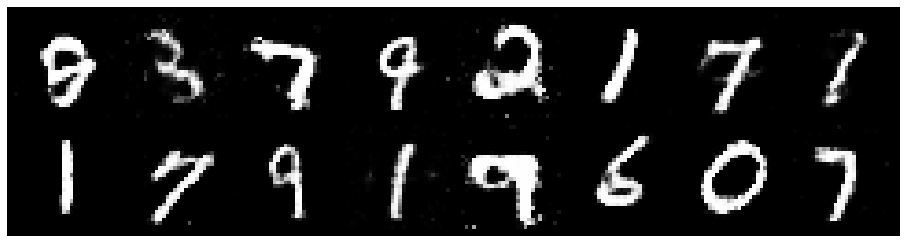

Epoch: [177/200], Batch Num: [200/600]
Discriminator Loss: 1.1129, Generator Loss: 0.9753
D(x): 0.6647, D(G(z)): 0.4201


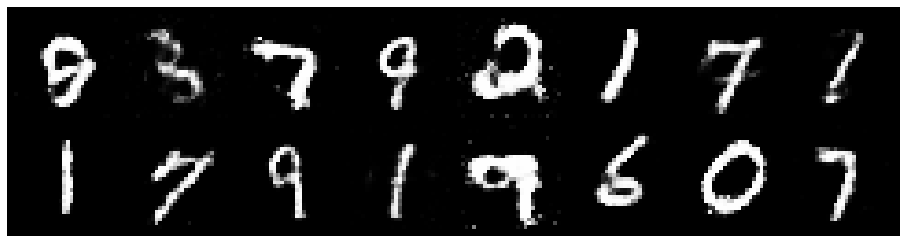

Epoch: [177/200], Batch Num: [300/600]
Discriminator Loss: 1.1893, Generator Loss: 0.9159
D(x): 0.6025, D(G(z)): 0.4199


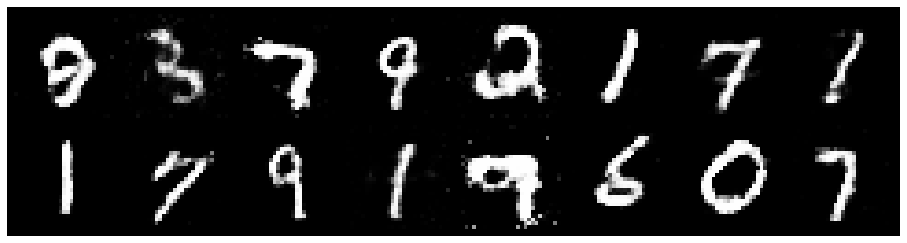

Epoch: [177/200], Batch Num: [400/600]
Discriminator Loss: 1.0134, Generator Loss: 1.1387
D(x): 0.6491, D(G(z)): 0.3552


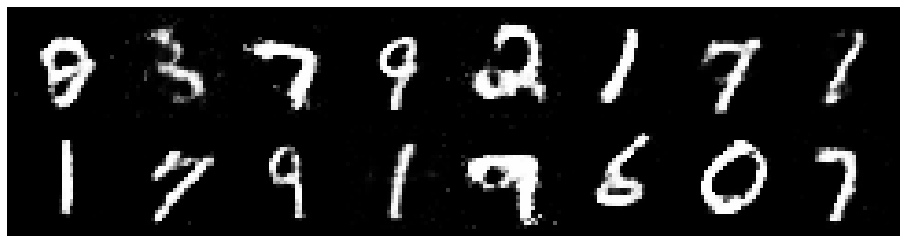

Epoch: [177/200], Batch Num: [500/600]
Discriminator Loss: 1.0923, Generator Loss: 1.1449
D(x): 0.6476, D(G(z)): 0.3962


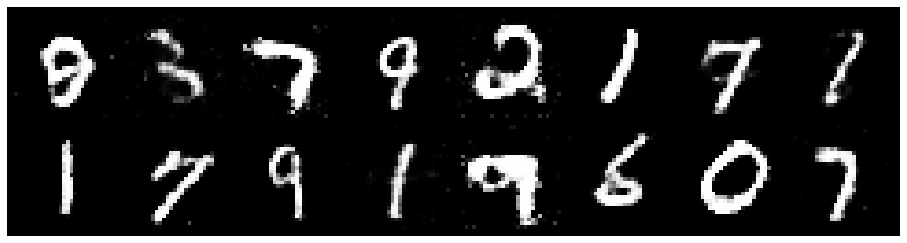

Epoch: [178/200], Batch Num: [0/600]
Discriminator Loss: 1.1718, Generator Loss: 1.0285
D(x): 0.6255, D(G(z)): 0.4266


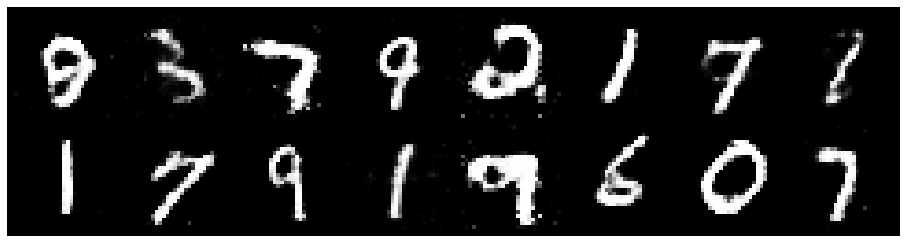

Epoch: [178/200], Batch Num: [100/600]
Discriminator Loss: 1.0825, Generator Loss: 1.0107
D(x): 0.6274, D(G(z)): 0.3743


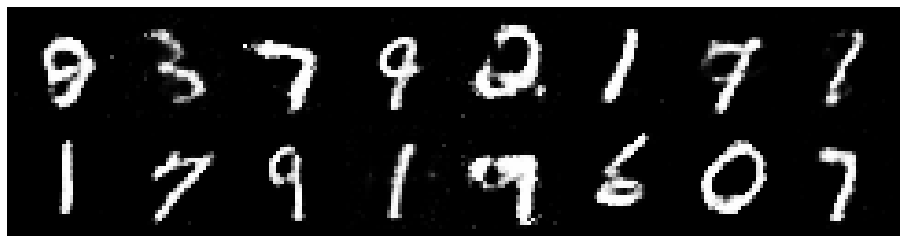

Epoch: [178/200], Batch Num: [200/600]
Discriminator Loss: 1.1666, Generator Loss: 1.0739
D(x): 0.5962, D(G(z)): 0.4043


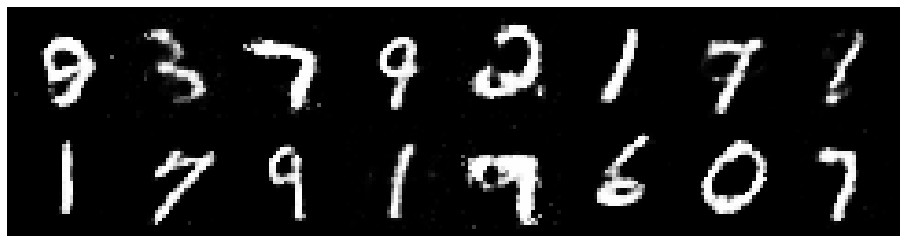

Epoch: [178/200], Batch Num: [300/600]
Discriminator Loss: 1.0463, Generator Loss: 1.0679
D(x): 0.6181, D(G(z)): 0.3521


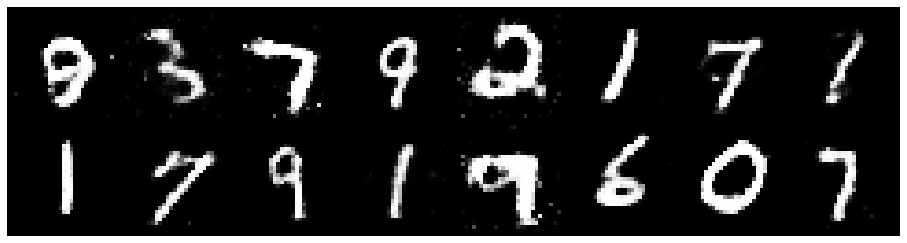

Epoch: [178/200], Batch Num: [400/600]
Discriminator Loss: 1.1568, Generator Loss: 1.0679
D(x): 0.6316, D(G(z)): 0.4149


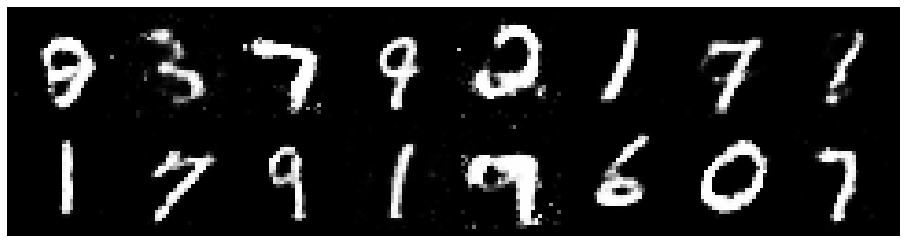

Epoch: [178/200], Batch Num: [500/600]
Discriminator Loss: 1.1501, Generator Loss: 0.9903
D(x): 0.6431, D(G(z)): 0.4315


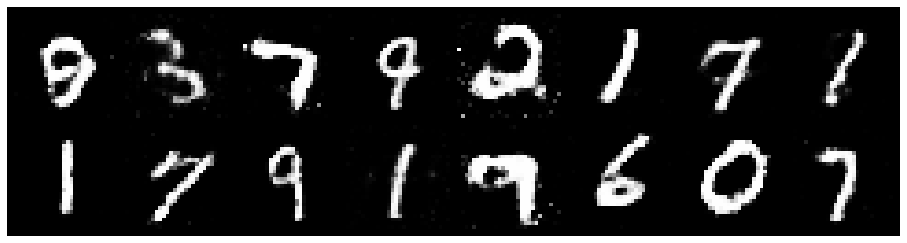

Epoch: [179/200], Batch Num: [0/600]
Discriminator Loss: 1.2883, Generator Loss: 1.1104
D(x): 0.6039, D(G(z)): 0.4204


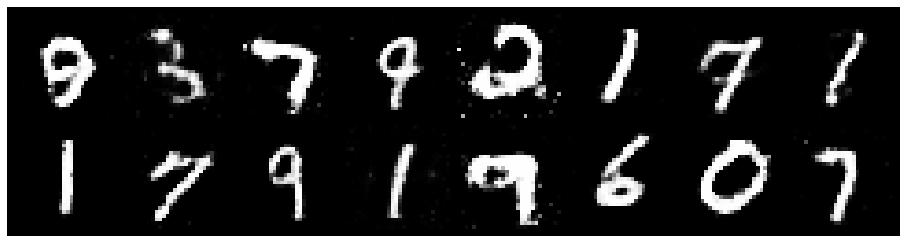

Epoch: [179/200], Batch Num: [100/600]
Discriminator Loss: 1.1785, Generator Loss: 1.1025
D(x): 0.5971, D(G(z)): 0.3918


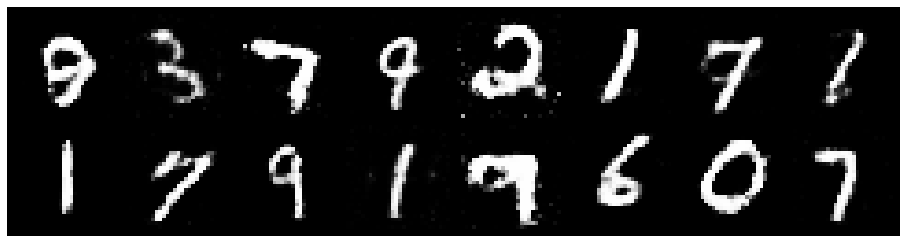

Epoch: [179/200], Batch Num: [200/600]
Discriminator Loss: 1.0875, Generator Loss: 1.1282
D(x): 0.6226, D(G(z)): 0.3748


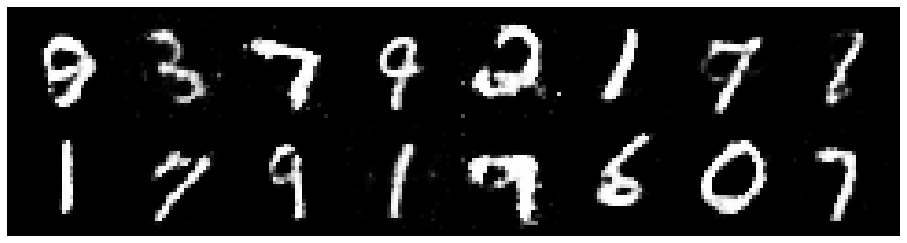

Epoch: [179/200], Batch Num: [300/600]
Discriminator Loss: 1.1117, Generator Loss: 1.1245
D(x): 0.6486, D(G(z)): 0.4098


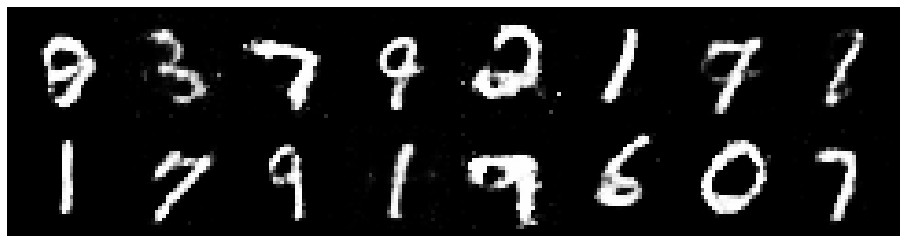

Epoch: [179/200], Batch Num: [400/600]
Discriminator Loss: 1.1551, Generator Loss: 1.0717
D(x): 0.5974, D(G(z)): 0.3794


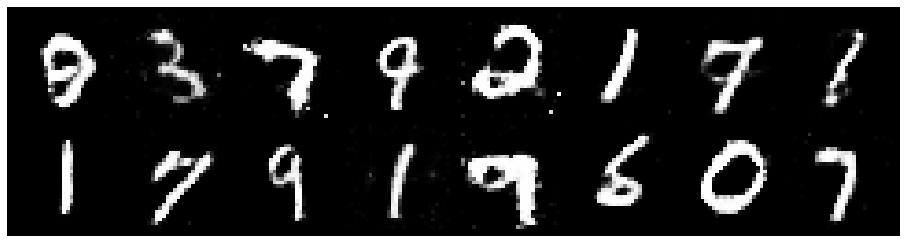

Epoch: [179/200], Batch Num: [500/600]
Discriminator Loss: 1.0658, Generator Loss: 1.1446
D(x): 0.5884, D(G(z)): 0.3358


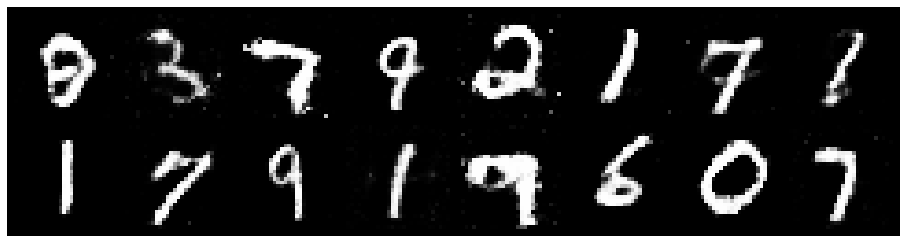

Epoch: [180/200], Batch Num: [0/600]
Discriminator Loss: 1.1523, Generator Loss: 0.9982
D(x): 0.6254, D(G(z)): 0.4119


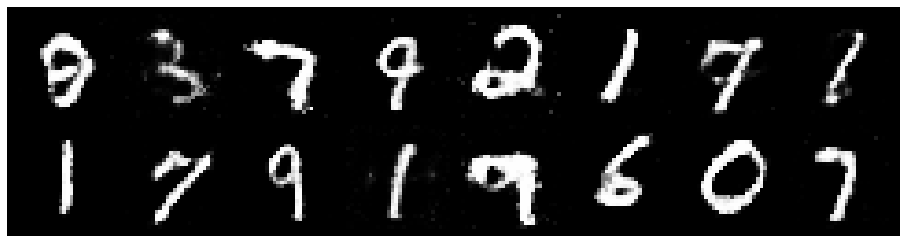

Epoch: [180/200], Batch Num: [100/600]
Discriminator Loss: 1.1029, Generator Loss: 1.0770
D(x): 0.6486, D(G(z)): 0.4061


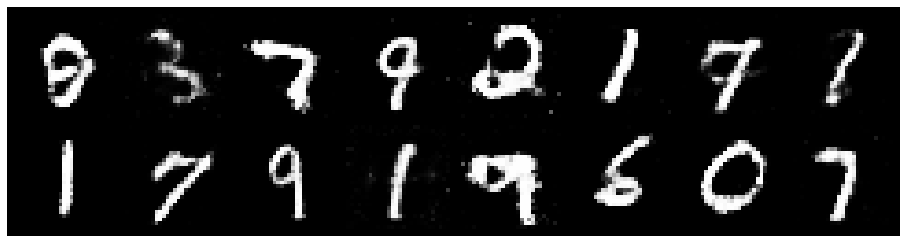

Epoch: [180/200], Batch Num: [200/600]
Discriminator Loss: 1.0104, Generator Loss: 1.2732
D(x): 0.6172, D(G(z)): 0.3394


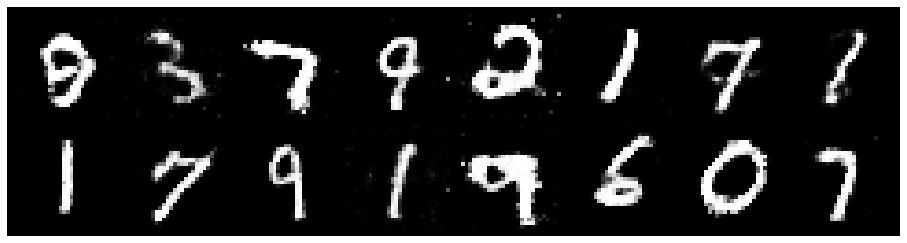

Epoch: [180/200], Batch Num: [300/600]
Discriminator Loss: 1.1696, Generator Loss: 1.1061
D(x): 0.5897, D(G(z)): 0.3753


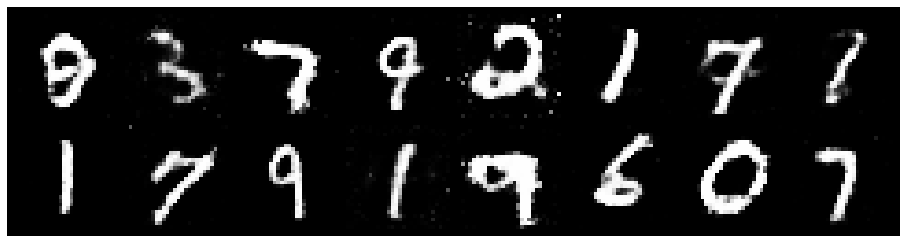

Epoch: [180/200], Batch Num: [400/600]
Discriminator Loss: 1.1888, Generator Loss: 1.0568
D(x): 0.6007, D(G(z)): 0.4025


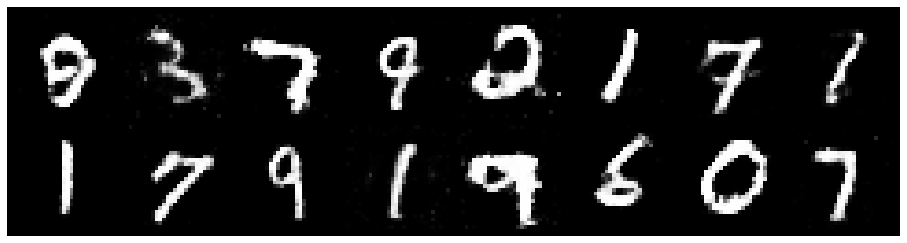

Epoch: [180/200], Batch Num: [500/600]
Discriminator Loss: 1.0920, Generator Loss: 1.3080
D(x): 0.6061, D(G(z)): 0.3360


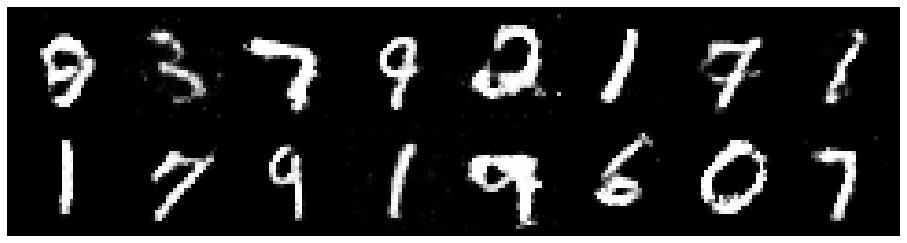

Epoch: [181/200], Batch Num: [0/600]
Discriminator Loss: 1.0923, Generator Loss: 1.0597
D(x): 0.5791, D(G(z)): 0.3321


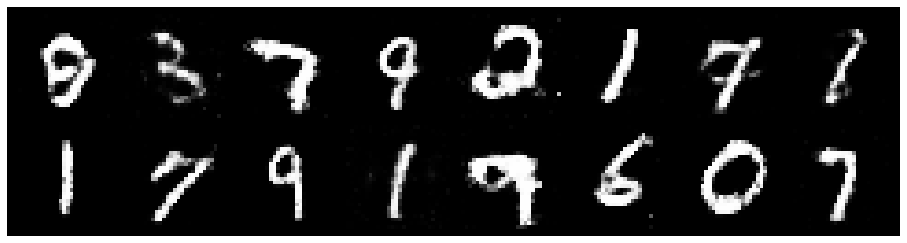

Epoch: [181/200], Batch Num: [100/600]
Discriminator Loss: 1.1298, Generator Loss: 1.1310
D(x): 0.5824, D(G(z)): 0.3589


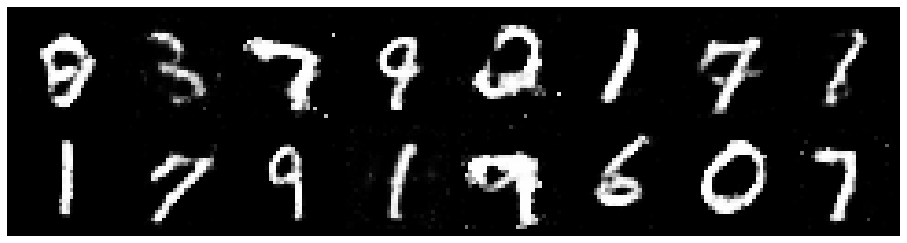

Epoch: [181/200], Batch Num: [200/600]
Discriminator Loss: 1.0390, Generator Loss: 1.1772
D(x): 0.6620, D(G(z)): 0.3796


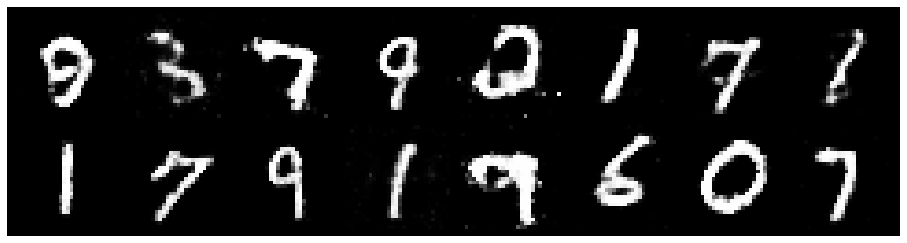

Epoch: [181/200], Batch Num: [300/600]
Discriminator Loss: 1.0594, Generator Loss: 1.0923
D(x): 0.6362, D(G(z)): 0.3816


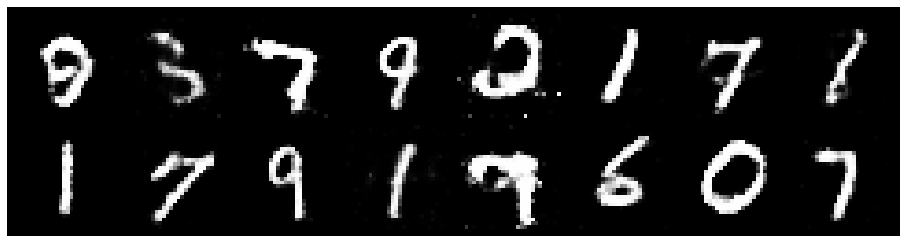

Epoch: [181/200], Batch Num: [400/600]
Discriminator Loss: 1.1997, Generator Loss: 1.1377
D(x): 0.5735, D(G(z)): 0.3710


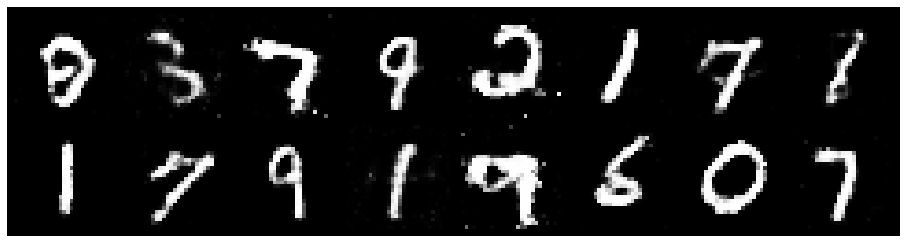

Epoch: [181/200], Batch Num: [500/600]
Discriminator Loss: 1.0462, Generator Loss: 1.0101
D(x): 0.6252, D(G(z)): 0.3505


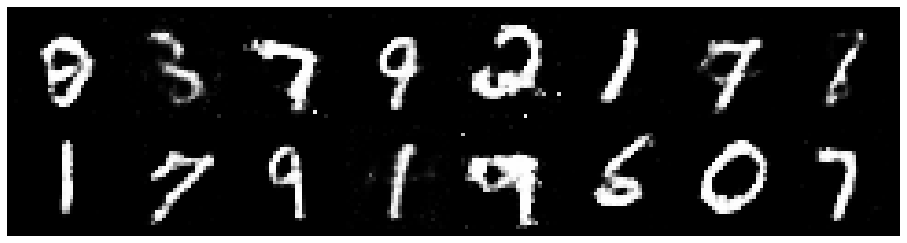

Epoch: [182/200], Batch Num: [0/600]
Discriminator Loss: 1.0788, Generator Loss: 1.0481
D(x): 0.5983, D(G(z)): 0.3364


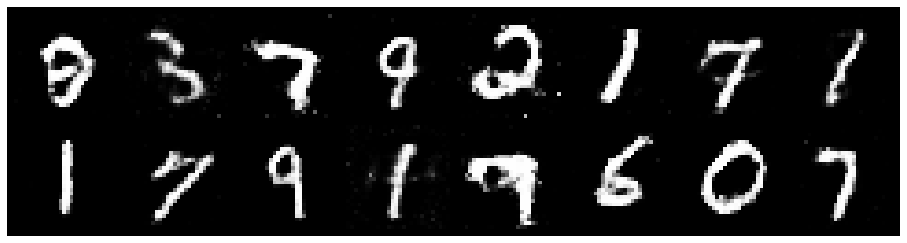

Epoch: [182/200], Batch Num: [100/600]
Discriminator Loss: 1.1885, Generator Loss: 1.1230
D(x): 0.5855, D(G(z)): 0.3906


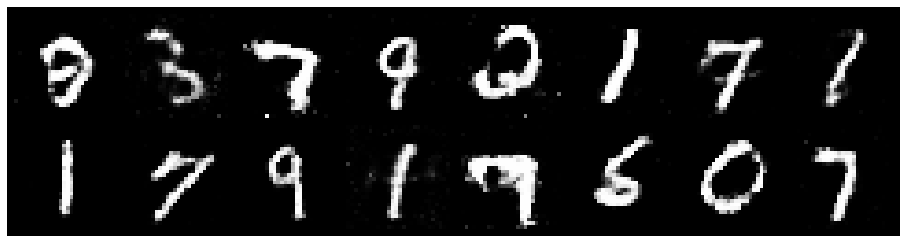

Epoch: [182/200], Batch Num: [200/600]
Discriminator Loss: 1.1369, Generator Loss: 1.0525
D(x): 0.5879, D(G(z)): 0.3653


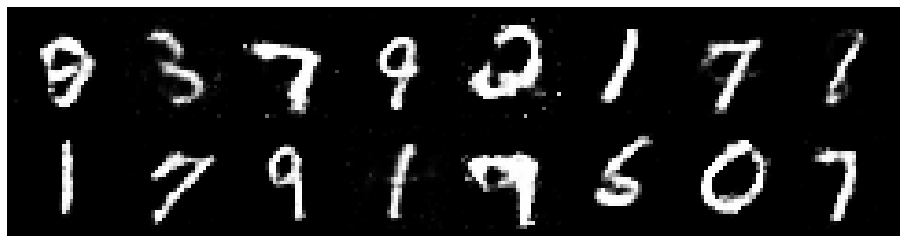

Epoch: [182/200], Batch Num: [300/600]
Discriminator Loss: 1.2610, Generator Loss: 1.0557
D(x): 0.5964, D(G(z)): 0.4172


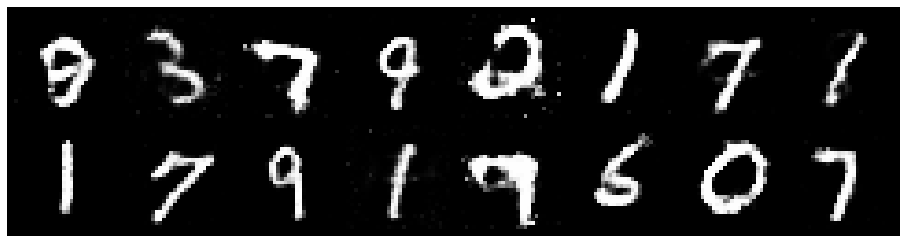

Epoch: [182/200], Batch Num: [400/600]
Discriminator Loss: 1.0460, Generator Loss: 1.2689
D(x): 0.6596, D(G(z)): 0.3832


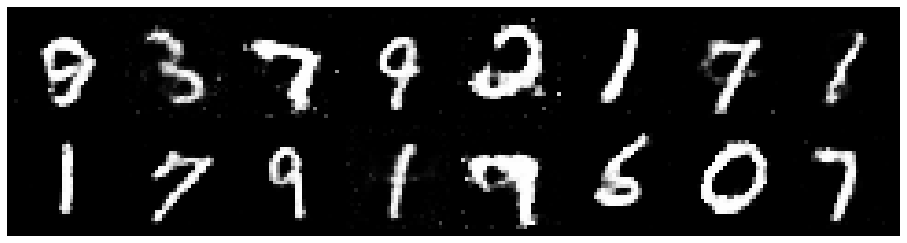

Epoch: [182/200], Batch Num: [500/600]
Discriminator Loss: 1.0925, Generator Loss: 1.2315
D(x): 0.5840, D(G(z)): 0.3334


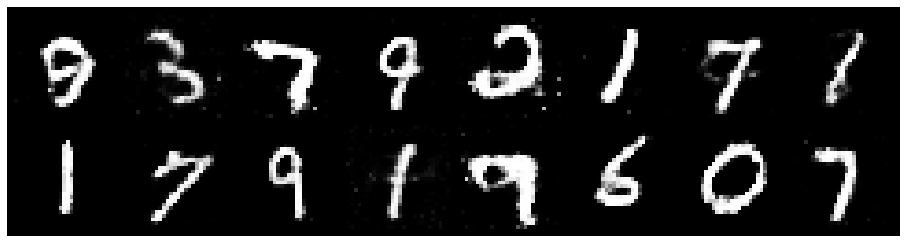

Epoch: [183/200], Batch Num: [0/600]
Discriminator Loss: 1.0352, Generator Loss: 1.2482
D(x): 0.6134, D(G(z)): 0.3312


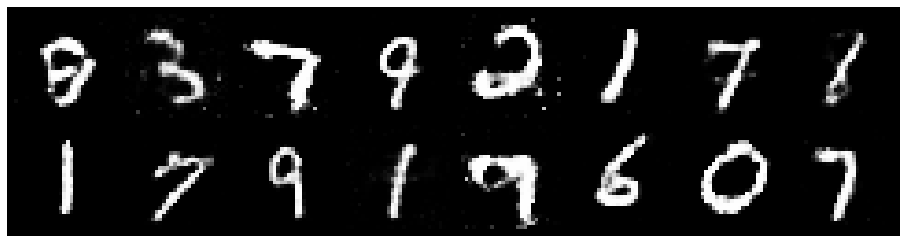

Epoch: [183/200], Batch Num: [100/600]
Discriminator Loss: 1.0659, Generator Loss: 1.0776
D(x): 0.6158, D(G(z)): 0.3523


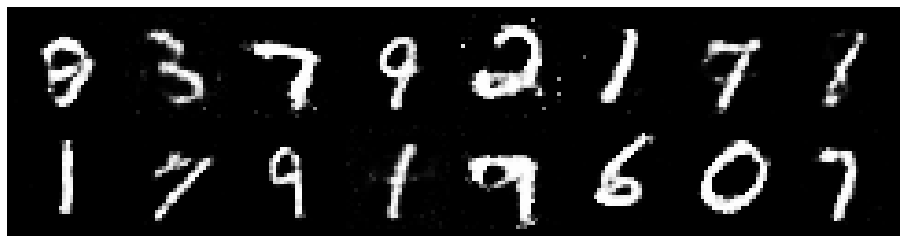

Epoch: [183/200], Batch Num: [200/600]
Discriminator Loss: 1.2075, Generator Loss: 1.2934
D(x): 0.5207, D(G(z)): 0.3251


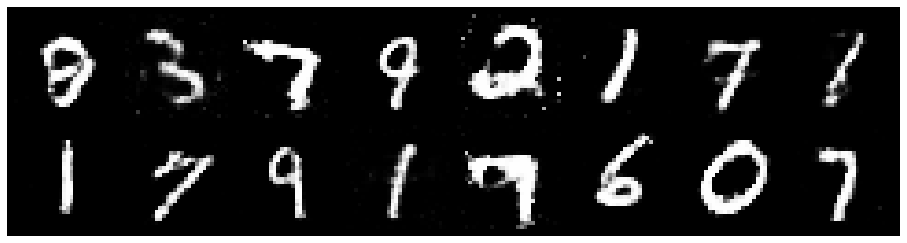

Epoch: [183/200], Batch Num: [300/600]
Discriminator Loss: 1.1731, Generator Loss: 1.1479
D(x): 0.6340, D(G(z)): 0.4254


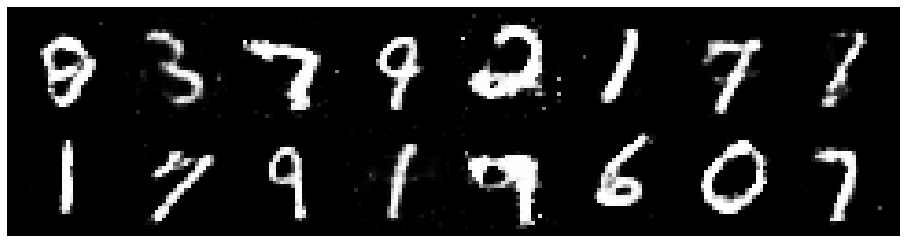

Epoch: [183/200], Batch Num: [400/600]
Discriminator Loss: 1.1766, Generator Loss: 0.9381
D(x): 0.5984, D(G(z)): 0.3984


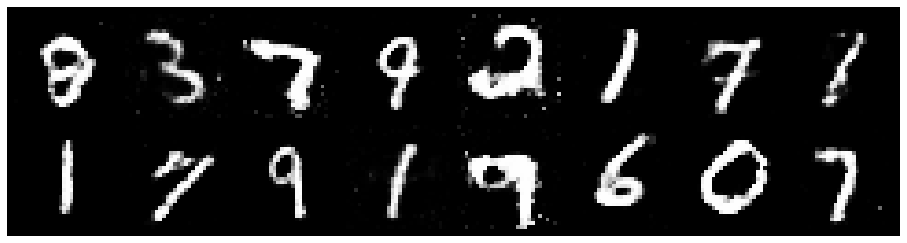

Epoch: [183/200], Batch Num: [500/600]
Discriminator Loss: 1.1619, Generator Loss: 1.0943
D(x): 0.5935, D(G(z)): 0.3883


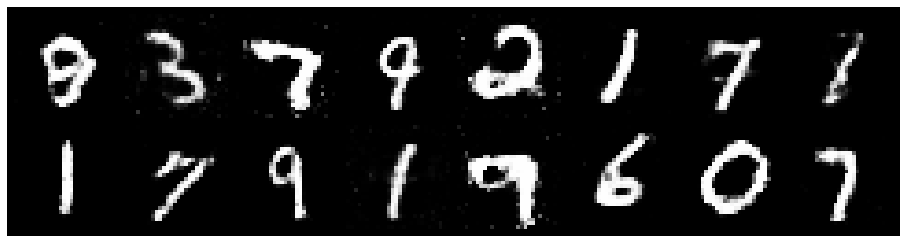

Epoch: [184/200], Batch Num: [0/600]
Discriminator Loss: 1.1157, Generator Loss: 1.1685
D(x): 0.6439, D(G(z)): 0.3873


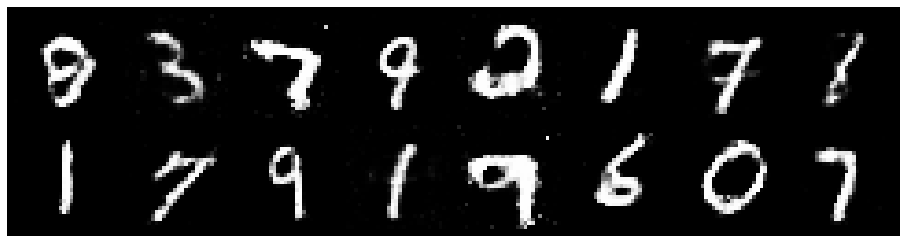

Epoch: [184/200], Batch Num: [100/600]
Discriminator Loss: 1.1447, Generator Loss: 1.0673
D(x): 0.6118, D(G(z)): 0.4065


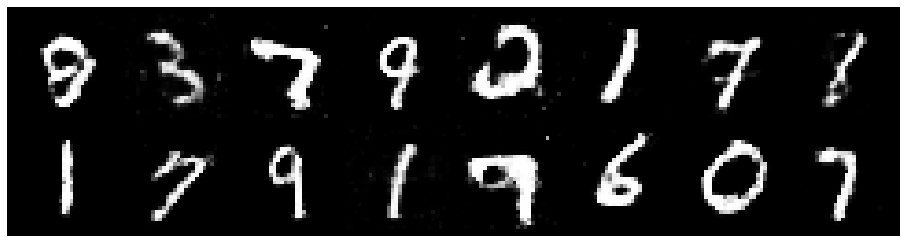

Epoch: [184/200], Batch Num: [200/600]
Discriminator Loss: 1.0729, Generator Loss: 1.1234
D(x): 0.6516, D(G(z)): 0.4130


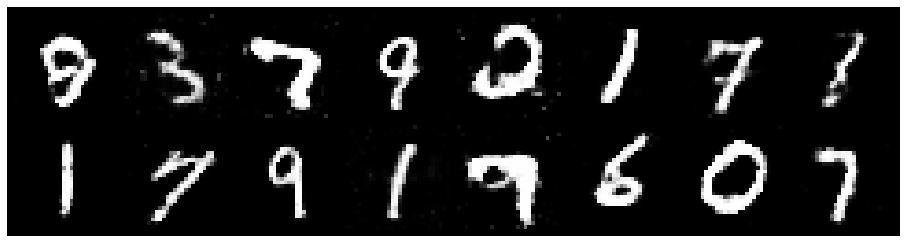

Epoch: [184/200], Batch Num: [300/600]
Discriminator Loss: 1.1533, Generator Loss: 1.2242
D(x): 0.5944, D(G(z)): 0.3780


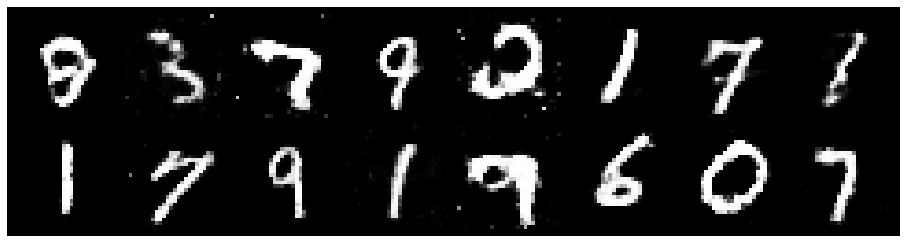

Epoch: [184/200], Batch Num: [400/600]
Discriminator Loss: 1.1723, Generator Loss: 1.0048
D(x): 0.6124, D(G(z)): 0.4063


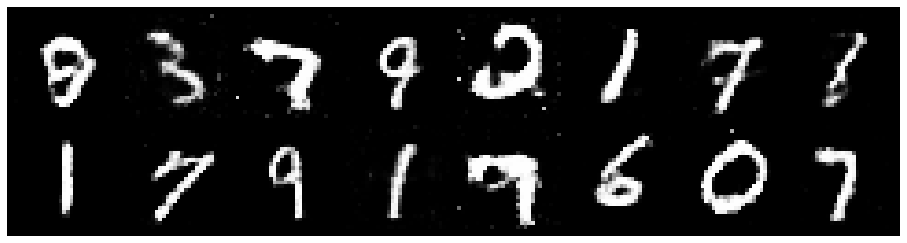

Epoch: [184/200], Batch Num: [500/600]
Discriminator Loss: 1.2315, Generator Loss: 1.1091
D(x): 0.6028, D(G(z)): 0.3989


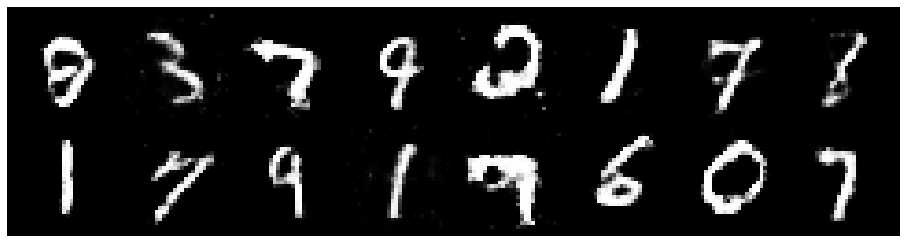

Epoch: [185/200], Batch Num: [0/600]
Discriminator Loss: 1.1884, Generator Loss: 1.0701
D(x): 0.5892, D(G(z)): 0.3777


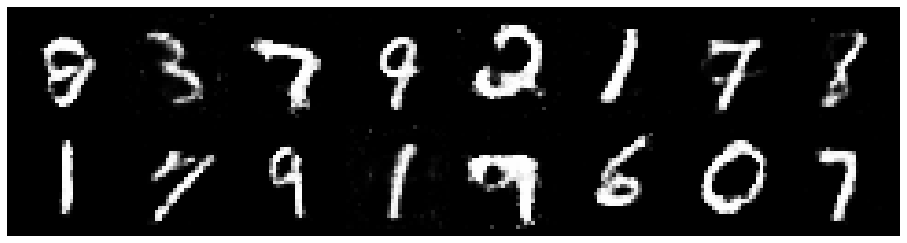

Epoch: [185/200], Batch Num: [100/600]
Discriminator Loss: 1.1958, Generator Loss: 1.0513
D(x): 0.6159, D(G(z)): 0.4232


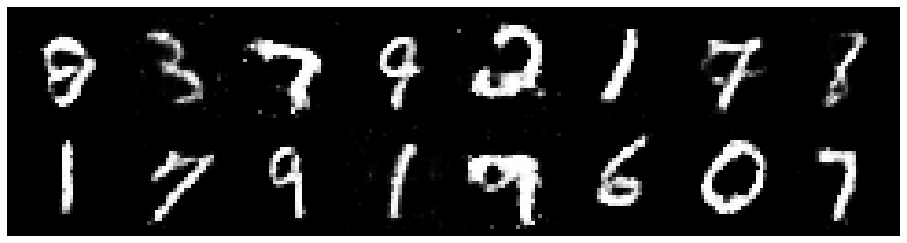

Epoch: [185/200], Batch Num: [200/600]
Discriminator Loss: 1.0577, Generator Loss: 1.1754
D(x): 0.6254, D(G(z)): 0.3629


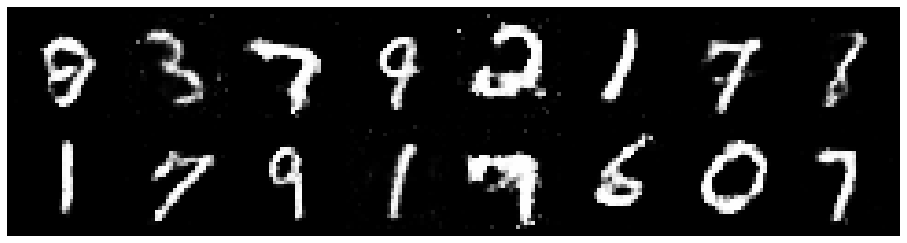

Epoch: [185/200], Batch Num: [300/600]
Discriminator Loss: 1.0416, Generator Loss: 1.0520
D(x): 0.6918, D(G(z)): 0.4014


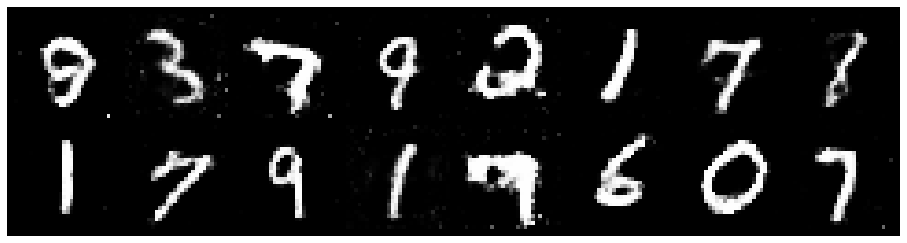

Epoch: [185/200], Batch Num: [400/600]
Discriminator Loss: 1.2363, Generator Loss: 1.0353
D(x): 0.6290, D(G(z)): 0.4352


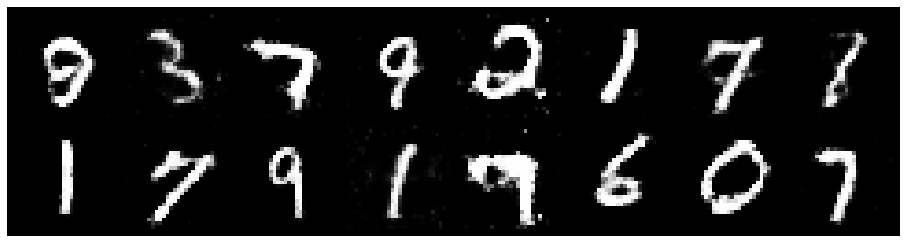

Epoch: [185/200], Batch Num: [500/600]
Discriminator Loss: 1.0695, Generator Loss: 1.0637
D(x): 0.6337, D(G(z)): 0.3668


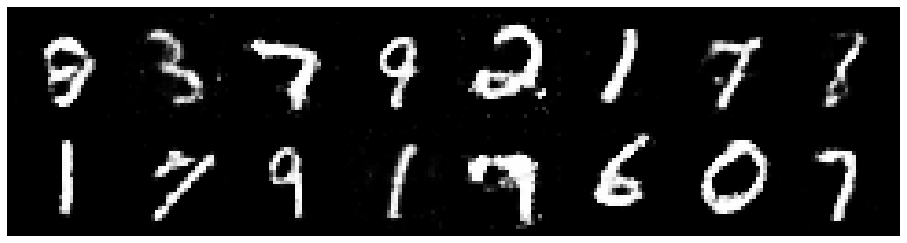

Epoch: [186/200], Batch Num: [0/600]
Discriminator Loss: 1.0070, Generator Loss: 1.1053
D(x): 0.6197, D(G(z)): 0.3422


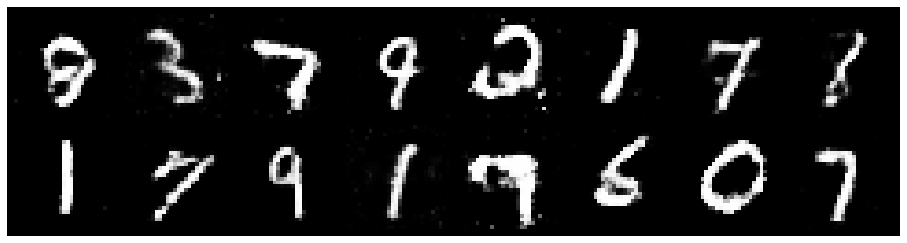

Epoch: [186/200], Batch Num: [100/600]
Discriminator Loss: 1.0824, Generator Loss: 1.1431
D(x): 0.6428, D(G(z)): 0.3881


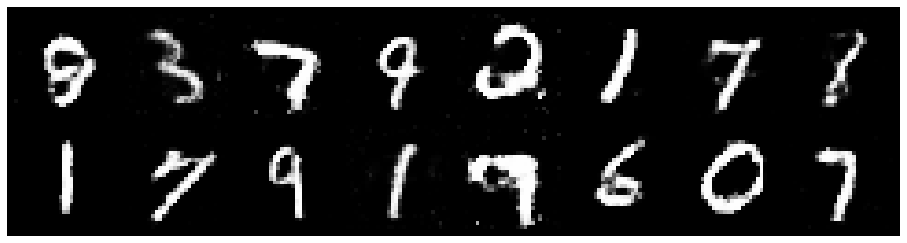

Epoch: [186/200], Batch Num: [200/600]
Discriminator Loss: 1.0282, Generator Loss: 1.1989
D(x): 0.6444, D(G(z)): 0.3601


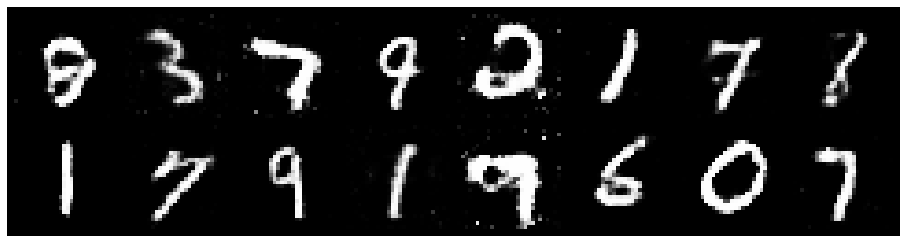

Epoch: [186/200], Batch Num: [300/600]
Discriminator Loss: 1.1729, Generator Loss: 0.9526
D(x): 0.6385, D(G(z)): 0.4509


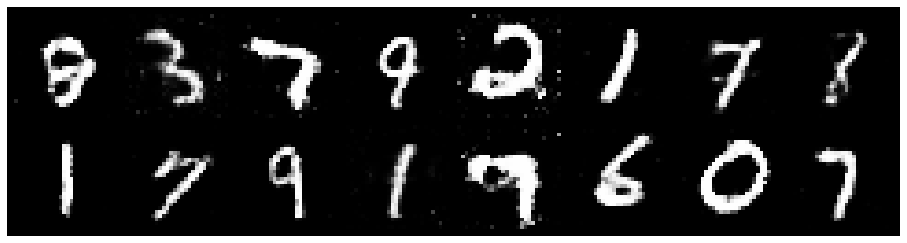

Epoch: [186/200], Batch Num: [400/600]
Discriminator Loss: 1.1499, Generator Loss: 1.1087
D(x): 0.6174, D(G(z)): 0.4022


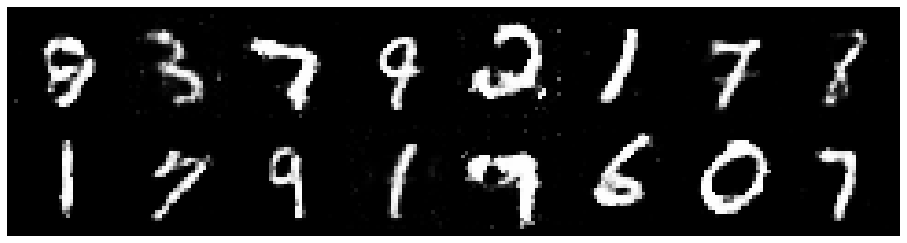

Epoch: [186/200], Batch Num: [500/600]
Discriminator Loss: 1.1776, Generator Loss: 1.1162
D(x): 0.5484, D(G(z)): 0.3442


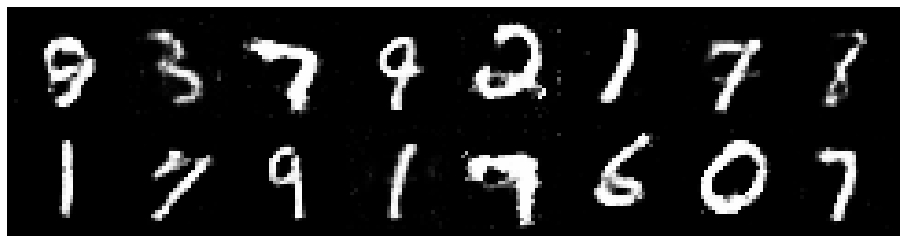

Epoch: [187/200], Batch Num: [0/600]
Discriminator Loss: 1.1241, Generator Loss: 1.1070
D(x): 0.6748, D(G(z)): 0.4373


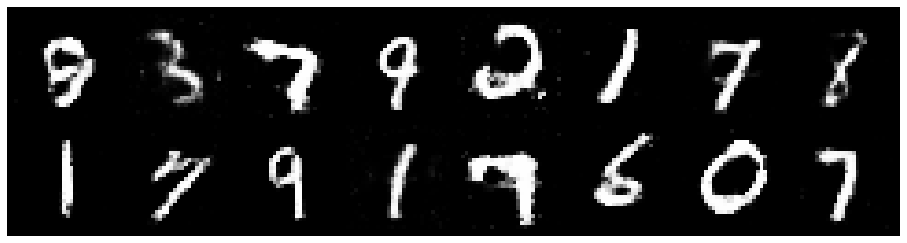

Epoch: [187/200], Batch Num: [100/600]
Discriminator Loss: 1.0479, Generator Loss: 1.0713
D(x): 0.6249, D(G(z)): 0.3769


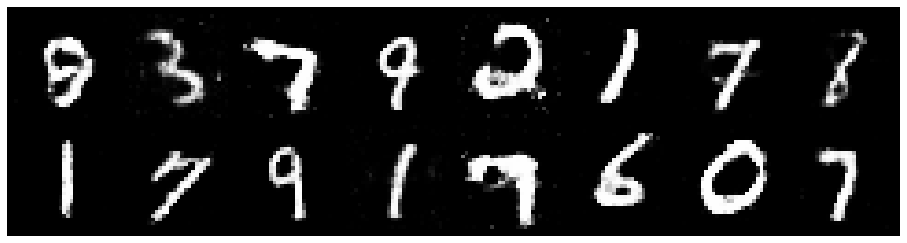

Epoch: [187/200], Batch Num: [200/600]
Discriminator Loss: 1.0304, Generator Loss: 1.1747
D(x): 0.6358, D(G(z)): 0.3600


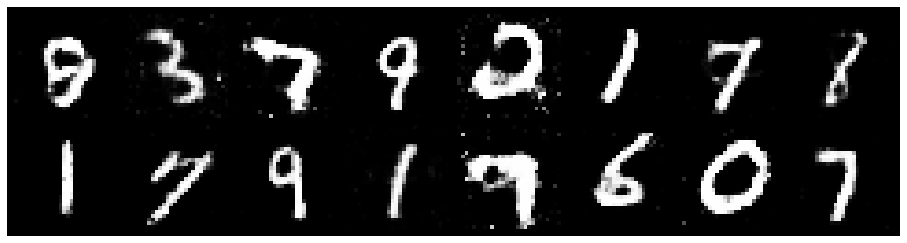

Epoch: [187/200], Batch Num: [300/600]
Discriminator Loss: 1.1003, Generator Loss: 1.1714
D(x): 0.6451, D(G(z)): 0.3922


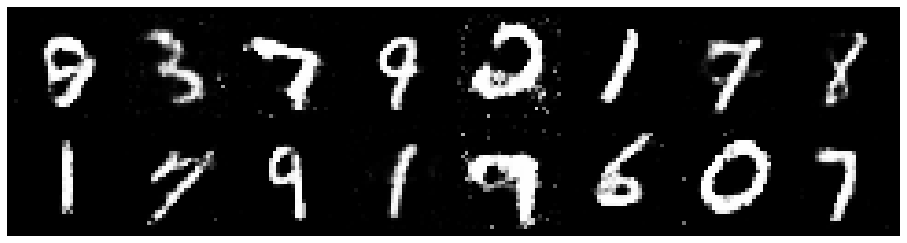

Epoch: [187/200], Batch Num: [400/600]
Discriminator Loss: 1.1520, Generator Loss: 1.2137
D(x): 0.6086, D(G(z)): 0.3800


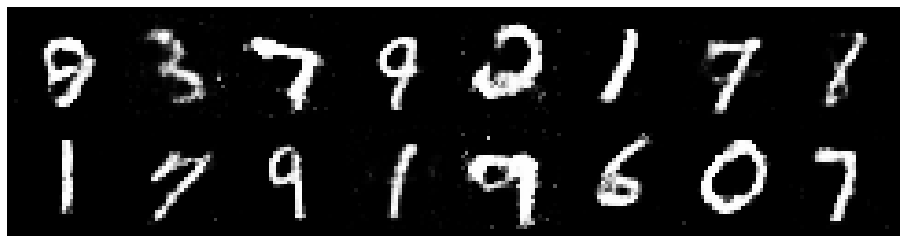

Epoch: [187/200], Batch Num: [500/600]
Discriminator Loss: 1.0846, Generator Loss: 1.2906
D(x): 0.6337, D(G(z)): 0.3473


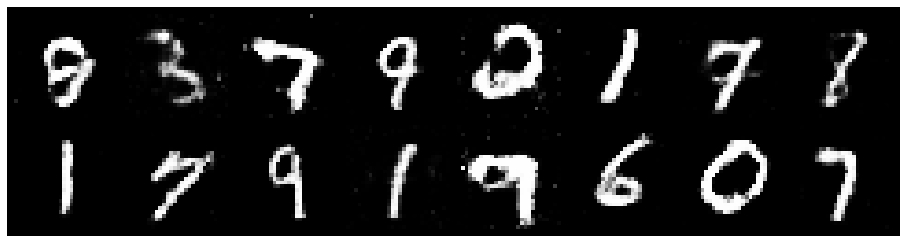

Epoch: [188/200], Batch Num: [0/600]
Discriminator Loss: 1.0387, Generator Loss: 1.2530
D(x): 0.6268, D(G(z)): 0.3288


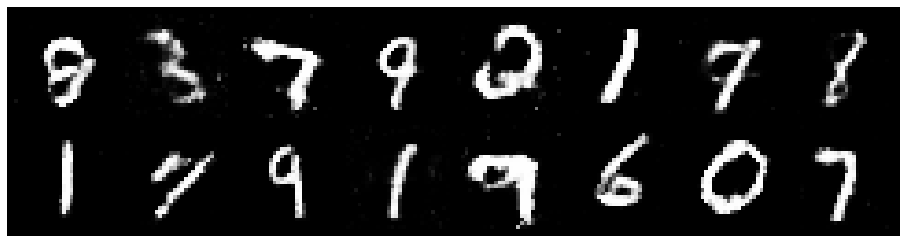

Epoch: [188/200], Batch Num: [100/600]
Discriminator Loss: 1.2991, Generator Loss: 1.1478
D(x): 0.5436, D(G(z)): 0.3730


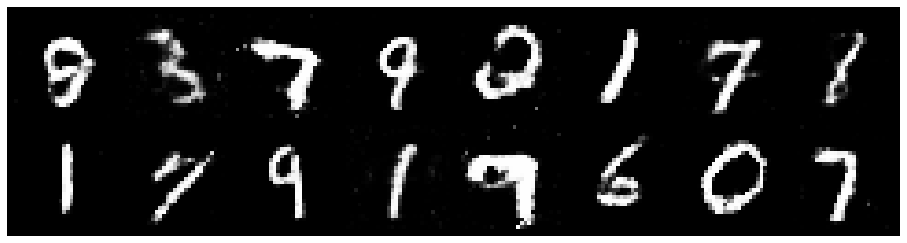

Epoch: [188/200], Batch Num: [200/600]
Discriminator Loss: 1.1567, Generator Loss: 1.1126
D(x): 0.6031, D(G(z)): 0.3959


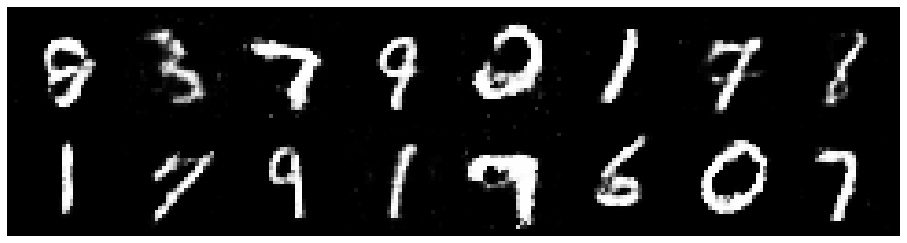

Epoch: [188/200], Batch Num: [300/600]
Discriminator Loss: 1.0706, Generator Loss: 1.0617
D(x): 0.6165, D(G(z)): 0.3656


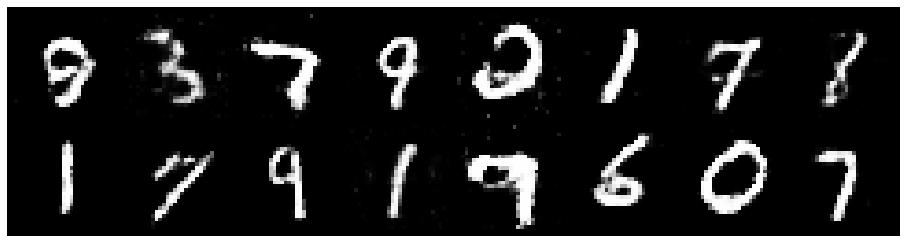

Epoch: [188/200], Batch Num: [400/600]
Discriminator Loss: 1.0989, Generator Loss: 1.2012
D(x): 0.5935, D(G(z)): 0.3616


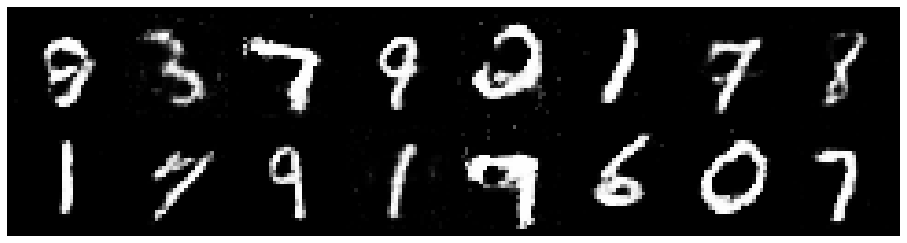

Epoch: [188/200], Batch Num: [500/600]
Discriminator Loss: 1.2158, Generator Loss: 1.1344
D(x): 0.5479, D(G(z)): 0.3617


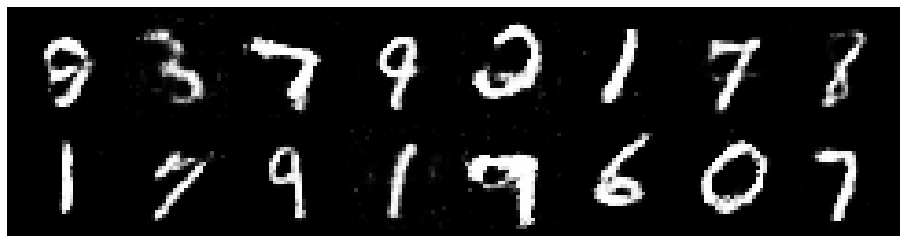

Epoch: [189/200], Batch Num: [0/600]
Discriminator Loss: 1.0883, Generator Loss: 1.0976
D(x): 0.6352, D(G(z)): 0.3763


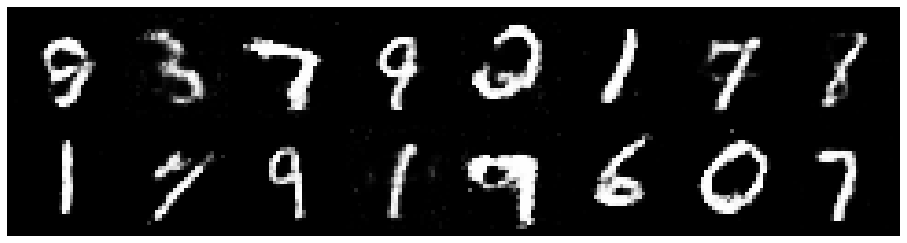

Epoch: [189/200], Batch Num: [100/600]
Discriminator Loss: 0.9910, Generator Loss: 1.0143
D(x): 0.6582, D(G(z)): 0.3716


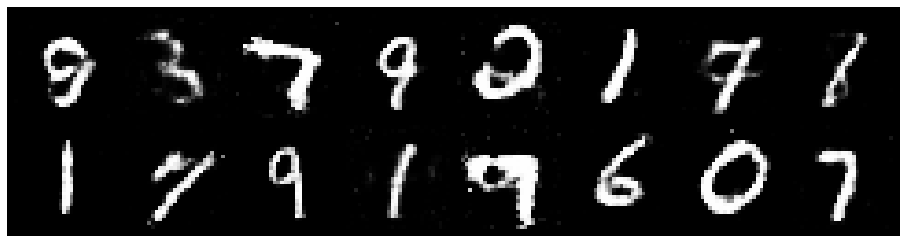

Epoch: [189/200], Batch Num: [200/600]
Discriminator Loss: 1.1242, Generator Loss: 1.1390
D(x): 0.5821, D(G(z)): 0.3479


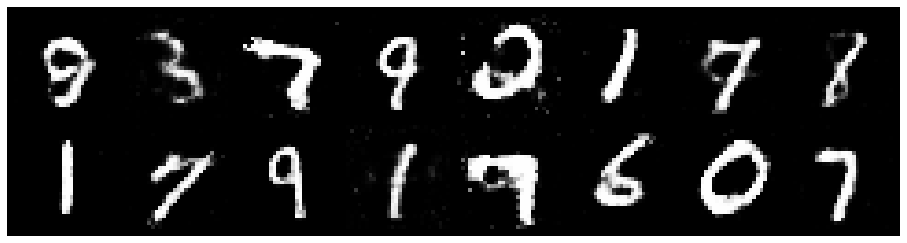

Epoch: [189/200], Batch Num: [300/600]
Discriminator Loss: 1.1883, Generator Loss: 1.0211
D(x): 0.6348, D(G(z)): 0.4084


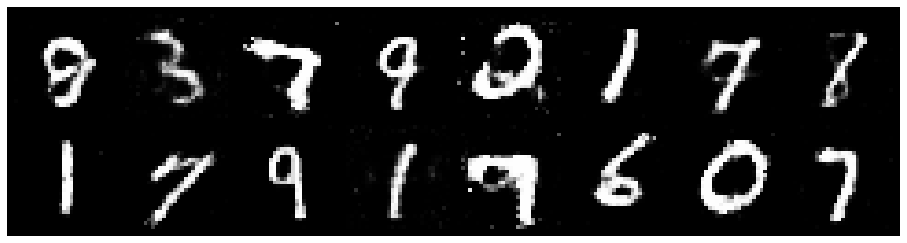

Epoch: [189/200], Batch Num: [400/600]
Discriminator Loss: 1.1540, Generator Loss: 1.2090
D(x): 0.5924, D(G(z)): 0.3707


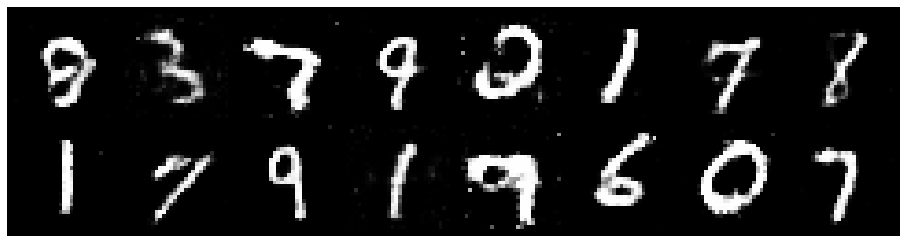

Epoch: [189/200], Batch Num: [500/600]
Discriminator Loss: 1.0429, Generator Loss: 1.0940
D(x): 0.6259, D(G(z)): 0.3586


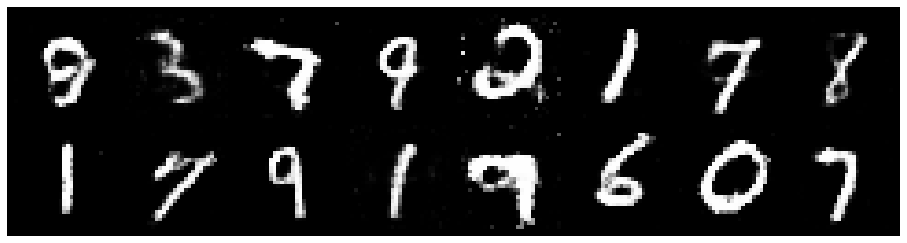

Epoch: [190/200], Batch Num: [0/600]
Discriminator Loss: 1.0391, Generator Loss: 1.2242
D(x): 0.6593, D(G(z)): 0.3942


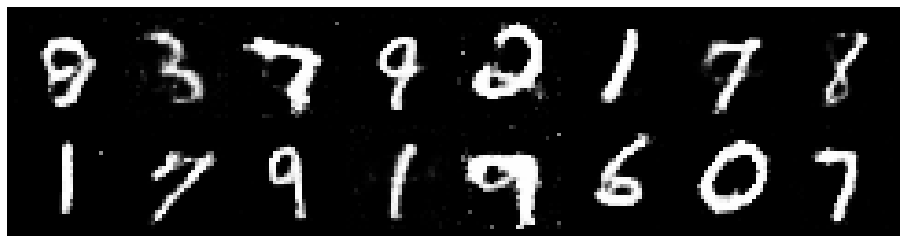

Epoch: [190/200], Batch Num: [100/600]
Discriminator Loss: 1.0817, Generator Loss: 1.0931
D(x): 0.6347, D(G(z)): 0.3810


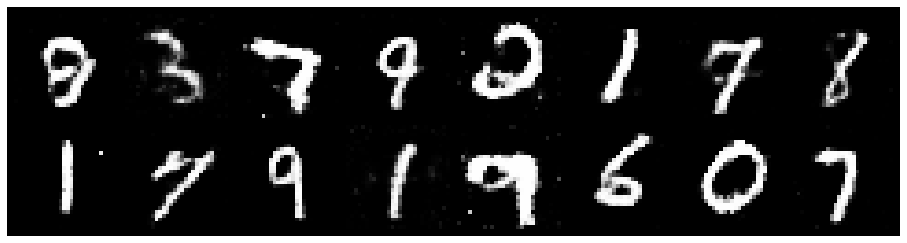

Epoch: [190/200], Batch Num: [200/600]
Discriminator Loss: 1.0220, Generator Loss: 1.2478
D(x): 0.6494, D(G(z)): 0.3644


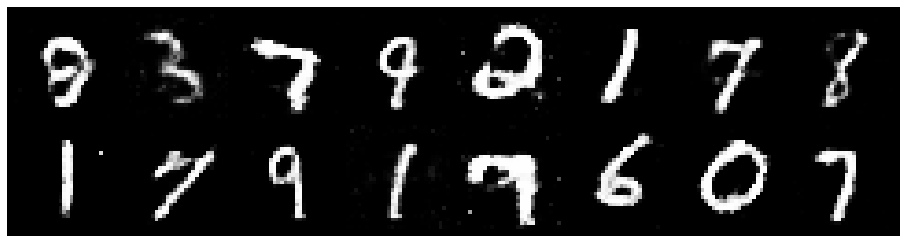

Epoch: [190/200], Batch Num: [300/600]
Discriminator Loss: 1.2413, Generator Loss: 1.0998
D(x): 0.5495, D(G(z)): 0.4035


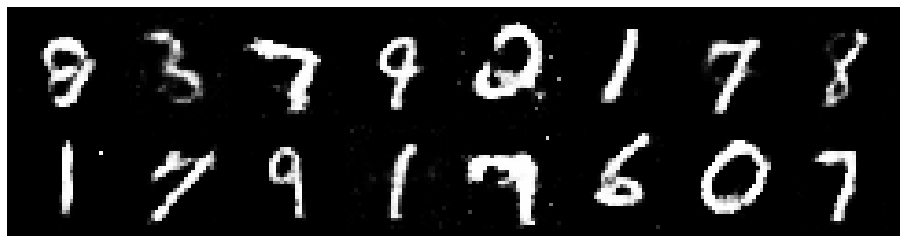

Epoch: [190/200], Batch Num: [400/600]
Discriminator Loss: 1.2194, Generator Loss: 1.2266
D(x): 0.5895, D(G(z)): 0.3867


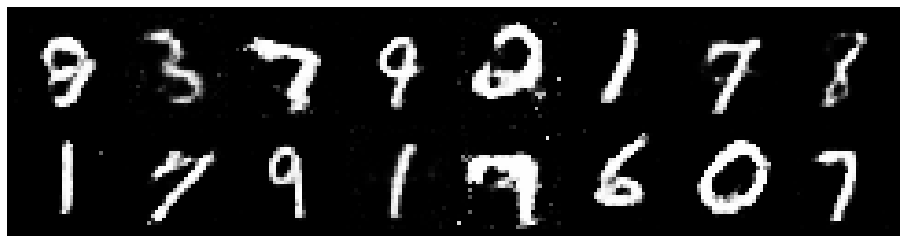

Epoch: [190/200], Batch Num: [500/600]
Discriminator Loss: 1.1497, Generator Loss: 1.1360
D(x): 0.5909, D(G(z)): 0.3758


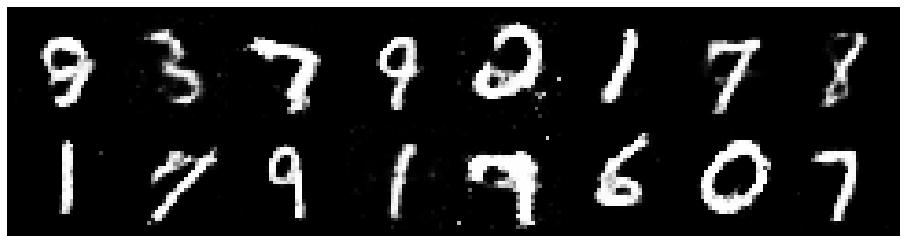

Epoch: [191/200], Batch Num: [0/600]
Discriminator Loss: 1.1819, Generator Loss: 1.0075
D(x): 0.5910, D(G(z)): 0.4009


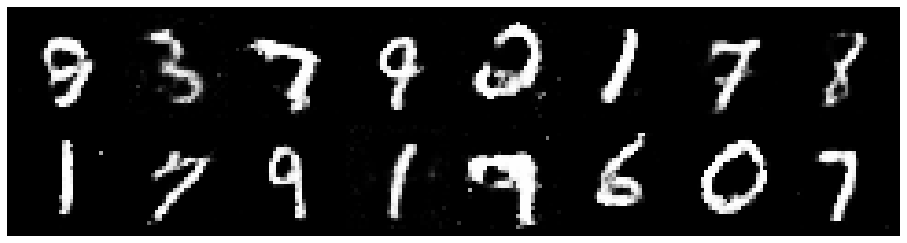

Epoch: [191/200], Batch Num: [100/600]
Discriminator Loss: 1.1385, Generator Loss: 1.0323
D(x): 0.6281, D(G(z)): 0.3903


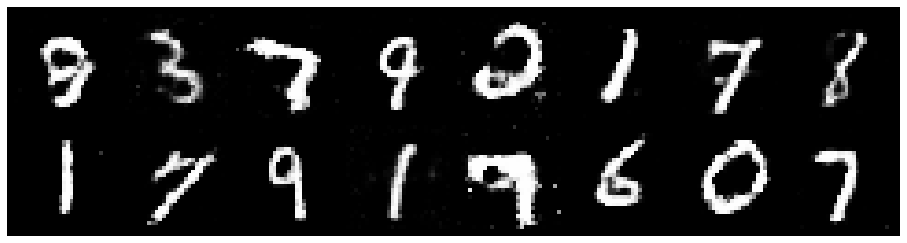

Epoch: [191/200], Batch Num: [200/600]
Discriminator Loss: 1.2324, Generator Loss: 1.2117
D(x): 0.5809, D(G(z)): 0.3874


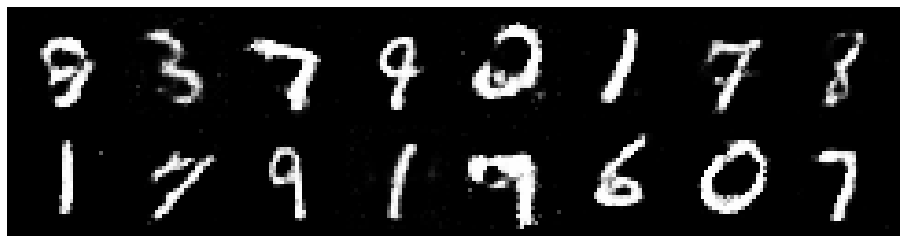

Epoch: [191/200], Batch Num: [300/600]
Discriminator Loss: 1.0340, Generator Loss: 1.1597
D(x): 0.6230, D(G(z)): 0.3671


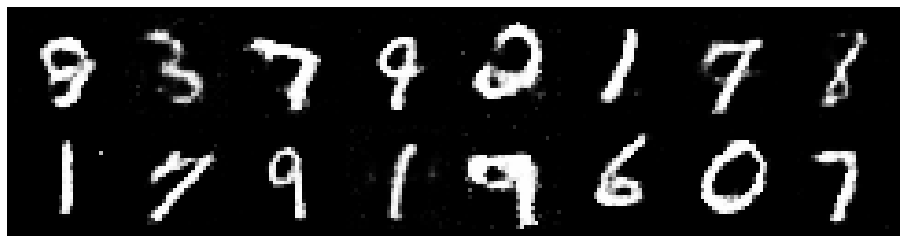

Epoch: [191/200], Batch Num: [400/600]
Discriminator Loss: 1.0932, Generator Loss: 1.0861
D(x): 0.6560, D(G(z)): 0.4057


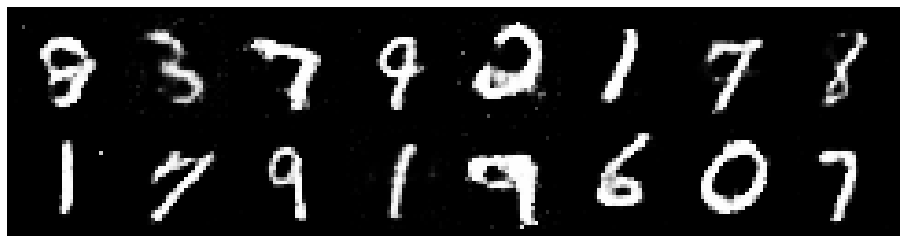

Epoch: [191/200], Batch Num: [500/600]
Discriminator Loss: 1.1260, Generator Loss: 0.9699
D(x): 0.6659, D(G(z)): 0.4446


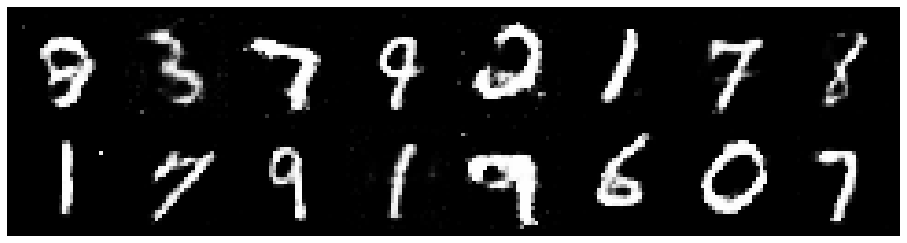

Epoch: [192/200], Batch Num: [0/600]
Discriminator Loss: 0.9982, Generator Loss: 1.0081
D(x): 0.6409, D(G(z)): 0.3353


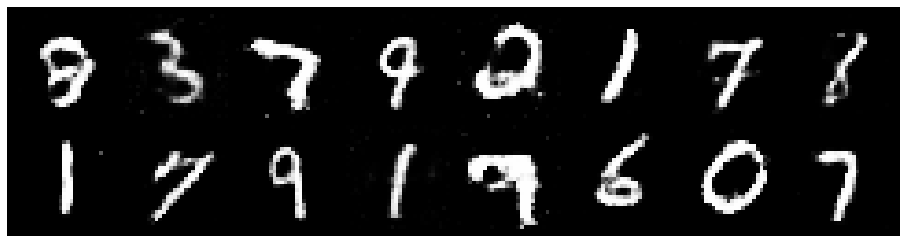

Epoch: [192/200], Batch Num: [100/600]
Discriminator Loss: 1.1489, Generator Loss: 1.0682
D(x): 0.6195, D(G(z)): 0.4107


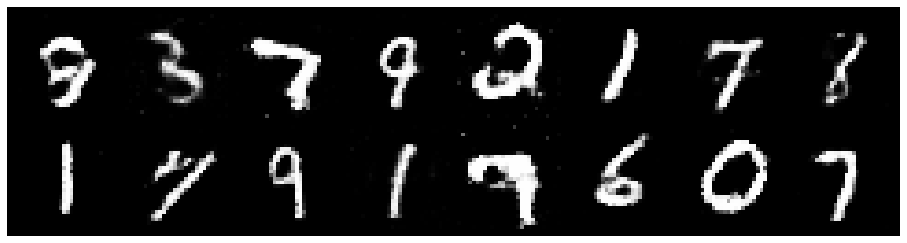

Epoch: [192/200], Batch Num: [200/600]
Discriminator Loss: 0.9923, Generator Loss: 1.0339
D(x): 0.6369, D(G(z)): 0.3447


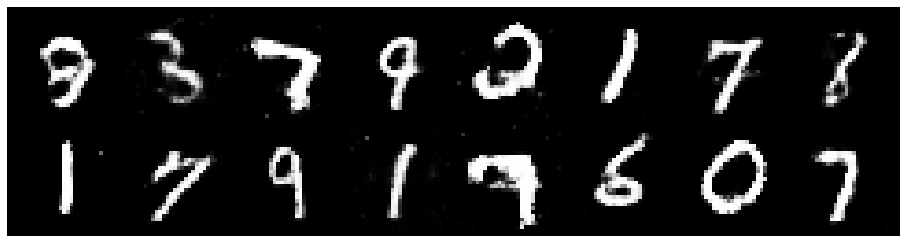

Epoch: [192/200], Batch Num: [300/600]
Discriminator Loss: 1.0565, Generator Loss: 1.0474
D(x): 0.6473, D(G(z)): 0.3703


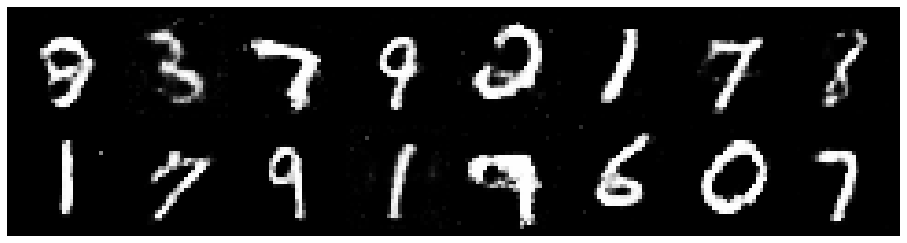

Epoch: [192/200], Batch Num: [400/600]
Discriminator Loss: 1.2028, Generator Loss: 1.0027
D(x): 0.5847, D(G(z)): 0.3800


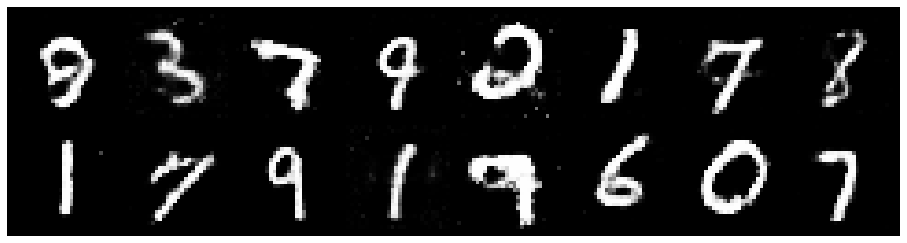

Epoch: [192/200], Batch Num: [500/600]
Discriminator Loss: 1.1918, Generator Loss: 1.1334
D(x): 0.5663, D(G(z)): 0.3704


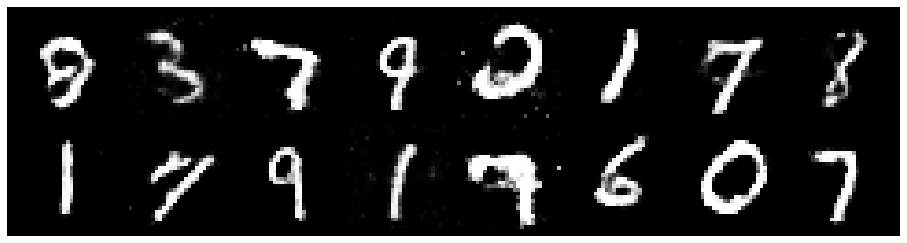

Epoch: [193/200], Batch Num: [0/600]
Discriminator Loss: 1.0623, Generator Loss: 1.2148
D(x): 0.6315, D(G(z)): 0.3729


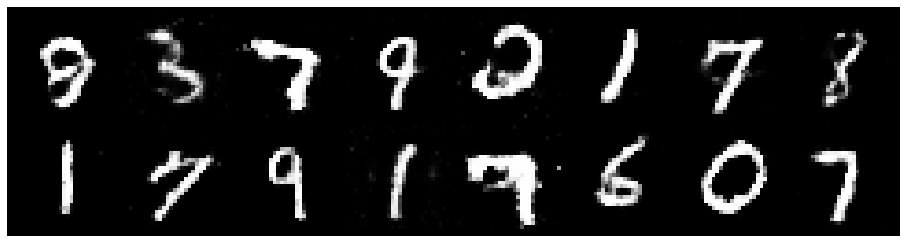

Epoch: [193/200], Batch Num: [100/600]
Discriminator Loss: 1.2252, Generator Loss: 1.2140
D(x): 0.5924, D(G(z)): 0.3956


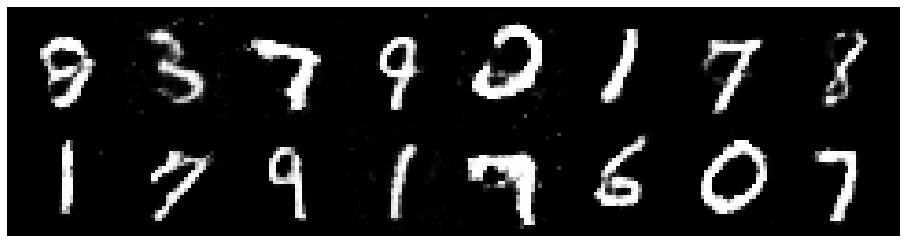

Epoch: [193/200], Batch Num: [200/600]
Discriminator Loss: 1.2038, Generator Loss: 1.0898
D(x): 0.6208, D(G(z)): 0.4343


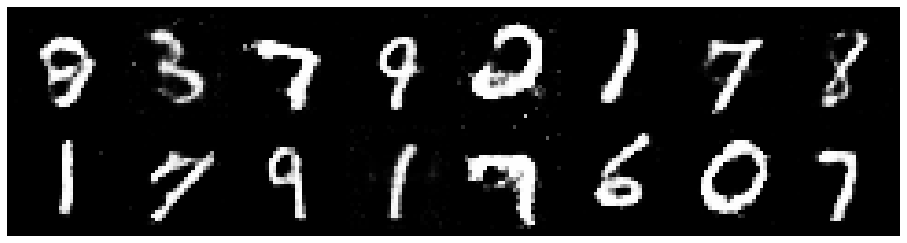

Epoch: [193/200], Batch Num: [300/600]
Discriminator Loss: 1.2122, Generator Loss: 1.0898
D(x): 0.6002, D(G(z)): 0.4113


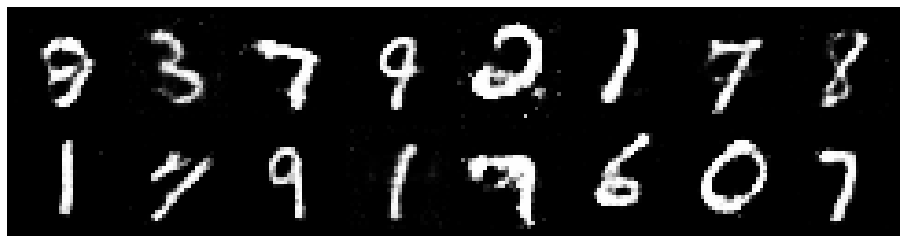

Epoch: [193/200], Batch Num: [400/600]
Discriminator Loss: 1.2038, Generator Loss: 1.1829
D(x): 0.6018, D(G(z)): 0.4204


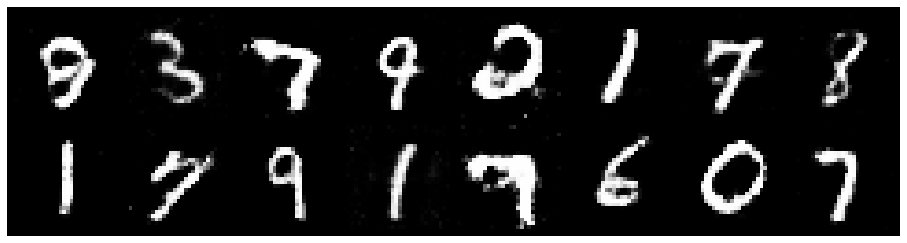

Epoch: [193/200], Batch Num: [500/600]
Discriminator Loss: 1.1426, Generator Loss: 0.9728
D(x): 0.5850, D(G(z)): 0.3894


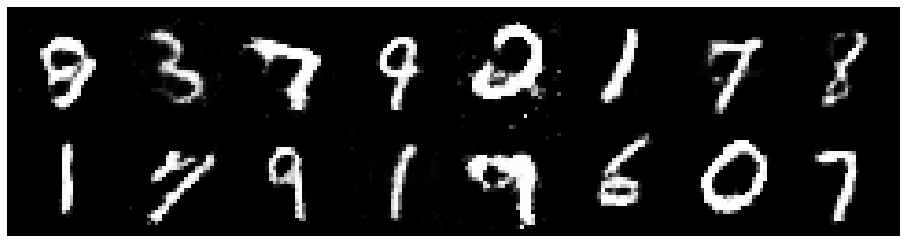

Epoch: [194/200], Batch Num: [0/600]
Discriminator Loss: 1.1935, Generator Loss: 0.9193
D(x): 0.6560, D(G(z)): 0.4398


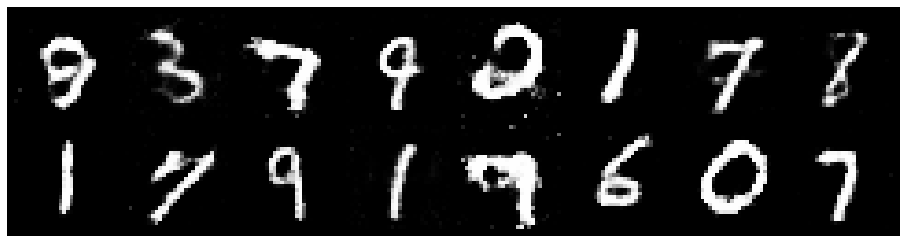

Epoch: [194/200], Batch Num: [100/600]
Discriminator Loss: 1.1217, Generator Loss: 1.1000
D(x): 0.6096, D(G(z)): 0.3865


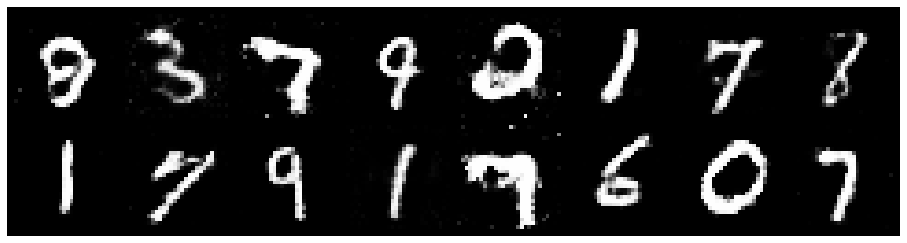

Epoch: [194/200], Batch Num: [200/600]
Discriminator Loss: 0.9670, Generator Loss: 1.2388
D(x): 0.6444, D(G(z)): 0.3257


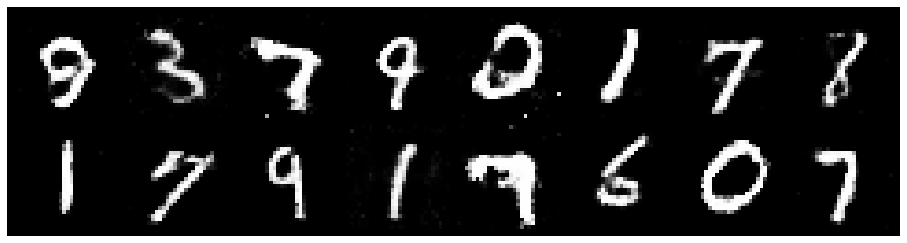

Epoch: [194/200], Batch Num: [300/600]
Discriminator Loss: 1.1614, Generator Loss: 1.1553
D(x): 0.6091, D(G(z)): 0.3897


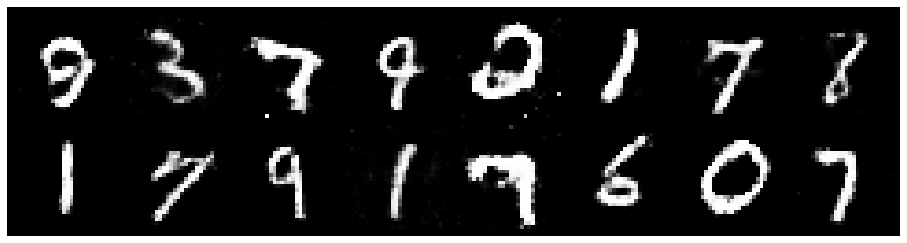

Epoch: [194/200], Batch Num: [400/600]
Discriminator Loss: 1.1675, Generator Loss: 1.0934
D(x): 0.5975, D(G(z)): 0.3998


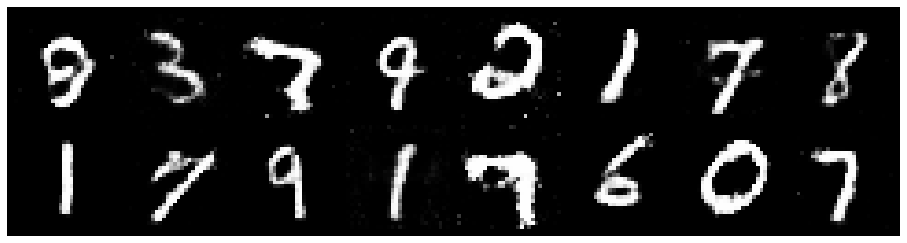

Epoch: [194/200], Batch Num: [500/600]
Discriminator Loss: 1.0869, Generator Loss: 1.1652
D(x): 0.6447, D(G(z)): 0.4017


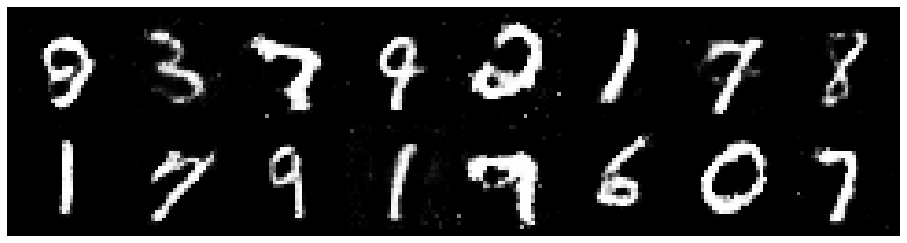

Epoch: [195/200], Batch Num: [0/600]
Discriminator Loss: 1.0882, Generator Loss: 1.1294
D(x): 0.5952, D(G(z)): 0.3623


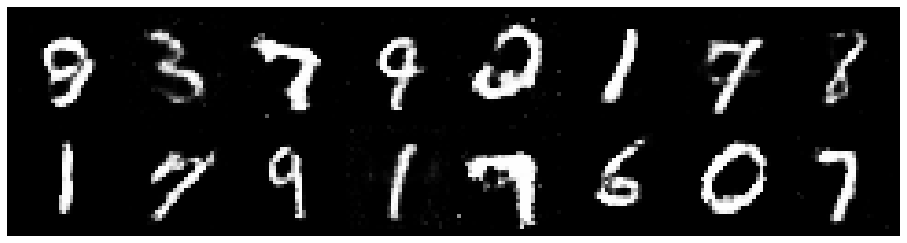

Epoch: [195/200], Batch Num: [100/600]
Discriminator Loss: 1.2166, Generator Loss: 0.8968
D(x): 0.5911, D(G(z)): 0.4146


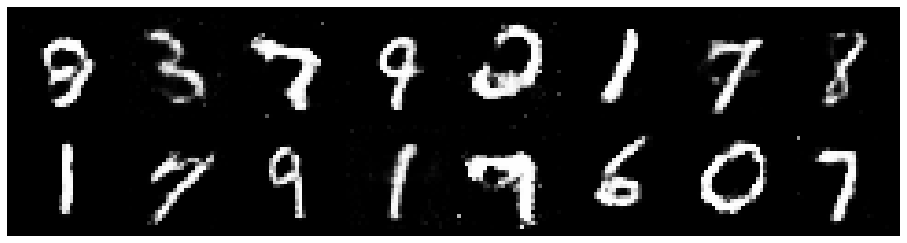

Epoch: [195/200], Batch Num: [200/600]
Discriminator Loss: 1.0842, Generator Loss: 1.0229
D(x): 0.6747, D(G(z)): 0.4076


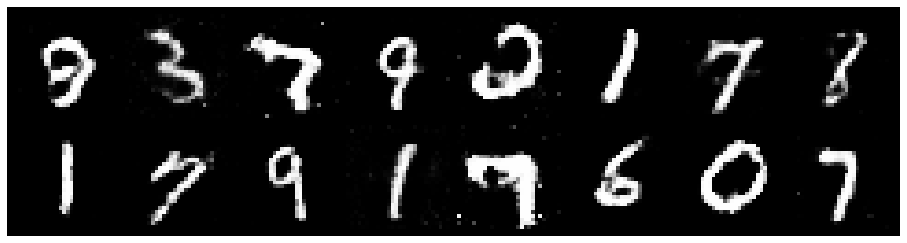

Epoch: [195/200], Batch Num: [300/600]
Discriminator Loss: 1.1186, Generator Loss: 1.0761
D(x): 0.6186, D(G(z)): 0.3798


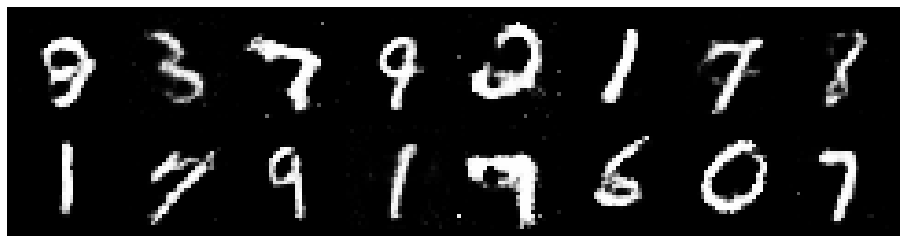

Epoch: [195/200], Batch Num: [400/600]
Discriminator Loss: 1.1706, Generator Loss: 1.0650
D(x): 0.5929, D(G(z)): 0.3944


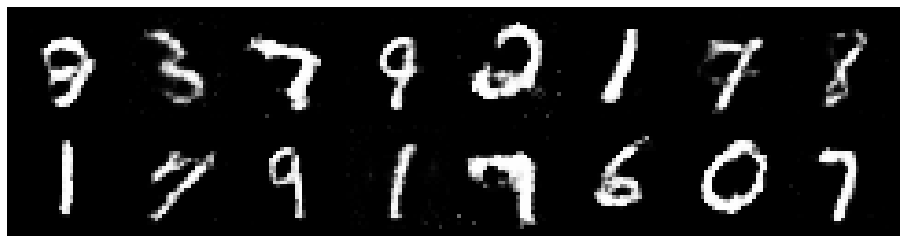

Epoch: [195/200], Batch Num: [500/600]
Discriminator Loss: 1.1840, Generator Loss: 0.9712
D(x): 0.6354, D(G(z)): 0.4309


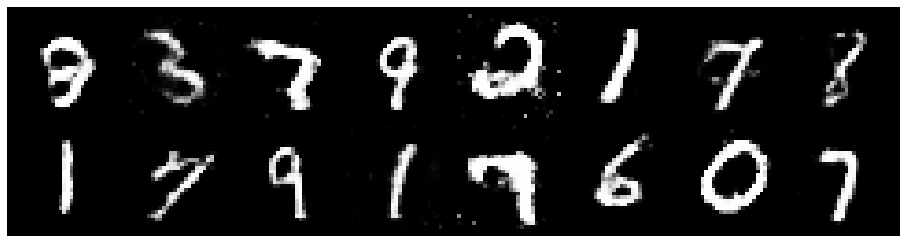

Epoch: [196/200], Batch Num: [0/600]
Discriminator Loss: 1.1348, Generator Loss: 1.0366
D(x): 0.6012, D(G(z)): 0.3871


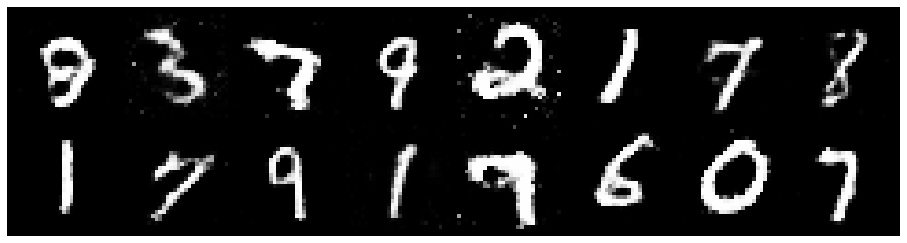

Epoch: [196/200], Batch Num: [100/600]
Discriminator Loss: 1.1336, Generator Loss: 1.0559
D(x): 0.6223, D(G(z)): 0.3811


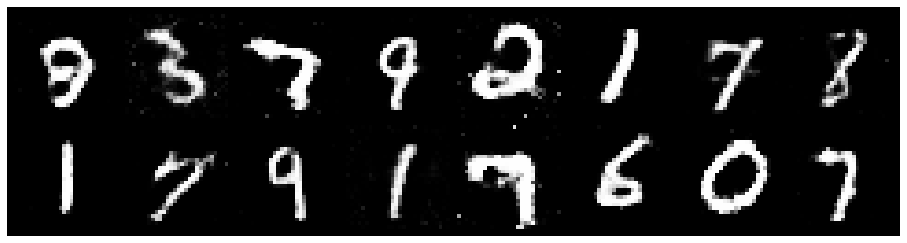

Epoch: [196/200], Batch Num: [200/600]
Discriminator Loss: 1.1507, Generator Loss: 1.1805
D(x): 0.6089, D(G(z)): 0.3881


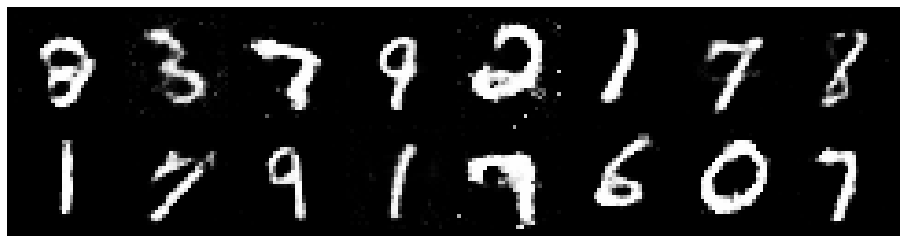

Epoch: [196/200], Batch Num: [300/600]
Discriminator Loss: 1.1879, Generator Loss: 1.0843
D(x): 0.6123, D(G(z)): 0.4131


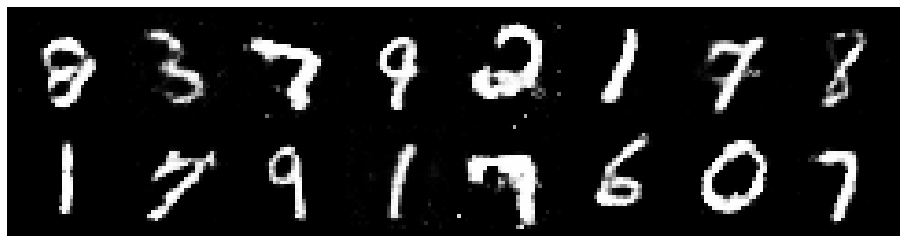

Epoch: [196/200], Batch Num: [400/600]
Discriminator Loss: 1.1939, Generator Loss: 1.0952
D(x): 0.5839, D(G(z)): 0.3978


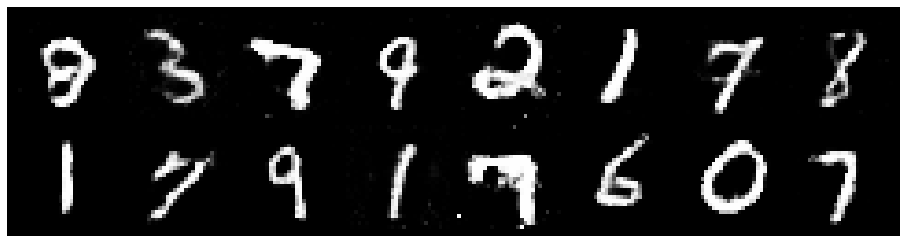

Epoch: [196/200], Batch Num: [500/600]
Discriminator Loss: 1.0533, Generator Loss: 1.0336
D(x): 0.6245, D(G(z)): 0.3627


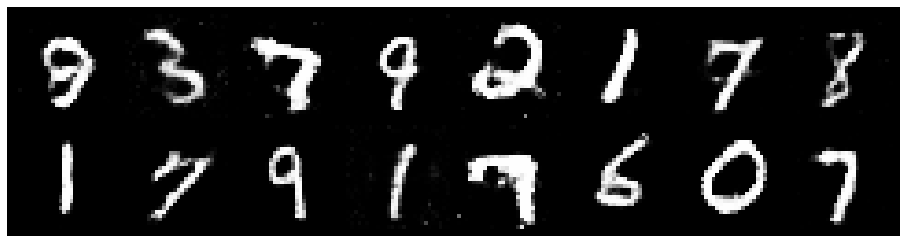

Epoch: [197/200], Batch Num: [0/600]
Discriminator Loss: 1.1860, Generator Loss: 1.1258
D(x): 0.6288, D(G(z)): 0.4360


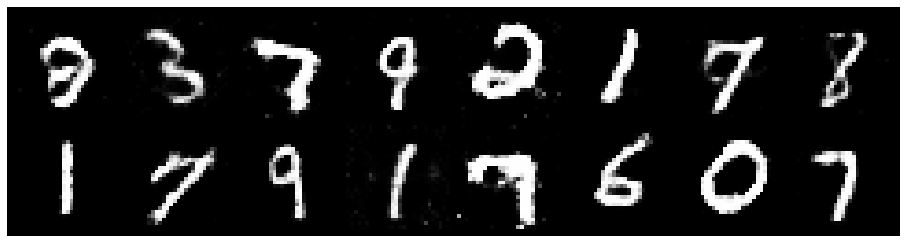

Epoch: [197/200], Batch Num: [100/600]
Discriminator Loss: 1.0597, Generator Loss: 1.3355
D(x): 0.5963, D(G(z)): 0.3368


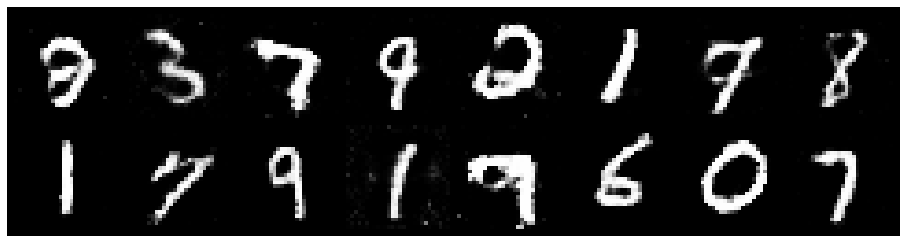

Epoch: [197/200], Batch Num: [200/600]
Discriminator Loss: 1.1258, Generator Loss: 1.1553
D(x): 0.6474, D(G(z)): 0.3997


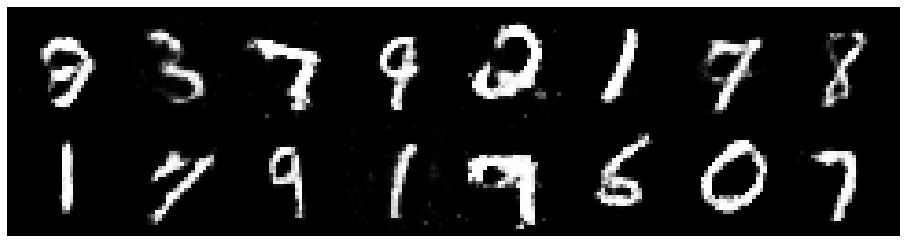

Epoch: [197/200], Batch Num: [300/600]
Discriminator Loss: 1.2035, Generator Loss: 1.1097
D(x): 0.5907, D(G(z)): 0.4126


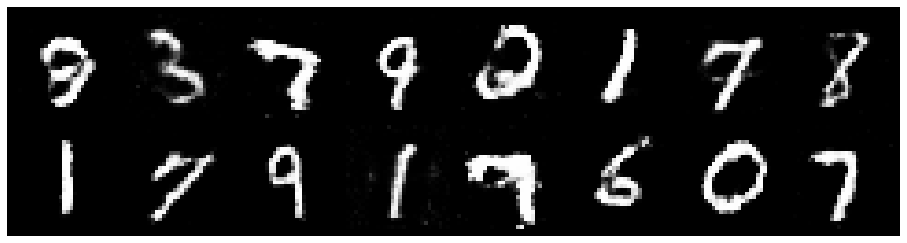

Epoch: [197/200], Batch Num: [400/600]
Discriminator Loss: 1.1651, Generator Loss: 1.0879
D(x): 0.6176, D(G(z)): 0.4098


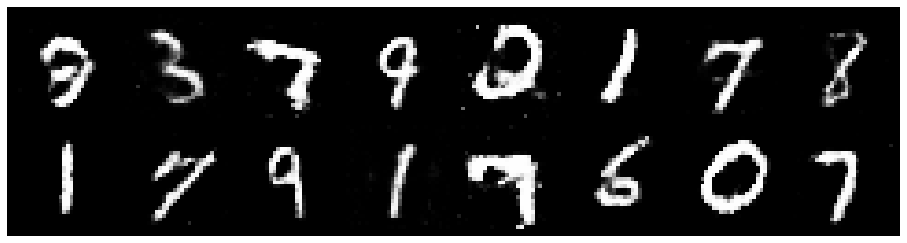

Epoch: [197/200], Batch Num: [500/600]
Discriminator Loss: 1.1713, Generator Loss: 1.1049
D(x): 0.6202, D(G(z)): 0.4259


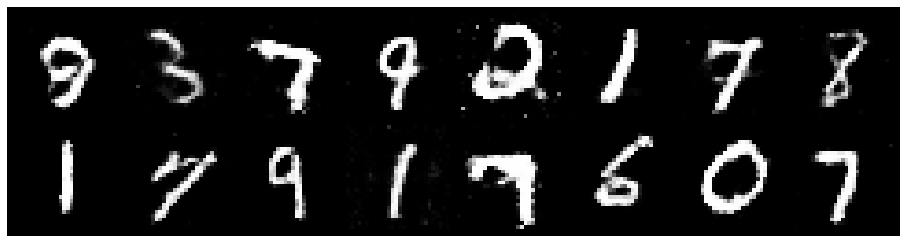

Epoch: [198/200], Batch Num: [0/600]
Discriminator Loss: 1.2256, Generator Loss: 1.0235
D(x): 0.5947, D(G(z)): 0.3930


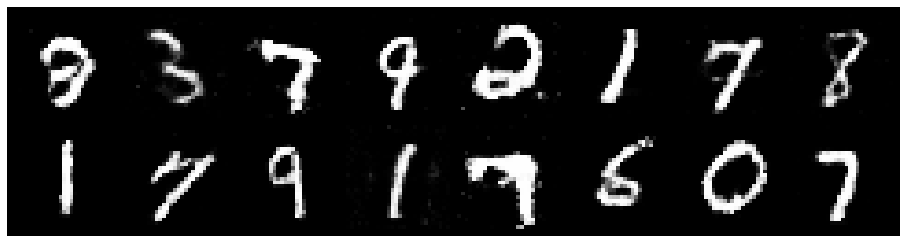

Epoch: [198/200], Batch Num: [100/600]
Discriminator Loss: 1.2351, Generator Loss: 1.1140
D(x): 0.5663, D(G(z)): 0.3730


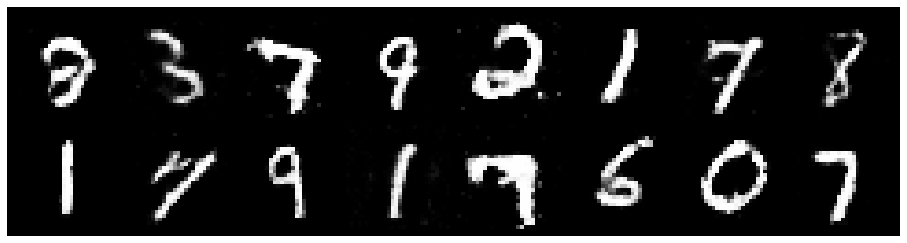

Epoch: [198/200], Batch Num: [200/600]
Discriminator Loss: 1.1502, Generator Loss: 0.9367
D(x): 0.6259, D(G(z)): 0.4236


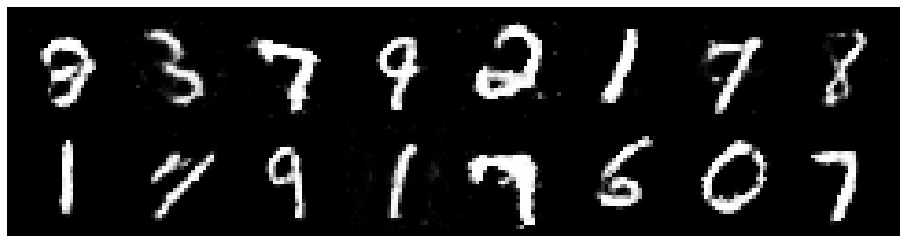

Epoch: [198/200], Batch Num: [300/600]
Discriminator Loss: 1.1185, Generator Loss: 1.2223
D(x): 0.5970, D(G(z)): 0.3735


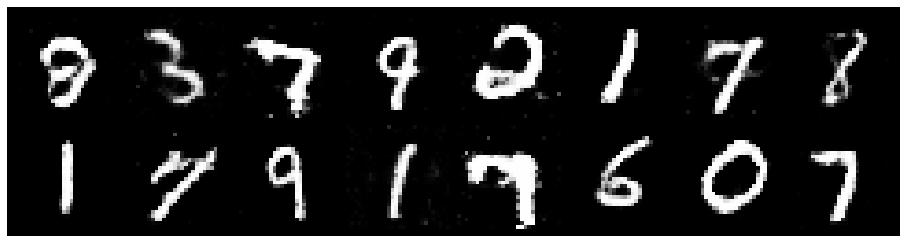

Epoch: [198/200], Batch Num: [400/600]
Discriminator Loss: 1.2718, Generator Loss: 1.0416
D(x): 0.6354, D(G(z)): 0.4805


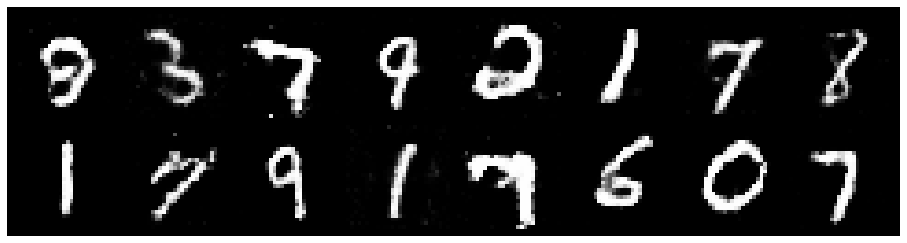

Epoch: [198/200], Batch Num: [500/600]
Discriminator Loss: 1.1136, Generator Loss: 1.0038
D(x): 0.6019, D(G(z)): 0.3695


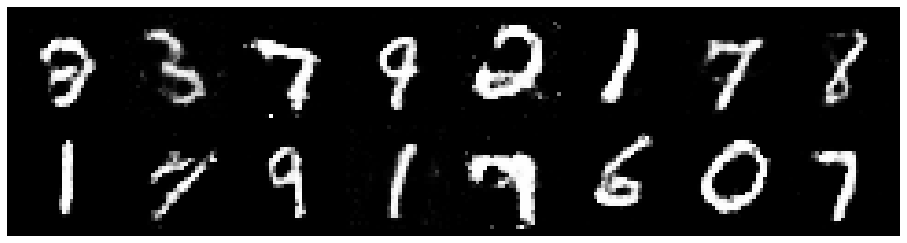

Epoch: [199/200], Batch Num: [0/600]
Discriminator Loss: 1.1237, Generator Loss: 1.0972
D(x): 0.5987, D(G(z)): 0.3703


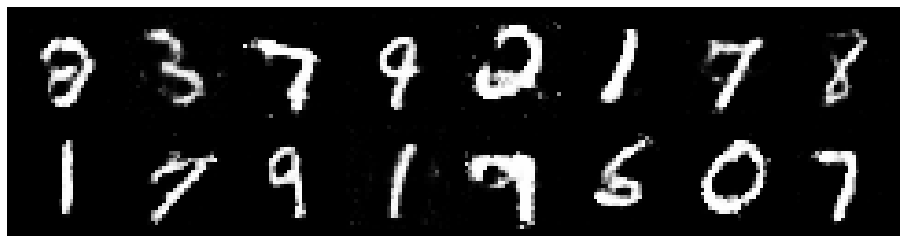

Epoch: [199/200], Batch Num: [100/600]
Discriminator Loss: 1.0727, Generator Loss: 1.0195
D(x): 0.6241, D(G(z)): 0.3726


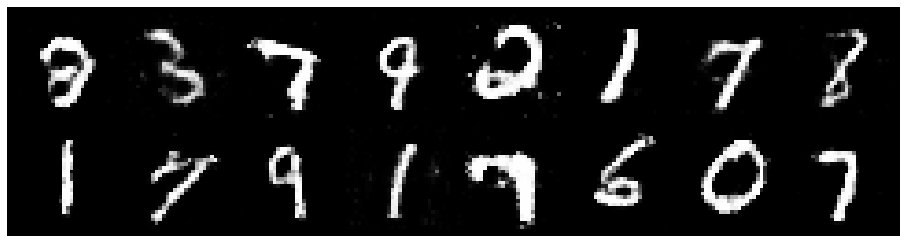

Epoch: [199/200], Batch Num: [200/600]
Discriminator Loss: 1.2291, Generator Loss: 1.0805
D(x): 0.5807, D(G(z)): 0.4049


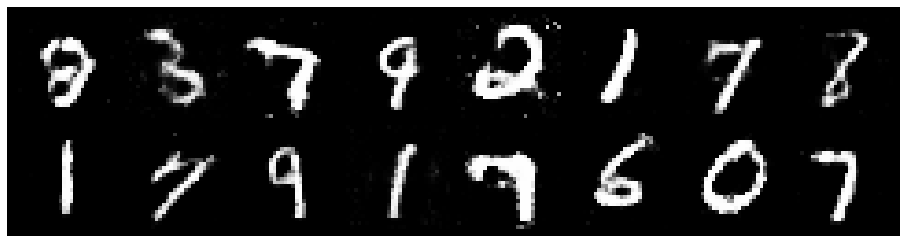

Epoch: [199/200], Batch Num: [300/600]
Discriminator Loss: 1.1664, Generator Loss: 1.1318
D(x): 0.6503, D(G(z)): 0.4368


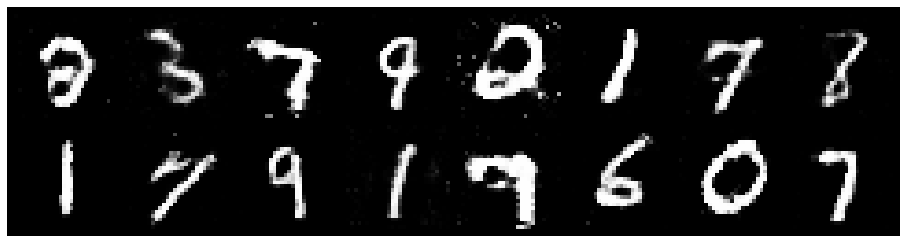

Epoch: [199/200], Batch Num: [400/600]
Discriminator Loss: 1.0731, Generator Loss: 0.9662
D(x): 0.6527, D(G(z)): 0.4014


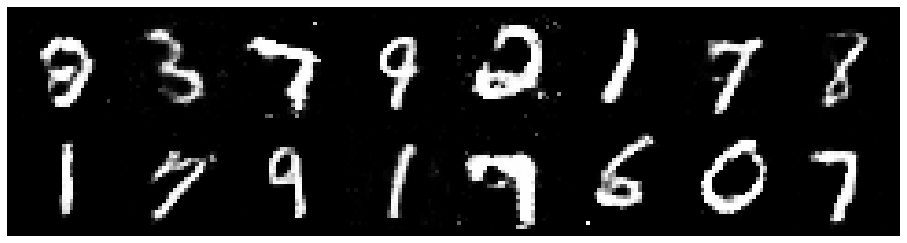

Epoch: [199/200], Batch Num: [500/600]
Discriminator Loss: 1.0990, Generator Loss: 1.0884
D(x): 0.6323, D(G(z)): 0.3913


In [17]:
for epoch in range(num_epochs):
    for n_batch, (real_batch,_) in enumerate(data_loader):
        print('n_batch={:03d}'.format(n_batch), end="\r"),
        N = real_batch.size(0)
        
        # 1. Train Discriminator
        real_data = Variable(images_to_vectors(real_batch))
        
        # Generate fake data and detach 
        # (so gradients are not calculated for generator)
        fake_data = generator(noise(N)).detach()
        
        # Train D
        d_error, d_pred_real, d_pred_fake = \
              train_discriminator(d_optimizer, real_data, fake_data)

        # 2. Train Generator
        # Generate fake data
        fake_data = generator(noise(N))
        
        # Train G
        g_error = train_generator(g_optimizer, fake_data)
        
        # Log batch error
        logger.log(d_error, g_error, epoch, n_batch, num_batches)
        
        # Display Progress every few batches
        if (n_batch) % 100 == 0: 
            test_images = vectors_to_images(generator(test_noise))
            test_images = test_images.data
            logger.log_images(
                test_images, num_test_samples, 
                epoch, n_batch, num_batches
            )
        
            # Display status Logs
            logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error, g_error, d_pred_real, d_pred_fake
            )

# Result
Let's look at some realizations of the trained model to get an idea how successful it has learnt to reproduce digits.

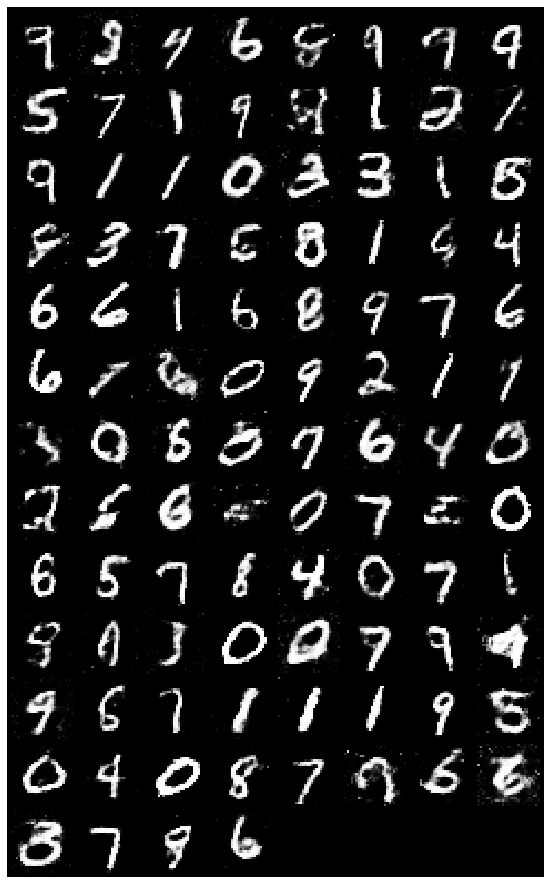

In [25]:
N = 100
test_images = vectors_to_images(generator(noise(N)).detach()).data
logger.log_images(test_images, N, 0, 0, 0)

## Model parameters of the Generator

In [28]:
# Print model's state_dict
print("Model's state_dict:")
for param_tensor in generator.state_dict():
    print(param_tensor, "\t", generator.state_dict()[param_tensor].size())

# Print optimizer's state_dict
print("Optimizer's state_dict:")
for var_name in g_optimizer.state_dict():
    print(var_name, "\t", g_optimizer.state_dict()[var_name])

Model's state_dict:
hidden0.0.weight 	 torch.Size([256, 100])
hidden0.0.bias 	 torch.Size([256])
hidden1.0.weight 	 torch.Size([512, 256])
hidden1.0.bias 	 torch.Size([512])
hidden2.0.weight 	 torch.Size([1024, 512])
hidden2.0.bias 	 torch.Size([1024])
out.0.weight 	 torch.Size([784, 1024])
out.0.bias 	 torch.Size([784])
Optimizer's state_dict:
state 	 {2972079587760: {'step': 120000, 'exp_avg': tensor([[-9.2368e-04,  8.5118e-04, -6.3606e-04,  ...,  1.4428e-03,
         -1.6897e-04,  7.6291e-04],
        [ 1.8795e-03,  1.0216e-03, -3.6842e-04,  ..., -1.8791e-04,
         -1.4727e-03,  2.1334e-03],
        [-6.8096e-04,  1.1443e-03,  5.8466e-04,  ..., -1.1713e-03,
         -6.2216e-04,  1.4135e-03],
        ...,
        [ 2.0356e-03,  7.9436e-04,  2.7085e-03,  ...,  4.1341e-03,
         -2.4094e-03,  3.3714e-03],
        [-6.4165e-04, -4.4911e-04, -3.5613e-04,  ..., -1.3037e-04,
          7.9746e-04,  1.2917e-03],
        [ 4.8554e-04,  4.3882e-04, -4.4976e-05,  ..., -1.4272e-04,
      

## Save the models

In [33]:
# save only state_dict
torch.save(generator.state_dict(), './generator_state_dict.pt')
torch.save(discriminator.state_dict(), './discriminator_state_dict.pt')

# save complete model
torch.save(generator, './generator_model.pt')
torch.save(discriminator, './discriminator_model.pt')

C:\Users\PapenMi\AppData\Local\Continuum\anaconda3\envs\pytorch\lib\site-packages\torch\serialization.py:256: UserWarning: Couldn't retrieve source code for container of type GeneratorNet. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
C:\Users\PapenMi\AppData\Local\Continuum\anaconda3\envs\pytorch\lib\site-packages\torch\serialization.py:256: UserWarning: Couldn't retrieve source code for container of type DiscriminatorNet. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


In [34]:
!dir

 Volume in Laufwerk C: hat keine Bezeichnung.
 Volumeseriennummer: F89B-C960

 Verzeichnis von C:\Users\PapenMi\OneDrive - Comma Soft AG\git_repos\GAN_pytorch

21.07.2019  10:26    <DIR>          .
21.07.2019  10:26    <DIR>          ..
20.07.2019  20:58    <DIR>          .ipynb_checkpoints
20.07.2019  22:22    <DIR>          data
20.07.2019  21:20    <DIR>          dataset
21.07.2019  10:26         5.853.137 discriminator_model.pt
21.07.2019  10:26         5.842.481 discriminator_state_dict.pt
20.07.2019  22:55    <DIR>          gans
21.07.2019  10:26        27.056.816 GAN_pytorch_01.ipynb
21.07.2019  10:26         5.955.690 generator_model.pt
21.07.2019  10:26         5.946.918 generator_state_dict.pt
20.07.2019  23:11    <DIR>          runs
               5 Datei(en),     50.655.042 Bytes
               7 Verzeichnis(se), 254.208.876.544 Bytes frei
